In [27]:
from kafka import KafkaConsumer
from time import sleep
from json import dumps,loads
import pandas as pd
import json
import numpy as np
import matplotlib.pyplot as plt
from datetime import datetime
import tkinter
import matplotlib
matplotlib.use('TkAgg')
#%matplotlib ipympl
plt.style.use('fivethirtyeight')
from pypfopt.efficient_frontier import EfficientFrontier
from pypfopt import risk_models
from pypfopt import expected_returns

In [102]:
companies = ['ASIANPAINT','AXISBANK','GAIL','HDFC','INFY','JSWSTEEL','KOTAKBANK','ONGC','RELIANCE','SBIN']
d= {}
for name in companies:
    d[name] = pd.DataFrame()

In [104]:
consumer = KafkaConsumer(
            'stocks',
            bootstrap_servers = [':9092'],
            consumer_timeout_ms = 5000,
            value_deserializer = lambda x: loads(x.decode('utf-8')))
    
df = pd.DataFrame()
for msg in consumer:
    data = msg.value
    df_iter = pd.json_normalize(data)
#     if df_iter['Symbol'].item() == 'ADANIPORTS' or df_iter['Symbol'].item() == 'MUNDRAPORT':
#         d['ADANIPORTS'] = pd.concat([d['ADANIPORTS'],df_iter])
#     if df_iter['Symbol'].item() == 'ASIANPAINT':
#         d['ASIANPAINT'] = pd.concat([d['ASIANPAINT'],df_iter])
#     if df_iter['Symbol'].item() == 'AXISBANK':
#         d['AXISBANK'] = pd.concat([d['AXISBANK'],df_iter])
#     if df_iter['Symbol'].item() == 'BAJAJ-AUTO':
#         d['BAJAJ-AUTO'] = pd.concat([d['BAJAJ-AUTO'],df_iter])
#     if df_iter['Symbol'].item() == 'BAJAJFINSV':
#         d['BAJAJFINSV'] = pd.concat([d['BAJAJFINSV'],df_iter])
#     if df_iter['Symbol'].item() == 'BAJFINANCE':
#         d['BAJFINANCE'] = pd.concat([d['BAJFINANCE'],df_iter])
#     if df_iter['Symbol'].item() == 'BHARTIARTL':
#         d['BHARTIARTL'] = pd.concat([d['BHARTIARTL'],df_iter])
#     if df_iter['Symbol'].item() == 'BPCL':
#         d['BPCL'] = pd.concat([d['BPCL'],df_iter])
#     if df_iter['Symbol'].item() == 'BRITANNIA':
#         d['BRITANNIA'] = pd.concat([d['BRITANNIA'],df_iter])
#     if df_iter['Symbol'].item() == 'CIPLA':
#         d['CIPLA'] = pd.concat([d['CIPLA'],df_iter])
    print(df_iter)
    df = pd.concat([df,df_iter])

         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2000-08-22  ASIANPAINT     EQ      270.95  269.1  271.5  268.05  271.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  269.8  269.86    2714  7.323953e+10     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2000-08-23  ASIANPAINT     EQ       269.8  266.0  269.0  254.0  259.75  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  257.7  259.0   11731  3.038312e+11     NaN                 NaN          NaN  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2000-08-24  ASIANPAINT     EQ       257.7  261.0  263.0  258.35  261.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  261.7  261.32    2528  6.606199e+10     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symb

0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2000-10-03  ASIANPAINT     EQ      221.75  221.0  225.0  218.0  220.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  220.8  221.43    5398  1.195253e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2000-10-04  ASIANPAINT     EQ       220.8  210.0  227.9  204.0  225.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  224.75  225.91    2464  5.566345e+10     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2000-10-05  ASIANPAINT     EQ      224.75  225.0  226.0  223.05  224.8  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  223.15  224.36    2028  4.550108e+10     NaN                 NaN  \

   %Deliverble  
0         

         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2000-11-09  ASIANPAINT     EQ      234.95  234.5  237.45  227.0  231.85  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  228.55  230.51   36546  8.424356e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2000-11-10  ASIANPAINT     EQ      228.55  231.0  238.75  210.6  210.6  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  221.85  225.38   62335  1.404933e+12     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2000-11-13  ASIANPAINT     EQ      221.85  212.0  221.0  212.0  213.95  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  214.65  217.34   19401  4.216632e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
  

         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2000-12-21  ASIANPAINT     EQ      273.65  273.45  273.45  262.2  265.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  265.3  265.84    8111  2.156208e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2000-12-22  ASIANPAINT     EQ       265.3  279.95  279.95  263.0  270.7  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  271.4  268.64   14672  3.941429e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2000-12-26  ASIANPAINT     EQ       271.4  269.95  273.95  265.1  269.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  270.35  269.45   15159  4.084551e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
  

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-02-01  ASIANPAINT     EQ       265.1  254.0  264.9  254.0  260.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  260.3  261.01   17194  4.487887e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2001-02-02  ASIANPAINT     EQ       260.3  265.75  265.75  256.1  263.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  262.3  262.41   19814  5.199428e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-02-05  ASIANPAINT     EQ       262.3  267.9  267.9  261.0  262.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  262.15  263.03   19491  5.126712e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         D

0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-03-12  ASIANPAINT     EQ      261.45  252.0  266.0  252.0  264.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  264.1  263.63   28225  7.441060e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2001-03-13  ASIANPAINT     EQ       264.1  251.1  267.5  243.0  258.25  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  259.8  258.12   29457  7.603534e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2001-03-14  ASIANPAINT     EQ       259.8  252.0  260.0  248.05  260.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  254.65  255.12   19870  5.069307e+11     NaN                 NaN  \

   %Deliverble  
0         

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-04-19  ASIANPAINT     EQ       259.9  255.0  269.0  255.0  269.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  266.35  263.81    9710  2.561587e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2001-04-20  ASIANPAINT     EQ      266.35  271.0  271.0  260.65  266.2  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  268.7  266.7    9017  2.404845e+11     NaN                 NaN          NaN  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2001-04-23  ASIANPAINT     EQ       268.7  262.6  266.95  260.0  265.7  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  263.45  263.75    3975  1.048394e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Sy

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-05-28  ASIANPAINT     EQ      249.95  251.6  251.7  246.5  249.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  249.45  249.21    4856  1.210145e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-05-29  ASIANPAINT     EQ      249.45  250.9  251.0  245.2  250.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  249.65  249.19   11946  2.976860e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2001-05-30  ASIANPAINT     EQ      249.65  258.95  258.95  249.5  251.9  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  252.0  253.4    4893  1.239881e+11     NaN                 NaN          NaN  
         Date      Sy

0          NaN  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2001-07-10  ASIANPAINT     EQ      249.85  245.05  250.0  245.05  250.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  249.85  249.61    4606  1.149692e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2001-07-11  ASIANPAINT     EQ      249.85  249.9  249.9  245.8  249.75  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  249.7  249.5   23240  5.798394e+11     NaN                 NaN          NaN  
         Date      Symbol Series  Prev Close   Open    High     Low    Last   
0  2001-07-12  ASIANPAINT     EQ       249.7  246.1  249.25  245.25  245.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  246.45  247.13    3454  8.535736e+10     NaN                 NaN  \

   %Deliverble  
0          Na

0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-08-16  ASIANPAINT     EQ      263.45  259.0  261.0  258.0  260.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  259.95  259.89    5590  1.452771e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2001-08-17  ASIANPAINT     EQ      259.95  260.5  261.75  250.6  259.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  256.25  259.69   10635  2.761804e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-08-20  ASIANPAINT     EQ      256.25  259.0  261.0  255.5  261.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  260.25  259.34    6162  1.598070e+11     NaN                 NaN  \

   %Deliverble  
0       

0          NaN  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2001-09-21  ASIANPAINT     EQ       255.6  240.0  264.95  240.0  255.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  255.95  257.87    7114  1.834484e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2001-09-24  ASIANPAINT     EQ      255.95  256.0  268.75  255.0  268.75  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  263.4  258.27    6155  1.589671e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-09-25  ASIANPAINT     EQ       263.4  257.1  278.0  255.0  264.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  263.55  260.27    9589  2.495769e+11     NaN                 NaN  \

   %Deliverble  
0     

0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-11-02  ASIANPAINT     EQ      270.05  272.3  274.0  270.7  272.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  272.05  272.33    9773  2.661494e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-11-05  ASIANPAINT     EQ      272.05  271.0  272.8  269.5  272.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  270.45  270.7    9016  2.440663e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2001-11-06  ASIANPAINT     EQ      270.45  271.9  272.0  270.0  271.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  270.6  270.72    7942  2.150047e+11     NaN                 NaN  \

   %Deliverble  
0          N

0          NaN  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2001-12-13  ASIANPAINT     EQ      281.15  277.55  284.0  276.0  284.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  280.85  280.11   26473  7.415390e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2001-12-14  ASIANPAINT     EQ      280.85  281.0  282.0  278.05  280.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  280.05  280.39   11304  3.169482e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-12-18  ASIANPAINT     EQ      280.05  299.0  299.0  271.0  275.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  277.2  276.85    4882  1.351557e+11     NaN                 NaN  \

   %Deliverble  
0       

         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2002-01-22  ASIANPAINT     EQ       271.0  272.0  273.5  270.1  270.35  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  270.45  271.46    1970  5.347700e+10     NaN              1502.0  \

   %Deliverble  
0       0.7624  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-01-23  ASIANPAINT     EQ      270.45  273.0  273.0  266.2  272.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  271.5  270.43    2710  7.328780e+10     NaN              2091.0  \

   %Deliverble  
0       0.7716  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-01-24  ASIANPAINT     EQ       271.5  278.0  280.9  271.0  271.8  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  271.3  274.81    8387  2.304816e+11     NaN              4856.0  \

   %Deliverble  
0        0.579  
         Dat

0        0.713  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-03-01  ASIANPAINT     EQ       300.6  296.0  307.0  292.1  302.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  300.4  299.44    6000  1.796652e+11     NaN              3549.0  \

   %Deliverble  
0       0.5915  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-03-04  ASIANPAINT     EQ       300.4  305.1  308.9  301.15  306.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  305.7  305.26    6431  1.963156e+11     NaN              5077.0  \

   %Deliverble  
0       0.7895  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-03-05  ASIANPAINT     EQ       305.7  300.1  316.5  300.1  315.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  311.1  308.33   32390  9.986737e+11     NaN             31058.0  \

   %Deliverble  
0       0.9589

         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2002-04-18  ASIANPAINT     EQ       321.2  320.2  322.55  318.7  322.55  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  322.2  321.47    3770  1.211954e+11     NaN              3035.0  \

   %Deliverble  
0        0.805  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-04-19  ASIANPAINT     EQ       322.2  321.8  332.0  320.0  330.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  328.1  323.66   18689  6.048882e+11     NaN             16904.0  \

   %Deliverble  
0       0.9045  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-04-22  ASIANPAINT     EQ       328.1  342.9  342.9  330.0  333.3  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  335.25  336.06   46470  1.561658e+12     NaN             40613.0  \

   %Deliverble  
0        0.874  
         D

0       0.9336  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-06-04  ASIANPAINT     EQ      299.55  301.0  307.0  300.05  300.3  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  302.1  304.03   23185  7.048842e+11     NaN             19888.0  \

   %Deliverble  
0       0.8578  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-06-05  ASIANPAINT     EQ       302.1  298.0  311.0  281.0  311.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  310.05  307.63   22234  6.839827e+11     NaN             20447.0  \

   %Deliverble  
0       0.9196  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2002-06-06  ASIANPAINT     EQ      310.05  313.2  316.9  310.5  313.95  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  313.65  314.1   19871  6.241420e+11     NaN             18707.0  \

   %Deliverble  
0       0.

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-07-19  ASIANPAINT     EQ       337.7  332.0  340.0  311.0  325.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  330.4  331.76   10433  3.461264e+11     NaN              6388.0  \

   %Deliverble  
0       0.6123  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-07-22  ASIANPAINT     EQ       330.4  330.0  338.0  325.0  331.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  333.4  332.55    8679  2.886174e+11     NaN              5065.0  \

   %Deliverble  
0       0.5836  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2002-07-23  ASIANPAINT     EQ       333.4  335.0  339.9  330.0  330.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  333.95  335.58    5294  1.776583e+11     NaN              2394.0  \

   %Deliverble  
0       0.4522  
         Dat

         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2002-08-28  ASIANPAINT     EQ      338.25  346.35  346.35  338.0  338.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  338.5  341.4    9602  3.278112e+11     NaN              5004.0       0.5211  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-08-29  ASIANPAINT     EQ       338.5  338.0  343.0  335.2  341.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  340.05  339.17   14793  5.017324e+11     NaN             11359.0  \

   %Deliverble  
0       0.7679  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-08-30  ASIANPAINT     EQ      340.05  340.0  341.9  339.0  340.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  340.25  340.32    3095  1.053290e+11     NaN              1754.0  \

   %Deliverble  
0       0.5667  
         Date      Sy

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-10-09  ASIANPAINT     EQ       344.1  343.0  345.0  340.4  343.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  342.1  342.03    8594  2.939373e+11     NaN              6792.0  \

   %Deliverble  
0       0.7903  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-10-10  ASIANPAINT     EQ       342.1  344.0  345.0  341.5  341.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  341.95  343.68    7692  2.643582e+11     NaN              6443.0  \

   %Deliverble  
0       0.8376  
         Date      Symbol Series  Prev Close    Open    High    Low    Last   
0  2002-10-11  ASIANPAINT     EQ      341.95  341.75  345.75  341.1  344.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  344.4  343.56    2845  9.774316e+10     NaN              1701.0  \

   %Deliverble  
0       0.5979  
        

0       0.7242  
         Date      Symbol Series  Prev Close    Open   High    Low    Last   
0  2002-11-20  ASIANPAINT     EQ       323.7  323.25  325.9  321.0  321.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  321.35  322.82    4608  1.487550e+11     NaN              2016.0  \

   %Deliverble  
0       0.4375  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-11-21  ASIANPAINT     EQ      321.35  323.0  330.0  323.0  326.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  326.5  325.93    4567  1.488538e+11     NaN              3469.0  \

   %Deliverble  
0       0.7596  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-11-22  ASIANPAINT     EQ       326.5  330.0  331.5  329.95  330.4  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  330.1  330.26    1921  6.344344e+10     NaN              1795.0  \

   %Deliverble  
0       

         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2003-01-03  ASIANPAINT     EQ      327.05  328.05  332.0  327.5  327.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  327.6  329.64    2195  7.235500e+10     NaN              1936.0  \

   %Deliverble  
0        0.882  
         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2003-01-06  ASIANPAINT     EQ       327.6  329.0  329.75  326.0  329.75  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  329.15  327.99    2516  8.252184e+10     NaN              1805.0  \

   %Deliverble  
0       0.7174  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-01-07  ASIANPAINT     EQ      329.15  329.0  331.4  328.0  331.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  330.95  330.07    3383  1.116618e+11     NaN              2863.0  \

   %Deliverble  
0       0.8463  
      

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-02-10  ASIANPAINT     EQ       328.3  325.0  329.2  322.0  325.3  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  325.3  326.19    2049  6.683571e+10     NaN              1894.0  \

   %Deliverble  
0       0.9244  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2003-02-11  ASIANPAINT     EQ       325.3  330.2  330.2  325.0  325.65  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  325.65  325.56    2202  7.168722e+10     NaN              1787.0  \

   %Deliverble  
0       0.8115  
         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2003-02-12  ASIANPAINT     EQ      325.65  327.95  327.95  325.0  327.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  326.65  325.82     455  1.482494e+10     NaN               347.0  \

   %Deliverble  
0       0.7626  
      

0       0.8249  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-03-25  ASIANPAINT     EQ       348.3  344.9  347.0  338.0  340.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  341.85  344.64   22998  7.925940e+11     NaN             19773.0  \

   %Deliverble  
0       0.8598  
         Date      Symbol Series  Prev Close    Open    High     Low   Last   
0  2003-03-26  ASIANPAINT     EQ      341.85  341.75  341.75  337.15  338.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  338.75  338.54    1985  6.720005e+10     NaN              1088.0  \

   %Deliverble  
0       0.5481  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-03-27  ASIANPAINT     EQ      338.75  336.0  340.0  335.5  336.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  338.5  337.34    3077  1.038004e+11     NaN              1725.0  \

   %Deliverble  
0     

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-05-02  ASIANPAINT     EQ       331.2  330.0  370.0  330.0  356.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  355.95  346.88   13612  4.721701e+11     NaN             10221.0  \

   %Deliverble  
0       0.7509  
         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2003-05-05  ASIANPAINT     EQ      355.95  359.0  360.0  340.05  340.35  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  341.7  346.67    7872  2.728975e+11     NaN              3611.0  \

   %Deliverble  
0       0.4587  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-05-06  ASIANPAINT     EQ       341.7  345.0  345.0  337.0  337.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  339.15  343.03    6326  2.170031e+11     NaN              3979.0  \

   %Deliverble  
0        0.629  
        

0       0.5804  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2003-06-10  ASIANPAINT     EQ      382.55  373.05  383.4  368.25  371.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  370.2  376.6   24250  9.132582e+11     NaN             20814.0       0.8583  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2003-06-11  ASIANPAINT     EQ       370.2  377.7  378.95  375.0  377.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  375.65  376.16    6860  2.580463e+11     NaN              4538.0  \

   %Deliverble  
0       0.6615  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-06-12  ASIANPAINT     EQ      375.65  383.9  383.9  376.15  377.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  376.8  378.92    9936  3.764935e+11     NaN              5894.0  \

   %Deliverble  
0       0.5932  
  

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-07-17  ASIANPAINT     EQ       398.4  400.0  403.0  395.0  396.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  396.25  399.12    6326  2.524816e+11     NaN              5099.0  \

   %Deliverble  
0        0.806  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2003-07-18  ASIANPAINT     EQ      396.25  399.25  403.8  398.0  401.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  401.85  400.97   20298  8.138919e+11     NaN             16638.0  \

   %Deliverble  
0       0.8197  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2003-07-21  ASIANPAINT     EQ      401.85  365.7  401.85  365.7  399.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  398.3  398.94    6977  2.783391e+11     NaN              4955.0  \

   %Deliverble  
0       0.7102  
        

0       0.6408  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-08-25  ASIANPAINT     EQ      293.95  282.6  303.0  282.6  294.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  295.35  297.66   69855  2.079305e+12     NaN             40370.0  \

   %Deliverble  
0       0.5779  
         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2003-08-26  ASIANPAINT     EQ      295.35  296.0  305.75  296.0  305.75  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  304.45  301.9   41879  1.264322e+12     NaN             27272.0  \

   %Deliverble  
0       0.6512  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2003-08-27  ASIANPAINT     EQ      304.45  305.0  307.0  302.0  302.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  304.35  304.93   51009  1.555426e+12     NaN             36520.0  \

   %Deliverble  
0     

0       0.7725  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2003-10-08  ASIANPAINT     EQ      303.25  303.0  305.0  302.0  304.75  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  304.65  303.52   20461  6.210392e+11     NaN             16685.0  \

   %Deliverble  
0       0.8155  
         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2003-10-09  ASIANPAINT     EQ      304.65  305.0  305.0  302.05  302.25  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  303.4  304.26   20513  6.241214e+11     NaN             11451.0  \

   %Deliverble  
0       0.5582  
         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2003-10-10  ASIANPAINT     EQ       303.4  304.9  305.0  303.05  304.75  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  304.5  304.75   29485  8.985421e+11     NaN             27102.0  \

   %Deliverble  
0   

         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-11-18  ASIANPAINT     EQ      306.45  309.0  309.0  304.05  308.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  306.35  305.6   15297  4.674789e+11     NaN             10076.0  \

   %Deliverble  
0       0.6587  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-11-19  ASIANPAINT     EQ      306.35  304.0  305.9  303.0  305.7  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  305.35  304.52   34976  1.065105e+12     NaN             29898.0  \

   %Deliverble  
0       0.8548  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-11-20  ASIANPAINT     EQ      305.35  305.0  305.7  302.0  305.7  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  304.6  304.23   12908  3.927063e+11     NaN             10842.0  \

   %Deliverble  
0       0.8399  
         Dat

0       0.7614  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-12-29  ASIANPAINT     EQ       325.6  328.0  332.5  325.55  327.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  326.65  327.84   58981  1.933646e+12     NaN             51301.0  \

   %Deliverble  
0       0.8698  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-12-30  ASIANPAINT     EQ      326.65  329.0  329.0  323.0  324.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  323.45  325.38   19405  6.314070e+11     NaN             15041.0  \

   %Deliverble  
0       0.7751  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-12-31  ASIANPAINT     EQ      323.45  325.0  337.5  325.0  334.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  334.8  332.63   98576  3.278944e+12     NaN             65425.0  \

   %Deliverble  
0       0.

0       0.8659  
         Date      Symbol Series  Prev Close   Open    High     Low   Last   
0  2004-02-18  ASIANPAINT     EQ       319.9  320.0  321.35  319.25  320.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  320.0  320.01   34646  1.108711e+12     NaN             33090.0  \

   %Deliverble  
0       0.9551  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-02-19  ASIANPAINT     EQ       320.0  320.0  321.5  317.0  320.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  320.0  320.12   12219  3.911498e+11     NaN             10331.0  \

   %Deliverble  
0       0.8455  
         Date      Symbol Series  Prev Close    Open   High    Low    Last   
0  2004-02-20  ASIANPAINT     EQ       320.0  315.15  322.5  315.1  321.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  320.6  319.95   50362  1.611331e+12     NaN             48794.0  \

   %Deliverble  
0       

0        0.555  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-04-05  ASIANPAINT     EQ      304.85  309.5  309.5  302.05  303.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  303.95  304.25   13347  4.060876e+11     NaN              9963.0  \

   %Deliverble  
0       0.7465  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-04-06  ASIANPAINT     EQ      303.95  305.1  305.1  303.0  304.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  304.25  304.13    9009  2.739942e+11     NaN              5811.0  \

   %Deliverble  
0        0.645  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-04-07  ASIANPAINT     EQ      304.25  309.0  309.0  303.05  303.7  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  304.1  304.88   54237  1.653604e+12     NaN             51722.0  \

   %Deliverble  
0       

0        0.654  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2004-05-13  ASIANPAINT     EQ       299.6  298.15  305.0  290.15  305.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  297.15  297.3   32262  9.591352e+11     NaN             23291.0  \

   %Deliverble  
0       0.7219  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-05-14  ASIANPAINT     EQ      297.15  305.0  305.0  291.1  291.8  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  295.95  297.18   30091  8.942550e+11     NaN             22761.0  \

   %Deliverble  
0       0.7564  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-05-17  ASIANPAINT     EQ      295.95  291.0  291.5  245.0  270.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  272.9  271.97   45759  1.244527e+12     NaN             39719.0  \

   %Deliverble  
0        0

0       0.6565  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2004-06-22  ASIANPAINT     EQ       309.5  307.5  315.95  307.5  314.7  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  314.7  311.01   24249  7.541706e+11     NaN             20011.0  \

   %Deliverble  
0       0.8252  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-06-23  ASIANPAINT     EQ       314.7  309.1  315.0  308.0  314.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  313.45  311.63   17605  5.486191e+11     NaN             14735.0  \

   %Deliverble  
0        0.837  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-06-24  ASIANPAINT     EQ      313.45  314.0  315.0  310.15  314.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  314.6  313.88   23616  7.412587e+11     NaN             21009.0  \

   %Deliverble  
0       0.

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-08-05  ASIANPAINT     EQ       320.0  315.1  330.0  315.1  323.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  325.5  322.4   25691  8.282706e+11     NaN             21809.0       0.8489  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-08-06  ASIANPAINT     EQ       325.5  322.0  322.0  320.2  320.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  321.2  321.11    3047  9.784178e+10     NaN              2341.0  \

   %Deliverble  
0       0.7683  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-08-09  ASIANPAINT     EQ       321.2  320.0  322.5  320.0  320.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  320.2  320.25   16138  5.168158e+11     NaN             12463.0  \

   %Deliverble  
0       0.7723  
         Date      Symbol Ser

0       0.9196  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-09-27  ASIANPAINT     EQ       313.1  313.2  315.2  311.15  314.7  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  314.0  314.04   13518  4.245167e+11     NaN             10234.0  \

   %Deliverble  
0       0.7571  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2004-09-28  ASIANPAINT     EQ       314.0  315.0  315.95  310.5  310.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  310.9  312.73    5662  1.770695e+11     NaN              3625.0  \

   %Deliverble  
0       0.6402  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2004-09-29  ASIANPAINT     EQ       310.9  312.15  340.0  311.0  325.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  325.15  327.48   62820  2.057211e+12     NaN             39434.0  \

   %Deliverble  
0       

         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-11-09  ASIANPAINT     EQ       290.4  290.0  294.0  288.0  289.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  288.85  290.35   64912  1.884721e+12     NaN             55355.0  \

   %Deliverble  
0       0.8528  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-11-10  ASIANPAINT     EQ      288.85  291.5  296.9  289.0  293.75  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  292.1  291.35   64694  1.884870e+12     NaN             35803.0  \

   %Deliverble  
0       0.5534  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-11-11  ASIANPAINT     EQ       292.1  294.9  295.5  292.5  294.95  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  294.45  294.51   19038  5.606934e+11     NaN             12311.0  \

   %Deliverble  
0       0.6467  
      

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-12-22  ASIANPAINT     EQ      325.75  324.0  326.9  324.0  324.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  324.0  324.39   24309  7.885643e+11     NaN             17705.0  \

   %Deliverble  
0       0.7283  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-12-23  ASIANPAINT     EQ       324.0  320.5  326.0  320.5  325.25  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  324.3  324.23   13808  4.476999e+11     NaN              8186.0  \

   %Deliverble  
0       0.5928  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-12-24  ASIANPAINT     EQ       324.3  335.0  335.0  322.5  323.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  323.85  323.8   12415  4.019921e+11     NaN              8682.0  \

   %Deliverble  
0       0.6993  
         Date 

0       0.6848  
         Date      Symbol Series  Prev Close    Open    High    Low    Last   
0  2005-02-03  ASIANPAINT     EQ      348.95  359.95  359.95  345.0  345.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  346.85  349.17    9236  3.224974e+11     NaN              6929.0  \

   %Deliverble  
0       0.7502  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-02-04  ASIANPAINT     EQ      346.85  349.0  351.0  340.75  345.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  345.25  346.76   18312  6.349836e+11     NaN             12022.0  \

   %Deliverble  
0       0.6565  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-02-07  ASIANPAINT     EQ      345.25  358.8  358.8  346.5  349.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  347.4  351.1   19969  7.011124e+11     NaN             14788.0       0.7405  


0  358.1  358.6   23444  8.407058e+11     NaN             16046.0       0.6844  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-03-10  ASIANPAINT     EQ       358.1  356.0  361.0  356.0  357.35  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  359.05  359.79   50258  1.808216e+12     NaN             46728.0  \

   %Deliverble  
0       0.9298  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-03-11  ASIANPAINT     EQ      359.05  362.0  378.95  351.0  357.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  357.15  359.6   11410  4.103023e+11     NaN              8057.0  \

   %Deliverble  
0       0.7061  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-03-14  ASIANPAINT     EQ      357.15  363.0  366.0  358.0  361.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  362.65  362.79   28970  1.0509

0       0.7407  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-04-26  ASIANPAINT     EQ      389.85  390.0  392.9  385.1  385.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  386.3  389.82    8733  3.404294e+11     NaN              7635.0  \

   %Deliverble  
0       0.8743  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-04-27  ASIANPAINT     EQ       386.3  390.0  390.0  370.0  380.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  378.7  385.02   19075  7.344324e+11     NaN             17992.0  \

   %Deliverble  
0       0.9432  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-04-28  ASIANPAINT     EQ       378.7  378.0  384.0  362.0  362.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  367.8  372.05    7483  2.784056e+11     NaN              4901.0  \

   %Deliverble  
0        0.655  

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-06-06  ASIANPAINT     EQ      390.95  390.0  393.0  389.0  391.9  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  390.5  391.41    2366  9.260704e+10     NaN              1365.0  \

   %Deliverble  
0       0.5769  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-06-07  ASIANPAINT     EQ       390.5  393.9  400.0  387.0  395.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  396.35  394.59    9030  3.563132e+11     NaN              5239.0  \

   %Deliverble  
0       0.5802  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-06-08  ASIANPAINT     EQ      396.35  398.0  398.0  389.5  390.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  390.8  393.79    5387  2.121332e+11     NaN              2821.0  \

   %Deliverble  
0       0.5237  
         Date 

0       0.7703  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-07-15  ASIANPAINT     EQ      418.85  420.0  423.8  416.1  419.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  418.3  419.68    3134  1.315276e+11     NaN              1889.0  \

   %Deliverble  
0       0.6027  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-07-18  ASIANPAINT     EQ       418.3  420.0  435.0  420.0  435.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  433.3  430.77   31056  1.337788e+12     NaN             24902.0  \

   %Deliverble  
0       0.8018  
         Date      Symbol Series  Prev Close    Open    High     Low   Last   
0  2005-07-19  ASIANPAINT     EQ       433.3  428.75  447.45  428.75  445.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  444.1  435.66   39528  1.722096e+12     NaN             33206.0  \

   %Deliverble  
0       0.

0       0.7986  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2005-08-23  ASIANPAINT     EQ       468.0  463.45  486.0  462.5  472.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  472.45  474.11   27870  1.321348e+12     NaN             21630.0  \

   %Deliverble  
0       0.7761  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-08-24  ASIANPAINT     EQ      472.45  468.0  476.0  468.0  475.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  474.4  472.56    8184  3.867394e+11     NaN              4642.0  \

   %Deliverble  
0       0.5672  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-08-25  ASIANPAINT     EQ       474.4  473.0  473.0  466.0  466.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  468.7  469.81    5178  2.432669e+11     NaN              4033.0  \

   %Deliverble  
0       0.77

0       0.6757  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-10-10  ASIANPAINT     EQ       518.4  523.0  529.0  500.0  505.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  502.6  506.96   45468  2.305064e+12     NaN             38272.0  \

   %Deliverble  
0       0.8417  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-10-11  ASIANPAINT     EQ       502.6  514.0  514.0  496.0  501.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  501.7  504.53   38813  1.958217e+12     NaN             32055.0  \

   %Deliverble  
0       0.8259  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-10-13  ASIANPAINT     EQ       501.7  509.5  509.5  496.0  499.7  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  501.05  502.99   48575  2.443296e+12     NaN             45711.0  \

   %Deliverble  
0        0.941

         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2005-11-21  ASIANPAINT     EQ      503.35  502.05  509.6  502.0  504.6  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  506.9  505.72    8188  4.140815e+11     NaN              4469.0  \

   %Deliverble  
0       0.5458  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-11-22  ASIANPAINT     EQ       506.9  505.0  510.9  501.15  510.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  508.9  507.76    6313  3.205501e+11     NaN              4571.0  \

   %Deliverble  
0       0.7241  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-11-23  ASIANPAINT     EQ       508.9  510.5  512.0  504.95  508.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  505.2  506.75   12858  6.515769e+11     NaN             10837.0  \

   %Deliverble  
0       0.8428  
         D

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-12-29  ASIANPAINT     EQ       563.6  563.0  576.0  563.0  571.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  572.45  570.7   15444  8.813932e+11     NaN             13158.0  \

   %Deliverble  
0        0.852  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-12-30  ASIANPAINT     EQ      572.45  570.5  582.0  566.85  577.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  578.75  575.49   22240  1.279882e+12     NaN             17348.0  \

   %Deliverble  
0         0.78  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-01-02  ASIANPAINT     EQ      578.75  583.9  595.0  579.0  590.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  589.95  589.01   13474  7.936269e+11     NaN             10342.0  \

   %Deliverble  
0       0.7676  
         D

0       0.8202  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-02-21  ASIANPAINT     EQ      662.65  660.0  672.7  657.0  670.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  666.7  665.92   55596  3.702234e+12     NaN             51897.0  \

   %Deliverble  
0       0.9335  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2006-02-22  ASIANPAINT     EQ       666.7  670.0  670.0  657.05  657.5  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  659.4  659.9   11600  7.654882e+11     NaN             10190.0       0.8784  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2006-02-23  ASIANPAINT     EQ       659.4  663.95  685.0  650.3  680.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  662.45  660.03   20344  1.342764e+12     NaN             18019.0  \

   %Deliverble  
0       0.8857  
      

0       0.7696  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2006-03-30  ASIANPAINT     EQ      664.95  675.0  675.0  655.15  662.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  660.7  664.85    7672  5.100698e+11     NaN              5354.0  \

   %Deliverble  
0       0.6979  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-03-31  ASIANPAINT     EQ       660.7  665.0  665.0  645.1  647.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  646.05  648.54   12150  7.879794e+11     NaN              9585.0  \

   %Deliverble  
0       0.7889  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-04-03  ASIANPAINT     EQ      646.05  664.0  664.0  642.0  644.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  644.6  649.88   29632  1.925721e+12     NaN             23714.0  \

   %Deliverble  
0       0.80

0       0.5908  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2006-05-17  ASIANPAINT     EQ       611.2  624.2  629.0  618.0  623.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  624.4  624.45    4656  2.907458e+11     NaN              2485.0  \

   %Deliverble  
0       0.5337  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-05-18  ASIANPAINT     EQ       624.4  630.0  630.0  581.3  601.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  607.65  611.97   17820  1.090525e+12     NaN             13355.0  \

   %Deliverble  
0       0.7494  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2006-05-19  ASIANPAINT     EQ      607.65  624.0  624.0  560.05  572.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  574.05  589.44   18401  1.084638e+12     NaN             14050.0  \

   %Deliverble  
0       

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-06-22  ASIANPAINT     EQ      555.35  556.0  575.0  534.0  552.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  557.2  569.23   38980  2.218878e+12     NaN             33572.0  \

   %Deliverble  
0       0.8613  
         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2006-06-23  ASIANPAINT     EQ       557.2  555.0  574.95  555.0  574.95  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  573.05  564.33    3403  1.920431e+11     NaN              2104.0  \

   %Deliverble  
0       0.6183  
         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2006-06-25  ASIANPAINT     EQ      573.05  573.95  574.95  570.0  570.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  573.95  573.95     355  2.037540e+10     NaN               355.0  \

   %Deliverble  
0          1.0  
    

0       0.7912  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-08-03  ASIANPAINT     EQ      609.15  610.9  625.0  605.0  621.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  617.4  610.1   68385  4.172166e+12     NaN             66689.0       0.9752  
         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2006-08-04  ASIANPAINT     EQ       617.4  623.85  623.85  611.0  618.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  617.4  617.46   31001  1.914173e+12     NaN             28753.0  \

   %Deliverble  
0       0.9275  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-08-07  ASIANPAINT     EQ       617.4  625.0  630.0  617.0  620.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  620.7  622.37   12747  7.933321e+11     NaN              7793.0  \

   %Deliverble  
0       0.6114  
        

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-09-08  ASIANPAINT     EQ      653.35  659.0  659.9  648.0  656.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  654.55  652.59   11610  7.576537e+11     NaN              8777.0  \

   %Deliverble  
0        0.756  
         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2006-09-11  ASIANPAINT     EQ      654.55  651.0  662.0  645.25  652.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  653.65  652.74    9259  6.043711e+11     NaN              6871.0  \

   %Deliverble  
0       0.7421  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2006-09-12  ASIANPAINT     EQ      653.65  652.05  660.0  649.05  654.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  656.65  653.8    5748  3.758038e+11     NaN              4021.0  \

   %Deliverble  
0       0.6995  
    

0       0.7927  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-10-27  ASIANPAINT     EQ      665.35  665.0  674.8  663.0  671.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  672.65  669.54   14262  9.548923e+11     NaN             10377.0  \

   %Deliverble  
0       0.7276  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-10-30  ASIANPAINT     EQ      672.65  670.0  800.0  664.0  665.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  667.25  676.1   17723  1.198252e+12     NaN             10409.0  \

   %Deliverble  
0       0.5873  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-10-31  ASIANPAINT     EQ      667.25  670.0  680.0  664.0  673.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  668.75  670.81   21467  1.440036e+12     NaN             18095.0  \

   %Deliverble  
0       0.84

0       0.8545  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-12-13  ASIANPAINT     EQ      704.85  681.0  715.0  681.0  712.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  713.8  709.5   35415  2.512710e+12     NaN             34521.0       0.9748  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-12-14  ASIANPAINT     EQ       713.8  718.0  729.0  717.0  717.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  720.1  722.47   12625  9.121162e+11     NaN             10220.0  \

   %Deliverble  
0       0.8095  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-12-15  ASIANPAINT     EQ       720.1  718.1  724.0  715.0  717.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  721.35  720.04    7154  5.151190e+11     NaN              6347.0  \

   %Deliverble  
0       0.8872  
         D

0       0.6752  
         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2007-01-24  ASIANPAINT     EQ       788.3  785.0  797.95  780.0  797.95  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  790.45  787.6    2316  1.824076e+11     NaN              1417.0  \

   %Deliverble  
0       0.6118  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-01-25  ASIANPAINT     EQ      790.45  795.0  809.0  790.0  803.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  802.5  798.1   11232  8.964205e+11     NaN              7225.0       0.6433  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-01-29  ASIANPAINT     EQ       802.5  804.0  815.0  785.0  792.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  799.95  797.83   13797  1.100763e+12     NaN              7849.0  \

   %Deliverble  
0       0.5689  
      

         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2007-03-06  ASIANPAINT     EQ      655.75  655.5  699.45  551.0  687.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  683.2  679.83   16546  1.124849e+12     NaN              8219.0  \

   %Deliverble  
0       0.4967  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-03-07  ASIANPAINT     EQ       683.2  690.0  695.0  651.2  660.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  661.25  660.51   19329  1.276695e+12     NaN             13851.0  \

   %Deliverble  
0       0.7166  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-03-08  ASIANPAINT     EQ      661.25  662.1  700.0  645.0  697.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  693.35  684.19  162187  1.109662e+13     NaN            154790.0  \

   %Deliverble  
0       0.9544  
        

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-04-16  ASIANPAINT     EQ      811.45  815.0  815.0  801.0  809.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  808.1  809.32   28945  2.342571e+12     NaN             23530.0  \

   %Deliverble  
0       0.8129  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-04-17  ASIANPAINT     EQ       808.1  810.0  812.0  794.0  794.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  797.25  801.94   23555  1.888978e+12     NaN             21386.0  \

   %Deliverble  
0       0.9079  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-04-18  ASIANPAINT     EQ      797.25  800.0  800.0  774.0  774.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  782.0  788.34    3938  3.104465e+11     NaN              2575.0  \

   %Deliverble  
0       0.6539  
         Date 

         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2007-05-28  ASIANPAINT     EQ      825.25  896.0  898.7  818.45  818.45  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  823.45  833.44   18351  1.529454e+12     NaN              9661.0  \

   %Deliverble  
0       0.5265  
         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2007-05-29  ASIANPAINT     EQ      823.45  825.0  834.7  820.05  827.15  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  831.95  827.63    8285  6.856911e+11     NaN              5096.0  \

   %Deliverble  
0       0.6151  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-05-30  ASIANPAINT     EQ      831.95  818.05  833.95  818.05  818.45  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  824.9  829.76   83816  6.954730e+12     NaN             81634.0  \

   %Deliverble  
0        0.97

0       0.7732  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-07-05  ASIANPAINT     EQ       830.1  834.0  842.5  830.05  842.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  840.6  837.05    4368  3.656218e+11     NaN              3607.0  \

   %Deliverble  
0       0.8258  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-07-06  ASIANPAINT     EQ       840.6  843.0  859.9  840.05  850.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  848.5  848.85   21556  1.829774e+12     NaN             19226.0  \

   %Deliverble  
0       0.8919  
         Date      Symbol Series  Prev Close    Open    High     Low   Last   
0  2007-07-09  ASIANPAINT     EQ       848.5  847.05  863.95  847.05  860.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  857.35  856.34   15781  1.351386e+12     NaN             10463.0  \

   %Deliverble  
0   

0        0.937  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2007-08-27  ASIANPAINT     EQ       932.5  950.0  950.0  934.0  937.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  939.95  938.84   18866  1.771207e+12     NaN             17970.0  \

   %Deliverble  
0       0.9525  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-08-28  ASIANPAINT     EQ      939.95  948.6  950.0  930.05  930.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  930.5  937.32   22631  2.121249e+12     NaN             20491.0  \

   %Deliverble  
0       0.9054  
         Date      Symbol Series  Prev Close    Open    High     Low   Last   
0  2007-08-29  ASIANPAINT     EQ       930.5  905.05  938.95  905.05  935.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  935.85  933.03    2073  1.934179e+11     NaN              1413.0  \

   %Deliverble  
0 

         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2007-10-11  ASIANPAINT     EQ       949.1  932.05  990.0  932.05  981.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  982.7  968.43   20851  2.019283e+12     NaN             17402.0  \

   %Deliverble  
0       0.8346  
         Date      Symbol Series  Prev Close    Open    High    Low   Last   
0  2007-10-12  ASIANPAINT     EQ       982.7  968.05  979.65  951.0  974.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  965.45  967.51   66996  6.481957e+12     NaN             56562.0  \

   %Deliverble  
0       0.8443  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-10-15  ASIANPAINT     EQ      965.45  970.0  981.0  953.0  970.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  972.05  972.72   40259  3.916061e+12     NaN             34808.0  \

   %Deliverble  
0       0.8646  
    

0       0.7435  
         Date      Symbol Series  Prev Close    Open    High    Low     Last   
0  2007-11-15  ASIANPAINT     EQ      997.55  1009.0  1009.0  990.0  1004.95  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1000.25  999.47   24333  2.432014e+12     NaN             20927.0  \

   %Deliverble  
0         0.86  
         Date      Symbol Series  Prev Close     Open    High    Low    Last   
0  2007-11-16  ASIANPAINT     EQ     1000.25  1000.25  1006.9  991.0  1006.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1000.05  999.77   20863  2.085810e+12     NaN             17947.0  \

   %Deliverble  
0       0.8602  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-11-19  ASIANPAINT     EQ     1000.05  1007.0  1019.0  1005.0  1005.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1009.55  1010.33   20777  2.099170e+12     NaN             17245.0

0       0.8011  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2007-12-20  ASIANPAINT     EQ      1004.9  1000.05  1024.0  1000.0  1006.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1011.65  1006.86    9514  9.579278e+11     NaN              8250.0  \

   %Deliverble  
0       0.8671  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-24  ASIANPAINT     EQ     1011.65  1072.2  1072.2  1010.0  1056.4  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1052.1  1046.24   12691  1.327783e+12     NaN              8971.0  \

   %Deliverble  
0       0.7069  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-12-26  ASIANPAINT     EQ      1052.1  1122.0  1122.0  1045.0  1107.75  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1100.15  1094.02   36301  3.971386e+12     NaN             2

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-28  ASIANPAINT     EQ     1046.95  1040.0  1139.9  1002.0  1124.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1127.15  1104.84   23594  2.606764e+12     NaN             18436.0  \

   %Deliverble  
0       0.7814  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-29  ASIANPAINT     EQ     1127.15  1127.0  1149.9  1067.0  1102.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1107.8  1098.78    8807  9.676980e+11     NaN              3419.0  \

   %Deliverble  
0       0.3882  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-30  ASIANPAINT     EQ      1107.8  1110.0  1200.0  1100.0  1180.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1181.75  1142.85   25202  2.880218e+12     NaN             19749.0  \

   %Delive

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-04  ASIANPAINT     EQ     1160.25  1120.0  1179.0  1120.0  1163.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1165.9  1144.72    8770  1.003917e+12     NaN              5358.0  \

   %Deliverble  
0       0.6109  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2008-03-05  ASIANPAINT     EQ      1165.9  1168.0  1168.0  1125.05  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1125.05  1136.0  1151.87   21715  2.501290e+12     NaN             19223.0  \

   %Deliverble  
0       0.8852  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-03-07  ASIANPAINT     EQ      1136.0  1125.0  1139.9  1101.2  1125.05  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1123.95  1126.22   63393  7.139439e+12     NaN             61691.0  \

   %De

0       0.4396  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-04-17  ASIANPAINT     EQ      1201.4  1220.0  1229.9  1200.0  1210.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1218.95  1213.97   11483  1.393998e+12     NaN              8356.0  \

   %Deliverble  
0       0.7277  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-04-21  ASIANPAINT     EQ     1218.95  1214.0  1247.0  1210.0  1240.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1240.95  1226.11    9122  1.118462e+12     NaN              5020.0  \

   %Deliverble  
0       0.5503  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-04-22  ASIANPAINT     EQ     1240.95  1239.0  1239.95  1213.0  1238.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1234.7  1228.66    4137  5.082952e+11     NaN              24

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-05-30  ASIANPAINT     EQ      1259.4  1259.0  1291.0  1250.0  1290.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1285.9  1275.85    9832  1.254419e+12     NaN              7803.0  \

   %Deliverble  
0       0.7936  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2008-06-02  ASIANPAINT     EQ      1285.9  1290.05  1299.0  1252.0  1252.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1261.3  1286.43    5868  7.548798e+11     NaN              3548.0  \

   %Deliverble  
0       0.6046  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-06-03  ASIANPAINT     EQ      1261.3  1245.0  1254.9  1235.0  1242.05  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1243.75  1237.36   14207  1.757911e+12     NaN             12366.0  \

   %Deli

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-10  ASIANPAINT     EQ     1033.85  1040.0  1040.0  1030.0  1035.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1035.6  1035.4    4600  4.762827e+11     NaN              3216.0  \

   %Deliverble  
0       0.6991  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-07-11  ASIANPAINT     EQ      1035.6  1040.0  1056.0  1030.05  1051.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1051.85  1044.37    6102  6.372743e+11     NaN              4337.0  \

   %Deliverble  
0       0.7108  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-14  ASIANPAINT     EQ     1051.85  1040.0  1070.0  1030.3  1055.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1051.8  1054.84   11859  1.250932e+12     NaN              9097.0  \

   %Deliverb

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-08-18  ASIANPAINT     EQ      1244.8  1244.8  1255.05  1235.0  1252.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1251.1  1248.51    2983  3.724301e+11     NaN              1510.0  \

   %Deliverble  
0       0.5062  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-08-19  ASIANPAINT     EQ      1251.1  1250.0  1255.0  1180.0  1181.2  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1184.1  1205.6    6165  7.432535e+11     NaN              4117.0  \

   %Deliverble  
0       0.6678  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2008-08-20  ASIANPAINT     EQ      1184.1  1205.05  1220.0  1185.0  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  1196.75  1202.05  1204.05    3610  4.346628e+11     NaN  \

   Deliverable Volume  %Deliverble  
0          

         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-09-29  ASIANPAINT     EQ     1189.35  1190.0  1196.0  1160.0  1181.05  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1183.15  1175.34   25528  3.000416e+12     NaN             20794.0  \

   %Deliverble  
0       0.8146  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2008-09-30  ASIANPAINT     EQ     1183.15  1160.05  1190.0  1130.0  1189.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1187.15  1160.26   19736  2.289893e+12     NaN             16466.0  \

   %Deliverble  
0       0.8343  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-10-01  ASIANPAINT     EQ     1187.15  1180.0  1185.0  1165.1  1184.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1184.2  1176.61    6530  7.683277e+11     NaN              5487.0  \

   %De

         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-11-12  ASIANPAINT     EQ      956.85  958.5  958.5  940.0  952.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  950.15  954.87  104400  9.968884e+12     NaN            103322.0  \

   %Deliverble  
0       0.9897  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2008-11-14  ASIANPAINT     EQ      950.15  960.05  989.3  955.0  970.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  969.8  972.07   18465  1.794931e+12     NaN             14881.0  \

   %Deliverble  
0       0.8059  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-11-17  ASIANPAINT     EQ       969.8  995.0  995.0  947.1  975.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  972.15  974.0   18411  1.793231e+12     NaN             16943.0  \

   %Deliverble  
0       0.9203  
         Dat

0       0.8842  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-12-30  ASIANPAINT     EQ      870.05  863.1  880.0  861.3  870.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  873.35  873.45    2446  2.136466e+11     NaN              1775.0  \

   %Deliverble  
0       0.7257  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-12-31  ASIANPAINT     EQ      873.35  865.0  900.0  865.0  899.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  894.95  883.53    6285  5.553017e+11     NaN              4640.0  \

   %Deliverble  
0       0.7383  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-01-01  ASIANPAINT     EQ      894.95  881.1  900.0  881.1  881.2  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  888.0  890.85    2216  1.974128e+11     NaN               843.0  \

   %Deliverble  
0       0.38

0       0.4877  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-02-06  ASIANPAINT     EQ      782.25  792.0  802.0  776.0  780.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  792.05  789.26   11709  9.241407e+11     NaN              5782.0  \

   %Deliverble  
0       0.4938  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-02-09  ASIANPAINT     EQ      792.05  784.0  798.0  784.0  797.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  794.05  792.45    4921  3.899650e+11     NaN              1758.0  \

   %Deliverble  
0       0.3572  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-02-10  ASIANPAINT     EQ      794.05  789.7  841.0  786.3  824.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  830.8  809.28   15280  1.236579e+12     NaN              9160.0  \

   %Deliverble  
0       0.59

         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2009-03-30  ASIANPAINT     EQ      777.15  777.15  809.9  760.0  795.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  795.5  787.32   11609  9.139987e+11     NaN              8068.0  \

   %Deliverble  
0        0.695  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-03-31  ASIANPAINT     EQ       795.5  800.0  808.0  758.0  785.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  786.35  776.01   10173  7.894350e+11     NaN              3645.0  \

   %Deliverble  
0       0.3583  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-04-01  ASIANPAINT     EQ      786.35  793.0  798.3  784.0  786.8  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  786.05  788.36    3148  2.481760e+11     NaN              1367.0  \

   %Deliverble  
0       0.4342  
         D

0       0.6974  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-05-15  ASIANPAINT     EQ      950.95  952.0  964.0  952.0  958.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  960.2  959.16   16213  1.555082e+12     NaN             12891.0  \

   %Deliverble  
0       0.7951  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2009-05-18  ASIANPAINT     EQ       960.2  980.0  1011.1  980.0  980.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  992.45  982.49      25  2.456220e+09     NaN                25.0  \

   %Deliverble  
0          1.0  
         Date      Symbol Series  Prev Close    Open    High    Low    Last   
0  2009-05-19  ASIANPAINT     EQ      992.45  1010.0  1021.8  980.0  1003.9  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1000.55  994.72  114732  1.141259e+13     NaN            108158.0  \

   %Deliverble  
0 

0       0.8944  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-07-03  ASIANPAINT     EQ      1185.0  1185.0  1199.5  1175.0  1192.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1193.4  1190.34   23987  2.855277e+12     NaN             22299.0  \

   %Deliverble  
0       0.9296  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-07-06  ASIANPAINT     EQ      1193.4  1195.0  1210.0  1184.25  1188.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1193.65  1190.32   12755  1.518258e+12     NaN              9381.0  \

   %Deliverble  
0       0.7355  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-07-07  ASIANPAINT     EQ     1193.65  1199.95  1212.0  1187.0  1212.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1207.7  1200.07  159156  1.909986e+13     NaN            1573

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-10  ASIANPAINT     EQ     1338.35  1379.9  1394.0  1295.0  1340.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1330.2  1341.72   19150  2.569392e+12     NaN             13167.0  \

   %Deliverble  
0       0.6876  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-08-11  ASIANPAINT     EQ      1330.2  1331.05  1390.1  1306.0  1348.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1349.7  1357.69   26478  3.594899e+12     NaN             17607.0  \

   %Deliverble  
0        0.665  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-12  ASIANPAINT     EQ      1349.7  1350.0  1350.0  1331.0  1348.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1340.8  1337.77    6867  9.186496e+11     NaN              4402.0  \

   %Deliverb

0       0.7944  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-09-17  ASIANPAINT     EQ      1374.8  1388.0  1429.95  1345.4  1357.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1364.45  1385.78  191702  2.656566e+13     NaN            169865.0  \

   %Deliverble  
0       0.8861  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-09-18  ASIANPAINT     EQ     1364.45  1370.0  1388.15  1352.5  1380.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1375.9  1372.07   16407  2.251158e+12     NaN              9946.0  \

   %Deliverble  
0       0.6062  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-09-22  ASIANPAINT     EQ      1375.9  1360.0  1390.0  1350.0  1351.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1357.6  1359.38   53688  7.298235e+12     NaN             488

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-10-28  ASIANPAINT     EQ     1638.15  1640.0  1640.0  1592.5  1635.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1629.75  1617.64   15726  2.543904e+12     NaN              7782.0  \

   %Deliverble  
0       0.4948  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-10-29  ASIANPAINT     EQ     1629.75  1622.0  1635.0  1571.5  1573.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1593.0  1606.21   14799  2.377029e+12     NaN              9226.0  \

   %Deliverble  
0       0.6234  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-10-30  ASIANPAINT     EQ      1593.0  1625.0  1700.0  1625.0  1633.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1642.25  1662.68   24921  4.143576e+12     NaN             10681.0  \

   %Delive

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-12-09  ASIANPAINT     EQ      1697.2  1681.0  1714.9  1680.1  1705.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1700.05  1695.71   64811  1.099005e+13     NaN             58407.0  \

   %Deliverble  
0       0.9012  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2009-12-10  ASIANPAINT     EQ     1700.05  1682.15  1725.0  1682.15  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1697.0  1698.35  1707.43   19536  3.335629e+12     NaN             12919.0  \

   %Deliverble  
0       0.6613  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-12-11  ASIANPAINT     EQ     1698.35  1723.9  1723.9  1696.0  1710.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1707.35  1702.95    8714  1.483953e+12     NaN              5856.0  \

   %

0       0.6019  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2010-01-20  ASIANPAINT     EQ      1844.8  1838.05  1862.55  1821.0  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  1826.95  1826.95  1834.35   12036  2.207818e+12     NaN  \

   Deliverable Volume  %Deliverble  
0              7157.0       0.5946  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2010-01-21  ASIANPAINT     EQ     1826.95  1826.95  1837.95  1796.1  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  1819.95  1812.05  1815.48   10887  1.976514e+12     NaN  \

   Deliverable Volume  %Deliverble  
0              6716.0       0.6169  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-22  ASIANPAINT     EQ     1812.05  1790.0  1810.0  1745.0  1761.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1765.05  1773.09   33469  5.934353e+12     NaN    

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-02-26  ASIANPAINT     EQ     1765.35  1746.0  1825.0  1742.0  1819.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1809.95  1787.85   24372  4.357352e+12     NaN             10988.0  \

   %Deliverble  
0       0.4508  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-03-02  ASIANPAINT     EQ     1809.95  1756.0  1883.05  1756.0  1870.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1869.95  1859.53   28784  5.352471e+12     NaN             18652.0  \

   %Deliverble  
0        0.648  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2010-03-03  ASIANPAINT     EQ     1869.95  1879.95  2000.45  1865.0  \

     Last   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1965.0  1981.2  1924.4  121308  2.334449e+13     NaN             92192.0  \

   %De

0       0.6114  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-04-09  ASIANPAINT     EQ      2033.4  2008.0  2050.0  2008.0  2045.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2044.55  2044.0   37718  7.709553e+12     NaN             31566.0  \

   %Deliverble  
0       0.8369  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-04-12  ASIANPAINT     EQ     2044.55  2043.0  2049.9  2015.9  2042.2  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2045.4  2038.41  133136  2.713863e+13     NaN            122086.0  \

   %Deliverble  
0        0.917  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-04-13  ASIANPAINT     EQ      2045.4  2030.1  2075.0  2012.0  2060.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2059.3  2060.28   15076  3.106086e+12     NaN              7701.0  

         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-05-19  ASIANPAINT     EQ     2156.85  2147.0  2175.0  2101.0  2101.95  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2109.75  2135.67   44646  9.534918e+12     NaN             33163.0  \

   %Deliverble  
0       0.7428  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2010-05-20  ASIANPAINT     EQ     2109.75  2120.15  2139.9  2048.0  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2065.25  2068.6  2073.46   80983  1.679151e+13     NaN             70643.0  \

   %Deliverble  
0       0.8723  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-05-21  ASIANPAINT     EQ      2068.6  2023.0  2076.0  2012.2  2020.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2021.6  2033.05   26363  5.359735e+12     NaN             18292.0  \

   %De

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-06-24  ASIANPAINT     EQ     2408.75  2415.0  2468.8  2414.5  2450.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2459.95  2445.74   43884  1.073290e+13     NaN             22388.0  \

   %Deliverble  
0       0.5102  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-06-25  ASIANPAINT     EQ     2459.95  2439.0  2454.9  2383.9  2398.05  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2399.45  2406.55  218037  5.247166e+13     NaN            191333.0  \

   %Deliverble  
0       0.8775  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-06-28  ASIANPAINT     EQ     2399.45  2402.0  2402.0  2357.0  2365.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2366.05  2370.61   45873  1.087470e+13     NaN             31970.0  \

   %De

0       0.5877  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2010-08-04  ASIANPAINT     EQ     2598.25  2629.95  2629.95  2580.1  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2590.0  2591.95  2594.22   21357  5.540475e+12     NaN             11885.0  \

   %Deliverble  
0       0.5565  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-08-05  ASIANPAINT     EQ     2591.95  2592.0  2662.0  2592.0  2592.2  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2600.8  2621.3  183846  4.819162e+13     NaN            164533.0  \

   %Deliverble  
0        0.895  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-08-06  ASIANPAINT     EQ      2600.8  2608.0  2638.9  2596.0  2605.05  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2607.15  2621.77   24631  6.457680e+12     NaN             1

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-09-07  ASIANPAINT     EQ      2849.7  2864.0  2891.5  2835.25  2855.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2853.95  2887.19  436678  1.260771e+14     NaN            409994.0  \

   %Deliverble  
0       0.9389  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-09-08  ASIANPAINT     EQ     2853.95  2853.35  2878.0  2830.0  2835.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2836.0  2854.47   31832  9.086364e+12     NaN             15068.0  \

   %Deliverble  
0       0.4734  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-09-09  ASIANPAINT     EQ      2836.0  2855.9  2870.0  2800.0  2803.15  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2808.75  2820.95   40537  1.143529e+13     NaN             24026.0  \

   %

0       0.6096  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-10-15  ASIANPAINT     EQ     2699.05  2700.0  2725.0  2655.0  2674.95  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2657.8  2680.54  204676  5.486431e+13     NaN            185435.0  \

   %Deliverble  
0        0.906  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-10-18  ASIANPAINT     EQ      2657.8  2665.8  2715.0  2630.0  2658.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2658.95  2645.01   62932  1.664556e+13     NaN             48941.0  \

   %Deliverble  
0       0.7777  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-10-19  ASIANPAINT     EQ     2658.95  2720.0  2720.0  2628.0  2639.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2635.7  2670.75   55090  1.471317e+13     NaN             35756

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-11-24  ASIANPAINT     EQ     2639.35  2640.0  2669.0  2588.0  2599.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2604.1  2634.44   47427  1.249436e+13     NaN             37443.0  \

   %Deliverble  
0       0.7895  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2010-11-25  ASIANPAINT     EQ      2604.1  2634.45  2634.45  2450.0  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2539.95  2520.4  2545.85   84247  2.144799e+13     NaN             53110.0  \

   %Deliverble  
0       0.6304  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-11-26  ASIANPAINT     EQ      2520.4  2575.0  2621.2  2470.0  2547.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2547.7  2540.67  131864  3.350227e+13     NaN            108513.0  \

   %Deli

0       0.5616  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-01-05  ASIANPAINT     EQ      2836.2  2880.0  2895.0  2830.25  2872.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2880.5  2878.32   71035  2.044615e+13     NaN             48514.0  \

   %Deliverble  
0        0.683  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-01-06  ASIANPAINT     EQ      2880.5  2882.0  2894.0  2842.5  2844.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2849.5  2863.01   14928  4.273905e+12     NaN              4702.0  \

   %Deliverble  
0        0.315  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2011-01-07  ASIANPAINT     EQ      2849.5  2849.55  2867.9  2761.35  \

     Last    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2763.0  2775.75  2802.3   49871  1.397534e+13     NaN             262

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-02-09  ASIANPAINT     EQ      2479.6  2477.5  2492.8  2428.05  2480.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2475.2  2460.96   99489  2.448382e+13     NaN             75176.0  \

   %Deliverble  
0       0.7556  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-02-10  ASIANPAINT     EQ      2475.2  2460.05  2514.0  2455.1  2480.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2483.75  2491.85   64916  1.617607e+13     NaN             44899.0  \

   %Deliverble  
0       0.6916  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2011-02-11  ASIANPAINT     EQ     2483.75  2499.35  2521.05  2456.0  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2496.0  2498.55  2491.21  227719  5.672953e+13     NaN            194157.0  \

  

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-03-23  ASIANPAINT     EQ      2509.8  2507.9  2555.0  2507.9  2545.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2545.75  2542.83   34343  8.732849e+12     NaN             25779.0  \

   %Deliverble  
0       0.7506  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2011-03-24  ASIANPAINT     EQ     2545.75  2540.0  2558.15  2500.0  2503.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2502.85  2519.36   58051  1.462512e+13     NaN             43766.0  \

   %Deliverble  
0       0.7539  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2011-03-25  ASIANPAINT     EQ     2502.85  2511.55  2643.0  2511.55  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2523.0  2529.25  2546.33   38999  9.930440e+12     NaN             19590.0  \

  

0       0.8808  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-05-09  ASIANPAINT     EQ     2700.15  2722.45  2768.0  2717.0  2740.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2743.0  2745.8   36752  1.009137e+13     NaN             18592.0  \

   %Deliverble  
0       0.5059  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2011-05-10  ASIANPAINT     EQ      2743.0  2721.25  2779.9  2656.0  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  2680.05  2691.05  2718.47   32750  8.902979e+12     NaN  \

   Deliverable Volume  %Deliverble  
0              8867.0       0.2707  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-05-11  ASIANPAINT     EQ     2691.05  2691.0  2725.0  2637.1  2685.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2672.1  2677.23  218287  5.844050e+13     NaN            1720

0       0.6076  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2011-06-15  ASIANPAINT     EQ     3068.95  3078.95  3089.85  3060.0  \

     Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3066.0  3064.6  3073.32   56191  1.726931e+13  6726.0             33288.0  \

   %Deliverble  
0       0.5924  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-06-16  ASIANPAINT     EQ      3064.6  3053.95  3062.0  3015.0  3030.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3019.25  3034.24  125044  3.794138e+13  9431.0             80338.0  \

   %Deliverble  
0       0.6425  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-06-17  ASIANPAINT     EQ     3019.25  3026.15  3040.0  2994.0  3004.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3002.8  3013.23   43233  1.302711e+13  4083.0            

0       0.5645  
         Date      Symbol Series  Prev Close     Open     High      Low   
0  2011-07-20  ASIANPAINT     EQ     3141.15  3170.95  3170.95  3095.15  \

     Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3125.9  3123.5  3128.04   52547  1.643690e+13  6841.0             23472.0  \

   %Deliverble  
0       0.4467  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-07-21  ASIANPAINT     EQ      3123.5  3112.95  3130.5  3095.5  3105.4  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3112.45  3110.63   23107  7.187725e+12  2148.0              7438.0  \

   %Deliverble  
0       0.3219  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2011-07-22  ASIANPAINT     EQ     3112.45  3118.05  3144.55  3100.0  \

      Last   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3104.95  3110.9  3124.3   34866  1.089320e+13  3897.0        

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-08-30  ASIANPAINT     EQ      3296.8  3318.9  3324.9  3251.0  3290.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3286.05  3277.25   38886  1.274390e+13  4316.0             22942.0  \

   %Deliverble  
0         0.59  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-09-02  ASIANPAINT     EQ     3286.05  3260.0  3327.9  3245.0  3248.0  \

     Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3260.15  3276.0   88939  2.913639e+13  16631.0             55198.0  \

   %Deliverble  
0       0.6206  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2011-09-05  ASIANPAINT     EQ     3260.15  3245.05  3321.85  3245.0  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3275.0  3271.55  3287.45  143155  4.706153e+13  8180.0            118966.0  \

   %

         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-10-12  ASIANPAINT     EQ      3172.4  3186.85  3200.0  3160.0  3177.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3175.25  3182.52   33501  1.066175e+13  5456.0             21041.0  \

   %Deliverble  
0       0.6281  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-10-13  ASIANPAINT     EQ     3175.25  3198.0  3208.0  3165.05  3174.8  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3171.75  3177.65   79635  2.530525e+13  4597.0             65755.0  \

   %Deliverble  
0       0.8257  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-10-14  ASIANPAINT     EQ     3171.75  3101.1  3179.5  2626.85  3150.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3146.4  3141.17   17411  5.469093e+12  3749.0              9009.0  \

   %

0       0.4006  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-11-22  ASIANPAINT     EQ      2937.8  2950.05  2980.0  2910.0  2955.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2954.35  2951.62   52260  1.542519e+13  6588.0             25359.0  \

   %Deliverble  
0       0.4852  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-11-23  ASIANPAINT     EQ     2954.35  2918.1  2958.0  2826.25  2900.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2892.7  2882.86   57920  1.669755e+13  6646.0             27503.0  \

   %Deliverble  
0       0.4748  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-11-24  ASIANPAINT     EQ      2892.7  2880.0  2890.0  2834.0  2882.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2875.35  2865.06   36164  1.036119e+13  3952.0             1

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-12-28  ASIANPAINT     EQ     2670.95  2670.0  2718.1  2550.0  2600.1  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2599.2  2629.55   89134  2.343821e+13  10203.0             51155.0  \

   %Deliverble  
0       0.5739  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-12-29  ASIANPAINT     EQ      2599.2  2614.8  2640.0  2560.0  2631.2  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2626.7  2606.29  101487  2.645049e+13  11278.0             63689.0  \

   %Deliverble  
0       0.6276  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2011-12-30  ASIANPAINT     EQ      2626.7  2605.0  2634.55  2577.1  2584.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2592.35  2603.9   22531  5.866838e+12  2785.0              8924.0  \

   %Deli

0       0.6828  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-01-31  ASIANPAINT     EQ      2988.1  2924.1  3040.0  2924.1  2975.15  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2995.3  2991.01   63876  1.910537e+13  8429.0             35955.0  \

   %Deliverble  
0       0.5629  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-02-01  ASIANPAINT     EQ      2995.3  3030.0  3030.0  2913.0  2935.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2935.2  2933.5  146397  4.294551e+13  9675.0            111730.0  \

   %Deliverble  
0       0.7632  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-02-02  ASIANPAINT     EQ      2935.2  2970.0  2994.0  2940.0  2969.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2968.0  2966.62   89814  2.664440e+13  6599.0             70512.0  

0       0.7855  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2012-03-05  ASIANPAINT     EQ     3133.95  3148.65  3249.8  3142.9  3223.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3234.7  3209.64  130196  4.178826e+13  12499.0             74714.0  \

   %Deliverble  
0       0.5739  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2012-03-06  ASIANPAINT     EQ      3234.7  3238.95  3250.0  3140.1  3160.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3160.45  3181.56   71104  2.262216e+13  7475.0             38960.0  \

   %Deliverble  
0       0.5479  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-03-07  ASIANPAINT     EQ     3160.45  3135.2  3159.75  3056.0  3105.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3091.75  3092.4   43077  1.332113e+13  5407.0            

0       0.6845  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-04-16  ASIANPAINT     EQ      3301.1  3320.0  3367.9  3305.0  3363.8  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3354.55  3343.33   50518  1.688985e+13  3799.0             34776.0  \

   %Deliverble  
0       0.6884  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-04-17  ASIANPAINT     EQ     3354.55  3354.0  3375.0  3310.15  3330.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3328.25  3353.24   38040  1.275573e+13  5666.0             21191.0  \

   %Deliverble  
0       0.5571  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-04-18  ASIANPAINT     EQ     3328.25  3349.9  3350.0  3290.0  3314.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3311.15  3313.65   24767  8.206916e+12  3377.0             1

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-05-22  ASIANPAINT     EQ     3754.25  3754.0  3754.0  3656.0  3686.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3677.0  3707.32   56392  2.090631e+13  7474.0             27409.0  \

   %Deliverble  
0        0.486  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2012-05-23  ASIANPAINT     EQ      3677.0  3694.95  3696.6  3638.0  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3693.95  3677.5  3660.27   48275  1.766997e+13  7476.0             21794.0  \

   %Deliverble  
0       0.4515  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2012-05-24  ASIANPAINT     EQ      3677.5  3678.95  3759.4  3666.0  3745.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3749.75  3725.89   74656  2.781598e+13  12441.0             34382.0  \

   %

0       0.4874  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2012-06-29  ASIANPAINT     EQ     3749.05  3770.05  3900.5  3770.05  \

     Last    Close     VWAP  Volume      Turnover   Trades   
0  3899.0  3888.55  3856.51  104043  4.012431e+13  12228.0  \

   Deliverable Volume  %Deliverble  
0             58255.0       0.5599  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-07-02  ASIANPAINT     EQ     3888.55  3878.0  3949.0  3860.05  3914.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3921.15  3893.69   60531  2.356890e+13  7774.0             26704.0  \

   %Deliverble  
0       0.4412  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2012-07-03  ASIANPAINT     EQ     3921.15  3921.0  3965.95  3902.25  \

     Last    Close     VWAP  Volume      Turnover   Trades   
0  3945.0  3940.25  3945.26  135504  5.345991e+13  11443.0  \

   Deliverable Vo

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-08-03  ASIANPAINT     EQ      3651.3  3625.0  3768.95  3625.0  3758.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3757.25  3706.15  112645  4.174798e+13  19658.0             50155.0  \

   %Deliverble  
0       0.4452  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2012-08-06  ASIANPAINT     EQ     3757.25  3785.0  3789.95  3724.95  \

     Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3740.0  3748.1  3749.82  100345  3.762757e+13  9758.0             67201.0  \

   %Deliverble  
0       0.6697  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2012-08-07  ASIANPAINT     EQ      3748.1  3740.25  3768.3  3720.1  3732.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3743.8  3749.39   81457  3.054145e+13  9996.0             57185.0  \

  

0       0.4842  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-09-11  ASIANPAINT     EQ     3738.65  3720.0  3780.0  3720.0  3776.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3776.15  3758.16   28305  1.063747e+13  4513.0             11772.0  \

   %Deliverble  
0       0.4159  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2012-09-12  ASIANPAINT     EQ     3776.15  3765.05  3857.0  3765.05  \

     Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3842.5  3845.4  3831.25   62569  2.397178e+13  9696.0             22463.0  \

   %Deliverble  
0        0.359  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-09-13  ASIANPAINT     EQ      3845.4  3861.9  3875.0  3831.05  3835.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3849.5  3857.33   46335  1.787293e+13  7708.0             1

         Date      Symbol Series  Prev Close    Open    High      Low   
0  2012-10-17  ASIANPAINT     EQ     3885.05  3895.0  3942.0  3885.45  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3918.15  3908.8  3921.24   50558  1.982502e+13  6368.0             24228.0  \

   %Deliverble  
0       0.4792  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-10-18  ASIANPAINT     EQ      3908.8  3914.0  3948.0  3901.0  3916.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3923.7  3925.49   30050  1.179611e+13  3620.0             17859.0  \

   %Deliverble  
0       0.5943  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-10-19  ASIANPAINT     EQ      3923.7  3900.0  3923.7  3875.0  3883.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3881.7  3885.43   47879  1.860304e+13  5113.0             33042.0  \

   %Delive

0            191448.0       0.7625  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-12-03  ASIANPAINT     EQ     4330.35  4320.3  4382.95  4305.0  4329.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4346.65  4335.54   63160  2.738326e+13  6443.0             30701.0  \

   %Deliverble  
0       0.4861  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-12-04  ASIANPAINT     EQ     4346.65  4371.9  4387.5  4322.0  4340.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4352.0  4357.71   83225  3.626707e+13  13563.0             49530.0  \

   %Deliverble  
0       0.5951  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-12-05  ASIANPAINT     EQ      4352.0  4351.0  4414.4  4351.0  4380.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4377.85  4381.57  148109  6.489494e+13 

0        0.625  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-01-09  ASIANPAINT     EQ      4394.1  4395.0  4409.0  4355.0  4368.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4364.15  4377.24   39324  1.721307e+13  8590.0             23693.0  \

   %Deliverble  
0       0.6025  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-01-10  ASIANPAINT     EQ     4364.15  4380.1  4417.1  4350.0  4350.05  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4362.7  4375.9   83272  3.643897e+13  12466.0             51901.0  \

   %Deliverble  
0       0.6233  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2013-01-11  ASIANPAINT     EQ      4362.7  4363.25  4388.5  4285.0  4296.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4299.45  4314.64   53053  2.289048e+13  6010.0             3

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-02-27  ASIANPAINT     EQ      4400.1  4381.1  4424.0  4335.9  4353.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4358.05  4381.28   58738  2.573473e+13  10110.0             28156.0  \

   %Deliverble  
0       0.4793  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-02-28  ASIANPAINT     EQ     4358.05  4380.0  4434.7  4225.0  4262.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4272.2  4322.72  159231  6.883109e+13  18772.0             85735.0  \

   %Deliverble  
0       0.5384  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-03-01  ASIANPAINT     EQ      4272.2  4299.0  4385.0  4270.1  4368.9  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4359.1  4328.26   77243  3.343280e+13  11496.0             48449.0  \

   %De

         Date      Symbol Series  Prev Close    Open     High     Low   
0  2013-04-08  ASIANPAINT     EQ     4767.55  4770.0  4787.95  4611.0  \

      Last    Close     VWAP  Volume      Turnover   Trades   
0  4625.05  4622.45  4666.87   90604  4.228374e+13  12042.0  \

   Deliverable Volume  %Deliverble  
0             53062.0       0.5856  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-04-09  ASIANPAINT     EQ     4622.45  4638.0  4667.55  4511.6  4552.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4531.6  4578.47   93571  4.284123e+13  14617.0             40049.0  \

   %Deliverble  
0        0.428  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-04-10  ASIANPAINT     EQ      4531.6  4588.6  4588.6  4476.55  4537.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4536.2  4523.36   70026  3.167528e+13  8547.0             21614.0  \



0       0.4583  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-05-15  ASIANPAINT     EQ      4749.0  4753.0  4848.0  4753.0  4825.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4824.45  4814.54   89558  4.311804e+13  9129.0             43011.0  \

   %Deliverble  
0       0.4803  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-05-16  ASIANPAINT     EQ     4824.45  4800.0  4909.0  4800.0  4853.25  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4861.5  4863.94   85300  4.148940e+13  11483.0             38835.0  \

   %Deliverble  
0       0.4553  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-05-17  ASIANPAINT     EQ      4861.5  4867.0  4899.0  4786.0  4809.65  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4812.8  4823.57   67511  3.256442e+13  7811.0             3

0             32702.0       0.6076  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-06-20  ASIANPAINT     EQ     4610.55  4566.0  4595.0  4515.0  4575.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4573.65  4568.84   95784  4.376218e+13  12531.0             68768.0  \

   %Deliverble  
0       0.7179  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-06-21  ASIANPAINT     EQ     4573.65  4540.0  4605.75  4512.2  4570.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4557.7  4568.34   88267  4.032340e+13  12448.0             62948.0  \

   %Deliverble  
0       0.7132  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-06-24  ASIANPAINT     EQ      4557.7  4520.1  4559.5  4370.1  4390.1  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4393.2  4438.41   86978  3.860444e+13 

0       0.4315  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-07-24  ASIANPAINT     EQ     4941.05  4910.0  5014.95  4895.0  5007.8  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4986.05  4962.88  107960  5.357931e+13  12974.0             55735.0  \

   %Deliverble  
0       0.5163  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-07-25  ASIANPAINT     EQ     4986.05  5007.8  5118.0  4976.9  5100.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  5080.4  5059.81  163810  8.288468e+13  26238.0            110283.0  \

   %Deliverble  
0       0.6732  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-07-26  ASIANPAINT     EQ      5080.4  5115.0  5173.65  5039.0  5075.1  \

     Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  5075.55  5101.7  125982  6.427222e+13  14959.0          

0       0.4774  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-09-02  ASIANPAINT     EQ      420.95  420.0  427.9  418.3  424.0  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  422.4  423.4  533907  2.260547e+13  13408.0            241440.0  \

   %Deliverble  
0       0.4522  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2013-09-03  ASIANPAINT     EQ       422.4  422.0  424.95  395.0  398.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  398.15  403.79  1313672  5.304457e+13  36538.0            675592.0  \

   %Deliverble  
0       0.5143  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-09-04  ASIANPAINT     EQ      398.15  403.0  409.5  399.0  405.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  403.3  403.58  668024  2.696036e+13  16024.0            277427.0  \

   %Deliverble  
0     

0       0.4072  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-10-10  ASIANPAINT     EQ       469.9  467.0  483.5  467.0  479.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  479.65  479.53  1241962  5.955580e+13  32601.0            496893.0  \

   %Deliverble  
0       0.4001  
         Date      Symbol Series  Prev Close    Open   High    Low    Last   
0  2013-10-11  ASIANPAINT     EQ      479.65  485.05  487.9  476.2  483.65  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  485.05  483.5  732464  3.541482e+13  27463.0            284582.0  \

   %Deliverble  
0       0.3885  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-10-14  ASIANPAINT     EQ      485.05  481.5  481.5  468.55  470.4  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  470.6  471.61  922169  4.349053e+13  36661.0            393649.0  \

   %Deliverble 

         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-11-18  ASIANPAINT     EQ      513.15  518.2  527.9  515.05  525.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  526.3  521.08  1208180  6.295586e+13  31849.0            303769.0  \

   %Deliverble  
0       0.2514  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-11-19  ASIANPAINT     EQ       526.3  528.0  534.3  528.0  532.3  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  531.3  531.6  840508  4.468177e+13  14642.0            269640.0  \

   %Deliverble  
0       0.3208  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-11-20  ASIANPAINT     EQ       531.3  531.9  537.0  521.4  523.3  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  524.3  530.65  869675  4.614931e+13  17947.0            197177.0  \

   %Deliverble  
0       0.2267  
        

0       0.5405  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-12-24  ASIANPAINT     EQ       486.7  488.8  491.7  486.0  486.85  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  487.4  489.42  510114  2.496614e+13  14598.0            221983.0  \

   %Deliverble  
0       0.4352  
         Date      Symbol Series  Prev Close   Open    High     Low   Last   
0  2013-12-26  ASIANPAINT     EQ       487.4  487.0  491.15  485.95  489.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  489.85  489.88  1213677  5.945533e+13  18420.0            860864.0  \

   %Deliverble  
0       0.7093  
         Date      Symbol Series  Prev Close    Open    High    Low    Last   
0  2013-12-27  ASIANPAINT     EQ      489.85  490.65  491.25  482.5  485.25  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  485.1  486.04  516613  2.510925e+13  12336.0            259081.0  \

   %Deliver

0       0.7361  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2014-02-03  ASIANPAINT     EQ       471.7  468.25  479.0  467.55  469.9  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  469.9  473.95  651775  3.089083e+13  16351.0            385545.0  \

   %Deliverble  
0       0.5915  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2014-02-04  ASIANPAINT     EQ       469.9  465.05  477.4  464.05  475.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  476.0  471.87  969792  4.576193e+13  13718.0            763855.0  \

   %Deliverble  
0       0.7876  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-02-05  ASIANPAINT     EQ       476.0  473.2  485.1  470.1  484.5  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  484.45  478.3  1254256  5.999137e+13  14559.0            915657.0  \

   %Deliverble  


0       0.4634  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2014-03-19  ASIANPAINT     EQ       501.6  503.0  514.45  503.0  513.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  513.05  510.02  939626  4.792308e+13  26575.0            566482.0  \

   %Deliverble  
0       0.6029  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-03-20  ASIANPAINT     EQ      513.05  513.5  519.7  513.0  515.4  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  515.6  516.19  1196743  6.177467e+13  28466.0            916097.0  \

   %Deliverble  
0       0.7655  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2014-03-21  ASIANPAINT     EQ       515.6  516.15  518.0  504.95  508.1  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  510.1  509.3  955311  4.865370e+13  26135.0            663959.0  \

   %Deliverble  
0 

         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2014-05-02  ASIANPAINT     EQ      505.15  505.0  518.5  505.0  511.45  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  511.45  513.87  521441  2.679545e+13  15267.0            252225.0  \

   %Deliverble  
0       0.4837  
         Date      Symbol Series  Prev Close    Open    High     Low   Last   
0  2014-05-05  ASIANPAINT     EQ      511.45  510.25  519.75  507.45  518.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  518.6  515.06  507852  2.615759e+13  13334.0            262897.0  \

   %Deliverble  
0       0.5177  
         Date      Symbol Series  Prev Close   Open    High     Low    Last   
0  2014-05-06  ASIANPAINT     EQ       518.6  521.0  524.45  513.25  514.45  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  514.75  517.87  346381  1.793805e+13  9407.0            132243.0  \

   %Deliverble  
0       0.3

0       0.7022  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2014-06-06  ASIANPAINT     EQ       510.1  512.0  512.85  503.5  505.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  505.35  505.95  1632891  8.261607e+13  54688.0           1261240.0  \

   %Deliverble  
0       0.7724  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-06-09  ASIANPAINT     EQ      505.35  507.9  530.0  507.1  529.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  528.1  519.79  4290170  2.229980e+14  77750.0           2657182.0  \

   %Deliverble  
0       0.6194  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-06-10  ASIANPAINT     EQ       528.1  530.0  539.8  523.0  535.7  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  536.25  533.75  2579465  1.376789e+14  51025.0           1251207.0  \

   %Deliverble 

0       0.3159  
         Date      Symbol Series  Prev Close    Open   High     Low    Last   
0  2014-07-11  ASIANPAINT     EQ       587.0  581.25  589.5  565.15  572.65  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  568.85  574.63  811989  4.665923e+13  23571.0            358264.0  \

   %Deliverble  
0       0.4412  
         Date      Symbol Series  Prev Close    Open   High    Low    Last   
0  2014-07-14  ASIANPAINT     EQ      568.85  571.15  597.9  568.1  590.95  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  589.5  585.1  672433  3.934410e+13  19943.0            200196.0  \

   %Deliverble  
0       0.2977  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-07-15  ASIANPAINT     EQ       589.5  594.5  595.7  577.0  580.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  582.5  583.35  574018  3.348526e+13  17881.0            218172.0  \

   %Deliverble  


0       0.7505  
         Date      Symbol Series  Prev Close   Open    High     Low   Last   
0  2014-08-21  ASIANPAINT     EQ       612.5  614.0  624.55  611.15  614.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  613.9  617.34  827640  5.109367e+13  21268.0            407012.0  \

   %Deliverble  
0       0.4918  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-08-22  ASIANPAINT     EQ       613.9  613.0  619.0  609.05  611.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  610.2  612.42  662770  4.058949e+13  17524.0            450866.0  \

   %Deliverble  
0       0.6803  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2014-08-25  ASIANPAINT     EQ       610.2  615.9  617.25  602.0  604.2  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  604.6  608.38  873238  5.312598e+13  17871.0            505056.0  \

   %Deliverble  
0 

0       0.6665  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-09-30  ASIANPAINT     EQ       625.5  625.0  638.7  622.4  630.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  629.55  631.13  2073763  1.308805e+14  51167.0           1424422.0  \

   %Deliverble  
0       0.6869  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-10-01  ASIANPAINT     EQ      629.55  630.0  639.5  626.45  631.8  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  631.7  632.82  580366  3.672656e+13  30870.0            270814.0  \

   %Deliverble  
0       0.4666  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2014-10-07  ASIANPAINT     EQ       631.7  625.5  637.55  625.2  628.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  629.1  630.82  1431462  9.029893e+13  37982.0           1107756.0  \

   %Deliverble  


0       0.6628  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2014-11-25  ASIANPAINT     EQ       691.1  688.95  694.7  682.35  690.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  691.75  690.02  1054109  7.273575e+13  24729.0            685227.0  \

   %Deliverble  
0       0.6501  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-11-26  ASIANPAINT     EQ      691.75  693.9  709.5  692.1  707.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  704.75  704.88  1470743  1.036701e+14  41580.0            674244.0  \

   %Deliverble  
0       0.4584  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-11-27  ASIANPAINT     EQ      704.75  709.4  718.0  702.8  705.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  705.7  710.63  1821915  1.294701e+14  36750.0           1008384.0  \

   %Deliverbl

0        0.441  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-01-08  ASIANPAINT     EQ       771.7  783.8  822.9  778.1  821.45  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  820.35  804.43  2769416  2.227810e+14  66151.0            870533.0  \

   %Deliverble  
0       0.3143  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2015-01-09  ASIANPAINT     EQ      820.35  828.45  829.0  804.05  810.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  812.5  813.13  1708427  1.389174e+14  47902.0            685445.0  \

   %Deliverble  
0       0.4012  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-01-12  ASIANPAINT     EQ       812.5  813.05  818.4  800.2  806.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  807.75  809.25  1320557  1.068660e+14  25809.0            797067.0  \

   %Deliv

0       0.4724  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-02-16  ASIANPAINT     EQ      826.75  834.0  842.5  818.0  834.85  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  834.15  830.42  1584956  1.316179e+14  58392.0            789107.0  \

   %Deliverble  
0       0.4979  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-02-18  ASIANPAINT     EQ      834.15  839.1  842.0  819.7  821.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  821.05  826.79  1448399  1.197520e+14  30769.0            732188.0  \

   %Deliverble  
0       0.5055  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-02-19  ASIANPAINT     EQ      821.05  826.0  838.0  826.0  832.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  834.1  832.17  1216904  1.012669e+14  34270.0            546707.0  \

   %Deliverbl

0       0.4614  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-03-26  ASIANPAINT     EQ       808.5  803.0  815.9  788.0  798.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  793.1  799.59  1516627  1.212679e+14  40325.0            987840.0  \

   %Deliverble  
0       0.6513  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-03-27  ASIANPAINT     EQ       793.1  793.0  793.0  768.1  780.15  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  778.15  777.31  1557785  1.210880e+14  55216.0            848510.0  \

   %Deliverble  
0       0.5447  
         Date      Symbol Series  Prev Close   Open    High     Low   Last   
0  2015-03-30  ASIANPAINT     EQ      778.15  780.1  809.75  780.05  808.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  807.45  799.87  847421  6.778304e+13  23591.0            320730.0  \

   %Deliverbl

0       0.4539  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-05-08  ASIANPAINT     EQ      765.75  773.0  774.4  752.75  759.7  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  759.4  759.72  1127201  8.563517e+13  51416.0            605696.0  \

   %Deliverble  
0       0.5373  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-05-11  ASIANPAINT     EQ       759.4  768.0  776.2  751.9  770.25  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  771.65  766.72  976348  7.485893e+13  27665.0            484672.0  \

   %Deliverble  
0       0.4964  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2015-05-12  ASIANPAINT     EQ      771.65  772.8  772.85  754.0  758.8  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  758.35  759.47  1137027  8.635434e+13  36433.0            712398.0  \

   %Deliverbl

0       0.5192  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-06-19  ASIANPAINT     EQ      728.95  733.8  744.9  729.75  740.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  740.0  739.79  1783890  1.319697e+14  74341.0           1099026.0  \

   %Deliverble  
0       0.6161  
         Date      Symbol Series  Prev Close    Open    High    Low    Last   
0  2015-06-22  ASIANPAINT     EQ       740.0  744.65  751.55  732.5  747.45  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  747.7  742.84  1350579  1.003261e+14  35455.0            722913.0  \

   %Deliverble  
0       0.5353  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-06-23  ASIANPAINT     EQ       747.7  750.0  760.0  741.65  753.6  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  756.5  753.73  980083  7.387153e+13  24105.0            544955.0  \

   %Deliverbl

         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-07-31  ASIANPAINT     EQ      857.55  864.5  885.0  855.15  883.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  882.8  875.32  1842105  1.612432e+14  51291.0           1014459.0  \

   %Deliverble  
0       0.5507  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-08-03  ASIANPAINT     EQ       882.8  880.0  888.0  875.0  876.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  877.5  881.07  763822  6.729789e+13  32782.0            376627.0  \

   %Deliverble  
0       0.4931  
         Date      Symbol Series  Prev Close   Open    High     Low   Last   
0  2015-08-04  ASIANPAINT     EQ       877.5  884.0  908.85  878.15  904.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  905.7  898.19  2178289  1.956520e+14  68648.0           1194617.0  \

   %Deliverble  
0       0.5484  


0       0.4815  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-09-10  ASIANPAINT     EQ      821.15  817.0  817.0  800.3  810.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  807.95  807.43  887236  7.163775e+13  38122.0            326762.0  \

   %Deliverble  
0       0.3683  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-09-11  ASIANPAINT     EQ      807.95  815.0  824.9  810.55  816.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  816.15  818.44  1034469  8.466488e+13  34736.0            519219.0  \

   %Deliverble  
0       0.5019  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-09-14  ASIANPAINT     EQ      816.15  822.0  842.4  819.0  838.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  840.25  833.07  1115176  9.290189e+13  33959.0            424164.0  \

   %Deliverbl

         Date      Symbol Series  Prev Close    Open   High    Low    Last   
0  2015-10-26  ASIANPAINT     EQ       858.6  830.05  844.0  811.2  818.95  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  817.7  821.9  3455887  2.840403e+14  86973.0           1597592.0  \

   %Deliverble  
0       0.4623  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-10-27  ASIANPAINT     EQ       817.7  818.0  829.9  818.0  829.05  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  827.1  824.32  1247705  1.028513e+14  61278.0            575600.0  \

   %Deliverble  
0       0.4613  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-10-28  ASIANPAINT     EQ       827.1  829.5  838.0  823.6  826.65  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  828.35  830.34  1108455  9.203892e+13  33522.0            583356.0  \

   %Deliverble  
0       0.526

         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-12-04  ASIANPAINT     EQ       842.4  841.5  841.5  829.45  835.1  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  834.7  834.53  779530  6.505381e+13  30538.0            457094.0  \

   %Deliverble  
0       0.5864  
         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2015-12-07  ASIANPAINT     EQ       834.7  842.0  873.85  841.0  871.65  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  871.45  863.48  1602605  1.383816e+14  48835.0            840725.0  \

   %Deliverble  
0       0.5246  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-12-08  ASIANPAINT     EQ      871.45  874.05  877.4  857.2  859.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  860.75  868.11  1058074  9.185287e+13  25430.0            508227.0  \

   %Deliverble  
0       0.4

0       0.4895  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-01-12  ASIANPAINT     EQ      873.85  882.0  885.5  870.2  872.4  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  872.9  874.51  998419  8.731250e+13  41484.0            600480.0  \

   %Deliverble  
0       0.6014  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2016-01-13  ASIANPAINT     EQ       872.9  879.95  883.5  850.05  869.8  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  868.55  868.87  901426  7.832220e+13  38489.0            403712.0  \

   %Deliverble  
0       0.4479  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-01-14  ASIANPAINT     EQ      868.55  863.5  897.0  851.1  889.65  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  889.4  876.9  2296682  2.013970e+14  56010.0           1408040.0  \

   %Deliverble  
0 

         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2016-02-24  ASIANPAINT     EQ       877.1  879.0  885.75  875.0  880.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  881.8  881.11  1289097  1.135830e+14  72151.0            821019.0  \

   %Deliverble  
0       0.6369  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-02-25  ASIANPAINT     EQ       881.8  880.5  884.9  858.7  862.55  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  861.7  869.52  1326303  1.153252e+14  51126.0            886150.0  \

   %Deliverble  
0       0.6681  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-02-26  ASIANPAINT     EQ       861.7  868.0  874.0  854.2  864.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  862.55  863.08  536753  4.632592e+13  40435.0            255091.0  \

   %Deliverble  
0       0.4752  


         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-04-04  ASIANPAINT     EQ       870.0  874.0  888.5  865.25  884.95  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  886.15  876.65  662760  5.810063e+13  30090.0            323489.0  \

   %Deliverble  
0       0.4881  
         Date      Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-04-05  ASIANPAINT     EQ      886.15  885.4  885.4  862.0  865.5  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  869.85  871.87  762479  6.647839e+13  31026.0            361836.0  \

   %Deliverble  
0       0.4746  
         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-04-06  ASIANPAINT     EQ      869.85  869.7  875.0  860.65  863.75  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  863.3  866.94  451307  3.912545e+13  32336.0            211682.0  \

   %Deliverble  
0        0.469 

         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-05-12  ASIANPAINT     EQ      907.85  920.0  933.9  917.2  929.05  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  928.8  926.5  2382775  2.207640e+14  81152.0            900389.0  \

   %Deliverble  
0       0.3779  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2016-05-13  ASIANPAINT     EQ       928.8  928.75  948.0  927.6  944.3  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  943.65  938.5  2285317  2.144763e+14  86369.0           1284121.0  \

   %Deliverble  
0       0.5619  
         Date      Symbol Series  Prev Close    Open   High    Low   Last   
0  2016-05-16  ASIANPAINT     EQ      943.65  948.95  957.8  945.0  953.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  952.65  951.82  1913343  1.821152e+14  46755.0           1237208.0  \

   %Deliverble  
0       0.6466 

0       0.6086  
         Date      Symbol Series  Prev Close    Open    High    Low    Last   
0  2016-06-16  ASIANPAINT     EQ       998.4  993.75  1009.0  986.2  1005.5  \

     Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1006.55  999.04  740810  7.400952e+13  26060.0            395000.0  \

   %Deliverble  
0       0.5332  
         Date      Symbol Series  Prev Close    Open     High    Low    Last   
0  2016-06-17  ASIANPAINT     EQ     1006.55  1010.0  1014.85  994.0  999.75  \

   Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  999.6  1002.94  365441  3.665147e+13  23008.0            148484.0  \

   %Deliverble  
0       0.4063  
         Date      Symbol Series  Prev Close    Open   High     Low   Last   
0  2016-06-20  ASIANPAINT     EQ       999.6  994.95  997.0  986.25  993.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  991.5  989.87  627622  6.212658e+13  35318.0            338994.0  \

   

0       0.3588  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-07-29  ASIANPAINT     EQ      1128.0  1127.5  1137.7  1102.25  1113.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1114.15  1118.68  1152956  1.289793e+14  49220.0            644576.0  \

   %Deliverble  
0       0.5591  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2016-08-01  ASIANPAINT     EQ     1114.15  1119.6  1134.0  1115.05  \

      Last   Close     VWAP  Volume      Turnover   Trades   
0  1120.85  1120.9  1123.39  864041  9.706507e+13  39658.0  \

   Deliverable Volume  %Deliverble  
0            488903.0       0.5658  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-08-02  ASIANPAINT     EQ      1120.9  1129.7  1142.5  1118.65  1126.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1123.35  1129.27  832931  9.406040e+13  31560.0  

0            275307.0       0.4427  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2016-09-02  ASIANPAINT     EQ     1156.95  1158.95  1172.0  1151.3  \

      Last    Close     VWAP  Volume      Turnover   Trades   
0  1164.55  1167.55  1165.41  710106  8.275638e+13  28373.0  \

   Deliverable Volume  %Deliverble  
0            291611.0       0.4107  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-09-06  ASIANPAINT     EQ     1167.55  1175.0  1213.9  1170.6  1212.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1204.15  1192.73  1131704  1.349822e+14  42833.0            669715.0  \

   %Deliverble  
0       0.5918  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-09-07  ASIANPAINT     EQ     1204.15  1208.0  1209.0  1170.7  1178.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1177.2  1180.0  1092266  1.28887

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-10-10  ASIANPAINT     EQ      1184.6  1189.0  1219.0  1189.0  1211.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1212.65  1208.44  570180  6.890309e+13  22870.0            226077.0  \

   %Deliverble  
0       0.3965  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-10-13  ASIANPAINT     EQ     1212.65  1227.0  1227.3  1208.85  1214.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1216.6  1215.8  1391322  1.691569e+14  73168.0            929475.0  \

   %Deliverble  
0       0.6681  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-10-14  ASIANPAINT     EQ      1216.6  1216.1  1220.0  1202.25  1205.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1205.75  1209.69  354200  4.284713e+13  18491.0            171637.0  \



         Date      Symbol Series  Prev Close   Open    High     Low   Last   
0  2016-11-18  ASIANPAINT     EQ      918.45  925.9  928.95  899.85  900.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  908.2  915.23  1335202  1.222012e+14  58937.0            703105.0  \

   %Deliverble  
0       0.5266  
         Date      Symbol Series  Prev Close   Open   High     Low   Last   
0  2016-11-21  ASIANPAINT     EQ       908.2  918.0  918.0  891.75  901.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  900.0  902.81  1639425  1.480090e+14  78481.0            903944.0  \

   %Deliverble  
0       0.5514  
         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2016-11-22  ASIANPAINT     EQ       900.0  908.0  912.95  895.0  912.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  907.75  902.46  1678288  1.514592e+14  55516.0           1046020.0  \

   %Deliverble  
0       0

0       0.5765  
         Date      Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-01-06  ASIANPAINT     EQ       916.5  918.0  932.5  914.6  930.65  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  929.5  925.98  1717545  1.590411e+14  60859.0           1031276.0  \

   %Deliverble  
0       0.6004  
         Date      Symbol Series  Prev Close   Open    High    Low    Last   
0  2017-01-09  ASIANPAINT     EQ       929.5  932.0  933.05  906.0  912.25  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  910.1  915.37  1356124  1.241359e+14  38597.0            820497.0  \

   %Deliverble  
0        0.605  
         Date      Symbol Series  Prev Close   Open   High     Low    Last   
0  2017-01-10  ASIANPAINT     EQ       910.1  915.0  929.0  907.95  925.05  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  923.6  918.01  1735052  1.592802e+14  40137.0           1105094.0  \

   %Deliver

         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-02-13  ASIANPAINT     EQ      993.05  995.0  1000.0  981.5  984.3  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  984.75  989.61  643641  6.369557e+13  31141.0            367999.0  \

   %Deliverble  
0       0.5717  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-02-14  ASIANPAINT     EQ      984.75  988.0  988.05  970.0  982.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  980.8  977.94  604108  5.907795e+13  35677.0            300956.0  \

   %Deliverble  
0       0.4982  
         Date      Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-02-15  ASIANPAINT     EQ       980.8  981.2  986.95  976.0  981.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  981.7  982.34  600970  5.903597e+13  29763.0            364956.0  \

   %Deliverble  
0       0.6073  
  

0           1050623.0       0.7339  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2017-03-22  ASIANPAINT     EQ      1068.7  1058.0  1064.15  1048.55  \

      Last    Close     VWAP  Volume      Turnover   Trades   
0  1056.45  1057.85  1056.81  661176  6.987388e+13  33147.0  \

   Deliverable Volume  %Deliverble  
0            387820.0       0.5866  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-03-23  ASIANPAINT     EQ     1057.85  1060.0  1070.0  1054.0  1059.55  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1061.6  1060.71  466635  4.949622e+13  16584.0            251312.0  \

   %Deliverble  
0       0.5386  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-03-24  ASIANPAINT     EQ      1061.6  1062.8  1073.0  1061.05  1064.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1064.25  1067.65  435183  4.6

         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-05-08  ASIANPAINT     EQ      1146.8  1150.0  1173.0  1143.4  1171.75  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1167.35  1157.54  672001  7.778693e+13  18290.0            391108.0  \

   %Deliverble  
0        0.582  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2017-05-09  ASIANPAINT     EQ     1167.35  1172.45  1176.85  1160.1  \

     Last   Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1162.0  1165.3  1169.07  734416  8.585832e+13  13237.0            487950.0  \

   %Deliverble  
0       0.6644  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-05-10  ASIANPAINT     EQ      1165.3  1167.1  1182.0  1148.15  1150.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1158.3  1165.69  1004939  1.171449e+14  33068.0            501347.0 

         Date      Symbol Series  Prev Close    Open     High      Low   
0  2017-06-14  ASIANPAINT     EQ      1149.7  1151.0  1152.85  1126.25  \

     Last   Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1150.0  1149.6  1139.72  931530  1.061685e+14  45149.0            545964.0  \

   %Deliverble  
0       0.5861  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-06-15  ASIANPAINT     EQ      1149.6  1148.0  1150.0  1133.35  1143.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1140.3  1138.95  1003963  1.143459e+14  49987.0            686494.0  \

   %Deliverble  
0       0.6838  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-06-16  ASIANPAINT     EQ      1140.3  1142.7  1149.8  1128.45  1143.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1145.4  1141.17  1184164  1.351334e+14  56798.0            857860.0 

0       0.7298  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2017-07-25  ASIANPAINT     EQ     1155.75  1160.05  1165.0  1140.0  1148.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1150.1  1151.18  2963793  3.411865e+14  78151.0           1075751.0  \

   %Deliverble  
0        0.363  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-07-26  ASIANPAINT     EQ      1150.1  1134.0  1144.8  1126.0  1136.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1134.0  1132.78  1973462  2.235497e+14  57793.0           1239238.0  \

   %Deliverble  
0        0.628  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2017-07-27  ASIANPAINT     EQ      1134.0  1136.55  1153.0  1136.05  \

     Last   Close     VWAP   Volume      Turnover   Trades   
0  1153.0  1148.8  1145.45  1033335  1.183629e+14  26754.0  \

   Deliverable Vo

0       0.3567  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-09-04  ASIANPAINT     EQ      1215.9  1215.9  1215.9  1192.0  1197.0  \

     Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1197.05  1198.9  682612  8.183804e+13  26091.0            293777.0  \

   %Deliverble  
0       0.4304  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2017-09-05  ASIANPAINT     EQ     1197.05  1201.25  1223.05  1200.4  \

      Last    Close     VWAP  Volume      Turnover   Trades   
0  1206.05  1206.35  1210.79  714964  8.656706e+13  21551.0  \

   Deliverable Volume  %Deliverble  
0            265351.0       0.3711  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2017-09-06  ASIANPAINT     EQ     1206.35  1198.35  1213.45  1198.0  \

     Last    Close     VWAP  Volume      Turnover   Trades   
0  1204.0  1206.05  1207.51  370400  4.472613e+13  13632.0  \

   Deliverable Vo

0       0.3608  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2017-10-10  ASIANPAINT     EQ      1158.6  1156.0  1166.95  1154.0  1164.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1163.0  1162.63  316767  3.682819e+13  16277.0            178291.0  \

   %Deliverble  
0       0.5628  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2017-10-11  ASIANPAINT     EQ      1163.0  1170.0  1175.75  1155.0  1155.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1160.6  1165.88  602214  7.021104e+13  22992.0            314893.0  \

   %Deliverble  
0       0.5229  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-10-12  ASIANPAINT     EQ      1160.6  1156.5  1162.0  1146.05  1159.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1158.8  1152.45  658884  7.593341e+13  27065.0          

0       0.5441  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2017-11-20  ASIANPAINT     EQ      1171.3  1173.0  1176.45  1159.65  \

     Last    Close     VWAP  Volume      Turnover   Trades   
0  1164.0  1166.35  1166.84  255840  2.985232e+13  17492.0  \

   Deliverable Volume  %Deliverble  
0            116141.0        0.454  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-11-21  ASIANPAINT     EQ     1166.35  1168.6  1175.0  1156.0  1162.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1160.3  1162.04  421268  4.895309e+13  29975.0            259065.0  \

   %Deliverble  
0        0.615  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-11-22  ASIANPAINT     EQ      1160.3  1162.5  1176.5  1155.0  1175.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1174.3  1169.44  731572  8.555279e+13  26536.0          

0       0.6296  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-01-04  ASIANPAINT     EQ      1141.9  1149.0  1178.0  1145.9  1175.3  \

     Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1172.05  1164.2  729965  8.498250e+13  18116.0            350207.0  \

   %Deliverble  
0       0.4798  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2018-01-05  ASIANPAINT     EQ     1172.05  1178.0  1192.0  1167.45  \

      Last    Close     VWAP   Volume      Turnover   Trades   
0  1187.15  1185.25  1183.92  1151320  1.363070e+14  53372.0  \

   Deliverable Volume  %Deliverble  
0            835643.0       0.7258  
         Date      Symbol Series  Prev Close    Open     High     Low   
0  2018-01-08  ASIANPAINT     EQ     1185.25  1190.0  1190.85  1173.5  \

      Last   Close     VWAP  Volume      Turnover   Trades   
0  1182.05  1182.0  1178.94  928875  1.095091e+14  54316.0  \

   Deliverable Volu

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-02-14  ASIANPAINT     EQ      1144.4  1144.0  1144.0  1127.0  1137.3  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1139.15  1136.07  691596  7.857004e+13  28009.0            418934.0  \

   %Deliverble  
0       0.6057  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-02-15  ASIANPAINT     EQ     1139.15  1135.0  1139.9  1123.0  1138.25  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1135.45  1132.61  471072  5.335386e+13  18255.0            237431.0  \

   %Deliverble  
0        0.504  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-02-16  ASIANPAINT     EQ     1135.45  1136.5  1147.0  1130.0  1145.0  \

     Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1143.85  1138.4  734476  8.361241e+13  15380.0            533705.0  \

  

0       0.6742  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-03-22  ASIANPAINT     EQ     1103.55  1102.5  1110.0  1100.0  1106.95  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1107.1  1105.67  478426  5.289797e+13  26664.0            293813.0  \

   %Deliverble  
0       0.6141  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2018-03-23  ASIANPAINT     EQ      1107.1  1094.85  1120.0  1093.05  \

      Last    Close     VWAP  Volume      Turnover   Trades   
0  1113.75  1112.65  1109.77  828523  9.194692e+13  19456.0  \

   Deliverable Volume  %Deliverble  
0            493758.0       0.5959  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-03-26  ASIANPAINT     EQ     1112.65  1112.0  1119.0  1101.0  1118.95  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1117.55  1110.28  479675  5.325712e+13  34259.0  

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-04-30  ASIANPAINT     EQ      1181.6  1189.7  1207.0  1182.4  1201.1  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1201.7  1196.53  505974  6.054154e+13  20920.0            284143.0  \

   %Deliverble  
0       0.5616  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2018-05-02  ASIANPAINT     EQ      1201.7  1200.25  1230.6  1197.4  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  1218.55  1222.3  1219.12  2011978  2.452843e+14  52708.0  \

   Deliverable Volume  %Deliverble  
0           1387402.0       0.6896  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-05-03  ASIANPAINT     EQ      1222.3  1220.3  1230.0  1201.0  1202.55  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1206.75  1213.96  641515  7.787729e+13  30630.0            303162.0  \

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-06-08  ASIANPAINT     EQ      1290.8  1275.0  1288.55  1272.0  1277.5  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1278.85  1279.41  442333  5.659274e+13  24012.0            205752.0  \

   %Deliverble  
0       0.4652  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-06-11  ASIANPAINT     EQ     1278.85  1279.0  1295.9  1275.2  1281.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1283.3  1288.51  373098  4.807409e+13  24499.0            173440.0  \

   %Deliverble  
0       0.4649  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2018-06-12  ASIANPAINT     EQ      1283.3  1278.55  1292.0  1275.2  1288.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1287.7  1286.06  401090  5.158248e+13  35863.0            237778.0  \

  

0       0.5233  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-07-16  ASIANPAINT     EQ      1367.8  1370.0  1394.9  1351.1  1357.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1359.55  1379.24  1234066  1.702075e+14  47270.0            472677.0  \

   %Deliverble  
0        0.383  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-07-17  ASIANPAINT     EQ     1359.55  1365.4  1383.5  1353.1  1375.4  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1376.25  1372.46  1166581  1.601081e+14  66618.0            692198.0  \

   %Deliverble  
0       0.5934  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2018-07-18  ASIANPAINT     EQ     1376.25  1386.0  1399.95  1377.55  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  1389.05  1393.0  1390.94  1085504  1.509872e+14  60862.0  \

   Deliverable 

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-08-24  ASIANPAINT     EQ     1394.75  1395.0  1411.0  1385.05  1393.1  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1393.5  1397.24  919355  1.284559e+14  36117.0            380128.0  \

   %Deliverble  
0       0.4135  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-08-27  ASIANPAINT     EQ      1393.5  1397.5  1407.0  1396.5  1400.95  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1399.8  1401.13  785772  1.100965e+14  27901.0            519109.0  \

   %Deliverble  
0       0.6606  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-08-28  ASIANPAINT     EQ      1399.8  1402.0  1419.65  1401.0  1407.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1407.5  1413.11  1290318  1.823356e+14  44602.0            617142.0  \



         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-10-04  ASIANPAINT     EQ     1251.75  1228.0  1239.2  1214.0  1227.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1224.7  1225.6  1557441  1.908804e+14  168518.0            954944.0  \

   %Deliverble  
0       0.6131  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2018-10-05  ASIANPAINT     EQ      1224.7  1221.45  1240.0  1191.85  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  1197.45  1209.5  1214.35  1344685  1.632914e+14  59924.0  \

   Deliverable Volume  %Deliverble  
0            760754.0       0.5657  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-10-08  ASIANPAINT     EQ      1209.5  1210.0  1254.0  1201.1  1243.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1247.8  1233.41  1050759  1.296014e+14  57672.0            452425.

0       0.4372  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-11-12  ASIANPAINT     EQ      1295.6  1295.0  1314.9  1275.15  1281.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1278.8  1292.98  1100286  1.422645e+14  36768.0            380417.0  \

   %Deliverble  
0       0.3457  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2018-11-13  ASIANPAINT     EQ      1278.8  1277.45  1295.6  1277.45  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  1284.25  1284.9  1286.15  1632176  2.099227e+14  81733.0  \

   Deliverable Volume  %Deliverble  
0           1033020.0       0.6329  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-11-14  ASIANPAINT     EQ      1284.9  1312.0  1337.95  1302.0  1318.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1320.55  1324.43  1631802  2.161210e+14  56785

0       0.5569  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-12-24  ASIANPAINT     EQ      1388.2  1388.0  1388.95  1351.1  1360.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1357.05  1363.64  1649577  2.249428e+14  40150.0            910807.0  \

   %Deliverble  
0       0.5521  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2018-12-26  ASIANPAINT     EQ     1357.05  1367.95  1374.9  1347.4  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  1360.05  1363.0  1361.99  1790087  2.438082e+14  67982.0  \

   Deliverable Volume  %Deliverble  
0            827638.0       0.4623  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2018-12-27  ASIANPAINT     EQ      1363.0  1360.05  1384.75  1354.3  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  1380.05  1372.5  1367.22  2174090  2.972449e+14  60135.0  \

   Delivera

0       0.6171  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-01-29  ASIANPAINT     EQ      1379.5  1377.0  1400.0  1373.2  1392.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1393.3  1389.66  1061762  1.475487e+14  72633.0            690669.0  \

   %Deliverble  
0       0.6505  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-01-30  ASIANPAINT     EQ      1393.3  1394.0  1416.8  1372.1  1390.7  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1390.4  1392.05  1313152  1.827970e+14  64536.0            549591.0  \

   %Deliverble  
0       0.4185  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-01-31  ASIANPAINT     EQ      1390.4  1400.0  1415.0  1391.05  1407.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1412.6  1406.98  1256050  1.767238e+14  67665.0        

0            353415.0       0.4906  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-03-07  ASIANPAINT     EQ      1393.7  1398.6  1405.5  1392.0  1395.5  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1395.45  1399.24  746742  1.044874e+14  38260.0            404997.0  \

   %Deliverble  
0       0.5424  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2019-03-08  ASIANPAINT     EQ     1395.45  1393.75  1394.65  1380.0  \

     Last    Close     VWAP  Volume      Turnover   Trades   
0  1385.0  1382.35  1385.91  524331  7.266774e+13  26717.0  \

   Deliverable Volume  %Deliverble  
0            212338.0        0.405  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-03-11  ASIANPAINT     EQ     1382.35  1389.2  1423.0  1385.0  1419.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1419.8  1406.13  1342007  1.88703

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-04-11  ASIANPAINT     EQ     1409.85  1409.7  1431.95  1408.0  1422.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1423.15  1422.97  1494450  2.126557e+14  86008.0            600426.0  \

   %Deliverble  
0       0.4018  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2019-04-12  ASIANPAINT     EQ     1423.15  1432.75  1444.8  1425.8  1436.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1438.65  1438.03  1510649  2.172354e+14  69490.0            834624.0  \

   %Deliverble  
0       0.5525  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2019-04-15  ASIANPAINT     EQ     1438.65  1447.95  1451.45  1427.0  \

     Last    Close     VWAP  Volume      Turnover   Trades   
0  1430.0  1431.55  1439.69  791389  1.139355e+14  32329.0  \

   Deliverable Volume  %Delive

         Date      Symbol Series  Prev Close     Open     High     Low   
0  2019-05-28  ASIANPAINT     EQ     1366.85  1369.95  1388.85  1360.0  \

     Last    Close     VWAP   Volume      Turnover   Trades   
0  1360.8  1364.35  1369.08  1562891  2.139730e+14  82252.0  \

   Deliverable Volume  %Deliverble  
0            961843.0       0.6154  
         Date      Symbol Series  Prev Close    Open     High     Low   
0  2019-05-29  ASIANPAINT     EQ     1364.35  1360.8  1366.95  1347.1  \

      Last    Close     VWAP  Volume      Turnover   Trades   
0  1353.55  1358.25  1355.92  582768  7.901855e+13  34705.0  \

   Deliverable Volume  %Deliverble  
0            282543.0       0.4848  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-05-30  ASIANPAINT     EQ     1358.25  1365.0  1392.0  1353.9  1372.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1374.6  1373.8  1032259  1.418122e+14  40380.0            369080.

0       0.4023  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2019-07-04  ASIANPAINT     EQ      1352.0  1356.0  1366.35  1351.15  \

     Last   Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1360.0  1359.7  1360.67  902077  1.227425e+14  32924.0            554536.0  \

   %Deliverble  
0       0.6147  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2019-07-05  ASIANPAINT     EQ      1359.7  1363.9  1373.45  1351.45  \

     Last   Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1357.5  1358.7  1364.22  966162  1.318056e+14  38432.0            458354.0  \

   %Deliverble  
0       0.4744  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-07-08  ASIANPAINT     EQ      1358.7  1358.0  1358.4  1332.7  1341.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1340.25  1341.22  866416  1.162058e+14  33577.0      

         Date      Symbol Series  Prev Close     Open    High     Low   
0  2019-08-08  ASIANPAINT     EQ      1559.2  1565.75  1569.7  1540.3  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  1566.05  1565.9  1551.96  1579565  2.451429e+14  69131.0  \

   Deliverable Volume  %Deliverble  
0            847983.0       0.5368  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-08-09  ASIANPAINT     EQ      1565.9  1569.2  1581.9  1561.0  1575.85  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1575.5  1574.7  1154542  1.818060e+14  57223.0            407036.0  \

   %Deliverble  
0       0.3526  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-08-13  ASIANPAINT     EQ      1575.5  1573.5  1594.0  1568.0  1574.45  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1573.35  1582.39  1612748  2.551991e+14  104013.0            86651

         Date      Symbol Series  Prev Close     Open     High     Low   
0  2019-09-18  ASIANPAINT     EQ      1530.9  1542.15  1560.95  1535.0  \

     Last    Close     VWAP   Volume      Turnover   Trades   
0  1552.9  1547.75  1549.82  1057300  1.638622e+14  60376.0  \

   Deliverable Volume  %Deliverble  
0            295759.0       0.2797  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-09-19  ASIANPAINT     EQ     1547.75  1553.9  1563.5  1545.0  1551.2  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1553.9  1557.14  879908  1.370143e+14  53405.0            296851.0  \

   %Deliverble  
0       0.3374  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-09-20  ASIANPAINT     EQ      1553.9  1559.0  1725.25  1542.1  1684.4  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1671.0  1651.09  3962166  6.541885e+14  124790.0           1861495.

0       0.3803  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2019-10-29  ASIANPAINT     EQ      1792.6  1792.1  1820.0  1772.55  \

      Last    Close     VWAP   Volume      Turnover   Trades   
0  1817.05  1814.25  1801.49  1050123  1.891788e+14  80563.0  \

   Deliverable Volume  %Deliverble  
0            465325.0       0.4431  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-10-30  ASIANPAINT     EQ     1814.25  1830.0  1830.0  1804.0  1825.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1821.3  1816.91  1133258  2.059025e+14  67069.0            494729.0  \

   %Deliverble  
0       0.4366  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-10-31  ASIANPAINT     EQ      1821.3  1826.3  1834.8  1803.5  1809.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1809.6  1820.66  1297114  2.361601e+14  47831.0    

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-12-05  ASIANPAINT     EQ      1720.3  1717.4  1738.15  1707.0  1716.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1715.85  1722.83  971984  1.674568e+14  52765.0            395132.0  \

   %Deliverble  
0       0.4065  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-12-06  ASIANPAINT     EQ     1715.85  1722.9  1747.6  1712.85  1719.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1716.65  1732.44  1031777  1.787493e+14  41170.0            254643.0  \

   %Deliverble  
0       0.2468  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-12-09  ASIANPAINT     EQ     1716.65  1725.0  1732.9  1711.0  1725.9  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1726.35  1722.88  751290  1.294385e+14  42771.0            279275.0 

0       0.4377  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-01-15  ASIANPAINT     EQ     1819.15  1817.5  1845.0  1810.1  1839.8  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1842.25  1829.41  1252925  2.292114e+14  49053.0            413218.0  \

   %Deliverble  
0       0.3298  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2020-01-16  ASIANPAINT     EQ     1842.25  1835.95  1848.0  1828.75  \

     Last    Close     VWAP   Volume      Turnover   Trades   
0  1838.9  1835.15  1836.46  1031569  1.894437e+14  55042.0  \

   Deliverable Volume  %Deliverble  
0            581521.0       0.5637  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-01-17  ASIANPAINT     EQ     1835.15  1835.6  1838.9  1815.0  1836.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1830.05  1826.78  862204  1.575059e+14  44885.0  

0            695622.0       0.4962  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2020-02-24  ASIANPAINT     EQ     1842.25  1845.25  1853.0  1814.0  1820.2  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1818.95  1833.36  1310832  2.403233e+14  70546.0            490437.0  \

   %Deliverble  
0       0.3741  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-02-25  ASIANPAINT     EQ     1818.95  1838.4  1843.55  1820.2  1828.9  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1826.1  1831.68  897257  1.643488e+14  50468.0            416455.0  \

   %Deliverble  
0       0.4641  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-02-26  ASIANPAINT     EQ      1826.1  1826.0  1845.0  1820.0  1825.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1826.65  1832.53  1909619  3.499

0       0.4978  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-04-07  ASIANPAINT     EQ      1520.9  1540.0  1635.0  1538.0  1625.2  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1623.8  1597.81  2733614  4.367787e+14  123428.0           1246876.0  \

   %Deliverble  
0       0.4561  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-04-08  ASIANPAINT     EQ      1623.8  1623.8  1687.8  1600.0  1608.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1608.95  1642.03  2382216  3.911659e+14  101146.0            741288.0  \

   %Deliverble  
0       0.3112  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2020-04-09  ASIANPAINT     EQ     1608.95  1640.0  1678.9  1618.95  \

      Last    Close     VWAP   Volume      Turnover   Trades   
0  1644.05  1651.35  1653.37  1489546  2.462772e+14  69005.0  \

   Deliverabl

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-05-18  ASIANPAINT     EQ     1552.95  1558.0  1558.55  1498.1  1501.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1501.1  1512.52  2871937  4.343867e+14  127811.0           1004577.0  \

   %Deliverble  
0       0.3498  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2020-05-19  ASIANPAINT     EQ      1501.1  1510.0  1516.95  1482.95  \

     Last    Close     VWAP   Volume      Turnover    Trades   
0  1504.4  1503.95  1501.44  3164137  4.750748e+14  127103.0  \

   Deliverable Volume  %Deliverble  
0           1283839.0       0.4057  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2020-05-20  ASIANPAINT     EQ     1503.95  1503.95  1514.0  1492.65  \

     Last    Close     VWAP   Volume      Turnover    Trades   
0  1501.0  1500.05  1501.71  2057409  3.089634e+14  101792.0  \

   Deliverable Volume 

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-06-26  ASIANPAINT     EQ      1689.0  1710.0  1710.35  1670.7  1693.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1686.75  1686.33  2130096  3.592037e+14  99306.0            313612.0  \

   %Deliverble  
0       0.1472  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2020-06-29  ASIANPAINT     EQ     1686.75  1687.0  1708.45  1674.05  \

     Last    Close     VWAP   Volume      Turnover    Trades   
0  1695.0  1691.95  1688.97  2753482  4.650536e+14  127527.0  \

   Deliverable Volume  %Deliverble  
0            769198.0       0.2794  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-06-30  ASIANPAINT     EQ     1691.95  1708.9  1718.0  1681.65  1687.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1687.45  1695.18  1960731  3.323783e+14  93050.0           

0       0.3338  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-08-03  ASIANPAINT     EQ      1715.5  1729.0  1735.0  1697.5  1704.6  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1705.5  1711.14  1437475  2.459718e+14  56080.0            448830.0  \

   %Deliverble  
0       0.3122  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-08-04  ASIANPAINT     EQ      1705.5  1719.0  1735.0  1708.55  1714.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1713.95  1722.26  1815427  3.126637e+14  59846.0            720428.0  \

   %Deliverble  
0       0.3968  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-08-05  ASIANPAINT     EQ     1713.95  1718.0  1741.95  1712.5  1720.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1716.3  1726.47  1416804  2.446072e+14  42646.0    

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-09-07  ASIANPAINT     EQ     1956.35  1965.0  2003.65  1948.1  1980.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1982.1  1980.61  2855493  5.655610e+14  98822.0            461498.0  \

   %Deliverble  
0       0.1616  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-09-08  ASIANPAINT     EQ      1982.1  1987.5  2001.95  1952.0  1957.4  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1960.35  1982.9  2401054  4.761059e+14  91481.0            477501.0  \

   %Deliverble  
0       0.1989  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2020-09-09  ASIANPAINT     EQ     1960.35  1960.35  1993.9  1958.0  1982.9  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1979.05  1977.35  2776804  5.490717e+14  103802.0            43366

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-10-15  ASIANPAINT     EQ     2071.35  2070.0  2124.0  2066.05  2079.9  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2090.45  2098.84  4001883  8.399325e+14  125012.0           1067599.0  \

   %Deliverble  
0       0.2668  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2020-10-16  ASIANPAINT     EQ     2090.45  2089.95  2090.0  2055.55  \

     Last   Close     VWAP   Volume      Turnover   Trades   
0  2064.0  2061.2  2069.68  2017718  4.176035e+14  72151.0  \

   Deliverable Volume  %Deliverble  
0            691809.0       0.3429  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2020-10-19  ASIANPAINT     EQ      2061.2  2079.95  2079.95  2056.5  \

     Last   Close     VWAP   Volume      Turnover   Trades   
0  2072.7  2070.1  2067.89  1338404  2.767669e+14  45107.0  \

   Deliverable Volume  %Deli

         Date      Symbol Series  Prev Close     Open     High      Low   
0  2020-11-20  ASIANPAINT     EQ      2161.7  2163.35  2190.05  2160.55  \

      Last    Close     VWAP   Volume      Turnover   Trades   
0  2160.55  2166.55  2174.49  2196113  4.775431e+14  95461.0  \

   Deliverable Volume  %Deliverble  
0           1027086.0       0.4677  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2020-11-23  ASIANPAINT     EQ     2166.55  2160.55  2196.95  2138.8  \

     Last    Close    VWAP   Volume      Turnover    Trades   
0  2188.0  2186.25  2158.2  4002609  8.638445e+14  121561.0  \

   Deliverable Volume  %Deliverble  
0           2465120.0       0.6159  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-11-24  ASIANPAINT     EQ     2186.25  2192.9  2231.0  2191.0  2205.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2207.9  2215.45  2954306  6.545112e+14  119163.0         

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-12-29  ASIANPAINT     EQ      2683.9  2685.0  2712.45  2673.0  2693.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2696.8  2694.87  1562853  4.211684e+14  68785.0            207784.0  \

   %Deliverble  
0        0.133  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2020-12-30  ASIANPAINT     EQ      2696.8  2694.0  2742.85  2680.35  \

     Last   Close     VWAP   Volume      Turnover   Trades   
0  2735.3  2734.4  2716.05  1614643  4.385443e+14  61711.0  \

   Deliverable Volume  %Deliverble  
0            192271.0       0.1191  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2020-12-31  ASIANPAINT     EQ      2734.4  2734.4  2772.0  2725.05  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  2760.55  2764.5  2748.72  1526325  4.195434e+14  53562.0  \

   Deliverable Volume  %Deliverb

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-02-02  ASIANPAINT     EQ      2447.8  2460.0  2520.0  2425.1  2470.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2463.65  2469.98  2679428  6.618128e+14  144259.0            811972.0  \

   %Deliverble  
0        0.303  
         Date      Symbol Series  Prev Close     Open     High      Low   
0  2021-02-03  ASIANPAINT     EQ     2463.65  2503.85  2503.85  2438.35  \

     Last    Close     VWAP   Volume      Turnover    Trades   
0  2454.0  2453.65  2464.64  2409356  5.938196e+14  102463.0  \

   Deliverable Volume  %Deliverble  
0            999862.0        0.415  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-02-04  ASIANPAINT     EQ     2453.65  2456.0  2456.0  2398.0  2406.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2401.8  2411.35  3478562  8.388020e+14  160854.0           

0            536706.0       0.4196  
         Date      Symbol Series  Prev Close     Open     High      Low   
0  2021-03-15  ASIANPAINT     EQ     2401.35  2402.55  2427.55  2343.05  \

     Last   Close     VWAP   Volume      Turnover   Trades   
0  2357.9  2355.0  2367.04  1524455  3.608442e+14  86759.0  \

   Deliverable Volume  %Deliverble  
0            746337.0       0.4896  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2021-03-16  ASIANPAINT     EQ      2355.0  2379.2  2480.0  2375.35  \

      Last   Close     VWAP   Volume      Turnover    Trades   
0  2465.75  2468.6  2442.28  4230564  1.033222e+15  155661.0  \

   Deliverable Volume  %Deliverble  
0           1435386.0       0.3393  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-03-17  ASIANPAINT     EQ      2468.6  2460.0  2460.0  2411.1  2426.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2422.95  2427.58  162318

         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2021-04-22  ASIANPAINT     EQ     2553.65  2555.65  2557.0  2488.0  2510.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2511.25  2510.01  1690758  4.243816e+14  82103.0            759976.0  \

   %Deliverble  
0       0.4495  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-04-23  ASIANPAINT     EQ     2511.25  2527.1  2565.0  2496.2  2520.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2517.95  2523.48  1614593  4.074400e+14  78286.0            387340.0  \

   %Deliverble  
0       0.2399  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-04-26  ASIANPAINT     EQ     2517.95  2530.0  2575.0  2530.0  2558.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2557.9  2557.47  1103980  2.823400e+14  58557.0            335232.0 

0  43.05   60700  2.613135e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2000-02-07  UTIBANK     EQ       43.05  46.5  46.5  39.65  39.65  39.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  40.95  790600  3.237276e+12     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2000-02-08  UTIBANK     EQ       39.65  38.0  40.75  37.0  38.0  37.95  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  37.91  434100  1.645559e+12     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2000-02-09  UTIBANK     EQ       37.95  39.5  40.0  35.05  36.6  36.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  36.78  284200  1.045190e+12     NaN                 NaN          NaN  
         Date  

         Date   Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2000-03-24  UTIBANK     EQ       31.45  31.45  33.0  30.8  31.9   31.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  31.86   32075  1.021934e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2000-03-27  UTIBANK     EQ        31.9  30.5  32.3  30.0  30.1   30.6  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  31.44   42001  1.320464e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2000-03-28  UTIBANK     EQ        30.6  30.25  32.0  30.1  32.0   31.7  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  31.05   93495  2.902572e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High   Low   Last  Close   
0  2000-03-29  

0  35.5   46303  1.643808e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2000-05-10  UTIBANK     EQ       36.15  35.6  36.25  35.05  35.6   35.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  35.81   72915  2.610972e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2000-05-11  UTIBANK     EQ        35.8  35.25  35.55  34.5  35.5  35.15  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  35.09   55996  1.964662e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2000-05-12  UTIBANK     EQ       35.15  35.5  35.5  35.0  35.2  35.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  35.22   28457  1.002396e+11     NaN                 NaN          NaN  
         Date   

         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2000-06-22  UTIBANK     EQ        33.6  33.7  34.0  33.6  33.75  33.75  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  33.78   22550  7.617960e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High    Low  Last  Close   
0  2000-06-23  UTIBANK     EQ       33.75  33.65  33.95  33.15  33.4   33.3  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  33.61   18700  6.284600e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2000-06-26  UTIBANK     EQ        33.3  33.0  33.5  32.6  32.7  32.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  32.85   18105  5.947774e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2000-06-

         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2000-07-31  UTIBANK     EQ       39.85  40.0  40.0  38.5  39.95   39.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.35  102212  4.021726e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2000-08-01  UTIBANK     EQ        39.5  39.65  39.7  38.25  38.9   38.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  38.91   95215  3.704947e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2000-08-02  UTIBANK     EQ        38.9  39.0  39.5  38.35  39.1  39.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.03   47648  1.859921e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High   Low   Last  Close   
0  2000-08-

         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2000-09-12  UTIBANK     EQ        40.1  39.0  40.55  39.0  39.9  39.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.97   86073  3.440245e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2000-09-13  UTIBANK     EQ       39.85  40.45  40.6  39.5  39.6  39.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.94   59230  2.365472e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High    Low   Last  Close   
0  2000-09-14  UTIBANK     EQ       39.65  39.55  40.0  38.05  39.15  39.15  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.21   35876  1.406753e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2000-09

0  36.94   65635  2.424325e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High    Low  Last  Close   
0  2000-10-25  UTIBANK     EQ       37.25  36.15  38.35  36.15  38.1   38.1  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  37.8   50118  1.894663e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2000-10-26  UTIBANK     EQ        38.1  38.0  39.0  37.5  38.0  38.15  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  38.31   27222  1.042836e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2000-10-27  UTIBANK     EQ       38.15  38.25  38.6  37.8  38.6   38.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  38.21   34576  1.321075e+11     NaN                 NaN          NaN  
         Date   S

0  44.94  107758  4.842673e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2000-12-07  UTIBANK     EQ        44.8  44.9  45.4  44.65  44.8  44.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  45.01   56384  2.537789e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High   Low   Last  Close   
0  2000-12-08  UTIBANK     EQ       44.85  44.5  46.35  44.5  45.95   45.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  45.88  139489  6.399550e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2000-12-11  UTIBANK     EQ        45.8  46.7  49.5  46.7  49.5   49.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  49.15  444495  2.184807e+12     NaN                 NaN          NaN  
         Date   S

         Date   Symbol Series  Prev Close  Open   High    Low   Last  Close   
0  2001-01-22  UTIBANK     EQ        47.7  48.7  50.25  48.25  48.75  48.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  48.66  157706  7.673219e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High   Low   Last  Close   
0  2001-01-23  UTIBANK     EQ       48.55  47.75  49.5  47.0  48.05   48.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  48.36  269587  1.303705e+12     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2001-01-24  UTIBANK     EQ        48.0  50.4  51.75  49.0  49.9  50.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  49.99  526729  2.632914e+12     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  20

         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2001-03-07  UTIBANK     EQ       32.45  32.0  34.5  30.0  33.75  34.15  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  32.21  437676  1.409949e+12     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2001-03-08  UTIBANK     EQ       34.15  34.0  34.0  32.1  32.1  32.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  32.84  192731  6.328654e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-03-09  UTIBANK     EQ       32.65  31.55  31.55  30.05  30.25  30.15  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  30.19  155128  4.683584e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001

0  30.11   55449  1.669635e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-04-23  UTIBANK     EQ        30.2  29.75  30.75  29.75  30.25   30.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  30.23   61545  1.860462e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2001-04-24  UTIBANK     EQ        30.5  29.9  31.0  29.5  30.6   30.3  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  30.03   68366  2.052937e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2001-04-25  UTIBANK     EQ        30.3  30.5  31.0  30.0  30.1  30.35  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  30.6   69796  2.135447e+11     NaN                 NaN          NaN  
         Date   S

         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-06-05  UTIBANK     EQ       35.05  35.35  35.35  33.85  35.15  35.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  34.78  160404  5.579360e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2001-06-06  UTIBANK     EQ       35.05  33.9  33.95  32.6  33.7   33.6  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  33.61   46210  1.552940e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2001-06-07  UTIBANK     EQ        33.6  33.4  33.45  32.6  32.9   32.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  32.99   36042  1.188997e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High   Low   Last  Close   
0  200

0  30.86   27334  8.436418e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2001-07-19  UTIBANK     EQ       30.85  30.5  31.0  30.05  30.2  30.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  30.42   14324  4.358004e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2001-07-20  UTIBANK     EQ       30.25  30.2  30.35  29.5  29.5   29.7  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  29.95   22029  6.597546e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2001-07-23  UTIBANK     EQ        29.7  29.05  29.7  28.7  29.7   29.7  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  29.04    2850  8.275250e+09     NaN                 NaN          NaN  
         Date   S

0  28.32   17899  5.068566e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High    Low   Last  Close   
0  2001-08-30  UTIBANK     EQ        28.3  28.95  29.0  28.25  28.25  28.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  28.44   17906  5.091719e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2001-08-31  UTIBANK     EQ       28.25  30.0  30.0  28.1  28.95   28.7  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  28.49   17000  4.844104e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2001-09-03  UTIBANK     EQ        28.7  29.2  29.5  28.8  29.0  29.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  29.03   42453  1.232318e+11     NaN                 NaN          NaN  
         Date  

         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2001-10-18  UTIBANK     EQ       24.15  24.2  24.7  24.0  24.5  24.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  24.43   16840  4.114815e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2001-10-19  UTIBANK     EQ       24.55  24.5  24.5  24.05  24.5   24.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  24.28   15516  3.767868e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High   Low   Last  Close   
0  2001-10-22  UTIBANK     EQ        24.5  25.05  26.25  24.7  25.05  25.15  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  25.31   58412  1.478562e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2001-10-2

0  27.6   33234  9.171794e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2001-12-11  UTIBANK     EQ       27.65  28.1  28.1  27.4  28.0   27.9  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  27.9   45884  1.280238e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2001-12-12  UTIBANK     EQ        27.9  27.75  28.3  27.55  28.0   27.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  27.89   46790  1.304832e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2001-12-13  UTIBANK     EQ        27.8  27.8  28.1  27.25  27.25  27.35  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  27.56   58786  1.620254e+11     NaN                 NaN          NaN  
         Date   Sy

0  29.8   13973  4.163406e+10     NaN             10958.0       0.7842  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2002-01-30  UTIBANK     EQ        29.7  29.2  29.95  29.2  29.2  29.35  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  29.32   28367  8.317870e+10     NaN             24045.0       0.8476  
         Date   Symbol Series  Prev Close  Open   High    Low   Last  Close   
0  2002-01-31  UTIBANK     EQ       29.35  29.5  29.95  29.25  29.55  29.35  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  29.53    9303  2.746806e+10     NaN              5809.0       0.6244  
         Date   Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2002-02-01  UTIBANK     EQ       29.35  29.1  29.85  28.95  29.2  29.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  29.25   32791  9.590174e+10     NaN             26921.0        0.821  
         Dat

         Date   Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2002-03-13  UTIBANK     EQ       37.85  36.25  38.5  36.25  38.0   38.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  37.91   35243  1.335987e+11     NaN             24938.0       0.7076  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2002-03-14  UTIBANK     EQ        38.0  38.3  39.85  38.3  39.4   39.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.02   83906  3.273982e+11     NaN             71564.0       0.8529  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-03-15  UTIBANK     EQ        39.0  40.8  40.8  38.9  40.0   40.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.54   50208  1.985474e+11     NaN             37853.0       0.7539  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-03-18  

0  36.85   32107  1.183278e+11     NaN             24050.0       0.7491  
         Date   Symbol Series  Prev Close   Open   High   Low   Last  Close   
0  2002-04-24  UTIBANK     EQ       36.85  36.65  37.45  36.6  37.25   36.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  36.86   24332  8.968271e+10     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close   Open   High    Low  Last  Close   
0  2002-04-25  UTIBANK     EQ        36.9  37.85  37.95  36.85  37.5  37.15  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  37.39   42518  1.589836e+11     NaN             50018.0       0.7482  
         Date   Symbol Series  Prev Close  Open   High   Low   Last  Close   
0  2002-04-26  UTIBANK     EQ       37.15  37.2  38.05  36.6  36.75  36.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  37.17   32833  1.220399e+11     NaN             29603.0       0.9016  
       

         Date   Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2002-06-12  UTIBANK     EQ       38.25  38.5  40.5  38.35  40.25   40.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.82  145953  5.812252e+11     NaN            112119.0       0.7682  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-06-13  UTIBANK     EQ        40.0  47.0  47.0  40.5  42.0  41.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  42.54  285986  1.216549e+12     NaN            175222.0       0.6127  
         Date   Symbol Series  Prev Close   Open   High    Low  Last  Close   
0  2002-06-14  UTIBANK     EQ       41.45  42.85  42.85  40.65  41.0  40.95  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  41.29   69968  2.888800e+11     NaN             45646.0       0.6524  
         Date   Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2002-0

         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2002-07-24  UTIBANK     EQ        36.7  36.7  37.0  36.3  36.65   36.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  36.56   35204  1.287193e+11     NaN             28020.0       0.7959  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2002-07-25  UTIBANK     EQ        36.5  37.8  37.8  36.35  36.4   36.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  36.73   34270  1.258606e+11     NaN             21124.0       0.6164  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-07-26  UTIBANK     EQ        36.5  36.5  36.5  35.2  35.2  35.35  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  35.67   50946  1.817451e+11     NaN             41201.0       0.8087  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2002-07-29  U

0  35.12   26238  9.214998e+10     NaN             20950.0       0.7985  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2002-09-02  UTIBANK     EQ       35.05  36.5  36.5  35.35  35.5  35.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  35.92   40887  1.468858e+11     NaN             21783.0       0.5328  
         Date   Symbol Series  Prev Close   Open  High   Low   Last  Close   
0  2002-09-03  UTIBANK     EQ       35.55  36.35  36.5  35.2  36.45  36.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  35.95   54575  1.962112e+11     NaN             44864.0       0.8221  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-09-04  UTIBANK     EQ       36.25  35.05  36.45  35.05  36.35   36.1  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  35.97   32863  1.181982e+11     NaN             25884.0       0.7876  
         

0  36.01   10512  3.785136e+10     NaN              9955.0        0.947  
         Date   Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2002-10-18  UTIBANK     EQ        36.0  38.0  38.0  35.95  36.35   36.1  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  36.03   36348  1.309572e+11     NaN             27291.0       0.7508  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-10-21  UTIBANK     EQ        36.1  37.0  37.0  35.9  36.0  36.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  35.99   28053  1.009531e+11     NaN             27576.0        0.983  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-10-22  UTIBANK     EQ       36.05  37.45  37.45  35.95  36.15   36.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  36.02   34951  1.259093e+11     NaN             32295.0        0.924  
         Da

0  39.51  185126  7.313485e+11     NaN            144073.0       0.7782  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2002-12-09  UTIBANK     EQ        39.4  35.7  41.25  35.4  39.5   39.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  40.04  170727  6.835429e+11     NaN            109160.0       0.6394  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-12-10  UTIBANK     EQ        39.4  38.6  39.4  38.5  38.9  38.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  38.82   43400  1.684629e+11     NaN             33376.0        0.769  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-12-11  UTIBANK     EQ       38.85  39.1  45.0  38.6  44.5   43.3  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  40.62  1076332  4.372178e+12     NaN            909587.0       0.8451  
         Date   Sym

         Date   Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2003-01-17  UTIBANK     EQ        46.2  47.25  47.25  44.4  44.4   44.6  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  45.49  271709  1.235946e+12     NaN            127743.0       0.4701  
         Date   Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2003-01-20  UTIBANK     EQ        44.6  44.95  45.3  44.25  44.8   44.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  44.83  135570  6.077480e+11     NaN             82575.0       0.6091  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2003-01-21  UTIBANK     EQ        44.8  48.4  48.4  44.45  46.1  46.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  45.84  213906  9.804578e+11     NaN            115456.0       0.5398  
         Date   Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2003-01

         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2003-03-05  UTIBANK     EQ        42.8  44.5  44.5  41.8  41.8   42.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  42.05   42983  1.807362e+11     NaN             29537.0       0.6872  
         Date   Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2003-03-06  UTIBANK     EQ        42.0  43.35  43.35  41.5  41.5  41.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  41.79   39437  1.647982e+11     NaN             20072.0        0.509  
         Date   Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2003-03-07  UTIBANK     EQ       41.65  41.3  41.35  40.25  40.4  40.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  40.67   49542  2.014730e+11     NaN             26695.0       0.5388  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-0

0  45.21  255514  1.155277e+12     NaN            141233.0       0.5527  
         Date   Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2003-04-29  UTIBANK     EQ        44.8  47.95  47.95  41.7  44.1   44.1  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  44.42  144840  6.433871e+11     NaN             96071.0       0.6633  
         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2003-04-30  UTIBANK     EQ        44.1  47.0  47.0  44.0  44.05   44.3  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  44.54  134910  6.008532e+11     NaN             92012.0        0.682  
         Date   Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2003-05-02  UTIBANK     EQ        44.3  45.95  47.0  44.4  46.6   46.6  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  45.89  218214  1.001375e+12     NaN            144133.0       0.6605  
         Date  

0  51.99  160611  8.350518e+11     NaN             97438.0       0.6067  
         Date   Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2003-06-17  UTIBANK     EQ       51.55  51.55  52.2  50.25  52.2   51.9  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  51.5  204868  1.055124e+12     NaN            122836.0       0.5996  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2003-06-18  UTIBANK     EQ        51.9  52.0  52.4  50.7  50.8   51.0  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  51.5  124919  6.433185e+11     NaN             93713.0       0.7502  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2003-06-19  UTIBANK     EQ        51.0  54.9  54.9  50.5  50.7   50.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  51.27  118890  6.095636e+11     NaN             62376.0       0.5247  
         Date   Symbol 

0  78.73  1004373  7.907706e+12     NaN            407544.0       0.4058  
         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2003-07-30  UTIBANK     EQ        80.9  82.0  83.8  80.5  81.25   81.6  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  82.18  989458  8.131639e+12     NaN            456977.0       0.4618  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2003-07-31  UTIBANK     EQ        81.6  82.7  82.8  80.0  80.1  80.35  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  81.33  518285  4.215081e+12     NaN            224019.0       0.4322  
         Date   Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2003-08-01  UTIBANK     EQ       80.35  81.6  81.65  78.7  80.9  80.05  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  79.7  373405  2.976181e+12     NaN            140146.0       0.3753  
         Date   Symb

         Date   Symbol Series  Prev Close  Open   High    Low   Last  Close   
0  2003-09-10  UTIBANK     EQ        70.9  71.0  72.75  70.15  71.05   71.1  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  71.29  259177  1.847628e+12     NaN            154637.0       0.5966  
         Date   Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2003-09-11  UTIBANK     EQ        71.1  72.8  72.8  69.7  70.1  70.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  71.26  236456  1.684972e+12     NaN            132521.0       0.5604  
         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2003-09-12  UTIBANK     EQ       70.05  76.2  76.2  69.3  70.15   70.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  70.35  172969  1.216847e+12     NaN             93166.0       0.5386  
         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2003-09-1

0  77.19   65986  5.093645e+11     NaN                 NaN          NaN  
         Date   Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2003-10-27  UTIBANK     EQ       77.55  78.0  78.0  74.1  74.45   74.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  75.59   97459  7.366706e+11     NaN             86611.0       0.5299  
         Date   Symbol Series  Prev Close   Open  High   Low   Last  Close   
0  2003-10-28  UTIBANK     EQ        74.4  74.35  77.0  73.5  76.45  75.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  75.74   76532  5.796232e+11     NaN             46674.0       0.6099  
         Date   Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2003-10-29  UTIBANK     EQ       75.65  76.8  77.1  73.65  74.05   74.3  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  74.83   73408  5.493170e+11     NaN             39677.0       0.5405  
         Date

0  119.32  662037  7.899479e+12     NaN            275638.0       0.4163  
         Date   Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2003-12-10  UTIBANK     EQ       119.7  120.2  120.9  114.0  115.35  115.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  117.19  519363  6.086647e+12     NaN            257223.0       0.4953  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-12-11  UTIBANK     EQ       115.0  117.0  117.0  112.1  114.1  113.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  113.95  361604  4.120470e+12     NaN            139970.0       0.3871  
         Date   Symbol Series  Prev Close    Open   High    Low   Last   
0  2003-12-12  UTIBANK     EQ      113.65  114.95  116.8  113.0  114.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  113.85  114.67  322977  3.703732e+12     NaN            133308.0  \

   %Del

         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-01-29  UTIBANK     EQ      170.75  170.0  178.0  168.0  176.0  175.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  174.74  1198930  2.095005e+13     NaN            422329.0       0.3523  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-01-30  UTIBANK     EQ       175.4  177.5  178.0  163.0  165.8  164.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  169.37  379618  6.429605e+12     NaN            113283.0       0.2984  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-02-03  UTIBANK     EQ       164.7  164.0  164.0  136.7  141.0  139.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  149.54  563888  8.432569e+12     NaN            209954.0       0.3723  
         Date   Symbol Series  Prev Close   Open   High    Low   

0       0.4091  
         Date   Symbol Series  Prev Close    Open    High    Low   Last   
0  2004-03-12  UTIBANK     EQ       135.8  137.15  137.15  133.5  134.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  134.15  134.38   72262  9.710867e+11     NaN             39216.0  \

   %Deliverble  
0       0.5427  
         Date   Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-03-15  UTIBANK     EQ      134.15  135.75  138.45  132.05  132.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  133.95  136.28  190191  2.591847e+12     NaN            119942.0  \

   %Deliverble  
0       0.6306  
         Date   Symbol Series  Prev Close   Open   High     Low    Last   
0  2004-03-16  UTIBANK     EQ      133.95  132.0  132.0  122.15  130.85  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  130.4  130.03  110446  1.436078e+12     NaN             59239.0  \

   %Deliverble  
0       0.5364

         Date   Symbol Series  Prev Close   Open   High     Low    Last   
0  2004-04-20  UTIBANK     EQ       163.0  164.0  164.0  157.05  157.05  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  158.8  160.05  124954  1.999850e+12     NaN             55920.0  \

   %Deliverble  
0       0.4475  
         Date   Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-04-21  UTIBANK     EQ       158.8  159.7  164.0  158.8  163.65  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  163.05  161.78  185705  3.004390e+12     NaN            118361.0  \

   %Deliverble  
0       0.6374  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-04-22  UTIBANK     EQ      163.05  163.9  168.3  162.0  162.5  163.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  165.14  140867  2.326320e+12     NaN             44561.0       0.3163  
         Date   Symbol Series  Prev C

0  128.57  283320  3.642738e+12     NaN            121874.0       0.4302  
         Date   Symbol Series  Prev Close   Open   High     Low    Last   
0  2004-05-28  UTIBANK     EQ      126.55  124.4  128.4  117.55  118.15  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  118.55  120.38  266734  3.211016e+12     NaN            158530.0  \

   %Deliverble  
0       0.5943  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-05-31  UTIBANK     EQ      118.55  117.0  117.0  105.9  108.5  107.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  109.48  160369  1.755653e+12     NaN             66433.0       0.4143  
         Date   Symbol Series  Prev Close   Open   High     Low    Last   
0  2004-06-01  UTIBANK     EQ      107.65  109.8  114.2  106.05  106.35  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  106.55  109.68  108620  1.191334e+12     NaN             50

0  121.4  121.0   61902  7.490122e+11     NaN             24248.0       0.3917  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-07-12  UTIBANK     EQ       121.4  116.1  123.9  116.1  120.5  120.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  121.19   50610  6.133653e+11     NaN             20867.0       0.4123  
         Date   Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2004-07-13  UTIBANK     EQ      120.45  119.0  123.95  118.5  120.9  121.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  120.66   57208  6.902725e+11     NaN             30975.0       0.5414  
         Date   Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2004-07-14  UTIBANK     EQ       121.0  123.5  130.3  123.5  124.95  125.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  126.66  546589  6.923362e+12     NaN            1051

         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-08-18  UTIBANK     EQ      119.85  121.0  121.0  114.1  116.5  116.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  118.07   87345  1.031312e+12     NaN             68973.0       0.7897  
         Date   Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2004-08-19  UTIBANK     EQ      116.15  117.65  119.5  115.8  116.3  116.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  116.82   86637  1.012083e+12     NaN             58694.0       0.6775  
         Date   Symbol Series  Prev Close    Open    High    Low   Last   
0  2004-08-20  UTIBANK     EQ       116.8  117.85  117.85  115.0  116.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  115.75  115.97   53982  6.260091e+11     NaN             37617.0  \

   %Deliverble  
0       0.6968  
         Date   Symbol Series  Prev Close   Op

         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-10-06  UTIBANK     EQ       138.2  140.0  145.0  139.0  144.5  143.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  142.7  458088  6.537036e+12     NaN            244921.0       0.5347  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-10-07  UTIBANK     EQ      143.45  144.0  147.0  143.8  147.0  146.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  145.41  180789  2.628854e+12     NaN            108661.0        0.601  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-10-08  UTIBANK     EQ       146.1  147.0  159.9  146.0  156.0  156.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  154.47  820704  1.267731e+13     NaN            315562.0       0.3845  
         Date   Symbol Series  Prev Close   Open   High     Low   L

0  155.74   72226  1.124823e+12     NaN             33350.0       0.4617  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-11-12  UTIBANK     EQ       154.2  155.8  155.8  153.0  153.2  153.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  154.08   19233  2.963485e+11     NaN             10395.0       0.5405  
         Date   Symbol Series  Prev Close   Open    High     Low   Last   
0  2004-11-16  UTIBANK     EQ       153.5  155.3  155.95  153.65  154.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  154.05  154.45  255503  3.946205e+12     NaN            227388.0  \

   %Deliverble  
0         0.89  
         Date   Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2004-11-17  UTIBANK     EQ      154.05  156.3  161.1  154.55  161.0  159.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  157.71  203078  3.202708e+12     NaN         

0       0.4264  
         Date   Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-12-22  UTIBANK     EQ       174.3  178.0  178.0  172.1  174.05  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  174.55  174.8  342777  5.991902e+12     NaN            188111.0  \

   %Deliverble  
0       0.5488  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-12-23  UTIBANK     EQ      174.55  177.0  190.0  177.0  188.7  188.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  185.45  1669930  3.096900e+13     NaN            695160.0       0.4163  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-12-24  UTIBANK     EQ       188.8  189.9  192.6  181.1  183.0  183.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  186.63  552645  1.031382e+13     NaN            178888.0       0.3237  
         Date   Symbol Series  Prev

         Date   Symbol Series  Prev Close   Open    High     Low   Last   
0  2005-02-07  UTIBANK     EQ       225.0  225.0  229.45  220.25  221.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  223.35  225.81  166008  3.748690e+12     NaN             57917.0  \

   %Deliverble  
0       0.3489  
         Date   Symbol Series  Prev Close    Open   High     Low   Last   
0  2005-02-08  UTIBANK     EQ      223.35  205.55  232.8  205.55  230.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  229.6  228.15  446709  1.019156e+13     NaN            226790.0  \

   %Deliverble  
0       0.5077  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-02-09  UTIBANK     EQ       229.6  232.5  234.0  227.0  230.9  231.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  230.78  247858  5.719944e+12     NaN            113146.0       0.4565  
         Date   Symbol Series  Pr

0       0.3591  
         Date   Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-03-22  UTIBANK     EQ      240.25  242.9  242.9  232.85  235.0  234.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  235.4  145749  3.430976e+12     NaN             91680.0        0.629  
         Date   Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-03-23  UTIBANK     EQ       234.4  232.0  237.6  232.0  235.05  236.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  236.48  572845  1.354656e+13     NaN            470131.0       0.8207  
         Date   Symbol Series  Prev Close   Open   High     Low    Last   
0  2005-03-24  UTIBANK     EQ       236.8  238.0  238.0  229.05  230.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  232.95  232.44  120085  2.791241e+12     NaN             66752.0  \

   %Deliverble  
0       0.5559  
         Date   Symbol Series  

0       0.4774  
         Date   Symbol Series  Prev Close    Open    High    Low   Last   
0  2005-05-06  UTIBANK     EQ      242.65  243.65  245.95  237.8  239.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  239.75  239.91  600144  1.439814e+13     NaN            493176.0  \

   %Deliverble  
0       0.8218  
         Date   Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2005-05-09  UTIBANK     EQ      239.75  241.5  242.25  236.0  240.0  240.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  240.18  211214  5.072968e+12     NaN            168134.0        0.796  
         Date   Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-05-10  UTIBANK     EQ       240.0  239.9  240.95  235.5  236.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  237.75  237.77  129947  3.089759e+12     NaN             90438.0  \

   %Deliverble  
0        0.696  
         Date   

0       0.5212  
         Date   Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-06-15  UTIBANK     EQ      229.95  231.9  233.0  228.9  232.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  232.05  231.28  336700  7.787246e+12     NaN            239425.0  \

   %Deliverble  
0       0.7111  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-06-16  UTIBANK     EQ      232.05  234.9  236.0  228.8  228.8  230.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  232.25  378929  8.800602e+12     NaN            266900.0       0.7044  
         Date   Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-06-17  UTIBANK     EQ      230.35  231.75  236.35  230.95  236.35  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  235.25  234.31  473032  1.108346e+13     NaN            301620.0  \

   %Deliverble  
0       0.6376  
         Dat

0  251.54  451808  1.136473e+13     NaN            306496.0       0.6784  
         Date   Symbol Series  Prev Close    Open   High    Low   Last   
0  2005-07-21  UTIBANK     EQ       247.6  249.95  250.9  248.0  250.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  249.75  249.67  302258  7.546484e+12     NaN            232162.0  \

   %Deliverble  
0       0.7681  
         Date   Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-07-22  UTIBANK     EQ      249.75  248.0  251.25  247.0  249.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  249.75  249.52  307835  7.681171e+12     NaN            243628.0  \

   %Deliverble  
0       0.7914  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-07-25  UTIBANK     EQ      249.75  250.0  256.5  248.0  256.0  254.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  252.1  354531  8.937865e+12     N

0  249.61  246461  6.152009e+12     NaN            199322.0       0.8087  
         Date   Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-08-31  UTIBANK     EQ       249.6  252.0  252.0  248.25  249.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  249.65  249.76  749569  1.872128e+13     NaN            670791.0  \

   %Deliverble  
0       0.8949  
         Date   Symbol Series  Prev Close   Open   High     Low    Last   
0  2005-09-01  UTIBANK     EQ      249.65  250.1  255.0  249.95  250.85  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  250.95  252.79  333078  8.419756e+12     NaN            227519.0  \

   %Deliverble  
0       0.6831  
         Date   Symbol Series  Prev Close   Open   High     Low    Last   
0  2005-09-02  UTIBANK     EQ      250.95  251.5  260.9  247.15  258.25  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  257.15  250.67  1909624  4.786868e+13     NaN

         Date   Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-10-21  UTIBANK     EQ       236.2  240.0  242.0  230.15  234.1  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  234.85  235.4  463529  1.091165e+13     NaN            357050.0  \

   %Deliverble  
0       0.7703  
         Date   Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2005-10-24  UTIBANK     EQ      234.85  237.5  239.75  227.5  227.5  229.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  233.76  298465  6.976910e+12     NaN            220670.0       0.7393  
         Date   Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-10-25  UTIBANK     EQ       229.2  230.5  234.4  225.05  228.7  230.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  231.81  428695  9.937411e+12     NaN            331203.0       0.7726  
         Date   Symbol Series  Prev Close   Open  

         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-12-09  UTIBANK     EQ      291.65  289.0  292.0  275.0  285.0  286.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  287.27   75546  2.170185e+12     NaN             44634.0       0.5908  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-12-12  UTIBANK     EQ      286.05  287.5  293.0  282.5  282.5  283.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  286.56   83033  2.379371e+12     NaN             45458.0       0.5475  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-12-13  UTIBANK     EQ       283.9  285.5  294.0  283.5  287.0  288.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  289.36  220744  6.387414e+12     NaN            114890.0       0.5205  
         Date   Symbol Series  Prev Close   Open   High    Low   

         Date   Symbol Series  Prev Close   Open   High     Low    Last   
0  2006-02-01  UTIBANK     EQ      337.05  337.0  343.0  330.05  338.75  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  336.15  337.74  316808  1.069979e+13     NaN            168555.0  \

   %Deliverble  
0        0.532  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-02-02  UTIBANK     EQ      336.15  340.0  345.0  330.6  340.0  338.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  338.07  617963  2.089171e+13     NaN            378191.0        0.612  
         Date   Symbol Series  Prev Close   Open   High     Low   Last   
0  2006-02-03  UTIBANK     EQ       338.7  341.1  341.1  324.35  326.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  328.85  333.95  279788  9.343656e+12     NaN            185815.0  \

   %Deliverble  
0       0.6641  
         Date   Symbol Series  Prev

0  379.42  491243  1.863860e+13     NaN            171416.0       0.3489  
         Date   Symbol Series  Prev Close   Open    High    Low   Last   
0  2006-03-20  UTIBANK     EQ       374.7  378.0  379.95  368.1  368.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  369.35  373.14  621777  2.320112e+13     NaN            386846.0  \

   %Deliverble  
0       0.6222  
         Date   Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2006-03-21  UTIBANK     EQ      369.35  370.0  374.0  352.85  357.5  354.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  363.75  521945  1.898561e+13     NaN            279868.0       0.5362  
         Date   Symbol Series  Prev Close    Open   High     Low    Last   
0  2006-03-22  UTIBANK     EQ       354.9  359.85  361.0  351.05  354.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  354.1  356.12  680808  2.424522e+13     NaN            31808

0  368.82  457205  1.686276e+13     NaN            247692.0       0.5418  
         Date   Symbol Series  Prev Close   Open    High    Low   Last   
0  2006-05-05  UTIBANK     EQ       368.0  366.0  371.75  355.0  361.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  362.35  364.18  225375  8.207817e+12     NaN            115794.0  \

   %Deliverble  
0       0.5138  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-05-08  UTIBANK     EQ      362.35  364.8  368.0  355.0  358.0  358.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  359.71  393258  1.414597e+13     NaN            265558.0       0.6753  
         Date   Symbol Series  Prev Close   Open   High    Low    Last   
0  2006-05-09  UTIBANK     EQ       358.0  358.5  370.0  355.1  365.75  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  367.05  364.29  548651  1.998672e+13     NaN            261665.0 

0  263.29   61524  1.619866e+12     NaN             32368.0       0.5261  
         Date   Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2006-06-22  UTIBANK     EQ       262.3  272.95  292.0  267.0  284.0  282.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  282.94  349039  9.875541e+12     NaN            199832.0       0.5725  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-06-23  UTIBANK     EQ       282.8  282.8  292.0  263.4  284.7  276.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  270.63  497815  1.347215e+13     NaN            238664.0       0.4794  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-06-25  UTIBANK     EQ      276.45  295.0  295.0  284.0  286.0  286.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  287.91   54705  1.575034e+12     NaN             18877.0  

         Date   Symbol Series  Prev Close   Open   High     Low   Last   
0  2006-08-03  UTIBANK     EQ       317.9  320.0  327.0  319.05  322.5  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  321.55  321.9  745938  2.401183e+13     NaN            412204.0  \

   %Deliverble  
0       0.5526  
         Date   Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2006-08-04  UTIBANK     EQ      321.55  324.95  326.0  311.3  320.0  318.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  318.19  332379  1.057583e+13     NaN             66792.0        0.201  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-08-07  UTIBANK     EQ       318.0  310.0  322.7  310.0  321.0  321.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  319.59  959075  3.065085e+13     NaN            715273.0       0.7458  
         Date   Symbol Series  Prev Close   Open   H

         Date   Symbol Series  Prev Close   Open   High    Low    Last   
0  2006-09-13  UTIBANK     EQ      332.95  342.0  343.7  336.4  339.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  338.85  339.56  811819  2.756575e+13     NaN            500905.0  \

   %Deliverble  
0        0.617  
         Date   Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2006-09-14  UTIBANK     EQ      338.85  342.1  356.95  342.1  350.0  349.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  351.77  694953  2.444645e+13     NaN            223703.0       0.3219  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-09-15  UTIBANK     EQ       349.2  350.0  350.0  338.2  347.0  347.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  346.46  424206  1.469684e+13     NaN            252178.0       0.5945  
         Date   Symbol Series  Prev Close   Open  

         Date   Symbol Series  Prev Close    Open   High    Low    Last   
0  2006-10-30  UTIBANK     EQ      418.45  418.45  429.5  415.0  428.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  427.85  424.82  419788  1.783353e+13     NaN            239014.0  \

   %Deliverble  
0       0.5694  
         Date   Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2006-10-31  UTIBANK     EQ      427.85  428.0  438.45  424.0  436.1  435.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  431.6  494402  2.133823e+13     NaN            185351.0       0.3749  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-11-01  UTIBANK     EQ       435.9  438.8  448.8  437.0  440.9  441.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  444.06  905457  4.020740e+13     NaN            604763.0       0.6679  
         Date   Symbol Series  Prev Close    Ope

0        0.578  
         Date   Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2006-12-05  UTIBANK     EQ      495.85  498.0  500.65  485.5  492.0  491.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  494.08  337191  1.665987e+13     NaN            172564.0       0.5118  
         Date   Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2006-12-06  UTIBANK     EQ       491.3  480.0  495.4  480.0  482.35  483.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  486.8  223453  1.087780e+13     NaN            129434.0       0.5792  
         Date   Symbol Series  Prev Close   Open    High     Low   Last   
0  2006-12-07  UTIBANK     EQ       483.0  488.0  491.35  477.05  482.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  483.0  485.23  257979  1.251804e+13     NaN            100101.0  \

   %Deliverble  
0        0.388  
         Date   Symbol Series  Pr

0        0.854  
         Date   Symbol Series  Prev Close    Open   High    Low    Last   
0  2007-01-19  UTIBANK     EQ      546.95  546.95  547.1  530.5  536.15  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  535.25  535.65  458794  2.457537e+13     NaN            284943.0  \

   %Deliverble  
0       0.6211  
         Date   Symbol Series  Prev Close    Open   High    Low   Last   
0  2007-01-22  UTIBANK     EQ      535.25  540.65  553.9  530.0  543.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  546.35  542.62  352476  1.912621e+13     NaN            192626.0  \

   %Deliverble  
0       0.5465  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2007-01-23  UTIBANK     EQ      546.35  547.0  548.0  505.0  505.9  509.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  521.02  883364  4.602477e+13     NaN            547627.0       0.6199  
         Date   

0  474.88  660004  3.134252e+13     NaN            298174.0       0.4518  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-03-05  UTIBANK     EQ       470.2  465.0  465.0  432.2  446.9  446.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  443.85  815248  3.618513e+13     NaN            546721.0       0.6706  
         Date   Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2007-03-06  UTIBANK     EQ       446.6  449.0  469.0  420.2  433.05  431.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  432.53  1178189  5.095992e+13     NaN            832129.0       0.7063  
         Date   Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-03-07  UTIBANK     EQ       431.1  449.9  458.0  396.25  420.7  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  415.35  418.66  1387033  5.806919e+13     NaN            846732.0  \

   %D

0       0.4893  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2007-04-20  UTIBANK     EQ       464.6  470.0  472.9  460.1  465.0  466.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  467.29  536553  2.507235e+13     NaN            259588.0       0.4838  
         Date   Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2007-04-23  UTIBANK     EQ      466.25  470.4  472.0  460.0  464.0  462.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  466.04  402003  1.873488e+13     NaN            168094.0       0.4181  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-04-24  UTIBANK     EQ      462.95  461.0  478.5  458.0  468.4  468.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  471.93  2573309  1.214413e+14     NaN           1721340.0       0.6689  
         Date   Symbol Series  Prev Close   

0  577.02  307782  1.775976e+13     NaN            161578.0        0.525  
         Date   Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2007-06-05  UTIBANK     EQ      575.85  578.75  585.0  565.0  580.1  578.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  575.55  968057  5.571664e+13     NaN            640138.0       0.6613  
         Date   Symbol Series  Prev Close    Open   High    Low   Last   
0  2007-06-06  UTIBANK     EQ       578.7  596.05  598.7  568.0  574.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  575.55  576.23  411773  2.372771e+13     NaN            195144.0  \

   %Deliverble  
0       0.4739  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-06-07  UTIBANK     EQ      575.55  556.0  578.7  556.0  569.9  569.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  569.5  201656  1.148432e+13     NaN             

0  644.01  381726  2.458361e+13     NaN            120566.0       0.3158  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-07-13  UTIBANK     EQ      642.55  650.1  659.8  633.0  645.0  644.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  648.06  1084963  7.031249e+13     NaN            641554.0       0.5913  
         Date   Symbol Series  Prev Close   Open    High    Low   Last   
0  2007-07-16  UTIBANK     EQ       644.8  645.0  652.85  638.0  644.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  645.75  642.51  855053  5.493782e+13     NaN            612218.0  \

   %Deliverble  
0        0.716  
         Date   Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-07-17  UTIBANK     EQ      645.75  649.0  657.5  645.5  651.0  649.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  651.17  409978  2.669648e+13     NaN           

0       0.5575  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-08-23  AXISBANK     EQ      582.55  602.0  614.0  565.75  579.9  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  582.5  584.29  629828  3.679994e+13     NaN            348010.0  \

   %Deliverble  
0       0.5525  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-08-24  AXISBANK     EQ       582.5  577.0  597.0  565.1  572.2  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  570.95  572.09  745735  4.266242e+13     NaN            461277.0  \

   %Deliverble  
0       0.6186  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2007-08-27  AXISBANK     EQ      570.95  586.0  586.0  575.15  579.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  577.45  578.99  578904  3.351819e+13     NaN            337535.0  \

   %Deliverble  
0       0.5831  
 

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-09-28  AXISBANK     EQ       768.7  771.0  775.0  752.65  764.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  764.6  763.67  975475  7.449390e+13     NaN            740952.0  \

   %Deliverble  
0       0.7596  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-10-01  AXISBANK     EQ       764.6  766.9  772.5  744.0  748.0  751.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  753.53  643127  4.846166e+13     NaN            449995.0       0.6997  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-10-03  AXISBANK     EQ       751.5  753.0  766.0  729.9  755.9  757.6  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  755.5  1013348  7.655846e+13     NaN            704984.0       0.6957  
         Date    Symbol Series  Prev Close   Ope

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2007-11-07  AXISBANK     EQ       946.4  958.5  998.0  921.0  934.85  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  932.45  949.61  464193  4.408034e+13     NaN            272224.0  \

   %Deliverble  
0       0.5864  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-11-08  AXISBANK     EQ      932.45  944.0  944.0  890.65  920.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  921.05  913.22  435268  3.974957e+13     NaN            243326.0  \

   %Deliverble  
0        0.559  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-11-09  AXISBANK     EQ      921.05  929.7  945.0  903.1  917.0  914.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  920.64   29478  2.713868e+12     NaN             12114.0        0.411  
         Date    Symbol Series 

0  949.2  435856  4.137141e+13     NaN            271139.0       0.6221  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-12-20  AXISBANK     EQ       939.0  941.1  963.0  925.2  931.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  933.85  938.09  317888  2.982084e+13     NaN            189748.0  \

   %Deliverble  
0       0.5969  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2007-12-24  AXISBANK     EQ      933.85  950.0  957.0  936.5  948.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  953.25  942.31  469184  4.421185e+13     NaN            379965.0  \

   %Deliverble  
0       0.8098  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-12-26  AXISBANK     EQ      953.25  960.0  975.0  944.0  970.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  970.95  962.99  357797  3.445557e+13     NaN     

0       0.6281  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-01-30  AXISBANK     EQ      1146.2  1082.8  1149.95  1070.0  1086.2  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1105.45  1103.85  524200  5.786403e+13     NaN            355191.0  \

   %Deliverble  
0       0.6776  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-31  AXISBANK     EQ     1105.45  1118.0  1150.0  1051.0  1107.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1120.8  1114.38  875349  9.754741e+13     NaN            540024.0  \

   %Deliverble  
0       0.6169  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-02-01  AXISBANK     EQ      1120.8  1140.0  1150.0  1060.0  1090.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1085.15  1085.88  1550308  1.683455e+14     NaN           1190013.0  \

 

0  795.54  1108876  8.821540e+13     NaN            676307.0       0.6099  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2008-03-18  AXISBANK     EQ       793.8  785.05  826.0  751.0  781.9  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  782.55  778.03  1326338  1.031928e+14     NaN            776015.0  \

   %Deliverble  
0       0.5851  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-03-19  AXISBANK     EQ      782.55  815.0  835.0  740.0  747.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  753.35  764.34  1888980  1.443820e+14     NaN           1104777.0  \

   %Deliverble  
0       0.5849  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2008-03-24  AXISBANK     EQ      753.35  770.0  792.0  712.5  732.85  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  724.95  731.55  1278566  9.353396e+13   

0  915.62  729753  6.681784e+13     NaN            304053.0       0.4167  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-04-29  AXISBANK     EQ       918.9  915.0  949.0  905.0  943.1  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  945.65  928.62  1747201  1.622493e+14     NaN            764309.0  \

   %Deliverble  
0       0.4374  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-04-30  AXISBANK     EQ      945.65  944.7  949.9  902.0  919.4  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  923.55  920.38  1741905  1.603217e+14     NaN            953054.0  \

   %Deliverble  
0       0.5471  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-05-02  AXISBANK     EQ      923.55  935.0  969.7  926.0  930.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  935.65  934.45  660374  6.170841e+13     NaN  

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2008-06-10  AXISBANK     EQ       703.1  710.1  718.85  671.0  677.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  681.5  689.14  1589382  1.095312e+14     NaN            618363.0  \

   %Deliverble  
0       0.3891  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2008-06-11  AXISBANK     EQ       681.5  685.0  708.85  683.5  707.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  705.8  701.26  910020  6.381591e+13     NaN            274500.0  \

   %Deliverble  
0       0.3016  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-06-12  AXISBANK     EQ       705.8  698.0  720.0  675.0  711.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  714.35  703.53  1311425  9.226227e+13     NaN            462622.0  \

   %Deliverble  
0       0.3528  
         Date    S

0       0.3421  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-07-28  AXISBANK     EQ      712.85  634.0  719.7  634.0  695.0  697.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  705.22  3075051  2.168598e+14     NaN           1193681.0       0.3882  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2008-07-29  AXISBANK     EQ       697.3  680.0  687.0  615.1  621.75  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  619.7  637.87  4701293  2.998808e+14     NaN           1902477.0  \

   %Deliverble  
0       0.4047  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2008-07-30  AXISBANK     EQ       619.7  624.05  689.9  624.05  683.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  679.25  657.11  4372760  2.873376e+14     NaN           1861303.0  \

   %Deliverble  
0       0.4257  
        

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-09-08  AXISBANK     EQ      687.25  695.0  734.0  695.0  712.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  711.25  718.07  4460463  3.202915e+14     NaN           2289085.0  \

   %Deliverble  
0       0.5132  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-09-09  AXISBANK     EQ      711.25  715.0  715.9  690.1  708.9  710.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  705.33  3140833  2.215309e+14     NaN            807038.0        0.257  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-09-10  AXISBANK     EQ       710.0  699.8  723.4  695.0  709.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  710.45  712.71  3689284  2.629406e+14     NaN           1017702.0  \

   %Deliverble  
0       0.2759  
         Date    Symbol Serie

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-10-16  AXISBANK     EQ       618.8  503.3  642.7  503.3  632.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  626.25  602.75  4252304  2.563086e+14     NaN           1096116.0  \

   %Deliverble  
0       0.2578  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-10-17  AXISBANK     EQ      626.25  659.0  659.0  595.0  595.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  620.35  631.45  3857142  2.435591e+14     NaN           1461679.0  \

   %Deliverble  
0        0.379  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-10-20  AXISBANK     EQ      620.35  626.4  654.0  603.5  620.0  617.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  626.29  5020890  3.144545e+14     NaN           2511572.0       0.5002  
         Date    Symbol Serie

0       0.3282  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2008-12-02  AXISBANK     EQ      413.05  408.0  434.7  388.25  434.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  429.1  410.26  5004986  2.053322e+14     NaN            939658.0  \

   %Deliverble  
0       0.1877  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-12-03  AXISBANK     EQ       429.1  435.0  439.9  422.4  430.6  433.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  432.84  3647846  1.578924e+14     NaN            487797.0       0.1337  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-12-04  AXISBANK     EQ       433.7  439.5  464.8  433.0  454.0  455.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  451.63  4903899  2.214733e+14     NaN           1603759.0        0.327  
         Date    Symbol S

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-01-16  AXISBANK     EQ      434.05  448.7  451.0  436.0  443.85  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  443.55  442.73  1857294  8.222862e+13     NaN            592043.0  \

   %Deliverble  
0       0.3188  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-01-19  AXISBANK     EQ      443.55  448.9  450.0  431.55  432.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  438.3  439.93  1588517  6.988390e+13     NaN            476229.0  \

   %Deliverble  
0       0.2998  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-01-20  AXISBANK     EQ       438.3  429.7  429.7  416.6  423.0  422.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  422.51  1222309  5.164358e+13     NaN            256425.0       0.2098  
         Date    Symbol Ser

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-02-26  AXISBANK     EQ      366.05  360.0  366.0  343.0  347.25  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  346.3  350.39  3265631  1.144259e+14     NaN           1031754.0  \

   %Deliverble  
0       0.3159  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2009-02-27  AXISBANK     EQ       346.3  349.8  352.85  336.75  348.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  347.9  344.26  3082977  1.061343e+14     NaN            781301.0  \

   %Deliverble  
0       0.2534  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-03-02  AXISBANK     EQ       347.9  343.0  343.0  319.3  323.7  323.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  327.71  3268078  1.070984e+14     NaN           1161151.0       0.3553  
         Date    Symbol Ser

0        0.233  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2009-04-16  AXISBANK     EQ       504.2  512.1  515.85  461.15  465.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  472.1  491.39  6899033  3.390105e+14     NaN           1683873.0  \

   %Deliverble  
0       0.2441  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-04-17  AXISBANK     EQ       472.1  472.0  512.0  472.0  510.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  503.25  499.46  5750211  2.872006e+14     NaN           1235740.0  \

   %Deliverble  
0       0.2149  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-04-20  AXISBANK     EQ      503.25  515.0  529.9  498.4  510.25  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  509.85  518.36  6396039  3.315466e+14     NaN           1182229.0  \

   %Deliverble  
0       0.18

0       0.1968  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-05-27  AXISBANK     EQ      744.75  751.9  801.4  751.9  798.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  797.75  783.08  2616496  2.048931e+14     NaN            619722.0  \

   %Deliverble  
0       0.2369  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-05-28  AXISBANK     EQ      797.75  799.0  810.0  771.35  783.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  782.05  785.55  4611067  3.622239e+14     NaN           1493295.0  \

   %Deliverble  
0       0.3239  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-05-29  AXISBANK     EQ      782.05  790.0  812.0  771.2  779.95  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  778.95  794.77  3449748  2.741754e+14     NaN           1343344.0  \

   %Deliverble  
0       0.38

0       0.1946  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-07-15  AXISBANK     EQ       763.2  772.0  799.7  761.0  797.2  788.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  776.54  4166519  3.235463e+14     NaN           1091670.0        0.262  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2009-07-16  AXISBANK     EQ       788.7  808.35  820.0  784.0  800.05  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  798.65  797.64  2972234  2.370784e+14     NaN            585756.0  \

   %Deliverble  
0       0.1971  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-07-17  AXISBANK     EQ      798.65  807.0  857.5  802.0  854.05  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  851.1  836.45  3553744  2.972539e+14     NaN            698402.0  \

   %Deliverble  
0       0.1965  
        

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2009-08-21  AXISBANK     EQ      845.35  844.8  886.7  833.25  879.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  882.45  862.41  3529873  3.044189e+14     NaN           1140228.0  \

   %Deliverble  
0        0.323  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-08-24  AXISBANK     EQ      882.45  893.0  913.0  892.0  907.5  909.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  905.02  2365553  2.140882e+14     NaN            781648.0       0.3304  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2009-08-25  AXISBANK     EQ       909.7  905.9  921.95  893.55  915.2  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  916.5  909.8  2413623  2.195906e+14     NaN            571644.0  \

   %Deliverble  
0       0.2368  
         Date    Symbol S

         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2009-10-06  AXISBANK     EQ       969.1  975.0  1004.0  957.95  998.45  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  998.85  983.78  2420947  2.381679e+14     NaN            816043.0  \

   %Deliverble  
0       0.3371  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-10-07  AXISBANK     EQ      998.85  1010.0  1013.05  975.15  981.15  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  980.65  996.77  2439662  2.431782e+14     NaN           1163150.0  \

   %Deliverble  
0       0.4768  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2009-10-08  AXISBANK     EQ      980.65  987.9  1024.0  975.5  1008.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1009.85  1006.54  3410048  3.432333e+14     NaN           1525613.0  \

   %Deliverble  
0       0

0       0.5182  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2009-11-17  AXISBANK     EQ     1001.25  1025.0  1025.0  985.0  1000.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1002.2  993.79  1316582  1.308402e+14     NaN            397761.0  \

   %Deliverble  
0       0.3021  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2009-11-18  AXISBANK     EQ      1002.2  995.0  1005.0  993.75  1002.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  999.15  999.79  1017601  1.017385e+14     NaN            397177.0  \

   %Deliverble  
0       0.3903  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2009-11-19  AXISBANK     EQ      999.15  994.0  1005.0  978.0  990.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  986.55  993.45  1170092  1.162422e+14     NaN            363631.0  \

   %Deliverble  
0 

0       0.2193  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2009-12-29  AXISBANK     EQ      987.35  991.85  997.85  982.25  985.3  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  984.75  989.95  710957  7.038099e+13     NaN            239601.0  \

   %Deliverble  
0        0.337  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2009-12-30  AXISBANK     EQ      984.75  984.75  987.0  970.1  979.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  981.4  977.92  1011654  9.893147e+13     NaN            328416.0  \

   %Deliverble  
0       0.3246  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-12-31  AXISBANK     EQ       981.4  985.0  993.5  978.1  988.2  989.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  988.16  1247008  1.232248e+14     NaN            571696.0       0.4585  
        

0        0.339  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2010-02-05  AXISBANK     EQ     1048.45  1033.7  1038.0  995.1  1037.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1025.7  1012.45  2442482  2.472884e+14     NaN            922901.0  \

   %Deliverble  
0       0.3779  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-02-06  AXISBANK     EQ      1025.7  1030.0  1037.65  1026.1  1032.3  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1030.75  1030.52  139372  1.436256e+13     NaN             19528.0  \

   %Deliverble  
0       0.1401  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-02-08  AXISBANK     EQ     1030.75  1025.0  1041.7  1001.0  1019.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1022.7  1022.84  1485293  1.519220e+14     NaN            454055.0  \

   

0       0.4443  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-03-25  AXISBANK     EQ     1161.95  1152.1  1165.2  1146.8  1154.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1154.8  1156.3  1513156  1.749669e+14     NaN            936172.0  \

   %Deliverble  
0       0.6187  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2010-03-26  AXISBANK     EQ      1154.8  1155.1  1197.95  1151.5  1186.35  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1193.25  1175.27  1805457  2.121895e+14     NaN            889259.0  \

   %Deliverble  
0       0.4925  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-03-29  AXISBANK     EQ     1193.25  1197.0  1215.0  1185.0  1199.15  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1198.95  1204.43  1205706  1.452193e+14     NaN            471298.0

0       0.2739  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-05-07  AXISBANK     EQ     1233.95  1205.2  1220.0  1182.2  1190.95  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1191.15  1195.42  1811023  2.164941e+14     NaN            939939.0  \

   %Deliverble  
0        0.519  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-05-10  AXISBANK     EQ     1191.15  1202.0  1258.9  1202.0  1258.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1249.45  1237.02  1598755  1.977695e+14     NaN            932166.0  \

   %Deliverble  
0       0.5831  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-05-11  AXISBANK     EQ     1249.45  1249.0  1278.9  1244.25  1259.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1259.35  1266.02  1815840  2.298886e+14     NaN           1062420

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-06-14  AXISBANK     EQ      1245.8  1251.0  1262.0  1240.25  1252.2  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1256.5  1252.01  613978  7.687063e+13     NaN            144635.0  \

   %Deliverble  
0       0.2356  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-06-15  AXISBANK     EQ      1256.5  1244.1  1256.5  1230.2  1242.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1245.25  1242.14  661876  8.221451e+13     NaN            137226.0  \

   %Deliverble  
0       0.2073  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-06-16  AXISBANK     EQ     1245.25  1250.0  1250.0  1215.1  1219.9  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1220.6  1224.76  1357457  1.662562e+14     NaN            624913.0  \

   %Deliverble  
0  

0       0.5642  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-07-20  AXISBANK     EQ      1360.8  1365.25  1389.0  1358.5  1361.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1368.95  1375.2  1610253  2.214425e+14     NaN            721741.0  \

   %Deliverble  
0       0.4482  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-07-21  AXISBANK     EQ     1368.95  1371.0  1375.0  1336.8  1345.95  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1347.15  1348.71  1164255  1.570244e+14     NaN            472384.0  \

   %Deliverble  
0       0.4057  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-07-22  AXISBANK     EQ     1347.15  1340.25  1367.8  1335.0  1355.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1356.8  1355.98  1492124  2.023297e+14     NaN            705728.0

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-08-24  AXISBANK     EQ     1381.25  1375.0  1385.0  1357.9  1373.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1372.15  1369.41  1083054  1.483148e+14     NaN            732648.0  \

   %Deliverble  
0       0.6765  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-08-25  AXISBANK     EQ     1372.15  1364.0  1381.0  1357.9  1363.5  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1361.7  1368.84  1315601  1.800845e+14     NaN            719757.0  \

   %Deliverble  
0       0.5471  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-08-26  AXISBANK     EQ      1361.7  1363.0  1375.0  1350.0  1361.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1367.8  1365.17  1437661  1.962654e+14     NaN            912374.0  \

   %Deliverble  
0

0           1599075.0       0.7323  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-10-01  AXISBANK     EQ      1536.6  1538.0  1584.0  1538.0  1580.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1574.85  1563.07  1062768  1.661185e+14     NaN            536441.0  \

   %Deliverble  
0       0.5048  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-10-04  AXISBANK     EQ     1574.85  1582.0  1596.2  1571.1  1574.15  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1577.1  1582.13  737526  1.166863e+14     NaN            353688.0  \

   %Deliverble  
0       0.4796  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-10-05  AXISBANK     EQ      1577.1  1577.1  1590.4  1570.1  1577.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1575.3  1580.88  866991  1.370612e+14     NaN        

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-11-08  AXISBANK     EQ     1549.85  1559.0  1584.0  1538.6  1554.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1555.9  1562.99  1296521  2.026452e+14     NaN            685739.0  \

   %Deliverble  
0       0.5289  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-11-09  AXISBANK     EQ      1555.9  1555.0  1566.75  1541.0  1560.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1562.3  1554.99  772011  1.200467e+14     NaN            468388.0  \

   %Deliverble  
0       0.6067  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-11-10  AXISBANK     EQ      1562.3  1567.0  1567.0  1536.3  1545.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1543.4  1549.28  700695  1.085571e+14     NaN            425039.0  \

   %Deliverble  
0    

         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-12-16  AXISBANK     EQ      1297.6  1304.65  1319.7  1285.1  1307.1  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1309.35  1305.78  1938887  2.531765e+14     NaN            927890.0  \

   %Deliverble  
0       0.4786  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-12-20  AXISBANK     EQ     1309.35  1310.0  1310.0  1266.85  1267.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1270.9  1281.1  1471260  1.884828e+14     NaN            705805.0  \

   %Deliverble  
0       0.4797  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-12-21  AXISBANK     EQ      1270.9  1280.9  1323.9  1280.0  1316.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1318.35  1310.19  1862798  2.440626e+14     NaN            784361.0  \

   %Deliverble

         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2011-01-24  AXISBANK     EQ     1287.05  1289.0  1344.75  1289.0  1318.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1325.75  1328.47  3262159  4.333687e+14     NaN           1794501.0  \

   %Deliverble  
0       0.5501  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2011-01-25  AXISBANK     EQ     1325.75  1328.0  1344.0  1293.75  1295.15  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1297.2  1320.01  2648349  3.495850e+14     NaN           1100835.0  \

   %Deliverble  
0       0.4157  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-01-27  AXISBANK     EQ      1297.2  1314.0  1326.0  1287.0  1290.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1298.95  1314.7  2875539  3.780462e+14     NaN           1525087.0  \

   %Deliverb

0       0.3915  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-03-01  AXISBANK     EQ     1218.55  1235.0  1299.0  1233.45  1298.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1288.8  1269.78  1411011  1.791677e+14     NaN            575462.0  \

   %Deliverble  
0       0.4078  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-03-03  AXISBANK     EQ      1288.8  1278.0  1320.0  1261.1  1314.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1309.8  1290.16  2269095  2.927503e+14     NaN            630464.0  \

   %Deliverble  
0       0.2778  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-03-04  AXISBANK     EQ      1309.8  1324.4  1341.0  1313.15  1331.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1328.3  1328.19  1629482  2.164269e+14     NaN            680830.0  \


0       0.4263  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-04-19  AXISBANK     EQ      1389.8  1384.0  1416.8  1382.2  1409.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1409.35  1402.77  861105  1.207933e+14     NaN            211833.0  \

   %Deliverble  
0        0.246  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-04-20  AXISBANK     EQ     1409.35  1422.0  1452.8  1415.0  1451.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1448.0  1433.15  756970  1.084851e+14     NaN            181185.0  \

   %Deliverble  
0       0.2394  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-04-21  AXISBANK     EQ      1448.0  1449.0  1457.8  1438.65  1449.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1447.55  1447.85  984845  1.425906e+14     NaN            467651.0  \

   

0       0.5649  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2011-05-27  AXISBANK     EQ      1208.4  1214.95  1228.0  1206.25  1218.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1220.6  1218.47  1634164  1.991187e+14     NaN            796567.0  \

   %Deliverble  
0       0.4874  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2011-05-30  AXISBANK     EQ      1220.6  1224.0  1248.0  1224.0  1245.65  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1245.25  1239.0  1199619  1.486334e+14     NaN            591694.0  \

   %Deliverble  
0       0.4932  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-05-31  AXISBANK     EQ     1245.25  1251.9  1289.0  1251.0  1280.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1282.5  1271.38  2182281  2.774504e+14     NaN           1457615.0  

0       0.5278  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-07-01  AXISBANK     EQ     1289.55  1314.0  1315.0  1293.0  1312.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1309.15  1303.13  855494  1.114817e+14  35806.0            344498.0  \

   %Deliverble  
0       0.4027  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-07-04  AXISBANK     EQ     1309.15  1323.9  1337.7  1312.55  1337.2  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1334.2  1326.75  878836  1.165996e+14  32315.0            396539.0  \

   %Deliverble  
0       0.4512  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-07-05  AXISBANK     EQ      1334.2  1339.5  1339.5  1320.05  1326.5  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1327.95  1326.86  780888  1.036130e+14  28261.0            358540.0

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-08-09  AXISBANK     EQ     1235.45  1190.5  1238.3  1180.9  1212.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1205.2  1206.06  3618186  4.363764e+14  81205.0           1732807.0  \

   %Deliverble  
0       0.4789  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-08-10  AXISBANK     EQ      1205.2  1242.0  1253.7  1225.3  1250.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1250.1  1242.1  1903396  2.364214e+14  67207.0            956309.0  \

   %Deliverble  
0       0.5024  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-08-11  AXISBANK     EQ      1250.1  1237.0  1252.5  1206.2  1212.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1210.85  1231.01  1869862  2.301827e+14  63750.0           1026340.0  \

   %Deliverble

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-09-21  AXISBANK     EQ      1143.9  1143.1  1161.0  1130.25  1155.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1156.6  1147.22  2574644  2.953692e+14  70050.0            709116.0  \

   %Deliverble  
0       0.2754  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-09-22  AXISBANK     EQ      1156.6  1131.0  1135.9  1107.0  1119.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1112.4  1124.08  1995895  2.243545e+14  55460.0            824176.0  \

   %Deliverble  
0       0.4129  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2011-09-23  AXISBANK     EQ      1112.4  1100.1  1115.95  1065.4  1082.55  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1086.85  1088.76  2740795  2.984056e+14  81448.0            755031.0  \

   %De

0       0.2874  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2011-11-15  AXISBANK     EQ      1049.5  1044.0  1051.0  998.2  1005.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1008.4  1023.3  2133285  2.182984e+14  65083.0            740724.0  \

   %Deliverble  
0       0.3472  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2011-11-16  AXISBANK     EQ      1008.4  1008.5  1021.1  977.9  1012.9  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1006.15  997.25  2686166  2.678775e+14  89819.0            742913.0  \

   %Deliverble  
0       0.2766  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2011-11-17  AXISBANK     EQ     1006.15  1004.0  1009.5  981.05  982.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  985.55  993.24  2210100  2.195171e+14  65534.0            790038.0  \

   %Del

0       0.3446  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-12-21  AXISBANK     EQ       820.3  845.2  859.0  832.35  853.3  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  854.3  843.89  2397846  2.023521e+14  74193.0            629031.0  \

   %Deliverble  
0       0.2623  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2011-12-22  AXISBANK     EQ       854.3  842.25  878.3  840.4  878.0  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  873.65  862.3  3090876  2.665262e+14  89656.0            424533.0  \

   %Deliverble  
0       0.1374  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-12-23  AXISBANK     EQ      873.65  885.0  896.0  865.65  880.3  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  879.95  881.28  2932357  2.584233e+14  78336.0            975383.0  \

   %Deliverble  
0       

0       0.3733  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2012-01-24  AXISBANK     EQ      996.95  997.0  1046.0  984.05  1020.9  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1032.6  1019.5  7011924  7.148659e+14  160890.0           3303235.0  \

   %Deliverble  
0       0.4711  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-01-25  AXISBANK     EQ      1032.6  1038.8  1075.9  1020.55  1054.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1063.65  1051.93  4449954  4.681021e+14  114995.0           1651513.0  \

   %Deliverble  
0       0.3711  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-01-27  AXISBANK     EQ     1063.65  1074.0  1079.4  1056.35  1076.0  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1073.05  1069.2  2779461  2.971803e+14  94777.0           10508

         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2012-02-29  AXISBANK     EQ     1170.55  1190.0  1209.55  1160.25  1179.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1177.75  1184.01  2541084  3.008667e+14  71153.0            686151.0  \

   %Deliverble  
0         0.27  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-03-01  AXISBANK     EQ     1177.75  1175.0  1175.0  1132.4  1141.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1152.9  1149.83  1577856  1.814259e+14  50529.0            301353.0  \

   %Deliverble  
0        0.191  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2012-03-02  AXISBANK     EQ      1152.9  1164.95  1208.9  1144.45  1163.8  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1166.65  1178.43  3018407  3.556990e+14  92597.0            625286.0  \



0       0.2678  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-04-11  AXISBANK     EQ     1153.55  1138.0  1169.6  1134.05  1164.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1157.4  1152.43  1714756  1.976135e+14  57286.0            384370.0  \

   %Deliverble  
0       0.2242  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-04-12  AXISBANK     EQ      1157.4  1163.4  1202.6  1163.4  1193.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1196.5  1189.8  1929913  2.296208e+14  64894.0            398704.0  \

   %Deliverble  
0       0.2066  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-04-13  AXISBANK     EQ      1196.5  1206.0  1216.95  1156.1  1159.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1162.15  1188.62  2283736  2.714491e+14  56443.0            8366

0        0.249  
         Date    Symbol Series  Prev Close   Open     High    Low   Last   
0  2012-05-15  AXISBANK     EQ      997.65  988.0  1006.45  983.0  988.7  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  993.6  995.94  1726538  1.719521e+14  55754.0            394114.0  \

   %Deliverble  
0       0.2283  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2012-05-16  AXISBANK     EQ       993.6  970.1  981.95  960.1  972.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  971.4  971.71  1998560  1.942011e+14  64495.0            767230.0  \

   %Deliverble  
0       0.3839  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-05-17  AXISBANK     EQ       971.4  979.4  987.9  944.4  952.0  951.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  966.71  2086488  2.017022e+14  71264.0            667302.0       0.3198  
    

0  977.5  5658988  5.531669e+14  114035.0           1140639.0       0.2016  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2012-06-29  AXISBANK     EQ       978.6  994.7  1018.1  987.1  1012.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1015.75  1005.39  3319308  3.337185e+14  84830.0           1757562.0  \

   %Deliverble  
0       0.5295  
         Date    Symbol Series  Prev Close     Open     High      Low    Last   
0  2012-07-02  AXISBANK     EQ     1015.75  1021.25  1038.75  1015.75  1026.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1029.3  1027.35  2051283  2.107394e+14  59672.0            838415.0  \

   %Deliverble  
0       0.4087  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2012-07-03  AXISBANK     EQ      1029.3  1032.95  1050.0  1032.95  1041.8  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  

0       0.2785  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-08-14  AXISBANK     EQ     1080.85  1078.0  1110.0  1075.5  1109.65  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1107.2  1095.61  1666365  1.825682e+14  45802.0            506908.0  \

   %Deliverble  
0       0.3042  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-08-16  AXISBANK     EQ      1107.2  1115.0  1122.0  1107.7  1115.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1113.95  1114.63  2047213  2.281886e+14  70558.0            969697.0  \

   %Deliverble  
0       0.4737  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-08-17  AXISBANK     EQ     1113.95  1115.0  1121.6  1102.4  1114.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1110.2  1113.3  1604160  1.785913e+14  41860.0            632444.0

         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-09-27  AXISBANK     EQ      1126.8  1134.0  1143.35  1120.1  1133.4  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1128.8  1130.95  2323129  2.627354e+14  75129.0            742387.0  \

   %Deliverble  
0       0.3196  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-09-28  AXISBANK     EQ      1128.8  1142.0  1150.9  1130.65  1135.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1136.0  1140.69  1748800  1.994841e+14  55725.0            595075.0  \

   %Deliverble  
0       0.3403  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-10-01  AXISBANK     EQ      1136.0  1136.0  1138.3  1121.15  1133.8  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1130.7  1129.19  1280154  1.445538e+14  38753.0            518882.0  \

   %Deli

         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2012-11-06  AXISBANK     EQ     1214.25  1212.0  1224.45  1205.35  1219.7  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1220.15  1216.43  1118632  1.360732e+14  44085.0            364941.0  \

   %Deliverble  
0       0.3262  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-11-07  AXISBANK     EQ     1220.15  1215.0  1243.7  1215.0  1229.95  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1232.05  1233.79  1846176  2.277800e+14  83292.0            733599.0  \

   %Deliverble  
0       0.3974  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2012-11-08  AXISBANK     EQ     1232.05  1216.0  1229.9  1211.45  1220.05  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1222.5  1221.02  1257461  1.535380e+14  32283.0            333569.0  \



0       0.5549  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-12-14  AXISBANK     EQ     1325.35  1328.0  1356.9  1324.45  1356.7  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1352.7  1340.73  1165843  1.563083e+14  47457.0            506442.0  \

   %Deliverble  
0       0.4344  
         Date    Symbol Series  Prev Close    Open     High      Low     Last   
0  2012-12-17  AXISBANK     EQ      1352.7  1351.0  1365.95  1345.05  1355.55  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1359.05  1358.49  1667118  2.264766e+14  39638.0            827327.0  \

   %Deliverble  
0       0.4963  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-12-18  AXISBANK     EQ     1359.05  1358.1  1363.3  1320.2  1352.75  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1353.95  1346.8  1771672  2.386089e+14  57388.0          

0       0.5234  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-01-22  AXISBANK     EQ     1385.45  1385.0  1405.8  1380.4  1393.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1393.4  1397.25  1038115  1.450506e+14  42510.0            584945.0  \

   %Deliverble  
0       0.5635  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-01-23  AXISBANK     EQ      1393.4  1402.0  1407.0  1380.45  1407.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1398.4  1390.53  1281771  1.782338e+14  54809.0            871150.0  \

   %Deliverble  
0       0.6796  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-01-24  AXISBANK     EQ      1398.4  1401.2  1409.0  1386.55  1395.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1396.3  1399.39  1968170  2.754237e+14  115139.0           138

         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2013-02-25  AXISBANK     EQ      1411.9  1407.35  1416.4  1392.7  1402.1  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1401.15  1404.89  1209276  1.698896e+14  97641.0            610579.0  \

   %Deliverble  
0       0.5049  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-02-26  AXISBANK     EQ     1401.15  1401.0  1401.0  1360.5  1370.7  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1367.75  1378.87  1066738  1.470897e+14  65945.0            376961.0  \

   %Deliverble  
0       0.3534  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-02-27  AXISBANK     EQ     1367.75  1368.6  1410.0  1368.6  1401.75  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1400.0  1391.83  1593619  2.218043e+14  60502.0            893633.0  \

   %De

0        0.291  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2013-04-09  AXISBANK     EQ      1203.2  1210.35  1239.8  1198.8  1201.8  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1203.2  1218.62  1498099  1.825610e+14  59680.0            549828.0  \

   %Deliverble  
0        0.367  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-04-10  AXISBANK     EQ      1203.2  1214.8  1242.85  1200.0  1240.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1239.3  1225.77  2009353  2.462999e+14  106656.0            926006.0  \

   %Deliverble  
0       0.4608  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2013-04-11  AXISBANK     EQ      1239.3  1246.55  1254.9  1231.0  1252.05  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1252.15  1245.24  1942836  2.419301e+14  90937.0          

         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-05-23  AXISBANK     EQ     1512.95  1485.1  1502.85  1447.4  1455.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1455.2  1457.3  3525797  5.138141e+14  62731.0           2620992.0  \

   %Deliverble  
0       0.7434  
         Date    Symbol Series  Prev Close    Open     High      Low     Last   
0  2013-05-24  AXISBANK     EQ      1455.2  1467.0  1481.75  1435.55  1462.85  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1461.2  1465.91  2270834  3.328840e+14  55536.0           1074836.0  \

   %Deliverble  
0       0.4733  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-05-27  AXISBANK     EQ      1461.2  1460.0  1488.0  1445.0  1471.7  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1478.15  1466.99  1015964  1.490408e+14  65765.0            380203.0  \

   %De

         Date    Symbol Series  Prev Close     Open     High     Low     Last   
0  2013-07-03  AXISBANK     EQ      1308.5  1291.45  1302.05  1271.1  1282.95  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1277.85  1283.55  1273407  1.634476e+14  54064.0            669005.0  \

   %Deliverble  
0       0.5254  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-07-04  AXISBANK     EQ     1277.85  1282.1  1293.0  1259.1  1267.9  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1264.95  1274.94  1899430  2.421661e+14  73336.0           1012429.0  \

   %Deliverble  
0        0.533  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-07-05  AXISBANK     EQ     1264.95  1271.8  1301.4  1269.0  1284.65  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1288.05  1287.32  1157188  1.489667e+14  37472.0            319411.0  \



         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-08-07  AXISBANK     EQ     1089.85  1088.1  1092.4  1055.8  1068.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1068.75  1068.52  3235222  3.456884e+14  120791.0           1577641.0  \

   %Deliverble  
0       0.4876  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-08-08  AXISBANK     EQ     1068.75  1074.0  1089.8  1057.1  1084.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1085.6  1074.92  2184469  2.348133e+14  65767.0            885455.0  \

   %Deliverble  
0       0.4053  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-08-12  AXISBANK     EQ      1085.6  1093.0  1099.9  1051.15  1066.9  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1070.45  1070.38  1973373  2.112260e+14  82334.0            846848.0  \

   %De

0       0.3617  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-09-17  AXISBANK     EQ     1087.55  1072.0  1078.95  1043.2  1052.7  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1053.55  1054.56  3705538  3.907712e+14  138287.0           1594811.0  \

   %Deliverble  
0       0.4304  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-09-18  AXISBANK     EQ     1053.55  1060.5  1085.6  1047.7  1082.6  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1079.6  1070.08  2643707  2.828975e+14  99040.0            812330.0  \

   %Deliverble  
0       0.3073  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-09-19  AXISBANK     EQ      1079.6  1150.0  1172.8  1133.25  1143.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1140.2  1156.44  5437584  6.288231e+14  172466.0           2

         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2013-10-24  AXISBANK     EQ      1210.1  1210.35  1224.7  1198.0  1207.8  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1207.2  1212.9  3027671  3.672253e+14  83628.0           1158195.0  \

   %Deliverble  
0       0.3825  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-10-25  AXISBANK     EQ      1207.2  1202.2  1205.8  1180.8  1188.15  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1190.75  1192.06  1672162  1.993314e+14  51463.0            351871.0  \

   %Deliverble  
0       0.2104  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-10-28  AXISBANK     EQ     1190.75  1200.0  1218.9  1187.1  1195.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1191.5  1201.66  2962108  3.559460e+14  99753.0           1383005.0  \

   %Delive

0       0.1697  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2013-12-04  AXISBANK     EQ     1193.65  1186.05  1199.0  1181.2  1196.15  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1191.05  1189.74  1649749  1.962767e+14  71852.0            331386.0  \

   %Deliverble  
0       0.2009  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2013-12-05  AXISBANK     EQ     1191.05  1233.0  1249.95  1227.85  1238.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1241.5  1238.42  2081073  2.577246e+14  61755.0            657323.0  \

   %Deliverble  
0       0.3159  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-12-06  AXISBANK     EQ      1241.5  1238.6  1289.0  1232.25  1288.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1279.75  1259.84  2219251  2.795900e+14  60787.0        

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-01-08  AXISBANK     EQ     1234.25  1240.0  1245.0  1207.15  1208.1  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1211.75  1218.72  2780369  3.388490e+14  82520.0           1265801.0  \

   %Deliverble  
0       0.4553  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-01-09  AXISBANK     EQ     1211.75  1205.0  1210.55  1176.2  1185.6  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1184.85  1188.06  5110747  6.071866e+14  172403.0           3182598.0  \

   %Deliverble  
0       0.6227  
         Date    Symbol Series  Prev Close     Open     High     Low    Last   
0  2014-01-10  AXISBANK     EQ     1184.85  1193.95  1196.55  1158.9  1166.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1164.05  1171.74  3975548  4.658290e+14  122576.0           2067106.0 

0       0.3722  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-02-17  AXISBANK     EQ     1103.05  1111.0  1120.0  1105.0  1116.6  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1115.25  1112.88  788239  8.772181e+13  30791.0            203176.0  \

   %Deliverble  
0       0.2578  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-02-18  AXISBANK     EQ     1115.25  1115.0  1176.5  1108.55  1163.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1165.4  1150.48  2136977  2.458550e+14  76297.0            640970.0  \

   %Deliverble  
0       0.2999  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-02-19  AXISBANK     EQ      1165.4  1164.5  1178.0  1158.0  1162.95  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1166.15  1167.72  1401475  1.636531e+14  52174.0            4762

0       0.3128  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-04-04  AXISBANK     EQ     1434.85  1430.0  1450.5  1418.0  1428.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1428.15  1435.68  1641960  2.357330e+14  36046.0            634296.0  \

   %Deliverble  
0       0.3863  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-04-07  AXISBANK     EQ     1428.15  1427.9  1439.55  1410.1  1418.0  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1422.05  1421.9  1078777  1.533916e+14  25230.0            275527.0  \

   %Deliverble  
0       0.2554  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2014-04-09  AXISBANK     EQ     1422.05  1428.5  1490.0  1421.15  1486.65  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1483.95  1455.83  1672182  2.434419e+14  46632.0            

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-05-27  AXISBANK     EQ     1872.95  1859.1  1872.3  1830.05  1849.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1849.05  1845.22  933085  1.721749e+14  37945.0            220270.0  \

   %Deliverble  
0       0.2361  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2014-05-28  AXISBANK     EQ     1849.05  1849.05  1875.0  1825.25  1870.3  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1859.9  1847.73  1190020  2.198835e+14  37624.0            445438.0  \

   %Deliverble  
0       0.3743  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-05-29  AXISBANK     EQ      1859.9  1859.0  1893.4  1850.5  1861.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1865.7  1869.04  2111082  3.945693e+14  45607.0            769507.0  \

   %Deli

0       0.2766  
         Date    Symbol Series  Prev Close    Open     High      Low     Last   
0  2014-07-07  AXISBANK     EQ      1935.9  1937.5  1942.15  1915.05  1915.05  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1923.0  1928.42  635941  1.226363e+14  29643.0            226185.0  \

   %Deliverble  
0       0.3557  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-07-08  AXISBANK     EQ      1923.0  1923.8  1927.0  1852.0  1865.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1888.25  1906.58  906279  1.727890e+14  35789.0            277236.0  \

   %Deliverble  
0       0.3059  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-07-09  AXISBANK     EQ     1888.25  1879.9  1911.9  1864.3  1880.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1873.6  1881.42  1190125  2.239122e+14  47266.0            446155

         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2014-08-12  AXISBANK     EQ      376.75  377.0  383.15  374.55  382.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  381.85  378.69  2849902  1.079221e+14  36250.0            859107.0  \

   %Deliverble  
0       0.3015  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2014-08-13  AXISBANK     EQ      381.85  378.15  380.65  372.0  372.3  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  373.9  376.0  2422893  9.109968e+13  40532.0            718946.0  \

   %Deliverble  
0       0.2967  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2014-08-14  AXISBANK     EQ       373.9  373.5  379.45  371.0  377.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  377.8  376.38  2695108  1.014384e+14  37984.0            761873.0  \

   %Deliverble  
0       0.2827  
      

0  402.24  3458236  1.391053e+14  49144.0            955054.0       0.2762  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-09-19  AXISBANK     EQ       405.3  407.7  410.9  398.2  410.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  407.65  403.71  4701389  1.897997e+14  44173.0           1091035.0  \

   %Deliverble  
0       0.2321  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-09-22  AXISBANK     EQ      407.65  403.8  412.0  402.05  408.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  408.2  407.84  2407552  9.818898e+13  31312.0            633101.0  \

   %Deliverble  
0        0.263  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2014-09-23  AXISBANK     EQ       408.2  407.0  409.65  398.1  399.55  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  399.1  402.64  2235528  9.001173e+1

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-11-03  AXISBANK     EQ       439.4  442.0  447.0  437.4  444.6  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  445.25  443.45  3817449  1.692835e+14  65501.0           1680886.0  \

   %Deliverble  
0       0.4403  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-11-05  AXISBANK     EQ      445.25  445.25  460.75  443.65  460.55  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  457.95  454.39  4713467  2.141768e+14  54255.0           1756876.0  \

   %Deliverble  
0       0.3727  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-11-07  AXISBANK     EQ      457.95  461.9  472.4  460.35  470.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  469.05  467.32  6220448  2.906938e+14  71724.0           1890126.0  \

   %Deliverble  
0       0.3039  


0       0.3218  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-12-16  AXISBANK     EQ      476.75  475.0  476.5  465.25  471.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  472.0  471.12  5702983  2.686789e+14  68012.0           2677720.0  \

   %Deliverble  
0       0.4695  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2014-12-17  AXISBANK     EQ       472.0  468.35  480.5  464.2  474.6  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  474.85  474.27  5852857  2.775844e+14  73694.0           2619164.0  \

   %Deliverble  
0       0.4475  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-12-18  AXISBANK     EQ      474.85  483.0  490.0  480.0  490.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  487.95  484.65  3782348  1.833129e+14  51043.0           1583222.0  \

   %Deliverble  
0       

0       0.2584  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-02-02  AXISBANK     EQ       588.1  586.0  621.0  584.4  620.9  617.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  605.94  6307718  3.822100e+14  80559.0           1788100.0       0.2835  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-02-03  AXISBANK     EQ       617.3  623.0  625.6  584.5  585.65  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  586.6  600.51  9290016  5.578710e+14  138875.0           3157393.0  \

   %Deliverble  
0       0.3399  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-02-04  AXISBANK     EQ       586.6  591.0  592.0  553.25  560.5  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  558.6  563.49  10773056  6.070539e+14  164074.0           3971280.0  \

   %Deliverble  
0       0.3686  


         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2015-03-11  AXISBANK     EQ      585.45  585.25  592.7  580.0  583.55  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  583.85  585.97  5816344  3.408230e+14  80481.0           1858704.0  \

   %Deliverble  
0       0.3196  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-03-12  AXISBANK     EQ      583.85  587.5  593.5  582.7  583.6  584.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  587.15  4512080  2.649260e+14  77853.0           1628072.0       0.3608  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2015-03-13  AXISBANK     EQ       584.1  589.5  590.95  564.1  571.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  570.0  572.94  6749149  3.866877e+14  96978.0           2523523.0  \

   %Deliverble  
0       0.3739  
         Date    Sy

0       0.4252  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2015-04-21  AXISBANK     EQ      518.25  518.25  532.7  516.55  523.2  \

   Close   VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  523.2  526.4  7204472  3.792430e+14  101831.0           3085361.0  \

   %Deliverble  
0       0.4283  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2015-04-22  AXISBANK     EQ       523.2  526.95  545.0  520.3  541.95  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  540.1  531.0  6947536  3.689138e+14  97145.0           2120895.0  \

   %Deliverble  
0       0.3053  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2015-04-23  AXISBANK     EQ       540.1  543.25  548.7  535.55  537.1  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  538.2  541.43  5464184  2.958477e+14  76942.0           1260086.0  \

   %Deliverble  
0     

0       0.3049  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-05-28  AXISBANK     EQ       577.8  578.95  585.8  570.4  576.4  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  574.65  576.83  8272414  4.771749e+14  80535.0           3954488.0  \

   %Deliverble  
0        0.478  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-05-29  AXISBANK     EQ      574.65  575.5  587.3  574.7  585.3  585.4  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  581.8  3421723  1.990752e+14  50575.0           1195016.0       0.3492  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-06-01  AXISBANK     EQ       585.4  586.9  588.9  577.1  578.6  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  578.45  582.0  3142413  1.828882e+14  41157.0           1351235.0  \

   %Deliverble  
0         0.43  
        

0       0.6061  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-07-03  AXISBANK     EQ       584.0  581.85  588.5  581.0  586.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  585.95  584.97  4422432  2.587001e+14  75546.0           1999737.0  \

   %Deliverble  
0       0.4522  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-07-06  AXISBANK     EQ      585.95  575.5  585.8  573.5  585.4  584.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  580.82  4973984  2.888969e+14  88420.0           2232311.0       0.4488  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2015-07-07  AXISBANK     EQ       584.2  585.3  590.75  581.35  586.7  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  586.2  586.89  4969526  2.916559e+14  128256.0           2884109.0  \

   %Deliverble  
0       0.5804  


0       0.5584  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2015-08-18  AXISBANK     EQ       561.4  567.0  567.25  555.5  562.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  561.35  561.32  2952439  1.657274e+14  59468.0           1116283.0  \

   %Deliverble  
0       0.3781  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2015-08-19  AXISBANK     EQ      561.35  560.9  561.75  552.8  556.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  554.0  556.64  4135059  2.301746e+14  78620.0           2390292.0  \

   %Deliverble  
0       0.5781  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-08-20  AXISBANK     EQ       554.0  550.0  553.0  529.5  535.4  533.4  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  539.76  8909772  4.809097e+14  176265.0           5674790.0       0.6369  


0       0.5258  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2015-10-06  AXISBANK     EQ      513.25  517.35  518.55  505.0  506.65  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  506.4  511.53  8226452  4.208094e+14  102137.0           3643832.0  \

   %Deliverble  
0       0.4429  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-10-07  AXISBANK     EQ       506.4  503.25  509.8  495.0  498.4  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  496.8  501.87  11251639  5.646896e+14  132063.0           6146637.0  \

   %Deliverble  
0       0.5463  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2015-10-08  AXISBANK     EQ       496.8  500.0  500.45  484.2  492.15  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  491.5  490.37  9941551  4.874996e+14  157504.0           4932637.0  \

   %Deliverbl

0       0.4828  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-11-18  AXISBANK     EQ       475.6  474.7  476.7  462.2  463.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  463.55  468.87  6081331  2.851366e+14  85001.0           2952724.0  \

   %Deliverble  
0       0.4855  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-11-19  AXISBANK     EQ      463.55  468.0  468.0  460.1  463.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  463.05  464.13  8717250  4.045926e+14  145722.0           5422120.0  \

   %Deliverble  
0        0.622  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2015-11-20  AXISBANK     EQ      463.05  462.95  465.35  458.25  460.2  \

    Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  459.85  461.6  11446890  5.283878e+14  110441.0           7458991.0  \

   %Deliverble  


0       0.5398  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-01-05  AXISBANK     EQ       438.4  439.9  439.9  433.6  435.6  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  436.45  436.66  5579449  2.436337e+14  90976.0           2776760.0  \

   %Deliverble  
0       0.4977  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-01-06  AXISBANK     EQ      436.45  439.3  439.3  430.0  430.55  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  430.7  434.75  5756267  2.502550e+14  103519.0           3460500.0  \

   %Deliverble  
0       0.6012  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2016-01-07  AXISBANK     EQ       430.7  425.0  425.15  407.0  409.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  409.25  414.65  13787371  5.716869e+14  174608.0           8008737.0  \

   %Deliverble  
0 

0       0.3773  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2016-02-12  AXISBANK     EQ       377.2  389.4  395.95  379.1  390.35  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  391.1  387.16  28434501  1.100882e+15  281015.0          15873360.0  \

   %Deliverble  
0       0.5582  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2016-02-15  AXISBANK     EQ       391.1  395.65  420.0  395.65  414.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  417.65  411.87  13964589  5.751545e+14  155537.0           8353958.0  \

   %Deliverble  
0       0.5982  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-02-16  AXISBANK     EQ      417.65  420.8  422.5  405.0  405.0  405.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  413.33  12445006  5.143923e+14  134755.0           6966852.0    

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-03-21  AXISBANK     EQ       436.1  439.0  445.5  437.9  444.55  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  444.5  442.32  8910574  3.941293e+14  112856.0           5738886.0  \

   %Deliverble  
0       0.6441  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-03-22  AXISBANK     EQ       444.5  447.0  447.6  434.3  440.8  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  441.25  441.74  8004834  3.536079e+14  100617.0           3846122.0  \

   %Deliverble  
0       0.4805  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2016-03-23  AXISBANK     EQ      441.25  439.25  441.25  435.1  437.85  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  437.5  437.55  5018310  2.195750e+14  60079.0           2142751.0  \

   %Deliverble  
0        0.427  
  

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-05-04  AXISBANK     EQ      470.55  466.0  470.0  460.25  464.95  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  462.45  463.63  8777977  4.069765e+14  216059.0           4648319.0  \

   %Deliverble  
0       0.5295  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-05-05  AXISBANK     EQ      462.45  463.0  467.3  458.45  461.35  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  461.05  461.76  8736141  4.033966e+14  172186.0           4740214.0  \

   %Deliverble  
0       0.5426  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2016-05-06  AXISBANK     EQ      461.05  461.0  464.05  459.0  461.95  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  461.45  461.07  4804806  2.215348e+14  112658.0           2503185.0  \

   %Deliverble  
0        

0       0.5328  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2016-06-10  AXISBANK     EQ       542.6  540.0  549.15  538.3  541.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  541.05  543.38  6382258  3.467996e+14  86938.0           3031765.0  \

   %Deliverble  
0        0.475  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-06-13  AXISBANK     EQ      541.05  529.8  534.6  524.0  531.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  531.15  528.64  6788154  3.588490e+14  86654.0           3298570.0  \

   %Deliverble  
0       0.4859  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-06-14  AXISBANK     EQ      531.15  535.8  535.8  525.5  529.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  529.65  529.05  8234417  4.356430e+14  96045.0           4552620.0  \

   %Deliverble  
0       

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-07-29  AXISBANK     EQ      543.85  542.5  551.8  542.5  545.75  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  546.15  547.29  4861274  2.660516e+14  55084.0           2646699.0  \

   %Deliverble  
0       0.5444  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2016-08-01  AXISBANK     EQ      546.15  546.25  557.7  546.25  550.55  \

    Close   VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  550.55  552.1  7026398  3.879246e+14  125880.0           3792554.0  \

   %Deliverble  
0       0.5398  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-08-02  AXISBANK     EQ      550.55  552.0  555.6  547.1  551.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  549.65  551.56  5749264  3.171067e+14  73102.0           3331716.0  \

   %Deliverble  
0       0.5795  
  

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-09-06  AXISBANK     EQ       599.2  602.5  637.8  602.5  636.8  635.9  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  624.0  15252302  9.517400e+14  214315.0           7683818.0       0.5038  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2016-09-07  AXISBANK     EQ       635.9  637.75  638.3  622.5  626.15  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  625.1  630.49  11869960  7.483869e+14  138531.0           7541891.0  \

   %Deliverble  
0       0.6354  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2016-09-08  AXISBANK     EQ       625.1  626.0  634.0  619.75  628.9  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  629.35  626.25  8039571  5.034758e+14  146856.0           4395944.0  \

   %Deliverble  
0       0.5468  
         Da

0       0.3524  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2016-10-18  AXISBANK     EQ       519.0  523.9  534.05  518.4  532.85  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  532.45  525.65  13532992  7.113589e+14  131266.0           7916625.0  \

   %Deliverble  
0        0.585  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2016-10-19  AXISBANK     EQ      532.45  535.65  542.0  529.1  535.1  \

    Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  535.55  536.0  10754624  5.764491e+14  108743.0           5253888.0  \

   %Deliverble  
0       0.4885  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2016-10-20  AXISBANK     EQ      535.55  537.1  544.85  536.0  540.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  540.05  540.52  6969699  3.767287e+14  78551.0           3118038.0  \

   %Deliverbl

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-11-28  AXISBANK     EQ       471.2  464.0  477.6  461.15  472.75  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  472.9  470.06  8268812  3.886872e+14  180208.0           4451681.0  \

   %Deliverble  
0       0.5384  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-11-29  AXISBANK     EQ       472.9  473.0  475.6  463.0  465.7  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  464.65  469.18  7612624  3.571666e+14  112671.0           4437354.0  \

   %Deliverble  
0       0.5829  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-11-30  AXISBANK     EQ      464.65  465.0  471.0  462.05  469.85  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  469.85  466.73  13575386  6.335998e+14  178067.0           9098082.0  \

   %Deliverble  
0       0.670

0       0.5485  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-01-02  AXISBANK     EQ      449.95  451.4  452.0  441.25  447.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  447.75  446.18  3054394  1.362800e+14  39650.0            822758.0  \

   %Deliverble  
0       0.2694  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-01-03  AXISBANK     EQ      447.75  449.6  457.8  443.5  454.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  455.25  453.44  4621782  2.095716e+14  55775.0           1658363.0  \

   %Deliverble  
0       0.3588  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-01-04  AXISBANK     EQ      455.25  455.0  460.0  451.95  454.1  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  453.1  455.06  3703873  1.685472e+14  49980.0           1457227.0  \

   %Deliverble  
0     

0       0.5305  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-02-15  AXISBANK     EQ       486.9  488.0  493.45  483.8  489.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  488.2  488.31  6242589  3.048301e+14  87387.0           3441356.0  \

   %Deliverble  
0       0.5513  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2017-02-16  AXISBANK     EQ       488.2  487.7  494.35  486.55  493.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  493.15  490.87  5218900  2.561780e+14  71174.0           2937519.0  \

   %Deliverble  
0       0.5629  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-02-17  AXISBANK     EQ      493.15  501.0  504.0  487.4  488.95  \

   Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  489.1  495.54  12983330  6.433817e+14  98317.0           7504264.0  \

   %Deliverble  
0   

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-03-31  AXISBANK     EQ      499.25  499.7  503.7  488.8  490.8  490.8  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  496.23  6985211  3.466305e+14  142856.0           3759188.0       0.5382  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-04-03  AXISBANK     EQ       490.8  495.7  503.7  491.35  501.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  500.6  498.75  5755303  2.870457e+14  65980.0           2046308.0  \

   %Deliverble  
0       0.3556  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2017-04-05  AXISBANK     EQ       500.6  503.85  510.55  498.85  507.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  508.3  505.36  6595144  3.332932e+14  79090.0           2753188.0  \

   %Deliverble  
0       0.4175  
         Date    

0       0.4616  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-05-10  AXISBANK     EQ       518.2  519.0  527.55  515.7  525.6  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  526.35  523.26  8812464  4.611232e+14  92342.0           3299600.0  \

   %Deliverble  
0       0.3744  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-05-11  AXISBANK     EQ      526.35  525.2  534.6  513.45  515.4  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  516.9  525.97  8962710  4.714141e+14  101765.0           2995266.0  \

   %Deliverble  
0       0.3342  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-05-12  AXISBANK     EQ       516.9  516.7  516.85  499.2  503.9  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  503.0  507.04  9934430  5.037104e+14  132361.0           4127765.0  \

   %Deliverble  
0   

         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2017-06-21  AXISBANK     EQ      511.85  511.05  512.5  506.75  507.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  507.75  509.19  4346995  2.213466e+14  73840.0           2500935.0  \

   %Deliverble  
0       0.5753  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2017-06-22  AXISBANK     EQ      507.75  508.9  514.45  506.65  508.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  508.0  510.48  3463745  1.768167e+14  67487.0           1707367.0  \

   %Deliverble  
0       0.4929  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2017-06-23  AXISBANK     EQ       508.0  509.6  510.45  503.65  505.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  504.65  506.14  3548884  1.796248e+14  55281.0           1827409.0  \

   %Deliverble  
0       0.5149 

0        0.628  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2017-08-02  AXISBANK     EQ      516.55  518.75  524.05  512.6  513.6  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  516.9  519.92  4079631  2.121096e+14  64512.0           1660576.0  \

   %Deliverble  
0        0.407  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-08-03  AXISBANK     EQ       516.9  516.0  516.35  504.8  505.4  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  506.0  508.72  4140945  2.106585e+14  80442.0           2119288.0  \

   %Deliverble  
0       0.5118  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-08-04  AXISBANK     EQ       506.0  506.0  510.8  504.6  507.8  508.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  507.61  4972811  2.524245e+14  61421.0           3041480.0       0.6116  
    

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-09-19  AXISBANK     EQ      524.55  522.0  524.1  517.5  521.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  520.75  519.98  2386279  1.240822e+14  33094.0           1107743.0  \

   %Deliverble  
0       0.4642  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2017-09-20  AXISBANK     EQ      520.75  516.75  522.5  516.75  519.4  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  519.45  519.66  8297561  4.311950e+14  51653.0           6736488.0  \

   %Deliverble  
0       0.8119  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-09-21  AXISBANK     EQ      519.45  518.0  522.5  505.65  512.4  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  512.55  513.29  3103034  1.592749e+14  43251.0           1369107.0  \

   %Deliverble  
0       0.4412  
    

0       0.6314  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2017-10-27  AXISBANK     EQ       484.3  485.0  491.4  481.65  487.25  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  485.95  486.31  7576778  3.684673e+14  98174.0           4252919.0  \

   %Deliverble  
0       0.5613  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-10-30  AXISBANK     EQ      485.95  487.2  489.0  481.6  485.45  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  484.0  485.24  4815226  2.336524e+14  84223.0           2534990.0  \

   %Deliverble  
0       0.5265  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-10-31  AXISBANK     EQ       484.0  495.0  529.0  493.3  525.25  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  523.15  515.75  39655956  2.045271e+15  324716.0          16137257.0  \

   %Deliverble  


0       0.5446  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-12-06  AXISBANK     EQ      533.15  532.2  534.5  529.2  530.95  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  530.5  531.86  4234770  2.252306e+14  53263.0           2653231.0  \

   %Deliverble  
0       0.6265  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-12-07  AXISBANK     EQ       530.5  532.9  538.0  529.1  537.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  534.05  532.66  3528298  1.879369e+14  55537.0           1855224.0  \

   %Deliverble  
0       0.5258  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-12-08  AXISBANK     EQ      534.05  536.7  544.5  536.6  543.5  542.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  541.44  6007380  3.252619e+14  65869.0           3303709.0       0.5499  
      

0       0.3536  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-01-12  AXISBANK     EQ      558.75  560.2  563.4  552.5  556.5  555.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  556.54  6013121  3.346534e+14  64648.0           3734806.0       0.6211  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2018-01-15  AXISBANK     EQ       555.1  556.7  564.45  556.4  561.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  560.55  560.54  3943472  2.210474e+14  78690.0           2016416.0  \

   %Deliverble  
0       0.5113  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2018-01-16  AXISBANK     EQ      560.55  562.95  566.9  555.8  561.2  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  563.2  561.66  5993564  3.366322e+14  101529.0           3222165.0  \

   %Deliverble  
0       0.5376  
  

         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2018-03-01  AXISBANK     EQ      528.75  524.0  535.55  522.0  526.65  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  525.75  529.37  9827510  5.202366e+14  80903.0           5956431.0  \

   %Deliverble  
0       0.6061  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2018-03-05  AXISBANK     EQ      525.75  524.0  528.95  521.3  524.55  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  524.55  524.79  6766199  3.550854e+14  78220.0           3828015.0  \

   %Deliverble  
0       0.5658  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2018-03-06  AXISBANK     EQ      524.55  526.0  530.65  511.2  512.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  517.35  524.45  12240160  6.419343e+14  124317.0           6878695.0  \

   %Deliverble  
0        0.56

0  515.25  8708770  4.487150e+14  97950.0           2798268.0       0.3213  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-04-10  AXISBANK     EQ       519.3  523.0  549.7  521.4  547.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  546.15  538.72  21689156  1.168427e+15  190731.0           6069270.0  \

   %Deliverble  
0       0.2798  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-04-11  AXISBANK     EQ      546.15  550.1  551.0  534.0  540.0  539.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  539.64  9261807  4.998046e+14  96508.0           1359069.0       0.1467  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2018-04-12  AXISBANK     EQ       539.8  537.3  550.0  534.85  546.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  548.75  544.02  8021652  4.363921e+14  71391.

0       0.3872  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2018-05-16  AXISBANK     EQ       549.7  545.0  552.75  541.05  549.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  550.0  546.56  9929095  5.426822e+14  66724.0           5575224.0  \

   %Deliverble  
0       0.5615  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2018-05-17  AXISBANK     EQ       550.0  550.0  553.0  536.5  537.25  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  539.45  545.52  8551787  4.665205e+14  81469.0           5236859.0  \

   %Deliverble  
0       0.6124  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-05-18  AXISBANK     EQ      539.45  536.8  540.7  528.5  535.0  532.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  534.93  7343619  3.928337e+14  81655.0           3948741.0       0.5377  
  

0       0.4011  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2018-06-25  AXISBANK     EQ      525.65  520.35  523.35  513.1  516.8  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  515.2  518.7  4882240  2.532418e+14  63755.0           2611403.0  \

   %Deliverble  
0       0.5349  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2018-06-26  AXISBANK     EQ       515.2  516.5  518.7  512.05  512.85  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  514.2  515.14  4505122  2.320783e+14  68051.0           2401783.0  \

   %Deliverble  
0       0.5331  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2018-06-27  AXISBANK     EQ       514.2  516.0  516.0  501.6  508.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  507.85  507.79  5659070  2.873623e+14  82921.0           2801100.0  \

   %Deliverble  
0     

0       0.3561  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2018-08-03  AXISBANK     EQ      547.25  546.5  578.55  545.75  575.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  574.75  564.49  15953749  9.005780e+14  168418.0           6102237.0  \

   %Deliverble  
0       0.3825  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-08-06  AXISBANK     EQ      574.75  575.2  604.0  575.2  595.9  596.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  593.17  22629303  1.342301e+15  219666.0           7137504.0       0.3154  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-08-07  AXISBANK     EQ       596.8  597.0  606.9  583.7  591.9  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  593.05  594.76  16424853  9.768828e+14  174096.0           3659212.0  \

   %Deliverble  
0      

0       0.3187  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2018-09-11  AXISBANK     EQ      651.75  651.65  665.7  647.45  650.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  650.15  656.54  19162102  1.258063e+15  213643.0           5744031.0  \

   %Deliverble  
0       0.2998  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-09-12  AXISBANK     EQ      650.15  665.0  665.0  630.1  636.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  635.45  639.03  14448365  9.232917e+14  176846.0           3690583.0  \

   %Deliverble  
0       0.2554  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2018-09-14  AXISBANK     EQ      635.45  641.8  644.0  632.0  636.65  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  636.4  636.08  12083354  7.685956e+14  232793.0           5527338.0  \

   %Deliver

0       0.4087  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2018-11-02  AXISBANK     EQ      602.15  612.45  617.9  605.1  617.3  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  610.65  611.89  12488669  7.641642e+14  170812.0           4308163.0  \

   %Deliverble  
0        0.345  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-11-05  AXISBANK     EQ      610.65  628.9  633.0  617.2  623.1  624.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  625.36  24201213  1.513457e+15  321522.0           7264347.0       0.3002  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2018-11-06  AXISBANK     EQ       624.4  626.0  628.1  600.05  608.1  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  607.45  610.73  15354794  9.377664e+14  217745.0           4739000.0  \

   %Deliverble  
0      

0       0.6642  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2018-12-19  AXISBANK     EQ       619.4  624.25  651.65  619.15  640.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  641.65  638.19  16759139  1.069549e+15  165568.0           7360460.0  \

   %Deliverble  
0       0.4392  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2018-12-20  AXISBANK     EQ      641.65  636.95  646.9  629.0  633.3  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  632.95  635.05  11004125  6.988207e+14  130935.0           4218429.0  \

   %Deliverble  
0       0.3833  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2018-12-21  AXISBANK     EQ      632.95  633.3  637.85  616.65  621.65  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  620.85  626.98  10715457  6.718417e+14  117567.0           5703725.0  \

 

0       0.4627  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2019-01-24  AXISBANK     EQ       661.6  665.0  665.55  655.0  663.25  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  663.65  660.2  7013582  4.630368e+14  98142.0           4068641.0  \

   %Deliverble  
0       0.5801  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2019-01-25  AXISBANK     EQ      663.65  665.2  676.85  665.2  668.25  \

    Close   VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  669.75  671.5  6628922  4.451294e+14  138347.0           2534962.0  \

   %Deliverble  
0       0.3824  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2019-01-28  AXISBANK     EQ      669.75  669.0  674.45  650.35  658.5  \

   Close   VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  656.3  658.0  7792690  5.127554e+14  141171.0           3639856.0  \

   %Deliverble  
0 

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2019-03-13  AXISBANK     EQ      742.55  743.6  751.0  736.5  738.25  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  738.0  742.61  12333789  9.159172e+14  154046.0           5969166.0  \

   %Deliverble  
0        0.484  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-03-14  AXISBANK     EQ       738.0  740.0  749.7  737.4  741.3  740.6  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  743.02  7100875  5.276074e+14  117682.0           3053248.0         0.43  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2019-03-15  AXISBANK     EQ       740.6  742.95  748.95  731.7  736.5  \

   Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  735.1  739.7  14560368  1.077034e+15  155385.0           9011499.0  \

   %Deliverble  
0       0.6189  
         Date

0       0.4415  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2019-05-06  AXISBANK     EQ       757.3  746.0  753.4  744.1  748.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  747.45  748.59  5909936  4.424131e+14  110405.0           3340102.0  \

   %Deliverble  
0       0.5652  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2019-05-07  AXISBANK     EQ      747.45  751.85  755.5  740.0  744.85  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  741.85  748.48  5071941  3.796226e+14  141094.0           2404026.0  \

   %Deliverble  
0        0.474  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2019-05-08  AXISBANK     EQ      741.85  741.9  744.75  733.35  735.1  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  735.5  737.58  6739894  4.971211e+14  118950.0           3373685.0  \

   %Deliverble 

0        0.551  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2019-06-21  AXISBANK     EQ       771.4  774.75  778.25  762.8  770.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  771.05  770.38  12610688  9.715045e+14  155373.0           8135075.0  \

   %Deliverble  
0       0.6451  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2019-06-24  AXISBANK     EQ      771.05  771.0  775.25  761.0  762.6  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  762.85  766.74  4866859  3.731627e+14  106040.0           2189822.0  \

   %Deliverble  
0       0.4499  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2019-06-25  AXISBANK     EQ      762.85  761.25  783.0  756.55  780.1  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  781.65  771.01  10044436  7.744362e+14  199156.0           5020148.0  \

   %Del

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2019-08-06  AXISBANK     EQ      662.45  658.7  682.85  654.0  678.4  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  679.0  673.72  12419831  8.367436e+14  343217.0           6315114.0  \

   %Deliverble  
0       0.5085  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-08-07  AXISBANK     EQ       679.0  679.0  679.5  654.25  659.6  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  659.95  669.08  10486156  7.016073e+14  217396.0           5200567.0  \

   %Deliverble  
0       0.4959  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-08-08  AXISBANK     EQ      659.95  660.6  664.3  643.2  661.4  660.1  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  651.07  17563795  1.143528e+15  275809.0           9413699.0        0.536  
         

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-09-17  AXISBANK     EQ       670.9  667.0  668.3  638.05  639.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  640.45  649.84  17297040  1.124023e+15  394528.0           6762193.0  \

   %Deliverble  
0       0.3909  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-09-18  AXISBANK     EQ      640.45  645.5  654.5  641.55  647.5  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  648.4  646.98  9702162  6.277080e+14  234595.0           2868624.0  \

   %Deliverble  
0       0.2957  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2019-09-19  AXISBANK     EQ       648.4  648.2  650.0  632.6  637.35  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  638.2  641.93  9554331  6.133213e+14  141865.0           3478590.0  \

   %Deliverble  
0       0.3641  


         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2019-11-07  AXISBANK     EQ      747.25  750.0  756.0  732.5  737.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  734.75  741.93  9871570  7.324037e+14  148004.0           3873191.0  \

   %Deliverble  
0       0.3924  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-11-08  AXISBANK     EQ      734.75  735.9  735.9  722.8  725.4  725.5  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  730.37  7427196  5.424604e+14  114812.0           1989495.0       0.2679  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-11-11  AXISBANK     EQ       725.5  723.4  735.5  721.2  733.7  733.7  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  729.17  6355142  4.633974e+14  122111.0           2123672.0       0.3342  
         Date    Symbol Series

0       0.4144  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2019-12-17  AXISBANK     EQ      747.25  747.6  756.5  741.35  745.25  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  745.65  749.78  9788065  7.338908e+14  152088.0           3796282.0  \

   %Deliverble  
0       0.3878  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2019-12-18  AXISBANK     EQ      745.65  745.8  748.55  737.6  742.6  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  741.85  741.46  6678420  4.951750e+14  106742.0           3014416.0  \

   %Deliverble  
0       0.4514  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-12-19  AXISBANK     EQ      741.85  743.1  750.0  740.65  744.2  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  742.55  745.01  8400708  6.258616e+14  118348.0           4705698.0  \

   %Deliverbl

0       0.3299  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2020-02-03  AXISBANK     EQ      705.45  704.7  712.8  695.55  707.95  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  708.95  704.27  11594991  8.166004e+14  420772.0           4334502.0  \

   %Deliverble  
0       0.3738  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2020-02-04  AXISBANK     EQ      708.95  712.45  720.6  710.0  715.2  \

   Close   VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  715.0  715.5  9653925  6.907408e+14  122548.0           4303984.0  \

   %Deliverble  
0       0.4458  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2020-02-05  AXISBANK     EQ       715.0  719.45  725.65  715.2  724.7  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  724.05  720.37  7975101  5.744994e+14  116758.0           3578476.0  \

   %Deliverbl

         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2020-03-24  AXISBANK     EQ      308.65  331.95  337.5  291.0  304.8  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  303.15  311.41  50683611  1.578314e+15  767331.0          20837547.0  \

   %Deliverble  
0       0.4111  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2020-03-25  AXISBANK     EQ      303.15  293.5  363.75  286.0  331.5  \

   Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  326.8  319.6  51994332  1.661729e+15  741163.0          18038152.0  \

   %Deliverble  
0       0.3469  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2020-03-26  AXISBANK     EQ       326.8  335.95  399.0  332.0  346.0  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  341.4  362.99  62971676  2.285787e+15  746077.0          20086272.0  \

   %Deliverble  
0        0.319 

         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2020-05-06  AXISBANK     EQ       389.0  385.0  394.45  368.05  393.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  388.85  382.18  67511657  2.580156e+15  701599.0          12682613.0  \

   %Deliverble  
0       0.1879  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2020-05-07  AXISBANK     EQ      388.85  387.0  402.25  382.7  398.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  397.35  394.83  41339427  1.632188e+15  482183.0           7486576.0  \

   %Deliverble  
0       0.1811  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2020-05-08  AXISBANK     EQ      397.35  403.5  409.45  379.65  383.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  382.05  395.91  33506610  1.326552e+15  353592.0           4546327.0  \

   %Deliverble  
0    

         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2020-06-11  AXISBANK     EQ      427.45  426.5  435.55  408.7  414.45  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  413.45  422.03  45563053  1.922903e+15  394557.0          10607767.0  \

   %Deliverble  
0       0.2328  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2020-06-12  AXISBANK     EQ      413.45  390.0  412.5  389.15  406.6  \

   Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  408.0  401.3  47814513  1.918802e+15  425792.0           9129779.0  \

   %Deliverble  
0       0.1909  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2020-06-15  AXISBANK     EQ       408.0  405.95  405.95  383.65  389.7  \

   Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  389.6  391.5  39578304  1.549478e+15  383057.0           8892968.0  \

   %Deliverble  
0       0.2

0       0.2693  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2020-07-28  AXISBANK     EQ      431.55  434.0  440.0  424.4  436.15  \

    Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  437.05  432.9  33057789  1.431057e+15  270487.0           6987902.0  \

   %Deliverble  
0       0.2114  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2020-07-29  AXISBANK     EQ      437.05  435.75  447.0  434.3  441.5  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  440.9  442.06  24404909  1.078850e+15  200484.0           3628091.0  \

   %Deliverble  
0       0.1487  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2020-07-30  AXISBANK     EQ       440.9  441.9  445.9  424.75  427.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  425.85  434.47  26862223  1.167088e+15  242199.0           5952121.0  \

   %Deliverbl

0       0.2281  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2020-09-11  AXISBANK     EQ      446.85  446.0  449.85  439.25  448.5  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  447.2  444.77  18620876  8.281968e+14  212067.0           2583463.0  \

   %Deliverble  
0       0.1387  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2020-09-14  AXISBANK     EQ       447.2  452.0  455.0  438.0  439.15  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  440.55  447.55  17624795  7.887917e+14  166721.0           3151791.0  \

   %Deliverble  
0       0.1788  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2020-09-15  AXISBANK     EQ      440.55  441.05  451.9  435.9  450.85  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  449.55  443.35  17328832  7.682717e+14  158498.0           2286796.0  \

   %Del

0       0.1629  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2020-10-19  AXISBANK     EQ       472.4  477.05  495.9  476.25  492.25  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  492.95  489.57  28131975  1.377252e+15  364123.0           7479068.0  \

   %Deliverble  
0       0.2659  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2020-10-20  AXISBANK     EQ      492.95  485.85  498.65  485.1  492.95  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  493.95  493.05  21376085  1.053955e+15  213759.0           5930844.0  \

   %Deliverble  
0       0.2775  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2020-10-21  AXISBANK     EQ      493.95  496.9  507.5  486.6  503.15  \

    Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  501.45  499.2  27029707  1.349329e+15  326224.0           7084761.0  \

   

         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2020-11-26  AXISBANK     EQ      599.85  602.25  618.2  594.05  611.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  612.55  608.19  35476456  2.157653e+15  323021.0           7986804.0  \

   %Deliverble  
0       0.2251  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2020-11-27  AXISBANK     EQ      612.55  612.0  613.65  598.75  605.1  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  601.6  605.39  29921076  1.811385e+15  222217.0          14229087.0  \

   %Deliverble  
0       0.4756  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2020-12-01  AXISBANK     EQ       601.6  611.0  615.0  596.2  603.85  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  603.65  602.41  21285697  1.282276e+15  207151.0           8146207.0  \

   %Deliverble  
0      

0  668.78  17887570  1.196294e+15  203566.0           3830175.0       0.2141  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2021-01-08  AXISBANK     EQ       671.1  678.0  678.85  668.5  672.95  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  672.7  673.19  12272794  8.261905e+14  136289.0           5669577.0  \

   %Deliverble  
0        0.462  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2021-01-11  AXISBANK     EQ       672.7  676.0  676.65  660.15  666.9  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  666.95  665.41  7928365  5.275574e+14  103383.0           2038371.0  \

   %Deliverble  
0       0.2571  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2021-01-12  AXISBANK     EQ      666.95  661.3  685.0  659.25  674.9  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  675.7  673.93  133018

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2021-02-15  AXISBANK     EQ       750.4  759.9  799.0  753.9  797.0  794.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  777.14  20648115  1.604653e+15  305990.0           5300873.0       0.2567  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2021-02-16  AXISBANK     EQ       794.0  799.0  799.0  767.0  776.55  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  775.05  779.33  23968943  1.867963e+15  469034.0          10646124.0  \

   %Deliverble  
0       0.4442  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2021-02-17  AXISBANK     EQ      775.05  774.0  785.0  764.3  775.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  777.75  776.04  16956357  1.315889e+15  213111.0           4743230.0  \

   %Deliverble  
0       0.2797  
         

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2021-04-01  AXISBANK     EQ      697.45  706.3  717.0  695.55  711.95  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  713.0  706.48  13090326  9.248037e+14  147724.0           4048471.0  \

   %Deliverble  
0       0.3093  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2021-04-05  AXISBANK     EQ       713.0  707.2  708.45  677.45  687.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  685.25  687.85  16239521  1.117041e+15  206940.0           5562261.0  \

   %Deliverble  
0       0.3425  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2021-04-06  AXISBANK     EQ      685.25  690.1  693.5  675.5  679.0  677.9  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  683.95  12062011  8.249762e+14  159549.0           2807184.0       0.2327  
     

0  60.79   97101  5.902703e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2000-01-12   GAIL     EQ        59.8  62.7  62.7  60.25  61.7  61.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  61.25   97974  6.000925e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2000-01-13   GAIL     EQ       61.55  62.3  62.5  61.25  61.7  61.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  61.88   28151  1.741960e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2000-01-14   GAIL     EQ       61.85  61.75  62.9  60.05  62.9  62.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  61.34   33125  2.031843e+11     NaN                 NaN          NaN  
         Date Symbol Series

0  81.04  658407  5.335786e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2000-02-24   GAIL     EQ        83.7  84.0  84.9  77.0  77.0   77.0  79.37  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0   88980  7.062603e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open  High    Low   Last  Close   
0  2000-02-25   GAIL     EQ        77.0  75.05  78.7  70.85  70.85  70.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  71.59   69660  4.986980e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close  Open   High   Low   Last  Close   
0  2000-02-28   GAIL     EQ       70.85  67.0  70.45  65.2  70.45   69.7  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  66.2  120546  7.980207e+11     NaN                 NaN          NaN  
         Date Symbol Series

         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2001-07-27   GAIL     EQ       58.35  58.0  59.0  56.0  59.0   59.0  58.44  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0   14627  8.548742e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2001-07-30   GAIL     EQ        59.0  58.8  59.5  58.1  59.05  59.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  58.87    4650  2.737530e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2001-07-31   GAIL     EQ       59.05  59.55  60.0  59.0  60.0   60.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  59.61    1886  1.124234e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2001-08-01   GAIL     EQ  

0  51.74    9036  4.675425e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-09-10   GAIL     EQ       51.95  51.75  52.65  51.75  52.65  52.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  52.25    8375  4.376059e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2001-09-11   GAIL     EQ       52.45  52.65  53.2  52.15  52.5   52.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  52.86    7361  3.890732e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2001-09-12   GAIL     EQ        52.5  51.0  52.0  49.75  50.0   50.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  50.59   17801  9.004705e+10     NaN                 NaN          NaN  
         Date Symbol 

0   10725  6.336305e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2001-10-30   GAIL     EQ       59.05  60.0  60.0  58.5  60.0   59.9  59.41  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0   25860  1.536269e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2001-10-31   GAIL     EQ        59.9  58.55  60.5  58.55  60.0  59.95  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  59.94    5875  3.521730e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2001-11-01   GAIL     EQ       59.95  60.9  60.9  59.5  60.5   60.4  60.12  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0   12025  7.229875e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Clos

         Date Symbol Series  Prev Close  Open   High    Low   Last  Close   
0  2001-12-20   GAIL     EQ       60.95  60.5  61.75  60.25  61.15   60.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  60.87   47145  2.869814e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2001-12-21   GAIL     EQ        60.9  60.05  62.0  59.5  62.0   61.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  60.89   16141  9.827598e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High   Low   Last  Close   
0  2001-12-24   GAIL     EQ        61.4  60.25  61.95  59.0  61.25  61.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  61.14   23840  1.457578e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2001-12-26   GAI

         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2002-02-13   GAIL     EQ        81.4  80.2  83.0  79.5  80.0  80.05  81.29  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  230485  1.873642e+12     NaN            167575.0       0.7271  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close  VWAP   
0  2002-02-14   GAIL     EQ       80.05  82.0  87.0  80.6  83.0   83.5  83.9  \

    Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  1248696  1.047667e+13     NaN            582988.0       0.4669  
         Date Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2002-02-15   GAIL     EQ        83.5  84.75  91.5  83.6  85.6   85.8  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  87.89  1634633  1.436695e+13     NaN            637539.0         0.39  
         Date Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2002-02-18   GAIL     EQ   

         Date Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2002-04-02   GAIL     EQ       84.05  84.95  89.9  84.5  85.7  85.15  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  87.16  1345012  1.172377e+13     NaN            431597.0       0.3209  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close  VWAP   
0  2002-04-03   GAIL     EQ       85.15  85.3  87.5  84.0  85.8   85.4  85.9  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  574764  4.937256e+12     NaN            177934.0       0.3096  
         Date Symbol Series  Prev Close   Open  High   Low   Last  Close   
0  2002-04-04   GAIL     EQ        85.4  86.25  88.4  85.6  85.75   86.1  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  86.92  511570  4.446703e+12     NaN            267527.0        0.523  
         Date Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2002-04-05   GAIL     EQ

0  73.02  338788  2.473861e+12     NaN            213309.0       0.6296  
         Date Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2002-05-22   GAIL     EQ       73.75  73.55  76.0  71.95  75.2  75.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  74.65  321661  2.401136e+12     NaN            158155.0       0.4917  
         Date Symbol Series  Prev Close  Open   High   Low   Last  Close   
0  2002-05-23   GAIL     EQ       75.25  77.5  79.55  75.0  75.15  75.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  76.89  323517  2.487415e+12     NaN            118215.0       0.3654  
         Date Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2002-05-24   GAIL     EQ       75.25  77.0  77.5  73.25  75.6   75.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  75.17  489084  3.676624e+12     NaN            180419.0       0.3689  
         Date Symbol Seri

         Date Symbol Series  Prev Close   Open   High    Low  Last  Close   
0  2002-07-05   GAIL     EQ       75.05  75.95  75.95  75.05  75.4   75.2  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  75.34   79198  5.966823e+11     NaN             55195.0       0.6969  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2002-07-08   GAIL     EQ        75.2  76.5  76.5  74.1  74.9   74.5  74.73  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  446526  3.336942e+12     NaN            228880.0       0.5126  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2002-07-09   GAIL     EQ        74.5  80.0  82.0  77.0  78.45  78.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  79.32  863793  6.851353e+12     NaN            355020.0        0.411  
         Date Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2002-07-10   GAIL     

0  70.88  192474  1.364314e+12     NaN             67883.0       0.3527  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2002-08-23   GAIL     EQ        70.8  71.2  71.2  69.6  69.8  69.95  70.34  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  219596  1.544556e+12     NaN            183398.0       0.8352  
         Date Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2002-08-26   GAIL     EQ       69.95  70.0  70.05  69.4  69.6   69.7  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  69.76  169448  1.182093e+12     NaN            126128.0       0.7443  
         Date Symbol Series  Prev Close   Open  High    Low   Last  Close   
0  2002-08-27   GAIL     EQ        69.7  69.75  70.0  69.25  69.25   69.4  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  69.8  143369  1.000759e+12     NaN            102945.0        0.718  
         Date Symbol Series  

         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2002-10-09   GAIL     EQ        63.9  65.0  65.0  63.2  63.3  63.45  63.68  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  162720  1.036232e+12     NaN            115713.0       0.7111  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2002-10-10   GAIL     EQ       63.45  63.85  64.05  63.0  63.8  63.95  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  63.72   76864  4.898131e+11     NaN             62144.0       0.8085  
         Date Symbol Series  Prev Close  Open   High    Low   Last  Close   
0  2002-10-11   GAIL     EQ       63.95  64.4  64.65  63.65  64.55  64.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  64.33  174997  1.125837e+12     NaN            147643.0       0.8437  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2002-10-14   GA

0  67.19   51292  3.446120e+11     NaN             28962.0       0.5646  
         Date Symbol Series  Prev Close   Open   High    Low  Last  Close   
0  2002-11-29   GAIL     EQ       66.95  67.75  67.95  66.55  67.9   67.6  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  67.29   47484  3.194966e+11     NaN             40841.0       0.8601  
         Date Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2002-12-02   GAIL     EQ        67.6  68.75  71.3  68.15  69.0   69.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  69.65  418819  2.916892e+12     NaN            263781.0       0.6298  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2002-12-03   GAIL     EQ        69.0  70.0  71.0  67.7  67.75   68.1  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  68.92  339926  2.342887e+12     NaN            248447.0       0.7309  
         Date Symbol Se

0  73.02   63286  4.621335e+11     NaN             41690.0       0.6588  
         Date Symbol Series  Prev Close   Open  High   Low  Last  Close  VWAP   
0  2003-01-09   GAIL     EQ        73.0  73.45  73.5  72.6  72.9  72.85  73.1  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0   93826  6.858239e+11     NaN             62573.0       0.6669  
         Date Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2003-01-10   GAIL     EQ       72.85  74.0  74.7  72.25  72.4   72.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  72.86   62905  4.583565e+11     NaN             41180.0       0.6546  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2003-01-13   GAIL     EQ        72.5  70.0  72.7  70.0  71.5  71.65  71.95  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0   70865  5.099000e+11     NaN             54334.0       0.7667  
         Date Symbol Series  Prev

         Date Symbol Series  Prev Close   Open  High   Low  Last  Close  VWAP   
0  2003-02-27   GAIL     EQ       74.95  75.75  79.0  73.8  77.8  77.95  77.4  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  554738  4.293926e+12     NaN            451033.0       0.8131  
         Date Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2003-02-28   GAIL     EQ       77.95  79.7  80.25  77.1  79.0  79.45  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  79.02  1202319  9.500810e+12     NaN            642856.0       0.5347  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2003-03-03   GAIL     EQ       79.45  80.0  80.0  76.4  76.6   77.0  78.23  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  204921  1.603127e+12     NaN            157578.0        0.769  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close  VWAP   
0  2003-03-04   GAIL     

         Date Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2003-04-24   GAIL     EQ       77.05  77.0  78.25  76.5  77.2  77.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  77.31  336398  2.600754e+12     NaN            208504.0       0.6198  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2003-04-25   GAIL     EQ       77.45  76.9  77.4  76.0  77.25  76.95  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  76.57   38509  2.948532e+11     NaN             26512.0       0.6885  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2003-04-28   GAIL     EQ       76.95  76.2  77.5  75.9  75.9  76.05  76.41  \

   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0   62519  4.776969e+11     NaN             57459.0       0.9191  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2003-04-29   GAIL     EQ   

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-06-05   GAIL     EQ       106.3  109.0  109.0  99.25  103.3  104.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  103.72  2565770  2.661280e+13     NaN           1192616.0       0.4648  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2003-06-06   GAIL     EQ      104.15  103.95  106.0  103.2  105.0  104.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  104.68  1400366  1.465917e+13     NaN            684127.0       0.4885  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2003-06-09   GAIL     EQ       104.7  106.0  107.0  102.55  103.05  103.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  104.53  1358774  1.420273e+13     NaN            704439.0       0.5184  
         Date Symbol Series  Prev Close   Open    High   Low   La

0  109.75  1118585  1.227607e+13     NaN            507773.0       0.4539  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2003-07-14   GAIL     EQ      109.75  110.7  113.0  110.0  111.45  111.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  111.21  1661633  1.847983e+13     NaN            807615.0        0.486  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-07-15   GAIL     EQ      111.65  112.0  113.0  108.75  110.0  109.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  110.32  1504341  1.659620e+13     NaN            566850.0       0.3768  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-07-16   GAIL     EQ      109.85  108.0  112.8  105.0  111.0  110.55  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  110.5  2096217  2.316331e+13     NaN            855917.0     

         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2003-08-28   GAIL     EQ      131.75  133.0  133.8  129.35  130.55  130.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  131.66  1277980  1.682625e+13     NaN            859539.0       0.6726  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2003-08-29   GAIL     EQ       130.5  132.5  135.85  131.0  133.5  133.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  133.62  1249346  1.669371e+13     NaN            661083.0       0.5291  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2003-09-01   GAIL     EQ       133.5  135.45  142.8  134.0  142.25  141.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  138.39  2514560  3.479971e+13     NaN           1373723.0       0.5463  
         Date Symbol Series  Prev Close   Open   High    Low   

0  171.61  2141469  3.675038e+13     NaN            848742.0       0.3963  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2003-10-13   GAIL     EQ      169.95  171.7  175.0  170.1  173.75  173.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  172.99  1463800  2.532193e+13     NaN            507487.0       0.3467  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-10-14   GAIL     EQ      173.25  175.0  175.0  167.0  168.5  168.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  170.39  1412823  2.407294e+13     NaN            533159.0       0.3774  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-10-15   GAIL     EQ      168.15  168.5  169.0  163.6  168.5  167.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  166.33  1205192  2.004650e+13     NaN            318231.0     

0  164.26  1952896  3.207860e+13     NaN            727253.0       0.3724  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-11-27   GAIL     EQ      167.55  169.9  172.8  167.6  171.7  170.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  170.85  2775688  4.742211e+13     NaN            771252.0       0.2779  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2003-11-28   GAIL     EQ       170.8  173.0  176.5  172.15  176.4  175.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  174.71  1758747  3.072709e+13     NaN            648353.0       0.3686  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2003-12-01   GAIL     EQ       175.3  177.4  178.7  175.55  177.3  177.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  177.14  1826161  3.234827e+13     NaN            659616.0       0.

         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2004-01-06   GAIL     EQ       298.1  300.95  305.65  276.3  282.0  283.2  \

     VWAP    Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  295.25  10361123  3.059097e+14     NaN           2489691.0       0.2403  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2004-01-07   GAIL     EQ       283.2  280.0  288.3  267.5  273.25  273.5  \

     VWAP    Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  272.94  11072500  3.022151e+14     NaN           2413513.0        0.218  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-01-08   GAIL     EQ       273.5  279.0  285.8  276.0  280.7  281.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  281.49  9284897  2.613591e+14     NaN           2537131.0       0.2733  
         Date Symbol Series  Prev Close   Open   High    Low 

         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2004-02-24   GAIL     EQ       207.2  208.0  209.85  200.5  206.5  207.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  206.52  7091577  1.464536e+14     NaN            940848.0       0.1327  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2004-02-25   GAIL     EQ      207.45  207.55  209.35  195.0  195.5  196.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  200.81  6109519  1.226881e+14     NaN           1075659.0       0.1761  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2004-02-26   GAIL     EQ       196.7  199.4  206.5  195.05  196.5  196.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  201.24  7116751  1.432201e+14     NaN           1675262.0       0.2354  
         Date Symbol Series  Prev Close   Open   High    Low 

0  235.4  7350994  1.730402e+14     NaN           1725091.0       0.2347  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2004-04-08   GAIL     EQ       234.3  235.0  239.45  230.7  238.6  238.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  236.34  7515619  1.776264e+14     NaN           1831348.0       0.2437  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2004-04-12   GAIL     EQ      238.05  239.25  245.6  236.1  236.5  237.4  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  242.1  7233597  1.751225e+14     NaN           1800010.0       0.2488  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2004-04-13   GAIL     EQ       237.4  238.9  241.5  232.1  241.25  240.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  237.16  4668228  1.107125e+14     NaN            746957.0        

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-05-20   GAIL     EQ       169.0  162.0  176.9  140.0  172.0  170.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  171.03  9192976  1.572269e+14     NaN           2082028.0       0.2265  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-05-21   GAIL     EQ      170.25  170.0  171.0  156.7  171.0  169.6  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  164.7  5986865  9.860571e+13     NaN            707767.0       0.1182  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2004-05-24   GAIL     EQ       169.6  173.5  178.7  172.65  174.0  175.05  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  175.1  4014722  7.029697e+13     NaN            780210.0       0.1943  
         Date Symbol Series  Prev Close    Open   High    Low   Last   

0  167.37  1950152  3.263917e+13     NaN            264619.0       0.1357  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-06-28   GAIL     EQ       167.8  169.0  173.0  166.9  172.3  171.5  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  170.4  2272649  3.872608e+13     NaN            619512.0       0.2726  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-06-29   GAIL     EQ       171.5  172.5  178.9  170.5  176.5  176.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  175.91  3858158  6.787015e+13     NaN            677357.0       0.1756  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2004-06-30   GAIL     EQ      176.85  177.5  181.35  169.1  170.1  170.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  174.46  5854812  1.021436e+14     NaN           1663590.0       0.

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-08-17   GAIL     EQ       178.8  180.0  182.3  176.6  177.0  177.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  180.12  1506263  2.713071e+13     NaN            416438.0       0.2765  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2004-08-18   GAIL     EQ      177.95  179.7  179.7  175.75  176.25  176.6  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  178.0  935418  1.665028e+13     NaN            177656.0       0.1899  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-08-19   GAIL     EQ       176.6  178.5  179.0  176.3  177.75  177.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  177.84  1553740  2.763096e+13     NaN            700783.0        0.451  
         Date Symbol Series  Prev Close   Open   High    Low    Las

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-09-28   GAIL     EQ       186.9  186.9  188.8  184.3  186.0  186.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  187.09  1949782  3.647775e+13     NaN            595509.0       0.3054  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2004-09-29   GAIL     EQ      186.25  187.0  191.95  186.55  191.85  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  190.95  188.91  3277351  6.191271e+13     NaN           1878410.0  \

   %Deliverble  
0       0.5731  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2004-09-30   GAIL     EQ      190.95  192.95  193.0  189.25  190.0  190.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  191.67  2176945  4.172593e+13     NaN           1032721.0       0.4744  
         Date Symbol Series  Prev Close    Open 

0  207.91  369156  7.675266e+12     NaN            207088.0        0.561  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-11-16   GAIL     EQ      207.75  207.5  208.4  206.1  206.5  206.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  206.71  419502  8.671319e+12     NaN            198450.0       0.4731  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-11-17   GAIL     EQ      206.95  207.3  210.0  207.0  208.8  208.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  208.6  561555  1.171423e+13     NaN            224160.0       0.3992  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-11-18   GAIL     EQ       208.5  208.9  209.9  206.4  206.5  207.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  207.63  562454  1.167798e+13     NaN            192681.0       0.3426  
  

0  235.07  423992  9.966850e+12     NaN            128538.0       0.3032  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-12-28   GAIL     EQ      234.45  236.0  236.9  233.3  235.75  234.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  234.84  414915  9.743663e+12     NaN            180741.0       0.4356  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-12-29   GAIL     EQ      234.75  239.4  239.4  231.0  234.5  235.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  235.64  488949  1.152138e+13     NaN            164601.0       0.3366  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2004-12-30   GAIL     EQ      235.25  236.1  236.1  229.0  230.95  230.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  231.77  1251443  2.900418e+13     NaN            828794.0       0.6

         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2005-02-10   GAIL     EQ      243.35  243.5  250.45  242.15  245.05  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  245.75  247.45  2469082  6.109761e+13     NaN            867256.0  \

   %Deliverble  
0       0.3512  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2005-02-11   GAIL     EQ      245.75  246.0  249.0  243.55  246.05  246.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  246.55  878797  2.166672e+13     NaN            204760.0        0.233  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-02-14   GAIL     EQ      246.25  250.0  252.7  243.5  251.1  251.3  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  248.7  2896879  7.204455e+13     NaN           1079684.0       0.3727  
         Date Symbol Series  Prev Close   Open   Hig

         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2005-03-22   GAIL     EQ       228.0  228.5  230.45  224.75  228.0  227.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  227.48  1824988  4.151496e+13     NaN            662594.0       0.3631  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2005-03-23   GAIL     EQ       227.3  226.7  228.95  211.25  214.55  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  215.65  222.24  1207963  2.684574e+13     NaN            423508.0  \

   %Deliverble  
0       0.3506  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-03-24   GAIL     EQ      215.65  217.4  220.9  215.0  218.0  217.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  218.12  1449184  3.161030e+13     NaN            739312.0       0.5102  
         Date Symbol Series  Prev Close    Open   

         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2005-05-03   GAIL     EQ       207.1  207.1  213.25  206.25  210.85  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  210.45  210.48  1266159  2.665021e+13     NaN            661591.0  \

   %Deliverble  
0       0.5225  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-05-04   GAIL     EQ      210.45  210.8  213.9  209.8  211.0  211.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  211.47  408165  8.631522e+12     NaN            134187.0       0.3288  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2005-05-05   GAIL     EQ       211.5  212.0  214.25  211.1  212.3  211.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  212.81  296511  6.309944e+12     NaN             88705.0       0.2992  
         Date Symbol Series  Prev Close    Open    High 

         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2005-06-08   GAIL     EQ      211.75  212.0  213.95  211.55  213.0  213.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  212.77  827850  1.761455e+13     NaN            475877.0       0.5748  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-06-09   GAIL     EQ       213.0  213.0  214.8  211.6  212.5  212.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  213.24  361229  7.702667e+12     NaN            165245.0       0.4575  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2005-06-10   GAIL     EQ       212.5  213.0  214.0  210.05  211.0  210.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  212.13  305276  6.475890e+12     NaN            131518.0       0.4308  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Cl

         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2005-07-20   GAIL     EQ       217.2  217.3  220.95  216.4  219.5  219.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  218.64  659759  1.442519e+13     NaN            342146.0       0.5186  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2005-07-21   GAIL     EQ      219.85  220.9  223.05  219.25  221.6  221.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  221.48  770707  1.706995e+13     NaN            444758.0       0.5771  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-07-22   GAIL     EQ      221.05  215.1  223.9  215.1  223.25  223.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  222.29  431680  9.595599e+12     NaN            205124.0       0.4752  
         Date Symbol Series  Prev Close   Open   High    Low   Last

0  236.37  536559  1.268239e+13     NaN            290140.0       0.5407  
         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2005-09-02   GAIL     EQ      238.05  239.95  239.95  235.4  237.15  236.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  237.04  263667  6.249990e+12     NaN            123666.0        0.469  
         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2005-09-05   GAIL     EQ       236.9  239.45  239.45  231.0  238.15  237.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  237.66  419633  9.972807e+12     NaN            279557.0       0.6662  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2005-09-06   GAIL     EQ       237.6  239.0  242.0  237.6  241.75  241.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  239.93  605232  1.452103e+13     NaN            316206.0    

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-10-26   GAIL     EQ       253.6  254.0  254.2  248.1  249.0  249.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  251.49  666374  1.675883e+13     NaN            310073.0       0.4653  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-10-27   GAIL     EQ       249.7  250.5  250.5  235.0  238.7  237.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  239.58  2940036  7.043664e+13     NaN           1239337.0       0.4215  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-10-28   GAIL     EQ       237.3  238.0  240.0  230.6  232.0  231.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  236.2  778027  1.837689e+13     NaN            224320.0       0.2883  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0

0  269.56  1629410  4.392166e+13     NaN            561670.0       0.3447  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-12-08   GAIL     EQ       270.0  270.0  271.0  266.5  269.55  270.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  269.54  1234006  3.326201e+13     NaN            476306.0        0.386  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2005-12-09   GAIL     EQ       270.0  270.0  272.45  267.05  269.7  270.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  270.17  2070960  5.595189e+13     NaN           1150928.0       0.5557  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-12-12   GAIL     EQ       270.2  270.0  275.4  269.0  269.0  270.45  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  272.1  1044275  2.841512e+13     NaN            494310.0       

0  271.14  809332  2.194447e+13     NaN            476296.0       0.5885  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-01-19   GAIL     EQ       276.0  277.0  280.0  270.0  279.0  279.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  277.12  519203  1.438803e+13     NaN            306903.0       0.5911  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2006-01-20   GAIL     EQ      279.05  280.0  282.5  277.15  281.0  280.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  279.97  615161  1.722273e+13     NaN            383266.0        0.623  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-01-23   GAIL     EQ      280.95  282.5  282.5  271.0  276.5  273.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  274.67  365267  1.003289e+13     NaN            172253.0       0.471

         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2006-03-08   GAIL     EQ      279.65  275.65  285.5  269.5  271.5  273.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  277.46  2516267  6.981664e+13     NaN           1268277.0        0.504  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-03-09   GAIL     EQ       273.0  269.1  276.4  267.0  273.0  272.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  271.34  767035  2.081255e+13     NaN            287512.0       0.3748  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-03-10   GAIL     EQ       272.7  274.5  276.7  271.0  272.5  272.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  273.73  807408  2.210080e+13     NaN            491173.0       0.6083  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Cl

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2006-04-20   GAIL     EQ       309.6  310.0  313.5  303.55  307.0  307.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  308.03  1045128  3.219276e+13     NaN            629903.0       0.6027  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2006-04-21   GAIL     EQ      307.45  308.0  310.35  303.0  305.55  305.8  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  306.5  1411826  4.327256e+13     NaN            890130.0       0.6305  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-04-24   GAIL     EQ       305.8  307.0  310.0  303.0  304.9  306.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  306.22  1099064  3.365568e+13     NaN            794657.0        0.723  
         Date Symbol Series  Prev Close   Open   High     Low    La

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-05-29   GAIL     EQ      255.25  250.0  256.0  244.0  246.1  246.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  248.69  1277577  3.177259e+13     NaN            622171.0        0.487  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2006-05-30   GAIL     EQ      246.35  245.2  248.0  240.0  241.05  241.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  244.58  1386688  3.391600e+13     NaN            822355.0        0.593  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-05-31   GAIL     EQ       241.2  232.0  237.5  228.1  235.5  236.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  233.13  1514292  3.530316e+13     NaN            817866.0       0.5401  
         Date Symbol Series  Prev Close    Open   High     Low   La

         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2006-07-14   GAIL     EQ       255.1  252.0  252.55  246.15  247.15  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  248.75  249.77  499588  1.247797e+13     NaN            258596.0  \

   %Deliverble  
0       0.5176  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-07-17   GAIL     EQ      248.75  248.0  248.0  238.0  238.1  239.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  240.63  649906  1.563895e+13     NaN            366107.0       0.5633  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-07-18   GAIL     EQ      239.15  242.5  243.0  229.1  229.9  230.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  234.94  639580  1.502601e+13     NaN            290120.0       0.4536  
         Date Symbol Series  Prev Close   Open   High   

         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2006-08-23   GAIL     EQ      254.15  255.7  259.7  252.05  256.0  256.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  256.73  433310  1.112431e+13     NaN            117197.0       0.2705  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2006-08-24   GAIL     EQ       256.1  251.05  268.4  251.05  267.75  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  266.55  262.75  1123445  2.951835e+13     NaN            476855.0  \

   %Deliverble  
0       0.4245  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-08-25   GAIL     EQ      266.55  267.0  278.4  264.5  274.5  274.55  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  274.18  1595147  4.373619e+13     NaN            445444.0       0.2792  
         Date Symbol Series  Prev Close   Open   Hig

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-10-10   GAIL     EQ      260.55  260.4  262.8  257.6  258.1  258.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  260.18  309631  8.056122e+12     NaN            180249.0       0.5821  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-10-11   GAIL     EQ       258.1  260.0  260.0  252.5  254.8  253.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  256.09  346373  8.870277e+12     NaN            200760.0       0.5796  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2006-10-12   GAIL     EQ      253.85  254.0  260.65  253.0  259.8  259.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  258.09  641585  1.655887e+13     NaN            426854.0       0.6653  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Clos

0  255.96  855437  2.189553e+13     NaN            665367.0       0.7778  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-11-21   GAIL     EQ       255.8  251.25  262.05  251.25  258.45  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  259.9  259.88  531556  1.381403e+13     NaN            334395.0  \

   %Deliverble  
0       0.6291  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2006-11-22   GAIL     EQ       259.9  250.15  262.8  250.15  260.0  259.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  258.46  367724  9.504027e+12     NaN            184295.0       0.5012  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2006-11-23   GAIL     EQ      259.05  260.0  263.0  257.25  259.0  260.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  259.47  317881  8.248096e+12     NaN            1

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-01-11   GAIL     EQ      285.25  284.9  284.9  276.0  282.0  280.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  280.44  1715835  4.811922e+13     NaN           1498324.0       0.8732  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2007-01-12   GAIL     EQ       280.6  284.45  284.7  276.5  282.05  281.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  281.09  754379  2.120450e+13     NaN            549700.0       0.7287  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2007-01-15   GAIL     EQ       281.2  282.5  291.9  279.75  281.0  281.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  286.73  1211269  3.473023e+13     NaN            787553.0       0.6502  
         Date Symbol Series  Prev Close   Open   High    Low   Last  

0  280.88  839338  2.357560e+13     NaN            532672.0       0.6346  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2007-02-26   GAIL     EQ       278.4  280.3  285.0  272.25  284.0  283.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  280.89  322046  9.046006e+12     NaN            138047.0       0.4287  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2007-02-27   GAIL     EQ      283.15  281.0  284.45  274.45  277.8  277.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  279.15  311841  8.705011e+12     NaN            154745.0       0.4962  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-02-28   GAIL     EQ       277.2  277.0  286.1  265.3  281.0  282.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  280.72  970304  2.723864e+13     NaN            604672.0       0.623

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-04-17   GAIL     EQ       286.5  287.7  287.7  284.1  285.0  285.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  285.45  243532  6.951647e+12     NaN            142560.0       0.5854  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2007-04-18   GAIL     EQ       285.2  288.0  289.4  284.1  285.05  285.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  285.37  354192  1.010765e+13     NaN            275528.0       0.7779  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2007-04-19   GAIL     EQ      285.25  288.0  291.0  279.2  287.95  288.3  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  285.4  858461  2.450085e+13     NaN            573531.0       0.6681  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Clos

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-06-05   GAIL     EQ       299.6  302.0  306.9  298.0  303.0  303.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  304.06  345383  1.050158e+13     NaN            131176.0       0.3798  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-06-06   GAIL     EQ       303.6  310.0  310.0  290.3  294.2  293.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  296.6  390393  1.157915e+13     NaN            245261.0       0.6282  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2007-06-07   GAIL     EQ       293.5  294.0  297.0  288.1  293.0  291.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  291.65  282572  8.241153e+12     NaN            136958.0       0.4847  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   

0  313.64  348703  1.093668e+13     NaN            169591.0       0.4863  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2007-07-13   GAIL     EQ       315.3  317.0  322.05  317.0  319.75  319.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  320.01  587327  1.879531e+13     NaN            343103.0       0.5842  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2007-07-16   GAIL     EQ       319.3  317.05  328.3  317.05  324.0  324.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  324.64  458292  1.487779e+13     NaN            247159.0       0.5393  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-07-17   GAIL     EQ       324.2  326.0  330.0  324.0  325.3  325.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  326.81  366192  1.196743e+13     NaN            174709.0       0.477

0  295.84  350591  1.037195e+13     NaN            182870.0       0.5216  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2007-08-24   GAIL     EQ       291.2  292.2  297.0  290.0  292.75  291.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  292.79  246072  7.204829e+12     NaN            129487.0       0.5262  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2007-08-27   GAIL     EQ      291.95  298.0  307.0  292.0  305.75  305.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  300.22  219016  6.575235e+12     NaN            100547.0       0.4591  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2007-08-28   GAIL     EQ       305.2  305.0  311.9  300.05  305.0  307.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  304.43  296238  9.018436e+12     NaN             94029.0       0.317

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2007-10-11   GAIL     EQ      383.75  388.9  406.9  381.5  405.0  401.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  393.68  810530  3.190894e+13     NaN            378450.0       0.4669  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2007-10-12   GAIL     EQ      401.15  400.0  416.45  397.05  411.0  404.95  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  410.6  1829841  7.513276e+13     NaN            836464.0       0.4571  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2007-10-15   GAIL     EQ      404.95  408.0  444.4  408.0  441.0  438.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  429.79  2056490  8.838519e+13     NaN            957836.0       0.4658  
         Date Symbol Series  Prev Close   Open   High    Low   Last

0  455.86  4286881  1.954233e+14     NaN           2338718.0       0.5456  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2007-11-21   GAIL     EQ      444.15  445.0  448.75  416.3  420.9  421.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  428.05  2808599  1.202213e+14     NaN           1605008.0       0.5715  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-11-22   GAIL     EQ      421.45  423.9  430.5  400.0  427.5  423.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  417.12  2309688  9.634189e+13     NaN           1392300.0       0.6028  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-11-23   GAIL     EQ       423.7  426.7  434.5  412.0  420.0  420.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  424.73  1618362  6.873628e+13     NaN            974557.0       0.

         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2008-01-07   GAIL     EQ       538.7  511.0  534.95  511.0  521.5  521.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  525.36  1725403  9.064604e+13     NaN           1100584.0       0.6379  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-01-08   GAIL     EQ      521.35  524.0  535.0  515.0  528.0  524.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  525.72  2318269  1.218768e+14     NaN           1131516.0       0.4881  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2008-01-09   GAIL     EQ      524.95  525.0  528.95  510.05  519.15  520.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  520.07  1274616  6.628922e+13     NaN            682056.0       0.5351  
         Date Symbol Series  Prev Close   Open   High     Low

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-02-15   GAIL     EQ      410.95  360.0  431.0  360.0  428.0  428.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  419.51  1553714  6.517958e+13     NaN            668431.0       0.4302  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2008-02-18   GAIL     EQ       428.1  430.0  443.5  428.05  432.05  433.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  436.73  1158289  5.058638e+13     NaN            560923.0       0.4843  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2008-02-19   GAIL     EQ      433.85  438.0  440.35  417.1  418.7  422.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  428.14  1550366  6.637767e+13     NaN            951832.0       0.6139  
         Date Symbol Series  Prev Close   Open   High    Low   La

         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2008-04-09   GAIL     EQ       430.0  427.0  434.9  423.4  430.15  430.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  428.86  763150  3.272842e+13     NaN            434960.0         0.57  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2008-04-10   GAIL     EQ      430.35  426.1  435.75  423.95  426.0  426.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  430.21  569737  2.451076e+13     NaN            284825.0       0.4999  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2008-04-11   GAIL     EQ       426.0  428.3  447.9  428.05  445.05  442.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  437.63  1248478  5.463758e+13     NaN            648138.0       0.5191  
         Date Symbol Series  Prev Close   Open   High    Low   

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2008-05-22   GAIL     EQ       391.0  390.0  394.8  381.05  393.0  392.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  388.52  1103434  4.287071e+13     NaN            609640.0       0.5525  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2008-05-23   GAIL     EQ      392.45  395.0  405.0  387.05  389.5  388.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  397.22  1189047  4.723103e+13     NaN            302013.0        0.254  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2008-05-26   GAIL     EQ       388.9  385.0  389.9  381.15  387.2  385.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  385.55  882057  3.400763e+13     NaN            492540.0       0.5584  
         Date Symbol Series  Prev Close   Open   High    Low   La

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-06-30   GAIL     EQ      341.75  339.0  342.0  328.0  328.0  333.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  334.82  1117090  3.740187e+13     NaN            640128.0        0.573  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-07-01   GAIL     EQ      333.15  326.2  342.0  325.1  328.0  328.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  335.33  952914  3.195373e+13     NaN            423466.0       0.4444  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2008-07-02   GAIL     EQ      328.85  330.0  341.0  317.7  340.35  335.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  327.35  1178864  3.859046e+13     NaN            502405.0       0.4262  
         Date Symbol Series  Prev Close   Open   High    Low   Last  

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-08-07   GAIL     EQ      399.45  400.0  414.7  398.0  406.7  406.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  408.38  1574110  6.428397e+13     NaN            801013.0       0.5089  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-08-08   GAIL     EQ      406.85  408.0  413.5  402.0  406.0  407.65  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  407.8  1461833  5.961399e+13     NaN            881231.0       0.6028  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2008-08-11   GAIL     EQ      407.65  412.0  424.45  410.3  419.0  419.55  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  418.7  1683794  7.049967e+13     NaN            871728.0       0.5177  
         Date Symbol Series  Prev Close    Open    High     Low   Las

0  403.48  2524725  1.018684e+14     NaN           1666058.0       0.6599  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-09-18   GAIL     EQ       396.1  393.0  407.8  362.0  404.0  400.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  397.01  1664292  6.607409e+13     NaN           1057615.0       0.6355  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2008-09-19   GAIL     EQ      400.15  415.0  420.85  400.1  417.25  418.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  411.03  2028747  8.338810e+13     NaN           1349472.0       0.6652  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-09-22   GAIL     EQ      418.15  420.0  424.0  405.6  417.8  417.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  417.54  777405  3.245967e+13     NaN            404621.0       

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2008-11-07   GAIL     EQ       203.5  205.0  215.0  204.05  214.7  213.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  210.49  1926628  4.055304e+13     NaN            824194.0       0.4278  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2008-11-10   GAIL     EQ      213.85  215.05  219.0  211.0  216.6  216.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  215.64  1472908  3.176218e+13     NaN            669642.0       0.4546  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2008-11-11   GAIL     EQ      216.15  215.0  220.0  207.15  210.45  211.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  212.86  1945958  4.142138e+13     NaN           1067252.0       0.5484  
         Date Symbol Series  Prev Close   Open   High    Lo

0  213.62  1763137  3.766329e+13     NaN            908375.0       0.5152  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2008-12-22   GAIL     EQ      216.25  219.0  219.95  211.1  216.0  214.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  216.21  883535  1.910331e+13     NaN            336300.0       0.3806  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2008-12-23   GAIL     EQ       214.5  213.5  214.4  201.0  202.75  202.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  206.24  1381482  2.849186e+13     NaN            657157.0       0.4757  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-12-24   GAIL     EQ       202.6  202.6  204.5  197.0  199.0  199.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  200.09  2180076  4.362169e+13     NaN           1284300.0       0.

0  204.07  2431841  4.962639e+13     NaN           1368689.0       0.5628  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2009-02-05   GAIL     EQ      205.55  204.9  206.9  198.25  202.05  202.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  202.14  1873320  3.786665e+13     NaN           1031094.0       0.5504  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2009-02-06   GAIL     EQ       202.2  203.9  207.0  203.0  205.55  205.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  205.03  1425565  2.922825e+13     NaN            866349.0       0.6077  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2009-02-09   GAIL     EQ       205.6  206.5  209.0  203.35  207.35  206.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  205.32  2229158  4.576816e+13     NaN           1536284.0 

         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2009-04-01   GAIL     EQ       245.6  248.7  251.95  237.25  251.1  249.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  245.13  1292224  3.167579e+13     NaN            507503.0       0.3927  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2009-04-02   GAIL     EQ       249.2  251.8  263.75  251.15  259.5  259.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  260.07  2570233  6.684289e+13     NaN           1432027.0       0.5572  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2009-04-06   GAIL     EQ       259.7  269.7  273.4  247.3  257.8  256.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  256.15  2208396  5.656902e+13     NaN            969455.0        0.439  
         Date Symbol Series  Prev Close   Open   High     Low  

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-05-29   GAIL     EQ       286.3  289.8  316.0  288.0  300.5  300.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  303.89  5611185  1.705177e+14     NaN           2240040.0       0.3992  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2009-06-01   GAIL     EQ       300.0  310.0  317.7  301.3  306.25  307.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  307.98  2495110  7.684355e+13     NaN           1102104.0       0.4417  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2009-06-02   GAIL     EQ      307.25  302.25  312.0  302.25  309.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  310.05  307.45  2305253  7.087501e+13     NaN           1378914.0  \

   %Deliverble  
0       0.5982  
         Date Symbol Series  Prev Close   Open   H

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2009-07-08   GAIL     EQ       324.9  320.0  323.0  310.25  315.0  313.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  316.48  4048319  1.281218e+14     NaN           1941805.0       0.4797  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-07-09   GAIL     EQ      313.75  316.0  330.0  315.0  325.5  324.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  324.66  3603781  1.170004e+14     NaN           2073269.0       0.5753  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2009-07-10   GAIL     EQ       324.6  326.05  329.9  310.0  315.0  311.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  318.36  1975371  6.288878e+13     NaN           1031243.0       0.5221  
         Date Symbol Series  Prev Close   Open   High    Low    Las

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-08-17   GAIL     EQ       342.9  339.7  342.0  326.1  329.2  329.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  333.85  1446141  4.827938e+13     NaN            718057.0       0.4965  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2009-08-18   GAIL     EQ       329.4  326.4  337.25  323.15  327.6  328.6  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  329.7  1967032  6.485312e+13     NaN           1076027.0        0.547  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2009-08-19   GAIL     EQ       328.6  330.0  330.6  319.55  322.6  321.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  324.15  1630946  5.286705e+13     NaN            960621.0        0.589  
         Date Symbol Series  Prev Close   Open   High    Low   Last  

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-09-29   GAIL     EQ       354.1  359.0  366.0  348.1  363.0  362.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  360.39  2339157  8.430098e+13     NaN           1288609.0       0.5509  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2009-09-30   GAIL     EQ       362.0  363.0  363.8  355.1  358.0  359.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  358.91  1353190  4.856702e+13     NaN            772362.0       0.5708  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-10-01   GAIL     EQ      359.15  359.8  364.4  354.2  361.6  362.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  360.04  1558185  5.610124e+13     NaN            867817.0       0.5569  
         Date Symbol Series  Prev Close   Open    High    Low    Last  

0  377.77  1816841  6.863471e+13     NaN           1047439.0       0.5765  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2009-11-12   GAIL     EQ       383.4  384.0  392.5  374.45  377.65  377.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  383.07  1243572  4.763717e+13     NaN            456128.0       0.3668  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2009-11-13   GAIL     EQ       377.9  380.0  388.45  371.0  374.1  377.35  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  377.5  2596212  9.800647e+13     NaN           1227445.0       0.4728  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2009-11-16   GAIL     EQ      377.35  380.0  387.85  375.25  386.25  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  385.45  381.61  1084866  4.139954e+13     NaN            513667.0  \

   %De

         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2009-12-31   GAIL     EQ       411.2  415.0  417.85  411.25  414.3  413.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  414.15  734735  3.042933e+13     NaN            281718.0       0.3834  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2010-01-04   GAIL     EQ       413.3  413.0  420.0  411.35  415.35  415.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  416.05  821671  3.418546e+13     NaN            409952.0       0.4989  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2010-01-05   GAIL     EQ      415.05  403.25  420.5  403.25  418.9  418.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  415.55  2173100  9.030419e+13     NaN           1523496.0       0.7011  
         Date Symbol Series  Prev Close   Open   High    Low   

0  410.66  1150514  4.724686e+13     NaN            556079.0       0.4833  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2010-02-10   GAIL     EQ       408.7  411.95  415.5  405.6  410.0  408.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  411.46  1685828  6.936449e+13     NaN           1025747.0       0.6085  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2010-02-11   GAIL     EQ       408.0  410.8  414.25  410.15  412.0  412.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  412.29  735351  3.031764e+13     NaN            360223.0       0.4899  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2010-02-15   GAIL     EQ      412.25  401.0  417.4  401.0  405.7  406.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  407.22  875485  3.565147e+13     NaN            448953.0       

0  406.32  2074631  8.429730e+13     NaN           1297203.0       0.6253  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2010-04-01   GAIL     EQ       410.6  409.0  413.45  407.1  410.25  410.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  410.29  927047  3.803551e+13     NaN            506874.0       0.5468  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2010-04-05   GAIL     EQ       410.5  412.0  420.0  411.1  416.8  417.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  415.63  1562481  6.494116e+13     NaN           1077467.0       0.6896  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2010-04-06   GAIL     EQ      417.25  418.5  418.85  409.1  415.5  417.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  413.7  982761  4.065656e+13     NaN            523591.0       0.

0  430.46  1070384  4.607546e+13     NaN            584589.0       0.5461  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2010-05-14   GAIL     EQ      428.85  426.0  433.4  426.0  428.0  427.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  430.22  673318  2.896751e+13     NaN            411120.0       0.6106  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2010-05-17   GAIL     EQ      427.75  420.05  435.0  418.5  432.25  433.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  428.08  1265258  5.416354e+13     NaN            442644.0       0.3498  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2010-05-18   GAIL     EQ       433.0  441.0  444.45  431.2  440.65  440.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  438.41  1686242  7.392611e+13     NaN            898376.0   

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2010-07-01   GAIL     EQ       467.3  465.8  483.0  460.5  465.3  466.25  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  470.4  1634976  7.690910e+13     NaN            341372.0       0.2088  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2010-07-02   GAIL     EQ      466.25  467.5  474.4  459.5  460.0  461.8  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  466.6  1382510  6.450856e+13     NaN            722224.0       0.5224  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2010-07-05   GAIL     EQ       461.8  462.0  468.95  455.1  465.0  465.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  464.77  1130652  5.254929e+13     NaN            635419.0        0.562  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Cl

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2010-08-20   GAIL     EQ      461.05  460.5  469.8  456.35  469.0  468.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  466.22  729044  3.398955e+13     NaN            439397.0       0.6027  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2010-08-23   GAIL     EQ      468.55  468.0  470.0  463.05  467.95  465.5  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  467.1  1964303  9.175331e+13     NaN           1577420.0        0.803  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2010-08-24   GAIL     EQ       465.5  468.0  468.0  454.0  455.0  455.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  456.79  1152047  5.262479e+13     NaN            888701.0       0.7714  
         Date Symbol Series  Prev Close   Open    High     Low   Last

0  494.49  1440732  7.124296e+13     NaN            875049.0       0.6074  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2010-10-12   GAIL     EQ       495.6  497.0  501.8  492.55  498.05  499.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  498.89  2507182  1.250797e+14     NaN           1952593.0       0.7788  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2010-10-13   GAIL     EQ      499.75  501.4  510.0  496.5  509.9  508.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  505.26  2463456  1.244678e+14     NaN           1642707.0       0.6668  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2010-10-14   GAIL     EQ      508.05  506.75  512.9  495.1  502.1  503.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  504.06  1332674  6.717497e+13     NaN            905060.0 

         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2010-11-19   GAIL     EQ      489.15  491.9  494.9  486.65  489.0  490.4  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  491.8  1004909  4.942162e+13     NaN            742292.0       0.7387  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2010-11-22   GAIL     EQ       490.4  494.0  497.8  485.25  495.0  495.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  493.32  1100284  5.427937e+13     NaN            826246.0       0.7509  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2010-11-23   GAIL     EQ      495.15  489.0  494.0  485.55  489.9  489.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  489.18  702564  3.436824e+13     NaN            523705.0       0.7454  
         Date Symbol Series  Prev Close   Open   High    Low   Last

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2011-01-07   GAIL     EQ      527.15  526.3  532.7  520.55  524.0  524.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  528.86  820923  4.341533e+13     NaN            598825.0       0.7295  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-01-10   GAIL     EQ      524.45  525.0  528.8  500.0  503.4  502.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  511.73  1259372  6.444638e+13     NaN            909932.0       0.7225  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-01-11   GAIL     EQ      502.75  507.0  511.2  496.4  503.6  500.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  504.27  915264  4.615370e+13     NaN            636192.0       0.6951  
         Date Symbol Series  Prev Close   Open   High    Low    Last 

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-02-21   GAIL     EQ      442.85  445.0  452.4  435.0  448.0  448.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  440.63  784175  3.455343e+13     NaN            493436.0       0.6292  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-02-22   GAIL     EQ       448.9  446.0  449.9  438.0  441.0  442.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  442.67  772329  3.418890e+13     NaN            423431.0       0.5483  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2011-02-23   GAIL     EQ       442.2  441.0  447.1  438.6  444.85  443.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  443.65  409349  1.816080e+13     NaN            219794.0       0.5369  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Clos

0  457.02  1635280  7.473571e+13     NaN           1179511.0       0.7213  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2011-03-31   GAIL     EQ      459.15  462.9  470.85  454.1  459.6  464.0  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  463.8  2085587  9.672875e+13     NaN           1502735.0       0.7205  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2011-04-01   GAIL     EQ       464.0  461.95  471.6  458.3  463.1  463.55  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  464.05  1243854  5.772093e+13     NaN            906295.0       0.7286  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2011-04-04   GAIL     EQ      463.55  465.7  466.8  455.05  456.7  457.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  458.07  1405246  6.436958e+13     NaN           1109915.0       

0  424.2  1370699  5.814499e+13     NaN            904097.0       0.6596  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2011-05-19   GAIL     EQ      421.75  426.7  436.45  422.6  428.0  428.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  432.05  767843  3.317456e+13     NaN            312869.0       0.4075  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2011-05-20   GAIL     EQ      428.15  428.0  436.0  420.35  427.4  426.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  426.11  1319938  5.624434e+13     NaN            783549.0       0.5936  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2011-05-23   GAIL     EQ       426.2  422.0  438.8  412.65  436.0  435.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  427.84  4009796  1.715554e+14     NaN           1788281.0      

0  458.31  1151043  5.275379e+13  14511.0            866525.0       0.7528  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-07-05   GAIL     EQ       460.5  460.8  462.0  454.1  455.4  456.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  458.11  1298976  5.950786e+13  16210.0            971336.0       0.7478  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2011-07-06   GAIL     EQ       456.5  453.35  465.0  453.35  459.0  459.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  460.07  1413224  6.501766e+13  15511.0           1198603.0       0.8481  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-07-07   GAIL     EQ      459.55  460.0  468.9  458.5  467.3  466.85  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  462.8  1060380  4.907397e+13  43853.0            715782.0

0  436.46  1140754  4.978891e+13  24039.0            648113.0       0.5681  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-08-11   GAIL     EQ       437.2  436.0  442.5  434.0  442.0  440.35  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  439.27  549902  2.415544e+13  15011.0            330607.0       0.6012  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2011-08-12   GAIL     EQ      440.35  442.0  450.2  438.55  446.5  448.75  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  445.68  833709  3.715693e+13  21683.0            471512.0       0.5656  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2011-08-16   GAIL     EQ      448.75  451.9  452.05  432.05  436.0  433.85  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  439.16  741239  3.255208e+13  20004.0            475128.0

         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2011-09-21   GAIL     EQ       436.4  439.4  439.45  429.35  430.5  431.15  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  433.92  375631  1.629928e+13  13731.0            202397.0       0.5388  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2011-09-22   GAIL     EQ      431.15  428.6  428.9  417.1  426.25  423.35  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  422.64  528622  2.234161e+13  10783.0            335999.0       0.6356  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2011-09-23   GAIL     EQ      423.35  422.9  427.25  413.2  421.0  421.9  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  421.83  727855  3.070308e+13  20462.0            380469.0       0.5227  
         Date Symbol Series  Prev Close    Open    High     L

0  390.69  2281088  8.912090e+13  47298.0           1494459.0       0.6552  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2011-11-17   GAIL     EQ       391.5  394.8  396.05  383.1  383.85  386.55  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  389.49  857308  3.339169e+13  19745.0            510998.0        0.596  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2011-11-18   GAIL     EQ      386.55  387.8  387.8  370.5  384.75  381.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  377.09  1065295  4.017090e+13  34593.0            589072.0        0.553  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-11-21   GAIL     EQ       381.3  380.0  384.8  370.5  376.6  372.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  377.71  1595573  6.026682e+13  26901.0           1209238.0

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2011-12-27   GAIL     EQ       395.6  397.4  399.0  387.15  395.0  395.35  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  393.76  515299  2.029031e+13  20659.0            314216.0       0.6098  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-12-28   GAIL     EQ      395.35  396.8  398.0  388.9  395.0  395.0  \

    VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  393.7  937795  3.692063e+13  23801.0            736060.0       0.7849  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2011-12-29   GAIL     EQ       395.0  394.6  396.0  377.1  381.95  382.1  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  385.46  840047  3.238025e+13  13453.0            636031.0       0.7571  
         Date Symbol Series  Prev Close   Open   High    Low   Last  

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-02-03   GAIL     EQ       388.5  391.0  394.0  389.5  390.7  391.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  391.69  1447262  5.668817e+13  33672.0            923887.0       0.6384  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-02-06   GAIL     EQ      391.45  395.2  396.6  385.0  388.1  389.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  388.07  1690847  6.561745e+13  36156.0           1145295.0       0.6773  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2012-02-07   GAIL     EQ      389.55  390.9  390.9  377.3  378.65  379.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  382.01  1183826  4.522276e+13  29215.0            855144.0       0.7224  
         Date Symbol Series  Prev Close   Open   High    Low 

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2012-03-15   GAIL     EQ       375.1  377.0  379.8  372.0  372.75  374.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  376.73  2164920  8.155950e+13  31850.0           1674565.0       0.7735  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2012-03-16   GAIL     EQ       374.8  371.55  379.0  363.1  367.5  366.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  371.29  1029126  3.821039e+13  22715.0            688044.0       0.6686  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-03-19   GAIL     EQ       366.6  367.0  370.9  361.0  362.0  363.6  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  365.84  941885  3.445758e+13  30104.0            615568.0       0.6535  
         Date Symbol Series  Prev Close    Open   High    Low   L

0  318.48  1590248  5.064668e+13  40291.0           1185483.0       0.7455  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2012-05-08   GAIL     EQ       318.9  321.8  332.65  321.8  325.0  323.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  327.72  2102572  6.890561e+13  24531.0           1457284.0       0.6931  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2012-05-09   GAIL     EQ      323.75  323.05  327.0  318.0  321.65  322.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  321.97  1316040  4.237255e+13  27902.0            892425.0       0.6781  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2012-05-10   GAIL     EQ       322.6  322.1  325.75  319.2  323.55  322.45  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  322.22  930011  2.996723e+13  22680.0            62

0  338.38  1319878  4.466198e+13  24362.0            879396.0       0.6663  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2012-06-14   GAIL     EQ       337.5  338.0  344.0  332.0  333.05  333.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  338.28  1227116  4.151124e+13  17153.0            683863.0       0.5573  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2012-06-15   GAIL     EQ      333.55  334.0  338.8  331.35  335.5  333.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  335.55  1019093  3.419529e+13  10717.0            711334.0        0.698  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2012-06-18   GAIL     EQ      333.95  335.55  338.0  324.4  328.85  327.4  \

    VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  329.1  677144  2.228488e+13  11616.0            422491

0  343.14  1139551  3.910240e+13  16045.0            807753.0       0.7088  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2012-07-26   GAIL     EQ      344.65  348.8  348.8  340.95  346.4  344.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  344.18  859481  2.958185e+13  8956.0            515037.0       0.5992  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-07-27   GAIL     EQ       344.2  351.0  353.8  341.2  345.0  345.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  346.44  347902  1.205287e+13  9589.0            186682.0       0.5366  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2012-07-30   GAIL     EQ      345.25  343.0  359.0  339.1  357.85  355.75  \

    VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  352.7  810127  2.857304e+13  15387.0            243961.0       0.3

0  350.88  739647  2.595275e+13  13003.0            526477.0       0.7118  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2012-09-04   GAIL     EQ       349.6  348.2  359.75  345.65  359.0  358.55  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  353.19  666429  2.353735e+13  11340.0            270315.0       0.4056  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2012-09-05   GAIL     EQ      358.55  355.35  362.5  352.4  357.95  356.05  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  356.57  814917  2.905752e+13  19615.0            551112.0       0.6763  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2012-09-06   GAIL     EQ      356.05  352.3  362.65  352.3  362.2  361.0  \

    VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  359.4  380727  1.368327e+13  19819.0            231228.0 

0  378.35  484500  1.833121e+13  11952.0            318245.0       0.6569  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2012-10-16   GAIL     EQ       380.0  380.5  380.55  376.4  378.2  378.4  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  378.33  486276  1.839739e+13  10001.0            311966.0       0.6415  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-10-17   GAIL     EQ       378.4  380.0  380.0  369.6  371.0  371.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  372.13  1070867  3.985037e+13  28967.0            803330.0       0.7502  
         Date Symbol Series  Prev Close    Open    High     Low   Last  Close   
0  2012-10-18   GAIL     EQ      371.05  372.25  374.95  366.55  368.5  368.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  370.77  1185959  4.397220e+13  10140.0            902544.

0       0.6268  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2012-12-03   GAIL     EQ      353.35  353.0  356.95  347.45  348.1  348.55  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  351.41  990261  3.479911e+13  18305.0            777855.0       0.7855  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2012-12-04   GAIL     EQ      348.55  348.1  354.45  348.1  352.5  352.3  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  351.34  505097  1.774625e+13  10037.0            273627.0       0.5417  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2012-12-05   GAIL     EQ       352.3  353.5  355.0  352.25  353.05  353.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  353.72  931842  3.296086e+13  9897.0            728359.0       0.7816  
         Date Symbol Series  Prev Close    Ope

         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2013-01-21   GAIL     EQ      383.65  384.55  390.1  384.55  389.0  388.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  388.01  1691662  6.563897e+13  19517.0           1383789.0        0.818  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-01-22   GAIL     EQ       388.0  388.0  388.0  368.2  369.3  369.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  373.02  1111415  4.145750e+13  32224.0            682256.0       0.6139  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2013-01-23   GAIL     EQ      369.95  370.8  373.55  364.0  366.0  365.95  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  367.98  882237  3.246415e+13  11174.0            561610.0       0.6366  
         Date Symbol Series  Prev Close    Open    High    

0  332.08  2431378  8.074109e+13  34713.0           1992109.0       0.8193  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2013-03-01   GAIL     EQ      332.55  333.75  334.25  327.75  332.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  332.05  331.43  1313994  4.354978e+13  22318.0           1023533.0  \

   %Deliverble  
0       0.7789  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2013-03-04   GAIL     EQ      332.05  331.0  333.9  325.0  330.35  330.05  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  329.35  989749  3.259754e+13  17565.0            762764.0       0.7707  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2013-03-05   GAIL     EQ      330.05  331.95  340.6  328.0  337.05  337.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  333.53  1051399  3.506784e+13  34834.0 

0       0.6649  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2013-04-23   GAIL     EQ      335.45  338.0  338.0  328.1  329.95  330.05  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  332.61  577732  1.921572e+13  15482.0            341216.0       0.5906  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2013-04-25   GAIL     EQ      330.05  329.05  349.9  329.05  341.0  344.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  341.29  1461362  4.987527e+13  27084.0           1041459.0       0.7127  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-04-26   GAIL     EQ       344.4  342.1  353.0  342.0  350.5  351.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  350.06  1707162  5.976007e+13  45458.0           1138953.0       0.6672  
         Date Symbol Series  Prev Close   

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2013-06-11   GAIL     EQ      303.75  303.0  308.5  301.05  305.6  305.95  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  305.93  861274  2.634920e+13  29822.0            556228.0       0.6458  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2013-06-12   GAIL     EQ      305.95  307.0  309.25  304.0  305.0  304.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  306.97  1513300  4.645400e+13  27031.0           1204547.0        0.796  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2013-06-13   GAIL     EQ      304.95  303.8  305.25  292.4  293.0  296.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  300.78  1110604  3.340473e+13  14773.0            854007.0        0.769  
         Date Symbol Series  Prev Close   Open   High    

         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2013-07-31   GAIL     EQ      306.15  301.2  303.65  292.1  301.95  301.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  297.71  1496219  4.454412e+13  40535.0            878686.0       0.5873  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2013-08-01   GAIL     EQ       301.2  303.0  314.95  296.25  305.0  305.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  306.03  1486803  4.550008e+13  22914.0           1067565.0        0.718  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2013-08-02   GAIL     EQ      305.05  306.05  309.85  299.0  305.0  304.6  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  303.37  546494  1.657914e+13  15521.0            324331.0       0.5935  
         Date Symbol Series  Prev Close   Open    High 

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-09-20   GAIL     EQ      328.15  330.5  344.0  321.7  341.9  340.0  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  336.6  3563528  1.199479e+14  41613.0           2726959.0       0.7652  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-09-23   GAIL     EQ       340.0  336.0  339.0  330.1  335.0  335.05  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  334.84  995126  3.332034e+13  28861.0            468203.0       0.4705  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-09-24   GAIL     EQ      335.05  331.0  342.9  331.0  338.0  336.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  338.52  1494095  5.057758e+13  31678.0            862851.0       0.5775  
         Date Symbol Series  Prev Close   Open    High    Low    La

         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2013-11-05   GAIL     EQ      350.85  348.6  350.25  343.05  345.45  345.8  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  346.56  546628  1.894369e+13  14613.0            228697.0       0.4184  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2013-11-06   GAIL     EQ       345.8  346.25  348.15  342.5  347.0  345.15  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  344.88  918219  3.166746e+13  22727.0            610523.0       0.6649  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2013-11-07   GAIL     EQ      345.15  343.15  346.4  339.4  341.95  340.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  342.98  1181658  4.052819e+13  15611.0            872211.0       0.7381  
         Date Symbol Series  Prev Close   Open    High 

0  338.77  771612  2.614016e+13  20251.0            387253.0       0.5019  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-12-23   GAIL     EQ      339.65  340.1  344.9  338.1  344.2  341.4  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  341.18  915569  3.123713e+13  21244.0            542186.0       0.5922  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2013-12-24   GAIL     EQ       341.4  343.8  344.85  337.1  338.2  338.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  340.4  338869  1.153506e+13  7968.0            180315.0       0.5321  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-12-26   GAIL     EQ      338.25  338.7  342.5  337.7  338.9  340.4  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  340.5  1092711  3.720665e+13  14105.0            789298.0       0.7223

0  355.18  1347494  4.785976e+13  27302.0            857401.0       0.6363  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-02-03   GAIL     EQ       358.3  359.0  369.9  359.0  365.9  365.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  364.84  1378134  5.028009e+13  31417.0            718867.0       0.5216  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2014-02-04   GAIL     EQ       365.2  364.75  364.75  351.25  356.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  354.65  355.02  1355311  4.811692e+13  19121.0            846968.0  \

   %Deliverble  
0       0.6249  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-02-05   GAIL     EQ      354.65  356.7  365.0  352.3  360.0  360.5  \

    VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  358.9  786098  2.821316e+13  24813.0           

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-03-27   GAIL     EQ      373.45  373.9  384.9  373.6  379.0  379.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  378.74  2036844  7.714265e+13  39200.0           1536495.0       0.7544  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2014-03-28   GAIL     EQ       379.1  380.25  388.0  378.15  380.0  381.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  382.51  1110206  4.246633e+13  33723.0            598802.0       0.5394  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2014-03-31   GAIL     EQ       381.2  381.2  385.95  372.2  374.35  376.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  375.98  1706026  6.414269e+13  45391.0           1144378.0       0.6708  
         Date Symbol Series  Prev Close   Open    High   

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-05-13   GAIL     EQ       383.8  386.0  406.4  386.0  395.0  393.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  397.57  2627380  1.044567e+14  46667.0           1544480.0       0.5878  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2014-05-14   GAIL     EQ      393.45  393.45  397.8  389.05  395.0  395.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  392.75  1155804  4.539471e+13  42638.0            782327.0       0.6769  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2014-05-15   GAIL     EQ      395.55  395.0  407.9  394.95  405.8  404.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  403.39  2215694  8.937864e+13  38438.0           1399495.0       0.6316  
         Date Symbol Series  Prev Close   Open    High 

         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2014-06-20   GAIL     EQ       443.6  444.9  447.4  437.15  440.45  439.1  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  440.93  749528  3.304875e+13  19164.0            399904.0       0.5335  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2014-06-23   GAIL     EQ       439.1  437.25  444.0  432.35  439.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  439.15  437.69  1215243  5.318951e+13  25941.0            732961.0  \

   %Deliverble  
0       0.6031  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2014-06-24   GAIL     EQ      439.15  443.7  462.15  443.0  460.0  459.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  456.64  4127836  1.884938e+14  79390.0           2656247.0       0.6435  
         Date Symbol Series  Prev Close   Op

         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2014-08-12   GAIL     EQ       390.4  387.2  415.85  387.2  412.05  413.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  405.84  4144683  1.682089e+14  65721.0           2016840.0       0.4866  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2014-08-13   GAIL     EQ      413.45  412.0  417.25  407.0  412.0  411.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  412.77  1768001  7.297781e+13  49556.0            964949.0       0.5458  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-08-14   GAIL     EQ       411.8  411.1  427.9  409.2  424.7  425.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  421.81  1842807  7.773220e+13  44265.0            966112.0       0.5243  
         Date Symbol Series  Prev Close   Open   High    Lo

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-09-24   GAIL     EQ      443.35  440.6  446.9  438.1  443.6  442.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  442.23  1186376  5.246466e+13  18957.0            582671.0       0.4911  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-09-25   GAIL     EQ      442.65  443.0  457.9  443.0  457.0  451.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  451.38  3220362  1.453608e+14  33032.0           2312340.0        0.718  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2014-09-26   GAIL     EQ      451.85  452.0  454.0  434.65  444.9  443.45  \

    VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  444.2  974439  4.328422e+13  24505.0            545486.0       0.5598  
         Date Symbol Series  Prev Close   Open   High     Low  

0  474.6  794567  3.771010e+13  18124.0            335901.0       0.4227  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2014-11-21   GAIL     EQ      474.55  475.1  483.0  469.15  475.0  475.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  476.99  1367962  6.524990e+13  32485.0            768054.0       0.5615  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-11-24   GAIL     EQ      475.75  477.3  480.9  469.0  475.5  475.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  476.54  1053801  5.021818e+13  24580.0            631478.0       0.5992  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-11-25   GAIL     EQ       475.3  473.1  482.2  470.0  478.5  477.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  476.41  1579373  7.524247e+13  26179.0           1068473.0  

0  445.95  1200984  5.355740e+13  19388.0            703251.0       0.5856  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2015-01-01   GAIL     EQ       444.8  443.0  445.15  441.0  444.2  442.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  442.32  911997  4.033901e+13  5468.0            721945.0       0.7916  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2015-01-02   GAIL     EQ       442.6  443.7  448.2  442.65  444.2  444.6  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  444.77  637644  2.836064e+13  10318.0            359610.0        0.564  
         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2015-01-05   GAIL     EQ       444.6  443.35  450.85  440.4  447.65  446.0  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  445.17  785866  3.498453e+13  20893.0            366558.0    

         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2015-02-12   GAIL     EQ      409.75  410.25  428.8  407.05  421.8  422.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  416.44  1275355  5.311150e+13  22915.0            772145.0       0.6054  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2015-02-13   GAIL     EQ      422.65  423.0  423.25  400.5  405.45  404.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  407.22  2608756  1.062342e+14  40188.0           1640834.0        0.629  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2015-02-16   GAIL     EQ       404.2  406.0  410.65  402.15  406.0  406.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  405.07  1045773  4.236113e+13  16999.0            517109.0       0.4945  
         Date Symbol Series  Prev Close   Open   High

0  380.49  2197468  8.361074e+13  35526.0           1753146.0       0.7978  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2015-03-26   GAIL     EQ       380.2  386.0  387.05  380.1  381.6  381.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  381.84  1748378  6.676004e+13  28431.0           1106506.0       0.6329  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2015-03-27   GAIL     EQ       381.2  382.95  382.95  372.15  379.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  379.25  379.33  1795239  6.809968e+13  18780.0           1457625.0  \

   %Deliverble  
0       0.8119  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2015-03-30   GAIL     EQ      379.25  379.0  381.95  373.9  379.0  380.05  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  377.16  761521  2.872132e+13  15395.0   

         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2015-05-11   GAIL     EQ       369.1  371.15  375.0  365.5  373.3  373.05  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  372.42  897449  3.342241e+13  25282.0            518037.0       0.5772  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2015-05-12   GAIL     EQ      373.05  374.0  377.8  363.1  371.15  367.25  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  367.02  975409  3.579990e+13  36424.0            468488.0       0.4803  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2015-05-13   GAIL     EQ      367.25  372.9  382.5  370.0  379.95  378.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  378.45  1491531  5.644740e+13  48392.0            693325.0       0.4648  
         Date Symbol Series  Prev Close   Open   High     Low

0  401.31  913856  3.667360e+13  31867.0            404217.0       0.4423  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2015-06-25   GAIL     EQ      399.25  398.5  417.9  391.25  409.25  412.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  407.61  2219536  9.046978e+13  33317.0           1034814.0       0.4662  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2015-06-26   GAIL     EQ      412.75  407.35  409.0  397.7  400.0  399.5  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  401.59  878661  3.528631e+13  14416.0            238803.0       0.2718  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-06-29   GAIL     EQ       399.5  396.0  399.5  392.6  397.5  397.15  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  396.55  837035  3.319242e+13  30163.0            507466.0 

0  342.21  3639640  1.245505e+14  68371.0           2868966.0       0.7883  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2015-08-10   GAIL     EQ      341.85  344.4  346.3  341.1  343.15  344.05  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  344.28  987751  3.400632e+13  28992.0            640210.0       0.6481  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2015-08-11   GAIL     EQ      344.05  344.35  346.0  341.7  344.0  344.4  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  344.22  799850  2.753244e+13  36020.0            511290.0       0.6392  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-08-12   GAIL     EQ       344.4  342.0  342.3  337.1  338.5  338.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  338.97  2419917  8.202813e+13  18999.0           1992418.0    

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2015-09-16   GAIL     EQ      290.05  291.0  294.0  290.7  291.25  293.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  292.93  1244339  3.645075e+13  13495.0           1038375.0       0.8345  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2015-09-18   GAIL     EQ       293.0  293.8  295.25  284.55  288.5  287.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  288.44  1727586  4.983089e+13  24540.0           1267010.0       0.7334  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-09-21   GAIL     EQ      287.25  286.9  292.9  283.3  292.5  291.15  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  288.58  406073  1.171841e+13  10541.0            127639.0       0.3143  
         Date Symbol Series  Prev Close    Open    High    

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-10-30   GAIL     EQ       313.0  313.6  317.0  305.5  308.5  308.45  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  309.73  986773  3.056293e+13  21041.0            571043.0       0.5787  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2015-11-02   GAIL     EQ      308.45  310.0  312.0  300.0  309.95  310.55  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  306.89  958383  2.941184e+13  18236.0            495736.0       0.5173  
         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2015-11-03   GAIL     EQ      310.55  311.15  315.35  300.0  306.55  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  307.15  306.6  1049033  3.216329e+13  20445.0            225755.0  \

   %Deliverble  
0       0.2152  
         Date Symbol Series  Prev Close   Open  

0  354.54  3001841  1.064272e+14  37168.0            631797.0       0.2105  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-12-24   GAIL     EQ      358.45  360.0  364.0  359.1  363.0  362.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  361.27  1344827  4.858486e+13  28432.0            299859.0        0.223  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-12-28   GAIL     EQ       362.2  363.1  372.6  359.7  361.1  361.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  365.46  2031658  7.424814e+13  29314.0            897139.0       0.4416  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2015-12-29   GAIL     EQ      361.95  362.1  370.25  361.95  366.15  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  366.05  366.39  1599586  5.860662e+13  31328.0            591621.0  \

   

0  344.83  1744620  6.015948e+13  39020.0            633503.0       0.3631  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2016-02-11   GAIL     EQ      346.05  345.85  350.75  326.8  331.3  332.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  339.03  1724430  5.846404e+13  45952.0            702636.0       0.4075  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2016-02-12   GAIL     EQ       332.1  332.9  334.85  314.85  324.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  324.95  322.91  2480311  8.009117e+13  40527.0           1403777.0  \

   %Deliverble  
0        0.566  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2016-02-15   GAIL     EQ      324.95  327.4  335.95  326.05  333.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  334.15  333.08  1747740  5.821315e+13  34466.0       

0  349.55  1171791  4.095984e+13  28883.0            440301.0       0.3758  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-04-04   GAIL     EQ       347.7  350.4  352.0  346.0  348.9  348.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  347.96  856608  2.980622e+13  8692.0            521402.0       0.6087  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2016-04-05   GAIL     EQ       348.2  345.05  348.5  338.1  339.95  339.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  341.41  1162825  3.969989e+13  22084.0            395738.0       0.3403  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-04-06   GAIL     EQ      339.55  340.5  345.0  334.9  341.0  341.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  341.39  1134666  3.873666e+13  12722.0            600479.0    

0  376.96  820853  3.094270e+13  22954.0            261583.0       0.3187  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-05-17   GAIL     EQ      377.35  380.0  387.0  377.9  384.0  383.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  384.42  1270894  4.885631e+13  23350.0            535662.0       0.4215  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2016-05-18   GAIL     EQ       383.9  382.0  388.0  378.0  382.55  382.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  382.45  1008515  3.857039e+13  28413.0            334504.0       0.3317  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-05-19   GAIL     EQ      382.35  381.9  382.3  370.0  372.0  372.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  376.54  1089173  4.101187e+13  23939.0            485528.0   

0  377.87  886969  3.351571e+13  18413.0            259986.0       0.2931  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2016-06-29   GAIL     EQ       376.9  376.0  386.95  374.55  385.25  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  385.25  379.65  1356945  5.151700e+13  27643.0            630824.0  \

   %Deliverble  
0       0.4649  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2016-06-30   GAIL     EQ      385.25  389.25  390.05  381.8  384.9  385.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  386.54  2113601  8.169898e+13  27992.0            981191.0       0.4642  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2016-07-01   GAIL     EQ      385.15  388.0  396.85  386.0  395.0  395.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  392.53  2340265  9.186231e+13  36847

0  380.0  952809  3.620671e+13  27390.0            642121.0       0.6739  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2016-08-10   GAIL     EQ      379.25  378.0  378.5  372.5  374.0  373.95  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  375.27  624165  2.342311e+13  27727.0            295817.0       0.4739  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2016-08-11   GAIL     EQ      373.95  373.7  374.55  369.6  370.0  370.9  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  371.64  771688  2.867899e+13  16229.0            395894.0        0.513  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2016-08-12   GAIL     EQ       370.9  371.25  377.5  371.15  372.65  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  374.15  373.71  807305  3.017005e+13  17569.0            448480.0  \

   %Deliv

         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2016-09-20   GAIL     EQ      388.45  388.8  391.65  384.3  385.0  385.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  386.55  1426638  5.514721e+13  27253.0            714025.0       0.5005  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2016-09-21   GAIL     EQ      385.05  386.4  391.8  386.1  386.25  387.2  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  388.9  2989775  1.162715e+14  35938.0           1782809.0       0.5963  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2016-09-22   GAIL     EQ       387.2  390.6  394.0  388.35  389.8  390.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  391.79  1631134  6.390629e+13  30820.0            686943.0       0.4211  
         Date Symbol Series  Prev Close   Open   High    Lo

0  424.84  2190915  9.307990e+13  37873.0           1442336.0       0.6583  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2016-11-03   GAIL     EQ      427.95  427.3  434.0  424.3  430.95  428.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  429.75  3021692  1.298562e+14  45180.0           1984965.0       0.6569  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2016-11-04   GAIL     EQ      428.05  430.0  432.7  421.5  423.85  424.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  424.53  1377727  5.848821e+13  26509.0            890992.0       0.6467  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2016-11-07   GAIL     EQ       424.0  425.7  430.0  421.75  430.0  426.35  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  425.8  1134169  4.829265e+13  39050.0            681513

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2016-12-19   GAIL     EQ       415.1  414.0  428.3  413.0  424.8  425.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  424.72  2024907  8.600156e+13  30199.0           1143487.0       0.5647  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2016-12-20   GAIL     EQ      425.85  424.75  432.5  424.0  429.0  429.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  430.04  1732205  7.449105e+13  26405.0            905593.0       0.5228  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2016-12-21   GAIL     EQ      429.85  430.0  432.75  423.2  428.7  430.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  427.74  1257221  5.377667e+13  24858.0            763151.0        0.607  
         Date Symbol Series  Prev Close   Open    High   

0  470.17  7760191  3.648579e+14  64176.0           3288745.0       0.4238  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-02-01   GAIL     EQ      468.15  469.7  488.0  463.6  485.0  484.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  479.44  4194412  2.010956e+14  65970.0           2262652.0       0.5394  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2017-02-02   GAIL     EQ       484.9  481.3  483.75  475.5  476.15  476.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  478.64  3021580  1.446238e+14  50715.0           1825154.0        0.604  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2017-02-03   GAIL     EQ      476.45  477.0  481.5  470.25  478.15  478.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  476.25  2057748  9.800036e+13  40765.0           11975

0  374.62  3571777  1.338042e+14  23066.0           2661080.0        0.745  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2017-03-21   GAIL     EQ      374.35  375.0  375.15  366.65  370.75  370.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  369.93  2769918  1.024684e+14  35409.0           2059784.0       0.7436  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2017-03-22   GAIL     EQ       370.3  368.9  371.8  367.35  368.4  369.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  369.14  3032252  1.119324e+14  25991.0           2456458.0       0.8101  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2017-03-23   GAIL     EQ       369.0  370.9  377.9  369.4  376.75  376.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  375.45  3820476  1.434396e+14  36639.0           26399

0  419.36  762492  3.197571e+13  15445.0            294059.0       0.3857  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-05-10   GAIL     EQ       421.8  421.7  422.7  416.2  418.2  417.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  418.82  1076622  4.509080e+13  14423.0            528898.0       0.4913  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-05-11   GAIL     EQ       417.5  418.0  419.1  405.0  408.7  408.3  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  409.9  3191663  1.308267e+14  37989.0           1999400.0       0.6264  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-05-12   GAIL     EQ       408.3  408.0  412.6  400.0  412.5  409.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  404.36  2452148  9.915507e+13  31601.0           1201598.0         

0       0.6829  
         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2017-06-19   GAIL     EQ      378.35  379.35  381.45  374.3  380.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  380.65  378.15  1720791  6.507165e+13  34544.0            744938.0  \

   %Deliverble  
0       0.4329  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2017-06-20   GAIL     EQ      380.65  380.65  383.4  373.7  375.2  375.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  377.45  2523237  9.524035e+13  43978.0           1086736.0       0.4307  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2017-06-21   GAIL     EQ       375.2  375.3  375.55  366.7  368.0  368.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  369.89  1810446  6.696696e+13  38044.0            964780.0       0.5329  
         Date Symbol Seri

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-08-03   GAIL     EQ       369.9  370.1  375.4  369.5  370.0  370.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  371.97  1334233  4.962967e+13  27452.0            619756.0       0.4645  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-08-04   GAIL     EQ      370.55  372.0  384.0  370.0  380.6  377.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  375.64  3198095  1.201325e+14  23456.0           2338176.0       0.7311  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-08-07   GAIL     EQ      377.75  380.7  384.9  379.2  380.0  381.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  381.96  3238309  1.236903e+14  33967.0           2434165.0       0.7517  
         Date Symbol Series  Prev Close   Open   High    Low   

         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2017-09-15   GAIL     EQ      400.95  398.9  405.15  397.05  398.1  399.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  400.78  3837646  1.538049e+14  38132.0           2802802.0       0.7303  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2017-09-18   GAIL     EQ      399.85  402.45  407.8  400.0  401.0  400.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  402.56  1538487  6.193342e+13  17333.0            931009.0       0.6051  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2017-09-19   GAIL     EQ      400.25  414.0  422.9  409.25  422.0  420.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  414.56  8927518  3.701000e+14  78769.0           4594868.0       0.5147  
         Date Symbol Series  Prev Close    Open    Hi

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-10-25   GAIL     EQ      444.25  447.9  461.3  446.0  459.9  459.35  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  453.9  4313909  1.958098e+14  51481.0           2143061.0       0.4968  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-10-26   GAIL     EQ      459.35  462.0  469.9  460.0  467.0  465.3  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  465.43  10369798  4.826421e+14  99314.0           7526736.0       0.7258  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2017-10-27   GAIL     EQ       465.3  467.0  475.9  463.05  469.85  471.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  470.16  3753764  1.764884e+14  57709.0           2186416.0       0.5825  
         Date Symbol Series  Prev Close   Open    High     Lo

         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2017-12-13   GAIL     EQ       491.9  493.85  502.8  486.4  492.75  491.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  496.86  5528427  2.746864e+14  84792.0           1610264.0       0.2913  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-12-14   GAIL     EQ       491.8  494.0  497.1  481.4  488.0  487.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  485.83  3141029  1.526006e+14  43317.0           1316528.0       0.4191  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-12-15   GAIL     EQ       487.1  492.8  498.5  484.4  485.8  485.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  489.49  3381836  1.655386e+14  63313.0           1771118.0       0.5237  
         Date Symbol Series  Prev Close   Open    High     Lo

0  465.31  3365073  1.565814e+14  83602.0           2152419.0       0.6396  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2018-01-22   GAIL     EQ      468.75  470.05  471.65  451.1  457.4  457.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  456.95  4637380  2.119051e+14  72586.0           2416386.0       0.5211  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-01-23   GAIL     EQ       457.4  460.8  478.2  447.1  478.0  470.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  461.47  6286207  2.900875e+14  69960.0           2484803.0       0.3953  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2018-01-24   GAIL     EQ       470.8  471.1  494.35  471.0  484.4  484.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  486.02  7562178  3.675398e+14  94419.0           2592734

0       0.5629  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2018-03-05   GAIL     EQ      454.25  452.0  452.95  441.3  443.35  443.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  444.63  2919275  1.298008e+14  84125.0           1868884.0       0.6402  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2018-03-06   GAIL     EQ       443.6  444.45  448.25  437.9  439.0  439.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  443.65  2476876  1.098870e+14  80776.0           1233450.0        0.498  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2018-03-07   GAIL     EQ      439.95  439.95  442.7  433.25  440.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  440.75  438.91  2256275  9.903017e+13  85119.0           1028291.0  \

   %Deliverble  
0       0.4557  
         Date Symbol 

0  327.32  3422959  1.120417e+14  56016.0           2065167.0       0.6033  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2018-04-12   GAIL     EQ       327.0  325.5  327.85  325.0  326.0  326.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  326.04  2207374  7.196959e+13  43499.0           1649146.0       0.7471  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2018-04-13   GAIL     EQ      326.05  328.4  329.5  324.3  327.5  326.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  326.83  2223617  7.267455e+13  36394.0           1488049.0       0.6692  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2018-04-16   GAIL     EQ      326.85  326.0  326.45  321.25  325.2  324.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  323.44  1564070  5.058858e+13  26150.0            8995

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2018-06-01   GAIL     EQ       350.9  349.2  349.5  339.2  342.6  341.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  342.66  3248685  1.113203e+14  60301.0           1654627.0       0.5093  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2018-06-04   GAIL     EQ      341.35  342.6  346.0  332.4  334.45  335.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  335.45  3194664  1.071640e+14  60767.0           1646466.0       0.5154  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2018-06-05   GAIL     EQ      335.05  335.05  337.1  328.15  336.0  334.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  331.77  2687919  8.917803e+13  53876.0           1342318.0       0.4994  
         Date Symbol Series  Prev Close   Open   High    

0  356.28  7236776  2.578339e+14  97009.0           2447498.0       0.3382  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-07-11   GAIL     EQ      363.95  364.0  365.0  355.6  357.0  357.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  358.44  5726206  2.052505e+14  74152.0           2336931.0       0.4081  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2018-07-12   GAIL     EQ       357.3  359.0  361.75  353.5  358.0  356.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  357.41  3123913  1.116513e+14  37881.0           1397526.0       0.4474  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2018-07-13   GAIL     EQ       356.6  358.4  359.95  354.0  356.85  356.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  356.74  2687207  9.586432e+13  41388.0           1269570

         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2018-08-20   GAIL     EQ       387.7  390.1  392.0  375.0  378.55  379.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  379.98  5035831  1.913490e+14  61445.0           1985080.0       0.3942  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2018-08-21   GAIL     EQ      379.05  380.5  386.45  375.6  378.15  378.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  381.84  4119939  1.573141e+14  61465.0           1452522.0       0.3526  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2018-08-23   GAIL     EQ       378.1  380.8  385.9  378.75  385.1  384.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  381.89  3188517  1.217678e+14  66739.0           1577002.0       0.4946  
         Date Symbol Series  Prev Close   Open   High    

0  382.56  4688781  1.793744e+14  69898.0           1948590.0       0.4156  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2018-10-03   GAIL     EQ       381.0  380.95  385.7  379.05  381.5  381.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  382.14  3903687  1.491774e+14  64320.0           2150090.0       0.5508  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2018-10-04   GAIL     EQ      381.75  379.8  379.8  355.0  356.85  367.95  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  372.01  5560627  2.068611e+14  109150.0           3253026.0        0.585  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2018-10-05   GAIL     EQ      367.95  349.0  349.0  295.25  330.05  332.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  330.01  21045602  6.945172e+14  194371.0    

         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2018-11-16   GAIL     EQ      347.55  349.0  351.7  341.25  342.7  342.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  344.98  3362427  1.159974e+14  94173.0           1896662.0       0.5641  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-11-19   GAIL     EQ       342.2  342.5  343.6  330.2  334.7  334.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  334.52  5306515  1.775150e+14  87659.0           2741523.0       0.5166  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2018-11-20   GAIL     EQ       334.7  338.05  346.0  337.7  344.05  344.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  342.98  6211451  2.130384e+14  92108.0           1747744.0       0.2814  
         Date Symbol Series  Prev Close   Open    High    L

0  357.61  2961919  1.059217e+14  55106.0           1525463.0        0.515  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-12-31   GAIL     EQ       356.3  357.6  361.8  354.0  359.1  360.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  358.39  2659906  9.532785e+13  51748.0           1309977.0       0.4925  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-01-01   GAIL     EQ       360.3  359.0  364.0  356.95  361.9  362.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  361.71  2134503  7.720785e+13  18978.0            557883.0       0.2614  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2019-01-02   GAIL     EQ      362.15  360.55  361.9  347.55  350.3  350.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  352.97  3528488  1.245458e+14  56740.0           1666816

         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2019-02-06   GAIL     EQ       332.1  336.5  340.85  330.3  340.3  339.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  336.88  4122658  1.388835e+14  59947.0           1766682.0       0.4285  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-02-07   GAIL     EQ       339.8  340.2  342.7  335.65  338.9  339.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  338.73  2113465  7.158893e+13  35022.0            797737.0       0.3775  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2019-02-08   GAIL     EQ      339.95  337.55  339.5  334.4  335.35  336.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  337.41  2274544  7.674623e+13  38022.0           1261829.0       0.5548  
         Date Symbol Series  Prev Close   Open   High  

0  358.45  4617787  1.655263e+14  45087.0           2366949.0       0.5126  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-03-27   GAIL     EQ      359.35  359.0  362.0  354.45  355.0  355.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  358.36  2653874  9.510530e+13  67878.0           1343521.0       0.5062  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2019-03-28   GAIL     EQ      355.85  354.55  363.0  354.3  358.0  358.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  359.15  4661285  1.674111e+14  86599.0           2781251.0       0.5967  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2019-03-29   GAIL     EQ       358.3  359.05  360.7  344.0  350.0  347.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  350.06  6527844  2.285142e+14  90051.0           33860

0  330.25  2821978  9.319504e+13  43141.0           1184609.0       0.4198  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-05-17   GAIL     EQ       329.2  331.0  334.1  330.2  333.5  333.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  332.98  2085018  6.942608e+13  31483.0           1045747.0       0.5016  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-05-20   GAIL     EQ      333.05  340.0  349.3  338.9  344.7  345.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  343.22  2679431  9.196353e+13  65455.0           1288846.0        0.481  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2019-05-21   GAIL     EQ       345.6  350.7  350.8  335.35  339.0  338.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  341.21  2503954  8.543673e+13  69153.0            736820.0  

0  307.52  3871816  1.190668e+14  70284.0           1912430.0       0.4939  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2019-06-26   GAIL     EQ       309.7  311.0  311.4  307.0  309.25  309.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  308.75  4349440  1.342885e+14  35359.0           2368005.0       0.5444  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-06-27   GAIL     EQ      309.25  310.0  310.8  306.0  306.5  306.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  307.32  8374313  2.573560e+14  61569.0           5845275.0        0.698  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2019-06-28   GAIL     EQ      306.65  307.8  313.25  306.35  311.85  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  311.95  310.9  3912327  1.216343e+14  55494.0           1710724.0  \

 

         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2019-08-01   GAIL     EQ      128.85  128.85  131.1  125.7  128.25  128.6  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  128.5  10639265  1.367123e+14  147101.0           6478448.0       0.6089  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2019-08-02   GAIL     EQ       128.6  128.0  129.2  123.8  127.65  127.65  \

    VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  126.3  7613334  9.615930e+13  107829.0           3297412.0       0.4331  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2019-08-05   GAIL     EQ      127.65  126.1  126.25  122.5  122.7  122.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  123.88  5520479  6.839011e+13  52153.0           2686353.0       0.4866  
         Date Symbol Series  Prev Close   Open    Hig

0  139.01  8362288  1.162433e+14  73971.0           3240541.0       0.3875  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2019-09-25   GAIL     EQ      139.25  138.55  138.55  134.2  136.9  136.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  136.13  6757199  9.198341e+13  73213.0           3363640.0       0.4978  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-09-26   GAIL     EQ      136.45  137.1  138.2  135.6  137.5  137.1  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  136.94  10528746  1.441805e+14  97398.0           5055511.0       0.4802  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2019-09-27   GAIL     EQ       137.1  136.5  136.95  132.5  134.8  134.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  134.38  7540645  1.013331e+14  64662.0           304

0  137.25  7519917  1.032130e+14  43707.0           3789170.0       0.5039  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2019-11-06   GAIL     EQ       137.4  137.3  139.2  136.05  136.1  136.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  137.14  6194082  8.494385e+13  44131.0           3262421.0       0.5267  
         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2019-11-07   GAIL     EQ       136.7  137.25  137.35  131.3  131.85  132.1  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  133.47  11264143  1.503454e+14  49044.0           7237879.0       0.6426  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2019-11-08   GAIL     EQ       132.1  131.8  131.95  125.9  126.95  127.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  128.15  21300806  2.729652e+14  113804.0      

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-12-20   GAIL     EQ       117.7  117.5  120.0  116.5  119.7  119.55  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  118.44  10814623  1.280869e+14  52090.0           4054575.0       0.3749  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-12-23   GAIL     EQ      119.55  118.7  121.7  118.1  120.1  120.6  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  119.82  14636910  1.753831e+14  41831.0           5667423.0       0.3872  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-12-24   GAIL     EQ       120.6  120.3  121.2  119.35  119.4  119.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  119.97  4667059  5.599299e+13  23084.0           1823374.0       0.3907  
         Date Symbol Series  Prev Close   Open    High   

0  116.77  10387760  1.213024e+14  51897.0           3892471.0       0.3747  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2020-02-04   GAIL     EQ       114.5  115.2  119.25  115.2  118.85  118.9  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  117.61  11712985  1.377533e+14  57219.0           5148549.0       0.4396  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2020-02-05   GAIL     EQ       118.9  119.3  121.5  118.0  121.05  120.95  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  120.3  11811317  1.420923e+14  67358.0           5580837.0       0.4725  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2020-02-06   GAIL     EQ      120.95  121.45  124.4  121.4  124.0  123.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  122.94  8213253  1.009708e+14  44815.0           35

0  76.97  14364156  1.105584e+14  88054.0           7209321.0       0.5019  
         Date Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2020-03-24   GAIL     EQ        78.0  81.0  82.5  75.15  77.7  76.45  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  78.07  12216429  9.537447e+13  74431.0           4666302.0        0.382  
         Date Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2020-03-25   GAIL     EQ       76.45  77.9  79.2  74.15  74.85  75.55  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  76.03  13719507  1.043120e+14  70697.0           6198637.0       0.4518  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2020-03-26   GAIL     EQ       75.55  75.5  76.1  72.2  73.05   73.1  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  73.94  18094881  1.337855e+14  80947.0           7596044.0       0.4198  
      

0  93.44  13264771  1.239459e+14  66472.0           4548282.0       0.3429  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2020-05-08   GAIL     EQ        91.5  94.75  94.75  90.9  91.0  91.35  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  92.22  8976092  8.277775e+13  59543.0           2436028.0       0.2714  
         Date Symbol Series  Prev Close  Open  High   Low  Last  Close   VWAP   
0  2020-05-11   GAIL     EQ       91.35  92.0  94.6  91.4  91.7  92.05  93.27  \

    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  7853973  7.325389e+13  76640.0           2364328.0        0.301  
         Date Symbol Series  Prev Close   Open  High    Low   Last  Close   
0  2020-05-12   GAIL     EQ       92.05  91.95  94.1  88.25  88.65   88.7  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  89.76  14162770  1.271241e+14  80449.0           6463511.0       0.4564  
        

         Date Symbol Series  Prev Close   Open    High   Low    Last  Close   
0  2020-06-24   GAIL     EQ       99.25  100.0  104.35  98.5  102.15  101.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  101.45  37394693  3.793562e+14  163261.0           8829221.0       0.2361  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-06-25   GAIL     EQ       101.4  103.0  107.0  102.5  103.1  103.1  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  104.56  51900025  5.426673e+14  204721.0           8484013.0       0.1635  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2020-06-26   GAIL     EQ       103.1  104.95  105.5  102.75  105.3  105.15  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  104.68  20691407  2.166007e+14  95175.0           7420201.0       0.3586  
         Date Symbol Series  Prev Close    Open  

         Date Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2020-07-30   GAIL     EQ        98.8  99.0  99.75  96.25  96.7   96.6  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  97.49  8826195  8.604682e+13  46695.0           3412824.0       0.3867  
         Date Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2020-07-31   GAIL     EQ        96.6  96.7  98.2  96.25  96.8  96.65  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  96.84  6660302  6.450046e+13  32349.0           1450207.0       0.2177  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2020-08-03   GAIL     EQ       96.65  96.9  96.9  93.5  93.95   94.1  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  95.09  10267277  9.762823e+13  50955.0           4843953.0       0.4718  
         Date Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2020-08-

0  91.87  8425847  7.740676e+13  29155.0           2669300.0       0.3168  
         Date Symbol Series  Prev Close   Open   High    Low  Last  Close   
0  2020-09-16   GAIL     EQ        92.1  92.75  92.75  91.35  91.6  91.85  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  91.95  8864233  8.150229e+13  28052.0           3021074.0       0.3408  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2020-09-17   GAIL     EQ       91.85  91.85  91.85  90.5  90.8  90.75  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  90.96  7992105  7.269535e+13  30228.0           2840063.0       0.3554  
         Date Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2020-09-18   GAIL     EQ       90.75  91.0  93.45  90.8  91.9   92.1  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  92.28  21897338  2.020748e+14  65951.0          10853531.0       0.4957  
       

0  85.9  9696925  8.329517e+13  30540.0           2984532.0       0.3078  
         Date Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2020-10-27   GAIL     EQ        85.5  85.45  85.6  83.6  84.3   84.2  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  84.29  11804674  9.949757e+13  35424.0           3215636.0       0.2724  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2020-10-28   GAIL     EQ        84.2  84.95  84.95  82.8  83.0   83.1  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  83.91  13155853  1.103895e+14  45246.0           4276949.0       0.3251  
         Date Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2020-10-29   GAIL     EQ        83.1  82.5  84.15  82.15  83.7  83.45  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  82.96  9245526  7.669698e+13  42689.0           2260436.0       0.2445  
        

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2020-12-11   GAIL     EQ      120.05  120.1  128.8  120.05  126.1  125.85  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  125.89  52797382  6.646778e+14  161183.0           8266986.0       0.1566  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2020-12-14   GAIL     EQ      125.85  127.0  128.2  125.1  126.0  125.45  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  126.16  20685428  2.609727e+14  65295.0           4121778.0       0.1993  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-12-15   GAIL     EQ      125.45  126.45  126.45  124.25  125.35  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  125.25  125.17  16760552  2.097988e+14  64328.0           5690250.0  \

   %Deliverble  
0       0.3395  
         Date Symbol Series  Pre

         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2021-01-22   GAIL     EQ      133.75  134.0  136.3  133.0  134.45  134.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  134.47  26214316  3.524912e+14  124427.0          10523799.0       0.4015  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2021-01-25   GAIL     EQ      134.05  135.0  136.95  132.25  133.1  132.95  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  133.71  24070762  3.218549e+14  117356.0          10257543.0       0.4261  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2021-01-27   GAIL     EQ      132.95  130.7  131.65  126.9  127.65  127.7  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  128.83  23044055  2.968723e+14  88992.0           9407736.0       0.4083  
         Date Symbol Series  Prev Close   O

0  144.0  16859409  2.427727e+14  77582.0           4441676.0       0.2635  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2021-03-02   GAIL     EQ       144.5  145.45  146.9  143.6  145.05  144.8  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  145.08  16832869  2.442106e+14  68385.0           4850287.0       0.2881  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2021-03-03   GAIL     EQ       144.8  145.95  147.5  144.75  146.8  146.95  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  146.13  16283786  2.379490e+14  59370.0           6205757.0       0.3811  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2021-03-04   GAIL     EQ      146.95  145.5  146.85  143.35  145.0  144.45  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  145.24  16585926  2.408918e+14  54657.0    

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2021-04-13   GAIL     EQ      132.75  134.0  139.9  133.9  138.6  138.9  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  137.41  19451005  2.672824e+14  64723.0           7934451.0       0.4079  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2021-04-15   GAIL     EQ       138.9  136.5  141.55  136.45  140.5  140.6  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  139.83  14308075  2.000727e+14  57389.0           4421183.0        0.309  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2021-04-16   GAIL     EQ       140.6  140.95  142.4  139.25  139.35  139.6  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  140.54  11369798  1.597860e+14  63682.0           3766218.0       0.3312  
         Date Symbol Series  Prev Close   Open   Hi

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-01-24   HDFC     EQ      299.55  306.0  306.0  291.0  294.0  293.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  295.58  207336  6.128412e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2000-01-25   HDFC     EQ      293.05  285.0  308.95  281.0  305.5  303.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  299.56  512403  1.534937e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-01-27   HDFC     EQ      303.15  315.9  316.6  309.9  316.6  316.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  316.02  838826  2.650871e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Clos

0  419.21  377112  1.580887e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2000-03-08   HDFC     EQ       412.2  415.0  425.0  391.05  415.0  416.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  414.88  370922  1.538894e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-03-09   HDFC     EQ       416.7  419.0  419.0  388.1  397.0  399.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  400.73  167704  6.720404e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-03-10   HDFC     EQ       399.6  400.0  408.9  390.3  395.0  397.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  399.83  181580  7.260169e+12     NaN                 NaN          NaN  


0  456.08  216848  9.889990e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2000-04-25   HDFC     EQ      448.05  444.15  459.9  428.0  456.0  456.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  447.24  338916  1.515767e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-04-26   HDFC     EQ       456.9  470.0  474.0  452.2  454.0  460.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  461.64  386877  1.785977e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-04-27   HDFC     EQ      460.65  458.0  464.0  446.6  460.0  460.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  458.45  201467  9.236282e+12     NaN                 NaN          NaN 

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-06-09   HDFC     EQ      515.25  519.4  525.0  502.5  509.0  509.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  514.75  111189  5.723437e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2000-06-12   HDFC     EQ      509.35  520.0  520.0  490.1  501.35  503.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  500.79   83924  4.202859e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-06-13   HDFC     EQ       503.6  495.1  505.0  488.1  495.0  495.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  497.01   66043  3.282383e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Clo

0  479.97   75105  3.604838e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2000-07-18   HDFC     EQ      480.95  481.0  488.0  472.25  475.0  475.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  479.5   90503  4.339590e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-07-19   HDFC     EQ      475.55  479.9  479.9  463.0  475.0  475.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  474.41   63061  2.991675e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-07-20   HDFC     EQ       475.3  480.0  521.2  480.0  510.0  511.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  506.94  367471  1.862850e+13     NaN                 NaN          NaN  


0  517.81  157252  8.142701e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2000-08-31   HDFC     EQ      520.15  518.0  526.85  513.0  525.0  524.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  522.57   89302  4.666679e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-09-04   HDFC     EQ      524.05  528.0  530.0  521.0  526.5  528.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  526.22   61044  3.212271e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-09-05   HDFC     EQ      528.25  528.2  548.0  523.5  545.1  544.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  540.09  125297  6.767200e+12     NaN                 NaN          NaN 

0  450.35   45917  2.067882e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2000-10-18   HDFC     EQ       458.8  461.0  464.55  440.1  463.05  458.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  451.14   70260  3.169679e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2000-10-19   HDFC     EQ      458.75  456.7  480.0  453.15  474.0  477.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  468.87   62259  2.919114e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-10-20   HDFC     EQ       477.4  485.0  488.0  465.0  467.0  469.75  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  471.3   44984  2.120078e+12     NaN                 NaN          Na

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-11-30   HDFC     EQ      524.65  529.0  535.8  522.0  527.0  529.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  528.75   59308  3.135912e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2000-12-01   HDFC     EQ       529.2  525.55  528.0  515.05  521.0  519.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  521.04   43158  2.248713e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2000-12-04   HDFC     EQ       519.5  520.0  525.0  520.0  522.75  523.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  522.97   31756  1.660728e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Clo

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2001-01-12   HDFC     EQ      551.15  555.0  562.0  545.05  546.0  547.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  553.53   81825  4.529265e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-01-15   HDFC     EQ      547.85  550.0  552.6  534.5  537.0  536.35  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  543.3   29539  1.604841e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-01-16   HDFC     EQ      536.35  532.0  545.0  525.0  531.0  529.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  536.32   42901  2.300867e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Clo

0  605.04  730819  4.421750e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2001-03-01   HDFC     EQ       593.5  604.75  609.0  586.05  600.25  598.5  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  600.4  346822  2.082322e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-03-02   HDFC     EQ       598.5  605.0  608.0  553.0  558.0  556.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  578.98  240884  1.394671e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-03-05   HDFC     EQ       556.1  555.1  574.0  516.4  537.0  526.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  540.99  245281  1.326938e+13     NaN                 NaN          NaN 

0  594.99   70140  4.173279e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-04-18   HDFC     EQ      594.95  576.0  595.0  571.7  576.3  576.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  580.44   29718  1.724937e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2001-04-19   HDFC     EQ      576.95  585.0  590.0  564.25  570.3  571.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  576.67   26971  1.555334e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2001-04-20   HDFC     EQ       571.2  570.05  579.9  535.1  570.0  569.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  568.79   13929  7.922620e+11     NaN                 NaN          Na

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2001-05-29   HDFC     EQ      664.65  665.0  684.0  665.0  666.25  674.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  678.42  233835  1.586381e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-05-30   HDFC     EQ       674.0  662.6  675.0  662.6  672.0  672.15  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  669.1   30851  2.064247e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-05-31   HDFC     EQ      672.15  670.0  677.0  660.0  665.0  663.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  665.34   27556  1.833401e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   

0  664.71   88654  5.892945e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2001-07-16   HDFC     EQ       664.1  674.9  674.9  656.15  665.0  660.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  661.32   15112  9.993935e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-07-17   HDFC     EQ      660.85  660.0  664.4  657.0  660.0  659.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  660.05   28891  1.906945e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-07-18   HDFC     EQ       659.9  651.0  665.0  651.0  658.0  659.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  659.75   13533  8.928433e+11     NaN                 NaN          NaN 

         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2001-08-31   HDFC     EQ       697.1  692.0  708.0  692.0  705.15  704.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  703.85   72584  5.108808e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2001-09-03   HDFC     EQ      704.85  702.0  704.1  682.9  692.25  691.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  691.1   71453  4.938090e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2001-09-04   HDFC     EQ       691.8  690.0  699.95  687.0  690.0  689.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  691.51   42502  2.939055e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Clo

0  652.66   80512  5.254676e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-10-19   HDFC     EQ      650.35  652.3  657.0  638.5  641.5  640.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  643.98  115139  7.414687e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-10-22   HDFC     EQ      640.65  649.0  650.0  640.1  645.0  645.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  645.36  144440  9.321545e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-10-23   HDFC     EQ      645.55  652.0  658.9  646.6  652.0  654.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  651.78   29607  1.929712e+12     NaN                 NaN          NaN 

0  701.05   47126  3.303783e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-11-29   HDFC     EQ      699.85  696.0  700.0  685.1  685.1  688.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  691.24   19079  1.318824e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2001-12-03   HDFC     EQ      688.85  694.2  697.9  680.25  689.0  692.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  685.32   71341  4.889129e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2001-12-04   HDFC     EQ       692.4  696.0  696.0  685.0  689.85  687.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  691.22   45353  3.134879e+12     NaN                 NaN          NaN 

0  626.36   52931  3.315391e+12     NaN             47304.0       0.8937  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2002-01-21   HDFC     EQ      624.65  628.0  632.75  626.0  628.0  627.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  627.95   43175  2.711191e+12     NaN             39990.0       0.9262  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-01-22   HDFC     EQ       627.7  630.0  630.0  625.0  625.5  625.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  626.76    9354  5.862684e+11     NaN              7726.0        0.826  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2002-01-23   HDFC     EQ       625.8  625.0  629.0  623.0  623.05  625.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  625.75   66985  4.191559e+12     NaN             64401.0       0.9614 

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-02-27   HDFC     EQ      680.55  670.5  686.0  660.0  670.0  672.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  676.07   34680  2.344610e+12     NaN             23703.0       0.6835  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2002-02-28   HDFC     EQ       672.4  688.0  690.85  675.0  680.0  680.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  683.66  199927  1.366824e+13     NaN            134634.0       0.6734  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-03-01   HDFC     EQ      680.65  685.0  685.0  662.25  675.0  672.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  671.6   60001  4.029675e+12     NaN             43629.0       0.7271  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Clo

         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2002-04-15   HDFC     EQ      657.25  660.0  679.85  652.15  660.25  659.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  658.08    6418  4.223559e+11     NaN              4380.0       0.6825  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-04-16   HDFC     EQ       659.3  665.0  665.0  655.0  660.0  659.95  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  658.7    9028  5.946736e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2002-04-17   HDFC     EQ      659.95  651.95  660.0  651.95  656.0  655.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  655.91    8483  5.564071e+11     NaN              7498.0       0.8839  
         Date Symbol Series  Prev Close   Open   High    Low   Last

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-05-23   HDFC     EQ      619.25  610.0  619.8  608.0  610.0  610.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  612.09   13726  8.401538e+11     NaN             11588.0       0.8442  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-05-24   HDFC     EQ      610.45  603.0  614.4  603.0  611.0  610.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  609.97  103543  6.315775e+12     NaN            100100.0       0.9667  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-05-27   HDFC     EQ       610.6  613.0  618.0  603.5  608.0  607.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  607.78   23284  1.415166e+12     NaN             17233.0       0.7401  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-07-01   HDFC     EQ       653.9  645.2  650.0  636.0  640.0  639.95  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  642.0   81332  5.221553e+12     NaN             79449.0       0.9768  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-07-02   HDFC     EQ      639.95  640.0  652.0  637.5  637.5  640.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  645.48   67602  4.363542e+12     NaN             62728.0       0.9279  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-07-03   HDFC     EQ       640.1  627.9  628.0  615.0  618.0  617.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  620.12   13971  8.663677e+11     NaN              9635.0       0.6896  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   

         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2002-08-16   HDFC     EQ       610.2  617.2  621.65  610.3  616.0  616.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  616.08   23701  1.460172e+12     NaN             17234.0       0.7271  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-08-19   HDFC     EQ      616.55  613.1  620.0  609.25  610.1  613.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  612.31   15578  9.538628e+11     NaN              9407.0       0.6039  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2002-08-20   HDFC     EQ      613.35  618.75  618.75  601.0  601.1  604.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  607.42   28644  1.739899e+12     NaN             20678.0       0.7219  
         Date Symbol Series  Prev Close   Open   High    Low   La

0  597.81   47795  2.857244e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-09-30   HDFC     EQ       599.8  598.0  601.5  592.25  601.0  598.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  599.13   60750  3.639695e+12     NaN             94091.0       0.8668  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-10-01   HDFC     EQ       598.9  600.0  606.5  597.25  605.0  605.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  600.77   29657  1.781717e+12     NaN             25793.0       0.8697  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-10-03   HDFC     EQ       605.6  600.0  600.1  589.0  598.0  599.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  595.23   58528  3.483758e+12     NaN             46940.0        0.802  


0  662.39   67119  4.445891e+12     NaN             50110.0       0.7466  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-11-18   HDFC     EQ      661.05  659.0  661.0  653.2  660.0  659.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  659.06   48664  3.207244e+12     NaN             44727.0       0.9191  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-11-20   HDFC     EQ       659.2  660.0  670.0  658.85  670.0  668.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  663.58   87447  5.802804e+12     NaN             63082.0       0.7214  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2002-11-21   HDFC     EQ      668.85  668.3  690.95  668.0  689.9  689.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  684.45  113129  7.743103e+12     NaN             99475.0       0.879

0  357.54    6361  2.274318e+11     NaN              3885.0       0.6108  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2003-01-02   HDFC     EQ       356.2  359.9  360.75  358.0  360.5  360.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  359.99   21775  7.838874e+11     NaN             19771.0        0.908  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-01-03   HDFC     EQ      360.05  356.6  360.5  352.1  353.0  353.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  356.74    7495  2.673773e+11     NaN              5494.0        0.733  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2003-01-06   HDFC     EQ       353.6  354.25  362.4  354.25  360.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  360.25  360.07   21913  7.890194e+11     NaN             12828.0  \

   %Deliverble 

0  390.44  125146  4.886173e+12     NaN             89068.0       0.7117  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2003-02-12   HDFC     EQ       387.5  388.0  388.0  376.25  379.7  379.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  380.54   31381  1.194177e+12     NaN             21294.0       0.6786  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-02-14   HDFC     EQ       379.0  375.0  380.5  371.15  375.4  375.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  375.92   99704  3.748074e+12     NaN             81887.0       0.8213  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2003-02-17   HDFC     EQ      375.05  382.5  382.5  374.0  375.35  376.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  375.53   67755  2.544389e+12     NaN             49316.0       0.727

0  340.24  166992  5.681659e+12     NaN            140186.0       0.8395  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-04-03   HDFC     EQ       341.8  341.0  345.9  338.0  345.0  344.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  340.77   78723  2.682654e+12     NaN             62503.0        0.794  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-04-04   HDFC     EQ      344.15  340.1  347.0  335.2  341.0  340.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  337.98  182261  6.160129e+12     NaN            130934.0       0.7184  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-04-07   HDFC     EQ      340.35  345.0  349.0  336.05  338.5  338.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  339.97   57039  1.939164e+12     NaN             40635.0       0.712

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-05-21   HDFC     EQ      342.25  340.0  346.0  340.0  345.0  343.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  342.64  125472  4.299181e+12     NaN             93800.0       0.7476  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-05-22   HDFC     EQ      343.55  330.1  351.0  330.1  345.0  346.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  347.91  193912  6.746399e+12     NaN            166404.0       0.8581  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-05-23   HDFC     EQ      346.35  350.0  357.3  341.0  355.0  354.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  352.44  224363  7.907373e+12     NaN            186467.0       0.8311  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Clo

         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2003-07-02   HDFC     EQ      395.95  398.0  399.95  384.0  386.0  385.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  387.53  197510  7.654057e+12     NaN            129437.0       0.6553  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-07-03   HDFC     EQ       385.1  400.0  435.0  385.0  417.5  418.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  410.88  492730  2.024521e+13     NaN            306257.0       0.6216  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-07-04   HDFC     EQ       418.1  419.5  421.0  401.0  402.0  402.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  407.85  176406  7.194696e+12     NaN            128249.0        0.727  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close

         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2003-08-08   HDFC     EQ      434.55  431.05  447.9  430.0  447.45  443.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  436.88  193117  8.436927e+12     NaN            111716.0       0.5785  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-08-11   HDFC     EQ      443.55  440.0  455.9  438.1  455.0  452.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  447.79  247732  1.109307e+13     NaN            183365.0       0.7402  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2003-08-12   HDFC     EQ      452.75  451.0  481.95  450.1  480.0  478.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  471.07  449408  2.117038e+13     NaN            315628.0       0.7023  
         Date Symbol Series  Prev Close   Open   High    Low    Las

0  497.69  354870  1.766162e+13     NaN            221800.0        0.625  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2003-09-26   HDFC     EQ       493.2  490.05  503.05  485.3  503.0  500.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  494.85  126051  6.237578e+12     NaN             74373.0         0.59  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2003-09-29   HDFC     EQ       500.4  500.0  508.0  488.0  488.25  493.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  499.85  301513  1.507098e+13     NaN            201601.0       0.6686  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2003-09-30   HDFC     EQ       493.7  491.5  503.0  487.05  495.5  498.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  493.35  221848  1.094496e+13     NaN            132547.0       0.597

         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2003-11-14   HDFC     EQ      526.85  524.0  532.0  518.35  520.45  522.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  523.37   97354  5.095172e+12     NaN             45070.0       0.4629  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2003-11-15   HDFC     EQ      522.85  517.0  525.95  511.15  521.5  523.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  523.47   13259  6.940656e+11     NaN              7522.0       0.5673  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2003-11-17   HDFC     EQ      523.55  523.65  534.0  521.65  529.0  528.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  527.48   92052  4.855560e+12     NaN             58990.0       0.6408  
         Date Symbol Series  Prev Close    Open   High     Lo

0  620.14  129451  8.027723e+12     NaN             85820.0        0.663  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-12-24   HDFC     EQ       621.3  625.0  700.0  616.1  675.0  665.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  647.39  231964  1.501710e+13     NaN            125501.0        0.541  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2003-12-26   HDFC     EQ      665.35  670.0  670.0  641.05  655.05  657.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  651.05  163292  1.063110e+13     NaN             77496.0       0.4746  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2003-12-29   HDFC     EQ      657.05  661.0  668.05  651.1  661.75  664.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  660.4  105609  6.974381e+12     NaN             45486.0       0

         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2004-02-05   HDFC     EQ       649.8  643.2  660.05  640.15  650.0  646.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  650.67  240514  1.564955e+13     NaN            175350.0       0.7291  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-02-06   HDFC     EQ       646.9  653.4  655.0  645.0  645.0  647.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  649.93  172224  1.119337e+13     NaN            105109.0       0.6103  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-02-09   HDFC     EQ       647.9  660.0  686.8  647.0  658.0  659.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  658.94  149847  9.873955e+12     NaN            109852.0       0.7331  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Cl

0  610.99  335994  2.052889e+13     NaN            222534.0       0.6623  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-03-17   HDFC     EQ       608.3  607.0  610.0  575.0  585.0  586.2  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  588.1  319688  1.880080e+13     NaN            211055.0       0.6602  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2004-03-18   HDFC     EQ       586.2  591.75  608.45  587.0  599.5  601.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  598.12  184953  1.106250e+13     NaN             96566.0       0.5221  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-03-19   HDFC     EQ       601.4  601.0  608.0  598.0  604.45  601.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  600.83  192698  1.157790e+13     NaN            123791.0       0.6424 

0  596.77  220420  1.315402e+13     NaN            143771.0       0.6523  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-05-03   HDFC     EQ       594.7  592.0  610.9  585.1  602.25  604.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  593.56  248268  1.473613e+13     NaN            175901.0       0.7085  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2004-05-04   HDFC     EQ      604.25  605.5  628.9  595.25  624.0  619.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  611.09  198213  1.211269e+13     NaN            133107.0       0.6715  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2004-05-05   HDFC     EQ      619.75  624.0  649.9  622.05  647.0  646.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  643.34  386947  2.489368e+13     NaN            272634.0       0

0  607.39  193917  1.177826e+13     NaN             92347.0       0.4762  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2004-06-14   HDFC     EQ       606.5  598.0  605.95  585.15  588.5  589.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  596.09  192230  1.145871e+13     NaN            123869.0       0.6444  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-06-15   HDFC     EQ       589.5  588.0  603.5  583.1  586.2  588.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  590.57  149109  8.805912e+12     NaN             91068.0       0.6107  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-06-16   HDFC     EQ      588.75  607.0  609.0  562.0  567.0  565.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  568.73  191118  1.086940e+13     NaN             93370.0       0.488

0  593.69  458252  2.720601e+13     NaN            292420.0       0.6381  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-07-26   HDFC     EQ       597.9  585.4  599.0  585.4  588.4  590.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  593.21  136698  8.109022e+12     NaN             78166.0       0.5718  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2004-07-27   HDFC     EQ      590.85  585.0  591.0  578.05  584.0  581.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  584.97  212706  1.244256e+13     NaN            105701.0       0.4969  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2004-07-28   HDFC     EQ       581.4  580.05  588.75  571.0  578.0  575.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  576.62  302847  1.746265e+13     NaN            185392.0       0.6

0  556.47  114811  6.388879e+12     NaN             66743.0       0.5813  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-09-06   HDFC     EQ       560.1  564.8  572.5  558.0  569.7  568.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  567.36  149776  8.497747e+12     NaN            112886.0       0.7537  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-09-07   HDFC     EQ       568.6  571.8  571.8  557.0  569.1  569.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  569.09  263321  1.498529e+13     NaN            193962.0       0.7366  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-09-08   HDFC     EQ      569.15  564.0  596.0  564.0  590.0  590.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  580.01  418586  2.427855e+13     NaN            299862.0       0.7164  


         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-10-19   HDFC     EQ       648.4  650.0  660.0  649.1  658.5  658.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  653.83  527313  3.447748e+13     NaN            360550.0       0.6837  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-10-20   HDFC     EQ       658.7  570.0  664.0  570.0  654.95  653.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  656.87  359853  2.363761e+13     NaN            244670.0       0.6799  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-10-21   HDFC     EQ      653.85  655.0  667.0  655.0  665.9  661.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  660.36  167866  1.108520e+13     NaN            107270.0        0.639  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Clo

0  788.63  758830  5.984328e+13     NaN            504858.0       0.6653  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-12-01   HDFC     EQ      800.75  800.0  800.0  750.0  769.8  769.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  769.53  619547  4.767587e+13     NaN            352680.0       0.5693  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2004-12-02   HDFC     EQ       769.3  776.0  807.9  773.0  800.25  803.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  792.11  1166630  9.240962e+13     NaN            813134.0        0.697  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-12-03   HDFC     EQ       803.7  804.0  804.8  761.0  769.1  769.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  775.05  636715  4.934831e+13     NaN            409959.0       0.6439 

0  723.67  178485  1.291636e+13     NaN             89407.0       0.5009  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-01-13   HDFC     EQ       722.1  725.0  732.4  712.0  725.0  719.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  726.74  270812  1.968086e+13     NaN            200892.0       0.7418  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2005-01-14   HDFC     EQ       719.7  718.0  745.0  715.7  737.55  733.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  722.63  263642  1.905155e+13     NaN            190404.0       0.7222  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2005-01-17   HDFC     EQ      733.55  733.55  759.4  733.05  758.0  751.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  743.95  252863  1.881182e+13     NaN            168218.0       0.6

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-02-28   HDFC     EQ      757.55  760.1  784.7  758.0  781.5  778.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  767.49  448966  3.445758e+13     NaN            276998.0        0.617  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2005-03-01   HDFC     EQ      778.75  783.0  789.85  775.2  780.0  782.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  785.17  298919  2.347028e+13     NaN            182863.0       0.6117  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-03-02   HDFC     EQ      782.15  782.0  784.9  767.3  771.8  770.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  771.92  171663  1.325098e+13     NaN            109483.0       0.6378  
         Date Symbol Series  Prev Close   Open   High    Low    Last   

0  703.17   94319  6.632213e+12     NaN             48644.0       0.5157  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-04-13   HDFC     EQ       708.4  708.2  725.0  708.2  723.0  722.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  719.34  143089  1.029300e+13     NaN             96179.0       0.6722  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2005-04-15   HDFC     EQ       722.8  720.0  720.0  697.05  709.7  702.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  703.75  244009  1.717208e+13     NaN            172064.0       0.7052  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-04-18   HDFC     EQ      702.65  698.2  709.9  679.0  692.0  691.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  694.13  423675  2.940861e+13     NaN            323002.0       0.7624  


         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-06-02   HDFC     EQ       769.1  769.9  775.0  755.0  766.75  764.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  764.71  201456  1.540547e+13     NaN            160689.0       0.7976  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-06-03   HDFC     EQ       764.7  769.7  769.7  762.0  763.05  763.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  763.75  133435  1.019112e+13     NaN            107464.0       0.8054  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-06-04   HDFC     EQ       763.9  765.1  773.0  765.0  773.0  769.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  768.52   30409  2.336987e+12     NaN             10058.0       0.3308  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close 

0  909.18  339542  3.087046e+13     NaN            208786.0       0.6149  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2005-07-08   HDFC     EQ       901.8  910.0  923.95  903.05  911.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  910.35  914.26  290429  2.655271e+13     NaN            156935.0  \

   %Deliverble  
0       0.5404  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-07-11   HDFC     EQ      910.35  920.0  940.0  919.0  925.0  927.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  930.64  337810  3.143806e+13     NaN            245479.0       0.7267  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-07-12   HDFC     EQ       927.3  930.0  932.0  875.0  900.0  899.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  899.03  288493  2.593649e+13     NaN            163042.0 

0  902.76  221794  2.002261e+13     NaN            172072.0       0.7758  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-08-25   HDFC     EQ      899.75  905.0  910.8  878.0  885.0  885.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  891.44  631999  5.633862e+13     NaN            442531.0       0.7002  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-08-26   HDFC     EQ       885.4  918.0  918.0  885.0  888.5  893.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  894.43  498933  4.462614e+13     NaN            376468.0       0.7545  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-08-29   HDFC     EQ      893.05  890.0  890.0  868.0  870.3  871.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  872.24  285740  2.492347e+13     NaN            221284.0       0.7744  
  

0       0.7293  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2005-10-05   HDFC     EQ     1023.55  1021.0  1035.25  1021.0  1029.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1030.4  1030.17  313827  3.232963e+13     NaN            228951.0  \

   %Deliverble  
0       0.7295  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-10-06   HDFC     EQ      1030.4  1025.0  1029.9  991.55  1001.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1000.9  1003.29  707525  7.098559e+13     NaN            589448.0  \

   %Deliverble  
0       0.8331  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2005-10-07   HDFC     EQ      1000.9  999.0  1010.0  981.1  995.0  994.55  \

      VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  1000.02  1017046  1.017067e+14     NaN            871890.0       0.8573  
      

0       0.5533  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2005-11-23   HDFC     EQ     1048.15  1048.15  1056.0  1040.0  1051.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1052.9  1050.8  271040  2.848082e+13     NaN            192731.0  \

   %Deliverble  
0       0.7111  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-11-24   HDFC     EQ      1052.9  1069.8  1095.0  1058.0  1088.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1085.85  1082.61  598536  6.479821e+13     NaN            472998.0  \

   %Deliverble  
0       0.7903  
         Date Symbol Series  Prev Close     Open    High      Low     Last   
0  2005-11-25   HDFC     EQ     1085.85  1041.55  1120.0  1041.55  1118.95  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1116.25  1109.21  613861  6.808986e+13     NaN            460555.0  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2005-12-28   HDFC     EQ     1169.05  1171.0  1211.95  1162.05  1195.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1188.9  1193.61  512800  6.120823e+13     NaN            278338.0  \

   %Deliverble  
0       0.5428  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2005-12-29   HDFC     EQ      1188.9  1199.95  1235.0  1199.0  1218.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1218.5  1217.88  571000  6.954112e+13     NaN            328656.0  \

   %Deliverble  
0       0.5756  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2005-12-30   HDFC     EQ      1218.5  1218.0  1218.0  1189.05  1206.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1207.0  1208.02  186930  2.258145e+13     NaN             94716.0  \

   %Deliverble  
0       0.5067  
  

0        0.679  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-02-06   HDFC     EQ      1303.9  1305.0  1380.0  1281.1  1342.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1337.6  1345.35  793841  1.067990e+14     NaN            506749.0  \

   %Deliverble  
0       0.6384  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-02-07   HDFC     EQ      1337.6  1325.0  1370.0  1320.0  1329.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1343.75  1352.32  626799  8.476356e+13     NaN            419321.0  \

   %Deliverble  
0        0.669  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-02-08   HDFC     EQ     1343.75  1332.0  1352.5  1307.95  1341.3  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1341.55  1328.37  615159  8.171604e+13     NaN            374652.0  \

   %Deliverble  
0   

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-03-23   HDFC     EQ     1318.65  1320.0  1329.0  1312.25  1315.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1318.85  1318.86  232335  3.064168e+13     NaN            152216.0  \

   %Deliverble  
0       0.6552  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-03-24   HDFC     EQ     1318.85  1334.9  1335.0  1308.2  1313.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1314.25  1319.39  370753  4.891667e+13     NaN            269272.0  \

   %Deliverble  
0       0.7263  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-03-27   HDFC     EQ     1314.25  1316.0  1324.0  1313.1  1320.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1315.35  1318.87  1124810  1.483483e+14     NaN           1067047.0  \

   %Deliverble  
0       0.9486  


         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-02   HDFC     EQ     1311.75  1335.0  1348.0  1286.6  1305.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1308.0  1317.17  679169  8.945840e+13     NaN            451465.0  \

   %Deliverble  
0       0.6647  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-03   HDFC     EQ      1308.0  1327.0  1327.0  1272.0  1293.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1298.25  1289.29  565732  7.293923e+13     NaN            316535.0  \

   %Deliverble  
0       0.5595  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-05-04   HDFC     EQ     1298.25  1300.0  1320.0  1252.55  1285.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1293.3  1296.69  876291  1.136274e+14     NaN            600870.0  \

   %Deliverble  
0       0.6857  
      

0       0.7671  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-06-06   HDFC     EQ      1199.0  1170.0  1197.0  1152.0  1165.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1163.45  1168.51  454527  5.311211e+13     NaN            326174.0  \

   %Deliverble  
0       0.7176  
         Date Symbol Series  Prev Close     Open    High      Low     Last   
0  2006-06-07   HDFC     EQ     1163.45  1111.55  1195.0  1111.55  1168.85  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1160.85  1164.76  1459032  1.699428e+14     NaN           1243289.0  \

   %Deliverble  
0       0.8521  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2006-06-08   HDFC     EQ     1160.85  1148.95  1155.0  1076.0  1122.1  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1109.65  1102.06  1011516  1.114755e+14     NaN            787488.0  \

   %Deliv

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-07-12   HDFC     EQ      1199.6  1175.0  1215.0  1150.2  1202.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1204.15  1183.91  463201  5.483889e+13     NaN            284919.0  \

   %Deliverble  
0       0.6151  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-07-13   HDFC     EQ     1204.15  1182.0  1197.8  1152.0  1175.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1164.85  1177.79  296929  3.497206e+13     NaN            203433.0  \

   %Deliverble  
0       0.6851  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2006-07-14   HDFC     EQ     1164.85  1151.0  1159.95  1127.0  1140.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1143.2  1141.01  290915  3.319359e+13     NaN            179703.0  \

   %Deliverble  
0       0.6177  
    

0         0.55  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-08-28   HDFC     EQ     1278.15  1273.0  1279.0  1241.55  1264.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1262.5  1262.18  135910  1.715430e+13     NaN             87830.0  \

   %Deliverble  
0       0.6462  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-08-29   HDFC     EQ      1262.5  1279.0  1295.0  1268.5  1285.2  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1290.7  1279.15  152760  1.954034e+13     NaN             92768.0  \

   %Deliverble  
0       0.6073  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-08-30   HDFC     EQ      1290.7  1294.9  1314.0  1283.1  1303.8  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1300.7  1302.68  248533  3.237581e+13     NaN            148006.0  \

   %Deliverble  
0       

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-10-12   HDFC     EQ      1439.8  1455.0  1510.0  1451.2  1510.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1501.15  1486.94  909640  1.352581e+14     NaN            655336.0  \

   %Deliverble  
0       0.7204  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-10-13   HDFC     EQ     1501.15  1510.0  1535.9  1501.25  1525.4  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1527.0  1523.23  350144  5.333511e+13     NaN            222455.0  \

   %Deliverble  
0       0.6353  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2006-10-16   HDFC     EQ      1527.0  1500.0  1550.0  1500.0  1548.95  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1547.15  1539.17  438121  6.743433e+13     NaN            289723.0  \

   %Deliverble  
0       0.6613  
  

0       0.5636  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2006-11-27   HDFC     EQ      1649.4  1650.0  1659.95  1641.0  1653.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1649.65  1649.4  172906  2.851912e+13     NaN            127836.0  \

   %Deliverble  
0       0.7393  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2006-11-28   HDFC     EQ     1649.65  1650.0  1662.0  1623.25  1629.75  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1626.75  1633.48  267515  4.369808e+13     NaN            177446.0  \

   %Deliverble  
0       0.6633  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-11-29   HDFC     EQ     1626.75  1638.0  1648.0  1614.0  1635.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1631.25  1632.17  174846  2.853778e+13     NaN            103287.0  \

   %Deliverble  


0       0.6637  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-01-05   HDFC     EQ      1578.7  1589.0  1638.0  1553.1  1610.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1618.15  1606.36  428976  6.890885e+13     NaN            257077.0  \

   %Deliverble  
0       0.5993  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2007-01-08   HDFC     EQ     1618.15  1613.55  1618.0  1577.15  1590.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1595.05  1591.58  347582  5.532047e+13     NaN            261896.0  \

   %Deliverble  
0       0.7535  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-01-09   HDFC     EQ     1595.05  1600.0  1623.0  1516.1  1575.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1562.4  1563.29  626774  9.798322e+13     NaN            438620.0  \

   %Deliverble  
0 

0       0.7193  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-02-14   HDFC     EQ     1723.55  1720.0  1736.4  1629.0  1677.1  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1683.05  1673.2  714070  1.194785e+14     NaN            395192.0  \

   %Deliverble  
0       0.5534  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2007-02-15   HDFC     EQ     1683.05  1690.0  1734.95  1676.1  1690.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1692.5  1700.04  342320  5.819573e+13     NaN            196381.0  \

   %Deliverble  
0       0.5737  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2007-02-19   HDFC     EQ      1692.5  1702.05  1724.0  1682.05  1705.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1695.85  1700.74  272138  4.628348e+13     NaN            179248.0  \

   %Deliverble  
0 

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-03-26   HDFC     EQ      1593.9  1593.9  1611.0  1557.0  1561.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1574.05  1576.59  325490  5.131651e+13     NaN            215344.0  \

   %Deliverble  
0       0.6616  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-03-28   HDFC     EQ     1574.05  1579.0  1579.0  1501.15  1518.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1518.4  1525.64  496939  7.581521e+13     NaN            366839.0  \

   %Deliverble  
0       0.7382  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2007-03-29   HDFC     EQ      1518.4  1539.95  1579.1  1519.0  1525.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1537.85  1538.45  923637  1.420971e+14     NaN            674722.0  \

   %Deliverble  
0       0.7305  
  

0       0.6715  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-05-10   HDFC     EQ     1591.75  1600.0  1695.0  1590.1  1679.7  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1683.45  1667.97  821053  1.369494e+14     NaN            540968.0  \

   %Deliverble  
0       0.6589  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-05-11   HDFC     EQ     1683.45  1600.0  1667.8  1531.9  1650.25  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1654.65  1648.02  241017  3.972011e+13     NaN            106528.0  \

   %Deliverble  
0        0.442  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-05-14   HDFC     EQ     1654.65  1674.0  1700.0  1660.2  1681.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1675.9  1683.83  292543  4.925933e+13     NaN            190678.0  \

   %Deliverble  
0   

0       0.6458  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-06-15   HDFC     EQ     1824.55  1820.0  1835.0  1770.1  1773.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1785.7  1809.6  414456  7.500013e+13     NaN            302486.0  \

   %Deliverble  
0       0.7298  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-06-18   HDFC     EQ      1785.7  1804.5  1820.0  1757.1  1762.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1766.2  1775.81  348593  6.190362e+13     NaN            233848.0  \

   %Deliverble  
0       0.6708  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-06-19   HDFC     EQ      1766.2  1779.0  1794.8  1740.0  1782.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1771.15  1753.69  452910  7.942619e+13     NaN            328444.0  \

   %Deliverble  
0       0.

0       0.7736  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-07-20   HDFC     EQ      1957.8  1978.0  1994.8  1945.55  1962.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1966.3  1978.5  651810  1.289606e+14     NaN            521537.0  \

   %Deliverble  
0       0.8001  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-07-23   HDFC     EQ      1966.3  1964.0  2000.0  1960.0  1999.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1991.85  1979.59  441343  8.736761e+13     NaN            353902.0  \

   %Deliverble  
0       0.8019  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-07-24   HDFC     EQ     1991.85  1999.7  2000.0  1955.0  1957.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1973.0  1977.31  261320  5.167095e+13     NaN            186225.0  \

   %Deliverble  
0       

0       0.6414  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2007-08-28   HDFC     EQ     1972.05  1969.95  2000.0  1951.0  1973.35  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1977.85  1977.89  567281  1.122017e+14     NaN            404698.0  \

   %Deliverble  
0       0.7134  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-08-29   HDFC     EQ     1977.85  1955.0  1980.0  1921.55  1956.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1955.5  1961.3  926718  1.817568e+14     NaN            663219.0  \

   %Deliverble  
0       0.7157  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2007-08-30   HDFC     EQ      1955.5  1970.05  2022.0  1940.15  1985.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1990.55  1970.11  1096825  2.160871e+14     NaN            706730.0  \

   %Deliverbl

0       0.5546  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-10-03   HDFC     EQ     2526.55  2549.0  2699.0  2525.0  2590.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2591.5  2587.83  905012  2.342018e+14     NaN            695534.0  \

   %Deliverble  
0       0.7685  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-10-04   HDFC     EQ      2591.5  2575.0  2575.0  2475.0  2495.05  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2493.75  2495.42  690097  1.722085e+14     NaN            435414.0  \

   %Deliverble  
0       0.6309  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2007-10-05   HDFC     EQ     2493.75  2502.0  2530.0  2440.25  2464.75  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2450.65  2485.66  449878  1.118244e+14     NaN            287216.0  \

   %Deliverble  


0       0.8533  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-11-07   HDFC     EQ      2587.3  2610.0  2615.0  2510.0  2551.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2571.2  2578.37  1366919  3.524417e+14     NaN           1205804.0  \

   %Deliverble  
0       0.8821  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-11-08   HDFC     EQ      2571.2  2549.0  2629.0  2422.55  2567.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2565.5  2568.49  456153  1.171627e+14     NaN            325022.0  \

   %Deliverble  
0       0.7125  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-11-09   HDFC     EQ      2565.5  2629.0  2640.0  2500.0  2515.05  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2523.9  2530.08   20675  5.230950e+12     NaN              9082.0  \

   %Deliverble  
0   

0        0.771  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-13   HDFC     EQ      3112.1  3051.0  3215.0  3000.0  3120.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3169.4  3094.32  779189  2.411057e+14     NaN            582816.0  \

   %Deliverble  
0        0.748  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-14   HDFC     EQ      3169.4  3130.0  3130.0  3040.0  3058.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3060.75  3086.75  390169  1.204353e+14     NaN            274189.0  \

   %Deliverble  
0       0.7027  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2007-12-17   HDFC     EQ     3060.75  3060.75  3060.75  2835.0  2899.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2869.55  2963.31  613719  1.818637e+14     NaN            461765.0  \

   %Deliverble  
0 

0       0.5793  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-31   HDFC     EQ     2884.15  2838.0  2900.0  2750.0  2839.7  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2839.1  2837.13  923735  2.620756e+14     NaN            708364.0  \

   %Deliverble  
0       0.7668  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-02-01   HDFC     EQ      2839.1  2835.0  3008.85  2835.0  2995.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2999.9  2926.62  483182  1.414091e+14     NaN            332506.0  \

   %Deliverble  
0       0.6882  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-02-04   HDFC     EQ      2999.9  3011.0  3055.0  2971.0  2991.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3018.9  3025.03  634196  1.918463e+14     NaN            460435.0  \

   %Deliverble  
0       

         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2008-03-10   HDFC     EQ      2625.2  2525.25  2744.0  2511.0  2555.1  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2553.85  2542.13  2499199  6.353294e+14     NaN           2099628.0  \

   %Deliverble  
0       0.8401  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-11   HDFC     EQ     2553.85  2545.0  2552.0  2490.0  2501.5  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2502.3  2505.14  1370850  3.434177e+14     NaN           1125741.0  \

   %Deliverble  
0       0.8212  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-12   HDFC     EQ      2502.3  2573.1  2600.0  2500.0  2549.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2533.5  2548.69  408487  1.041107e+14     NaN            218039.0  \

   %Deliverble  
0       0.5338  
  

0       0.5726  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-04-22   HDFC     EQ     2489.55  2549.0  2595.0  2441.0  2590.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2585.35  2544.35  387039  9.847613e+13     NaN            224972.0  \

   %Deliverble  
0       0.5813  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2008-04-23   HDFC     EQ     2585.35  2585.35  2594.0  2510.0  2555.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2563.4  2551.32  366715  9.356088e+13     NaN            217559.0  \

   %Deliverble  
0       0.5933  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-04-24   HDFC     EQ      2563.4  2560.0  2637.7  2560.0  2589.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2594.5  2603.66  547321  1.425040e+14     NaN            372611.0  \

   %Deliverble  
0     

0       0.6592  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-06   HDFC     EQ      2392.8  2430.0  2469.0  2336.6  2355.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2349.45  2380.5  1171142  2.787902e+14     NaN            794744.0  \

   %Deliverble  
0       0.6786  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-09   HDFC     EQ     2349.45  2256.1  2299.9  2114.5  2224.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2207.15  2194.43  1688313  3.704885e+14     NaN           1237056.0  \

   %Deliverble  
0       0.7327  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-06-10   HDFC     EQ     2207.15  2190.0  2214.95  2062.3  2113.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2103.9  2104.38  1760363  3.704470e+14     NaN           1339208.0  \

   %Deliverble  


0       0.5533  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-11   HDFC     EQ     2116.35  2125.0  2133.0  1970.0  2010.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1998.2  2040.69  924359  1.886328e+14     NaN            522253.0  \

   %Deliverble  
0        0.565  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-14   HDFC     EQ      1998.2  1960.1  2000.0  1905.0  1947.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1933.55  1939.33  920576  1.785299e+14     NaN            525811.0  \

   %Deliverble  
0       0.5712  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-15   HDFC     EQ     1933.55  1929.9  1929.9  1754.2  1785.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1799.55  1823.28  1371139  2.499965e+14     NaN            844473.0  \

   %Deliverble  
0   

0       0.4521  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-08-26   HDFC     EQ     2364.75  2335.0  2357.85  2311.0  2335.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2342.0  2338.5  901230  2.107524e+14     NaN            388228.0  \

   %Deliverble  
0       0.4308  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-08-27   HDFC     EQ      2342.0  2359.0  2375.0  2278.25  2290.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2296.4  2336.97  1109307  2.592412e+14     NaN            430719.0  \

   %Deliverble  
0       0.3883  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-08-28   HDFC     EQ      2296.4  2300.0  2324.5  2233.85  2260.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2246.3  2279.87  1500062  3.419943e+14     NaN            863037.0  \

   %Deliverble  
0 

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-10-10   HDFC     EQ      1888.2  1755.0  1858.7  1641.0  1675.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1721.8  1737.55  2812121  4.886190e+14     NaN           1839678.0  \

   %Deliverble  
0       0.6542  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2008-10-13   HDFC     EQ      1721.8  1768.0  1874.95  1666.65  1835.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1811.85  1778.75  3186318  5.667660e+14     NaN           2107222.0  \

   %Deliverble  
0       0.6613  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-10-14   HDFC     EQ     1811.85  1865.0  1947.7  1800.0  1810.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1833.4  1875.92  2078247  3.898629e+14     NaN           1263658.0  \

   %Deliverble  
0        0.608 

0       0.4177  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-11-28   HDFC     EQ      1415.2  1400.0  1486.0  1370.5  1479.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1469.45  1441.42  2968515  4.278890e+14     NaN           1482137.0  \

   %Deliverble  
0       0.4993  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-12-01   HDFC     EQ     1469.45  1480.0  1493.4  1414.15  1418.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1443.75  1458.22  1657957  2.417659e+14     NaN            546525.0  \

   %Deliverble  
0       0.3296  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-12-02   HDFC     EQ     1443.75  1390.0  1413.0  1337.0  1410.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1387.4  1365.16  1553446  2.120701e+14     NaN            516681.0  \

   %Deliverble 

0       0.5328  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2009-01-16   HDFC     EQ     1534.85  1554.35  1582.0  1540.0  1555.95  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1565.5  1563.52  793593  1.240798e+14     NaN            363181.0  \

   %Deliverble  
0       0.4576  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-01-19   HDFC     EQ      1565.5  1550.05  1570.0  1515.0  1541.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1546.1  1539.62  940276  1.447665e+14     NaN            451821.0  \

   %Deliverble  
0       0.4805  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-01-20   HDFC     EQ      1546.1  1515.55  1525.0  1460.0  1488.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1485.8  1478.37  1312563  1.940457e+14     NaN            536814.0  \

   %Deliverble  


0       0.5807  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-03-03   HDFC     EQ     1240.45  1229.9  1243.2  1196.0  1200.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1201.3  1211.79  1520140  1.842091e+14     NaN            644325.0  \

   %Deliverble  
0       0.4239  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-03-04   HDFC     EQ      1201.3  1201.8  1232.0  1129.05  1156.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1160.9  1170.32  3332149  3.899686e+14     NaN           1312164.0  \

   %Deliverble  
0       0.3938  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-03-05   HDFC     EQ      1160.9  1198.8  1198.8  1128.2  1152.5  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1151.25  1148.84  3478939  3.996737e+14     NaN           2137442.0  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2009-04-20   HDFC     EQ     1799.55  1790.0  1831.75  1737.1  1752.15  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1751.7  1778.72  1451521  2.581844e+14     NaN            573517.0  \

   %Deliverble  
0       0.3951  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-04-21   HDFC     EQ      1751.7  1725.0  1765.0  1695.25  1755.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1750.7  1741.61  1034717  1.802072e+14     NaN            308114.0  \

   %Deliverble  
0       0.2978  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2009-04-22   HDFC     EQ      1750.7  1764.95  1796.0  1708.1  1736.35  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1742.15  1747.9  1264968  2.211035e+14     NaN            523123.0  \

   %Deliverble  
0       0.4

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-05-27   HDFC     EQ      2083.3  2150.0  2199.0  2120.25  2170.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2170.85  2168.63  1639961  3.556469e+14     NaN            989916.0  \

   %Deliverble  
0       0.6036  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-05-28   HDFC     EQ     2170.85  2170.55  2232.0  2148.3  2185.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2183.25  2189.71  1807066  3.956949e+14     NaN           1104580.0  \

   %Deliverble  
0       0.6113  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-05-29   HDFC     EQ     2183.25  2199.0  2234.0  2160.0  2168.9  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2179.6  2195.52  1681284  3.691291e+14     NaN           1151194.0  \

   %Deliverble  
0       0.684

0       0.4016  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2009-07-01   HDFC     EQ     2344.75  2350.0  2388.75  2320.1  2347.55  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2345.55  2358.93  669948  1.580361e+14     NaN            271079.0  \

   %Deliverble  
0       0.4046  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-07-02   HDFC     EQ     2345.55  2350.0  2419.7  2345.0  2401.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2404.7  2386.21  1009938  2.409920e+14     NaN            488770.0  \

   %Deliverble  
0        0.484  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-07-03   HDFC     EQ      2404.7  2381.55  2595.0  2366.7  2590.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2586.3  2510.0  1153545  2.895393e+14     NaN            436408.0  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-10   HDFC     EQ      2381.9  2420.0  2468.7  2300.0  2309.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2335.8  2343.63  1322725  3.099975e+14     NaN            775562.0  \

   %Deliverble  
0       0.5863  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-08-11   HDFC     EQ      2335.8  2334.8  2339.7  2243.35  2302.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2307.9  2297.24  1090057  2.504121e+14     NaN            448406.0  \

   %Deliverble  
0       0.4114  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-08-12   HDFC     EQ      2307.9  2297.4  2307.0  2250.15  2295.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2288.8  2286.97  971709  2.222270e+14     NaN            558216.0  \

   %Deliverble  
0       0.5745  
  

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-09-15   HDFC     EQ     2504.35  2520.3  2578.0  2483.1  2554.8  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2555.85  2542.65  778544  1.979569e+14     NaN            385090.0  \

   %Deliverble  
0       0.4946  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-09-16   HDFC     EQ     2555.85  2585.0  2598.0  2515.0  2544.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2536.8  2538.04  781869  1.984418e+14     NaN            432323.0  \

   %Deliverble  
0       0.5529  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-09-17   HDFC     EQ      2536.8  2550.0  2575.05  2525.0  2555.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2561.3  2552.24  726084  1.853142e+14     NaN            364606.0  \

   %Deliverble  
0       0.5022  
      

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-11-09   HDFC     EQ     2701.35  2670.3  2790.0  2670.3  2785.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2772.6  2752.42  683736  1.881927e+14     NaN            372551.0  \

   %Deliverble  
0       0.5449  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-11-10   HDFC     EQ      2772.6  2776.55  2800.2  2726.0  2750.3  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2756.3  2762.66  585537  1.617640e+14     NaN            315043.0  \

   %Deliverble  
0        0.538  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-11-11   HDFC     EQ      2756.3  2748.1  2825.0  2705.0  2823.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2810.4  2766.08  599416  1.658031e+14     NaN            293638.0  \

   %Deliverble  
0       0.4899  
        

0       0.5744  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2009-12-14   HDFC     EQ     2695.25  2707.5  2719.95  2665.85  2678.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2679.8  2684.76  876034  2.351939e+14     NaN            592360.0  \

   %Deliverble  
0       0.6762  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-12-15   HDFC     EQ      2679.8  2690.0  2705.8  2610.0  2611.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2617.35  2649.13  920856  2.439465e+14     NaN            644574.0  \

   %Deliverble  
0          0.7  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-12-16   HDFC     EQ     2617.35  2590.0  2656.0  2590.0  2602.8  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2609.35  2625.9  741640  1.947470e+14     NaN            448010.0  \

   %Deliverble  
0   

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-29   HDFC     EQ     2346.85  2340.0  2420.0  2340.0  2390.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2383.85  2378.55  1434350  3.411674e+14     NaN            976175.0  \

   %Deliverble  
0       0.6806  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-02-01   HDFC     EQ     2383.85  2388.0  2400.0  2346.1  2392.65  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2386.7  2375.64  839499  1.994344e+14     NaN            586031.0  \

   %Deliverble  
0       0.6981  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-02-02   HDFC     EQ      2386.7  2417.0  2440.0  2390.2  2418.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2420.05  2419.43  1117529  2.703783e+14     NaN            760106.0  \

   %Deliverble  
0       0.6802  


         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-03-17   HDFC     EQ     2688.85  2705.0  2734.75  2693.0  2727.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2726.75  2724.15  407433  1.109910e+14     NaN            250027.0  \

   %Deliverble  
0       0.6137  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-03-18   HDFC     EQ     2726.75  2735.0  2759.5  2720.3  2730.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2737.95  2743.08  527932  1.448162e+14     NaN            371339.0  \

   %Deliverble  
0       0.7034  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-03-19   HDFC     EQ     2737.95  2740.0  2745.0  2678.1  2690.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2694.45  2697.37  1128380  3.043654e+14     NaN            876866.0  \

   %Deliverble  
0       0.7771  


         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-05-04   HDFC     EQ      2801.6  2835.0  2847.7  2808.0  2813.2  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2822.6  2832.38  778381  2.204670e+14     NaN            464145.0  \

   %Deliverble  
0       0.5963  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-05-05   HDFC     EQ      2822.6  2800.1  2811.5  2766.0  2794.2  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2801.15  2789.4  666323  1.858640e+14     NaN            362699.0  \

   %Deliverble  
0       0.5443  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-05-06   HDFC     EQ     2801.15  2790.0  2802.9  2720.3  2750.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2752.8  2754.98  581677  1.602510e+14     NaN            250814.0  \

   %Deliverble  
0       0.4312  
         D

0        0.651  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-06-15   HDFC     EQ      2837.4  2830.1  2869.95  2830.1  2855.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2859.05  2855.55  648589  1.852075e+14     NaN            417506.0  \

   %Deliverble  
0       0.6437  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-06-16   HDFC     EQ     2859.05  2861.55  2924.4  2860.3  2911.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2912.9  2902.35  1194891  3.467991e+14     NaN            821722.0  \

   %Deliverble  
0       0.6877  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-06-17   HDFC     EQ      2912.9  2848.0  2956.95  2848.0  2929.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2932.75  2919.49  734786  2.145203e+14     NaN            438653.0  \

   %Deliverble 

         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2010-07-26   HDFC     EQ     2993.45  3016.8  3021.75  2952.1  2957.75  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2958.55  2974.65  512080  1.523258e+14     NaN            364043.0  \

   %Deliverble  
0       0.7109  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-07-27   HDFC     EQ     2958.55  2950.0  2987.0  2923.5  2934.8  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2939.0  2947.39  697616  2.056148e+14     NaN            458639.0  \

   %Deliverble  
0       0.6574  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-07-28   HDFC     EQ      2939.0  2945.0  2962.25  2880.0  2905.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2895.55  2923.06  720503  2.106076e+14     NaN            440707.0  \

   %Deliverble  
0       0.6117  


         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2010-09-03   HDFC     EQ      632.55  634.1  636.8  628.0  629.7  630.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  632.76  2515082  1.591448e+14     NaN           1939767.0       0.7713  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2010-09-06   HDFC     EQ      630.85  635.0  642.5  631.1  636.5  636.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  638.26  2400775  1.532313e+14     NaN           1716546.0        0.715  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2010-09-07   HDFC     EQ       636.3  638.7  638.7  627.0  632.5  633.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  631.55  1416139  8.943608e+13     NaN            817038.0       0.5769  
         Date Symbol Series  Prev Close   Open    High    Low   Last   

0  735.85  2310795  1.700391e+14     NaN            967623.0       0.4187  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2010-10-18   HDFC     EQ      727.15  763.5  763.5  701.0  726.05  724.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  716.14  3937451  2.819765e+14     NaN           1744431.0        0.443  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2010-10-19   HDFC     EQ       724.4  726.0  732.6  715.4  719.0  720.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  720.41  3689899  2.658239e+14     NaN           2429219.0       0.6583  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2010-10-20   HDFC     EQ      720.65  719.5  719.5  694.15  697.9  697.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  703.32  4196149  2.951228e+14     NaN           2475733.0       

0  697.28  3336692  2.326613e+14     NaN           1809542.0       0.5423  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2010-11-26   HDFC     EQ      695.95  700.0  701.05  673.75  681.8  684.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  685.57  2688931  1.843438e+14     NaN           1495419.0       0.5561  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2010-11-29   HDFC     EQ      684.95  693.9  699.0  686.0  696.95  694.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  693.36  2103645  1.458593e+14     NaN           1379452.0       0.6557  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2010-11-30   HDFC     EQ      694.85  693.0  696.0  678.2  686.0  686.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  686.88  3086241  2.119870e+14     NaN           1694233.0 

0  707.41  1579745  1.117522e+14     NaN            958078.0       0.6065  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-01-07   HDFC     EQ       706.9  703.1  708.7  680.0  683.9  683.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  694.66  2377426  1.651508e+14     NaN           1553546.0       0.6535  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2011-01-10   HDFC     EQ       683.9  680.6  683.0  650.85  654.0  653.6  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  659.0  3067513  2.021506e+14     NaN           1720605.0       0.5609  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2011-01-11   HDFC     EQ       653.6  659.95  669.1  649.05  662.05  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  659.35  658.26  4162819  2.740229e+14     NaN           2479035.0  \

   %Deliverb

0  644.06  2025818  1.304753e+14     NaN           1016985.0        0.502  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2011-02-22   HDFC     EQ       648.1  643.8  646.55  636.05  642.9  641.1  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  641.1  2000449  1.282486e+14     NaN            979951.0       0.4899  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-02-23   HDFC     EQ       641.1  642.7  661.5  641.8  645.0  647.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  654.95  5009694  3.281091e+14     NaN           3684948.0       0.7356  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2011-02-24   HDFC     EQ       647.0  641.5  647.8  610.0  619.75  616.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  623.57  5518105  3.440911e+14     NaN           3484550.0       0.

         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2011-04-07   HDFC     EQ       698.9  696.05  719.9  696.05  715.95  715.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  712.35  3199679  2.279297e+14     NaN           1850067.0       0.5782  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-04-08   HDFC     EQ       715.7  716.1  722.5  706.7  711.6  710.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  713.16  3639384  2.595451e+14     NaN           2519625.0       0.6923  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2011-04-11   HDFC     EQ      710.65  698.3  706.35  688.3  690.0  690.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  694.26  2073109  1.439281e+14     NaN           1318154.0       0.6358  
         Date Symbol Series  Prev Close    Open   High    Low

0       0.5675  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2011-05-20   HDFC     EQ      643.85  649.85  663.4  640.0  657.85  658.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  654.64  1807339  1.183158e+14     NaN           1081796.0       0.5986  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2011-05-23   HDFC     EQ      658.85  652.45  653.15  640.05  644.2  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  646.55  647.79  2105817  1.364123e+14     NaN           1251279.0  \

   %Deliverble  
0       0.5942  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2011-05-24   HDFC     EQ      646.55  651.7  659.85  645.05  650.4  649.4  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  652.5  1977042  1.290020e+14     NaN           1252113.0       0.6333  
         Date Symbol Series  

         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2011-07-01   HDFC     EQ       706.3  710.05  712.0  701.3  702.1  703.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  707.25  1878221  1.328377e+14  39442.0            972868.0        0.518  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-07-04   HDFC     EQ       703.3  708.0  710.0  696.8  700.5  700.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  702.06  1268259  8.903893e+13  39145.0            817285.0       0.6444  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2011-07-05   HDFC     EQ      700.75  699.55  703.4  690.15  699.95  700.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  697.55  2090604  1.458311e+14  33039.0           1374841.0       0.6576  
         Date Symbol Series  Prev Close    Open    High  

0  681.58  2884036  1.965696e+14  38275.0           1903392.0         0.66  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-08-12   HDFC     EQ       683.7  687.9  688.9  663.0  671.0  668.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  672.93  2698571  1.815958e+14  54723.0           1805921.0       0.6692  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2011-08-16   HDFC     EQ      668.75  677.9  681.45  642.0  646.4  644.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  656.52  3134178  2.057650e+14  55761.0           2332008.0       0.7441  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2011-08-17   HDFC     EQ       644.5  645.1  670.5  645.05  661.0  660.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  660.86  3374731  2.230226e+14  48010.0           2195961.0

0  672.4  1161077  7.807128e+13  23149.0            560647.0       0.4829  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-09-22   HDFC     EQ       674.1  664.0  669.9  641.1  646.4  643.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  654.75  1815085  1.188427e+14  46271.0            834495.0       0.4598  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2011-09-23   HDFC     EQ       643.5  639.0  639.0  622.55  626.0  625.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  629.65  7087677  4.462724e+14  75549.0           5285951.0       0.7458  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-09-26   HDFC     EQ       625.0  626.8  628.8  617.7  622.3  622.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  621.88  3553539  2.209891e+14  58317.0           2606178.0   

0  684.02  1040371  7.116301e+13  28719.0            579272.0       0.5568  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-11-03   HDFC     EQ       682.7  678.0  687.0  674.3  687.0  683.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  679.02  1454860  9.878852e+13  34356.0            962778.0       0.6618  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2011-11-04   HDFC     EQ      683.45  688.5  689.75  678.25  684.0  683.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  684.13  1650719  1.129309e+14  36527.0           1119906.0       0.6784  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2011-11-08   HDFC     EQ       683.9  683.0  690.3  675.05  678.35  679.85  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  680.16  832846  5.664666e+13  38715.0            4445

0  635.63  3841311  2.441635e+14  67661.0           2743726.0       0.7143  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2011-12-16   HDFC     EQ       636.4  636.4  646.0  618.55  632.6  626.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  634.47  2231863  1.416039e+14  39733.0           1099508.0       0.4926  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-12-19   HDFC     EQ      626.35  620.0  624.4  600.3  612.3  618.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  612.64  3601149  2.206225e+14  64860.0           2233629.0       0.6203  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2011-12-20   HDFC     EQ      618.25  619.75  628.7  618.0  622.5  623.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  623.84  2775142  1.731246e+14  42195.0           1765944

0  690.35  1419327  9.798273e+13  34405.0            941654.0       0.6635  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-01-23   HDFC     EQ       692.1  692.5  700.7  688.0  695.7  695.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  697.26  1130480  7.882417e+13  20912.0            754894.0       0.6678  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2012-01-24   HDFC     EQ       695.5  696.0  706.0  695.35  699.9  700.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  702.42  2105601  1.479025e+14  33776.0           1293272.0       0.6142  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2012-01-25   HDFC     EQ      700.55  704.8  711.95  702.55  709.0  709.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  708.66  3459415  2.451548e+14  58313.0           2402995

0  657.07  5077630  3.336355e+14  65095.0           3654080.0       0.7196  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2012-03-07   HDFC     EQ       651.1  650.0  658.95  648.0  652.55  654.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  653.98  2016258  1.318602e+14  39476.0           1350343.0       0.6697  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-03-09   HDFC     EQ       654.0  662.0  682.3  660.9  681.5  680.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  672.78  6022889  4.052076e+14  94444.0           4759522.0       0.7902  
         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2012-03-12   HDFC     EQ       680.5  688.75  688.75  669.1  670.35  671.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  678.95  3170284  2.152472e+14  52742.0           22911

         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2012-04-26   HDFC     EQ      676.85  679.85  679.85  672.3  674.4  674.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  675.25  1352136  9.130247e+13  34473.0           1009445.0       0.7466  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2012-04-27   HDFC     EQ       674.1  673.0  679.85  671.05  674.7  674.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  673.98  1257621  8.476097e+13  34012.0            832263.0       0.6618  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2012-04-28   HDFC     EQ      674.45  677.8  679.0  674.35  679.0  677.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  676.45   21856  1.478445e+12   973.0             10315.0        0.472  
         Date Symbol Series  Prev Close    Open   High   

0  648.52  1297431  8.414138e+13  33919.0            847646.0       0.6533  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2012-06-04   HDFC     EQ      643.25  640.5  640.95  635.3  639.7  639.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  638.31  2450916  1.564456e+14  74229.0           1933395.0       0.7888  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2012-06-05   HDFC     EQ       639.6  643.0  645.8  639.25  644.0  643.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  642.93  1407278  9.047771e+13  33783.0           1007850.0       0.7162  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2012-06-06   HDFC     EQ      643.95  647.25  652.5  644.5  650.0  650.65  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  648.9  3218262  2.088314e+14  54536.0           2564516

0  681.5  2544698  1.734214e+14  62251.0           1661138.0       0.6528  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2012-07-12   HDFC     EQ       678.8  677.0  682.25  672.4  675.0  675.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  676.56  1780911  1.204898e+14  78485.0           1249930.0       0.7018  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2012-07-13   HDFC     EQ      675.85  676.5  679.9  675.15  676.0  676.35  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  677.45  904019  6.124259e+13  18810.0            598282.0       0.6618  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-07-16   HDFC     EQ      676.35  677.0  683.0  677.0  680.1  680.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  680.15  1312740  8.928626e+13  53012.0           1005355.

         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2012-08-21   HDFC     EQ       713.3  711.95  735.0  711.05  730.0  732.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  727.62  4183480  3.043969e+14  72383.0           3204157.0       0.7659  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2012-08-22   HDFC     EQ       732.5  728.55  734.5  722.15  725.65  726.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  727.32  2758319  2.006188e+14  68151.0           2165698.0       0.7852  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-08-23   HDFC     EQ       726.4  729.8  735.0  717.2  721.0  719.75  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  725.53  5720820  4.150617e+14  101997.0           5166504.0       0.9031  
         Date Symbol Series  Prev Close   Open   High

0  762.08  2466441  1.879615e+14  43919.0           1887524.0       0.7653  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2012-09-27   HDFC     EQ       760.9  762.55  772.5  756.9  760.0  761.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  762.83  5718355  4.362112e+14  66705.0           3935387.0       0.6882  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2012-09-28   HDFC     EQ      761.25  764.9  778.9  763.05  770.8  774.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  773.19  2886552  2.231856e+14  35784.0           2151826.0       0.7455  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2012-10-01   HDFC     EQ       774.4  771.0  773.9  766.15  768.35  768.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  769.58  1314757  1.011808e+14  32372.0           102

0  791.5  1838862  1.455455e+14  50445.0           1283423.0       0.6979  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-11-09   HDFC     EQ       793.8  790.1  797.7  788.1  792.0  793.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  791.75  1937460  1.533985e+14  36892.0           1439102.0       0.7428  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2012-11-12   HDFC     EQ      793.95  794.3  832.1  787.75  790.55  791.6  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  793.36  3406067  2.702238e+14  109309.0           2631738.0       0.7727  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2012-11-13   HDFC     EQ       791.6  790.05  794.45  782.0  782.9  784.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  786.28  138882  1.092006e+13  3209.0             6368

         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2012-12-27   HDFC     EQ       834.7  839.0  840.65  825.15  829.6  828.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  830.18  2072047  1.720164e+14  36685.0           1269913.0       0.6129  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2012-12-28   HDFC     EQ      828.45  828.35  840.9  826.15  832.8  834.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  832.69  1766343  1.470808e+14  33563.0           1226146.0       0.6942  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2012-12-31   HDFC     EQ       834.4  831.55  834.6  827.0  828.0  828.85  \

    VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  829.3  972578  8.065629e+13  25223.0            708512.0       0.7285  
         Date Symbol Series  Prev Close    Open   High   

0  812.94  2833733  2.303647e+14  85645.0           2222263.0       0.7842  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2013-02-14   HDFC     EQ       815.0  813.0  820.5  809.65  819.0  816.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  814.97  2234677  1.821189e+14  86029.0           1689107.0       0.7559  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2013-02-15   HDFC     EQ       816.2  813.0  820.25  809.0  810.9  812.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  814.37  1799707  1.465635e+14  54075.0           1438568.0       0.7993  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2013-02-18   HDFC     EQ       812.1  812.0  827.0  805.65  824.8  824.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  822.28  1646991  1.354283e+14  75798.0           1166551

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2013-03-26   HDFC     EQ       806.2  804.1  827.5  804.1  818.25  824.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  819.06  3355398  2.748261e+14  84682.0           2671503.0       0.7962  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2013-03-28   HDFC     EQ       824.2  828.7  830.0  805.2  822.45  826.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  818.38  3393019  2.776778e+14  87170.0           2528647.0       0.7452  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2013-04-01   HDFC     EQ      826.25  826.8  835.4  817.95  827.55  825.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  826.25  1514565  1.251410e+14  54461.0           1069738.0       0.7063  
         Date Symbol Series  Prev Close    Open   High   

         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2013-05-09   HDFC     EQ       885.0  893.0  900.85  876.3  883.0  880.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  888.46  2182837  1.939373e+14  58190.0           1067767.0       0.4892  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2013-05-10   HDFC     EQ      880.35  880.0  882.15  863.1  875.6  877.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  872.88  2659090  2.321074e+14  65028.0           2042515.0       0.7681  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2013-05-11   HDFC     EQ       877.3  875.0  880.0  869.35  877.0  874.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  874.87   76194  6.666006e+12  1497.0             42730.0       0.5608  
         Date Symbol Series  Prev Close   Open   High    Low   

         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2013-06-26   HDFC     EQ      817.45  818.6  824.35  810.0  811.0  815.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  819.13  2554481  2.092461e+14  80306.0           2025169.0       0.7928  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2013-06-27   HDFC     EQ       815.6  816.5  843.2  809.05  829.75  837.15  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  823.61  4811518  3.962803e+14  115269.0           3628405.0       0.7541  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-06-28   HDFC     EQ      837.15  839.0  886.5  839.0  867.0  879.05  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  870.05  5139254  4.471405e+14  131373.0           3943944.0       0.7674  
         Date Symbol Series  Prev Close   Open   High

0  734.52  11055713  8.120649e+14  155235.0           8799364.0       0.7959  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-08-08   HDFC     EQ       729.7  730.0  751.5  729.7  745.0  746.95  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  743.05  6720921  4.993977e+14  100300.0           5665244.0       0.8429  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2013-08-12   HDFC     EQ      746.95  755.0  783.15  745.0  770.0  769.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  764.96  5599176  4.283161e+14  79453.0           4428111.0       0.7909  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2013-08-13   HDFC     EQ      769.75  769.85  794.6  755.45  793.9  791.95  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  779.58  3162116  2.465121e+14  102045.0        

0  820.02  19090821  1.565482e+15  185175.0          12469778.0       0.6532  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2013-09-23   HDFC     EQ       810.4  792.0  796.25  770.0  770.15  776.2  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  778.77  5102555  3.973734e+14  143548.0           3692710.0       0.7237  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2013-09-24   HDFC     EQ       776.2  765.15  796.55  765.0  786.6  788.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  786.02  3818752  3.001599e+14  98100.0           2359056.0       0.6178  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-09-25   HDFC     EQ      788.25  790.0  792.0  771.4  778.3  779.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  779.26  3581325  2.790780e+14  74966.0          

         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2013-11-03   HDFC     EQ       855.4  856.0  858.65  843.25  853.25  852.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  851.62  176489  1.503016e+13  2912.0             92535.0       0.5243  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-11-05   HDFC     EQ       852.8  848.5  864.9  848.5  857.0  859.45  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  859.0  2863157  2.459447e+14  86504.0           2207223.0       0.7709  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2013-11-06   HDFC     EQ      859.45  856.1  857.95  833.05  841.7  838.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  846.34  3170876  2.683639e+14  41351.0           1924990.0       0.6071  
         Date Symbol Series  Prev Close   Open   High     L

0  781.02  2096385  1.637316e+14  68402.0           1306135.0        0.623  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2013-12-20   HDFC     EQ      776.25  770.1  808.35  770.1  805.65  801.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  790.75  2456400  1.942386e+14  69122.0           1649795.0       0.6716  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2013-12-23   HDFC     EQ      801.85  801.85  807.2  787.15  789.95  789.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  794.01  1772374  1.407287e+14  59070.0           1109244.0       0.6259  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2013-12-24   HDFC     EQ       789.8  793.3  795.05  778.1  779.25  779.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  782.36  1841042  1.440349e+14  41280.0          

0  787.13  2792957  2.198429e+14  132736.0           1933777.0       0.6924  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2014-02-05   HDFC     EQ      788.15  787.9  789.65  779.0  784.9  784.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  784.35  1773469  1.391028e+14  51808.0           1094568.0       0.6172  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2014-02-06   HDFC     EQ       784.8  789.75  796.3  772.35  786.85  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  785.35  783.15  2223598  1.741416e+14  57632.0           1319824.0  \

   %Deliverble  
0       0.5936  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2014-02-07   HDFC     EQ      785.35  790.8  793.95  775.3  785.0  783.45  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  784.4  2360800  1.851806e+14  60167.0  

         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2014-03-19   HDFC     EQ       852.2  856.0  869.1  854.95  867.5  867.7  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  864.1  2125150  1.836349e+14  63226.0           1507917.0       0.7096  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-03-20   HDFC     EQ       867.7  868.0  868.0  845.6  848.0  847.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  853.21  1959880  1.672185e+14  70693.0           1492055.0       0.7613  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2014-03-21   HDFC     EQ      847.85  852.25  857.45  839.0  845.6  843.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  847.61  4354231  3.690692e+14  70408.0           2779657.0       0.6384  
         Date Symbol Series  Prev Close   Open   High    Lo

         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2014-04-30   HDFC     EQ       887.4  889.95  903.5  888.45  900.0  897.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  898.17  2754178  2.473721e+14  89288.0           2243800.0       0.8147  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2014-05-02   HDFC     EQ      897.95  897.9  914.75  897.0  910.95  910.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  909.42  3080739  2.801683e+14  84207.0           2474198.0       0.8031  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2014-05-05   HDFC     EQ      910.95  910.0  912.15  883.15  886.9  886.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  895.99  2261063  2.025886e+14  61193.0           1633206.0       0.7223  
         Date Symbol Series  Prev Close   Open   

0  904.47  5395580  4.880142e+14  137090.0           4476804.0       0.8297  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-06-06   HDFC     EQ      908.75  912.9  938.7  907.0  932.0  935.15  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  922.97  4653867  4.295394e+14  128412.0           3656042.0       0.7856  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2014-06-09   HDFC     EQ      935.15  940.0  947.7  934.35  942.1  944.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  942.45  3580516  3.374445e+14  75733.0           2829625.0       0.7903  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2014-06-10   HDFC     EQ      944.95  940.35  962.0  930.4  955.4  954.45  \

    VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  947.2  4912736  4.653321e+14  141685.0           39

0  963.48  5803707  5.591781e+14  84257.0           4374393.0       0.7537  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2014-07-17   HDFC     EQ       976.0  974.0  985.2  968.65  975.35  972.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  976.95  1224610  1.196379e+14  63193.0            740329.0       0.6045  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2014-07-18   HDFC     EQ      972.35  972.8  987.95  967.7  982.0  983.0  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  979.9  1728285  1.693541e+14  62906.0           1036418.0       0.5997  
         Date Symbol Series  Prev Close   Open    High    Low     Last   
0  2014-07-21   HDFC     EQ       983.0  986.0  1015.7  986.0  1004.75  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1010.3  1004.09  2967232  2.979361e+14  83802.0           1943581.0  

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-08-25   HDFC     EQ      1044.6  1046.0  1064.4  1045.8  1054.6  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1056.3  1059.0  1443151  1.528298e+14  46835.0            749965.0  \

   %Deliverble  
0       0.5197  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-08-26   HDFC     EQ      1056.3  1056.0  1069.8  1054.0  1059.4  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1061.95  1061.93  2604117  2.765383e+14  120774.0           1939101.0  \

   %Deliverble  
0       0.7446  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-08-27   HDFC     EQ     1061.95  1061.5  1075.7  1057.4  1068.2  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1069.65  1067.43  3233230  3.451258e+14  75027.0           2675830.0  \

   %Deliverble  
0       0.8

0       0.5381  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-10-13   HDFC     EQ      1006.4  1002.0  1023.7  996.95  1019.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1017.8  1010.81  1076136  1.087773e+14  59104.0            534771.0  \

   %Deliverble  
0       0.4969  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-10-14   HDFC     EQ      1017.8  1023.2  1026.2  1000.1  1004.45  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1004.05  1005.53  2043358  2.054658e+14  105434.0           1435965.0  \

   %Deliverble  
0       0.7027  
         Date Symbol Series  Prev Close     Open    High    Low   Last  Close   
0  2014-10-16   HDFC     EQ     1004.05  1000.95  1008.8  975.0  977.3  981.3  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  994.83  3547187  3.528837e+14  149436.0           2722765.0      

0       0.6869  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-11-25   HDFC     EQ      1136.7  1132.3  1156.7  1126.4  1149.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1146.45  1147.13  3807448  4.367638e+14  78864.0           2521220.0  \

   %Deliverble  
0       0.6622  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-11-26   HDFC     EQ     1146.45  1151.4  1162.8  1126.4  1158.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1158.45  1148.81  2217395  2.547369e+14  49532.0           1425047.0  \

   %Deliverble  
0       0.6427  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-11-27   HDFC     EQ     1158.45  1152.5  1164.15  1142.0  1152.9  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1152.6  1151.24  2374923  2.734113e+14  47034.0           1537894.0  \

   %Deliv

         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2015-01-01   HDFC     EQ      1135.9  1130.0  1131.15  1120.1  1125.9  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1124.0  1124.23  401576  4.514650e+13  11804.0            128793.0  \

   %Deliverble  
0       0.3207  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2015-01-02   HDFC     EQ      1124.0  1127.3  1176.95  1125.35  1171.05  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1171.9  1159.93  2019816  2.342845e+14  59071.0           1258847.0  \

   %Deliverble  
0       0.6232  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2015-01-05   HDFC     EQ      1171.9  1168.8  1175.0  1150.4  1154.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1156.4  1159.24  2219458  2.572880e+14  57749.0           1414720.0  \

   %Deliverble  
0      

0       0.7006  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-02-16   HDFC     EQ     1268.65  1282.5  1300.0  1267.0  1288.7  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1288.0  1284.84  2215683  2.846802e+14  83097.0           1333082.0  \

   %Deliverble  
0       0.6017  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2015-02-18   HDFC     EQ      1288.0  1295.0  1335.0  1291.75  1323.35  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1328.6  1323.53  3780032  5.002989e+14  90638.0           2578074.0  \

   %Deliverble  
0        0.682  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2015-02-19   HDFC     EQ      1328.6  1330.0  1357.35  1323.55  1347.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1353.45  1341.33  3724612  4.995940e+14  84041.0           2684179.0  \

   %D

         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2015-03-24   HDFC     EQ      1345.7  1337.55  1386.75  1337.25  1365.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1358.85  1366.63  4545753  6.212374e+14  100668.0           3019605.0  \

   %Deliverble  
0       0.6643  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2015-03-25   HDFC     EQ     1358.85  1362.0  1380.95  1342.2  1342.55  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1354.55  1368.31  3628829  4.965356e+14  170884.0           2712085.0  \

   %Deliverble  
0       0.7474  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-03-26   HDFC     EQ     1354.55  1339.3  1339.3  1273.0  1298.9  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1283.7  1295.78  6239936  8.085572e+14  184967.0           3983229.0  \

   %Deliverb

0       0.7326  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2015-05-11   HDFC     EQ     1185.35  1195.0  1230.55  1191.6  1223.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1226.1  1217.02  3535741  4.303051e+14  64076.0           2508104.0  \

   %Deliverble  
0       0.7094  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-05-12   HDFC     EQ      1226.1  1223.0  1223.0  1184.45  1189.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1191.35  1194.06  3890498  4.645490e+14  108525.0           3045986.0  \

   %Deliverble  
0       0.7829  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-05-13   HDFC     EQ     1191.35  1195.5  1228.7  1187.85  1220.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1219.4  1210.33  2388304  2.890641e+14  77047.0           1412912.0  \

   %D

0        0.718  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-06-23   HDFC     EQ     1271.55  1272.8  1288.7  1260.25  1281.3  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1285.2  1274.67  2574782  3.281999e+14  128679.0           1916808.0  \

   %Deliverble  
0       0.7445  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2015-06-24   HDFC     EQ      1285.2  1283.5  1294.85  1265.7  1277.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1283.9  1281.17  3659720  4.688705e+14  107191.0           2880171.0  \

   %Deliverble  
0        0.787  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2015-06-25   HDFC     EQ      1283.9  1278.2  1314.0  1273.75  1311.55  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1308.85  1304.63  3542983  4.622298e+14  97462.0           2428429.0  \

 

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-07-28   HDFC     EQ      1336.0  1332.0  1337.0  1298.65  1300.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1304.4  1317.5  3844471  5.065090e+14  109426.0           2669196.0  \

   %Deliverble  
0       0.6943  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-07-29   HDFC     EQ      1304.4  1310.0  1332.0  1305.0  1320.4  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1312.05  1319.25  1996159  2.633425e+14  56090.0           1334439.0  \

   %Deliverble  
0       0.6685  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-07-30   HDFC     EQ     1312.05  1327.0  1352.0  1323.35  1333.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1335.8  1339.48  3233875  4.331713e+14  81423.0           2332935.0  \

   %Deliverble  
0       0

0       0.6647  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2015-09-07   HDFC     EQ      1141.6  1145.0  1176.6  1137.05  1152.95  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1155.05  1163.37  2977414  3.463827e+14  85124.0           2031400.0  \

   %Deliverble  
0       0.6823  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-09-08   HDFC     EQ     1155.05  1158.0  1180.0  1151.15  1174.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1171.05  1166.32  2558799  2.984381e+14  91249.0           1571309.0  \

   %Deliverble  
0       0.6141  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-09-09   HDFC     EQ     1171.05  1183.5  1203.4  1178.5  1180.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1186.65  1194.01  2732329  3.262424e+14  83474.0           1703300.0  \

   

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-10-16   HDFC     EQ      1294.7  1295.0  1315.8  1283.6  1314.5  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1311.6  1297.98  1781314  2.312110e+14  71889.0           1165036.0  \

   %Deliverble  
0        0.654  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-10-19   HDFC     EQ      1311.6  1320.0  1322.0  1302.45  1313.2  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1315.35  1312.64  2824598  3.707689e+14  87738.0           2166007.0  \

   %Deliverble  
0       0.7668  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-10-20   HDFC     EQ     1315.35  1311.1  1316.4  1302.65  1310.6  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1312.5  1309.45  2544760  3.332248e+14  81275.0           1766554.0  \

   %Deliverble  
0       0

0       0.6781  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2015-11-27   HDFC     EQ     1222.65  1225.1  1242.15  1215.8  1230.15  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1230.6  1232.39  1851264  2.281481e+14  76433.0           1184162.0  \

   %Deliverble  
0       0.6397  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-11-30   HDFC     EQ      1230.6  1223.5  1229.4  1204.35  1218.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1211.2  1212.54  6102193  7.399157e+14  125089.0           4869339.0  \

   %Deliverble  
0        0.798  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2015-12-01   HDFC     EQ      1211.2  1218.95  1228.15  1213.55  1227.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1224.7  1221.15  2065617  2.522434e+14  89664.0           1450798.0  \

 

0       0.4559  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2016-01-04   HDFC     EQ     1258.45  1250.0  1253.9  1212.05  1217.15  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1216.7  1227.55  1995329  2.449371e+14  78529.0           1360507.0  \

   %Deliverble  
0       0.6818  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2016-01-05   HDFC     EQ      1216.7  1229.9  1233.45  1206.5  1208.15  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1209.4  1219.5  2325929  2.836464e+14  109820.0           1644980.0  \

   %Deliverble  
0       0.7072  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2016-01-06   HDFC     EQ      1209.4  1209.6  1220.75  1202.4  1207.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1209.3  1210.81  2746330  3.325286e+14  96546.0           2001431.0  \

   

0       0.7088  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2016-02-09   HDFC     EQ      1164.1  1151.1  1168.65  1140.3  1158.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1159.9  1151.23  1662393  1.913797e+14  48668.0           1001949.0  \

   %Deliverble  
0       0.6027  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2016-02-10   HDFC     EQ      1159.9  1155.0  1156.75  1110.5  1118.8  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1116.55  1128.59  2964666  3.345892e+14  110371.0           2230198.0  \

   %Deliverble  
0       0.7523  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-02-11   HDFC     EQ     1116.55  1110.3  1115.1  1058.05  1070.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1066.65  1091.85  3006630  3.282804e+14  74548.0           2171125.0  \

   

0       0.6629  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2016-03-28   HDFC     EQ     1162.75  1154.5  1170.25  1137.3  1143.2  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1143.35  1146.39  3943656  4.520977e+14  88017.0           3133202.0  \

   %Deliverble  
0       0.7945  
         Date Symbol Series  Prev Close     Open    High      Low     Last   
0  2016-03-29   HDFC     EQ     1143.35  1135.25  1142.0  1120.65  1123.95  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1125.75  1130.7  3752026  4.242412e+14  84976.0           2826935.0  \

   %Deliverble  
0       0.7534  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2016-03-30   HDFC     EQ     1125.75  1128.25  1131.35  1110.15  1115.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1115.3  1115.42  4842266  5.401148e+14  148632.0           4083699.0  

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-05-09   HDFC     EQ      1167.8  1168.1  1207.0  1168.1  1206.15  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1203.6  1195.33  2462695  2.943743e+14  88854.0           1499157.0  \

   %Deliverble  
0       0.6087  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2016-05-10   HDFC     EQ      1203.6  1202.2  1220.45  1197.0  1215.05  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1218.55  1211.45  2687851  3.256198e+14  98217.0           1889757.0  \

   %Deliverble  
0       0.7031  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-05-11   HDFC     EQ     1218.55  1207.5  1221.5  1200.2  1204.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1203.8  1210.12  3080420  3.727689e+14  90490.0           2096723.0  \

   %Deliverble  
0      

0       0.6125  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2016-06-27   HDFC     EQ     1222.75  1211.1  1229.75  1210.55  1217.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1214.6  1220.71  1699797  2.074955e+14  53778.0           1111703.0  \

   %Deliverble  
0        0.654  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2016-06-28   HDFC     EQ      1214.6  1211.25  1231.65  1211.25  1229.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1228.9  1223.4  1264518  1.547016e+14  76645.0            712798.0  \

   %Deliverble  
0       0.5637  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2016-06-29   HDFC     EQ      1228.9  1233.05  1251.0  1231.05  1248.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1248.55  1243.05  1880015  2.336945e+14  77204.0           1282782.0  \

 

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-08-09   HDFC     EQ     1367.45  1375.0  1376.0  1331.5  1342.05  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1343.0  1347.21  3160963  4.258481e+14  119581.0           2261134.0  \

   %Deliverble  
0       0.7153  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2016-08-10   HDFC     EQ      1343.0  1343.35  1349.0  1325.35  1337.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1337.15  1333.98  2397117  3.197711e+14  59048.0           1925059.0  \

   %Deliverble  
0       0.8031  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-08-11   HDFC     EQ     1337.15  1339.0  1353.1  1331.0  1348.05  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1348.45  1340.57  2774737  3.719738e+14  78202.0           2179605.0  \

   %Deliverble  
0

0       0.7109  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-09-16   HDFC     EQ     1410.05  1416.7  1417.0  1393.0  1394.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1397.35  1402.45  5047304  7.078590e+14  103352.0           4010829.0  \

   %Deliverble  
0       0.7946  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-09-19   HDFC     EQ     1397.35  1399.9  1401.0  1386.0  1394.7  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1392.8  1391.37  1515698  2.108904e+14  58808.0           1191347.0  \

   %Deliverble  
0        0.786  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-09-20   HDFC     EQ      1392.8  1390.0  1396.0  1382.25  1394.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1393.1  1389.6  2123466  2.950760e+14  54923.0           1738031.0  \

   %Deliver

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-10-27   HDFC     EQ     1334.65  1336.1  1383.0  1328.6  1370.1  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1378.55  1364.19  3054221  4.166544e+14  80476.0           1977699.0  \

   %Deliverble  
0       0.6475  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-10-28   HDFC     EQ     1378.55  1374.7  1393.0  1362.4  1388.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1391.7  1381.2  2929858  4.046716e+14  121054.0           2325826.0  \

   %Deliverble  
0       0.7938  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-10-30   HDFC     EQ      1391.7  1398.0  1398.0  1375.0  1377.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1377.5  1381.06  110205  1.522000e+13  3479.0             42253.0  \

   %Deliverble  
0       0.3834  


         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-12-12   HDFC     EQ     1268.25  1266.9  1278.0  1254.15  1261.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1264.5  1263.58  1219745  1.541247e+14  55175.0            778148.0  \

   %Deliverble  
0        0.638  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-12-13   HDFC     EQ      1264.5  1269.4  1281.5  1250.0  1275.05  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1278.55  1269.22  1656438  2.102381e+14  65759.0           1171715.0  \

   %Deliverble  
0       0.7074  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-12-14   HDFC     EQ     1278.55  1279.0  1279.0  1257.0  1271.75  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1266.55  1265.88  1628885  2.061980e+14  76537.0           1110178.0  \

   %Deliverble  
0    

0       0.7418  
         Date Symbol Series  Prev Close     Open    High      Low     Last   
0  2017-01-17   HDFC     EQ      1256.9  1258.35  1261.0  1234.95  1246.85  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1245.8  1245.2  1185487  1.476165e+14  42575.0            740762.0  \

   %Deliverble  
0       0.6249  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2017-01-18   HDFC     EQ      1245.8  1246.3  1260.95  1245.65  1247.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1249.05  1251.65  1491317  1.866608e+14  62113.0           1079058.0  \

   %Deliverble  
0       0.7236  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-01-19   HDFC     EQ     1249.05  1251.7  1251.7  1232.9  1243.15  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1242.4  1242.54  1599732  1.987732e+14  65869.0           1135563.0  \

   

0       0.6736  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-02-23   HDFC     EQ      1394.1  1401.0  1404.9  1378.0  1390.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1385.7  1389.91  4125739  5.734415e+14  124877.0           3261942.0  \

   %Deliverble  
0       0.7906  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2017-02-27   HDFC     EQ      1385.7  1389.45  1389.45  1368.1  1372.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1375.7  1377.63  2822066  3.887775e+14  76169.0           2398787.0  \

   %Deliverble  
0         0.85  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2017-02-28   HDFC     EQ      1375.7  1377.0  1383.95  1368.4  1370.9  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1370.05  1374.89  2318175  3.187230e+14  104499.0           1701769.0  \

   

0       0.6991  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2017-04-19   HDFC     EQ     1480.05  1491.55  1492.3  1470.2  1490.2  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1490.2  1486.38  1546962  2.299375e+14  82753.0           1145156.0  \

   %Deliverble  
0       0.7403  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2017-04-20   HDFC     EQ      1490.2  1490.0  1531.75  1487.1  1511.75  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1517.1  1517.89  2905255  4.409861e+14  83577.0           2162309.0  \

   %Deliverble  
0       0.7443  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2017-04-21   HDFC     EQ      1517.1  1519.9  1526.75  1490.95  1503.15  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1507.45  1506.66  1520049  2.290197e+14  67122.0           1076843.0  \

 

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-06-02   HDFC     EQ     1583.75  1582.0  1612.8  1582.0  1595.35  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1604.65  1602.17  3427957  5.492167e+14  99348.0           2572628.0  \

   %Deliverble  
0       0.7505  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-06-05   HDFC     EQ     1604.65  1606.4  1612.0  1591.15  1605.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1606.15  1603.91  2988075  4.792594e+14  81217.0           2167100.0  \

   %Deliverble  
0       0.7252  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2017-06-06   HDFC     EQ     1606.15  1610.0  1624.85  1602.5  1603.7  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1605.75  1611.85  2170920  3.499205e+14  48603.0           1537563.0  \

   %Deliverble  
0  

0        0.748  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-07-13   HDFC     EQ     1639.95  1640.2  1665.0  1640.2  1656.4  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1656.9  1656.06  2728741  4.518969e+14  104978.0           2048254.0  \

   %Deliverble  
0       0.7506  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-07-14   HDFC     EQ      1656.9  1649.0  1649.9  1637.05  1647.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1647.7  1644.49  1214121  1.996608e+14  60177.0            784200.0  \

   %Deliverble  
0       0.6459  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-07-17   HDFC     EQ      1647.7  1649.0  1658.9  1645.55  1652.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1652.35  1652.59  1080487  1.785607e+14  51996.0            778584.0  \

   %Del

0       0.7107  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2017-08-23   HDFC     EQ      1750.4  1750.25  1769.0  1747.7  1758.65  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1765.25  1761.43  2858972  5.035867e+14  98608.0           2295328.0  \

   %Deliverble  
0       0.8029  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-08-24   HDFC     EQ     1765.25  1764.6  1769.0  1746.0  1754.8  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1757.35  1759.75  1560281  2.745697e+14  69777.0           1000387.0  \

   %Deliverble  
0       0.6412  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2017-08-28   HDFC     EQ     1757.35  1765.0  1784.45  1756.45  1766.65  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1766.45  1768.51  4268581  7.549041e+14  169613.0           3187996.0  

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-09-29   HDFC     EQ     1744.35  1749.0  1758.7  1730.0  1730.25  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1742.15  1747.86  2811969  4.914939e+14  99308.0           2194041.0  \

   %Deliverble  
0       0.7803  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-10-03   HDFC     EQ     1742.15  1753.1  1768.0  1734.15  1761.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1761.6  1755.54  3369694  5.915616e+14  99941.0           2512266.0  \

   %Deliverble  
0       0.7455  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2017-10-04   HDFC     EQ      1761.6  1762.1  1777.65  1750.0  1776.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1768.1  1769.16  2256778  3.992591e+14  111384.0           1783406.0  \

   %Deliverble  
0    

0       0.7421  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2017-11-10   HDFC     EQ     1725.85  1726.0  1726.0  1697.15  1709.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1709.5  1711.06  2331920  3.990045e+14  59762.0           1652089.0  \

   %Deliverble  
0       0.7085  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-11-13   HDFC     EQ      1709.5  1700.1  1705.0  1666.4  1670.75  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1670.3  1677.49  3835863  6.434604e+14  95839.0           3004332.0  \

   %Deliverble  
0       0.7832  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2017-11-14   HDFC     EQ      1670.3  1664.0  1682.55  1658.0  1662.95  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1661.4  1665.81  3488363  5.810958e+14  131817.0           2412444.0  \

   

         Date Symbol Series  Prev Close     Open     High     Low     Last   
0  2017-12-20   HDFC     EQ     1709.15  1715.95  1718.35  1690.0  1690.05  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1693.7  1701.9  2487331  4.233177e+14  122397.0           1807381.0  \

   %Deliverble  
0       0.7266  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-12-21   HDFC     EQ      1693.7  1710.0  1710.0  1695.25  1697.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1701.9  1703.63  1712824  2.918020e+14  95299.0           1249079.0  \

   %Deliverble  
0       0.7293  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-12-22   HDFC     EQ      1701.9  1708.9  1717.0  1697.0  1710.1  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1709.35  1707.73  1827617  3.121084e+14  66456.0           1263843.0  \

   %Deliverble  
0    

0       0.6643  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-02-01   HDFC     EQ      1956.3  1963.0  1975.3  1931.8  1967.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1967.55  1962.16  3838192  7.531148e+14  89711.0           2532286.0  \

   %Deliverble  
0       0.6598  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-02-02   HDFC     EQ     1967.55  1946.0  1946.0  1895.0  1900.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1903.85  1911.07  3272591  6.254147e+14  138634.0           2226572.0  \

   %Deliverble  
0       0.6804  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-02-05   HDFC     EQ     1903.85  1866.1  1886.0  1811.8  1824.95  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1823.35  1834.67  6082208  1.115883e+15  175730.0           4441369.0  \

   

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-03-20   HDFC     EQ      1774.5  1771.0  1808.5  1771.0  1800.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1800.05  1792.48  3441458  6.168757e+14  129212.0           2556103.0  \

   %Deliverble  
0       0.7427  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-03-21   HDFC     EQ     1800.05  1820.0  1830.4  1803.6  1820.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1817.85  1820.69  3574861  6.508713e+14  128401.0           2628909.0  \

   %Deliverble  
0       0.7354  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2018-03-22   HDFC     EQ     1817.85  1820.0  1838.5  1801.75  1811.95  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1809.55  1818.65  2664935  4.846578e+14  121407.0           1384874.0  \

   %Deliverble  

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-05-04   HDFC     EQ      1922.7  1929.0  1933.8  1904.2  1908.45  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1910.35  1914.82  1990972  3.812355e+14  85973.0           1300629.0  \

   %Deliverble  
0       0.6533  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-05-07   HDFC     EQ     1910.35  1914.0  1922.1  1901.25  1917.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1918.7  1912.92  2389766  4.571434e+14  79418.0           2000130.0  \

   %Deliverble  
0        0.837  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-05-08   HDFC     EQ      1918.7  1920.1  1920.1  1895.6  1896.25  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1903.35  1905.65  2124127  4.047833e+14  98220.0           1688345.0  \

   %Deliverble  
0    

         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-06-13   HDFC     EQ      1847.7  1851.0  1856.25  1826.6  1835.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1832.3  1836.34  1792766  3.292123e+14  134606.0           1245387.0  \

   %Deliverble  
0       0.6947  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-06-14   HDFC     EQ      1832.3  1837.5  1838.5  1827.0  1835.6  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1833.75  1832.06  2035114  3.728455e+14  118449.0           1647817.0  \

   %Deliverble  
0       0.8097  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-06-15   HDFC     EQ     1833.75  1842.0  1865.45  1827.1  1834.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1832.25  1834.12  3700695  6.787508e+14  154561.0           3047841.0  \

   %Deliverble  
0

0        0.666  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-07-24   HDFC     EQ     1966.85  1967.1  1982.8  1962.15  1978.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1975.55  1973.74  1628220  3.213683e+14  84576.0           1319812.0  \

   %Deliverble  
0       0.8106  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2018-07-25   HDFC     EQ     1975.55  1988.45  2011.85  1984.2  2000.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2000.85  1998.75  2503749  5.004376e+14  73218.0           1696387.0  \

   %Deliverble  
0       0.6775  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-07-26   HDFC     EQ     2000.85  2004.3  2034.1  1991.0  2031.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2023.4  2014.03  3909895  7.874660e+14  147816.0           2778462.0  \

   

0       0.8226  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-09-05   HDFC     EQ      1954.8  1950.0  1965.0  1923.05  1931.6  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1937.4  1939.78  3587932  6.959797e+14  129547.0           2781986.0  \

   %Deliverble  
0       0.7754  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-09-06   HDFC     EQ      1937.4  1949.0  1960.6  1928.45  1953.8  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1956.15  1945.23  4311847  8.387523e+14  129013.0           3635886.0  \

   %Deliverble  
0       0.8432  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-09-07   HDFC     EQ     1956.15  1963.5  1963.5  1915.05  1922.9  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1920.0  1932.77  2253314  4.355147e+14  101307.0           1213564.0  \

 

0        0.541  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2018-10-16   HDFC     EQ      1732.9  1735.0  1773.7  1713.15  1756.25  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1756.25  1758.43  3427228  6.026542e+14  115235.0           2210064.0  \

   %Deliverble  
0       0.6449  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-10-17   HDFC     EQ     1756.25  1772.0  1775.0  1729.5  1748.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1737.8  1750.3  3584746  6.274373e+14  115536.0           2686009.0  \

   %Deliverble  
0       0.7493  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-10-19   HDFC     EQ      1737.8  1725.0  1760.95  1651.7  1665.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1660.25  1697.79  5363667  9.106364e+14  192993.0           3538757.0  \

 

0       0.7151  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2018-12-03   HDFC     EQ      1989.0  2000.15  2017.0  1955.0  1976.4  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1980.75  1989.66  3249616  6.465622e+14  158261.0           2167935.0  \

   %Deliverble  
0       0.6671  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-12-04   HDFC     EQ     1980.75  1980.0  1980.0  1917.7  1942.85  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1939.45  1937.54  3914521  7.584540e+14  231528.0           2479313.0  \

   %Deliverble  
0       0.6334  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-12-05   HDFC     EQ     1939.45  1927.0  1979.8  1920.6  1970.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1973.3  1952.48  3147110  6.144671e+14  185824.0           2079652.0  \

 

0       0.6241  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-01-09   HDFC     EQ     1958.95  1962.0  1998.0  1962.0  1991.3  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1994.95  1980.98  2905090  5.754928e+14  140547.0           1993913.0  \

   %Deliverble  
0       0.6864  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-01-10   HDFC     EQ     1994.95  1993.0  1993.0  1971.3  1976.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1980.1  1980.17  2138302  4.234208e+14  132922.0           1335881.0  \

   %Deliverble  
0       0.6247  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-01-11   HDFC     EQ      1980.1  1978.0  2007.7  1972.4  1990.25  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1991.4  1989.68  1814132  3.609539e+14  75412.0            814361.0  \

   %Del

         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-02-26   HDFC     EQ      1894.5  1874.0  1894.65  1850.0  1856.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1853.65  1865.27  3756159  7.006261e+14  140566.0           2555870.0  \

   %Deliverble  
0       0.6804  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-02-27   HDFC     EQ     1853.65  1868.0  1870.0  1820.0  1840.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1841.0  1845.85  3412510  6.298983e+14  183158.0           2141106.0  \

   %Deliverble  
0       0.6274  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-02-28   HDFC     EQ      1841.0  1849.0  1853.65  1834.6  1841.8  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1841.2  1841.82  5693899  1.048715e+15  140502.0           4338656.0  \

   %Deliverble  
0  

0        0.696  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-04-05   HDFC     EQ     2042.05  2045.0  2065.0  2035.0  2064.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2059.2  2055.28  2576789  5.296023e+14  125822.0           1692384.0  \

   %Deliverble  
0       0.6568  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-04-08   HDFC     EQ      2059.2  2068.0  2072.5  2029.25  2052.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2054.9  2048.64  2057768  4.215626e+14  114354.0           1387042.0  \

   %Deliverble  
0       0.6741  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-04-09   HDFC     EQ      2054.9  2062.5  2073.0  2039.15  2067.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2069.15  2057.72  2381281  4.900013e+14  162102.0           1662887.0  \

   

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-05-20   HDFC     EQ     1993.65  2030.5  2135.5  2030.0  2120.05  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2122.5  2093.43  6214064  1.300873e+15  197428.0           4036207.0  \

   %Deliverble  
0       0.6495  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-05-21   HDFC     EQ      2122.5  2141.2  2178.9  2104.1  2118.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2114.5  2145.11  5575430  1.195990e+15  246995.0           3565221.0  \

   %Deliverble  
0       0.6395  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-05-22   HDFC     EQ      2114.5  2124.0  2155.2  2119.0  2141.55  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2138.8  2138.55  3076404  6.579043e+14  177513.0           1843624.0  \

   %Deliverble  
0    

0       0.5481  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-06-28   HDFC     EQ     2195.45  2196.0  2205.0  2177.65  2194.4  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2192.1  2192.12  2859385  6.268112e+14  137859.0           1748774.0  \

   %Deliverble  
0       0.6116  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-07-01   HDFC     EQ      2192.1  2197.0  2252.95  2192.3  2250.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2245.9  2227.98  2090173  4.656856e+14  97346.0            937484.0  \

   %Deliverble  
0       0.4485  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-07-02   HDFC     EQ      2245.9  2256.8  2285.0  2240.0  2282.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2281.25  2262.05  2729953  6.175289e+14  95788.0           1393773.0  \

   %Del

         Date Symbol Series  Prev Close     Open     High      Low     Last   
0  2019-08-02   HDFC     EQ      2086.8  2075.25  2148.65  2039.35  2135.75  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2124.8  2097.26  5907182  1.238891e+15  264181.0           3055582.0  \

   %Deliverble  
0       0.5173  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2019-08-05   HDFC     EQ      2124.8  2115.0  2159.45  2107.75  2151.7  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2152.35  2132.6  6285106  1.340364e+15  228558.0           4125263.0  \

   %Deliverble  
0       0.6564  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2019-08-06   HDFC     EQ     2152.35  2146.05  2217.65  2136.55  2185.1  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2189.9  2179.27  5044712  1.099378e+15  185412.0           3211582.0  \

   %Deli

         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2019-09-12   HDFC     EQ     2071.85  2085.45  2113.85  2076.85  2082.8  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2082.75  2096.43  3303127  6.924781e+14  139350.0           1793743.0  \

   %Deliverble  
0        0.543  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2019-09-13   HDFC     EQ     2082.75  2079.0  2092.05  2063.7  2089.85  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2083.85  2075.39  3133152  6.502508e+14  132521.0           2059024.0  \

   %Deliverble  
0       0.6572  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-09-16   HDFC     EQ     2083.85  2080.0  2083.0  2038.0  2044.1  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2046.75  2052.4  3750174  7.696863e+14  168769.0           2212573.0  \

   %Deliverb

         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2019-10-25   HDFC     EQ     2144.95  2149.0  2153.45  2085.25  2101.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2101.55  2108.03  3099190  6.533197e+14  169789.0           1749744.0  \

   %Deliverble  
0       0.5646  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2019-10-27   HDFC     EQ     2101.55  2114.95  2120.0  2096.8  2103.9  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2105.35  2107.65  280920  5.920818e+13  12046.0            144502.0  \

   %Deliverble  
0       0.5144  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2019-10-29   HDFC     EQ     2105.35  2095.0  2123.55  2079.05  2114.75  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2113.05  2102.35  2732339  5.744320e+14  135562.0           1710136.0  \

   %Deliverb

0        0.683  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2019-12-03   HDFC     EQ      2306.6  2310.95  2325.0  2287.05  2321.9  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2319.7  2307.07  2402354  5.542390e+14  81663.0           1298608.0  \

   %Deliverble  
0       0.5406  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-12-04   HDFC     EQ      2319.7  2311.2  2328.7  2286.4  2317.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2322.4  2307.9  3205622  7.398242e+14  111579.0           1603856.0  \

   %Deliverble  
0       0.5003  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2019-12-05   HDFC     EQ      2322.4  2309.2  2333.55  2300.0  2321.25  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2327.55  2319.06  2623207  6.083368e+14  128771.0           1552357.0  \

   

         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-01-20   HDFC     EQ     2453.95  2474.0  2486.55  2440.4  2454.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2454.35  2458.95  2274456  5.592775e+14  71888.0           1368222.0  \

   %Deliverble  
0       0.6016  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-01-21   HDFC     EQ     2454.35  2443.0  2485.9  2432.0  2465.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2465.45  2460.71  2404025  5.915604e+14  72342.0           1420377.0  \

   %Deliverble  
0       0.5908  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-01-22   HDFC     EQ     2465.45  2474.0  2483.35  2412.2  2418.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2416.6  2436.65  3356004  8.177411e+14  81156.0           2580610.0  \

   %Deliverble  
0      

         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-03-02   HDFC     EQ     2175.75  2215.0  2248.35  2153.8  2183.7  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2179.65  2208.23  3957634  8.739352e+14  169811.0           2193701.0  \

   %Deliverble  
0       0.5543  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2020-03-03   HDFC     EQ     2179.65  2201.7  2226.9  2173.3  2194.95  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2191.4  2196.19  4229070  9.287854e+14  164672.0           2745809.0  \

   %Deliverble  
0       0.6493  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-03-04   HDFC     EQ      2191.4  2207.0  2216.6  2180.2  2209.1  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2206.05  2200.31  4460096  9.813578e+14  149261.0           2831216.0  \

   %Deliverble  
0

0       0.4975  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-04-17   HDFC     EQ     1625.75  1690.0  1738.0  1652.4  1680.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1680.6  1688.58  8954559  1.512048e+15  325105.0           4149937.0  \

   %Deliverble  
0       0.4634  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-04-20   HDFC     EQ      1680.6  1709.8  1738.0  1673.4  1734.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1727.7  1709.85  7372380  1.260565e+15  203023.0           3221821.0  \

   %Deliverble  
0        0.437  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-04-21   HDFC     EQ      1727.7  1670.0  1694.8  1651.1  1665.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1669.7  1676.04  6604554  1.106948e+15  180701.0           3953408.0  \

   %Deliv

0       0.5193  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-05-26   HDFC     EQ     1516.15  1516.0  1568.15  1486.0  1506.4  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1502.15  1513.16  12752510  1.929655e+15  410460.0           6413212.0  \

   %Deliverble  
0       0.5029  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2020-05-27   HDFC     EQ     1502.15  1513.0  1578.0  1490.0  1570.55  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1570.4  1534.78  12428432  1.907488e+15  387154.0           6420302.0  \

   %Deliverble  
0       0.5166  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-05-28   HDFC     EQ      1570.4  1580.0  1643.8  1577.0  1633.0  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1623.7  1620.61  10262028  1.663072e+15  301812.0           4577838.0  

         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2020-06-30   HDFC     EQ     1741.15  1751.15  1792.7  1747.2  1761.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1754.65  1771.08  6325246  1.120253e+15  180511.0           2913361.0  \

   %Deliverble  
0       0.4606  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-07-01   HDFC     EQ     1754.65  1764.0  1844.8  1760.4  1836.8  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1835.15  1814.94  6991685  1.268949e+15  227684.0           2657770.0  \

   %Deliverble  
0       0.3801  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2020-07-02   HDFC     EQ     1835.15  1852.95  1899.0  1842.6  1892.85  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1889.45  1876.73  6480519  1.216221e+15  202734.0           2693464.0  \

   %Deliverble

0       0.5164  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2020-08-04   HDFC     EQ      1739.8  1749.0  1794.45  1743.4  1783.85  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1781.1  1773.16  4722583  8.373875e+14  201026.0           2186015.0  \

   %Deliverble  
0       0.4629  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-08-05   HDFC     EQ      1781.1  1784.4  1811.5  1766.25  1780.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1776.7  1787.48  5576455  9.967784e+14  166848.0           2552512.0  \

   %Deliverble  
0       0.4577  
         Date Symbol Series  Prev Close     Open    High      Low     Last   
0  2020-08-06   HDFC     EQ      1776.7  1798.25  1805.7  1762.05  1778.45  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1783.75  1784.36  6004624  1.071442e+15  169297.0           2640217.0

0       0.3938  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2020-09-08   HDFC     EQ      1791.1  1785.1  1793.25  1770.8  1775.35  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1777.3  1782.9  2456321  4.379380e+14  126617.0           1104446.0  \

   %Deliverble  
0       0.4496  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2020-09-09   HDFC     EQ      1777.3  1759.55  1777.9  1755.0  1763.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1760.75  1761.89  2509630  4.421690e+14  111531.0           1287217.0  \

   %Deliverble  
0       0.5129  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-09-10   HDFC     EQ     1760.75  1781.0  1792.95  1760.0  1770.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1777.45  1774.76  3245630  5.760203e+14  118585.0           1643387.0  \


0       0.5465  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2020-10-21   HDFC     EQ      2015.3  2030.0  2067.45  2005.35  2045.8  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2048.75  2047.11  8166501  1.671770e+15  223144.0           4846082.0  \

   %Deliverble  
0       0.5934  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-10-22   HDFC     EQ     2048.75  2038.3  2063.0  2023.15  2046.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2042.55  2042.61  5030745  1.027586e+15  220748.0           2504787.0  \

   %Deliverble  
0       0.4979  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2020-10-23   HDFC     EQ     2042.55  2056.0  2067.9  2046.0  2062.75  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2059.7  2055.96  3573911  7.347820e+14  127950.0           2027860.0  

0       0.6136  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-12-01   HDFC     EQ     2256.25  2237.0  2324.0  2217.65  2296.2  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2306.95  2283.03  7031670  1.605348e+15  236556.0           4245815.0  \

   %Deliverble  
0       0.6038  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-12-02   HDFC     EQ     2306.95  2300.0  2304.0  2252.5  2274.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2276.35  2276.62  3191550  7.265961e+14  148812.0           1844122.0  \

   %Deliverble  
0       0.5778  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2020-12-03   HDFC     EQ     2276.35  2287.0  2289.45  2235.0  2252.75  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2253.95  2257.07  4528707  1.022161e+15  157122.0           2687193.0  

0       0.4888  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2021-01-18   HDFC     EQ     2632.75  2645.95  2647.4  2550.0  2569.4  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2566.5  2580.07  5154593  1.329921e+15  194019.0           3245275.0  \

   %Deliverble  
0       0.6296  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2021-01-19   HDFC     EQ      2566.5  2585.0  2680.8  2575.0  2651.05  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2656.95  2630.4  3569359  9.388838e+14  137748.0           1825932.0  \

   %Deliverble  
0       0.5116  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-01-20   HDFC     EQ     2656.95  2666.0  2711.9  2622.6  2673.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2688.15  2665.86  5771114  1.538497e+15  186407.0           3256961.0  \

   

0       0.5073  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2021-03-08   HDFC     EQ      2543.9  2555.05  2560.0  2505.4  2512.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2510.25  2525.59  2179821  5.505334e+14  114119.0           1057347.0  \

   %Deliverble  
0       0.4851  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-03-09   HDFC     EQ     2510.25  2513.1  2584.4  2513.1  2578.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2577.3  2559.34  2877662  7.364926e+14  122151.0           1168277.0  \

   %Deliverble  
0        0.406  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-03-10   HDFC     EQ      2577.3  2590.4  2609.4  2580.6  2600.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2599.8  2596.55  2569360  6.671473e+14  102150.0           1462427.0  \

   %D

         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2021-04-23   HDFC     EQ      2479.7  2455.05  2504.15  2437.5  2491.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2497.35  2479.65  3143779  7.795465e+14  133007.0           1514578.0  \

   %Deliverble  
0       0.4818  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-04-26   HDFC     EQ     2497.35  2500.0  2534.1  2483.2  2502.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2509.8  2508.07  3916088  9.821805e+14  121028.0           2440395.0  \

   %Deliverble  
0       0.6232  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2021-04-27   HDFC     EQ      2509.8  2494.15  2526.8  2486.25  2514.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2518.4  2509.18  2040799  5.120730e+14  102250.0           1040749.0  \

   %Deliverble  

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-02-01  INFOSYSTCH     EQ      7221.7  7250.0  7450.0  7150.0  7440.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7417.4  7345.05  110241  8.097254e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-02-02  INFOSYSTCH     EQ      7417.4  7590.0  7700.0  7349.5  7370.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7365.8  7447.18  148305  1.104454e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-02-03  INFOSYSTCH     EQ      7365.8  7416.0  7510.0  7370.0  7465.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7440.8  7437.0   94251  7.009447e+13     NaN                 NaN  \

   %Deliverble  

         Date      Symbol Series  Prev Close     Open     High       Low   
0  2000-03-10  INFOSYSTCH     EQ    11858.55  12099.0  12745.0  11426.55  \

      Last    Close      VWAP  Volume      Turnover  Trades   
0  11699.0  11664.8  12123.96  160307  1.943556e+14     NaN  \

   Deliverable Volume  %Deliverble  
0                 NaN          NaN  
         Date      Symbol Series  Prev Close     Open     High       Low   
0  2000-03-13  INFOSYSTCH     EQ     11664.8  11700.0  12199.0  10731.65  \

       Last     Close      VWAP  Volume      Turnover  Trades   
0  10731.65  10731.65  11177.74  117401  1.312278e+14     NaN  \

   Deliverable Volume  %Deliverble  
0                 NaN          NaN  
         Date      Symbol Series  Prev Close     Open     High      Low   
0  2000-03-14  INFOSYSTCH     EQ    10731.65  10210.0  10210.0  9873.15  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  9873.15  9873.15  9892.97  131103  1.296998e+14     NaN  \

   Deliverab

         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2000-04-26  INFOSYSTCH     EQ     7172.35  7742.85  7742.9  7651.0  7742.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7742.9  7734.92   67657  5.233217e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-04-27  INFOSYSTCH     EQ      7742.9  7990.0  8174.0  7742.9  7960.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7988.25  7991.33  388048  3.101021e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-04-28  INFOSYSTCH     EQ     7988.25  8100.0  8488.0  7955.0  8120.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  8121.65  8169.37  298589  2.439283e+14     NaN                 NaN  \

   %Deli

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-05-31  INFOSYSTCH     EQ     6266.95  6679.0  7019.0  6679.0  7009.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  6998.75  6944.86  342128  2.376032e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2000-06-01  INFOSYSTCH     EQ     6998.75  6950.0  7122.35  6833.0  6960.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  6993.65  6999.48  419598  2.936969e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-06-02  INFOSYSTCH     EQ     6993.65  7040.0  7690.0  7040.0  7492.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7534.2  7406.19  611577  4.529458e+14     NaN                

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-07-10  INFOSYSTCH     EQ     8487.65  8510.0  8560.0  8264.0  8320.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  8296.6  8392.95  243594  2.044471e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-07-11  INFOSYSTCH     EQ      8296.6  8333.0  8525.0  8240.0  8271.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  8273.25  8401.76  421302  3.539680e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-07-12  INFOSYSTCH     EQ     8273.25  8275.0  8399.0  8090.0  8399.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  8361.55  8232.97  456013  3.754341e+14     NaN                 NaN  \

   %Delive

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-08-11  INFOSYSTCH     EQ     7270.55  7237.0  7495.0  7135.0  7249.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7235.55  7279.29  811922  5.910213e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-08-14  INFOSYSTCH     EQ     7235.55  7295.0  7347.0  7171.0  7265.2  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7280.5  7258.08  483206  3.507146e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-08-16  INFOSYSTCH     EQ      7280.5  7425.0  7789.0  7411.0  7750.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7735.3  7648.81  660796  5.054305e+14     NaN                 NaN  \

   %Deliverb

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-09-19  INFOSYSTCH     EQ     8006.65  7905.0  7945.0  7410.0  7675.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7641.75  7695.77  816656  6.284800e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-09-20  INFOSYSTCH     EQ     7641.75  7850.0  7975.0  7575.0  7805.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7796.4  7774.24  358909  2.790246e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-09-21  INFOSYSTCH     EQ      7796.4  7747.0  7761.0  7550.0  7558.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7579.75  7660.77  329401  2.523465e+14     NaN                 N

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-10-31  INFOSYSTCH     EQ     7111.55  7101.1  7174.0  6976.0  7160.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7132.95  7060.57  439410  3.102487e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-11-01  INFOSYSTCH     EQ     7132.95  7349.9  7368.0  7259.9  7285.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7302.9  7308.85  441737  3.228591e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-11-02  INFOSYSTCH     EQ      7302.9  7320.0  7448.0  7320.0  7395.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7407.4  7387.43  530975  3.922541e+14     NaN                 NaN  \

   %Deliverb

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-12-13  INFOSYSTCH     EQ      7453.5  7498.9  8041.9  7469.9  7641.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7622.7  7613.44  813975  6.197151e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2000-12-14  INFOSYSTCH     EQ      7622.7  7625.0  7635.2  7500.05  7537.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7530.4  7561.44  433547  3.278238e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-12-15  INFOSYSTCH     EQ      7530.4  7535.0  7535.0  7172.7  7194.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  7202.4  7317.51  788971  5.773304e+14     NaN                 NaN

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-01-22  INFOSYSTCH     EQ     6749.95  6795.0  6925.0  6752.0  6823.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  6836.6  6828.51  729759  4.983164e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2001-01-23  INFOSYSTCH     EQ      6836.6  6781.05  6809.9  6680.1  6766.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  6756.05  6749.16  512770  3.460767e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-01-24  INFOSYSTCH     EQ     6756.05  6790.0  6850.0  6721.1  6829.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  6828.7  6798.63  635987  4.323838e+14     NaN                 N

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-03-08  INFOSYSTCH     EQ     5192.45  5245.0  5310.0  5015.0  5069.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5131.2  5163.86  563642  2.910568e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-03-09  INFOSYSTCH     EQ      5131.2  5040.0  5040.0  4720.7  4911.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4909.9  4825.98  487287  2.351637e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-03-12  INFOSYSTCH     EQ      4909.9  4850.0  4886.0  4380.2  4380.2  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4450.65  4684.48  448371  2.100386e+14     NaN                 NaN

         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2001-04-20  INFOSYSTCH     EQ      3824.3  3875.0  3994.0  3711.0  3860.25  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3818.55  3814.47  490721  1.871839e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-04-23  INFOSYSTCH     EQ     3818.55  3815.0  3827.5  3671.0  3680.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3718.85  3758.87  335566  1.261350e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2001-04-24  INFOSYSTCH     EQ     3718.85  3655.55  3919.0  3571.25  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3840.0  3844.15  3708.22  432792  1.604889e+14     NaN                 NaN  \

  

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-05-29  INFOSYSTCH     EQ      4284.0  4299.0  4320.0  4222.1  4235.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4246.45  4262.41  293983  1.253076e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2001-05-30  INFOSYSTCH     EQ     4246.45  4180.0  4236.6  3906.75  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3906.75  3928.5  4037.42  627527  2.533589e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-05-31  INFOSYSTCH     EQ      3928.5  3750.0  3840.0  3700.0  3779.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3772.3  3759.68  524031  1.970188e+14     NaN                

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-07-11  INFOSYSTCH     EQ     3503.15  3460.0  3845.0  3448.0  3820.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3746.4  3641.29  1086993  3.958059e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-07-12  INFOSYSTCH     EQ      3746.4  3815.0  3947.0  3760.0  3907.3  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3899.95  3844.58  939682  3.612684e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-07-13  INFOSYSTCH     EQ     3899.95  3983.0  3989.7  3622.0  3699.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3693.65  3807.51  928987  3.537131e+14     NaN                

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2001-08-24  INFOSYSTCH     EQ     3765.45  3751.1  3829.0  3711.0  3811.35  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3806.2  3771.21  256870  9.687106e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2001-08-27  INFOSYSTCH     EQ      3806.2  3600.25  3938.0  3600.25  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3908.0  3917.25  3895.38  462482  1.801543e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-08-28  INFOSYSTCH     EQ     3917.25  3850.0  3954.0  3850.0  3952.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3933.7  3903.84  395322  1.543274e+14     NaN              

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-09-27  INFOSYSTCH     EQ     2551.65  2530.0  2530.0  2341.0  2354.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2373.4  2429.45  632303  1.536149e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-09-28  INFOSYSTCH     EQ      2373.4  2445.0  2448.0  2305.0  2400.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2367.05  2389.49  615446  1.470603e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-10-01  INFOSYSTCH     EQ     2367.05  2399.0  2425.0  2287.1  2326.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2326.8  2345.91  477476  1.120116e+14     NaN                 NaN

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-11-14  INFOSYSTCH     EQ     2901.25  2950.0  2970.0  2927.0  2965.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2954.75  2947.59  139067  4.099128e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2001-11-15  INFOSYSTCH     EQ     2954.75  2965.05  3250.25  2965.0  \

      Last    Close    VWAP   Volume      Turnover  Trades   
0  3250.25  3250.25  3150.9  1004077  3.163746e+14     NaN  \

   Deliverable Volume  %Deliverble  
0                 NaN          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-11-19  INFOSYSTCH     EQ     3250.25  3315.0  3575.3  3288.0  3575.3  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3575.3  3493.98  616589  2.154352e+14     NaN            

0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-12-21  INFOSYSTCH     EQ     4113.45  4049.0  4050.0  3912.3  3967.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3995.0  3980.56  579840  2.308090e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2001-12-24  INFOSYSTCH     EQ      3995.0  3975.0  4099.0  3891.05  4080.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4056.05  3986.55  456387  1.819409e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-12-26  INFOSYSTCH     EQ     4056.05  4074.0  4145.0  3916.0  3930.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3954.0  4034.21  503434  2.030960e+14     NaN                 N

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-02-05  INFOSYSTCH     EQ      3709.7  3666.0  3785.0  3641.1  3754.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3746.1  3739.23  538150  2.012265e+14     NaN             37547.0  \

   %Deliverble  
0       0.0698  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-02-06  INFOSYSTCH     EQ      3746.1  3756.0  3950.0  3756.0  3914.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3918.8  3847.3  527060  2.027756e+14     NaN             68125.0  \

   %Deliverble  
0       0.1293  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-02-07  INFOSYSTCH     EQ      3918.8  3950.0  3960.0  3650.0  3665.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3673.05  3740.31  1075733  4.023572e+14     NaN            215159.0  \

   %Deliverb

0       0.0785  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2002-03-13  INFOSYSTCH     EQ     4189.85  4139.9  4164.85  4035.0  4060.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4055.7  4103.47  667002  2.737026e+14     NaN             67320.0  \

   %Deliverble  
0       0.1009  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-03-14  INFOSYSTCH     EQ      4055.7  4000.0  4099.0  4000.0  4063.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4039.85  4050.84  571057  2.313263e+14     NaN             26698.0  \

   %Deliverble  
0       0.0468  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-03-15  INFOSYSTCH     EQ     4039.85  4040.0  4093.0  3962.0  4000.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3994.9  4020.35  815438  3.278343e+14     NaN            142368

0       0.1893  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-04-26  INFOSYSTCH     EQ      3795.8  3805.0  3834.9  3775.0  3833.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3805.85  3804.06  249415  9.487890e+13     NaN             34628.0  \

   %Deliverble  
0       0.1388  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-04-29  INFOSYSTCH     EQ     3805.85  3790.0  3798.0  3622.0  3635.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3635.05  3687.51  402776  1.485242e+14     NaN            113748.0  \

   %Deliverble  
0       0.2824  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2002-04-30  INFOSYSTCH     EQ     3635.05  3640.0  3722.0  3626.2  3673.05  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3684.05  3684.99  345592  1.273504e+14     NaN              

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-06-10  INFOSYSTCH     EQ     3246.45  3301.0  3399.0  3301.0  3378.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3375.65  3356.71  427603  1.435339e+14     NaN             95028.0  \

   %Deliverble  
0       0.2222  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-06-11  INFOSYSTCH     EQ     3375.65  3450.0  3550.0  3440.0  3549.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3530.65  3487.88  464040  1.618517e+14     NaN             87407.0  \

   %Deliverble  
0       0.1884  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-06-12  INFOSYSTCH     EQ     3530.65  3535.0  3535.0  3451.0  3490.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3478.6  3473.09  295120  1.024979e+14     NaN             43063.0  \

   %Delive

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-07-22  INFOSYSTCH     EQ     3166.05  3120.0  3120.0  3066.1  3078.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3089.4  3090.96  503322  1.555751e+14     NaN             87345.0  \

   %Deliverble  
0       0.1735  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2002-07-23  INFOSYSTCH     EQ      3089.4  3062.35  3228.0  3062.35  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  3220.25  3212.25  3157.41  591745  1.868379e+14     NaN  \

   Deliverable Volume  %Deliverble  
0             72055.0       0.1218  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2002-07-24  INFOSYSTCH     EQ     3212.25  3150.0  3170.0  3055.55  3066.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3072.4  3108.83  598725  1.861332e+14     NaN             98961.0  \

   %

0       0.1489  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2002-09-02  INFOSYSTCH     EQ      3604.4  3645.3  3664.0  3561.25  3579.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3577.9  3592.09  561572  2.017218e+14     NaN             41767.0  \

   %Deliverble  
0       0.0744  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-09-03  INFOSYSTCH     EQ      3577.9  3558.8  3560.0  3482.3  3486.2  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3494.7  3511.0  575988  2.022296e+14     NaN             85166.0  \

   %Deliverble  
0       0.1479  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-09-04  INFOSYSTCH     EQ      3494.7  3448.8  3518.0  3421.6  3495.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3502.85  3465.94  661413  2.292418e+14     NaN             61909.0

0       0.1205  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-10-16  INFOSYSTCH     EQ     3820.75  3890.0  3907.0  3730.1  3748.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3749.05  3809.85  1074773  4.094721e+14     NaN            139137.0  \

   %Deliverble  
0       0.1295  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-10-17  INFOSYSTCH     EQ     3749.05  3742.2  3847.0  3722.1  3814.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3828.05  3790.03  995373  3.772496e+14     NaN            113923.0  \

   %Deliverble  
0       0.1145  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-10-18  INFOSYSTCH     EQ     3828.05  3870.0  3898.0  3813.2  3848.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3835.0  3862.36  826709  3.193046e+14     NaN            1210

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-11-29  INFOSYSTCH     EQ      4572.1  4564.0  4600.0  4486.4  4594.7  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4558.25  4530.45  645617  2.924933e+14     NaN             42366.0  \

   %Deliverble  
0       0.0656  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2002-12-02  INFOSYSTCH     EQ     4558.25  4584.0  4670.0  4565.0  4615.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4646.25  4616.39  727391  3.357923e+14     NaN             87656.0  \

   %Deliverble  
0       0.1205  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2002-12-03  INFOSYSTCH     EQ     4646.25  4620.0  4664.0  4541.15  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  4562.15  4559.45  4596.24  891248  4.096391e+14     NaN  \

   Deliverable Volume  %Deliverble  
0      

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2003-01-08  INFOSYSTCH     EQ     4754.05  4782.0  4819.0  4760.65  4795.3  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4788.65  4790.38  642390  3.077292e+14     NaN             58388.0  \

   %Deliverble  
0       0.0909  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-01-09  INFOSYSTCH     EQ     4788.65  4800.0  4814.0  4776.0  4803.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4798.4  4796.58  488928  2.345182e+14     NaN             70114.0  \

   %Deliverble  
0       0.1434  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2003-01-10  INFOSYSTCH     EQ      4798.4  4810.0  4810.0  4401.15  4411.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  4448.3  4537.24  1937436  8.790610e+14     NaN            342641.0  \

   %De

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-02-14  INFOSYSTCH     EQ     4174.15  4180.0  4242.0  4120.1  4165.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4150.95  4183.78  845684  3.538156e+14     NaN            136075.0  \

   %Deliverble  
0       0.1609  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2003-02-17  INFOSYSTCH     EQ     4150.95  4261.35  4292.5  4221.25  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  4270.15  4260.35  4257.55  807605  3.438418e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            152348.0       0.1886  
         Date      Symbol Series  Prev Close    Open     High     Low   
0  2003-02-18  INFOSYSTCH     EQ     4260.35  4290.0  4297.45  4212.0  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4233.15  4243.5  4245.29  676114  2.870300e+14     NaN             55711.0  \



0       0.0973  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-03-22  INFOSYSTCH     EQ      4412.4  4448.0  4468.8  4415.1  4463.8  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4442.8  4444.13  267851  1.190365e+14     NaN             12258.0  \

   %Deliverble  
0       0.0458  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-03-24  INFOSYSTCH     EQ      4442.8  4438.4  4457.0  4356.0  4375.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4377.45  4392.57  860183  3.778417e+14     NaN            165219.0  \

   %Deliverble  
0       0.1921  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-03-25  INFOSYSTCH     EQ     4377.45  4325.0  4325.0  4235.3  4270.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4263.75  4276.16  835262  3.571712e+14     NaN            145373

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2003-05-08  INFOSYSTCH     EQ      3023.5  2989.8  3063.7  2957.35  2962.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2975.8  3004.3  818920  2.460283e+14     NaN             82606.0  \

   %Deliverble  
0       0.1009  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2003-05-09  INFOSYSTCH     EQ      2975.8  2950.0  2969.9  2906.55  2931.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2926.2  2930.67  648637  1.900940e+14     NaN             52067.0  \

   %Deliverble  
0       0.0803  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2003-05-12  INFOSYSTCH     EQ      2926.2  2958.0  2965.05  2755.2  2789.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2782.3  2839.9  1139865  3.237100e+14     NaN            207931.0  \

   %Delive

0       0.0597  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-06-20  INFOSYSTCH     EQ      3043.2  2930.0  3100.0  2930.0  3095.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3054.3  3015.86  850423  2.564761e+14     NaN            174591.0  \

   %Deliverble  
0       0.2053  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2003-06-23  INFOSYSTCH     EQ      3054.3  3075.35  3139.3  3055.0  3075.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3094.65  3094.19  939833  2.908021e+14     NaN             96257.0  \

   %Deliverble  
0       0.1024  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-06-24  INFOSYSTCH     EQ     3094.65  3026.0  3162.5  3026.0  3150.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3144.4  3121.65  1153607  3.601152e+14     NaN            1158

0       0.2934  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-08-01  INFOSYSTCH     EQ      3602.2  3650.0  3845.0  3630.7  3819.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3776.65  3725.16  922677  3.437123e+14     NaN            205064.0  \

   %Deliverble  
0       0.2222  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-08-04  INFOSYSTCH     EQ     3776.65  3725.5  3806.7  3725.0  3726.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3742.45  3766.32  616898  2.323437e+14     NaN             84775.0  \

   %Deliverble  
0       0.1374  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2003-08-05  INFOSYSTCH     EQ     3742.45  3752.35  3797.7  3694.6  3728.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3727.25  3742.41  663473  2.482986e+14     NaN             9

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-09-12  INFOSYSTCH     EQ     4224.55  4375.0  4375.0  4140.1  4143.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4161.85  4228.19  838503  3.545348e+14     NaN            104762.0  \

   %Deliverble  
0       0.1249  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-09-15  INFOSYSTCH     EQ     4161.85  4145.0  4212.0  4010.0  4037.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4039.15  4114.43  760623  3.129531e+14     NaN             93388.0  \

   %Deliverble  
0       0.1228  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2003-09-16  INFOSYSTCH     EQ     4039.15  4031.25  4242.0  4014.0  4195.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4209.0  4158.07  814700  3.387583e+14     NaN            154355.0  \

   %Deli

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-10-24  INFOSYSTCH     EQ      4418.1  5200.0  5200.0  4418.1  4570.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4554.45  4501.51  523484  2.356471e+14     NaN            115710.0  \

   %Deliverble  
0        0.221  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2003-10-25  INFOSYSTCH     EQ     4554.45  4598.45  4674.0  4562.0  4570.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4575.65  4583.87  112352  5.150069e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2003-10-27  INFOSYSTCH     EQ     4575.65  4567.0  4568.7  4440.0  4442.15  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4446.6  4490.02  349091  1.567425e+14     NaN             79296.0  \

   %De

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-11-27  INFOSYSTCH     EQ     4733.15  4780.0  4960.0  4780.0  4925.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4928.35  4886.46  700170  3.421353e+14     NaN            232772.0  \

   %Deliverble  
0       0.3325  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2003-11-28  INFOSYSTCH     EQ     4928.35  4880.0  4960.0  4875.35  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  4936.25  4925.95  4914.62  303237  1.490295e+14     NaN  \

   Deliverable Volume  %Deliverble  
0             42423.0       0.1399  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-12-01  INFOSYSTCH     EQ     4925.95  4960.0  5195.0  4960.0  5188.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5163.3  5103.24  560330  2.859499e+14     NaN            142326.0  \

   %De

0        0.113  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-01-01  INFOSYSTCH     EQ      5564.7  5598.0  5654.8  5583.0  5645.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5636.35  5628.7  184550  1.038776e+14     NaN             28104.0  \

   %Deliverble  
0       0.1523  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-01-02  INFOSYSTCH     EQ     5636.35  5650.0  5710.0  5616.0  5700.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5666.8  5666.92  267862  1.517952e+14     NaN             56582.0  \

   %Deliverble  
0       0.2112  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-01-05  INFOSYSTCH     EQ      5666.8  5750.0  5945.0  5680.0  5919.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5886.7  5800.12  387605  2.248154e+14     NaN            103084.0  

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-02-18  INFOSYSTCH     EQ      5398.0  5440.0  5460.0  5321.0  5340.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5351.4  5405.65  411406  2.223916e+14     NaN            100432.0  \

   %Deliverble  
0       0.2441  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-02-19  INFOSYSTCH     EQ      5351.4  5350.0  5350.0  5082.0  5104.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5106.3  5208.35  573881  2.988973e+14     NaN            126966.0  \

   %Deliverble  
0       0.2212  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-02-20  INFOSYSTCH     EQ      5106.3  5099.0  5234.7  5015.0  5130.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5065.15  5118.17  826153  4.228389e+14     NaN            191485.0  \

   %Deliverb

0       0.2121  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-04-05  INFOSYSTCH     EQ      5000.0  5048.0  5238.5  5040.0  5171.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5174.4  5173.43  502411  2.599187e+14     NaN            148440.0  \

   %Deliverble  
0       0.2955  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-04-06  INFOSYSTCH     EQ      5174.4  5945.0  5945.0  5244.0  5322.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  5312.9  5366.9  1002442  5.380006e+14     NaN            265444.0  \

   %Deliverble  
0       0.2648  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-04-07  INFOSYSTCH     EQ      5312.9  5400.0  5400.0  5270.0  5306.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  5325.3  5320.02  416087  2.213589e+14     NaN             79185.0  

0       0.5103  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-05-19  INFOSYSTCH     EQ     4880.95  5010.0  5049.0  4840.0  5001.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4972.65  4934.26  330890  1.632696e+14     NaN             97980.0  \

   %Deliverble  
0       0.2961  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2004-05-20  INFOSYSTCH     EQ     4972.65  5064.0  5064.0  4917.05  4930.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4927.95  4966.2  282478  1.402841e+14     NaN            103534.0  \

   %Deliverble  
0       0.3665  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2004-05-21  INFOSYSTCH     EQ     4927.95  4920.0  4970.0  4856.0  4911.95  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  4910.1  4910.45  316653  1.554909e+14     NaN             769

0       0.2275  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2004-07-01  INFOSYSTCH     EQ      5524.1  1395.0  1415.7  1359.2  1409.95  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1408.8  1387.46  1767215  2.451940e+14     NaN            281546.0  \

   %Deliverble  
0       0.1593  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2004-07-02  INFOSYSTCH     EQ      1408.8  1365.25  1431.0  1365.25  \

      Last    Close    VWAP   Volume      Turnover  Trades   
0  1427.15  1423.35  1416.8  1558128  2.207563e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            309157.0       0.1984  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-07-05  INFOSYSTCH     EQ     1423.35  1426.3  1445.0  1420.5  1428.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1429.45  1433.67  969096  1.389369e+14     NaN        

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-08-11  INFOSYSTCH     EQ      1525.1  1535.0  1544.7  1495.2  1501.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1504.1  1526.32  1328627  2.027915e+14     NaN            357961.0  \

   %Deliverble  
0       0.2694  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2004-08-12  INFOSYSTCH     EQ      1504.1  1504.0  1512.9  1488.0  1501.15  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1498.65  1501.71  1418527  2.130216e+14     NaN            323258.0  \

   %Deliverble  
0       0.2279  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2004-08-13  INFOSYSTCH     EQ     1498.65  1490.0  1528.9  1475.15  1475.3  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1479.85  1487.49  1343120  1.997873e+14     NaN            311892.0  \



         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2004-09-21  INFOSYSTCH     EQ      1657.5  1660.15  1681.0  1657.4  1680.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1676.15  1668.87  1731176  2.889108e+14     NaN            598836.0  \

   %Deliverble  
0       0.3459  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2004-09-22  INFOSYSTCH     EQ     1676.15  1676.15  1679.7  1655.0  1662.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1663.5  1665.68  1448519  2.412776e+14     NaN            591923.0  \

   %Deliverble  
0       0.4086  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-09-23  INFOSYSTCH     EQ      1663.5  1659.8  1659.8  1626.0  1626.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1630.3  1640.34  1443194  2.367323e+14     NaN            573281.0  \

  

0         0.36  
         Date      Symbol Series  Prev Close    Open     High     Low   
0  2004-11-01  INFOSYSTCH     EQ     1906.35  1908.0  1952.85  1895.0  \

      Last    Close     VWAP   Volume      Turnover  Trades   
0  1948.55  1946.05  1932.76  1267061  2.448926e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            429432.0       0.3389  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2004-11-02  INFOSYSTCH     EQ     1946.05  1944.0  1944.0  1907.1  1910.15  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1910.6  1918.52  1293301  2.481222e+14     NaN            577218.0  \

   %Deliverble  
0       0.4463  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-11-03  INFOSYSTCH     EQ      1910.6  1918.0  1975.0  1918.0  1959.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1960.95  1958.53  1677068  3.284590e+14     NaN      

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-12-15  INFOSYSTCH     EQ     2051.25  2059.7  2111.5  2059.7  2094.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2100.65  2097.12  1101361  2.309683e+14     NaN            460545.0  \

   %Deliverble  
0       0.4182  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2004-12-16  INFOSYSTCH     EQ     2100.65  2100.0  2132.0  2084.0  2118.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2120.35  2103.2  669447  1.407980e+14     NaN            245235.0  \

   %Deliverble  
0       0.3663  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2004-12-17  INFOSYSTCH     EQ     2120.35  2105.0  2117.0  2080.0  2091.15  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2089.1  2099.28  688837  1.446059e+14     NaN            267752.0  \

   %Deli

0       0.3586  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2005-01-18  INFOSYSTCH     EQ      1997.7  2010.0  2020.0  1951.9  1960.55  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1965.4  1990.17  1177235  2.342901e+14     NaN            358791.0  \

   %Deliverble  
0       0.3048  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2005-01-19  INFOSYSTCH     EQ      1965.4  1955.15  1989.75  1951.3  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  1960.25  1958.95  1968.62  752342  1.481078e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            207229.0       0.2754  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-01-20  INFOSYSTCH     EQ     1958.95  1952.0  1978.0  1922.0  1958.7  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1964.75  1950.45  1158695  2.259978e+14     NaN      

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2005-03-02  INFOSYSTCH     EQ     2181.25  2182.0  2205.0  2150.05  2199.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2187.05  2181.07  942219  2.055041e+14     NaN            427963.0  \

   %Deliverble  
0       0.4542  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-03-03  INFOSYSTCH     EQ     2187.05  2181.0  2227.0  2181.0  2222.3  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2214.45  2199.91  936420  2.060042e+14     NaN            484494.0  \

   %Deliverble  
0       0.5174  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2005-03-04  INFOSYSTCH     EQ     2214.45  2215.25  2249.8  2215.0  2228.7  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2234.2  2234.64  781056  1.745381e+14     NaN            305770.0  \

   %De

0       0.4391  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2005-04-07  INFOSYSTCH     EQ      2236.3  2228.0  2244.7  2175.55  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2179.95  2188.3  2213.14  689221  1.525346e+14     NaN            321605.0  \

   %Deliverble  
0       0.4666  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-04-08  INFOSYSTCH     EQ      2188.3  2175.5  2180.0  2118.0  2123.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2127.9  2140.12  1229483  2.631243e+14     NaN            483520.0  \

   %Deliverble  
0       0.3933  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2005-04-11  INFOSYSTCH     EQ      2127.9  2128.0  2128.0  2070.25  2072.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2077.8  2086.47  747290  1.559198e+14     NaN            30

0       0.5778  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-05-17  INFOSYSTCH     EQ      2077.9  2084.0  2116.0  2055.6  2061.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2063.95  2082.6  1316706  2.742174e+14     NaN            692384.0  \

   %Deliverble  
0       0.5258  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-05-18  INFOSYSTCH     EQ     2063.95  2060.0  2061.9  1993.1  2040.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2042.25  2024.79  1385709  2.805772e+14     NaN            640784.0  \

   %Deliverble  
0       0.4624  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-05-19  INFOSYSTCH     EQ     2042.25  2065.0  2110.0  2065.0  2099.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2096.75  2095.66  1051705  2.204012e+14     NaN            

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2005-06-23  INFOSYSTCH     EQ     2389.05  2395.0  2395.0  2338.15  2342.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2344.25  2359.88  1027543  2.424874e+14     NaN            477450.0  \

   %Deliverble  
0       0.4647  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-06-24  INFOSYSTCH     EQ     2344.25  2320.0  2345.0  2302.1  2310.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2313.05  2322.43  974988  2.264344e+14     NaN            476021.0  \

   %Deliverble  
0       0.4882  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-06-27  INFOSYSTCH     EQ     2313.05  2280.1  2361.0  2280.1  2325.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2338.4  2338.52  913215  2.135570e+14     NaN            388069.0  \

   %De

0       0.4492  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-07-27  INFOSYSTCH     EQ      2226.4  2235.0  2244.0  2218.0  2228.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2230.6  2230.34  456652  1.018489e+14     NaN            205324.0  \

   %Deliverble  
0       0.4496  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-07-29  INFOSYSTCH     EQ      2230.6  2221.0  2293.0  2221.0  2268.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2268.45  2272.94  1762150  4.005265e+14     NaN           1121605.0  \

   %Deliverble  
0       0.6365  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-08-01  INFOSYSTCH     EQ     2268.45  2202.0  2274.4  2202.0  2274.4  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2264.55  2258.38  456227  1.030333e+14     NaN            2715

0       0.4639  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2005-09-12  INFOSYSTCH     EQ      2417.2  2425.0  2439.0  2415.55  2416.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2422.95  2426.13  432670  1.049712e+14     NaN            230444.0  \

   %Deliverble  
0       0.5326  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-09-13  INFOSYSTCH     EQ     2422.95  2434.0  2450.0  2416.6  2450.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2446.3  2436.44  690722  1.682899e+14     NaN            384358.0  \

   %Deliverble  
0       0.5565  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-09-14  INFOSYSTCH     EQ      2446.3  2442.6  2472.0  2420.0  2450.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2445.7  2444.92  803111  1.963546e+14     NaN            361148

         Date      Symbol Series  Prev Close     Open    High      Low   
0  2005-10-27  INFOSYSTCH     EQ     2510.15  2515.05  2525.0  2441.25  \

      Last    Close     VWAP   Volume      Turnover  Trades   
0  2452.15  2466.25  2488.66  1049581  2.612053e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            529463.0       0.5045  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-10-28  INFOSYSTCH     EQ     2466.25  2450.0  2464.0  2400.0  2433.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2415.4  2421.87  764818  1.852289e+14     NaN            342989.0  \

   %Deliverble  
0       0.4485  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2005-10-31  INFOSYSTCH     EQ      2415.4  2404.0  2534.0  2404.0  2525.55  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2521.95  2489.77  885369  2.204365e+14     NaN            414918.0  \



0       0.4057  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-12-07  INFOSYSTCH     EQ     2793.95  2800.0  2826.0  2776.0  2821.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2801.85  2798.42  961466  2.690585e+14     NaN            547334.0  \

   %Deliverble  
0       0.5693  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-12-08  INFOSYSTCH     EQ     2801.85  2810.0  2841.8  2795.0  2810.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2821.3  2820.83  768115  2.166725e+14     NaN            329541.0  \

   %Deliverble  
0        0.429  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2005-12-09  INFOSYSTCH     EQ      2821.3  2825.0  2889.0  2812.05  2877.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2873.55  2847.72  725824  2.066943e+14     NaN            3260

         Date      Symbol Series  Prev Close     Open     High     Low   
0  2006-01-10  INFOSYSTCH     EQ     3035.85  3055.25  3055.25  2961.0  \

     Last    Close     VWAP   Volume      Turnover  Trades   
0  2972.0  2975.15  2981.52  1343815  4.006611e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            775866.0       0.5774  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-01-12  INFOSYSTCH     EQ     2975.15  2950.0  2950.0  2763.05  2831.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2837.8  2822.36  4912611  1.386516e+15     NaN           2500470.0  \

   %Deliverble  
0        0.509  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2006-01-13  INFOSYSTCH     EQ      2837.8  2850.0  2879.0  2831.0  2832.25  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2844.6  2855.76  959981  2.741479e+14     NaN            545034.0  \



0            734700.0       0.6135  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2006-02-28  INFOSYSTCH     EQ     2850.55  2858.55  2888.0  2802.55  \

     Last    Close     VWAP   Volume      Turnover  Trades   
0  2821.6  2828.95  2846.16  1378468  3.923344e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            743461.0       0.5393  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2006-03-01  INFOSYSTCH     EQ     2828.95  2819.0  2914.95  2795.0  2913.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2905.15  2866.03  1285990  3.685690e+14     NaN            795037.0  \

   %Deliverble  
0       0.6182  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2006-03-02  INFOSYSTCH     EQ     2905.15  2910.0  2918.0  2845.0  2853.75  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2854.3  2881.03  1091935  3.14

0       0.6015  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-04-04  INFOSYSTCH     EQ     3142.15  3182.0  3185.9  3120.15  3152.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3152.7  3150.12  1133881  3.571862e+14     NaN            681559.0  \

   %Deliverble  
0       0.6011  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-04-05  INFOSYSTCH     EQ      3152.7  3155.0  3183.0  3101.0  3120.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3114.75  3140.01  952612  2.991216e+14     NaN            555993.0  \

   %Deliverble  
0       0.5837  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2006-04-07  INFOSYSTCH     EQ     3114.75  3365.05  3449.0  3154.75  \

     Last   Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3157.8  3167.0  3219.39  3926770  1.264179e+15     NaN          

0       0.6251  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-12  INFOSYSTCH     EQ     3256.05  3235.0  3285.0  3191.0  3245.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3242.3  3243.04  558157  1.810127e+14     NaN            253490.0  \

   %Deliverble  
0       0.4542  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-15  INFOSYSTCH     EQ      3242.3  3190.0  3249.0  3111.0  3130.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3151.1  3197.76  909991  2.909932e+14     NaN            583035.0  \

   %Deliverble  
0       0.6407  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-16  INFOSYSTCH     EQ      3151.1  3160.0  3300.0  3061.0  3170.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3150.05  3117.72  863942  2.693530e+14     NaN            438632.0

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-06-21  INFOSYSTCH     EQ      2844.0  2825.0  2935.0  2810.0  2922.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2923.25  2887.33  854794  2.468072e+14     NaN            358225.0  \

   %Deliverble  
0       0.4191  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-06-22  INFOSYSTCH     EQ     2923.25  2994.7  2994.7  2931.05  2936.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2951.85  2969.12  770996  2.289183e+14     NaN            429195.0  \

   %Deliverble  
0       0.5567  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2006-06-23  INFOSYSTCH     EQ     2951.85  2931.05  3010.0  2890.0  3002.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2991.55  2944.33  682321  2.008982e+14     NaN            322772.0  \

   %

0       0.4894  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2006-08-02  INFOSYSTCH     EQ      1658.0  1657.0  1679.0  1650.0  1662.95  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1666.65  1663.8  1179629  1.962662e+14     NaN            661246.0  \

   %Deliverble  
0       0.5606  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2006-08-03  INFOSYSTCH     EQ     1666.65  1670.55  1717.0  1658.1  1661.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1672.95  1694.62  2402362  4.071094e+14     NaN           1376404.0  \

   %Deliverble  
0       0.5729  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-08-04  INFOSYSTCH     EQ     1672.95  1675.0  1695.9  1670.0  1681.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1680.65  1686.24  1172978  1.977920e+14     NaN        

         Date      Symbol Series  Prev Close     Open     High     Low   
0  2006-09-11  INFOSYSTCH     EQ      1789.4  1801.15  1801.15  1720.1  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1730.9  1733.55  1759.96  940192  1.654696e+14     NaN            536343.0  \

   %Deliverble  
0       0.5705  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-09-12  INFOSYSTCH     EQ     1733.55  1740.0  1780.0  1721.1  1770.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1771.55  1756.94  1016220  1.785440e+14     NaN            525294.0  \

   %Deliverble  
0       0.5169  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-09-13  INFOSYSTCH     EQ     1771.55  1790.0  1815.0  1790.0  1813.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1809.45  1808.17  1144267  2.069031e+14     NaN            660439.0  \



0       0.5705  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-10-16  INFOSYSTCH     EQ     2089.05  2099.0  2145.8  2090.5  2099.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2100.3  2118.87  2240813  4.747989e+14     NaN           1196313.0  \

   %Deliverble  
0       0.5339  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2006-10-17  INFOSYSTCH     EQ      2100.3  2109.0  2124.9  2052.15  \

      Last   Close     VWAP   Volume      Turnover  Trades   
0  2071.05  2070.7  2072.51  1647165  3.413759e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            985198.0       0.5981  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2006-10-18  INFOSYSTCH     EQ      2070.7  2060.15  2098.8  2060.0  2060.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2073.3  2083.25  1569261  3.269160e+14     NaN          

0       0.6411  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-11-27  INFOSYSTCH     EQ      2235.5  2235.0  2239.4  2213.05  2221.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2217.8  2225.19  475012  1.056993e+14     NaN            297579.0  \

   %Deliverble  
0       0.6265  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-11-28  INFOSYSTCH     EQ      2217.8  2202.7  2202.7  2160.0  2171.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2164.9  2175.0  1332855  2.898960e+14     NaN            900706.0  \

   %Deliverble  
0       0.6758  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2006-11-29  INFOSYSTCH     EQ      2164.9  2189.9  2198.85  2132.0  2151.8  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2156.65  2156.18  1550915  3.344057e+14     NaN            89

         Date      Symbol Series  Prev Close     Open    High      Low   
0  2007-01-03  INFOSYSTCH     EQ     2272.65  2272.65  2320.0  2272.65  \

      Last    Close     VWAP   Volume      Turnover  Trades   
0  2314.95  2311.35  2300.12  1361157  3.130831e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            835906.0       0.6141  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-01-04  INFOSYSTCH     EQ     2311.35  2321.2  2325.0  2275.05  2284.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2285.3  2290.44  1097133  2.512920e+14     NaN            673397.0  \

   %Deliverble  
0       0.6138  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2007-01-05  INFOSYSTCH     EQ      2285.3  2286.0  2305.0  2255.55  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  2276.05  2275.05  2284.61  877744  2.005306e+14     NaN  \

   Deliverable Volume  %Deliverble

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-02-13  INFOSYSTCH     EQ     2351.25  2351.0  2358.5  2276.6  2308.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2304.2  2326.22  945127  2.198573e+14     NaN            514716.0  \

   %Deliverble  
0       0.5446  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-02-14  INFOSYSTCH     EQ      2304.2  2282.2  2315.0  2261.7  2280.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2284.65  2283.49  1205275  2.752235e+14     NaN            839156.0  \

   %Deliverble  
0       0.6962  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-02-15  INFOSYSTCH     EQ     2284.65  2324.9  2415.0  2295.0  2410.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2382.95  2354.37  1247356  2.936735e+14     NaN            818018.0  \

   %De

0       0.4771  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-03-21  INFOSYSTCH     EQ      2055.9  2061.6  2100.0  2048.35  2099.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2093.95  2078.63  1157339  2.405675e+14     NaN            783810.0  \

   %Deliverble  
0       0.6773  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-03-22  INFOSYSTCH     EQ     2093.95  2110.0  2145.0  2100.0  2118.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2119.05  2113.67  996793  2.106892e+14     NaN            556359.0  \

   %Deliverble  
0       0.5581  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-03-23  INFOSYSTCH     EQ     2119.05  2120.0  2135.0  2081.0  2098.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2092.6  2097.4  1359660  2.851754e+14     NaN            84

0       0.6663  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-05-11  INFOSYSTCH     EQ      1974.2  1970.0  2020.0  1951.0  1999.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2000.6  1999.51  1587793  3.174805e+14     NaN            810840.0  \

   %Deliverble  
0       0.5107  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-05-14  INFOSYSTCH     EQ      2000.6  2018.0  2023.7  1982.65  2000.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2001.9  2001.19  916963  1.835014e+14     NaN            525901.0  \

   %Deliverble  
0       0.5735  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-05-15  INFOSYSTCH     EQ      2001.9  1999.0  2000.0  1968.0  1972.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1973.45  1978.39  1088213  2.152905e+14     NaN            75

0       0.5236  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-06-26  INFOSYSTCH     EQ     1936.65  1930.0  1948.0  1920.0  1922.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1922.15  1931.15  760742  1.469110e+14     NaN            455209.0  \

   %Deliverble  
0       0.5984  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2007-06-27  INFOSYSTCH     EQ     1922.15  1931.0  1946.25  1928.0  1936.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1935.35  1936.78  686031  1.328692e+14     NaN            362558.0  \

   %Deliverble  
0       0.5285  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-06-28  INFOSYSTCH     EQ     1935.35  1940.0  1947.6  1913.1  1925.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1925.05  1930.88  1049904  2.027238e+14     NaN            

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-08-07  INFOSYSTCH     EQ      1865.3  1875.0  1900.0  1863.1  1884.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1878.45  1878.96  1377863  2.588953e+14     NaN            978328.0  \

   %Deliverble  
0         0.71  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-08-08  INFOSYSTCH     EQ     1878.45  1890.0  1998.0  1890.0  1960.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1967.25  1974.24  3064476  6.050024e+14     NaN           1928088.0  \

   %Deliverble  
0       0.6292  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-08-09  INFOSYSTCH     EQ     1967.25  1990.0  2005.0  1925.0  1930.05  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1934.25  1961.3  1280598  2.511632e+14     NaN            745101.0  \

  

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-09-13  INFOSYSTCH     EQ     1821.85  1825.0  1862.0  1823.5  1835.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1834.25  1838.86  1203850  2.213706e+14     NaN            836255.0  \

   %Deliverble  
0       0.6947  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-09-14  INFOSYSTCH     EQ     1834.25  1840.0  1858.0  1830.3  1841.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1837.1  1845.44  1193786  2.203060e+14     NaN            943360.0  \

   %Deliverble  
0       0.7902  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-09-17  INFOSYSTCH     EQ      1837.1  1854.0  1854.9  1792.5  1795.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1804.8  1813.14  1378864  2.500073e+14     NaN           1006848.0  \

   %De

0       0.6288  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-10-26  INFOSYSTCH     EQ     1837.05  1835.0  1855.0  1824.0  1850.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1848.25  1847.14  1034888  1.911578e+14     NaN            736838.0  \

   %Deliverble  
0        0.712  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-10-29  INFOSYSTCH     EQ     1848.25  1900.0  1900.0  1855.2  1860.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1860.6  1861.94  666060  1.240164e+14     NaN            464755.0  \

   %Deliverble  
0       0.6978  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-10-30  INFOSYSTCH     EQ      1860.6  1870.0  1884.0  1839.6  1853.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1854.2  1859.95  749555  1.394137e+14     NaN            522770

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-06  INFOSYSTCH     EQ      1603.5  1611.3  1649.0  1611.3  1638.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1635.35  1633.09  1768050  2.887393e+14     NaN           1142744.0  \

   %Deliverble  
0       0.6463  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-12-07  INFOSYSTCH     EQ     1635.35  1650.0  1749.3  1630.25  1711.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1722.3  1693.82  2717145  4.602357e+14     NaN           2059055.0  \

   %Deliverble  
0       0.7578  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-12-10  INFOSYSTCH     EQ      1722.3  1739.5  1767.7  1700.0  1744.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1748.7  1737.8  1553271  2.699267e+14     NaN           1023701.0  \

   %

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-14  INFOSYSTCH     EQ     1581.75  1599.0  1610.0  1525.0  1531.9  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1529.5  1543.27  2006353  3.096335e+14     NaN           1282426.0  \

   %Deliverble  
0       0.6392  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-15  INFOSYSTCH     EQ      1529.5  1544.0  1554.9  1500.0  1502.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1502.1  1518.4  1598278  2.426828e+14     NaN           1017905.0  \

   %Deliverble  
0       0.6369  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-16  INFOSYSTCH     EQ      1502.1  1500.0  1519.0  1470.1  1493.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1495.3  1498.93  1390887  2.084844e+14     NaN            941596.0  \

   %Delive

0        0.642  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-02-18  INFOSYSTCH     EQ      1565.4  1570.0  1579.0  1540.25  1555.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1555.15  1552.03  408272  6.336523e+13     NaN            235021.0  \

   %Deliverble  
0       0.5756  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-02-19  INFOSYSTCH     EQ     1555.15  1560.0  1575.25  1526.5  1570.2  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1556.5  1557.84  669549  1.043049e+14     NaN            388439.0  \

   %Deliverble  
0       0.5802  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-02-20  INFOSYSTCH     EQ      1556.5  1571.0  1589.8  1556.5  1567.25  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1568.9  1572.28  875363  1.376319e+14     NaN            55

0       0.5607  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-31  INFOSYSTCH     EQ      1521.2  1482.0  1500.0  1404.1  1433.5  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1439.9  1431.43  2524790  3.614055e+14     NaN           1707578.0  \

   %Deliverble  
0       0.6763  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-04-01  INFOSYSTCH     EQ      1439.9  1445.1  1464.0  1410.2  1421.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1423.05  1433.9  786151  1.127266e+14     NaN            440616.0  \

   %Deliverble  
0       0.5605  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-04-02  INFOSYSTCH     EQ     1423.05  1475.0  1499.0  1465.0  1483.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1482.8  1480.75  1394010  2.064181e+14     NaN           1112788

         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-05-15  INFOSYSTCH     EQ      1824.9  1824.0  1908.5  1824.0  1888.75  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1893.1  1886.17  3622804  6.833232e+14     NaN           2297088.0  \

   %Deliverble  
0       0.6341  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2008-05-16  INFOSYSTCH     EQ      1893.1  1897.0  1915.25  1860.05  \

     Last   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1869.0  1871.4  1881.2  2108093  3.965738e+14     NaN           1219323.0  \

   %Deliverble  
0       0.5784  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-05-20  INFOSYSTCH     EQ      1871.4  1865.0  1913.0  1815.0  1888.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1887.7  1894.59  1746160  3.308254e+14     NaN            943586.0  \

   %

0       0.5139  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-20  INFOSYSTCH     EQ      1862.4  1865.0  1885.5  1816.0  1835.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1827.0  1843.72  1461858  2.695259e+14     NaN            847946.0  \

   %Deliverble  
0         0.58  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-06-23  INFOSYSTCH     EQ      1827.0  1815.6  1866.8  1801.1  1846.85  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1845.8  1846.06  1204105  2.222850e+14     NaN            594664.0  \

   %Deliverble  
0       0.4939  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-06-24  INFOSYSTCH     EQ      1845.8  1845.8  1860.0  1765.0  1770.75  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1794.45  1821.73  1359007  2.475743e+14     NaN          

0       0.5282  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-28  INFOSYSTCH     EQ     1550.65  1553.3  1596.0  1526.0  1537.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1539.45  1540.13  1308560  2.015347e+14     NaN            805710.0  \

   %Deliverble  
0       0.6157  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-29  INFOSYSTCH     EQ     1539.45  1529.8  1545.9  1507.9  1542.5  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1540.7  1533.08  1051765  1.612439e+14     NaN            534111.0  \

   %Deliverble  
0       0.5078  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-07-30  INFOSYSTCH     EQ      1540.7  1560.1  1609.75  1554.0  1598.8  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1602.05  1584.48  1873291  2.968187e+14     NaN          

         Date      Symbol Series  Prev Close     Open    High      Low   
0  2008-09-11  INFOSYSTCH     EQ     1759.75  1748.25  1760.0  1732.35  \

     Last    Close     VWAP   Volume      Turnover  Trades   
0  1747.0  1750.65  1748.76  1658233  2.899851e+14     NaN  \

   Deliverable Volume  %Deliverble  
0           1140994.0       0.6881  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2008-09-12  INFOSYSTCH     EQ     1750.65  1753.0  1753.0  1637.25  \

      Last   Close     VWAP   Volume      Turnover  Trades   
0  1645.15  1644.0  1656.84  3039391  5.035799e+14     NaN  \

   Deliverable Volume  %Deliverble  
0           1689467.0       0.5559  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-09-15  INFOSYSTCH     EQ      1644.0  1640.0  1640.0  1522.0  1582.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1578.15  1560.26  2151470  3.356848e+14     NaN           1293088.0 

         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-11-03  INFOSYSTCH     EQ     1388.95  1401.1  1447.0  1350.5  1370.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1378.6  1388.31  2282784  3.169205e+14     NaN           1149562.0  \

   %Deliverble  
0       0.5036  
         Date      Symbol Series  Prev Close    Open     High     Low   
0  2008-11-04  INFOSYSTCH     EQ      1378.6  1350.0  1377.95  1285.0  \

      Last   Close     VWAP   Volume      Turnover  Trades   
0  1332.85  1331.9  1323.59  2780463  3.680187e+14     NaN  \

   Deliverable Volume  %Deliverble  
0           1472845.0       0.5297  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-11-05  INFOSYSTCH     EQ      1331.9  1349.0  1395.0  1303.1  1314.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1322.0  1349.61  2162760  2.918874e+14     NaN            814121.0  \

   %

0       0.4443  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-12-16  INFOSYSTCH     EQ      1102.3  1103.0  1133.0  1085.05  1129.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1124.8  1120.07  1112590  1.246182e+14     NaN            416624.0  \

   %Deliverble  
0       0.3745  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2008-12-17  INFOSYSTCH     EQ      1124.8  1139.65  1176.0  1123.0  \

      Last    Close     VWAP   Volume      Turnover  Trades   
0  1141.05  1141.55  1154.79  3054630  3.527455e+14     NaN  \

   Deliverable Volume  %Deliverble  
0           1917589.0       0.6278  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-12-18  INFOSYSTCH     EQ     1141.55  1145.0  1184.4  1145.0  1175.8  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1177.05  1171.28  1583678  1.854930e+14     NaN      

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-02-02  INFOSYSTCH     EQ     1306.65  1292.0  1297.0  1267.95  1275.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1279.65  1282.68  2108751  2.704849e+14     NaN           1519409.0  \

   %Deliverble  
0       0.7205  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-02-03  INFOSYSTCH     EQ     1279.65  1286.0  1302.0  1260.6  1278.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1282.5  1279.99  2015634  2.579985e+14     NaN           1152028.0  \

   %Deliverble  
0       0.5715  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2009-02-04  INFOSYSTCH     EQ      1282.5  1285.0  1306.2  1276.35  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  1282.45  1281.65  1289.67  946788  1.221043e+14     NaN  \

   Deliverable Volume  %Deliverble  
0  

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-03-12  INFOSYSTCH     EQ     1202.05  1212.1  1255.85  1211.0  1227.6  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1227.8  1237.49  2062794  2.552689e+14     NaN           1264768.0  \

   %Deliverble  
0       0.6131  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-03-13  INFOSYSTCH     EQ      1227.8  1249.4  1299.95  1240.0  1299.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1297.05  1284.05  1832622  2.353177e+14     NaN           1019174.0  \

   %Deliverble  
0       0.5561  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-03-16  INFOSYSTCH     EQ     1297.05  1303.0  1303.0  1269.1  1290.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1287.8  1287.14  1687408  2.171933e+14     NaN            952166.0  \

  

0       0.5386  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-04-21  INFOSYSTCH     EQ     1393.45  1379.0  1389.9  1355.0  1360.15  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1362.45  1374.92  1001733  1.377305e+14     NaN            497827.0  \

   %Deliverble  
0        0.497  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-04-22  INFOSYSTCH     EQ     1362.45  1362.0  1388.0  1355.5  1385.15  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1381.1  1371.68  1327780  1.821291e+14     NaN            745300.0  \

   %Deliverble  
0       0.5613  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-04-23  INFOSYSTCH     EQ      1381.1  1371.15  1459.7  1356.4  1455.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1450.45  1426.63  1524324  2.174653e+14     NaN      

         Date      Symbol Series  Prev Close     Open    High      Low   
0  2009-06-01  INFOSYSTCH     EQ      1605.1  1615.35  1685.7  1605.35  \

     Last   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1680.8  1676.5  1654.8  1648466  2.727888e+14     NaN            965333.0  \

   %Deliverble  
0       0.5856  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-06-02  INFOSYSTCH     EQ      1676.5  1699.85  1708.0  1663.0  1685.1  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1688.65  1680.54  1303270  2.190198e+14     NaN            759692.0  \

   %Deliverble  
0       0.5829  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-06-03  INFOSYSTCH     EQ     1688.65  1688.25  1708.0  1613.2  1643.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1641.5  1644.6  1714253  2.819266e+14     NaN           1016440.0  \

  

0       0.6157  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-07-10  INFOSYSTCH     EQ     1677.55  1700.0  1769.8  1665.0  1717.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1721.15  1726.64  3025675  5.224239e+14     NaN           1025079.0  \

   %Deliverble  
0       0.3388  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-07-13  INFOSYSTCH     EQ     1721.15  1712.8  1774.9  1701.1  1768.6  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1770.1  1756.57  1031125  1.811246e+14     NaN            491189.0  \

   %Deliverble  
0       0.4764  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-07-14  INFOSYSTCH     EQ      1770.1  1769.9  1819.95  1751.1  1814.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1811.8  1781.73  1455859  2.593949e+14     NaN            

         Date      Symbol Series  Prev Close     Open     High     Low   
0  2009-08-25  INFOSYSTCH     EQ      2075.9  2051.25  2104.95  2035.0  \

     Last   Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2096.0  2095.0  2074.27  1018529  2.112700e+14     NaN            511692.0  \

   %Deliverble  
0       0.5024  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-26  INFOSYSTCH     EQ      2095.0  2105.0  2188.0  2105.0  2179.7  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2179.65  2172.79  1787897  3.884729e+14     NaN           1078366.0  \

   %Deliverble  
0       0.6031  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-27  INFOSYSTCH     EQ     2179.65  2179.7  2204.0  2160.6  2202.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2191.8  2189.23  1640473  3.591373e+14     NaN            860888.0  \

  

0       0.5385  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-10-07  INFOSYSTCH     EQ     2312.35  2315.05  2328.1  2227.0  2252.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2252.75  2250.89  1979646  4.455968e+14     NaN           1245122.0  \

   %Deliverble  
0        0.629  
         Date      Symbol Series  Prev Close    Open     High      Low   
0  2009-10-08  INFOSYSTCH     EQ     2252.75  2262.0  2264.95  2189.25  \

     Last   Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2210.7  2210.8  2215.11  2259258  5.004499e+14     NaN           1525768.0  \

   %Deliverble  
0       0.6753  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-10-09  INFOSYSTCH     EQ      2210.8  2230.0  2276.8  2166.6  2181.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2177.6  2214.21  3237951  7.169488e+14     NaN      

0       0.5426  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-11-18  INFOSYSTCH     EQ      2398.3  2399.65  2443.4  2399.3  2434.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2433.3  2432.36  1102088  2.680679e+14     NaN            699417.0  \

   %Deliverble  
0       0.6346  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2009-11-19  INFOSYSTCH     EQ      2433.3  2367.85  2420.0  2367.85  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2398.0  2409.95  2405.55  812327  1.954097e+14     NaN            494856.0  \

   %Deliverble  
0       0.6092  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-11-20  INFOSYSTCH     EQ     2409.95  2401.1  2449.0  2380.0  2425.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2426.7  2420.39  769552  1.862616e+14     NaN            

0       0.5708  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-04  INFOSYSTCH     EQ      2601.1  2610.0  2630.0  2595.3  2611.8  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2612.6  2618.7  508658  1.332021e+14     NaN            277561.0  \

   %Deliverble  
0       0.5457  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-05  INFOSYSTCH     EQ      2612.6  2620.0  2630.7  2600.1  2618.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2621.35  2616.3  861941  2.255093e+14     NaN            566750.0  \

   %Deliverble  
0       0.6575  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-06  INFOSYSTCH     EQ     2621.35  2683.0  2683.0  2575.1  2580.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2583.1  2585.87  852161  2.203575e+14     NaN            543185.0  \


0       0.5127  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2010-02-15  INFOSYSTCH     EQ     2498.45  2507.0  2542.4  2474.85  \

      Last    Close     VWAP   Volume      Turnover  Trades   
0  2497.35  2498.65  2502.59  1118766  2.799812e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            625798.0       0.5594  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-02-16  INFOSYSTCH     EQ     2498.65  2500.0  2551.0  2488.25  2548.3  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2541.45  2524.3  552262  1.394073e+14     NaN            257828.0  \

   %Deliverble  
0       0.4669  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-02-17  INFOSYSTCH     EQ     2541.45  2550.2  2566.4  2513.6  2518.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2518.65  2534.3  998898  2.531509e+14     NaN            

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-03-29  INFOSYSTCH     EQ     2774.85  2758.0  2770.0  2700.25  2711.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2716.65  2721.06  1747713  4.755624e+14     NaN           1215145.0  \

   %Deliverble  
0       0.6953  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-03-30  INFOSYSTCH     EQ     2716.65  2715.0  2715.0  2630.6  2648.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2644.1  2661.05  1331242  3.542495e+14     NaN            869451.0  \

   %Deliverble  
0       0.6531  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-03-31  INFOSYSTCH     EQ      2644.1  2653.9  2676.7  2606.6  2615.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2615.95  2632.6  1633763  4.301048e+14     NaN            992976.0  \

   %

0        0.489  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-05-11  INFOSYSTCH     EQ      2675.7  2669.8  2674.5  2636.0  2658.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2660.75  2653.83  725353  1.924965e+14     NaN            422034.0  \

   %Deliverble  
0       0.5818  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2010-05-12  INFOSYSTCH     EQ     2660.75  2656.0  2698.9  2652.25  \

      Last   Close     VWAP   Volume      Turnover  Trades   
0  2679.65  2681.7  2677.51  1148147  3.074179e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            661277.0        0.576  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-05-13  INFOSYSTCH     EQ      2681.7  2684.0  2723.0  2661.25  2701.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2706.15  2704.87  615485  1.664805e+14     NaN          

         Date      Symbol Series  Prev Close     Open    High      Low   
0  2010-06-18  INFOSYSTCH     EQ     2764.85  2707.85  2815.0  2707.85  \

     Last   Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2785.0  2786.2  2782.54  1044529  2.906441e+14     NaN            650415.0  \

   %Deliverble  
0       0.6227  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-06-21  INFOSYSTCH     EQ      2786.2  2799.4  2818.8  2791.25  2795.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2800.8  2806.57  895594  2.513546e+14     NaN            636072.0  \

   %Deliverble  
0       0.7102  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-06-22  INFOSYSTCH     EQ      2800.8  2790.0  2799.35  2760.0  2771.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2767.1  2771.34  595461  1.650227e+14     NaN            373600.0  \

   %

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-07-23  INFOSYSTCH     EQ      2754.5  2787.0  2870.05  2765.0  2781.3  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2786.45  2779.66  665387  1.849549e+14     NaN            419935.0  \

   %Deliverble  
0       0.6311  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-07-26  INFOSYSTCH     EQ     2786.45  2790.0  2810.0  2790.0  2798.45  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2804.45  2803.0  558852  1.566461e+14     NaN            348954.0  \

   %Deliverble  
0       0.6244  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-07-27  INFOSYSTCH     EQ     2804.45  2803.0  2834.0  2803.0  2830.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2828.8  2824.98  636745  1.798790e+14     NaN            412696.0  \

   %Deli

         Date      Symbol Series  Prev Close     Open    High     Low   
0  2010-08-30  INFOSYSTCH     EQ      2709.9  2719.35  2736.0  2666.3  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  2685.35  2700.45  2691.28  597646  1.608430e+14     NaN  \

   Deliverable Volume  %Deliverble  
0            301895.0       0.5051  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-08-31  INFOSYSTCH     EQ     2700.45  2685.0  2724.0  2676.15  2710.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2713.85  2697.7  965285  2.604053e+14     NaN            646612.0  \

   %Deliverble  
0       0.6699  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2010-09-01  INFOSYSTCH     EQ     2713.85  2713.85  2784.5  2708.25  \

     Last    Close     VWAP   Volume      Turnover  Trades   
0  2770.0  2776.15  2751.57  1266475  3.484800e+14     NaN  \

   Deliverable Volume  %Deliverble  
0

0            379809.0       0.6761  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-10-12  INFOSYSTCH     EQ     3074.45  3072.0  3084.95  3050.3  3066.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3075.2  3072.35  578203  1.776440e+14     NaN            288040.0  \

   %Deliverble  
0       0.4982  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-10-13  INFOSYSTCH     EQ      3075.2  3081.0  3164.8  3075.2  3147.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3152.85  3130.71  1628063  5.096987e+14     NaN           1142964.0  \

   %Deliverble  
0        0.702  
         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-10-14  INFOSYSTCH     EQ     3152.85  3165.1  3228.95  3156.2  3190.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3185.25  3197.61  1149172  3.674607e+

         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-11-19  INFOSYSTCH     EQ     3003.95  2987.55  3008.7  2945.0  2964.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2963.8  2981.67  708099  2.111314e+14     NaN            523809.0  \

   %Deliverble  
0       0.7397  
         Date      Symbol Series  Prev Close     Open    High      Low   
0  2010-11-22  INFOSYSTCH     EQ      2963.8  2971.35  3068.0  2971.35  \

     Last   Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3025.0  3043.7  3029.37  1097518  3.324784e+14     NaN            733624.0  \

   %Deliverble  
0       0.6684  
         Date      Symbol Series  Prev Close    Open    High      Low   
0  2010-11-23  INFOSYSTCH     EQ      3043.7  3027.9  3058.8  2979.95  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3008.75  3012.1  3023.12  572484  1.730685e+14     NaN            284272.0  \

  

         Date      Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-12-28  INFOSYSTCH     EQ      3376.9  3371.0  3389.95  3363.5  3381.8  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3382.65  3379.38  319305  1.079054e+14     NaN            162116.0  \

   %Deliverble  
0       0.5077  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-12-29  INFOSYSTCH     EQ     3382.65  3381.0  3415.0  3371.1  3410.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3404.9  3393.71  475365  1.613252e+14     NaN            257865.0  \

   %Deliverble  
0       0.5425  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-12-30  INFOSYSTCH     EQ      3404.9  3410.0  3454.0  3402.0  3446.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3446.95  3438.79  1123961  3.865067e+14     NaN            692831.0  \

   %De

0       0.6377  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-02-08  INFOSYSTCH     EQ     3087.45  3100.0  3120.0  3072.0  3089.7  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3096.6  3099.99  752999  2.334289e+14     NaN            427331.0  \

   %Deliverble  
0       0.5675  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-02-09  INFOSYSTCH     EQ      3096.6  3085.0  3159.7  3067.9  3131.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3130.7  3098.52  938018  2.906471e+14     NaN            548672.0  \

   %Deliverble  
0       0.5849  
         Date      Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-02-10  INFOSYSTCH     EQ      3130.7  3105.65  3114.0  3041.0  3052.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3053.2  3072.05  1031519  3.168874e+14     NaN            606611

         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-03-21  INFOSYSTCH     EQ      2941.1  2951.4  2957.0  2904.35  2919.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2922.3  2920.82  825887  2.412267e+14     NaN            422768.0  \

   %Deliverble  
0       0.5119  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2011-03-22  INFOSYSTCH     EQ      2922.3  2935.15  2956.75  2924.0  \

     Last    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2947.0  2943.05  2943.28  639968  1.883602e+14     NaN            400880.0  \

   %Deliverble  
0       0.6264  
         Date      Symbol Series  Prev Close     Open    High     Low   
0  2011-03-23  INFOSYSTCH     EQ     2943.05  2934.75  2998.8  2927.0  \

      Last    Close     VWAP  Volume      Turnover  Trades   
0  2991.05  2993.35  2979.32  908340  2.706235e+14     NaN  \

   Deliverable Volume  %Deliverble  
0  

0       0.7116  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2011-05-06  INFOSYSTCH     EQ      2848.5  2857.9  2910.0  2848.0  2882.45  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2893.0  2875.5  1491333  4.288324e+14     NaN            995918.0  \

   %Deliverble  
0       0.6678  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-05-09  INFOSYSTCH     EQ      2893.0  2910.0  2917.0  2867.5  2910.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2908.55  2894.98  617275  1.786998e+14     NaN            331213.0  \

   %Deliverble  
0       0.5366  
         Date      Symbol Series  Prev Close    Open    High     Low     Last   
0  2011-05-10  INFOSYSTCH     EQ     2908.55  2907.7  2924.9  2872.0  2875.65  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2880.05  2898.22  609171  1.765512e+14     NaN            21

0       0.6879  
         Date      Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-06-13  INFOSYSTCH     EQ     2862.35  2848.5  2882.2  2819.7  2875.1  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2877.6  2859.48  966648  2.764106e+14  77617.0            629738.0  \

   %Deliverble  
0       0.6515  
         Date      Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-06-14  INFOSYSTCH     EQ      2877.6  2877.8  2883.5  2864.75  2870.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2872.3  2874.43  983763  2.827758e+14  43283.0            779364.0  \

   %Deliverble  
0       0.7922  
         Date      Symbol Series  Prev Close     Open     High     Low   
0  2011-06-15  INFOSYSTCH     EQ      2872.3  2861.75  2861.75  2826.9  \

     Last   Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2837.7  2835.6  2835.67  916985  2.600264e+14  53710.0          

0       0.5677  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2011-07-25   INFY     EQ     2828.25  2818.0  2825.05  2791.1  2806.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2807.75  2806.14  925532  2.597171e+14  43621.0            594188.0  \

   %Deliverble  
0        0.642  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-07-26   INFY     EQ     2807.75  2809.0  2824.0  2787.5  2801.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2801.8  2803.15  856092  2.399753e+14  47883.0            635500.0  \

   %Deliverble  
0       0.7423  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-07-27   INFY     EQ      2801.8  2801.0  2835.9  2791.2  2795.0  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2796.65  2806.0  1063305  2.983630e+14  53978.0            724963.0  \

   %Deliverble 

0        0.635  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-09-05   INFY     EQ      2319.2  2293.7  2293.7  2240.2  2262.5  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2265.1  2256.75  1362818  3.075535e+14  45183.0            858448.0  \

   %Deliverble  
0       0.6299  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-09-06   INFY     EQ      2265.1  2253.9  2320.0  2222.25  2319.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2302.55  2261.24  1352087  3.057396e+14  58891.0            687935.0  \

   %Deliverble  
0       0.5088  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-09-07   INFY     EQ     2302.55  2297.9  2314.3  2267.65  2286.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2291.45  2291.66  1644679  3.769050e+14  52206.0            860814.0  \

   %Del

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2011-10-14   INFY     EQ      2696.7  2711.1  2756.7  2686.3  2755.15  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2743.75  2718.19  2450124  6.659910e+14  113753.0           1454438.0  \

   %Deliverble  
0       0.5936  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-10-17   INFY     EQ     2743.75  2761.1  2764.9  2720.2  2746.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2746.55  2735.62  1768187  4.837092e+14  63406.0           1123409.0  \

   %Deliverble  
0       0.6353  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2011-10-18   INFY     EQ     2746.55  2699.9  2725.0  2687.7  2702.95  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2701.55  2705.36  1314767  3.556915e+14  53910.0            676069.0  \

   %Deliverble  
0  

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-11-30   INFY     EQ     2597.95  2581.0  2625.0  2561.0  2622.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2606.85  2599.68  1455029  3.782616e+14  57314.0            771531.0  \

   %Deliverble  
0       0.5303  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2011-12-01   INFY     EQ     2606.85  2674.0  2690.85  2630.6  2647.15  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2655.35  2662.07  1015651  2.703734e+14  38896.0            606363.0  \

   %Deliverble  
0        0.597  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2011-12-02   INFY     EQ     2655.35  2651.0  2715.45  2647.9  2712.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2694.15  2685.02  1181426  3.172155e+14  57086.0            705443.0  \

   %Deliverble  
0  

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-01-11   INFY     EQ      2863.6  2868.0  2894.9  2813.0  2819.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2826.6  2847.09  1724475  4.909736e+14  90102.0            896134.0  \

   %Deliverble  
0       0.5197  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2012-01-12   INFY     EQ      2826.6  2750.0  2750.0  2578.05  2590.25  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2588.25  2627.49  6121325  1.608371e+15  280058.0           2911697.0  \

   %Deliverble  
0       0.4757  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-01-13   INFY     EQ     2588.25  2618.0  2619.0  2552.25  2582.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2584.2  2580.67  2612368  6.741647e+14  149076.0           1208548.0  \

   %Deliverble  
0  

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-02-21   INFY     EQ      2947.8  2930.0  2959.9  2911.25  2926.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2938.25  2940.98  756153  2.223833e+14  47060.0            460297.0  \

   %Deliverble  
0       0.6087  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-02-22   INFY     EQ     2938.25  2905.2  2994.0  2905.2  2945.15  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2952.25  2962.49  1301640  3.856099e+14  60264.0            761268.0  \

   %Deliverble  
0       0.5849  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-02-23   INFY     EQ     2952.25  2939.0  2982.6  2916.2  2929.1  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2933.15  2952.41  1309370  3.865800e+14  71717.0            778177.0  \

   %Deliverble  
0      

0          0.6  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-03-27   INFY     EQ     2830.75  2860.0  2903.75  2832.3  2875.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2875.9  2870.05  948844  2.723233e+14  48409.0            521177.0  \

   %Deliverble  
0       0.5493  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-03-28   INFY     EQ      2875.9  2866.0  2874.7  2824.0  2850.05  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2843.1  2848.31  739990  2.107720e+14  35457.0            441506.0  \

   %Deliverble  
0       0.5966  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-03-29   INFY     EQ      2843.1  2820.5  2838.35  2767.8  2795.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2792.0  2793.22  1750026  4.888210e+14  63840.0           1145039.0  \

   %Deliverbl

         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-05-03   INFY     EQ      2472.0  2460.0  2497.25  2460.0  2484.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2482.9  2484.61  1425091  3.540790e+14  59665.0            865440.0  \

   %Deliverble  
0       0.6073  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-05-04   INFY     EQ      2482.9  2482.0  2498.0  2423.4  2443.55  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2441.95  2456.23  1350111  3.316189e+14  61488.0            792560.0  \

   %Deliverble  
0        0.587  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-05-07   INFY     EQ     2441.95  2409.0  2448.8  2367.9  2434.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2437.6  2409.21  1338750  3.225335e+14  59886.0            781494.0  \

   %Deliverble  
0       0

         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2012-06-13   INFY     EQ     2458.05  2451.25  2489.7  2442.0  2477.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2470.1  2470.72  769723  1.901768e+14  33529.0            427599.0  \

   %Deliverble  
0       0.5555  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-06-14   INFY     EQ      2470.1  2461.0  2510.0  2461.0  2498.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2498.3  2497.41  985417  2.460992e+14  43613.0            574012.0  \

   %Deliverble  
0       0.5825  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2012-06-15   INFY     EQ      2498.3  2510.05  2532.0  2502.75  2522.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2522.55  2521.15  788939  1.989036e+14  31146.0            477974.0  \

   %Deliverble  
0       0.605

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-07-19   INFY     EQ      2178.9  2200.0  2250.0  2193.25  2240.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2245.2  2231.68  1364049  3.044124e+14  80761.0            732320.0  \

   %Deliverble  
0       0.5369  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-07-20   INFY     EQ      2245.2  2244.9  2244.9  2205.3  2221.75  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2218.75  2219.81  644229  1.430065e+14  35322.0            416030.0  \

   %Deliverble  
0       0.6458  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-07-23   INFY     EQ     2218.75  2200.0  2209.9  2182.6  2195.05  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2189.1  2193.54  486350  1.066827e+14  30809.0            284037.0  \

   %Deliverble  
0        0.

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-08-27   INFY     EQ      2444.8  2430.2  2446.5  2405.6  2415.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2411.9  2420.58  986420  2.387713e+14  31924.0            741363.0  \

   %Deliverble  
0       0.7516  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-08-28   INFY     EQ      2411.9  2397.0  2451.45  2397.0  2419.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2421.15  2435.16  708257  1.724719e+14  36387.0            429752.0  \

   %Deliverble  
0       0.6068  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2012-08-29   INFY     EQ     2421.15  2422.0  2422.0  2382.45  2387.05  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2388.3  2395.48  702052  1.681752e+14  43679.0            456020.0  \

   %Deliverble  
0       0.649

0       0.5984  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-10-05   INFY     EQ     2575.65  2585.0  2585.0  2060.55  2526.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2526.85  2515.49  1454000  3.657519e+14  53549.0            527450.0  \

   %Deliverble  
0       0.3628  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-10-08   INFY     EQ     2526.85  2524.8  2542.9  2460.0  2488.25  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2488.2  2500.87  1009680  2.525079e+14  80255.0            657600.0  \

   %Deliverble  
0       0.6513  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-10-09   INFY     EQ      2488.2  2505.0  2550.0  2484.0  2529.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2536.25  2513.62  1135540  2.854319e+14  59574.0            720267.0  \

   %Del

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-11-21   INFY     EQ     2324.75  2329.7  2363.9  2321.4  2350.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2349.85  2346.69  873726  2.050361e+14  32745.0            664811.0  \

   %Deliverble  
0       0.7609  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-11-22   INFY     EQ     2349.85  2348.0  2392.0  2335.0  2382.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2382.6  2373.33  728414  1.728769e+14  39042.0            433281.0  \

   %Deliverble  
0       0.5948  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-11-23   INFY     EQ      2382.6  2382.0  2399.0  2357.05  2374.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2377.55  2376.55  434717  1.033129e+14  20214.0            254759.0  \

   %Deliverble  
0        0.586 

0       0.7272  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-01-04   INFY     EQ      2337.9  2348.4  2354.95  2332.0  2350.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2349.55  2345.09  1056751  2.478176e+14  55290.0            710935.0  \

   %Deliverble  
0       0.6728  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-01-07   INFY     EQ     2349.55  2351.1  2379.9  2335.55  2373.3  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2374.8  2367.82  1095203  2.593243e+14  52530.0            796335.0  \

   %Deliverble  
0       0.7271  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-01-08   INFY     EQ      2374.8  2365.0  2367.95  2323.5  2344.9  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2344.0  2340.13  1608428  3.763934e+14  78336.0           1189336.0  \

   %Del

0       0.6825  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-02-13   INFY     EQ     2755.25  2757.0  2797.15  2745.0  2783.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2789.55  2782.38  790361  2.199086e+14  38695.0            509982.0  \

   %Deliverble  
0       0.6453  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-02-14   INFY     EQ     2789.55  2794.4  2828.0  2794.35  2810.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2812.75  2815.77  861750  2.426491e+14  54690.0            590742.0  \

   %Deliverble  
0       0.6855  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-02-15   INFY     EQ     2812.75  2790.0  2808.5  2776.3  2779.3  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2788.6  2791.6  649282  1.812538e+14  46586.0            505981.0  \

   %Deliverble 

0       0.7424  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2013-04-01   INFY     EQ     2889.35  2910.75  2953.55  2910.75  2939.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2944.2  2938.07  927755  2.725807e+14  82593.0            717087.0  \

   %Deliverble  
0       0.7729  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-04-02   INFY     EQ      2944.2  2930.0  2989.7  2914.85  2962.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2969.05  2960.36  1215111  3.597168e+14  123726.0            958639.0  \

   %Deliverble  
0       0.7889  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-04-03   INFY     EQ     2969.05  2948.9  2999.55  2948.0  2957.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2968.45  2976.55  1044434  3.108808e+14  47275.0            771587.0  \

 

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-05-16   INFY     EQ     2360.45  2353.5  2359.8  2313.25  2334.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2332.6  2332.64  873969  2.038659e+14  47181.0            538455.0  \

   %Deliverble  
0       0.6161  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-05-17   INFY     EQ      2332.6  2336.9  2369.0  2335.0  2352.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2351.75  2350.36  803969  1.889620e+14  43520.0            538848.0  \

   %Deliverble  
0       0.6702  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-05-20   INFY     EQ     2351.75  2346.0  2383.0  2344.0  2376.8  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2372.05  2371.74  1094786  2.596542e+14  55829.0            811405.0  \

   %Deliverble  
0       0.741

0       0.6934  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-06-25   INFY     EQ      2380.4  2380.0  2386.85  2345.0  2373.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2373.9  2371.2  723830  1.716346e+14  36556.0            464196.0  \

   %Deliverble  
0       0.6413  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-06-26   INFY     EQ      2373.9  2391.6  2414.6  2371.65  2405.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2399.4  2395.06  695904  1.666732e+14  45279.0            464167.0  \

   %Deliverble  
0        0.667  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2013-06-27   INFY     EQ      2399.4  2421.0  2499.95  2412.6  2467.15  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2482.8  2461.74  1333868  3.283639e+14  64978.0            781536.0  \

   %Deliverbl

0       0.7713  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-08-06   INFY     EQ     3009.05  3008.0  3012.0  2951.05  2987.0  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2987.35  2984.8  1253979  3.742881e+14  54570.0            926333.0  \

   %Deliverble  
0       0.7387  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2013-08-07   INFY     EQ     2987.35  2975.0  3002.8  2951.25  2970.85  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2963.35  2972.52  812951  2.416516e+14  56887.0            557264.0  \

   %Deliverble  
0       0.6855  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-08-08   INFY     EQ     2963.35  2940.0  2978.0  2940.0  2956.9  \

     Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2964.55  2961.8  720671  2.134485e+14  43195.0            460230.0  \

   %Deliver

0       0.8475  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-09-19   INFY     EQ     3017.15  2999.0  3035.0  2992.3  3010.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3019.0  3021.42  1915976  5.788961e+14  82856.0           1669830.0  \

   %Deliverble  
0       0.8715  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-09-20   INFY     EQ      3019.0  3000.0  3032.0  2983.5  2990.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2995.15  3009.14  998964  3.006020e+14  40403.0            703532.0  \

   %Deliverble  
0       0.7043  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2013-09-23   INFY     EQ     2995.15  3005.0  3043.95  3001.05  3023.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3019.4  3024.69  1110797  3.359820e+14  78450.0            857864.0  \

   %Deliv

0       0.6688  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-11-03   INFY     EQ      3276.7  3280.0  3295.75  3273.2  3280.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3279.4  3282.78   50502  1.657871e+13  5068.0             14748.0  \

   %Deliverble  
0        0.292  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2013-11-05   INFY     EQ      3279.4  3252.0  3290.55  3233.0  3255.05  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3265.85  3266.37  665029  2.172231e+14  57858.0            454163.0  \

   %Deliverble  
0       0.6829  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-11-06   INFY     EQ     3265.85  3275.3  3312.2  3275.3  3306.9  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3306.15  3300.93  463083  1.528603e+14  20832.0            276566.0  \

   %Deliverbl

0       0.6646  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-12-17   INFY     EQ     3452.25  3445.1  3484.9  3445.1  3460.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3456.35  3463.77  1339244  4.638836e+14  55887.0           1109621.0  \

   %Deliverble  
0       0.8285  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-12-18   INFY     EQ     3456.35  3450.0  3473.75  3447.5  3457.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3457.45  3459.31  1147918  3.971006e+14  65090.0           1006270.0  \

   %Deliverble  
0       0.8766  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-12-19   INFY     EQ     3457.45  3462.5  3544.95  3455.0  3515.1  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3512.25  3510.05  916432  3.216722e+14  65314.0            588290.0  \

   %Del

0       0.7636  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-01-22   INFY     EQ     3758.35  3741.2  3778.0  3740.05  3770.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3765.9  3763.46  846220  3.184714e+14  81973.0            628820.0  \

   %Deliverble  
0       0.7431  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-01-23   INFY     EQ      3765.9  3784.1  3799.0  3760.85  3796.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3792.5  3780.22  988418  3.736442e+14  90117.0            709935.0  \

   %Deliverble  
0       0.7183  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-01-24   INFY     EQ      3792.5  3765.0  3796.95  3754.7  3764.8  \

     Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3758.15  3773.3  859573  3.243428e+14  58213.0            644313.0  \

   %Deliverble 

0       0.7925  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-03-05   INFY     EQ     3799.55  3827.9  3844.4  3809.9  3828.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3821.7  3828.5  617938  2.365776e+14  48641.0            446869.0  \

   %Deliverble  
0       0.7232  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2014-03-06   INFY     EQ      3821.7  3838.0  3849.95  3817.35  3837.95  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3831.9  3829.7  778289  2.980614e+14  65047.0            580730.0  \

   %Deliverble  
0       0.7462  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-03-07   INFY     EQ      3831.9  3827.0  3834.0  3708.3  3740.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3740.3  3751.88  1884093  7.068894e+14  99935.0           1579285.0  \

   %Deliverble  


0       0.6033  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-04-21   INFY     EQ     3192.05  3210.0  3220.0  3170.0  3181.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3182.95  3186.25  764953  2.437328e+14  70528.0            507732.0  \

   %Deliverble  
0       0.6637  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2014-04-22   INFY     EQ     3182.95  3172.05  3200.0  3142.4  3155.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3150.65  3162.07  828362  2.619336e+14  81489.0            576888.0  \

   %Deliverble  
0       0.6964  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2014-04-23   INFY     EQ     3150.65  3174.05  3191.85  3164.0  3174.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3172.65  3176.79  1502090  4.771823e+14  81404.0           1112684.0  \

   %Del

0       0.5985  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-05-30   INFY     EQ      2924.5  2940.0  2959.45  2880.0  2943.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2939.4  2933.06  3504452  1.027877e+15  123309.0           2731651.0  \

   %Deliverble  
0       0.7795  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-06-02   INFY     EQ      2939.4  2960.5  2997.7  2960.5  2995.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2993.15  2986.02  778732  2.325310e+14  47069.0            511517.0  \

   %Deliverble  
0       0.6569  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2014-06-03   INFY     EQ     2993.15  3008.0  3036.95  2974.75  3015.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3017.2  3007.15  853117  2.565450e+14  59185.0            514701.0  \

   %Deliv

0       0.5823  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-07-09   INFY     EQ     3342.15  3330.0  3384.0  3290.0  3305.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3310.35  3329.27  1033844  3.441946e+14  75486.0            608864.0  \

   %Deliverble  
0       0.5889  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-07-10   INFY     EQ     3310.35  3315.0  3381.7  3250.6  3295.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  3292.7  3332.24  1418202  4.725792e+14  111179.0            830475.0  \

   %Deliverble  
0       0.5856  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-07-11   INFY     EQ      3292.7  3401.4  3432.0  3300.35  3325.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  3326.65  3348.44  1978295  6.624209e+14  112001.0            668633.0  \

   %D

0       0.7238  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-08-18   INFY     EQ     3612.55  3612.0  3612.0  3550.0  3558.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3559.8  3573.3  847236  3.027427e+14  77550.0            569700.0  \

   %Deliverble  
0       0.6724  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-08-19   INFY     EQ      3559.8  3561.0  3589.0  3530.0  3551.2  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3547.8  3558.33  803103  2.857705e+14  63828.0            513281.0  \

   %Deliverble  
0       0.6391  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-08-20   INFY     EQ      3547.8  3563.0  3582.5  3547.0  3555.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3554.55  3557.95  492278  1.751499e+14  36010.0            239444.0  \

   %Deliverble  
0   

0       0.7465  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2014-09-23   INFY     EQ      3650.6  3645.0  3683.45  3595.55  3604.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3607.1  3648.83  1620288  5.912158e+14  79696.0           1333894.0  \

   %Deliverble  
0       0.8232  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2014-09-24   INFY     EQ      3607.1  3630.0  3672.25  3598.25  3640.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  3644.8  3646.42  695570  2.536339e+14  41205.0            434252.0  \

   %Deliverble  
0       0.6243  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-09-25   INFY     EQ      3644.8  3650.0  3718.8  3646.0  3705.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  3691.0  3683.38  3121939  1.149929e+15  95343.0           2656326.0  \

   %Deliv

0       0.6597  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2014-11-10   INFY     EQ      4166.6  4175.05  4181.1  4140.0  4164.05  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4165.5  4160.64  699271  2.909418e+14  53788.0            447849.0  \

   %Deliverble  
0       0.6405  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-11-11   INFY     EQ      4165.5  4165.0  4165.0  4103.8  4119.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4125.2  4124.83  781886  3.225149e+14  62444.0            537286.0  \

   %Deliverble  
0       0.6872  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-11-12   INFY     EQ      4125.2  4121.0  4150.7  4097.1  4104.3  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  4106.0  4119.66  674112  2.777109e+14  33273.0            426605.0  \

   %Deliverble  


0       0.7258  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-12-18   INFY     EQ      1938.5  1954.0  1981.8  1944.75  1969.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1965.9  1963.6  4987495  9.793455e+14  115260.0           4119933.0  \

   %Deliverble  
0       0.8261  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-12-19   INFY     EQ      1965.9  1997.6  2008.0  1986.0  1995.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1998.65  1995.87  3573658  7.132547e+14  110672.0           2935677.0  \

   %Deliverble  
0       0.8215  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-12-22   INFY     EQ     1998.65  2006.0  2010.1  1975.35  2000.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1999.6  1988.91  2616276  5.203525e+14  78654.0           2087445.0  \

   %Del

0       0.8051  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2015-01-28   INFY     EQ      2136.5  2150.0  2154.8  2130.3  2144.45  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2144.55  2144.31  3283589  7.041041e+14  99134.0           2313485.0  \

   %Deliverble  
0       0.7046  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-01-29   INFY     EQ     2144.55  2145.0  2149.9  2127.6  2147.8  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2145.5  2141.67  3842356  8.229076e+14  79209.0           2797911.0  \

   %Deliverble  
0       0.7282  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2015-01-30   INFY     EQ      2145.5  2161.5  2162.55  2126.95  2141.85  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2141.9  2144.44  2708436  5.808066e+14  99180.0           2093132.0  \

   %D

0       0.6771  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-03-04   INFY     EQ     2297.85  2300.0  2313.9  2251.9  2275.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2274.65  2286.19  1093807  2.500653e+14  54424.0            662741.0  \

   %Deliverble  
0       0.6059  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2015-03-05   INFY     EQ     2274.65  2267.05  2298.75  2233.35  2249.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2247.6  2257.52  1421229  3.208455e+14  52033.0            958567.0  \

   %Deliverble  
0       0.6745  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-03-09   INFY     EQ      2247.6  2259.0  2259.0  2179.0  2188.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2190.05  2201.32  1996180  4.394235e+14  88526.0           1390422.0  \

   %D

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-04-13   INFY     EQ     2233.95  2238.0  2244.0  2216.1  2231.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2238.8  2235.7  1218084  2.723274e+14  44676.0            779253.0  \

   %Deliverble  
0       0.6397  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2015-04-15   INFY     EQ      2238.8  2236.5  2245.0  2195.05  2217.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2213.7  2214.16  1559446  3.452863e+14  58780.0           1065709.0  \

   %Deliverble  
0       0.6834  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-04-16   INFY     EQ      2213.7  2222.0  2231.0  2160.5  2196.9  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2194.65  2183.51  2251953  4.917165e+14  55664.0           1280673.0  \

   %Deliverble  
0       0.5

0       0.8532  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2015-05-22   INFY     EQ     2048.45  2044.0  2051.55  2030.1  2041.9  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2046.45  2043.07  1722206  3.518586e+14  78526.0           1238289.0  \

   %Deliverble  
0        0.719  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2015-05-25   INFY     EQ     2046.45  2050.5  2056.55  2007.05  2021.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2016.8  2029.47  1168952  2.372348e+14  62183.0            816181.0  \

   %Deliverble  
0       0.6982  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2015-05-26   INFY     EQ      2016.8  2020.0  2031.45  2002.15  2006.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2007.3  2015.66  991260  1.998042e+14  37399.0            708879.0  \

   %D

         Date Symbol Series  Prev Close   Open    High    Low    Last   
0  2015-06-26   INFY     EQ      990.45  999.0  1011.6  998.1  1005.9  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1005.25  1005.91  2660142  2.675855e+14  63866.0           1712608.0  \

   %Deliverble  
0       0.6438  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-06-29   INFY     EQ     1005.25  987.0  999.5  982.5  990.4  990.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  989.98  2845334  2.816830e+14  76492.0           2125823.0       0.7471  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2015-06-30   INFY     EQ      990.15  990.0  993.45  980.0  987.5  984.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  986.73  3106265  3.065047e+14  71225.0           2281573.0       0.7345  
         Date Symbol Series  Prev Close 

         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2015-08-04   INFY     EQ     1078.95  1078.0  1078.95  1051.0  1058.55  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1057.25  1061.33  4549527  4.828550e+14  139666.0           3264905.0  \

   %Deliverble  
0       0.7176  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2015-08-05   INFY     EQ     1057.25  1062.0  1090.0  1061.95  1086.65  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1086.35  1080.81  2376738  2.568814e+14  70472.0           1514838.0  \

   %Deliverble  
0       0.6374  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-08-06   INFY     EQ     1086.35  1094.0  1105.5  1077.0  1088.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1086.95  1089.08  3619126  3.941509e+14  94093.0           2240358.0  \

   %Deliverble  

0       0.7133  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-09-15   INFY     EQ     1099.75  1099.4  1103.2  1088.15  1098.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1099.2  1098.21  2645943  2.905804e+14  76986.0           1691768.0  \

   %Deliverble  
0       0.6394  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2015-09-16   INFY     EQ      1099.2  1108.0  1109.75  1098.3  1101.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1101.65  1102.88  3739120  4.123798e+14  75566.0           2778140.0  \

   %Deliverble  
0        0.743  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-09-18   INFY     EQ     1101.65  1111.8  1117.9  1099.05  1101.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1104.45  1109.16  5788438  6.420302e+14  99715.0           4400002.0  \

   %D

0       0.6947  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-10-30   INFY     EQ     1145.05  1145.0  1145.0  1130.0  1132.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1135.45  1135.02  2022338  2.295390e+14  57656.0           1151943.0  \

   %Deliverble  
0       0.5696  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2015-11-02   INFY     EQ     1135.45  1130.0  1135.8  1114.1  1133.75  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1131.2  1123.76  1772494  1.991855e+14  44108.0            806329.0  \

   %Deliverble  
0       0.4549  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2015-11-03   INFY     EQ      1131.2  1133.4  1150.45  1133.4  1140.15  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1145.5  1144.0  1807341  2.067599e+14  47225.0            962391.0  \

   %Deliv

0       0.6068  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-12-10   INFY     EQ      1028.2  1036.6  1051.6  1030.3  1049.9  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1047.35  1040.47  2793873  2.906945e+14  80028.0           1838589.0  \

   %Deliverble  
0       0.6581  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2015-12-11   INFY     EQ     1047.35  1054.0  1061.9  1045.9  1055.65  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1052.8  1052.88  2695099  2.837607e+14  84930.0           1623053.0  \

   %Deliverble  
0       0.6022  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2015-12-14   INFY     EQ      1052.8  1049.5  1073.15  1048.05  1067.5  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1069.5  1066.3  2408336  2.568018e+14  104978.0           1419333.0  \

   %Del

0       0.5853  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-01-21   INFY     EQ     1121.25  1135.0  1142.5  1122.0  1139.65  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1137.05  1133.26  3371500  3.820775e+14  107775.0           2004650.0  \

   %Deliverble  
0       0.5946  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-01-22   INFY     EQ     1137.05  1148.1  1152.5  1131.0  1140.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1136.25  1139.49  3218009  3.666880e+14  106108.0           2176678.0  \

   %Deliverble  
0       0.6764  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2016-01-25   INFY     EQ     1136.25  1140.25  1146.85  1124.55  1141.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1137.65  1136.23  2289631  2.601552e+14  78546.0           1529972.0  

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-03-04   INFY     EQ      1169.3  1175.6  1185.0  1159.1  1175.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1170.65  1173.98  2140840  2.513300e+14  63895.0           1227929.0  \

   %Deliverble  
0       0.5736  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-03-08   INFY     EQ     1170.65  1163.0  1190.5  1147.4  1160.85  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1163.45  1159.98  3808873  4.418219e+14  107108.0           2482004.0  \

   %Deliverble  
0       0.6516  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2016-03-09   INFY     EQ     1163.45  1145.0  1183.75  1142.95  1177.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1178.5  1168.24  3152891  3.683323e+14  89544.0           1983227.0  \

   %Deliverble  
0  

0       0.6834  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2016-04-13   INFY     EQ      1182.2  1194.95  1194.95  1166.35  1176.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1172.7  1176.38  6255693  7.359084e+14  184136.0           4443119.0  \

   %Deliverble  
0       0.7103  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-04-18   INFY     EQ      1172.7  1250.0  1267.9  1233.5  1237.15  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1238.7  1247.17  12507995  1.559965e+15  287988.0           7270261.0  \

   %Deliverble  
0       0.5812  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2016-04-20   INFY     EQ      1238.7  1244.0  1246.45  1225.8  1244.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1243.6  1237.18  4036424  4.993801e+14  139599.0           2555094.0  

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-05-30   INFY     EQ      1247.5  1241.5  1272.0  1241.5  1267.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1267.6  1267.25  2642850  3.349159e+14  92600.0           1938752.0  \

   %Deliverble  
0       0.7336  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2016-05-31   INFY     EQ      1267.6  1265.0  1266.75  1239.0  1250.85  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1248.65  1248.07  6891019  8.600491e+14  125656.0           5308966.0  \

   %Deliverble  
0       0.7704  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2016-06-01   INFY     EQ     1248.65  1246.05  1268.5  1246.0  1256.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1258.2  1258.82  2420267  3.046673e+14  72781.0           1589552.0  \

   %Deliverble  
0    

0       0.7659  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-07-13   INFY     EQ     1176.55  1180.0  1195.8  1175.2  1192.3  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1193.8  1186.15  2637710  3.128727e+14  73207.0           1749653.0  \

   %Deliverble  
0       0.6633  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2016-07-14   INFY     EQ      1193.8  1195.0  1196.05  1164.0  1177.65  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1176.25  1179.62  3706664  4.372440e+14  102739.0           2124160.0  \

   %Deliverble  
0       0.5731  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-07-15   INFY     EQ     1176.25  1189.5  1189.9  1052.0  1070.8  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1072.55  1085.37  30742063  3.336659e+15  707440.0          16865349.0  \

 

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-08-26   INFY     EQ     1036.15  1036.0  1046.0  1017.05  1019.7  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1020.25  1028.03  3440527  3.536957e+14  144271.0           2349851.0  \

   %Deliverble  
0        0.683  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-08-29   INFY     EQ     1020.25  1017.6  1030.0  1011.0  1029.05  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1022.8  1018.39  2610141  2.658143e+14  137001.0           1817146.0  \

   %Deliverble  
0       0.6962  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2016-08-30   INFY     EQ      1022.8  1032.45  1045.0  1025.0  1040.25  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1040.4  1035.23  2187719  2.264786e+14  76218.0           1290759.0  \

   %Deliverble  
0

0       0.6799  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-10-04   INFY     EQ      1038.1  1040.0  1051.4  1038.3  1049.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1049.2  1044.6  2533293  2.646275e+14  53736.0           1968217.0  \

   %Deliverble  
0       0.7769  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2016-10-05   INFY     EQ      1049.2  1049.2  1049.85  1037.0  1040.7  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1041.5  1041.28  1153787  1.201413e+14  49296.0            780315.0  \

   %Deliverble  
0       0.6763  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-10-06   INFY     EQ      1041.5  1045.0  1045.0  1025.95  1027.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1027.4  1029.49  1860941  1.915812e+14  82909.0           1389940.0  \

   %Deliverbl

0  938.14  2853365  2.676845e+14  117685.0           1882131.0       0.6596  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2016-11-18   INFY     EQ       929.8  930.0  933.25  917.5  918.0  920.0  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  925.99  3020114  2.796603e+14  121639.0           2240830.0        0.742  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2016-11-21   INFY     EQ       920.0  926.9  926.9  906.95  914.0  911.1  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  918.76  3970284  3.647743e+14  129057.0           3044568.0       0.7668  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2016-11-22   INFY     EQ       911.1  916.9  928.65  911.65  914.85  914.2  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  918.14  2741563  2.517130e+14  106048.0         

0        0.492  
         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2017-01-03   INFY     EQ      1001.1  1004.1  1004.9  982.0  995.05  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  993.85  989.67  3389241  3.354225e+14  113621.0           2102873.0  \

   %Deliverble  
0       0.6205  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-01-04   INFY     EQ      993.85  995.05  1004.2  992.25  992.45  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  997.75  998.94  3536793  3.533038e+14  99650.0           2845068.0  \

   %Deliverble  
0       0.8044  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2017-01-05   INFY     EQ      997.75  1001.6  1009.5  988.75  996.2  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  996.15  1000.19  4103537  4.104325e+14  100603.0           2906621.0  \

   %Deliverble  
0 

0  978.43  6862134  6.714084e+14  115322.0           4728443.0       0.6891  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2017-02-14   INFY     EQ      984.35  980.0  989.0  972.35  987.75  987.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  982.86  4669409  4.589393e+14  93050.0           3466290.0       0.7423  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2017-02-15   INFY     EQ       987.7  989.2  998.8  968.8  982.15  981.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  984.58  3629743  3.573755e+14  69110.0           2050457.0       0.5649  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2017-02-16   INFY     EQ       981.8  991.0  1013.9  990.05  1012.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1012.1  1004.57  6407929  6.437218e+14  114268.0           4334352.

         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2017-03-31   INFY     EQ      1025.5  1023.25  1029.3  1008.0  1022.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1022.25  1019.49  7076927  7.214832e+14  96201.0           5852533.0  \

   %Deliverble  
0        0.827  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2017-04-03   INFY     EQ     1022.25  1032.15  1032.45  1006.1  1010.3  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1008.8  1010.88  2157800  2.181287e+14  66898.0           1331562.0  \

   %Deliverble  
0       0.6171  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2017-04-05   INFY     EQ      1008.8  1005.0  1005.4  991.0  995.2  995.95  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  997.87  3699169  3.691275e+14  155256.0           2625496.0       0.7098  
     

         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2017-05-12   INFY     EQ       944.1  953.0  966.0  951.45  965.45  964.25  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  959.75  5489998  5.269035e+14  111297.0           4090114.0        0.745  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2017-05-15   INFY     EQ      964.25  963.5  963.5  949.1  953.25  951.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  951.49  3648582  3.471580e+14  75335.0           3052819.0       0.8367  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2017-05-16   INFY     EQ      951.55  953.1  960.15  946.95  956.0  955.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  952.92  3065084  2.920775e+14  71808.0           1858063.0       0.6062  
         Date Symbol Series  Prev Close   Open    H

         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2017-06-19   INFY     EQ      940.25  939.95  940.25  928.0  930.8  929.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  931.98  3427930  3.194760e+14  82075.0           2297829.0       0.6703  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2017-06-20   INFY     EQ      929.85  935.0  946.9  934.05  944.25  943.55  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  943.01  2592198  2.444472e+14  105790.0           1509148.0       0.5822  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2017-06-21   INFY     EQ      943.55  945.0  949.0  936.05  948.55  943.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  941.04  1867932  1.757792e+14  59945.0           1286468.0       0.6887  
         Date Symbol Series  Prev Close   Open 

0  987.2  5549214  5.478202e+14  92083.0           3196985.0       0.5761  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2017-07-31   INFY     EQ      997.35  991.9  1021.7  986.75  1015.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1011.2  1007.77  9579124  9.653594e+14  194493.0           6840218.0  \

   %Deliverble  
0       0.7141  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-08-01   INFY     EQ      1011.2  1011.0  1017.0  998.35  1004.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1005.55  1005.38  3844699  3.865374e+14  74672.0           2634496.0  \

   %Deliverble  
0       0.6852  
         Date Symbol Series  Prev Close    Open     High    Low   Last   
0  2017-08-02   INFY     EQ     1005.55  1006.0  1012.75  987.2  989.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  993.35  999.06  2128792  2.12

0       0.8125  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-09-13   INFY     EQ      884.05  885.5  887.6  881.0  884.5  883.75  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  883.75  5739114  5.071927e+14  136009.0           4337096.0       0.7557  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-09-14   INFY     EQ      883.75  884.5  896.6  881.6  892.3  892.4  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  891.42  6849003  6.105328e+14  110957.0           5034797.0       0.7351  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2017-09-15   INFY     EQ       892.4  892.3  913.25  892.2  908.6  908.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  904.85  6729730  6.089409e+14  99888.0           4438125.0       0.6595  
         Date Symbol Series  Prev Close 

0  946.96  6484163  6.140239e+14  120848.0           5395557.0       0.8321  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-10-31   INFY     EQ       944.1  925.0  930.0  920.0  922.0  921.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  924.74  4977494  4.602897e+14  68301.0           3547519.0       0.7127  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-11-01   INFY     EQ      921.85  925.0  929.4  923.3  926.0  927.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  925.92  2816567  2.607904e+14  59211.0           2042973.0       0.7253  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2017-11-02   INFY     EQ      927.05  923.05  926.0  920.0  923.1  922.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  923.13  2343069  2.162956e+14  81286.0           1802504.

0       0.5578  
         Date Symbol Series  Prev Close     Open    High    Low    Last   
0  2017-12-14   INFY     EQ     1003.75  1005.25  1015.0  999.3  1012.3  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1013.1  1010.36  3011786  3.042977e+14  97393.0           1876813.0  \

   %Deliverble  
0       0.6232  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-12-15   INFY     EQ      1013.1  1013.0  1026.4  1011.85  1019.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1022.9  1019.21  5192067  5.291809e+14  117970.0           3887254.0  \

   %Deliverble  
0       0.7487  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-12-18   INFY     EQ      1022.9  1011.9  1030.7  1005.8  1014.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1016.6  1019.42  2017724  2.056906e+14  67395.0            841209.0  \

   %Deliver

0       0.6502  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2018-01-22   INFY     EQ     1143.45  1132.15  1156.95  1132.0  1148.1  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1150.0  1144.31  4825107  5.521427e+14  136884.0           3164249.0  \

   %Deliverble  
0       0.6558  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-01-23   INFY     EQ      1150.0  1155.0  1188.0  1155.0  1176.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1177.1  1176.85  7701898  9.063946e+14  178542.0           4413789.0  \

   %Deliverble  
0       0.5731  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2018-01-24   INFY     EQ      1177.1  1174.8  1221.05  1167.5  1182.85  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1185.8  1195.52  10302359  1.231670e+15  204464.0           5942177.0  \


         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-03-08   INFY     EQ      1144.1  1149.0  1165.8  1149.0  1158.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1156.65  1158.61  3046507  3.529722e+14  110975.0           1784229.0  \

   %Deliverble  
0       0.5857  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2018-03-09   INFY     EQ     1156.65  1162.35  1166.0  1155.55  1164.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1163.4  1162.36  2110482  2.453139e+14  83674.0           1167092.0  \

   %Deliverble  
0        0.553  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2018-03-12   INFY     EQ      1163.4  1176.0  1191.85  1171.75  1184.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1185.75  1186.26  3838485  4.553456e+14  82530.0           2208283.0  \

   %Deliverble  
0

         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2018-04-23   INFY     EQ     1178.45  1168.0  1214.4  1155.25  1185.95  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1187.7  1186.79  10915319  1.295418e+15  190031.0           5762099.0  \

   %Deliverble  
0       0.5279  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-04-24   INFY     EQ      1187.7  1185.0  1196.4  1150.1  1154.25  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1154.5  1168.64  4263108  4.982040e+14  87918.0           2175530.0  \

   %Deliverble  
0       0.5103  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-04-25   INFY     EQ      1154.5  1152.0  1171.0  1145.2  1155.95  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1160.35  1160.85  5797089  6.729546e+14  122892.0           3549969.0  \

   %Deliverble  

0       0.7016  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-06-01   INFY     EQ      1231.8  1230.4  1246.25  1217.2  1222.2  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1220.8  1229.79  2499178  3.073467e+14  81969.0           1396541.0  \

   %Deliverble  
0       0.5588  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-06-04   INFY     EQ      1220.8  1221.1  1243.0  1212.0  1241.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1239.4  1233.14  2135078  2.632848e+14  69180.0           1356014.0  \

   %Deliverble  
0       0.6351  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-06-05   INFY     EQ      1239.4  1242.0  1242.0  1217.0  1218.85  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1220.85  1226.49  2355431  2.888924e+14  85171.0           1469405.0  \

   %Deliv

         Date Symbol Series  Prev Close     Open     High     Low     Last   
0  2018-07-06   INFY     EQ      1284.0  1290.25  1301.85  1269.0  1285.15  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1284.25  1281.04  5607678  7.183683e+14  181138.0           3185846.0  \

   %Deliverble  
0       0.5681  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-07-09   INFY     EQ     1284.25  1297.0  1303.0  1279.05  1301.2  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1298.85  1294.01  3322499  4.299340e+14  95341.0           1941581.0  \

   %Deliverble  
0       0.5844  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-07-10   INFY     EQ     1298.85  1308.5  1315.45  1294.3  1299.1  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1301.4  1305.09  2987244  3.898613e+14  109336.0           1551472.0  \

   %Deliverble

0       0.7094  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-08-24   INFY     EQ      1397.4  1396.5  1401.9  1376.1  1379.35  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1378.3  1386.47  3526500  4.889395e+14  109805.0           2049349.0  \

   %Deliverble  
0       0.5811  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-08-27   INFY     EQ      1378.3  1383.0  1419.95  1381.4  1416.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1415.4  1406.0  3506475  4.930092e+14  132478.0           2245599.0  \

   %Deliverble  
0       0.6404  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-08-28   INFY     EQ      1415.4  1417.2  1438.4  1411.5  1425.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1424.7  1427.92  3248445  4.638525e+14  100357.0           1773021.0  \

   %Del

0  676.06  10985897  7.427150e+14  285534.0           5910635.0        0.538  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2018-10-12   INFY     EQ      673.35  676.4  684.05  661.5  678.15  678.8  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  673.71  8909221  6.002268e+14  214848.0           4229073.0       0.4747  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-10-15   INFY     EQ       678.8  688.6  705.0  681.5  703.5  698.8  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  691.39  6222176  4.301952e+14  121763.0           3187712.0       0.5123  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2018-10-16   INFY     EQ       698.8  710.0  713.9  689.4  692.0  695.25  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  702.32  11588963  8.139197e+14  266266.0          

         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2018-11-28   INFY     EQ       638.9  640.95  668.7  640.0  664.5  666.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  659.36  17719890  1.168371e+15  310146.0          10672554.0       0.6023  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2018-11-29   INFY     EQ       666.4  671.0  674.9  658.8  665.0  661.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  667.03  13399070  8.937609e+14  170549.0           7390099.0       0.5515  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2018-11-30   INFY     EQ      661.05  661.0  672.0  660.95  670.0  667.45  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  667.52  10445773  6.972741e+14  118396.0           6667707.0       0.6383  
         Date Symbol Series  Prev Close    Open

0  669.66  6827249  4.571929e+14  125781.0           3676359.0       0.5385  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2019-01-04   INFY     EQ      669.15  671.75  673.9  651.0  660.25  661.05  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  660.17  7889310  5.208305e+14  187590.0           3747741.0        0.475  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-01-07   INFY     EQ      661.05  665.0  673.6  661.5  671.7  671.7  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  667.51  8046340  5.370974e+14  132736.0           4711672.0       0.5856  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2019-01-08   INFY     EQ       671.7  674.95  677.45  668.55  670.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  670.05  672.86  8621545  5.801123e+14  134369.0           565295

         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2019-02-18   INFY     EQ      741.95  742.35  747.65  736.0  741.0  741.05  \

    VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  739.9  5346825  3.956112e+14  105532.0           3060004.0       0.5723  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2019-02-19   INFY     EQ      741.05  739.1  740.55  721.3  724.0  724.3  \

    VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  726.7  9401334  6.831941e+14  124664.0           4041288.0       0.4299  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2019-02-20   INFY     EQ       724.3  727.0  743.0  726.05  740.55  740.7  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  734.78  5210675  3.828686e+14  130965.0           2558375.0        0.491  
         Date Symbol Series  Prev Close   Open   High

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2019-04-04   INFY     EQ       753.3  751.4  753.8  745.1  748.95  747.9  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  748.43  7688525  5.754346e+14  178872.0           5138276.0       0.6683  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2019-04-05   INFY     EQ       747.9  750.9  760.95  748.0  759.55  759.3  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  758.69  6276040  4.761576e+14  148065.0           3851738.0       0.6137  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2019-04-08   INFY     EQ       759.3  763.05  770.0  755.4  769.15  767.25  \

    VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  762.8  4919911  3.752910e+14  143815.0           2380635.0       0.4839  
         Date Symbol Series  Prev Close   Open   Hi

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-05-23   INFY     EQ      709.75  715.0  716.7  697.45  703.8  701.05  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  708.67  7233736  5.126302e+14  176571.0           3889064.0       0.5376  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2019-05-24   INFY     EQ      701.05  703.8  711.75  700.45  709.0  709.2  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  706.58  7016424  4.957670e+14  143196.0           4530623.0       0.6457  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-05-27   INFY     EQ       709.2  707.4  713.8  705.5  709.5  708.1  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  711.8  10247544  7.294166e+14  89920.0           5823443.0       0.5683  
         Date Symbol Series  Prev Close   Open    High 

0  717.2  7177092  5.147414e+14  111837.0           4729332.0       0.6589  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2019-07-09   INFY     EQ       717.6  718.0  719.85  709.05  713.8  715.5  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  713.79  5022638  3.585086e+14  121716.0           3127520.0       0.6227  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2019-07-10   INFY     EQ       715.5  709.0  722.7  706.5  717.55  717.25  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  716.16  7573816  5.424076e+14  130598.0           4573427.0       0.6038  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2019-07-11   INFY     EQ      717.25  719.45  723.5  709.6  722.4  721.5  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  716.61  6252688  4.480743e+14  104709.0          

0  797.0  5222488  4.162305e+14  136435.0           2970228.0       0.5687  
         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2019-08-23   INFY     EQ       795.7  796.45  809.95  795.8  801.25  802.2  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  802.51  6895015  5.533307e+14  151009.0           3671650.0       0.5325  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-08-26   INFY     EQ       802.2  795.9  806.8  786.9  804.3  802.55  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  799.09  5412074  4.324723e+14  141654.0           2928888.0       0.5412  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2019-08-27   INFY     EQ      802.55  791.0  794.95  781.1  785.5  784.65  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  785.23  16061642  1.261213e+15  242098.0      

0  786.97  10402917  8.186821e+14  123048.0           7300873.0       0.7018  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-10-11   INFY     EQ      783.05  781.5  823.8  776.6  815.0  814.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  807.01  20636344  1.665376e+15  318660.0          11225299.0        0.544  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2019-10-14   INFY     EQ       814.8  786.75  797.0  780.0  786.3  786.1  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  789.64  15150858  1.196375e+15  308844.0           7057980.0       0.4658  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2019-10-15   INFY     EQ       786.1  773.1  775.95  765.0  769.0  768.3  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  769.68  13762133  1.059238e+15  298596.0        

0  714.88  9692973  6.929353e+14  127699.0           6217311.0       0.6414  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2019-11-22   INFY     EQ      713.25  711.75  712.0  685.1  692.95  693.2  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  693.38  14415826  9.995652e+14  223156.0           5835762.0       0.4048  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2019-11-25   INFY     EQ       693.2  693.35  705.15  693.2  699.0  698.1  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  698.13  7334511  5.120436e+14  109264.0           3806774.0        0.519  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2019-11-26   INFY     EQ       698.1  705.0  707.25  686.0  692.6  690.6  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  693.08  27253106  1.888870e+15  163058.0     

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2020-01-02   INFY     EQ      736.85  738.9  740.8  730.9  735.75  734.7  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  735.22  5658200  4.160025e+14  102483.0           3413440.0       0.6033  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-01-03   INFY     EQ       734.7  733.9  748.0  733.9  745.0  746.0  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  744.67  7882938  5.870173e+14  105632.0           3682521.0       0.4672  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2020-01-06   INFY     EQ       746.0  746.1  753.8  736.5  738.5  738.85  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  743.51  6519403  4.847237e+14  129992.0           2871332.0       0.4404  
         Date Symbol Series  Prev Close   Open   High    

0  773.48  4312817  3.335859e+14  83764.0           2771644.0       0.6427  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2020-02-12   INFY     EQ      773.55  775.8  783.25  775.1  780.8  781.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  780.73  2948825  2.302229e+14  80507.0           1455179.0       0.4935  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2020-02-13   INFY     EQ      781.05  785.0  794.0  782.2  792.5  792.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  787.51  4387430  3.455130e+14  80876.0           2182796.0       0.4975  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2020-02-14   INFY     EQ      792.25  794.5  799.2  784.6  786.3  786.45  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  791.78  5321680  4.213574e+14  103460.0           26271

         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2020-03-23   INFY     EQ       585.2  540.0  560.95  515.9  529.15  526.45  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  531.33  17146303  9.110394e+14  258952.0          11879320.0       0.6928  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2020-03-24   INFY     EQ      526.45  522.0  601.15  522.0  600.0  589.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  572.73  20029537  1.147146e+15  434375.0           9764185.0       0.4875  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-03-25   INFY     EQ       589.8  597.0  635.0  565.7  607.0  606.2  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  596.75  18339650  1.094419e+15  429544.0           9319667.0       0.5082  
         Date Symbol Series  Prev Close   Open 

         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2020-05-13   INFY     EQ      687.65  694.8  699.9  683.75  693.75  694.15  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  693.94  8287106  5.750758e+14  156513.0           3445104.0       0.4157  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2020-05-14   INFY     EQ      694.15  659.0  671.75  652.6  658.2  658.15  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  662.77  16888356  1.119311e+15  284577.0           8182759.0       0.4845  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-05-15   INFY     EQ      658.15  664.8  664.8  646.7  652.3  652.3  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  652.46  9255353  6.038758e+14  159733.0           4310476.0       0.4657  
         Date Symbol Series  Prev Close    Open  

0  740.04  26030535  1.926354e+15  378564.0           7836286.0        0.301  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2020-06-29   INFY     EQ       748.2  735.4  744.7  730.1  731.4  731.75  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  735.05  8954490  6.582025e+14  128524.0           3107259.0        0.347  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2020-06-30   INFY     EQ      731.75  732.8  738.95  724.25  733.7  735.95  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  733.74  10411347  7.639234e+14  140340.0           4686949.0       0.4502  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2020-07-01   INFY     EQ      735.95  737.25  742.3  729.75  730.85  731.9  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  736.05  5477687  4.031837e+14  101474.0  

0  953.42  6802508  6.485671e+14  92778.0           2448032.0       0.3599  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2020-08-12   INFY     EQ      948.45  948.0  958.8  942.2  952.85  954.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  950.21  6908732  6.564723e+14  89286.0           2560388.0       0.3706  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2020-08-13   INFY     EQ      954.95  954.8  968.5  948.25  952.3  951.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  956.51  5097705  4.876026e+14  87144.0           1882537.0       0.3693  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2020-08-14   INFY     EQ       951.2  955.85  963.0  952.05  954.5  953.6  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  957.2  4663873  4.464257e+14  88402.0           1975922

         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2020-09-24   INFY     EQ     1019.75  1003.0  1009.0  970.0  977.75  975.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  986.71  14427463  1.423574e+15  273411.0           6468889.0       0.4484  
         Date Symbol Series  Prev Close   Open    High    Low    Last   
0  2020-09-25   INFY     EQ       975.4  975.8  1014.9  975.0  1006.6  \

     Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1011.45  998.29  13311079  1.328835e+15  230269.0           5010827.0  \

   %Deliverble  
0       0.3764  
         Date Symbol Series  Prev Close    Open     High    Low    Last   
0  2020-09-28   INFY     EQ     1011.45  1014.8  1016.15  998.5  1010.9  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1010.4  1004.87  8554583  8.596235e+14  165917.0           3569074.0  \

   %Deliverble  
0       0.4172  
         

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-11-09   INFY     EQ     1112.75  1129.3  1146.0  1121.15  1135.1  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1136.55  1133.25  10160320  1.151417e+15  202222.0           4148739.0  \

   %Deliverble  
0       0.4083  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2020-11-10   INFY     EQ     1136.55  1113.85  1113.85  1078.0  1093.9  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1091.05  1093.14  15622869  1.707794e+15  395983.0           7600330.0  \

   %Deliverble  
0       0.4865  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-11-11   INFY     EQ     1091.05  1096.0  1126.35  1087.0  1123.5  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1122.5  1108.04  12514800  1.386692e+15  254701.0           5591969.0  \

   %Deli

         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2020-12-23   INFY     EQ      1220.5  1238.0  1258.85  1230.55  1252.0  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1253.05  1245.77  15878346  1.978071e+15  277251.0           6867798.0  \

   %Deliverble  
0       0.4325  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2020-12-24   INFY     EQ     1253.05  1249.9  1249.9  1226.0  1237.35  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1236.05  1236.34  7313885  9.042416e+14  172066.0           2637421.0  \

   %Deliverble  
0       0.3606  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2020-12-28   INFY     EQ     1236.05  1238.45  1248.0  1236.0  1239.45  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1240.3  1240.58  4607051  5.715406e+14  123013.0           2098658.0  \

   %Delive

0       0.6756  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2021-02-01   INFY     EQ     1239.05  1250.55  1277.95  1241.0  1267.1  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1260.9  1255.6  8880279  1.115010e+15  232672.0           4479182.0  \

   %Deliverble  
0       0.5044  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-02-02   INFY     EQ      1260.9  1280.0  1294.4  1263.6  1275.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1271.25  1275.19  6892490  8.789223e+14  168360.0           3386619.0  \

   %Deliverble  
0       0.4913  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2021-02-03   INFY     EQ     1271.25  1277.65  1304.0  1273.0  1285.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1284.65  1289.14  8182968  1.054900e+15  204774.0           4333962.0  \

 

0       0.5187  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2021-03-18   INFY     EQ      1387.0  1393.75  1393.75  1313.5  1341.8  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1337.1  1347.8  10961755  1.477423e+15  298042.0           5544994.0  \

   %Deliverble  
0       0.5058  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2021-03-19   INFY     EQ      1337.1  1330.0  1355.2  1318.0  1347.15  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1344.45  1340.27  12767112  1.711133e+15  235459.0           6608143.0  \

   %Deliverble  
0       0.5176  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-03-22   INFY     EQ     1344.45  1350.1  1376.0  1336.1  1371.1  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1370.8  1355.94  4862758  6.593605e+14  129112.0           2199710.0  \


         Date  Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2005-03-28  JSWSTL     EQ       369.2  376.7  394.05  375.0  380.0  378.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  383.64  1235794  4.741048e+13     NaN              263415       0.2132  
         Date  Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2005-03-29  JSWSTL     EQ      378.85  382.9  383.8  363.25  369.1  368.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  375.26  624072  2.341915e+13     NaN              198916       0.3187  
         Date  Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2005-03-30  JSWSTL     EQ      368.05  367.0  371.9  360.05  362.7  362.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  365.13  466349  1.702775e+13     NaN              159641       0.3423  
         Date  Symbol Series  Prev Close   Open   High     

         Date  Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-05-13  JSWSTL     EQ      333.85  334.0  342.0  328.55  342.0  337.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  333.42  132683  4.423886e+12     NaN               62497        0.471  
         Date  Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-05-16  JSWSTL     EQ       337.5  341.4  349.0  336.0  341.0  339.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  341.23  129617  4.422864e+12     NaN               61375       0.4735  
         Date  Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2005-05-17  JSWSTL     EQ      339.15  343.7  343.95  338.0  338.0  339.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  340.55  108362  3.690260e+12     NaN               66250       0.6114  
         Date  Symbol Series  Prev Close   Open   High    Low   Las

         Date  Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2005-06-22  JSWSTL     EQ       276.5  276.5  282.25  276.1  277.0  277.75  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  278.8  339704  9.471023e+12     NaN              186447       0.5489  
         Date  Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2005-06-23  JSWSTL     EQ      277.75  279.05  283.4  273.0  274.0  275.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  278.46  193468  5.387305e+12     NaN               79006       0.4084  
         Date  Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2005-06-24  JSWSTL     EQ       275.8  274.65  275.75  270.3  271.4  271.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  272.77  122027  3.328476e+12     NaN               66741       0.5469  
         Date  Symbol Series  Prev Close   Open   High    Low   L

0  279.09  402589  1.123584e+13     NaN              229181       0.5693  
         Date  Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-08-08  JSWSTL     EQ       277.5  278.5  283.8  272.0  274.9  274.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  278.48  195980  5.457729e+12     NaN               92934       0.4742  
         Date  Symbol Series  Prev Close    Open    High    Low    Last   
0  2005-08-09  JSWSTL     EQ      274.05  275.05  279.75  272.0  272.55  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  273.55  275.85  208879  5.762026e+12     NaN               99436  \

   %Deliverble  
0        0.476  
         Date  Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-08-10  JSWSTL     EQ      273.55  276.4  283.0  275.1  282.0  281.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  279.05  208617  5.821446e+12     NaN             

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-09-16  JSWSTEEL     EQ       296.5  300.0  317.45  298.2  315.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  314.55  309.11  906566  2.802330e+13     NaN              646626  \

   %Deliverble  
0       0.7133  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2005-09-19  JSWSTEEL     EQ      314.55  315.0  322.95  313.5  317.45  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  315.55  317.98  377529  1.200485e+13     NaN              192541  \

   %Deliverble  
0         0.51  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-09-20  JSWSTEEL     EQ      315.55  315.0  319.5  301.0  310.0  310.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  313.95  203635  6.393157e+12     NaN               82460       0.4049  
         Date    Symbol Serie

0       0.6396  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-11-01  JSWSTEEL     EQ       209.7  210.0  214.65  210.0  212.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  212.85  212.72   33504  7.126954e+11     NaN               19673  \

   %Deliverble  
0       0.5872  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-11-02  JSWSTEEL     EQ      212.85  213.0  214.0  205.5  212.3  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  212.35  209.91   62520  1.312360e+12     NaN               15416  \

   %Deliverble  
0       0.2466  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-11-07  JSWSTEEL     EQ      212.35  214.8  219.75  209.0  214.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  215.1  215.73  163819  3.533995e+12     NaN               97100  \

   %Deliverble  
0       0.5927  
   

         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2005-12-14  JSWSTEEL     EQ       224.9  228.55  239.7  224.1  226.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  225.6  229.13  310013  7.103370e+12     NaN              156584  \

   %Deliverble  
0       0.5051  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-12-15  JSWSTEEL     EQ       225.6  222.5  230.85  222.5  229.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  226.9  227.33  381688  8.676922e+12     NaN              276333  \

   %Deliverble  
0        0.724  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2005-12-16  JSWSTEEL     EQ       226.9  222.35  232.95  222.35  232.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  230.35  227.83  596983  1.360094e+13     NaN              500600  \

   %Deliverble  
0       0.8385  
         Date   

0       0.6139  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2006-01-27  JSWSTEEL     EQ      198.85  198.15  210.65  197.5  210.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  208.7  205.91  490302  1.009568e+13     NaN              279063  \

   %Deliverble  
0       0.5692  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-01-30  JSWSTEEL     EQ       208.7  211.0  212.0  198.0  198.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  198.45  201.22  328044  6.600820e+12     NaN              131205  \

   %Deliverble  
0          0.4  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2006-01-31  JSWSTEEL     EQ      198.45  198.45  200.95  195.5  195.6  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  196.05  197.62  171900  3.397043e+12     NaN               98825  \

   %Deliverble  
0       0.5749  

0        0.544  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2006-03-08  JSWSTEEL     EQ       257.2  258.05  261.8  240.0  242.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  243.25  252.41  1140138  2.877807e+13     NaN              625166  \

   %Deliverble  
0       0.5483  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-03-09  JSWSTEEL     EQ      243.25  243.1  257.3  237.0  255.3  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  256.15  248.41  857708  2.130635e+13     NaN              345532  \

   %Deliverble  
0       0.4029  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2006-03-10  JSWSTEEL     EQ      256.15  255.35  259.3  247.55  248.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  248.7  254.71  339144  8.638413e+12     NaN              156084  \

   %Deliverble  
0       0.4602  

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-04-29  JSWSTEEL     EQ      345.15  355.0  356.6  345.0  348.5  348.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  349.95   40682  1.423671e+12     NaN               19342       0.4754  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-05-02  JSWSTEEL     EQ       348.8  356.0  364.4  320.0  355.0  356.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  355.93  550450  1.959206e+13     NaN              456883         0.83  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2006-05-03  JSWSTEEL     EQ       356.5  363.0  363.0  345.65  357.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  355.7  354.76  199732  7.085675e+12     NaN               99210  \

   %Deliverble  
0       0.4967  
         Date    Symbol Series  Prev Close   Ope

0       0.5036  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2006-06-12  JSWSTEEL     EQ      255.65  258.0  260.0  240.1  246.05  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  245.7  248.68   79805  1.984630e+12     NaN               19634  \

   %Deliverble  
0        0.246  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2006-06-13  JSWSTEEL     EQ       245.7  233.0  237.05  220.3  220.3  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  222.1  226.38   98933  2.239632e+12     NaN               50384  \

   %Deliverble  
0       0.5093  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2006-06-14  JSWSTEEL     EQ       222.1  224.95  238.0  207.0  214.9  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  210.8  220.68  154784  3.415841e+12     NaN               56755  \

   %Deliverble  
0       0.3667  
     

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-07-20  JSWSTEEL     EQ      246.45  254.0  259.8  249.0  249.0  249.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  251.0   64413  1.616742e+12     NaN               40971       0.6361  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-07-21  JSWSTEEL     EQ       249.8  260.0  260.0  243.5  244.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  244.65  245.21   52607  1.289976e+12     NaN               38981  \

   %Deliverble  
0        0.741  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-07-24  JSWSTEEL     EQ      244.65  245.9  245.9  233.0  238.5  238.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  238.51   23113  5.512718e+11     NaN               12675       0.5484  
         Date    Symbol Series  Prev Close   Open 

0       0.6113  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2006-08-30  JSWSTEEL     EQ       291.9  293.4  293.4  276.1  278.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  278.2  282.87  117608  3.326734e+12     NaN               69498  \

   %Deliverble  
0       0.5909  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2006-08-31  JSWSTEEL     EQ       278.2  277.6  283.4  274.75  276.3  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  275.55  276.17   97958  2.705328e+12     NaN               55985  \

   %Deliverble  
0       0.5715  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-09-01  JSWSTEEL     EQ      275.55  278.0  279.8  274.1  275.0  276.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  276.41  115337  3.188023e+12     NaN               74420       0.6452  
         Date   

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2006-10-06  JSWSTEEL     EQ       287.4  298.0  311.9  289.05  307.65  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  307.6  301.32  561153  1.690841e+13     NaN              280049  \

   %Deliverble  
0       0.4991  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2006-10-09  JSWSTEEL     EQ       307.6  309.9  309.9  299.05  301.05  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  300.85  302.8  117883  3.569536e+12     NaN               63524  \

   %Deliverble  
0       0.5389  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2006-10-10  JSWSTEEL     EQ      300.85  300.05  305.0  295.1  297.15  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  296.65  300.66   99820  3.001209e+12     NaN               42325  \

   %Deliverble  
0        0.424  
         Date 

0       0.6003  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-11-22  JSWSTEEL     EQ      331.85  350.0  350.0  321.1  325.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  323.45  326.08   73029  2.381360e+12     NaN               47918  \

   %Deliverble  
0       0.6562  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-11-23  JSWSTEEL     EQ      323.45  328.0  334.5  326.0  334.0  332.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  330.26  118550  3.915249e+12     NaN               78093       0.6587  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-11-24  JSWSTEEL     EQ       332.5  344.8  344.8  329.9  333.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  331.15  334.36  106289  3.553883e+12     NaN               77127  \

   %Deliverble  
0       0.7256  
         Date    S

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2007-01-05  JSWSTEEL     EQ      392.15  394.0  398.4  386.45  397.35  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  396.7  394.66  351184  1.385967e+13     NaN              164589  \

   %Deliverble  
0       0.4687  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-01-08  JSWSTEEL     EQ       396.7  380.3  397.0  380.3  390.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  388.85  388.09  226424  8.787301e+12     NaN               94376  \

   %Deliverble  
0       0.4168  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2007-01-09  JSWSTEEL     EQ      388.85  387.0  412.85  387.0  410.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  408.1  400.59  526506  2.109153e+13     NaN              259783  \

   %Deliverble  
0       0.4934  
         Date    Sym

0       0.4793  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2007-02-21  JSWSTEEL     EQ      453.15  451.0  461.95  449.0  453.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  451.45  457.56  404606  1.851327e+13     NaN              246295  \

   %Deliverble  
0       0.6087  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-02-22  JSWSTEEL     EQ      451.45  445.0  460.4  445.0  450.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  453.05  454.37  474096  2.154153e+13     NaN              282967  \

   %Deliverble  
0       0.5969  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2007-02-23  JSWSTEEL     EQ      453.05  456.9  469.45  451.3  461.1  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  462.0  461.8  642188  2.965651e+13     NaN              297319        0.463  
         Date   

0  490.72  1023264  5.021343e+13     NaN              340620       0.3329  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-04-02  JSWSTEEL     EQ       493.0  490.0  491.4  470.4  475.0  475.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  480.69  471811  2.267933e+13     NaN              181601       0.3849  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-04-03  JSWSTEEL     EQ       475.2  480.0  483.8  470.1  478.0  478.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  477.82  226813  1.083763e+13     NaN               52388        0.231  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2007-04-04  JSWSTEEL     EQ       478.7  484.75  485.95  471.1  473.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  474.15  477.78  220278  1.052440e+13     NaN               94218  \

  

         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2007-05-17  JSWSTEEL     EQ      612.55  619.85  620.0  605.7  608.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  609.25  614.81  262560  1.614237e+13     NaN               90931  \

   %Deliverble  
0       0.3463  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-05-18  JSWSTEEL     EQ      609.25  607.0  612.0  595.0  597.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  599.25  602.97  158229  9.540792e+12     NaN               74667  \

   %Deliverble  
0       0.4719  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-05-21  JSWSTEEL     EQ      599.25  612.4  612.4  595.0  601.9  600.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  601.42  395422  2.378159e+13     NaN              234796       0.5938  
         Date    Symbol Series  P

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-06-27  JSWSTEEL     EQ      607.75  610.2  612.8  601.1  608.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  605.45  606.87  396203  2.404449e+13     NaN              314110  \

   %Deliverble  
0       0.7928  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-06-28  JSWSTEEL     EQ      605.45  612.0  612.0  595.4  601.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  599.35  601.85  204400  1.230184e+13     NaN              138422  \

   %Deliverble  
0       0.6772  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-06-29  JSWSTEEL     EQ      599.35  602.3  614.8  601.5  611.8  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  611.55  608.04  406221  2.469972e+13     NaN              363177  \

   %Deliverble  
0        0.894  
         Date    Symbo

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-08-06  JSWSTEEL     EQ      680.25  650.0  675.0  642.6  645.5  645.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  651.01  497306  3.237517e+13     NaN              272168       0.5473  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-08-07  JSWSTEEL     EQ       645.6  665.0  665.0  646.35  648.9  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  649.0  656.53  223392  1.466633e+13     NaN               73840  \

   %Deliverble  
0       0.3305  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-08-08  JSWSTEEL     EQ       649.0  655.0  664.5  648.5  656.0  655.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  657.17  230825  1.516922e+13     NaN               64810       0.2808  
         Date    Symbol Series  Prev Close   Ope

0       0.7076  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-09-20  JSWSTEEL     EQ      705.55  714.9  722.5  708.95  715.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  719.25  717.59  502194  3.603683e+13     NaN              279709  \

   %Deliverble  
0        0.557  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-09-21  JSWSTEEL     EQ      719.25  718.0  734.6  718.0  726.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  726.55  727.68  400950  2.917629e+13     NaN              237870  \

   %Deliverble  
0       0.5933  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-09-24  JSWSTEEL     EQ      726.55  737.0  741.0  724.5  736.0  737.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  733.18  297871  2.183945e+13     NaN              159748       0.5363  
         Date   

0       0.3499  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-10-30  JSWSTEEL     EQ       971.2  991.0  995.0  935.35  950.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  950.25  966.37  691405  6.681517e+13     NaN              358775  \

   %Deliverble  
0       0.5189  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-10-31  JSWSTEEL     EQ      950.25  850.1  990.0  850.1  958.0  958.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  967.06  923916  8.934833e+13     NaN              477582       0.5169  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-11-01  JSWSTEEL     EQ       958.4  965.0  980.0  925.0  934.0  934.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  958.79  498018  4.774953e+13     NaN              159809       0.3209  
         Date    Symbol Serie

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-10  JSWSTEEL     EQ     1207.45  1216.0  1249.7  1152.2  1216.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1210.15  1203.55  1108921  1.334637e+14     NaN              536892  \

   %Deliverble  
0       0.4842  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2007-12-11  JSWSTEEL     EQ     1210.15  1220.0  1229.95  1198.6  1208.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1204.5  1211.92  785035  9.514025e+13     NaN              509999  \

   %Deliverble  
0       0.6497  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-12-12  JSWSTEEL     EQ      1204.5  1180.0  1250.0  1170.35  1245.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1240.6  1226.65  640624  7.858192e+13     NaN              351915  \

   %Deliverble  
0

0  933.95  524301  4.896699e+13     NaN              345991       0.6599  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-01-29  JSWSTEEL     EQ       946.1  975.0  999.0  963.0  978.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  980.45  978.62  258154  2.526335e+13     NaN              126711  \

   %Deliverble  
0       0.4908  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2008-01-30  JSWSTEEL     EQ      980.45  982.3  1053.0  978.0  1015.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1006.75  1023.09  1878097  1.921470e+14     NaN             1136835  \

   %Deliverble  
0       0.6053  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2008-01-31  JSWSTEEL     EQ     1006.75  1037.0  1037.0  952.35  979.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  969.55  984.7  875476  8.620799e+13

0       0.4918  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2008-03-05  JSWSTEEL     EQ     1007.95  1000.0  1025.2  980.05  981.6  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  984.55  1000.43  370723  3.708832e+13     NaN              240052  \

   %Deliverble  
0       0.6475  
         Date    Symbol Series  Prev Close    Open     High    Low   Last   
0  2008-03-07  JSWSTEEL     EQ      984.55  984.55  1033.75  925.7  942.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  940.2  948.09  659131  6.249181e+13     NaN              500242  \

   %Deliverble  
0       0.7589  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-03-10  JSWSTEEL     EQ       940.2  925.0  950.0  906.4  918.0  926.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  916.39  572039  5.242123e+13     NaN              366347       0.6404  
      

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2008-04-17  JSWSTEEL     EQ      774.25  790.0  819.7  777.25  812.35  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  812.3  799.39  688764  5.505933e+13     NaN              354342  \

   %Deliverble  
0       0.5145  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-04-21  JSWSTEEL     EQ       812.3  821.2  842.0  818.1  829.4  832.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  833.79  265915  2.217184e+13     NaN              104259       0.3921  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2008-04-22  JSWSTEEL     EQ       832.5  832.5  885.0  823.0  884.75  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  877.95  862.46  595814  5.138659e+13     NaN              248315  \

   %Deliverble  
0       0.4168  
         Date    Symbol Series 

0       0.6299  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-02  JSWSTEEL     EQ     1176.35  1164.0  1187.9  1135.2  1138.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1146.35  1164.76  1200926  1.398786e+14     NaN              482057  \

   %Deliverble  
0       0.4014  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-03  JSWSTEEL     EQ     1146.35  1135.0  1168.0  1103.7  1166.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1156.55  1135.96  847690  9.629417e+13     NaN              313256  \

   %Deliverble  
0       0.3695  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-06-04  JSWSTEEL     EQ     1156.55  1156.0  1178.5  1071.25  1085.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1102.15  1112.01  1375894  1.530008e+14     NaN              488773  

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-07-09  JSWSTEEL     EQ      830.55  860.0  878.3  840.5  856.0  859.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  861.32  467718  4.028543e+13     NaN              198617       0.4247  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2008-07-10  JSWSTEEL     EQ       859.7  815.25  867.0  815.25  822.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  829.7  838.06  530378  4.444878e+13     NaN              236880  \

   %Deliverble  
0       0.4466  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2008-07-11  JSWSTEEL     EQ       829.7  835.05  837.0  791.1  800.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  800.95  804.6  884882  7.119768e+13     NaN              365542  \

   %Deliverble  
0       0.4131  
         Date    Symbol Series  P

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2008-08-25  JSWSTEEL     EQ      763.15  775.0  787.7  755.2  756.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  759.45  763.26  195524  1.492365e+13     NaN               57926  \

   %Deliverble  
0       0.2963  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-08-26  JSWSTEEL     EQ      759.45  756.0  766.8  750.0  753.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  750.25  752.76  994911  7.489283e+13     NaN              799182  \

   %Deliverble  
0       0.8033  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2008-08-27  JSWSTEEL     EQ      750.25  759.7  759.7  739.7  740.65  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  741.2  747.78  342205  2.558945e+13     NaN              161230  \

   %Deliverble  
0       0.4712  
         Date    Sym

         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2008-10-10  JSWSTEEL     EQ       293.4  261.25  310.0  245.0  292.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  298.9  283.57  1049361  2.975645e+13     NaN              475084  \

   %Deliverble  
0       0.4527  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2008-10-13  JSWSTEEL     EQ       298.9  300.0  341.8  300.0  339.9  336.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  325.69  630687  2.054079e+13     NaN              216340        0.343  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-10-14  JSWSTEEL     EQ       336.7  351.0  357.0  301.3  318.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  313.65  330.08  993573  3.279597e+13     NaN              288822  \

   %Deliverble  
0       0.2907  
         Date    Symbol Series  P

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-11-24  JSWSTEEL     EQ       204.9  200.6  207.9  184.0  188.1  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  188.55  193.82  1360453  2.636869e+13     NaN              474064  \

   %Deliverble  
0       0.3485  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-11-25  JSWSTEEL     EQ      188.55  195.0  199.0  186.1  190.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  189.05  191.94  976200  1.873717e+13     NaN              341488  \

   %Deliverble  
0       0.3498  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2008-11-26  JSWSTEEL     EQ      189.05  191.0  198.0  183.5  193.55  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  193.65  191.05  957677  1.829616e+13     NaN              369916  \

   %Deliverble  
0       0.3863  
         Date    S

0       0.3338  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-01-09  JSWSTEEL     EQ      238.55  230.1  248.1  210.0  226.0  224.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  221.08  974186  2.153733e+13     NaN              318502       0.3269  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-01-12  JSWSTEEL     EQ       224.1  220.0  228.8  210.65  215.7  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  215.6  218.85  639620  1.399785e+13     NaN              197961  \

   %Deliverble  
0       0.3095  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-01-13  JSWSTEEL     EQ       215.6  215.0  219.8  206.55  211.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  210.75  211.04  683060  1.441500e+13     NaN              161430  \

   %Deliverble  
0       0.2363  
         Date   

0       0.2513  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-02-20  JSWSTEEL     EQ      208.75  204.0  206.6  196.0  197.15  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  197.1  200.63  563011  1.129547e+13     NaN              150592  \

   %Deliverble  
0       0.2675  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-02-24  JSWSTEEL     EQ       197.1  191.0  193.5  180.0  183.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  184.1  186.77  734089  1.371080e+13     NaN              202040  \

   %Deliverble  
0       0.2752  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-02-25  JSWSTEEL     EQ       184.1  185.0  209.6  183.1  183.45  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  185.0  189.07  647290  1.223852e+13     NaN              181308  \

   %Deliverble  
0       0.2801  
     

         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2009-04-22  JSWSTEEL     EQ       316.0  318.95  326.8  306.15  316.1  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  313.6  315.99  2006137  6.339225e+13     NaN              169279  \

   %Deliverble  
0       0.0844  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-04-23  JSWSTEEL     EQ       313.6  316.0  347.0  308.2  347.0  342.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  329.47  3875173  1.276744e+14     NaN              527820       0.1362  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-04-24  JSWSTEEL     EQ       342.4  350.1  351.7  331.6  339.1  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  341.05  341.04  3193371  1.089060e+14     NaN              316347  \

   %Deliverble  
0       0.0991  
         Date    Symbol Ser

0  593.18  2675810  1.587233e+14     NaN              672036       0.2512  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2009-06-08  JSWSTEEL     EQ       585.8  555.55  594.0  480.35  503.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  509.5  547.37  1883998  1.031245e+14     NaN              457057  \

   %Deliverble  
0       0.2426  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2009-06-09  JSWSTEEL     EQ       509.5  490.05  571.0  490.05  552.1  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  555.1  546.18  3004486  1.641004e+14     NaN              610292  \

   %Deliverble  
0       0.2031  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-06-10  JSWSTEEL     EQ       555.1  569.9  610.0  561.0  583.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  582.65  592.65  4260873  2.525198e+14   

0       0.1178  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2009-07-20  JSWSTEEL     EQ       600.3  605.25  621.8  595.05  602.8  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  603.85  607.59  4962055  3.014886e+14     NaN              688996  \

   %Deliverble  
0       0.1389  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2009-07-21  JSWSTEEL     EQ      603.85  608.75  620.0  598.25  601.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  605.7  609.68  3905033  2.380805e+14     NaN              561060  \

   %Deliverble  
0       0.1437  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-07-22  JSWSTEEL     EQ       605.7  609.0  630.0  587.7  597.0  594.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  611.08  5224451  3.192581e+14     NaN             1097524       0.2101  
      

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-08-25  JSWSTEEL     EQ      716.45  710.0  725.5  710.0  715.0  715.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  716.99  1487457  1.066485e+14     NaN              183379       0.1233  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2009-08-26  JSWSTEEL     EQ       715.1  722.35  732.5  718.4  724.0  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  723.8  724.9  1804624  1.308172e+14     NaN              460010  \

   %Deliverble  
0       0.2549  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2009-08-27  JSWSTEEL     EQ       723.8  724.0  728.95  706.1  709.2  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  711.05  716.77  2105397  1.509076e+14     NaN              703801  \

   %Deliverble  
0       0.3343  
         Date    Symbol Serie

0  913.78  2348843  2.146333e+14     NaN              838756       0.3571  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-10-14  JSWSTEEL     EQ       903.8  916.4  921.6  904.25  910.1  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  912.6  912.43  2728755  2.489802e+14     NaN             1166148  \

   %Deliverble  
0       0.4274  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2009-10-15  JSWSTEEL     EQ       912.6  924.05  924.8  906.0  908.1  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  912.6  914.85  1031812  9.439521e+13     NaN              241818  \

   %Deliverble  
0       0.2344  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-10-16  JSWSTEEL     EQ       912.6  907.0  934.9  898.1  917.05  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  917.3  920.13  1547049  1.423488e+14     Na

         Date    Symbol Series  Prev Close   Open     High    Low   Last   
0  2009-11-24  JSWSTEEL     EQ      971.55  978.0  1013.95  969.8  993.0  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  999.55  995.5  4617908  4.597141e+14     NaN              448432  \

   %Deliverble  
0       0.0971  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2009-11-25  JSWSTEEL     EQ      999.55  1002.4  1040.0  995.0  1007.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1003.45  1019.21  4040293  4.117926e+14     NaN              747870  \

   %Deliverble  
0       0.1851  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2009-11-26  JSWSTEEL     EQ     1003.45  971.0  1021.8  953.0  977.7  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  980.2  997.76  3078445  3.071549e+14     NaN              569442  \

   %Deliverble  
0        0.185  
    

0       0.2044  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-06  JSWSTEEL     EQ      1134.9  1140.3  1155.4  1116.2  1150.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1148.95  1139.84  3226622  3.677822e+14     NaN              610856  \

   %Deliverble  
0       0.1893  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-01-07  JSWSTEEL     EQ     1148.95  1148.0  1155.0  1117.45  1121.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1124.45  1128.51  1219081  1.375742e+14     NaN              243394  \

   %Deliverble  
0       0.1997  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-08  JSWSTEEL     EQ     1124.45  1116.0  1137.3  1105.1  1117.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1118.05  1121.03  1224244  1.372417e+14     NaN              152751

0       0.1163  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-02-16  JSWSTEEL     EQ      1011.4  1015.5  1025.7  1005.1  1022.6  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1022.6  1015.92  1342269  1.363636e+14     NaN              177329  \

   %Deliverble  
0       0.1321  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-02-17  JSWSTEEL     EQ      1022.6  1036.0  1075.0  1031.0  1064.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1062.8  1062.25  1731543  1.839328e+14     NaN              377255  \

   %Deliverble  
0       0.2179  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2010-02-18  JSWSTEEL     EQ      1062.8  1073.0  1073.0  1028.95  1058.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1060.8  1046.66  1661846  1.739390e+14     NaN              197182  \


0       0.2349  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-03-31  JSWSTEEL     EQ      1239.5  1245.0  1253.9  1221.2  1234.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1234.8  1234.68  1272126  1.570665e+14     NaN              462976  \

   %Deliverble  
0       0.3639  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-04-01  JSWSTEEL     EQ      1234.8  1245.0  1259.0  1234.0  1250.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1250.65  1247.28  1474464  1.839065e+14     NaN              677415  \

   %Deliverble  
0       0.4594  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-04-05  JSWSTEEL     EQ     1250.65  1259.9  1288.9  1255.15  1281.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1281.05  1271.31  1479910  1.881430e+14     NaN              464950  

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-05-10  JSWSTEEL     EQ      1121.3  1143.0  1222.0  1135.0  1220.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1211.85  1185.56  2444777  2.898431e+14     NaN              702302  \

   %Deliverble  
0       0.2873  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-05-11  JSWSTEEL     EQ     1211.85  1215.0  1225.0  1144.95  1191.1  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1201.05  1202.05  2504360  3.010359e+14     NaN              583352  \

   %Deliverble  
0       0.2329  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2010-05-12  JSWSTEEL     EQ     1201.05  1205.05  1236.6  1187.15  1233.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1232.7  1215.16  2295847  2.789819e+14     NaN              484410  \

   %Delive

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-06-18  JSWSTEEL     EQ      1049.1  1045.0  1055.2  1031.2  1036.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1038.9  1042.83  1680303  1.752275e+14     NaN              561798  \

   %Deliverble  
0       0.3343  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-06-21  JSWSTEEL     EQ      1038.9  1054.7  1103.2  1052.25  1093.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1096.9  1087.19  2210206  2.402903e+14     NaN              525250  \

   %Deliverble  
0       0.2376  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-06-22  JSWSTEEL     EQ      1096.9  1088.0  1093.0  1067.35  1070.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1070.7  1078.31  1125039  1.213140e+14     NaN              266058  \

   %Deliverble  

0       0.2066  
         Date    Symbol Series  Prev Close     Open     High     Low    Last   
0  2010-08-04  JSWSTEEL     EQ     1128.15  1132.45  1132.45  1100.0  1113.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1112.6  1110.48  1183334  1.314067e+14     NaN              329080  \

   %Deliverble  
0       0.2781  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-08-05  JSWSTEEL     EQ      1112.6  1115.0  1142.0  1112.2  1120.6  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1120.7  1129.97  1392472  1.573452e+14     NaN              457139  \

   %Deliverble  
0       0.3283  
         Date    Symbol Series  Prev Close     Open     High      Low    Last   
0  2010-08-06  JSWSTEEL     EQ      1120.7  1126.85  1133.55  1108.35  1114.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1112.9  1121.82  1072710  1.203390e+14     NaN              2886

0        0.406  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-09-15  JSWSTEEL     EQ     1216.25  1221.5  1239.5  1215.45  1230.2  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1230.25  1229.8  715790  8.802800e+13     NaN              241174  \

   %Deliverble  
0       0.3369  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-09-16  JSWSTEEL     EQ     1230.25  1226.8  1234.0  1193.1  1198.45  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1196.8  1214.16  871466  1.058101e+14     NaN              301502  \

   %Deliverble  
0        0.346  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-09-17  JSWSTEEL     EQ      1196.8  1205.15  1265.0  1200.2  1265.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1256.95  1240.0  1830594  2.269930e+14     NaN              589629  \

 

0       0.2965  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-10-20  JSWSTEEL     EQ      1291.0  1285.0  1287.0  1248.55  1261.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1259.65  1266.22  578376  7.323524e+13     NaN              118749  \

   %Deliverble  
0       0.2053  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-10-21  JSWSTEEL     EQ     1259.65  1260.9  1276.0  1260.9  1266.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1271.1  1270.7  608466  7.731796e+13     NaN              341358  \

   %Deliverble  
0        0.561  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2010-10-22  JSWSTEEL     EQ      1271.1  1274.8  1296.0  1238.15  1252.25  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1255.1  1256.89  504853  6.345445e+13     NaN              183621  \

   

0       0.2148  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2010-11-30  JSWSTEEL     EQ     1132.15  1128.6  1138.0  1095.75  1124.95  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1127.9  1117.5  585707  6.545253e+13     NaN              147860  \

   %Deliverble  
0       0.2524  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2010-12-01  JSWSTEEL     EQ      1127.9  1134.95  1220.0  1134.95  1205.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1206.3  1195.86  720289  8.613625e+13     NaN              137773  \

   %Deliverble  
0       0.1913  
         Date    Symbol Series  Prev Close     Open     High      Low   
0  2010-12-02  JSWSTEEL     EQ      1206.3  1219.85  1223.05  1172.95  \

      Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1187.05  1187.9  1191.34  729970  8.696401e+13     NaN              238751

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-01-07  JSWSTEEL     EQ     1099.55  1099.0  1099.7  1021.0  1028.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1029.95  1058.88  1826514  1.934051e+14     NaN              741148  \

   %Deliverble  
0       0.4058  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2011-01-10  JSWSTEEL     EQ     1029.95  1033.0  1050.0  977.1  979.0  \

   Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  985.8  1012.42  1886936  1.910372e+14     NaN              637631  \

   %Deliverble  
0       0.3379  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-01-11  JSWSTEEL     EQ       985.8  993.0  1010.0  931.0  955.3  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  942.2  957.91  3709546  3.553413e+14     NaN             1196958  \

   %Deliverble  
0       0.3227  


         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-02-18  JSWSTEEL     EQ      921.75  922.0  927.4  878.1  882.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  883.35  899.85  1926157  1.733249e+14     NaN              513208  \

   %Deliverble  
0       0.2664  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-02-21  JSWSTEEL     EQ      883.35  880.0  925.0  866.0  922.9  920.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  894.97  2158174  1.931507e+14     NaN              265140       0.1229  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-02-22  JSWSTEEL     EQ       920.3  910.1  919.9  888.9  900.0  901.5  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  904.4  1431476  1.294621e+14     NaN              165046       0.1153  
         Date    Symbol Series  Prev Close  

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-03-30  JSWSTEEL     EQ      914.65  920.1  927.95  912.0  915.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  917.9  920.84  992469  9.139053e+13     NaN              309392  \

   %Deliverble  
0       0.3117  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-03-31  JSWSTEEL     EQ       917.9  920.0  922.4  902.15  919.8  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  916.3  914.12  1565016  1.430614e+14     NaN              647546  \

   %Deliverble  
0       0.4138  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-04-01  JSWSTEEL     EQ       916.3  918.1  954.25  912.0  950.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  949.6  938.29  1604505  1.505497e+14     NaN              378030  \

   %Deliverble  
0       0.2356  
         Date    S

0       0.1945  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-05-16  JSWSTEEL     EQ       935.8  935.4  952.5  908.65  923.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  922.5  927.32  2238951  2.076222e+14     NaN              378782  \

   %Deliverble  
0       0.1692  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-05-17  JSWSTEEL     EQ       922.5  925.0  928.8  897.2  926.0  923.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  912.26  2033499  1.855077e+14     NaN              425362       0.2092  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2011-05-18  JSWSTEEL     EQ       923.5  923.0  944.95  913.05  939.2  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  940.55  934.7  1254641  1.172716e+14     NaN              169943  \

   %Deliverble  
0       0.1355  
         D

0       0.3131  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2011-06-28  JSWSTEEL     EQ      883.35  888.95  890.7  868.25  876.6  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  879.4  877.95  454931  3.994085e+13  15925.0              113205  \

   %Deliverble  
0       0.2488  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2011-06-29  JSWSTEEL     EQ       879.4  879.35  889.9  870.3  871.75  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  873.6  877.95  860722  7.556682e+13  23812.0              311931  \

   %Deliverble  
0       0.3624  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-06-30  JSWSTEEL     EQ       873.6  880.2  890.2  868.1  887.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  883.35  879.94  1005199  8.845123e+13  20620.0              329183  \

   %Deliverble  
0       0.

         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2011-08-05  JSWSTEEL     EQ       685.1  653.35  707.9  646.65  706.45  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  701.1  679.59  3339335  2.269370e+14  83708.0              313609  \

   %Deliverble  
0       0.0939  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-08-08  JSWSTEEL     EQ       701.1  680.0  709.0  669.15  672.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  677.25  688.37  2789697  1.920341e+14  77444.0              320811  \

   %Deliverble  
0        0.115  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2011-08-09  JSWSTEEL     EQ      677.25  693.0  693.0  646.55  647.75  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  652.75  667.57  2861664  1.910356e+14  72179.0              427765  \

   %Deliverble  
0       0.1495  


         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-09-16  JSWSTEEL     EQ       679.4  683.05  691.45  671.65  689.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  686.35  682.82  1419890  9.695296e+13  35980.0              230251  \

   %Deliverble  
0       0.1622  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2011-09-19  JSWSTEEL     EQ      686.35  686.35  694.9  676.5  688.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  688.85  687.89  1193781  8.211926e+13  31789.0              138382  \

   %Deliverble  
0       0.1159  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2011-09-20  JSWSTEEL     EQ      688.85  690.0  701.5  682.0  695.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  696.85  694.71  1040762  7.230242e+13  24022.0              201014  \

   %Deliverble  
0       0.1931 

0       0.1165  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2011-10-24  JSWSTEEL     EQ      580.45  582.2  602.0  582.0  585.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  586.25  593.74  1270724  7.544743e+13  28520.0              230503  \

   %Deliverble  
0       0.1814  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-10-25  JSWSTEEL     EQ      586.25  588.0  608.8  577.55  605.6  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  601.0  590.36  1398200  8.254363e+13  33807.0              242468  \

   %Deliverble  
0       0.1734  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2011-10-26  JSWSTEEL     EQ       601.0  604.0  608.75  598.0  601.45  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  603.85  602.96  300206  1.810119e+13  8053.0               39870  \

   %Deliverble  
0       

0       0.1135  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2011-12-07  JSWSTEEL     EQ      611.95  609.85  629.5  585.2  619.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  620.65  622.68  1541516  9.598670e+13  40963.0              158309  \

   %Deliverble  
0       0.1027  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2011-12-08  JSWSTEEL     EQ      620.65  617.7  621.4  596.25  600.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  600.65  606.31  1459594  8.849701e+13  35376.0              147176  \

   %Deliverble  
0       0.1008  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2011-12-09  JSWSTEEL     EQ      600.65  594.5  595.0  572.5  587.95  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  586.3  584.48  2089108  1.221039e+14  55030.0              259758  \

   %Deliverble  
0   

0       0.0939  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2012-01-11  JSWSTEEL     EQ      630.05  631.0  647.9  618.55  635.3  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  638.85  634.93  4576408  2.905708e+14  100004.0              384566  \

   %Deliverble  
0        0.084  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-01-12  JSWSTEEL     EQ      638.85  635.0  645.0  625.4  632.85  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  631.6  634.85  2980089  1.891915e+14  64974.0              331146  \

   %Deliverble  
0       0.1111  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-01-13  JSWSTEEL     EQ       631.6  632.0  662.8  632.0  637.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  638.05  646.55  4035617  2.609242e+14  84545.0              439615  \

   %Deliverble  
0     

         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2012-02-21  JSWSTEEL     EQ      855.45  856.25  877.8  854.05  863.55  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  865.25  867.42  1438401  1.247692e+14  29486.0              217828  \

   %Deliverble  
0       0.1514  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2012-02-22  JSWSTEEL     EQ      865.25  865.2  879.05  802.75  813.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  811.9  844.81  2100807  1.774775e+14  44445.0              352787  \

   %Deliverble  
0       0.1679  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2012-02-23  JSWSTEEL     EQ       811.9  800.05  817.5  775.95  800.0  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  798.9  796.3  2557675  2.036665e+14  60980.0              335772  \

   %Deliverble  
0       0.1313  
  

0       0.1282  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2012-04-04  JSWSTEEL     EQ       726.1  722.05  726.7  710.3  719.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  719.05  718.29  1477068  1.060956e+14  34207.0              129321  \

   %Deliverble  
0       0.0876  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2012-04-09  JSWSTEEL     EQ      719.05  708.9  714.85  680.9  687.6  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  687.5  691.71  2008809  1.389516e+14  47234.0              467725  \

   %Deliverble  
0       0.2328  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2012-04-10  JSWSTEEL     EQ       687.5  689.95  701.7  684.55  696.65  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  697.2  694.14  1757267  1.219786e+14  42774.0              191542  \

   %Deliverble  
0   

0  643.35  3079041  1.980910e+14  71549.0              211781       0.0688  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2012-05-16  JSWSTEEL     EQ       653.0  652.0  652.0  612.55  615.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  619.0  621.51  3152378  1.959232e+14  72098.0              297415  \

   %Deliverble  
0       0.0943  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2012-05-17  JSWSTEEL     EQ       619.0  620.0  632.9  595.15  601.4  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  602.1  612.58  3090036  1.892909e+14  71741.0              307508  \

   %Deliverble  
0       0.0995  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2012-05-18  JSWSTEEL     EQ       602.1  590.0  614.0  580.65  597.65  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  599.4  595.33  2749114  1.636627e

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2012-06-20  JSWSTEEL     EQ      634.15  636.0  655.7  634.15  649.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  648.95  645.65  1676294  1.082292e+14  42394.0              146992  \

   %Deliverble  
0       0.0877  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-06-21  JSWSTEEL     EQ      648.95  635.1  663.0  635.1  659.8  659.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  651.56  1548872  1.009188e+14  41364.0              171852        0.111  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2012-06-22  JSWSTEEL     EQ       659.8  674.75  674.75  638.2  646.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  648.3  647.92  1538224  9.966477e+13  36317.0              107590  \

   %Deliverble  
0       0.0699  
         Date    Sy

0       0.1169  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2012-08-02  JSWSTEEL     EQ      689.05  690.45  704.5  684.35  701.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  701.35  697.79  1346524  9.395862e+13  37910.0              206972  \

   %Deliverble  
0       0.1537  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-08-03  JSWSTEEL     EQ      701.35  700.0  705.0  677.7  701.65  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  699.1  690.2  1249668  8.625216e+13  29482.0              100093  \

   %Deliverble  
0       0.0801  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-08-06  JSWSTEEL     EQ       699.1  701.2  721.5  701.2  708.95  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  709.15  714.3  1057593  7.554387e+13  22401.0              173981  \

   %Deliverble  
0       

0       0.1194  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-09-08  JSWSTEEL     EQ       673.7  674.0  681.0  674.0  679.0  679.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  678.14  117374  7.959650e+12  3063.0               23055       0.1964  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2012-09-10  JSWSTEEL     EQ       679.1  678.0  692.25  674.05  687.4  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  689.4  685.56  1182933  8.109756e+13  35258.0              211273  \

   %Deliverble  
0       0.1786  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2012-09-11  JSWSTEEL     EQ       689.4  685.05  687.4  673.0  683.05  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  684.8  681.1  1142544  7.781812e+13  23644.0              204821  \

   %Deliverble  
0       0.1793  
        

         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2012-10-23  JSWSTEEL     EQ       750.9  745.1  753.65  742.85  745.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  746.2  746.99  609261  4.551140e+13  12261.0              158973  \

   %Deliverble  
0       0.2609  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2012-10-25  JSWSTEEL     EQ       746.2  747.05  749.55  728.0  730.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  731.1  735.39  1176466  8.651615e+13  17059.0              702732  \

   %Deliverble  
0       0.5973  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-10-26  JSWSTEEL     EQ       731.1  728.0  744.0  727.0  732.45  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  733.15  733.86  681755  5.003138e+13  15623.0               93378  \

   %Deliverble  
0        0.137  
        

0       0.2246  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2012-12-12  JSWSTEEL     EQ       757.1  756.95  760.0  744.1  748.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  750.2  749.46  765309  5.735698e+13  22788.0              264888  \

   %Deliverble  
0       0.3461  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2012-12-13  JSWSTEEL     EQ       750.2  753.65  754.45  726.0  726.7  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  732.5  742.38  650144  4.826568e+13  17990.0              125863  \

   %Deliverble  
0       0.1936  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-12-14  JSWSTEEL     EQ       732.5  730.1  749.0  724.8  748.95  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  744.9  739.83  534344  3.953216e+13  13797.0               92883  \

   %Deliverble  
0       0.1738

0       0.2089  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-01-23  JSWSTEEL     EQ       859.5  860.5  939.4  845.0  855.3  855.1  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  855.99  557131  4.768984e+13  14032.0               43963       0.0789  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2013-01-24  JSWSTEEL     EQ       855.1  857.45  857.45  827.65  830.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  834.9  841.33  793088  6.672453e+13  29351.0              210089  \

   %Deliverble  
0       0.2649  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-01-25  JSWSTEEL     EQ       834.9  832.0  869.0  827.95  865.5  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  864.95  843.33  878203  7.406125e+13  30775.0              220826  \

   %Deliverble  
0       0.2515  
      

0       0.1519  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-03-05  JSWSTEEL     EQ      716.35  719.0  734.9  712.25  727.4  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  727.7  726.4  636587  4.624178e+13  22355.0               93923  \

   %Deliverble  
0       0.1475  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-03-06  JSWSTEEL     EQ       727.7  731.0  752.0  731.0  746.5  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  746.95  744.15  957704  7.126710e+13  28399.0              263658  \

   %Deliverble  
0       0.2753  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2013-03-07  JSWSTEEL     EQ      746.95  746.95  746.95  720.1  730.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  730.15  729.19  1171970  8.545946e+13  35178.0              365544  \

   %Deliverble  
0       0.

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-04-25  JSWSTEEL     EQ      725.15  729.0  737.7  718.0  734.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  732.25  728.08  1024812  7.461457e+13  25176.0              276316  \

   %Deliverble  
0       0.2696  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-04-26  JSWSTEEL     EQ      732.25  734.0  739.4  700.1  701.2  704.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  714.61  1151213  8.226713e+13  28002.0              199407       0.1732  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2013-04-29  JSWSTEEL     EQ       704.4  711.5  712.95  692.0  694.45  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  699.4  704.37  602487  4.243754e+13  18371.0               63971  \

   %Deliverble  
0       0.1062  
         Date    Symbol

0  719.29  801994  5.768658e+13  20878.0              141516       0.1765  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-06-06  JSWSTEEL     EQ       726.9  723.2  744.4  720.1  734.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  736.65  733.16  1075622  7.886037e+13  32043.0              101586  \

   %Deliverble  
0       0.0944  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-06-07  JSWSTEEL     EQ      736.65  735.0  738.5  718.25  722.1  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  721.8  727.16  766144  5.571118e+13  17337.0              154413  \

   %Deliverble  
0       0.2015  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2013-06-10  JSWSTEEL     EQ       721.8  725.25  732.0  716.65  729.05  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  726.4  725.96  1113482  8.083473e+13

0  598.49  1097888  6.570775e+13  28653.0              319406       0.2909  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-07-11  JSWSTEEL     EQ       594.1  601.0  617.0  601.0  603.0  604.0  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  608.4  1237078  7.526355e+13  30969.0              432483       0.3496  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-07-12  JSWSTEEL     EQ       604.0  605.0  609.8  595.0  601.95  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  601.8  600.6  781475  4.693530e+13  19322.0              239467  \

   %Deliverble  
0       0.3064  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-07-15  JSWSTEEL     EQ       601.8  591.8  597.3  584.5  589.0  590.7  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  590.53  890390  5.258006e+13  23438.0   

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-09-02  JSWSTEEL     EQ      541.45  540.0  563.0  540.0  555.15  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  556.1  555.25  917303  5.093352e+13  27504.0               86011  \

   %Deliverble  
0       0.0938  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2013-09-03  JSWSTEEL     EQ       556.1  557.0  564.9  517.25  521.55  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  523.8  542.97  1476176  8.015252e+13  38173.0              161988  \

   %Deliverble  
0       0.1097  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-09-04  JSWSTEEL     EQ       523.8  528.0  545.8  525.6  538.75  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  540.85  538.3  991673  5.338184e+13  24459.0              180288  \

   %Deliverble  
0       0.1818  
         Dat

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2013-10-11  JSWSTEEL     EQ      785.45  795.0  797.75  774.0  775.1  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  780.65  781.76  693759  5.423545e+13  18337.0               58886  \

   %Deliverble  
0       0.0849  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2013-10-14  JSWSTEEL     EQ      780.65  779.8  787.85  773.7  777.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  776.8  779.38  573322  4.468386e+13  15655.0               74992  \

   %Deliverble  
0       0.1308  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-10-15  JSWSTEEL     EQ       776.8  777.1  797.0  770.9  789.35  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  788.75  786.6  929158  7.308787e+13  26356.0               80353  \

   %Deliverble  
0       0.0865  
         Date 

0       0.0873  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-11-25  JSWSTEEL     EQ      874.55  878.0  891.0  873.75  887.2  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  887.55  885.29  510086  4.515740e+13  11030.0              175405  \

   %Deliverble  
0       0.3439  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2013-11-26  JSWSTEEL     EQ      887.55  880.35  895.4  880.35  890.7  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  890.55  890.0  610612  5.434424e+13  13516.0              261004  \

   %Deliverble  
0       0.4274  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-11-27  JSWSTEEL     EQ      890.55  888.5  924.9  888.5  924.9  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  919.65  906.24  865556  7.843983e+13  22045.0              251708  \

   %Deliverble  
0       0.29

0       0.3146  
         Date    Symbol Series  Prev Close     Open    High    Low     Last   
0  2014-01-02  JSWSTEEL     EQ      1015.4  1017.65  1040.0  991.7  1004.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1009.1  1024.03  1379033  1.412173e+14  28340.0              734524  \

   %Deliverble  
0       0.5326  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2014-01-03  JSWSTEEL     EQ      1009.1  1005.1  1009.7  986.0  993.05  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  994.05  993.55  738014  7.332566e+13  16090.0              343789  \

   %Deliverble  
0       0.4658  
         Date    Symbol Series  Prev Close   Open    High    Low     Last   
0  2014-01-06  JSWSTEEL     EQ      994.05  998.7  1041.7  996.5  1034.45  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1034.3  1029.9  1109492  1.142663e+14  30007.0              361093  \

   %D

0       0.2283  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-02-14  JSWSTEEL     EQ       815.1  815.9  838.0  804.0  836.7  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  834.25  822.04  647996  5.326779e+13  19642.0               82774  \

   %Deliverble  
0       0.1277  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2014-02-17  JSWSTEEL     EQ      834.25  835.0  858.45  818.85  857.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  846.45  836.13  477517  3.992640e+13  15592.0               65643  \

   %Deliverble  
0       0.1375  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2014-02-18  JSWSTEEL     EQ      846.45  855.95  878.8  855.95  871.1  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  871.1  869.45  810850  7.049917e+13  23539.0              150672  \

   %Deliverble  
0       0.

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-03-25  JSWSTEEL     EQ      979.25  975.5  998.4  975.5  978.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  980.45  987.17  617630  6.097050e+13  25024.0              150294  \

   %Deliverble  
0       0.2433  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2014-03-26  JSWSTEEL     EQ      980.45  986.65  1004.0  985.05  998.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  997.5  995.62  717701  7.145597e+13  27724.0              161041  \

   %Deliverble  
0       0.2244  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2014-03-27  JSWSTEEL     EQ       997.5  999.0  1008.0  986.1  1000.1  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1000.15  998.12  1132826  1.130701e+14  31037.0              631622  \

   %Deliverble  
0       0.5576  
    

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-05-09  JSWSTEEL     EQ      1095.6  1087.0  1138.2  1083.25  1132.4  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1132.35  1113.49  686358  7.642514e+13  30018.0              246971  \

   %Deliverble  
0       0.3598  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-05-12  JSWSTEEL     EQ     1132.35  1134.0  1168.7  1117.0  1155.35  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1162.25  1154.53  774299  8.939507e+13  36240.0              363114  \

   %Deliverble  
0        0.469  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-05-13  JSWSTEEL     EQ     1162.25  1169.7  1185.0  1141.8  1151.7  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1153.3  1168.68  601475  7.029301e+13  23360.0              190799  \

   %Deliverb

0       0.2929  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-06-20  JSWSTEEL     EQ     1233.25  1222.0  1252.95  1215.9  1216.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1220.3  1237.06  643820  7.964467e+13  43969.0              284350  \

   %Deliverble  
0       0.4417  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-06-23  JSWSTEEL     EQ      1220.3  1220.0  1261.4  1213.3  1242.75  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1240.55  1242.35  577773  7.177939e+13  22020.0              212274  \

   %Deliverble  
0       0.3674  
         Date    Symbol Series  Prev Close     Open     High     Low    Last   
0  2014-06-24  JSWSTEEL     EQ     1240.55  1245.25  1261.15  1241.0  1251.1  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1250.85  1253.93  403085  5.054405e+13  19028.0              13

0       0.3691  
         Date    Symbol Series  Prev Close     Open     High     Low    Last   
0  2014-07-31  JSWSTEEL     EQ     1183.25  1180.45  1198.65  1174.1  1180.8  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1180.35  1185.64  692056  8.205306e+13  32953.0              392327  \

   %Deliverble  
0       0.5669  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2014-08-01  JSWSTEEL     EQ     1180.35  1174.65  1209.8  1145.0  1174.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1169.4  1178.31  1141380  1.344895e+14  40956.0              289186  \

   %Deliverble  
0       0.2534  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2014-08-04  JSWSTEEL     EQ      1169.4  1186.0  1199.35  1168.3  1181.15  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1182.85  1181.16  536961  6.342374e+13  15531.0            

0       0.1823  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-09-15  JSWSTEEL     EQ     1347.05  1331.2  1346.6  1327.0  1330.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1333.25  1335.11  349053  4.660239e+13  13234.0              116986  \

   %Deliverble  
0       0.3352  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2014-09-16  JSWSTEEL     EQ     1333.25  1330.05  1346.0  1270.5  1273.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1275.55  1311.73  518462  6.800817e+13  18414.0              189610  \

   %Deliverble  
0       0.3657  
         Date    Symbol Series  Prev Close     Open    High      Low     Last   
0  2014-09-17  JSWSTEEL     EQ     1275.55  1285.15  1315.0  1281.55  1312.05  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1310.8  1302.45  581072  7.568157e+13  25120.0              10

0       0.2947  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-10-30  JSWSTEEL     EQ      1247.9  1237.9  1260.0  1236.6  1245.6  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1246.7  1247.59  735069  9.170650e+13  28295.0              241650  \

   %Deliverble  
0       0.3287  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-10-31  JSWSTEEL     EQ      1246.7  1252.2  1270.0  1245.15  1258.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1262.75  1261.93  654928  8.264706e+13  21474.0              258974  \

   %Deliverble  
0       0.3954  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2014-11-03  JSWSTEEL     EQ     1262.75  1266.0  1274.95  1243.05  1248.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1253.1  1256.05  338525  4.252027e+13  12549.0               91422

0       0.1864  
         Date    Symbol Series  Prev Close     Open     High      Low    Last   
0  2014-12-12  JSWSTEEL     EQ     1113.75  1119.85  1129.05  1097.55  1113.6  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1106.6  1111.46  302456  3.361689e+13  11121.0               55192  \

   %Deliverble  
0       0.1825  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-12-15  JSWSTEEL     EQ      1106.6  1095.5  1117.4  1080.8  1092.95  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1091.7  1098.87  503890  5.537097e+13  25744.0              139472  \

   %Deliverble  
0       0.2768  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-12-16  JSWSTEEL     EQ      1091.7  1085.3  1092.0  1021.4  1025.05  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1029.85  1054.95  510976  5.390556e+13  22621.0              10

         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2015-01-22  JSWSTEEL     EQ      999.95  1001.0  1009.6  986.2  990.6  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  993.25  997.33  385269  3.842415e+13  14762.0               93004  \

   %Deliverble  
0       0.2414  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2015-01-23  JSWSTEEL     EQ      993.25  1010.0  1021.0  995.0  1009.7  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1015.3  1007.82  548505  5.527928e+13  26304.0              188950  \

   %Deliverble  
0       0.3445  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2015-01-27  JSWSTEEL     EQ      1015.3  1016.05  1024.2  1001.55  1015.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1016.5  1014.9  469928  4.769314e+13  17893.0              164074  \

   %Deliverble  
0       0

         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2015-03-04  JSWSTEEL     EQ     1001.65  1020.0  1021.7  985.1  995.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  991.95  1005.12  912856  9.175278e+13  25184.0              414519  \

   %Deliverble  
0       0.4541  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2015-03-05  JSWSTEEL     EQ      991.95  1011.0  1017.7  983.2  988.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  991.6  995.94  633036  6.304643e+13  19770.0              195265  \

   %Deliverble  
0       0.3085  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-03-09  JSWSTEEL     EQ       991.6  995.8  995.8  956.1  958.0  959.7  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  972.63  443878  4.317290e+13  17118.0              166507       0.3751  
         Date    Symb

0       0.2433  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-04-21  JSWSTEEL     EQ       962.7  965.8  974.0  945.0  950.45  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  950.45  954.68  736147  7.027883e+13  23272.0              252875  \

   %Deliverble  
0       0.3435  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-04-22  JSWSTEEL     EQ      950.45  955.0  968.0  945.0  965.15  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  960.45  957.7  633768  6.069594e+13  20871.0               72133  \

   %Deliverble  
0       0.1138  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-04-23  JSWSTEEL     EQ      960.45  970.0  993.0  968.0  985.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  985.55  981.63  987193  9.690575e+13  32938.0              246116  \

   %Deliverble  
0       0.2493

0       0.2774  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-05-28  JSWSTEEL     EQ      919.95  919.0  924.0  906.1  911.5  916.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  915.41  1121924  1.027023e+14  21129.0              528362       0.4709  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-05-29  JSWSTEEL     EQ       916.1  912.3  934.0  906.1  916.0  916.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  919.37  1060555  9.750467e+13  34835.0              495859       0.4675  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-06-01  JSWSTEEL     EQ       916.3  915.1  919.0  905.3  910.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  909.25  911.25  425861  3.880646e+13  11879.0              143695  \

   %Deliverble  
0       0.3374  
         Date    Symb

         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2015-07-08  JSWSTEEL     EQ       876.5  869.45  873.0  843.35  844.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  848.8  855.73  544845  4.662416e+13  20063.0              124946  \

   %Deliverble  
0       0.2293  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-07-09  JSWSTEEL     EQ       848.8  851.0  859.5  834.6  842.1  839.0  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  846.89  494693  4.189516e+13  18198.0              150540       0.3043  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-07-10  JSWSTEEL     EQ       839.0  849.9  849.9  818.0  828.0  829.9  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  827.39  801704  6.633215e+13  47982.0              267986       0.3343  
         Date    Symbol Series  Prev Clo

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-08-19  JSWSTEEL     EQ       987.1  985.0  995.0  956.5  973.8  974.8  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  978.25  860864  8.421415e+13  23434.0              332357       0.3861  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2015-08-20  JSWSTEEL     EQ       974.8  961.55  980.0  953.1  959.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  961.55  962.82  1671832  1.609673e+14  39397.0              899020  \

   %Deliverble  
0       0.5377  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-08-21  JSWSTEEL     EQ      961.55  942.0  953.0  931.1  946.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  947.15  943.41  1199995  1.132086e+14  27968.0              581129  \

   %Deliverble  
0       0.4843  
         Date    Symb

0  900.28  878589  7.909775e+13  26236.0              131342       0.1495  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-10-06  JSWSTEEL     EQ       908.2  913.8  915.9  897.6  899.3  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  900.35  904.93  758460  6.863559e+13  25863.0              195746  \

   %Deliverble  
0       0.2581  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-10-07  JSWSTEEL     EQ      900.35  904.9  923.7  897.55  915.0  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  915.05  912.5  942131  8.596934e+13  26733.0              247348  \

   %Deliverble  
0       0.2625  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-10-08  JSWSTEEL     EQ      915.05  914.0  927.9  902.0  910.5  913.5  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  915.03  757277  6.929287e+

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-11-13  JSWSTEEL     EQ       878.9  874.1  917.0  870.5  906.6  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  910.55  901.19  545802  4.918698e+13  23966.0              148967  \

   %Deliverble  
0       0.2729  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-11-16  JSWSTEEL     EQ      910.55  904.9  920.0  892.7  905.0  906.4  \

     VWAP  Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  905.45  673414  6.097429e+13  15334.0              207040       0.3074  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-11-17  JSWSTEEL     EQ       906.4  908.2  918.0  891.0  891.25  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  894.55  904.74  501924  4.541113e+13  12111.0               73692  \

   %Deliverble  
0       0.1468  
         Date    Symbol Ser

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-12-30  JSWSTEEL     EQ      1035.6  1040.5  1050.0  1017.5  1022.4  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1027.5  1032.95  616168  6.364694e+13  17147.0               55906  \

   %Deliverble  
0       0.0907  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2015-12-31  JSWSTEEL     EQ      1027.5  1028.0  1039.0  1020.0  1029.85  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1032.2  1031.96  639035  6.594596e+13  18251.0              152135  \

   %Deliverble  
0       0.2381  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-01-01  JSWSTEEL     EQ      1032.2  1028.9  1036.8  1020.5  1026.35  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1027.0  1027.43  450719  4.630836e+13  9411.0              128957  \

   %Deliverble  
0

0       0.2435  
         Date    Symbol Series  Prev Close    Open     High    Low    Last   
0  2016-02-17  JSWSTEEL     EQ      1033.7  1030.1  1054.65  998.1  1051.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1047.5  1023.65  779988  7.984347e+13  19732.0              135722  \

   %Deliverble  
0        0.174  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2016-02-18  JSWSTEEL     EQ      1047.5  1059.55  1062.0  1036.75  1054.2  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1056.8  1050.7  784979  8.247739e+13  27851.0               92186  \

   %Deliverble  
0       0.1174  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-02-19  JSWSTEEL     EQ      1056.8  1050.0  1087.5  1045.55  1084.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1083.5  1073.64  839307  9.011133e+13  28774.0               79727  \


0       0.2666  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-03-31  JSWSTEEL     EQ      1271.7  1262.0  1294.0  1258.0  1278.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1283.25  1277.03  1231652  1.572854e+14  30854.0              667612  \

   %Deliverble  
0        0.542  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2016-04-01  JSWSTEEL     EQ     1283.25  1271.35  1277.3  1251.0  1260.25  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1262.65  1262.75  677382  8.553621e+13  27774.0              223474  \

   %Deliverble  
0       0.3299  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2016-04-04  JSWSTEEL     EQ     1262.65  1266.0  1270.75  1246.1  1263.1  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1259.75  1257.54  559915  7.041132e+13  23797.0              

0       0.1111  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2016-05-12  JSWSTEEL     EQ     1291.35  1288.9  1296.85  1276.65  1282.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1282.7  1283.48  438089  5.622783e+13  15612.0              157215  \

   %Deliverble  
0       0.3589  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2016-05-13  JSWSTEEL     EQ      1282.7  1277.05  1283.0  1263.0  1271.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1268.7  1270.95  427591  5.434450e+13  12302.0               68677  \

   %Deliverble  
0       0.1606  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-05-16  JSWSTEEL     EQ      1268.7  1267.4  1299.4  1253.55  1299.4  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1295.6  1279.4  396632  5.074503e+13  15010.0               62472  

0       0.1865  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-06-20  JSWSTEEL     EQ     1395.05  1384.9  1406.5  1384.0  1404.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1402.25  1397.83  643591  8.996316e+13  23448.0              175723  \

   %Deliverble  
0        0.273  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-06-21  JSWSTEEL     EQ     1402.25  1402.0  1407.5  1392.1  1397.1  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1400.7  1399.26  407618  5.703627e+13  15305.0               85431  \

   %Deliverble  
0       0.2096  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-06-22  JSWSTEEL     EQ      1400.7  1404.7  1404.7  1385.35  1390.9  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1391.3  1391.73  355071  4.941640e+13  15129.0               42992  \


0       0.1714  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2016-07-27  JSWSTEEL     EQ     1659.35  1671.95  1761.3  1666.0  1730.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1739.3  1723.06  2645002  4.557493e+14  57493.0              996467  \

   %Deliverble  
0       0.3767  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-07-28  JSWSTEEL     EQ      1739.3  1737.7  1746.0  1681.0  1683.75  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1684.35  1713.52  1310379  2.245355e+14  41877.0              292304  \

   %Deliverble  
0       0.2231  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-07-29  JSWSTEEL     EQ     1684.35  1694.0  1705.0  1665.0  1673.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1675.2  1685.17  595406  1.003357e+14  24039.0               917

0       0.2625  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2016-09-08  JSWSTEEL     EQ     1851.55  1864.0  1885.95  1842.55  1843.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1848.8  1862.71  379193  7.063278e+13  15066.0               68025  \

   %Deliverble  
0       0.1794  
         Date    Symbol Series  Prev Close     Open     High      Low    Last   
0  2016-09-09  JSWSTEEL     EQ      1848.8  1859.95  1859.95  1810.15  1817.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1823.8  1827.32  347030  6.341355e+13  16995.0              100906  \

   %Deliverble  
0       0.2908  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-09-12  JSWSTEEL     EQ      1823.8  1800.0  1800.0  1736.7  1741.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1745.05  1762.58  593548  1.046177e+14  19181.0              14

0       0.1332  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-10-19  JSWSTEEL     EQ      1782.6  1781.0  1781.0  1742.8  1746.05  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1748.9  1757.6  525127  9.229606e+13  16919.0              142381  \

   %Deliverble  
0       0.2711  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2016-10-20  JSWSTEEL     EQ      1748.9  1755.75  1773.8  1732.15  1734.5  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1740.85  1751.37  727928  1.274874e+14  22147.0              141432  \

   %Deliverble  
0       0.1943  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-10-21  JSWSTEEL     EQ     1740.85  1739.0  1747.8  1713.9  1723.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1735.3  1727.83  596569  1.030771e+14  19395.0               93068  

0       0.1957  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-11-28  JSWSTEEL     EQ     1673.85  1680.0  1730.0  1667.05  1722.5  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1722.45  1703.47  488037  8.313562e+13  24997.0               76405  \

   %Deliverble  
0       0.1566  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2016-11-29  JSWSTEEL     EQ     1722.45  1726.9  1732.25  1694.0  1697.1  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1697.45  1711.21  446748  7.644795e+13  18342.0              109093  \

   %Deliverble  
0       0.2442  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2016-11-30  JSWSTEEL     EQ     1697.45  1685.0  1735.55  1685.0  1717.95  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1729.0  1716.62  740829  1.271721e+14  32909.0              23

0       0.1498  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2017-01-04  JSWSTEEL     EQ     1644.55  166.75  166.75  160.6  162.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  163.05  163.95  2378943  3.900370e+13  19801.0              673098  \

   %Deliverble  
0       0.2829  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2017-01-05  JSWSTEEL     EQ      163.05  164.05  176.65  163.5  175.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  175.65  171.77  6510132  1.118261e+14  61336.0             1293764  \

   %Deliverble  
0       0.1987  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2017-01-06  JSWSTEEL     EQ      175.65  177.35  178.8  172.75  176.9  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  175.2  175.9  5500626  9.675643e+13  33187.0              872230  \

   %Deliverble  


0       0.2694  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2017-02-14  JSWSTEEL     EQ      187.75  187.75  189.45  180.4  181.55  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  181.85  183.98  5326799  9.800086e+13  45141.0             1643303  \

   %Deliverble  
0       0.3085  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2017-02-15  JSWSTEEL     EQ      181.85  182.9  184.45  178.75  183.25  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  183.3  182.04  4927878  8.970657e+13  37548.0             1317869  \

   %Deliverble  
0       0.2674  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2017-02-16  JSWSTEEL     EQ       183.3  184.05  188.0  182.25  187.8  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  187.45  185.28  2742051  5.080595e+13  23522.0              603609  \

   %Deliverbl

0       0.8567  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2017-03-31  JSWSTEEL     EQ       185.4  185.95  190.25  185.0  187.9  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  188.2  188.0  4542711  8.540330e+13  39779.0             1924175  \

   %Deliverble  
0       0.4236  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-04-03  JSWSTEEL     EQ       188.2  187.9  192.35  187.0  191.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  188.9  189.32  4005610  7.583323e+13  23451.0             1457405  \

   %Deliverble  
0       0.3638  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-04-05  JSWSTEEL     EQ       188.9  192.0  196.9  191.65  196.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  195.8  194.83  7046524  1.372906e+14  48079.0             2826917  \

   %Deliverble  
0       0.

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-05-12  JSWSTEEL     EQ       194.5  194.5  198.5  191.5  197.45  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  197.15  195.57  7071552  1.382966e+14  42682.0             1820800  \

   %Deliverble  
0       0.2575  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-05-15  JSWSTEEL     EQ      197.15  198.0  202.65  196.3  202.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  201.7  199.89  5637368  1.126878e+14  31826.0             1107146  \

   %Deliverble  
0       0.1964  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2017-05-16  JSWSTEEL     EQ       201.7  205.0  205.0  200.75  200.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  201.65  202.98  7155404  1.452439e+14  41101.0             2121116  \

   %Deliverble  
0       0.2964  
    

0       0.2497  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-06-27  JSWSTEEL     EQ       195.7  196.8  197.65  192.5  194.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  194.05  194.21  3228380  6.269815e+13  22807.0             1192691  \

   %Deliverble  
0       0.3694  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2017-06-28  JSWSTEEL     EQ      194.05  194.25  198.5  192.8  197.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  197.55  196.21  4779335  9.377398e+13  52012.0             2044549  \

   %Deliverble  
0       0.4278  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2017-06-29  JSWSTEEL     EQ      197.55  199.0  206.0  198.55  205.65  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  205.35  203.48  9184678  1.868893e+14  49171.0             3415200  \

   %Deliverble  
0 

0        0.261  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-08-04  JSWSTEEL     EQ      223.35  222.0  229.05  222.0  228.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  228.25  226.55  5030815  1.139727e+14  48575.0             1224862  \

   %Deliverble  
0       0.2435  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-08-07  JSWSTEEL     EQ      228.25  228.6  232.0  227.85  229.3  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  229.05  229.63  3218107  7.389758e+13  24186.0              766256  \

   %Deliverble  
0       0.2381  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2017-08-08  JSWSTEEL     EQ      229.05  229.35  232.95  225.05  231.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  230.85  230.06  4253146  9.784942e+13  32503.0             1198311  \

   %Deliverble  


         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-09-15  JSWSTEEL     EQ       265.7  264.8  269.15  260.5  266.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  267.55  266.39  7157745  1.906734e+14  41225.0             4197350  \

   %Deliverble  
0       0.5864  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2017-09-18  JSWSTEEL     EQ      267.55  268.15  268.15  261.4  263.3  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  262.55  264.17  3405906  8.997465e+13  29677.0             1437077  \

   %Deliverble  
0       0.4219  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-09-19  JSWSTEEL     EQ      262.55  262.0  265.8  261.1  261.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  261.65  262.57  3736290  9.810445e+13  34525.0             1592503  \

   %Deliverble  
0       0.4262  
  

         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2017-10-30  JSWSTEEL     EQ       265.3  265.95  269.65  261.8  262.75  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  263.85  265.08  4390979  1.163973e+14  32988.0             1903405  \

   %Deliverble  
0       0.4335  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-10-31  JSWSTEEL     EQ      263.85  261.9  262.5  254.75  259.4  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  258.45  258.97  6701163  1.735427e+14  38555.0             2153077  \

   %Deliverble  
0       0.3213  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2017-11-01  JSWSTEEL     EQ      258.45  265.0  266.85  260.95  265.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  264.75  263.72  4308393  1.136225e+14  33267.0             1217052  \

   %Deliverble  
0       0.2825 

0       0.2152  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-12-14  JSWSTEEL     EQ       244.0  245.0  247.8  237.6  243.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  242.45  242.69  3263839  7.921099e+13  27784.0             1053814  \

   %Deliverble  
0       0.3229  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2017-12-15  JSWSTEEL     EQ      242.45  248.0  252.35  247.15  251.3  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  250.9  250.63  3492426  8.752974e+13  47890.0             1500952  \

   %Deliverble  
0       0.4298  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-12-18  JSWSTEEL     EQ       250.9  248.0  258.7  243.4  253.55  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  253.95  254.18  2938065  7.467880e+13  21896.0              708256  \

   %Deliverble  
0     

0       0.2425  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2018-01-24  JSWSTEEL     EQ      294.05  292.35  296.0  287.05  288.4  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  288.65  290.77  4037279  1.173926e+14  40978.0             1689294  \

   %Deliverble  
0       0.4184  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2018-01-25  JSWSTEEL     EQ      288.65  292.35  297.0  288.1  289.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  290.8  291.62  7330584  2.137717e+14  35101.0             3892856  \

   %Deliverble  
0        0.531  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2018-01-29  JSWSTEEL     EQ       290.8  291.0  300.45  291.0  292.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  293.45  296.09  4673841  1.383860e+14  31259.0             1191812  \

   %Deliverble  


0       0.3148  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-03-09  JSWSTEEL     EQ      289.25  291.0  294.2  284.7  292.8  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  291.95  290.53  8084115  2.348700e+14  40389.0             2287548  \

   %Deliverble  
0        0.283  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-03-12  JSWSTEEL     EQ      291.95  295.2  299.9  291.8  299.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  297.85  295.49  4186325  1.237014e+14  32295.0              543737  \

   %Deliverble  
0       0.1299  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-03-13  JSWSTEEL     EQ      297.85  298.8  304.6  295.8  303.5  303.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  300.34  4161207  1.249788e+14  36318.0              967527       0.2325  
      

0  308.63  2741849  8.462085e+13  29590.0              921268        0.336  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2018-04-17  JSWSTEEL     EQ       308.9  309.5  311.3  307.2  308.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  309.15  309.01  2788017  8.615375e+13  26624.0              785832  \

   %Deliverble  
0       0.2819  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-04-18  JSWSTEEL     EQ      309.15  307.0  312.0  307.0  310.7  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  309.95  310.07  3234140  1.002809e+14  24302.0             1052680  \

   %Deliverble  
0       0.3255  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2018-04-19  JSWSTEEL     EQ      309.95  311.25  327.8  311.25  324.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  322.85  320.63  8395329  2.69178

0        0.472  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2018-06-01  JSWSTEEL     EQ       331.9  332.1  337.6  327.65  332.0  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  331.9  333.0  5033181  1.676030e+14  71512.0             2087160  \

   %Deliverble  
0       0.4147  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2018-06-04  JSWSTEEL     EQ       331.9  332.0  334.75  330.0  333.1  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  331.85  332.0  2301143  7.639691e+13  27160.0              551258  \

   %Deliverble  
0       0.2396  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2018-06-05  JSWSTEEL     EQ      331.85  333.1  333.6  325.5  330.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  329.1  328.38  2804584  9.209781e+13  44283.0             1003381  \

   %Deliverble  
0       0.35

0       0.5253  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-07-06  JSWSTEEL     EQ      310.45  307.0  312.9  300.7  309.3  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  308.55  308.19  5087790  1.567991e+14  50360.0             1257091  \

   %Deliverble  
0       0.2471  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2018-07-09  JSWSTEEL     EQ      308.55  312.0  314.25  310.1  312.1  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  312.8  312.14  1833981  5.724547e+13  26653.0              293305  \

   %Deliverble  
0       0.1599  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2018-07-10  JSWSTEEL     EQ       312.8  312.0  318.2  312.0  317.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  317.45  315.58  4072677  1.285251e+14  35767.0             1271056  \

   %Deliverble  
0       

0       0.3642  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2018-08-16  JSWSTEEL     EQ       341.1  336.0  337.1  326.85  328.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  328.15  330.62  6092650  2.014367e+14  63058.0             2467949  \

   %Deliverble  
0       0.4051  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-08-17  JSWSTEEL     EQ      328.15  329.9  335.8  329.9  333.8  334.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  333.22  3729105  1.242623e+14  40299.0             1435169       0.3849  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2018-08-20  JSWSTEEL     EQ       334.0  334.1  342.25  334.0  341.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  341.55  338.35  2968742  1.004480e+14  40494.0              981473  \

   %Deliverble  
0       0.3306  


0        0.303  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2018-10-04  JSWSTEEL     EQ       383.4  377.9  386.5  373.3  375.05  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  377.6  379.35  7084897  2.687683e+14  47603.0             2378772  \

   %Deliverble  
0       0.3358  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2018-10-05  JSWSTEEL     EQ       377.6  375.0  379.15  360.4  362.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  366.6  370.24  7170165  2.654714e+14  58070.0             2565458  \

   %Deliverble  
0       0.3578  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-10-08  JSWSTEEL     EQ       366.6  366.0  381.8  357.1  379.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  376.25  368.94  7787200  2.872994e+14  66394.0             2037539  \

   %Deliverble  
0       0.

0        0.195  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2018-11-14  JSWSTEEL     EQ       348.1  351.0  353.75  337.25  338.25  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  339.6  344.51  3540077  1.219605e+14  36853.0              853918  \

   %Deliverble  
0       0.2412  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2018-11-15  JSWSTEEL     EQ       339.6  340.0  345.9  338.05  343.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  344.6  342.18  3192589  1.092435e+14  44142.0              893448  \

   %Deliverble  
0       0.2799  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2018-11-16  JSWSTEEL     EQ       344.6  344.1  344.25  332.2  335.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  335.1  336.78  3306643  1.113603e+14  44983.0              858802  \

   %Deliverble  
0     

0  298.42  3519635  1.050331e+14  31733.0              536645       0.1525  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2018-12-31  JSWSTEEL     EQ       298.1  300.1  307.9  300.1  307.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  306.75  305.12  7167399  2.186937e+14  58464.0             1051180  \

   %Deliverble  
0       0.1467  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2019-01-01  JSWSTEEL     EQ      306.75  308.9  308.9  302.5  303.35  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  303.95  304.3  3622654  1.102380e+14  26579.0              414132  \

   %Deliverble  
0       0.1143  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2019-01-02  JSWSTEEL     EQ      303.95  296.05  297.95  286.6  287.4  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  288.7  292.58  8855139  2.590841e+1

0       0.2481  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2019-02-05  JSWSTEEL     EQ       273.5  272.0  277.65  270.65  273.3  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  273.55  273.95  4726380  1.294785e+14  42577.0              743693  \

   %Deliverble  
0       0.1573  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-02-06  JSWSTEEL     EQ      273.55  274.4  282.9  271.5  279.5  279.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  276.71  5746435  1.590081e+14  53453.0              679843       0.1183  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2019-02-07  JSWSTEEL     EQ       279.3  278.0  281.4  272.0  272.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  273.1  274.47  6252085  1.716001e+14  59617.0             1210032  \

   %Deliverble  
0       0.1935  
  

0       0.3986  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2019-03-18  JSWSTEEL     EQ      288.45  290.0  296.0  286.55  295.45  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  294.95  291.8  7431744  2.168594e+14  48175.0             2250373  \

   %Deliverble  
0       0.3028  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2019-03-19  JSWSTEEL     EQ      294.95  296.1  296.75  287.35  288.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  288.5  290.78  7444759  2.164814e+14  61462.0             1658464  \

   %Deliverble  
0       0.2228  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-03-20  JSWSTEEL     EQ       288.5  290.0  290.0  281.05  282.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  282.3  285.37  9165038  2.615435e+14  60684.0             3092512  \

   %Deliverble  
0     

0       0.1998  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2019-05-02  JSWSTEEL     EQ      308.35  309.05  314.0  303.5  307.15  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  306.65  308.49  10375665  3.200834e+14  79070.0             1386531  \

   %Deliverble  
0       0.1336  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2019-05-03  JSWSTEEL     EQ      306.65  308.0  310.45  305.1  308.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  308.85  308.28  5705828  1.758995e+14  50060.0              619009  \

   %Deliverble  
0       0.1085  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2019-05-06  JSWSTEEL     EQ      308.85  301.0  302.4  295.0  296.35  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  296.7  298.3  7433027  2.217272e+14  74289.0             1280064  \

   %Deliverble  
0   

         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2019-06-12  JSWSTEEL     EQ      273.35  274.45  277.3  270.25  271.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  271.25  274.06  7380929  2.022832e+14  46539.0             1602824  \

   %Deliverble  
0       0.2172  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-06-13  JSWSTEEL     EQ      271.25  272.0  275.0  265.65  274.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  274.35  271.67  5646873  1.534081e+14  37000.0              907620  \

   %Deliverble  
0       0.1607  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2019-06-14  JSWSTEEL     EQ      274.35  272.1  275.4  267.6  268.75  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  271.25  273.03  4349503  1.187561e+14  31102.0              928056  \

   %Deliverble  
0       0.2134  
  

0       0.1817  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-07-22  JSWSTEEL     EQ      259.05  259.9  265.5  256.3  264.7  264.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  261.94  3426665  8.975868e+13  33685.0              466562       0.1362  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2019-07-23  JSWSTEEL     EQ       264.4  266.0  266.0  259.8  261.25  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  263.3  262.48  3534413  9.277204e+13  36173.0              594422  \

   %Deliverble  
0       0.1682  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2019-07-24  JSWSTEEL     EQ       263.3  263.0  263.85  246.75  254.4  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  255.25  252.86  10491930  2.653012e+14  72679.0             1607644  \

   %Deliverble  
0       0.1532  


0       0.1704  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2019-08-29  JSWSTEEL     EQ      205.75  203.8  214.55  201.75  212.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  211.95  207.57  18785875  3.899344e+14  101946.0             5800199  \

   %Deliverble  
0       0.3088  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2019-08-30  JSWSTEEL     EQ      211.95  215.0  218.95  211.25  218.0  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  217.45  215.17  10442126  2.246799e+14  70976.0             1363020  \

   %Deliverble  
0       0.1305  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2019-09-03  JSWSTEEL     EQ      217.45  214.0  215.5  209.3  209.6  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  210.15  212.46  5563093  1.181908e+14  39587.0              847831  \

   %Deliverbl

0       0.1669  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-10-15  JSWSTEEL     EQ      221.45  221.0  226.9  214.25  219.5  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  219.65  219.53  14900735  3.271120e+14  94504.0             1865044  \

   %Deliverble  
0       0.1252  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-10-16  JSWSTEEL     EQ      219.65  222.25  223.65  218.45  219.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  220.3  220.51  7753169  1.709664e+14  58753.0             1482119  \

   %Deliverble  
0       0.1912  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2019-10-17  JSWSTEEL     EQ       220.3  218.3  224.7  214.35  223.75  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  222.95  218.47  10798747  2.359161e+14  65257.0             2256036  \

   %Deliver

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2019-11-27  JSWSTEEL     EQ      253.25  254.1  257.9  251.9  252.45  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  252.95  254.92  4739906  1.208276e+14  39575.0              510237  \

   %Deliverble  
0       0.1076  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-11-28  JSWSTEEL     EQ      252.95  253.6  264.9  252.25  263.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  263.95  260.72  9945852  2.593086e+14  79588.0             1716472  \

   %Deliverble  
0       0.1726  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2019-11-29  JSWSTEEL     EQ      263.95  262.6  269.5  260.05  261.6  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  261.55  263.97  12038238  3.177688e+14  87927.0             3967108  \

   %Deliverble  
0       0.3295  
  

0       0.1755  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2020-01-06  JSWSTEEL     EQ      272.45  270.5  270.75  262.3  264.3  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  264.25  265.68  4529599  1.203441e+14  30673.0              683423  \

   %Deliverble  
0       0.1509  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2020-01-07  JSWSTEEL     EQ      264.25  266.15  270.15  263.1  265.5  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  265.25  266.6  4465297  1.190458e+14  31857.0              454146  \

   %Deliverble  
0       0.1017  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-01-08  JSWSTEEL     EQ      265.25  261.4  264.5  257.0  262.7  262.5  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  260.9  8088132  2.110182e+14  44788.0              636169       0.0787  
    

0        0.092  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2020-02-11  JSWSTEEL     EQ       277.9  280.05  293.5  278.6  288.65  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  288.75  288.32  10958494  3.159507e+14  72217.0             1464850  \

   %Deliverble  
0       0.1337  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2020-02-12  JSWSTEEL     EQ      288.75  288.65  295.4  288.5  293.7  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  293.7  292.87  9119052  2.670658e+14  55371.0             1653313  \

   %Deliverble  
0       0.1813  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2020-02-13  JSWSTEEL     EQ       293.7  292.2  294.6  288.4  291.6  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  293.35  292.09  6220243  1.816891e+14  40577.0             1297539  \

   %Deliverble  
0   

0       0.2778  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2020-03-20  JSWSTEEL     EQ       163.3  167.0  179.1  164.65  177.65  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  175.75  171.98  7449415  1.281121e+14  58942.0             1298134  \

   %Deliverble  
0       0.1743  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2020-03-23  JSWSTEEL     EQ      175.75  158.2  164.25  136.1  145.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  144.4  145.76  7422941  1.081978e+14  63976.0             2854551  \

   %Deliverble  
0       0.3846  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2020-03-24  JSWSTEEL     EQ       144.4  149.25  155.0  140.35  148.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  147.1  146.69  6487043  9.515777e+13  60942.0             1980527  \

   %Deliverble  
0   

0       0.3817  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2020-05-05  JSWSTEEL     EQ      163.55  167.5  171.65  162.8  163.85  \

   Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  163.9  167.78  12995347  2.180411e+14  97350.0             2025474  \

   %Deliverble  
0       0.1559  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2020-05-06  JSWSTEEL     EQ       163.9  165.5  169.3  163.15  166.3  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  165.8  166.47  8720744  1.451755e+14  59014.0             1124223  \

   %Deliverble  
0       0.1289  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-05-07  JSWSTEEL     EQ       165.8  164.2  174.0  162.5  172.5  172.2  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  169.25  11944061  2.021520e+14  85848.0             3063976       0.2565  


0       0.2226  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2020-06-16  JSWSTEEL     EQ      183.75  189.0  195.95  185.75  189.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  190.05  191.79  23464025  4.500245e+14  114332.0             3094305  \

   %Deliverble  
0       0.1319  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2020-06-17  JSWSTEEL     EQ      190.05  188.75  194.45  185.8  191.3  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  191.85  191.04  11912711  2.275814e+14  62622.0             2210936  \

   %Deliverble  
0       0.1856  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2020-06-18  JSWSTEEL     EQ      191.85  189.0  194.05  188.0  193.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  193.4  192.07  8868746  1.703408e+14  50868.0             1902719  \

   %Deliverbl

0       0.2572  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2020-07-21  JSWSTEEL     EQ       206.8  208.0  210.75  204.15  210.7  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  209.95  207.58  5672048  1.177428e+14  41619.0             1280189  \

   %Deliverble  
0       0.2257  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2020-07-22  JSWSTEEL     EQ      209.95  211.0  214.0  204.1  206.25  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  207.0  209.88  9323617  1.956797e+14  60822.0             1595685  \

   %Deliverble  
0       0.1711  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2020-07-23  JSWSTEEL     EQ       207.0  206.9  210.5  205.45  208.8  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  209.35  208.67  5251159  1.095771e+14  33733.0              669445  \

   %Deliverble  
0   

0       0.2673  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2020-08-25  JSWSTEEL     EQ      285.75  286.55  287.25  280.15  284.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  284.9  283.64  7787006  2.208718e+14  50795.0             1813952  \

   %Deliverble  
0       0.2329  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2020-08-26  JSWSTEEL     EQ       284.9  285.5  286.85  283.15  285.3  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  286.2  285.57  5278655  1.507439e+14  37719.0             1601749  \

   %Deliverble  
0       0.3034  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2020-08-27  JSWSTEEL     EQ       286.2  285.35  290.75  283.8  288.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  289.3  286.87  5931448  1.701567e+14  42828.0             1141878  \

   %Deliverble  


0       0.0901  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2020-09-30  JSWSTEEL     EQ       284.1  283.2  284.95  275.0  275.4  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  277.75  279.36  6288603  1.756815e+14  44553.0              759016  \

   %Deliverble  
0       0.1207  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2020-10-01  JSWSTEEL     EQ      277.75  281.45  286.65  278.25  282.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  282.05  283.55  4873599  1.381908e+14  34731.0              688169  \

   %Deliverble  
0       0.1412  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2020-10-05  JSWSTEEL     EQ      282.05  284.3  292.0  282.45  291.0  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  290.1  287.7  9269669  2.666888e+14  54890.0             2548602  \

   %Deliverble  
0   

0       0.1549  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2020-11-11  JSWSTEEL     EQ       334.8  336.0  344.75  332.0  343.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  342.75  338.37  9211868  3.116982e+14  63471.0             1469245  \

   %Deliverble  
0       0.1595  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2020-11-12  JSWSTEEL     EQ      342.75  343.75  344.4  335.0  337.05  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  338.0  339.01  5061012  1.715751e+14  44947.0              910371  \

   %Deliverble  
0       0.1799  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-11-13  JSWSTEEL     EQ       338.0  337.05  344.25  334.25  342.65  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  343.2  340.26  5043441  1.716105e+14  35399.0              547745  \

   %Deliverble 

0       0.2314  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2020-12-18  JSWSTEEL     EQ       366.2  368.3  368.95  357.7  363.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  364.2  363.84  5666541  2.061704e+14  48177.0             1203531  \

   %Deliverble  
0       0.2124  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-12-21  JSWSTEEL     EQ       364.2  361.6  368.4  344.0  350.9  353.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  358.67  7345501  2.634620e+14  52864.0             1636296       0.2228  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2020-12-22  JSWSTEEL     EQ       353.5  353.75  364.0  346.15  361.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  361.95  356.53  7273802  2.593303e+14  59302.0             1178830  \

   %Deliverble  
0       0.1621  


         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2021-01-27  JSWSTEEL     EQ      382.45  380.6  382.0  371.55  374.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  376.25  377.59  8576326  3.238298e+14  93894.0             1791799  \

   %Deliverble  
0       0.2089  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2021-01-28  JSWSTEEL     EQ      376.25  371.0  380.85  369.6  375.35  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  376.3  374.3  6969457  2.608654e+14  68667.0             1449765  \

   %Deliverble  
0        0.208  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2021-01-29  JSWSTEEL     EQ       376.3  382.05  382.55  363.2  365.3  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  366.85  372.53  7981367  2.973328e+14  66969.0             2107988  \

   %Deliverble  
0       0.2641  
    

0  407.85  7045618  2.873583e+14  58350.0             1970040       0.2796  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2021-03-08  JSWSTEEL     EQ       406.4  411.95  415.5  406.5  407.65  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  407.85  411.19  4176709  1.717417e+14  49276.0              651601  \

   %Deliverble  
0        0.156  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2021-03-09  JSWSTEEL     EQ      407.85  412.0  414.75  396.8  401.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  401.6  405.84  5477847  2.223110e+14  48681.0             1302741  \

   %Deliverble  
0       0.2378  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2021-03-10  JSWSTEEL     EQ       401.6  406.55  415.3  403.5  413.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  414.0  409.84  6536253  2.678794e

0       0.0869  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2021-04-26  JSWSTEEL     EQ       635.4  642.0  660.7  638.25  657.0  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  655.8  651.46  16506538  1.075335e+15  186271.0             1837617  \

   %Deliverble  
0       0.1113  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2021-04-27  JSWSTEEL     EQ       655.8  660.65  670.35  658.0  666.35  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  665.9  664.15  15799458  1.049323e+15  174214.0             1222165  \

   %Deliverble  
0       0.0774  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2021-04-28  JSWSTEEL     EQ       665.9  669.75  676.0  650.65  662.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  662.65  661.63  15558949  1.029430e+15  175365.0             2366037  \

   %Del

0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2000-02-03  KOTAKMAH     EQ       222.0  215.0  218.9  204.25  207.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  207.4  208.07   74420  1.548492e+12     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2000-02-04  KOTAKMAH     EQ       207.4  204.25  211.0  200.0  203.15  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  204.0  204.4   42796  8.747528e+11     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2000-02-07  KOTAKMAH     EQ       204.0  201.55  202.8  190.0  192.7  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  191.65  197.02   47503  9.358888e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date 

0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2000-03-14  KOTAKMAH     EQ      151.75  140.1  140.1  139.65  139.65  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  139.65  139.7   32980  4.607256e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-03-15  KOTAKMAH     EQ      139.65  144.0  148.0  128.6  141.6  144.3  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  139.7  119746  1.672793e+12     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2000-03-16  KOTAKMAH     EQ       144.3  140.0  144.0  133.0  134.05  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  134.3  138.26   52127  7.207059e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    S

0  42.83    4668  1.999341e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2001-08-06  KOTAKMAH     EQ       43.05  43.0  43.25  43.0  43.0   43.0  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  43.0  101101  4.347356e+11     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2001-08-07  KOTAKMAH     EQ        43.0  43.0  43.5  42.5  42.85   42.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  42.95    6326  2.716835e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2001-08-08  KOTAKMAH     EQ        42.8  43.1  43.75  42.6  43.3   43.2  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  43.0    2770  1.191056e+10     NaN                 NaN          NaN  
         Date  

0  35.06    7502  2.630367e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2001-09-20  KOTAKMAH     EQ       35.75  36.0  36.5  33.0  35.4  34.55  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  34.42    4826  1.660999e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open  High    Low  Last  Close   
0  2001-09-21  KOTAKMAH     EQ       34.55  34.55  41.5  34.55  37.1   37.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.31   17050  6.701671e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2001-09-24  KOTAKMAH     EQ        37.8  41.9  41.9  38.0  39.75   40.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.88   11490  4.581723e+10     NaN                 NaN          NaN  
         Da

         Date    Symbol Series  Prev Close  Open   High   Low   Last  Close   
0  2001-11-05  KOTAKMAH     EQ       38.25  38.0  39.45  38.0  39.45   39.1  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  38.54    2738  1.055249e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2001-11-06  KOTAKMAH     EQ        39.1  39.0  40.1  38.5  39.0   39.0  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  39.53    7015  2.773256e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2001-11-07  KOTAKMAH     EQ        39.0  38.6  39.2  38.5  38.65  38.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  38.83    2006  7.789285e+09     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open  High   Low   Last  Close   
0  200

0  49.2   15775  7.761990e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2001-12-21  KOTAKMAH     EQ       49.75  55.0  55.0  47.25  50.25   49.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  48.75   18423  8.981512e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2001-12-24  KOTAKMAH     EQ        49.4  45.0  49.5  45.0  47.75  47.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  47.89   13924  6.667846e+10     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2001-12-26  KOTAKMAH     EQ       47.85  48.95  51.0  48.0  48.5  48.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  49.25    6611  3.256228e+10     NaN                 NaN          NaN  
         D

         Date    Symbol Series  Prev Close  Open   High   Low   Last  Close   
0  2002-01-31  KOTAKMAH     EQ       63.95  70.0  76.75  70.0  76.75  76.75  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  76.57   30325  2.321838e+11     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-02-01  KOTAKMAH     EQ       76.75  92.1  92.1  79.0  82.5  81.85  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  83.66  181201  1.515968e+12     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close  Open  High   Low  Last  Close   
0  2002-02-04  KOTAKMAH     EQ       81.85  80.0  83.5  75.5  79.0   78.4  \

   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  78.5   74435  5.843041e+11     NaN            137901.0        0.316  
         Date    Symbol Series  Prev Close  Open  High    Low  Last  Close   
0  2002-02-

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2002-03-19  KOTAKMAH     EQ      143.45  145.0  145.75  139.0  140.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  140.0  142.53  109573  1.561728e+12     NaN             39490.0  \

   %Deliverble  
0       0.3604  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-03-20  KOTAKMAH     EQ       140.0  144.0  144.0  132.25  135.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  134.9  136.28  119705  1.631297e+12     NaN             44190.0  \

   %Deliverble  
0       0.3692  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-03-21  KOTAKMAH     EQ       134.9  135.1  139.0  132.3  132.3  133.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  136.11   83299  1.133819e+12     NaN             23889.0       0.2868  
         Date    Symbol Series  Pre

0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-05-02  KOTAKMAH     EQ       180.8  185.0  185.0  175.05  176.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  175.95  179.68   87856  1.578557e+12     NaN             31068.0  \

   %Deliverble  
0       0.3536  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2002-05-03  KOTAKMAH     EQ      175.95  180.0  180.0  171.0  171.05  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  171.95  174.46   80555  1.405375e+12     NaN             27878.0  \

   %Deliverble  
0       0.3461  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-05-06  KOTAKMAH     EQ      171.95  169.5  173.5  165.5  166.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  166.35  169.04   77099  1.303318e+12     NaN             29003.0  \

   %Deliverble  
0       0.3762  
 

0       0.3222  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-06-13  KOTAKMAH     EQ      151.85  140.0  156.0  140.0  146.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  146.25  150.53   60258  9.070374e+11     NaN             16788.0  \

   %Deliverble  
0       0.2786  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-06-14  KOTAKMAH     EQ      146.25  147.5  153.0  145.6  150.0  151.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  149.49   58536  8.750579e+11     NaN             29504.0        0.504  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-06-17  KOTAKMAH     EQ       151.0  152.5  156.0  147.15  147.2  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  148.55  151.85   42677  6.480317e+11     NaN             17996.0  \

   %Deliverble  
0       0.4217  
         Date   

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2002-07-26  KOTAKMAH     EQ      161.45  166.5  166.5  158.1  158.55  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  159.55  159.95   55965  8.951453e+11     NaN             33774.0  \

   %Deliverble  
0       0.6035  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-07-29  KOTAKMAH     EQ      159.55  163.8  163.8  152.65  158.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  159.4  157.38   55017  8.658410e+11     NaN             24321.0  \

   %Deliverble  
0       0.4421  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-07-30  KOTAKMAH     EQ       159.4  163.0  163.9  158.5  161.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  159.95  160.3   62278  9.983152e+11     NaN             34213.0  \

   %Deliverble  
0       0.5494  
         Date    Symbo

0       0.5926  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2002-09-05  KOTAKMAH     EQ      158.85  159.75  160.0  157.05  160.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  158.85  158.76   14490  2.300384e+11     NaN              8475.0  \

   %Deliverble  
0       0.5849  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2002-09-06  KOTAKMAH     EQ      158.85  157.75  159.0  157.0  157.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  158.15  157.95    7651  1.208455e+11     NaN              5862.0  \

   %Deliverble  
0       0.7662  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-09-09  KOTAKMAH     EQ      158.15  156.0  158.0  153.1  157.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  157.45  155.69   12719  1.980242e+11     NaN              9650.0  \

   %Deliverble  
0       0.7587  

         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2002-10-18  KOTAKMAH     EQ       149.4  150.95  151.2  150.0  150.95  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  150.05  150.64    8886  1.338603e+11     NaN              6300.0  \

   %Deliverble  
0        0.709  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-10-21  KOTAKMAH     EQ      150.05  153.0  153.0  148.05  149.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  149.1  149.37    2145  3.203948e+10     NaN              1769.0  \

   %Deliverble  
0       0.8247  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-10-22  KOTAKMAH     EQ       149.1  149.4  151.1  148.6  150.0  150.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  150.27    6018  9.043366e+10     NaN              4905.0       0.8151  
         Date    Symbol Series 

0       0.4507  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2002-12-03  KOTAKMAH     EQ      156.15  158.0  158.45  150.0  150.2  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  150.3  153.4   14403  2.209353e+11     NaN              7604.0       0.5279  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-12-04  KOTAKMAH     EQ       150.3  148.1  152.4  147.1  150.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  150.15  150.32    9947  1.495257e+11     NaN              4977.0  \

   %Deliverble  
0       0.5004  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2002-12-05  KOTAKMAH     EQ      150.15  152.0  152.85  148.0  149.55  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  149.75  151.1    4846  7.322172e+10     NaN              2912.0  \

   %Deliverble  
0       0.6009  
         Date   

0       0.6766  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-01-14  KOTAKMAH     EQ      167.85  169.5  169.5  166.05  168.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  167.9  168.01    5574  9.364906e+10     NaN              4611.0  \

   %Deliverble  
0       0.8272  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2003-01-15  KOTAKMAH     EQ       167.9  169.0  169.95  167.0  168.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  169.05  168.69    6810  1.148772e+11     NaN              4838.0  \

   %Deliverble  
0       0.7104  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-01-16  KOTAKMAH     EQ      169.05  169.0  170.0  168.0  170.0  168.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  169.14    8313  1.406032e+11     NaN              5613.0       0.6752  
         Date   

0       0.4323  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2003-02-26  KOTAKMAH     EQ       169.7  170.5  170.55  167.1  168.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  168.5  168.89   16720  2.823777e+11     NaN              8447.0  \

   %Deliverble  
0       0.5052  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-02-27  KOTAKMAH     EQ       168.5  168.0  174.0  168.0  172.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  172.35  171.66   21529  3.695586e+11     NaN              8301.0  \

   %Deliverble  
0       0.3856  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-02-28  KOTAKMAH     EQ      172.35  177.0  180.0  168.1  168.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  170.65  174.02   51181  8.906289e+11     NaN             12780.0  \

   %Deliverble  
0       0.2497  
     

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-04-09  KOTAKMAH     EQ      152.65  154.0  154.8  142.9  143.0  145.2  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  148.7   55689  8.280738e+11     NaN             33503.0       0.6016  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2003-04-10  KOTAKMAH     EQ       145.2  142.25  148.8  140.0  143.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  141.8  144.79   28666  4.150601e+11     NaN             13833.0  \

   %Deliverble  
0       0.4826  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-04-11  KOTAKMAH     EQ       141.8  141.0  145.5  141.0  144.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  142.75  143.75   11345  1.630863e+11     NaN              4614.0  \

   %Deliverble  
0       0.4067  
         Date    Symbol Series  Prev 

         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2003-05-23  KOTAKBANK     EQ       156.2  156.5  159.9  153.75  154.55  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  155.25  157.11   12209  1.918200e+11     NaN              7774.0  \

   %Deliverble  
0       0.6367  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2003-05-26  KOTAKBANK     EQ      155.25  157.0  157.9  152.0  152.15  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  152.8  154.52   13413  2.072542e+11     NaN              8973.0  \

   %Deliverble  
0        0.669  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2003-05-27  KOTAKBANK     EQ       152.8  155.0  156.0  148.5  148.55  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  149.0  152.05   18540  2.818931e+11     NaN             14276.0  \

   %Deliverble  
0         0.77  
         Dat

0       0.7497  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2003-06-30  KOTAKBANK     EQ      155.35  155.7  172.0  155.05  159.05  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  159.3  159.08   82822  1.317551e+12     NaN             54513.0  \

   %Deliverble  
0       0.6582  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-07-01  KOTAKBANK     EQ       159.3  161.95  163.95  156.15  162.35  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  162.0  160.27   88884  1.424539e+12     NaN             62723.0  \

   %Deliverble  
0       0.7057  
         Date     Symbol Series  Prev Close   Open    High     Low    Last   
0  2003-07-02  KOTAKBANK     EQ       162.0  164.9  176.95  162.55  173.95  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  174.1  171.86  198132  3.405052e+12     NaN             90126.0  \

   %Deliverble  
0   

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-08-05  KOTAKBANK     EQ       213.9  216.9  219.3  206.1  210.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  209.7  213.04   50553  1.076960e+12     NaN             28121.0  \

   %Deliverble  
0       0.5563  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2003-08-06  KOTAKBANK     EQ       209.7  204.5  210.0  198.1  202.85  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  201.7  203.4   52199  1.061742e+12     NaN             30216.0       0.5789  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-08-07  KOTAKBANK     EQ       201.7  204.0  208.0  203.1  208.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  206.2  205.01   32005  6.561294e+11     NaN             18575.0  \

   %Deliverble  
0       0.5804  
         Date     Symbol Series  

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-09-16  KOTAKBANK     EQ       250.6  253.0  253.0  243.3  249.8  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  248.3  247.75   53811  1.333189e+12     NaN             18919.0  \

   %Deliverble  
0       0.3516  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-09-17  KOTAKBANK     EQ       248.3  250.0  258.2  248.7  253.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  252.7  252.86   86362  2.183728e+12     NaN             42164.0  \

   %Deliverble  
0       0.4882  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2003-09-18  KOTAKBANK     EQ       252.7  252.95  254.0  236.0  239.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  242.35  247.42   24094  5.961320e+11     NaN              8869.0  \

   %Deliverble  
0       0.3681  
         Date     

0       0.3206  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2003-10-28  KOTAKBANK     EQ      330.65  332.5  335.75  328.5  330.3  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  330.15  331.1   54271  1.796932e+12     NaN             20936.0  \

   %Deliverble  
0       0.3858  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-10-29  KOTAKBANK     EQ      330.15  330.0  341.0  329.0  337.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  338.25  336.66   57372  1.931486e+12     NaN             25680.0  \

   %Deliverble  
0       0.4476  
         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2003-10-30  KOTAKBANK     EQ      338.25  340.0  347.85  330.3  347.85  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  339.35  337.61   42749  1.443230e+12     NaN             24560.0  \

   %Deliverble  
0       0.57

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-12-04  KOTAKBANK     EQ       370.5  368.1  375.0  352.5  355.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  355.65  361.63   33490  1.211093e+12     NaN             15798.0  \

   %Deliverble  
0       0.4717  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2003-12-05  KOTAKBANK     EQ      355.65  357.95  363.5  342.05  346.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  344.45  353.95   27295  9.661173e+11     NaN             11816.0  \

   %Deliverble  
0       0.4329  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-12-08  KOTAKBANK     EQ      344.45  347.0  348.0  336.4  338.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  339.4  341.76   14926  5.101098e+11     NaN              9768.0  \

   %Deliverble  
0       0.6544  
         Date 

0       0.7842  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-01-13  KOTAKBANK     EQ       382.5  390.0  390.0  379.8  385.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  385.45  384.2   55712  2.140474e+12     NaN             49465.0  \

   %Deliverble  
0       0.8879  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2004-01-14  KOTAKBANK     EQ      385.45  384.5  389.95  384.5  386.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  385.1  386.16   16997  6.563642e+11     NaN             12427.0  \

   %Deliverble  
0       0.7311  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-01-15  KOTAKBANK     EQ       385.1  395.0  397.5  385.0  391.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  390.4  391.36   50006  1.957056e+12     NaN             25820.0  \

   %Deliverble  
0       0.5163  
   

0       0.7412  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-02-26  KOTAKBANK     EQ      391.55  396.0  397.0  390.0  390.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  390.05  391.21    9749  3.813912e+11     NaN              6785.0  \

   %Deliverble  
0        0.696  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-02-27  KOTAKBANK     EQ      390.05  391.0  394.0  381.0  390.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  389.8  389.49   19996  7.788338e+11     NaN             16761.0  \

   %Deliverble  
0       0.8382  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-03-01  KOTAKBANK     EQ       389.8  390.0  407.0  385.0  399.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  400.6  400.32   55935  2.239174e+12     NaN             41068.0  \

   %Deliverble  
0       0.7342  
   

0       0.7266  
         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2004-04-08  KOTAKBANK     EQ      395.75  395.1  401.95  395.0  395.65  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  396.75  398.02    5785  2.302560e+11     NaN              3515.0  \

   %Deliverble  
0       0.6076  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2004-04-12  KOTAKBANK     EQ      396.75  398.25  400.0  395.0  395.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  395.2  396.82    6160  2.444428e+11     NaN              4374.0  \

   %Deliverble  
0       0.7101  
         Date     Symbol Series  Prev Close    Open    High    Low    Last   
0  2004-04-13  KOTAKBANK     EQ       395.2  395.15  399.95  395.0  396.55  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  398.2  396.34    5992  2.374892e+11     NaN              4777.0  \

   %Deliverble  
0       

0       0.2693  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-05-24  KOTAKBANK     EQ      377.45  385.0  402.0  375.5  379.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  382.2  391.79   78698  3.083335e+12     NaN             30121.0  \

   %Deliverble  
0       0.3827  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-05-25  KOTAKBANK     EQ       382.2  392.0  409.9  351.0  365.45  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  371.6  381.44  541120  2.064074e+13     NaN            154682.0  \

   %Deliverble  
0       0.2859  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2004-05-26  KOTAKBANK     EQ       371.6  383.55  384.5  366.2  373.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  369.6  376.1  324222  1.219398e+13     NaN            124911.0       0.3853  
         Date 

0       0.6919  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-07-02  KOTAKBANK     EQ       347.4  346.0  355.0  346.0  354.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  351.25  349.5   14933  5.219149e+11     NaN             10579.0  \

   %Deliverble  
0       0.7084  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-07-05  KOTAKBANK     EQ      351.25  282.1  370.0  282.1  362.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  357.3  343.28   82063  2.817099e+12     NaN             30564.0  \

   %Deliverble  
0       0.3724  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-07-06  KOTAKBANK     EQ       357.3  360.0  366.9  347.25  364.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  364.25  358.29   41227  1.477106e+12     NaN             15429.0  \

   %Deliverble  
0       0.3742  
 

0  375.5  377.3   16279  6.142009e+11     NaN             11803.0        0.725  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-08-09  KOTAKBANK     EQ       375.5  374.9  374.9  360.0  360.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  361.4  367.78   19698  7.244534e+11     NaN             15769.0  \

   %Deliverble  
0       0.8005  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-08-10  KOTAKBANK     EQ       361.4  369.8  370.0  358.1  358.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  360.65  363.38   17365  6.310071e+11     NaN              9728.0  \

   %Deliverble  
0       0.5602  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-08-11  KOTAKBANK     EQ      360.65  365.9  365.9  357.0  358.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  359.05  360.94   10897  3.933214e+11    

0       0.6178  
         Date     Symbol Series  Prev Close    Open    High     Low   Last   
0  2004-09-20  KOTAKBANK     EQ      183.05  183.75  183.75  179.05  181.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  180.65  181.04   19510  3.531994e+11     NaN             14401.0  \

   %Deliverble  
0       0.7381  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-09-21  KOTAKBANK     EQ      180.65  180.0  183.0  179.65  181.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  181.0  181.28   21549  3.906315e+11     NaN             15167.0  \

   %Deliverble  
0       0.7038  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-09-22  KOTAKBANK     EQ       181.0  183.0  183.0  179.8  181.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  181.4  180.6  103730  1.873401e+12     NaN             99456.0       0.9588  
        

0       0.6998  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-10-27  KOTAKBANK     EQ      174.75  175.6  180.5  175.6  176.15  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  176.8  177.98   11526  2.051453e+11     NaN              5215.0  \

   %Deliverble  
0       0.4525  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2004-10-28  KOTAKBANK     EQ       176.8  177.6  182.45  174.0  175.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  175.9  178.75   24906  4.452001e+11     NaN             12458.0  \

   %Deliverble  
0       0.5002  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-10-29  KOTAKBANK     EQ       175.9  175.0  182.0  175.0  181.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  179.5  179.62   41338  7.425039e+11     NaN             21998.0  \

   %Deliverble  
0       0.5321  
 

0       0.5002  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2004-12-06  KOTAKBANK     EQ      263.65  263.65  277.0  256.0  257.4  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  260.6  267.65  127393  3.409617e+12     NaN             52124.0  \

   %Deliverble  
0       0.4092  
         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2004-12-07  KOTAKBANK     EQ       260.6  261.75  261.75  248.0  251.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  249.35  253.13   56325  1.425735e+12     NaN             34187.0  \

   %Deliverble  
0        0.607  
         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2004-12-08  KOTAKBANK     EQ      249.35  252.8  258.95  251.1  253.35  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  253.05  254.36   49170  1.250668e+12     NaN             26558.0  \

   %Deliverble  
0       

0       0.9094  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2005-01-11  KOTAKBANK     EQ       285.5  275.05  287.0  270.0  271.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  272.6  286.34  329449  9.433405e+12     NaN            317714.0  \

   %Deliverble  
0       0.9644  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-01-12  KOTAKBANK     EQ       272.6  270.0  275.5  252.1  264.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  263.1  264.95   25058  6.639161e+11     NaN             16583.0  \

   %Deliverble  
0       0.6618  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-01-13  KOTAKBANK     EQ       263.1  263.1  283.0  255.0  272.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  272.4  272.5   41483  1.130399e+12     NaN             20336.0       0.4902  
         Date   

0       0.4554  
         Date     Symbol Series  Prev Close    Open   High     Low    Last   
0  2005-02-22  KOTAKBANK     EQ      304.55  304.95  314.0  304.95  312.65  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  311.8  308.82   20248  6.252901e+11     NaN             12550.0  \

   %Deliverble  
0       0.6198  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-02-23  KOTAKBANK     EQ       311.8  312.0  326.0  312.0  325.95  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  323.15  320.79   45130  1.447720e+12     NaN             29342.0  \

   %Deliverble  
0       0.6502  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-02-24  KOTAKBANK     EQ      323.15  330.0  335.0  318.0  324.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  322.8  324.85   32635  1.060148e+12     NaN             18269.0  \

   %Deliverble  
0       0.55

0       0.5093  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-04-04  KOTAKBANK     EQ      339.25  355.0  357.6  326.0  326.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  330.4  335.89   30887  1.037470e+12     NaN             21949.0  \

   %Deliverble  
0       0.7106  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-04-05  KOTAKBANK     EQ       330.4  334.9  339.0  331.2  337.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  334.7  335.04   15641  5.240330e+11     NaN              7343.0  \

   %Deliverble  
0       0.4695  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-04-06  KOTAKBANK     EQ       334.7  338.9  338.9  302.1  334.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  335.55  331.18   20983  6.949124e+11     NaN             10338.0  \

   %Deliverble  
0       0.4927  
   

0       0.6852  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-05-18  KOTAKBANK     EQ      344.85  340.0  350.0  335.0  342.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  341.85  338.68  110322  3.736427e+12     NaN             93950.0  \

   %Deliverble  
0       0.8516  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-05-19  KOTAKBANK     EQ      341.85  345.0  350.0  338.1  343.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  342.45  345.04   24447  8.435186e+11     NaN             15848.0  \

   %Deliverble  
0       0.6483  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2005-05-20  KOTAKBANK     EQ      342.45  316.55  355.0  316.55  349.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  346.95  344.74   41047  1.415047e+12     NaN             34183.0  \

   %Deliverble  
0       0.83

0       0.6553  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-06-29  KOTAKBANK     EQ       391.0  382.1  394.95  382.1  394.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  392.1  391.88   22306  8.741295e+11     NaN             15254.0  \

   %Deliverble  
0       0.6839  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-06-30  KOTAKBANK     EQ       392.1  390.8  396.9  390.8  392.55  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  392.85  393.8   21542  8.483224e+11     NaN             12748.0  \

   %Deliverble  
0       0.5918  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-07-01  KOTAKBANK     EQ      392.85  390.6  396.5  390.1  395.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  394.45  394.36   16203  6.389894e+11     NaN             10280.0  \

   %Deliverble  
0       0.6345  

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-08-12  KOTAKBANK     EQ       489.1  495.0  500.0  488.0  490.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  491.15  492.03   51783  2.547874e+12     NaN             28961.0  \

   %Deliverble  
0       0.5593  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2005-08-16  KOTAKBANK     EQ      491.15  496.75  500.0  492.0  492.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  492.7  494.46   68362  3.380222e+12     NaN             55036.0  \

   %Deliverble  
0       0.8051  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-08-17  KOTAKBANK     EQ       492.7  492.7  500.0  485.15  487.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  488.65  492.42   37280  1.835724e+12     NaN             27506.0  \

   %Deliverble  
0       0.7378  
         Date 

0       0.6202  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-09-21  KOTAKBANK     EQ      205.05  209.0  209.0  193.0  204.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  205.0  202.55  243115  4.924208e+12     NaN            135754.0  \

   %Deliverble  
0       0.5584  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-09-22  KOTAKBANK     EQ       205.0  203.0  204.0  190.0  199.3  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  195.85  197.31  217839  4.298230e+12     NaN            112991.0  \

   %Deliverble  
0       0.5187  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-09-23  KOTAKBANK     EQ      195.85  200.0  204.0  192.0  194.95  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  195.05  196.32  113386  2.225987e+12     NaN             50303.0  \

   %Deliverble  
0       0.4436  

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-11-09  KOTAKBANK     EQ       203.3  203.3  205.6  192.0  194.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  194.1  197.43  193442  3.819193e+12     NaN             77139.0  \

   %Deliverble  
0       0.3988  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-11-10  KOTAKBANK     EQ       194.1  196.4  199.0  195.0  195.35  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  195.45  196.36   86130  1.691257e+12     NaN             26008.0  \

   %Deliverble  
0        0.302  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-11-11  KOTAKBANK     EQ      195.45  196.9  198.85  196.1  197.5  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  197.5  197.5   83940  1.657792e+12     NaN             46234.0       0.5508  
         Date     Symbol Seri

         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-12-28  KOTAKBANK     EQ       227.9  234.7  234.7  224.15  224.9  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  225.2  227.71  177931  4.051719e+12     NaN            100906.0  \

   %Deliverble  
0       0.5671  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-12-29  KOTAKBANK     EQ       225.2  225.3  227.0  219.1  222.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  220.5  222.68  381470  8.494745e+12     NaN            250618.0  \

   %Deliverble  
0        0.657  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-12-30  KOTAKBANK     EQ       220.5  224.7  228.4  222.1  222.3  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  223.4  225.13  194819  4.385963e+12     NaN            113442.0  \

   %Deliverble  
0       0.5823  
         Date     Sy

0         0.68  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2006-02-06  KOTAKBANK     EQ       231.3  234.85  251.5  231.0  248.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  246.35  242.38  612664  1.484995e+13     NaN            453729.0  \

   %Deliverble  
0       0.7406  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-02-07  KOTAKBANK     EQ      246.35  247.0  259.9  246.5  258.5  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  257.9  252.1  713188  1.797977e+13     NaN            395510.0       0.5546  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2006-02-08  KOTAKBANK     EQ       257.9  258.0  258.0  241.65  249.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  250.55  252.17  521709  1.315596e+13     NaN            322647.0  \

   %Deliverble  
0       0.6184  
        

         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2006-03-23  KOTAKBANK     EQ       267.0  267.0  280.95  267.0  275.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  274.15  274.69  337427  9.268614e+12     NaN            126008.0  \

   %Deliverble  
0       0.3734  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-03-24  KOTAKBANK     EQ      274.15  277.1  282.0  274.0  282.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  280.0  278.3  243852  6.786393e+12     NaN            123057.0       0.5046  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-03-27  KOTAKBANK     EQ       280.0  280.0  282.0  274.0  275.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  275.6  275.48  227178  6.258261e+12     NaN            164618.0  \

   %Deliverble  
0       0.7246  
         Date     Symbol Series

         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2006-05-05  KOTAKBANK     EQ       369.4  390.0  399.95  371.0  372.15  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  374.4  385.7  735279  2.835970e+13     NaN            222356.0       0.3024  
         Date     Symbol Series  Prev Close   Open    High     Low    Last   
0  2006-05-08  KOTAKBANK     EQ       374.4  377.7  390.15  371.45  376.55  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  376.8  379.65  235585  8.943912e+12     NaN             90148.0  \

   %Deliverble  
0       0.3827  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2006-05-09  KOTAKBANK     EQ       376.8  378.0  383.85  370.1  381.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  378.5  374.91   94559  3.545099e+12     NaN             32170.0  \

   %Deliverble  
0       0.3402  
         Date     Symbo

         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2006-06-20  KOTAKBANK     EQ      239.75  231.25  247.0  231.25  241.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  239.5  239.21  1913916  4.578343e+13     NaN           1764645.0  \

   %Deliverble  
0        0.922  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2006-06-21  KOTAKBANK     EQ       239.5  240.0  248.0  236.05  242.75  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  240.35  240.85  362222  8.724110e+12     NaN            253073.0  \

   %Deliverble  
0       0.6987  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-06-22  KOTAKBANK     EQ      240.35  241.0  250.0  241.0  245.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  244.8  245.01  262298  6.426610e+12     NaN            185188.0  \

   %Deliverble  
0        0.706  
         D

0       0.3045  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-07-25  KOTAKBANK     EQ      263.05  268.0  273.0  261.3  270.6  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  269.35  267.87  277417  7.431128e+12     NaN             78287.0  \

   %Deliverble  
0       0.2822  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2006-07-26  KOTAKBANK     EQ      269.35  271.85  279.0  265.0  278.5  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  276.1  275.2  221012  6.082252e+12     NaN             83776.0       0.3791  
         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2006-07-27  KOTAKBANK     EQ       276.1  276.45  280.95  272.1  274.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  274.3  275.53   92821  2.557468e+12     NaN             41793.0  \

   %Deliverble  
0       0.4503  
         D

0       0.5655  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-09-11  KOTAKBANK     EQ       315.7  315.3  320.0  302.0  310.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  307.15  311.31  107096  3.334041e+12     NaN             65805.0  \

   %Deliverble  
0       0.6144  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2006-09-12  KOTAKBANK     EQ      307.15  310.0  310.0  301.2  306.75  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  306.4  306.56  147878  4.533419e+12     NaN             97297.0  \

   %Deliverble  
0        0.658  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-09-13  KOTAKBANK     EQ       306.4  309.0  315.0  301.9  304.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  306.0  309.36  169404  5.240670e+12     NaN            121483.0  \

   %Deliverble  
0       0.7171  
 

0       0.4587  
         Date     Symbol Series  Prev Close    Open    High    Low    Last   
0  2006-10-17  KOTAKBANK     EQ       352.1  353.05  354.75  337.5  339.25  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  339.2  342.87  109246  3.745765e+12     NaN             62792.0  \

   %Deliverble  
0       0.5748  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-10-18  KOTAKBANK     EQ       339.2  337.0  343.0  337.0  341.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  340.7  340.69  147597  5.028423e+12     NaN            110371.0  \

   %Deliverble  
0       0.7478  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-10-19  KOTAKBANK     EQ       340.7  342.0  344.1  332.0  340.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  339.9  338.18  114320  3.866089e+12     NaN             48525.0  \

   %Deliverble  
0       0.4245  

0       0.5215  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-12-04  KOTAKBANK     EQ      373.15  377.0  381.9  370.0  373.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  371.45  374.85   60793  2.278798e+12     NaN             29419.0  \

   %Deliverble  
0       0.4839  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2006-12-05  KOTAKBANK     EQ      371.45  377.0  385.0  372.25  377.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  375.15  379.02  187170  7.094131e+12     NaN             88717.0  \

   %Deliverble  
0        0.474  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-12-06  KOTAKBANK     EQ      375.15  377.0  385.0  377.0  385.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  384.45  381.93  154769  5.911137e+12     NaN            108596.0  \

   %Deliverble  
0       0.7017

0        0.538  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-01-18  KOTAKBANK     EQ       430.4  435.6  435.6  418.4  427.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  427.1  429.02  164913  7.075086e+12     NaN            108724.0  \

   %Deliverble  
0       0.6593  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2007-01-19  KOTAKBANK     EQ       427.1  444.0  449.85  423.0  447.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  446.1  439.62  241069  1.059788e+13     NaN             95863.0  \

   %Deliverble  
0       0.3977  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-01-22  KOTAKBANK     EQ       446.1  465.0  486.9  444.0  485.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  483.15  467.99  1019812  4.772615e+13     NaN            312752.0  \

   %Deliverble  
0       0.3067  

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-03-06  KOTAKBANK     EQ      412.95  422.0  435.5  422.0  435.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  433.15  428.93  343121  1.471749e+13     NaN            201649.0  \

   %Deliverble  
0       0.5877  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-03-07  KOTAKBANK     EQ      433.15  444.0  444.0  429.0  439.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  437.1  431.64  372669  1.608572e+13     NaN            208223.0  \

   %Deliverble  
0       0.5587  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-03-08  KOTAKBANK     EQ       437.1  433.0  452.9  430.0  452.9  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  448.9  440.4  154250  6.793177e+12     NaN             41258.0       0.2675  
         Date     Symbol Series  

         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2007-04-13  KOTAKBANK     EQ      479.45  480.0  494.9  480.0  488.25  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  489.5  490.02  325132  1.593225e+13     NaN            106848.0  \

   %Deliverble  
0       0.3286  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-04-16  KOTAKBANK     EQ       489.5  495.0  499.0  489.15  490.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  491.75  492.47  243484  1.199083e+13     NaN            130530.0  \

   %Deliverble  
0       0.5361  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-04-17  KOTAKBANK     EQ      491.75  496.0  535.0  485.0  494.6  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  492.7  495.83  499467  2.476529e+13     NaN            189481.0  \

   %Deliverble  
0       0.3794  
         Date   

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-05-23  KOTAKBANK     EQ       607.1  607.1  608.9  583.0  588.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  588.4  593.5  434441  2.578391e+13     NaN            159359.0       0.3668  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-05-24  KOTAKBANK     EQ       588.4  588.4  598.5  575.55  580.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  581.25  583.49  499466  2.914321e+13     NaN            236464.0  \

   %Deliverble  
0       0.4734  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-05-25  KOTAKBANK     EQ      581.25  580.0  590.0  560.0  579.0  \

    Close   VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  578.85  581.7  342242  1.990822e+13     NaN            148185.0  \

   %Deliverble  
0        0.433  
         Date     Symbol Series

         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2007-07-03  KOTAKBANK     EQ      663.25  664.1  678.0  664.1  672.05  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  674.5  673.17  653493  4.399129e+13     NaN            255924.0  \

   %Deliverble  
0       0.3916  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-07-04  KOTAKBANK     EQ       674.5  679.0  679.0  655.1  662.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  663.55  664.24  486981  3.234701e+13     NaN            149446.0  \

   %Deliverble  
0       0.3069  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2007-07-05  KOTAKBANK     EQ      663.55  653.6  670.25  645.05  653.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  652.75  655.31  532794  3.491446e+13     NaN            242612.0  \

   %Deliverble  
0       0.4554  
         Dat

0       0.2478  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-08-08  KOTAKBANK     EQ      781.15  786.1  809.0  786.1  796.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  793.6  799.46  617745  4.938633e+13     NaN            177033.0  \

   %Deliverble  
0       0.2866  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-08-09  KOTAKBANK     EQ       793.6  800.0  815.0  758.0  769.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  766.3  789.63  713961  5.637675e+13     NaN            217156.0  \

   %Deliverble  
0       0.3042  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2007-08-10  KOTAKBANK     EQ       766.3  753.1  759.9  729.0  737.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  735.35  743.23  1095239  8.140177e+13     NaN            539129.0  \

   %Deliverble  
0       0.4922  
 

0       0.4841  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-09-25  KOTAKBANK     EQ       890.4  890.0  899.5  860.35  891.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  888.8  880.02  576483  5.073162e+13     NaN            255402.0  \

   %Deliverble  
0        0.443  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2007-09-26  KOTAKBANK     EQ       888.8  881.0  932.8  870.15  923.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  912.1  909.97  960576  8.740920e+13     NaN            193250.0  \

   %Deliverble  
0       0.2012  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2007-09-27  KOTAKBANK     EQ       912.1  930.0  938.0  883.05  895.75  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  893.05  907.58  1019684  9.254433e+13     NaN            593871.0  \

   %Deliverble  
0       0.

         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2007-11-01  KOTAKBANK     EQ     1000.85  1016.0  1043.0  991.0  999.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  999.35  1010.82  538268  5.440946e+13     NaN            303673.0  \

   %Deliverble  
0       0.5642  
         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2007-11-02  KOTAKBANK     EQ      999.35  975.0  1017.0  960.0  1011.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1011.8  995.46  289660  2.883435e+13     NaN            105632.0  \

   %Deliverble  
0       0.3647  
         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2007-11-05  KOTAKBANK     EQ      1011.8  1007.8  1035.0  975.0  986.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  981.9  999.9  679604  6.795351e+13     NaN            270002.0       0.3973  
         Date    

0       0.4047  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-10  KOTAKBANK     EQ     1294.35  1335.8  1335.8  1241.0  1313.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1309.8  1296.81  1077122  1.396821e+14     NaN            833447.0  \

   %Deliverble  
0       0.7738  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-12-11  KOTAKBANK     EQ      1309.8  1399.0  1399.0  1308.05  1317.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1318.1  1320.12  387717  5.118326e+13     NaN            181589.0  \

   %Deliverble  
0       0.4684  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-12  KOTAKBANK     EQ      1318.1  1300.0  1324.8  1297.0  1310.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1311.7  1310.99  666394  8.736333e+13     NaN            315441.0  \


         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-16  KOTAKBANK     EQ      1265.2  1258.0  1258.0  1186.0  1251.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1243.4  1228.19  779515  9.573896e+13     NaN            339538.0  \

   %Deliverble  
0       0.4356  
         Date     Symbol Series  Prev Close     Open     High      Low   
0  2008-01-17  KOTAKBANK     EQ      1243.4  1257.95  1288.45  1220.05  \

     Last   Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1265.9  1262.5  1251.65  674959  8.448113e+13     NaN            308373.0  \

   %Deliverble  
0       0.4569  
         Date     Symbol Series  Prev Close     Open    High     Low    Last   
0  2008-01-18  KOTAKBANK     EQ      1262.5  1205.65  1260.0  1100.0  1134.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1126.6  1181.73  1001748  1.183797e+14     NaN            506337.0  \

   %Delive

         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2008-02-27  KOTAKBANK     EQ      842.65  850.15  872.0  841.1  842.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  847.7  863.59  482866  4.169968e+13     NaN            205185.0  \

   %Deliverble  
0       0.4249  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2008-02-28  KOTAKBANK     EQ       847.7  854.0  854.9  816.0  831.55  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  824.75  825.57  693917  5.728785e+13     NaN            321061.0  \

   %Deliverble  
0       0.4627  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-02-29  KOTAKBANK     EQ      824.75  815.0  828.8  785.0  796.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  802.1  804.08  1046255  8.412763e+13     NaN            539686.0  \

   %Deliverble  
0       0.5158  
         Date 

0       0.3589  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2008-04-07  KOTAKBANK     EQ      614.55  622.0  634.0  591.25  629.05  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  629.15  616.11  1479413  9.114751e+13     NaN            431954.0  \

   %Deliverble  
0        0.292  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-04-08  KOTAKBANK     EQ      629.15  633.0  657.0  624.0  636.1  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  642.25  640.37  2189056  1.401805e+14     NaN           1069874.0  \

   %Deliverble  
0       0.4887  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2008-04-09  KOTAKBANK     EQ      642.25  640.0  674.9  631.65  672.35  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  670.2  657.21  1166325  7.665238e+13     NaN            303576.0  \

   %Deliverble  
0   

0       0.4695  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2008-05-16  KOTAKBANK     EQ       755.4  759.0  778.9  759.0  769.15  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  771.05  768.05  744353  5.717032e+13     NaN            251874.0  \

   %Deliverble  
0       0.3384  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-05-20  KOTAKBANK     EQ      771.05  765.0  778.4  741.0  759.3  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  758.25  760.84  856733  6.518409e+13     NaN            385694.0  \

   %Deliverble  
0       0.4502  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-05-21  KOTAKBANK     EQ      758.25  760.0  760.0  736.0  737.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  738.15  744.04  499426  3.715937e+13     NaN            161339.0  \

   %Deliverble  
0        0.323

0       0.2589  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-06-24  KOTAKBANK     EQ       562.7  570.0  579.0  530.0  531.0  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  538.25  555.2  1176238  6.530524e+13     NaN            289689.0  \

   %Deliverble  
0       0.2463  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2008-06-25  KOTAKBANK     EQ      538.25  538.25  539.8  510.0  525.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  525.45  526.21  1984425  1.044231e+14     NaN            905034.0  \

   %Deliverble  
0       0.4561  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-06-26  KOTAKBANK     EQ      525.45  530.0  546.7  513.0  514.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  520.2  530.47  1297705  6.883931e+13     NaN            342437.0  \

   %Deliverble  
0       0.26

0       0.3012  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-08-01  KOTAKBANK     EQ      530.55  515.1  569.4  510.3  565.9  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  565.35  549.49  1428693  7.850572e+13     NaN            328758.0  \

   %Deliverble  
0       0.2301  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-08-04  KOTAKBANK     EQ      565.35  561.0  578.0  548.0  554.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  554.35  561.34  1986670  1.115195e+14     NaN            731472.0  \

   %Deliverble  
0       0.3682  
         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2008-08-05  KOTAKBANK     EQ      554.35  554.35  591.95  551.0  587.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  587.05  577.84  1737685  1.004106e+14     NaN            410371.0  \

   %Deliverble  
0     

0       0.1902  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-09-11  KOTAKBANK     EQ      615.45  614.5  622.9  594.2  610.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  609.55  608.89  2206798  1.343703e+14     NaN            297765.0  \

   %Deliverble  
0       0.1349  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2008-09-12  KOTAKBANK     EQ      609.55  615.0  627.85  572.5  578.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  578.2  595.07  2568160  1.528244e+14     NaN            481480.0  \

   %Deliverble  
0       0.1875  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-09-15  KOTAKBANK     EQ       578.2  570.0  585.0  529.0  585.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  570.35  549.62  2503749  1.376121e+14     NaN            982558.0  \

   %Deliverble  
0       0.

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-10-21  KOTAKBANK     EQ      410.85  419.8  433.9  412.6  423.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  423.2  424.92  1161136  4.933903e+13     NaN            321164.0  \

   %Deliverble  
0       0.2766  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-10-22  KOTAKBANK     EQ       423.2  425.0  434.0  394.0  394.2  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  400.9  414.93  1383473  5.740395e+13     NaN            341135.0  \

   %Deliverble  
0       0.2466  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-10-23  KOTAKBANK     EQ       400.9  390.0  405.0  367.0  379.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  376.15  381.51  1786821  6.816865e+13     NaN            395291.0  \

   %Deliverble  
0       0.2212  
         Date 

0       0.2445  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2008-12-01  KOTAKBANK     EQ      335.25  340.1  348.7  316.0  319.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  319.35  332.89  1543707  5.138775e+13     NaN            219814.0  \

   %Deliverble  
0       0.1424  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2008-12-02  KOTAKBANK     EQ      319.35  304.1  331.0  302.25  329.0  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  327.3  314.3  1557875  4.896362e+13     NaN            304387.0  \

   %Deliverble  
0       0.1954  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2008-12-03  KOTAKBANK     EQ       327.3  334.8  336.95  320.45  327.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  329.1  329.36  1156137  3.807821e+13     NaN             72924.0  \

   %Deliverble  
0       0.

0       0.2059  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-01-09  KOTAKBANK     EQ      363.05  360.0  400.0  329.0  342.7  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  344.5  353.68  1269069  4.488501e+13     NaN            313436.0  \

   %Deliverble  
0        0.247  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-01-12  KOTAKBANK     EQ       344.5  345.0  348.0  321.3  331.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  328.7  331.75  1008045  3.344237e+13     NaN            231623.0  \

   %Deliverble  
0       0.2298  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-01-13  KOTAKBANK     EQ       328.7  330.4  343.5  312.5  324.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  323.25  322.37  1743135  5.619351e+13     NaN            425652.0  \

   %Deliverble  
0       0.2442

0       0.1084  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-03-02  KOTAKBANK     EQ      259.45  257.0  257.0  244.0  245.1  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  246.05  249.84  598387  1.495038e+13     NaN             98781.0  \

   %Deliverble  
0       0.1651  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-03-03  KOTAKBANK     EQ      246.05  241.35  248.75  235.25  237.45  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  237.6  243.42  1792830  4.364068e+13     NaN            381362.0  \

   %Deliverble  
0       0.2127  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-03-04  KOTAKBANK     EQ       237.6  240.0  242.3  230.8  233.1  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  233.95  235.33  1856396  4.368631e+13     NaN            673581.0  \

   %Deliverble  
0     

         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2009-04-15  KOTAKBANK     EQ       399.6  390.0  439.0  362.65  435.05  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  426.1  408.11  3891395  1.588117e+14     NaN            824159.0  \

   %Deliverble  
0       0.2118  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2009-04-16  KOTAKBANK     EQ       426.1  437.75  442.0  389.05  394.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  396.5  410.22  3604650  1.478683e+14     NaN            746377.0  \

   %Deliverble  
0       0.2071  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-04-17  KOTAKBANK     EQ       396.5  405.0  420.8  392.6  402.25  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  399.8  410.9  2593399  1.065634e+14     NaN            444606.0  \

   %Deliverble  
0       0.1714  
        

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-05-22  KOTAKBANK     EQ       619.7  617.2  648.0  596.2  645.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  644.1  629.66  2492627  1.569515e+14     NaN            282084.0  \

   %Deliverble  
0       0.1132  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-05-25  KOTAKBANK     EQ       644.1  647.9  691.7  628.15  685.2  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  684.7  663.75  2367698  1.571566e+14     NaN            495722.0  \

   %Deliverble  
0       0.2094  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-05-26  KOTAKBANK     EQ       684.7  695.0  695.0  625.0  632.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  630.4  648.41  1901588  1.232999e+14     NaN            422109.0  \

   %Deliverble  
0        0.222  
         Date 

         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-06-30  KOTAKBANK     EQ      671.25  676.0  680.0  625.15  633.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  631.8  642.42  1628452  1.046143e+14     NaN            479324.0  \

   %Deliverble  
0       0.2943  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-07-01  KOTAKBANK     EQ       631.8  636.5  653.9  620.0  644.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  642.9  639.67  1480063  9.467516e+13     NaN            307886.0  \

   %Deliverble  
0        0.208  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-07-02  KOTAKBANK     EQ       642.9  648.1  654.9  633.1  641.8  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  646.0  643.95  1357441  8.741201e+13     NaN            255707.0  \

   %Deliverble  
0       0.1884  
         Date 

         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-08-04  KOTAKBANK     EQ       669.0  668.4  708.9  667.95  702.1  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  703.4  693.43  2527571  1.752698e+14     NaN            821481.0  \

   %Deliverble  
0        0.325  
         Date     Symbol Series  Prev Close    Open   High    Low    Last   
0  2009-08-05  KOTAKBANK     EQ       703.4  703.45  749.5  696.3  743.55  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  745.25  721.83  2885150  2.082581e+14     NaN            771815.0  \

   %Deliverble  
0       0.2675  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2009-08-06  KOTAKBANK     EQ      745.25  740.0  770.85  722.0  731.4  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  731.8  753.87  3400824  2.563764e+14     NaN           1234223.0  \

   %Deliverble  
0       0.3629  
      

         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2009-09-09  KOTAKBANK     EQ       723.2  728.8  732.9  716.55  718.35  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  718.6  722.96  701568  5.072061e+13     NaN            206229.0  \

   %Deliverble  
0        0.294  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-09-10  KOTAKBANK     EQ       718.6  725.0  751.0  723.1  724.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  727.3  739.34  1642139  1.214094e+14     NaN            448883.0  \

   %Deliverble  
0       0.2734  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-09-11  KOTAKBANK     EQ       727.3  735.0  739.0  632.8  727.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  724.45  725.67  1107980  8.040305e+13     NaN            294761.0  \

   %Deliverble  
0        0.266  
         Dat

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-10-22  KOTAKBANK     EQ      820.85  815.0  815.0  787.0  795.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  795.3  798.63  869050  6.940523e+13     NaN            351108.0  \

   %Deliverble  
0        0.404  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2009-10-23  KOTAKBANK     EQ       795.3  804.0  810.0  792.65  793.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  795.1  802.2  757147  6.073805e+13     NaN            434654.0       0.5741  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-10-26  KOTAKBANK     EQ       795.1  795.1  800.0  771.5  781.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  781.0  779.42  599940  4.676080e+13     NaN            300470.0  \

   %Deliverble  
0       0.5008  
         Date     Symbol Series  

0       0.4843  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-11-30  KOTAKBANK     EQ       763.7  765.0  794.8  760.0  786.4  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  787.1  787.78  433615  3.415916e+13     NaN            159718.0  \

   %Deliverble  
0       0.3683  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2009-12-01  KOTAKBANK     EQ       787.1  790.0  818.0  733.0  815.2  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  815.45  805.37  792434  6.382024e+13     NaN            333379.0  \

   %Deliverble  
0       0.4207  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2009-12-02  KOTAKBANK     EQ      815.45  816.0  825.0  812.2  817.25  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  817.4  818.41  591633  4.842013e+13     NaN            234455.0  \

   %Deliverble  
0       0.3963  
 

0       0.4553  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2010-01-13  KOTAKBANK     EQ      823.05  815.0  821.85  806.3  812.3  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  813.0  812.68  770173  6.259017e+13     NaN            469240.0  \

   %Deliverble  
0       0.6093  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2010-01-14  KOTAKBANK     EQ       813.0  821.4  840.25  812.7  825.8  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  824.4  828.7  604401  5.008684e+13     NaN            242018.0       0.4004  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-01-15  KOTAKBANK     EQ       824.4  825.0  829.9  815.3  820.1  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  821.9  822.87  626308  5.153718e+13     NaN            300258.0  \

   %Deliverble  
0       0.4794  
         Date 

0       0.2317  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-02-22  KOTAKBANK     EQ       730.0  759.8  759.8  713.6  714.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  716.15  728.57  283681  2.066808e+13     NaN             60929.0  \

   %Deliverble  
0       0.2148  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2010-02-23  KOTAKBANK     EQ      716.15  714.0  723.95  702.1  704.7  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  705.55  713.76  866515  6.184862e+13     NaN            441826.0  \

   %Deliverble  
0       0.5099  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2010-02-24  KOTAKBANK     EQ      705.55  695.55  712.0  695.55  708.3  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  708.0  706.79  357478  2.526614e+13     NaN            118697.0  \

   %Deliverble  
0        0.3

0       0.4461  
         Date     Symbol Series  Prev Close   Open    High     Low    Last   
0  2010-04-05  KOTAKBANK     EQ      746.85  751.0  770.05  745.65  766.55  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  766.35  759.59  1044392  7.933081e+13     NaN            576882.0  \

   %Deliverble  
0       0.5524  
         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2010-04-06  KOTAKBANK     EQ      766.35  770.0  789.65  768.6  781.05  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  781.95  780.83  1490275  1.163653e+14     NaN            768867.0  \

   %Deliverble  
0       0.5159  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2010-04-07  KOTAKBANK     EQ      781.95  783.0  796.75  778.35  783.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  787.65  788.28  2107922  1.661643e+14     NaN           1335181.0  \

   %Deliverbl

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-05-13  KOTAKBANK     EQ       768.5  778.0  783.0  773.0  776.9  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  776.65  779.21  702355  5.472842e+13     NaN            206697.0  \

   %Deliverble  
0       0.2943  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2010-05-14  KOTAKBANK     EQ      776.65  776.0  789.95  751.0  752.5  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  758.1  778.08  836496  6.508642e+13     NaN            313916.0  \

   %Deliverble  
0       0.3753  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-05-17  KOTAKBANK     EQ       758.1  750.8  788.8  744.5  785.8  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  784.5  770.18  1228016  9.457958e+13     NaN            385102.0  \

   %Deliverble  
0       0.3136  
         Date   

0       0.2373  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2010-06-18  KOTAKBANK     EQ       772.8  774.0  780.0  765.25  777.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  773.05  774.13  380470  2.945318e+13     NaN            133530.0  \

   %Deliverble  
0        0.351  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-06-21  KOTAKBANK     EQ      773.05  777.0  799.2  777.0  793.9  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  793.4  791.06  658388  5.208237e+13     NaN            318455.0  \

   %Deliverble  
0       0.4837  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2010-06-22  KOTAKBANK     EQ       793.4  789.8  807.0  787.25  789.7  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  793.35  800.04  1028712  8.230089e+13     NaN            563396.0  \

   %Deliverble  
0       0.54

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-07-27  KOTAKBANK     EQ       763.7  770.0  772.7  762.0  766.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  766.85  766.45  483117  3.702864e+13     NaN            249624.0  \

   %Deliverble  
0       0.5167  
         Date     Symbol Series  Prev Close   Open    High     Low    Last   
0  2010-07-28  KOTAKBANK     EQ      766.85  770.8  773.75  760.15  765.85  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  765.6  767.76  399207  3.064965e+13     NaN            187616.0  \

   %Deliverble  
0         0.47  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2010-07-29  KOTAKBANK     EQ       765.6  767.8  770.95  761.4  767.0  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  764.9  765.6  783863  6.001284e+13     NaN            540119.0        0.689  
         Date     Symbol 

         Date     Symbol Series  Prev Close    Open   High    Low    Last   
0  2010-09-08  KOTAKBANK     EQ       848.8  850.05  853.9  840.0  845.55  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  846.55  847.06  736774  6.240901e+13     NaN            329137.0  \

   %Deliverble  
0       0.4467  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-09-09  KOTAKBANK     EQ      846.55  849.5  867.5  849.5  864.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  864.6  860.81  1141001  9.821890e+13     NaN            698882.0  \

   %Deliverble  
0       0.6125  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2010-09-13  KOTAKBANK     EQ       864.6  437.55  459.8  435.3  458.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  454.7  448.01  1936801  8.677017e+13     NaN            882312.0  \

   %Deliverble  
0       0.4556  
         D

0       0.4791  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2010-10-14  KOTAKBANK     EQ       521.6  525.0  526.55  510.6  514.1  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  514.8  516.25  1023006  5.281277e+13     NaN            452614.0  \

   %Deliverble  
0       0.4424  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-10-15  KOTAKBANK     EQ       514.8  515.0  516.3  507.0  507.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  508.55  510.71  940932  4.805454e+13     NaN            504174.0  \

   %Deliverble  
0       0.5358  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2010-10-18  KOTAKBANK     EQ      508.55  511.0  511.0  497.05  507.25  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  509.1  502.96  1129862  5.682773e+13     NaN            575938.0  \

   %Deliverble  
0       0.

0       0.6886  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2010-11-22  KOTAKBANK     EQ       461.7  468.0  483.6  463.0  480.55  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  481.45  474.54  674215  3.199408e+13     NaN            344497.0  \

   %Deliverble  
0        0.511  
         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2010-11-23  KOTAKBANK     EQ      481.45  479.15  481.95  468.3  480.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  479.2  473.21  896297  4.241408e+13     NaN            460667.0  \

   %Deliverble  
0        0.514  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-11-24  KOTAKBANK     EQ       479.2  481.9  485.0  472.0  474.0  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  475.8  480.59  546183  2.624895e+13     NaN            229107.0  \

   %Deliverble  
0       0.4195

0       0.4157  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-12-28  KOTAKBANK     EQ      447.45  449.5  453.0  445.5  448.8  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  449.15  449.72  750900  3.376963e+13     NaN            499094.0  \

   %Deliverble  
0       0.6647  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2010-12-29  KOTAKBANK     EQ      449.15  453.0  453.5  446.5  450.3  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  448.9  449.36  700517  3.147861e+13     NaN            474857.0  \

   %Deliverble  
0       0.6779  
         Date     Symbol Series  Prev Close    Open   High    Low    Last   
0  2010-12-30  KOTAKBANK     EQ       448.9  451.05  452.0  442.5  445.35  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  444.95  445.24  1108721  4.936518e+13     NaN            671095.0  \

   %Deliverble  
0       0.60

0       0.4611  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-02-14  KOTAKBANK     EQ       378.1  379.1  401.0  379.1  397.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  398.15  392.82  1028406  4.039805e+13     NaN            541053.0  \

   %Deliverble  
0       0.5261  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-02-15  KOTAKBANK     EQ      398.15  398.0  417.0  392.5  411.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  411.35  406.21  1502543  6.103468e+13     NaN            804696.0  \

   %Deliverble  
0       0.5356  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-02-16  KOTAKBANK     EQ      411.35  410.9  414.0  400.2  414.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  409.4  408.22  1608292  6.565413e+13     NaN           1106922.0  \

   %Deliverble  
0       0.68

0       0.4628  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-03-25  KOTAKBANK     EQ       446.2  448.6  455.0  441.25  452.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  453.35  450.68  2283882  1.029290e+14     NaN           1686127.0  \

   %Deliverble  
0       0.7383  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-03-28  KOTAKBANK     EQ      453.35  454.0  458.9  449.15  451.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  452.55  454.45  1015480  4.614816e+13     NaN            537665.0  \

   %Deliverble  
0       0.5295  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-03-29  KOTAKBANK     EQ      452.55  451.9  458.8  451.2  456.9  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  456.2  455.34  848017  3.861329e+13     NaN            520598.0  \

   %Deliverble  
0       0.

0       0.6572  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-05-13  KOTAKBANK     EQ       412.4  412.0  424.0  412.0  424.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  419.95  419.05  799101  3.348618e+13     NaN            464128.0  \

   %Deliverble  
0       0.5808  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-05-16  KOTAKBANK     EQ      419.95  418.0  422.7  410.1  411.2  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  411.1  412.63  280511  1.157478e+13     NaN            127505.0  \

   %Deliverble  
0       0.4545  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2011-05-17  KOTAKBANK     EQ       411.1  410.0  416.35  407.55  410.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  410.35  410.48  831028  3.411189e+13     NaN            597783.0  \

   %Deliverble  
0       0.7193

0       0.4173  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-06-17  KOTAKBANK     EQ      440.05  443.8  447.85  437.0  440.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  439.9  444.54  3931799  1.747842e+14  11171.0           3590662.0  \

   %Deliverble  
0       0.9132  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2011-06-20  KOTAKBANK     EQ       439.9  439.0  446.0  429.3  435.05  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  433.25  440.65  1144407  5.042777e+13  21024.0            844645.0  \

   %Deliverble  
0       0.7381  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2011-06-21  KOTAKBANK     EQ      433.25  432.35  443.0  432.35  434.9  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  435.2  437.8  501560  2.195830e+13  11191.0            228408.0  \

   %Deliverble  
0   

0       0.5093  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2011-08-02  KOTAKBANK     EQ       454.2  451.3  459.65  446.25  458.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  457.9  451.71  1706455  7.708256e+13  18104.0           1315484.0  \

   %Deliverble  
0       0.7709  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2011-08-03  KOTAKBANK     EQ       457.9  450.55  463.6  450.5  458.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  458.6  456.17  1171038  5.341923e+13  21161.0            776820.0  \

   %Deliverble  
0       0.6634  
         Date     Symbol Series  Prev Close    Open   High     Low    Last   
0  2011-08-04  KOTAKBANK     EQ       458.6  460.65  463.0  450.25  450.25  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  451.75  456.65  1008214  4.603959e+13  18970.0            639435.0  \

   %Deliverbl

0       0.5347  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-09-14  KOTAKBANK     EQ       463.4  466.0  468.95  458.3  467.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  466.5  464.58  567848  2.638121e+13  18128.0            183399.0  \

   %Deliverble  
0        0.323  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-09-15  KOTAKBANK     EQ       466.5  466.5  482.3  466.5  482.3  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  480.0  478.25  1840142  8.800489e+13  29236.0           1267678.0  \

   %Deliverble  
0       0.6889  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-09-16  KOTAKBANK     EQ       480.0  482.0  484.65  468.5  471.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  470.65  474.72  1329544  6.311620e+13  17926.0            779296.0  \

   %Deliverble  
0     

0       0.4297  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-10-21  KOTAKBANK     EQ       471.8  473.85  474.25  464.25  466.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  465.85  470.41  253206  1.191100e+13  4793.0            123596.0  \

   %Deliverble  
0       0.4881  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-10-24  KOTAKBANK     EQ      465.85  469.7  476.9  469.0  471.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  470.85  474.13  401922  1.905613e+13  9507.0            224042.0  \

   %Deliverble  
0       0.5574  
         Date     Symbol Series  Prev Close    Open    High    Low    Last   
0  2011-10-25  KOTAKBANK     EQ      470.85  471.55  503.65  465.0  499.95  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  495.7  486.57  2628751  1.279083e+14  31629.0           1389487.0  \

   %Deliverble  


         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-12-01  KOTAKBANK     EQ       466.7  479.1  489.0  472.5  477.3  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  478.8  479.6  679513  3.258968e+13  20721.0            353192.0  \

   %Deliverble  
0       0.5198  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-12-02  KOTAKBANK     EQ       478.8  482.5  498.0  475.25  497.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  495.85  490.79  567439  2.784957e+13  13574.0            231728.0  \

   %Deliverble  
0       0.4084  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-12-05  KOTAKBANK     EQ      495.85  495.5  496.25  486.5  492.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  491.2  490.85  504886  2.478222e+13  12622.0            213804.0  \

   %Deliverble  
0       0.4235  
         Dat

0       0.6231  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-01-18  KOTAKBANK     EQ       476.8  477.8  479.8  456.1  461.25  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  462.65  463.38  788306  3.652828e+13  25744.0            342238.0  \

   %Deliverble  
0       0.4341  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2012-01-19  KOTAKBANK     EQ      462.65  467.25  475.0  465.0  474.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  474.3  472.73  781614  3.694920e+13  28833.0            497687.0  \

   %Deliverble  
0       0.6367  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2012-01-20  KOTAKBANK     EQ       474.3  478.0  498.25  470.55  495.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  494.3  485.91  1646368  7.999836e+13  28713.0            877368.0  \

   %Deliverble  
0   

         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2012-03-02  KOTAKBANK     EQ       554.8  560.0  576.35  548.25  565.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  565.5  564.97  966062  5.457967e+13  21860.0            440743.0  \

   %Deliverble  
0       0.4562  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-03-03  KOTAKBANK     EQ       565.5  565.5  570.7  562.3  562.3  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  566.5  567.69   49898  2.832651e+12  1109.0              9701.0  \

   %Deliverble  
0       0.1944  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2012-03-05  KOTAKBANK     EQ       566.5  561.4  563.8  555.15  558.55  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  558.7  559.48  829261  4.639587e+13  13118.0            570259.0  \

   %Deliverble  
0       0.6877  
         D

0       0.5543  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-04-11  KOTAKBANK     EQ      547.05  543.5  564.3  537.7  561.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  558.35  551.98  664890  3.670079e+13  30903.0            302312.0  \

   %Deliverble  
0       0.4547  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2012-04-12  KOTAKBANK     EQ      558.35  561.85  569.9  558.35  566.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  567.5  566.62  644696  3.653008e+13  23682.0            299778.0  \

   %Deliverble  
0        0.465  
         Date     Symbol Series  Prev Close   Open    High     Low    Last   
0  2012-04-13  KOTAKBANK     EQ       567.5  569.5  583.95  567.55  580.55  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  581.5  579.06  1149449  6.655971e+13  22713.0            650646.0  \

   %Deliverble  
0 

0       0.5496  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2012-05-16  KOTAKBANK     EQ      544.45  535.0  559.45  534.6  550.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  553.2  544.43  1361382  7.411723e+13  29792.0            859061.0  \

   %Deliverble  
0        0.631  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-05-17  KOTAKBANK     EQ       553.2  555.0  561.0  537.9  539.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  542.4  553.33  576138  3.187959e+13  18060.0            239482.0  \

   %Deliverble  
0       0.4157  
         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2012-05-18  KOTAKBANK     EQ       542.4  535.8  556.25  533.1  553.15  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  551.1  545.89  735027  4.012423e+13  16412.0            356445.0  \

   %Deliverble  
0       

0       0.6306  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2012-07-02  KOTAKBANK     EQ       592.3  593.25  602.0  593.25  598.7  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  598.85  599.28  584658  3.503725e+13  21702.0            282101.0  \

   %Deliverble  
0       0.4825  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2012-07-03  KOTAKBANK     EQ      598.85  600.5  606.05  595.1  603.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  602.55  602.81  1326702  7.997435e+13  10207.0           1021910.0  \

   %Deliverble  
0       0.7703  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2012-07-04  KOTAKBANK     EQ      602.55  603.25  604.0  593.7  594.3  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  596.35  597.19  579036  3.457964e+13  23918.0            349977.0  \

   %Deliverble  


0       0.6615  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-08-08  KOTAKBANK     EQ      561.55  560.0  567.9  557.5  566.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  564.9  564.31  832322  4.696862e+13  18544.0            584471.0  \

   %Deliverble  
0       0.7022  
         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2012-08-09  KOTAKBANK     EQ       564.9  566.55  568.65  560.0  567.9  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  565.85  564.18  357353  2.016120e+13  10772.0            175902.0  \

   %Deliverble  
0       0.4922  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2012-08-10  KOTAKBANK     EQ      565.85  564.0  584.0  556.75  579.05  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  580.5  574.36  1036355  5.952378e+13  24396.0            600898.0  \

   %Deliverble  
0   

0       0.5459  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2012-09-14  KOTAKBANK     EQ       584.2  591.0  610.9  586.95  608.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  609.35  605.82  1219231  7.386290e+13  28595.0            826728.0  \

   %Deliverble  
0       0.6781  
         Date     Symbol Series  Prev Close    Open    High    Low    Last   
0  2012-09-17  KOTAKBANK     EQ      609.35  615.35  621.95  601.9  609.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  606.25  613.78  1104319  6.778141e+13  22939.0            560897.0  \

   %Deliverble  
0       0.5079  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-09-18  KOTAKBANK     EQ      606.25  606.1  610.8  590.5  599.1  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  599.5  598.33  475048  2.842334e+13  15826.0            199259.0  \

   %Deliverble  


0        0.535  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-11-06  KOTAKBANK     EQ      625.65  620.0  628.9  620.0  626.7  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  627.0  626.6  383318  2.401860e+13  11065.0            198681.0  \

   %Deliverble  
0       0.5183  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2012-11-07  KOTAKBANK     EQ       627.0  625.0  633.35  624.0  629.2  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  630.0  629.21  524994  3.303332e+13  12199.0            302227.0  \

   %Deliverble  
0       0.5757  
         Date     Symbol Series  Prev Close    Open   High    Low    Last   
0  2012-11-08  KOTAKBANK     EQ       630.0  625.45  630.0  623.9  626.55  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  627.3  627.74  189902  1.192085e+13  8849.0            103569.0  \

   %Deliverble  
0       0.5454

0       0.4623  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-12-26  KOTAKBANK     EQ      646.65  646.1  653.6  640.1  647.55  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  648.9  649.0  444541  2.885071e+13  12385.0            234981.0  \

   %Deliverble  
0       0.5286  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2012-12-27  KOTAKBANK     EQ       648.9  650.6  654.5  647.45  649.8  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  649.8  650.22  909916  5.916497e+13  15576.0            689220.0  \

   %Deliverble  
0       0.7575  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2012-12-28  KOTAKBANK     EQ       649.8  651.95  656.1  646.75  650.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  650.95  651.04  354162  2.305752e+13  8501.0            218559.0  \

   %Deliverble  
0       0.

         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2013-02-06  KOTAKBANK     EQ      680.45  681.25  697.2  681.1  696.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  695.15  690.33  1227031  8.470506e+13  32241.0            829671.0  \

   %Deliverble  
0       0.6762  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2013-02-07  KOTAKBANK     EQ      695.15  689.2  695.5  685.05  687.75  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  687.6  690.89  507592  3.506884e+13  22784.0            303851.0  \

   %Deliverble  
0       0.5986  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2013-02-08  KOTAKBANK     EQ       687.6  685.0  688.95  674.65  679.5  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  678.35  678.98  574211  3.898752e+13  32024.0            332093.0  \

   %Deliverble  
0       0.5783  


         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2013-03-13  KOTAKBANK     EQ       668.3  664.1  667.95  645.15  645.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  650.45  656.81  174470  1.145937e+13  6164.0             63679.0  \

   %Deliverble  
0        0.365  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-03-14  KOTAKBANK     EQ      650.45  647.0  663.0  636.85  659.5  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  658.25  653.34  497690  3.251628e+13  11571.0            212899.0  \

   %Deliverble  
0       0.4278  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2013-03-15  KOTAKBANK     EQ      658.25  659.0  671.75  659.0  665.0  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  664.3  664.8  323169  2.148433e+13  10602.0            152930.0  \

   %Deliverble  
0       0.4732  
        

0       0.4553  
         Date     Symbol Series  Prev Close    Open   High    Low    Last   
0  2013-04-22  KOTAKBANK     EQ      668.95  668.95  680.0  663.3  677.95  \

   Close   VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  676.5  672.4  316930  2.131035e+13  7346.0            131955.0       0.4164  
         Date     Symbol Series  Prev Close    Open    High     Low   Last   
0  2013-04-23  KOTAKBANK     EQ       676.5  675.95  696.15  670.65  691.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  691.9  683.87  339210  2.319759e+13  10345.0            123730.0  \

   %Deliverble  
0       0.3648  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-04-25  KOTAKBANK     EQ       691.9  693.0  714.9  691.85  709.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  710.5  706.88  1131977  8.001668e+13  29864.0            824716.0  \

   %Deliverble  
0       0.7286  


0       0.6954  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-05-31  KOTAKBANK     EQ      799.85  793.0  796.0  776.8  781.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  782.95  784.48  685913  5.380839e+13  29152.0            448964.0  \

   %Deliverble  
0       0.6545  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2013-06-03  KOTAKBANK     EQ      782.95  781.25  785.7  765.2  768.2  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  770.4  770.43  350440  2.699908e+13  14907.0            165235.0  \

   %Deliverble  
0       0.4715  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-06-04  KOTAKBANK     EQ       770.4  765.0  776.7  762.65  764.9  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  767.3  770.77  403919  3.113269e+13  24597.0            192942.0  \

   %Deliverble  
0       0.

0       0.4458  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-07-10  KOTAKBANK     EQ      714.05  718.0  736.5  717.6  719.1  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  726.35  726.3  891919  6.478015e+13  49209.0            447383.0  \

   %Deliverble  
0       0.5016  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-07-11  KOTAKBANK     EQ      726.35  730.0  752.0  730.0  750.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  745.8  739.51  808075  5.975789e+13  29165.0            541041.0  \

   %Deliverble  
0       0.6695  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-07-12  KOTAKBANK     EQ       745.8  753.0  761.9  736.65  761.0  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  758.1  747.0  591637  4.419542e+13  20383.0            367129.0  \

   %Deliverble  
0       0.6205  

0       0.7871  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-08-19  KOTAKBANK     EQ      632.25  629.0  635.0  612.15  621.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  620.8  623.49  659899  4.114397e+13  16988.0            313649.0  \

   %Deliverble  
0       0.4753  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2013-08-20  KOTAKBANK     EQ       620.8  606.35  642.8  602.35  620.1  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  634.2  624.51  4764820  2.975688e+14  27246.0           4094784.0  \

   %Deliverble  
0       0.8594  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-08-21  KOTAKBANK     EQ       634.2  650.1  674.0  618.0  635.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  624.55  641.86  941669  6.044192e+13  20138.0            447678.0  \

   %Deliverble  
0     

         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2013-10-03  KOTAKBANK     EQ       685.1  690.0  704.85  687.6  700.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  700.1  699.07  785516  5.491273e+13  33114.0            385143.0  \

   %Deliverble  
0       0.4903  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-10-04  KOTAKBANK     EQ       700.1  697.8  707.6  689.8  698.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  695.55  698.64  777208  5.429895e+13  28610.0            352366.0  \

   %Deliverble  
0       0.4534  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2013-10-07  KOTAKBANK     EQ      695.55  693.25  700.0  677.1  689.7  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  686.75  683.21  489727  3.345886e+13  16431.0            184939.0  \

   %Deliverble  
0       0.3776  
        

0        0.377  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2013-11-08  KOTAKBANK     EQ      734.65  726.15  734.0  717.25  721.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  727.4  727.18  426365  3.100422e+13  16979.0            158455.0  \

   %Deliverble  
0       0.3716  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-11-11  KOTAKBANK     EQ       727.4  716.1  726.7  709.2  715.35  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  712.35  714.92  490183  3.504409e+13  17921.0            244484.0  \

   %Deliverble  
0       0.4988  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2013-11-12  KOTAKBANK     EQ      712.35  711.05  729.4  711.05  715.2  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  716.2  721.2  332538  2.398254e+13  10912.0            119252.0  \

   %Deliverble  
0     

0       0.4814  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2013-12-26  KOTAKBANK     EQ       728.8  727.0  735.0  722.05  725.75  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  725.9  727.25  925152  6.728152e+13  24809.0            527220.0  \

   %Deliverble  
0       0.5699  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2013-12-27  KOTAKBANK     EQ       725.9  729.7  742.95  727.0  739.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  740.05  738.19  534567  3.946117e+13  22230.0            289217.0  \

   %Deliverble  
0        0.541  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-12-30  KOTAKBANK     EQ      740.05  740.5  741.1  725.7  736.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  731.8  731.65  446726  3.268464e+13  12337.0            196714.0  \

   %Deliverble  
0       

         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2014-02-06  KOTAKBANK     EQ       667.5  672.0  676.1  652.5  659.95  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  660.5  662.37  1090566  7.223572e+13  29745.0            658505.0  \

   %Deliverble  
0       0.6038  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-02-07  KOTAKBANK     EQ       660.5  662.0  666.5  652.4  656.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  658.85  658.67  718389  4.731792e+13  41047.0            436754.0  \

   %Deliverble  
0        0.608  
         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2014-02-10  KOTAKBANK     EQ      658.85  661.85  661.85  644.0  645.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  647.25  649.99  739896  4.809258e+13  26761.0            526020.0  \

   %Deliverble  
0       0.7109  
    

0       0.4856  
         Date     Symbol Series  Prev Close    Open   High    Low    Last   
0  2014-03-14  KOTAKBANK     EQ      764.35  756.65  761.4  733.0  756.75  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  755.95  746.89  803453  6.000925e+13  24920.0            397958.0  \

   %Deliverble  
0       0.4953  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-03-18  KOTAKBANK     EQ      755.95  757.4  775.0  757.4  765.0  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  765.3  763.9  831145  6.349120e+13  19317.0            551560.0  \

   %Deliverble  
0       0.6636  
         Date     Symbol Series  Prev Close    Open    High     Low   Last   
0  2014-03-19  KOTAKBANK     EQ       765.3  767.65  769.75  756.75  764.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  762.4  761.74  569588  4.338793e+13  27896.0            350535.0  \

   %Deliverble  
0     

         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-05-06  KOTAKBANK     EQ       807.6  809.6  812.0  800.55  808.6  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  806.95  805.08  365964  2.946306e+13  18701.0            177518.0  \

   %Deliverble  
0       0.4851  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-05-07  KOTAKBANK     EQ      806.95  800.3  816.3  800.3  811.8  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  810.1  809.64  519729  4.207947e+13  18148.0            273108.0  \

   %Deliverble  
0       0.5255  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2014-05-08  KOTAKBANK     EQ       810.1  812.2  820.5  807.35  808.95  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  812.0  814.2  912541  7.429866e+13  50619.0            574278.0  \

   %Deliverble  
0       0.6293  
         D

0       0.5417  
         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2014-06-18  KOTAKBANK     EQ      937.25  945.0  971.95  945.0  959.45  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  960.25  962.33  1608977  1.548374e+14  46911.0            795540.0  \

   %Deliverble  
0       0.4944  
         Date     Symbol Series  Prev Close   Open    High     Low    Last   
0  2014-06-19  KOTAKBANK     EQ      960.25  961.7  962.95  919.05  922.15  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  923.65  933.5  694126  6.479661e+13  23112.0            246940.0  \

   %Deliverble  
0       0.3558  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-06-20  KOTAKBANK     EQ      923.65  926.0  942.0  920.15  935.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  930.8  934.34  379917  3.549728e+13  12226.0            114532.0  \

   %Deliverble  


         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-08-07  KOTAKBANK     EQ      932.25  928.1  949.0  926.25  940.7  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  939.85  938.91  827248  7.767079e+13  30952.0            398424.0  \

   %Deliverble  
0       0.4816  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2014-08-08  KOTAKBANK     EQ      939.85  933.0  935.15  919.0  930.9  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  931.6  927.23  780664  7.238552e+13  46170.0            507865.0  \

   %Deliverble  
0       0.6506  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2014-08-11  KOTAKBANK     EQ       931.6  935.75  957.8  933.05  952.6  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  950.15  943.56  736004  6.944617e+13  27810.0            524431.0  \

   %Deliverble  
0       0.7125  
    

0       0.5688  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-09-24  KOTAKBANK     EQ     1041.15  1041.1  1048.0  1027.9  1037.7  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1036.3  1036.24  654536  6.782586e+13  14325.0            416120.0  \

   %Deliverble  
0       0.6357  
         Date     Symbol Series  Prev Close    Open     High     Low     Last   
0  2014-09-25  KOTAKBANK     EQ      1036.3  1030.3  1056.85  1025.0  1026.75  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1028.5  1033.93  1816578  1.878210e+14  36346.0           1059561.0  \

   %Deliverble  
0       0.5833  
         Date     Symbol Series  Prev Close     Open    High      Low   
0  2014-09-26  KOTAKBANK     EQ      1028.5  1024.95  1035.8  1011.25  \

      Last    Close     VWAP   Volume      Turnover   Trades   
0  1019.95  1024.35  1023.21  1155186  1.181999e+14  31178.0  \

   Deliverable Volume

         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-11-07  KOTAKBANK     EQ      1128.2  1137.8  1137.8  1104.4  1126.25  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1122.9  1113.58  1192550  1.328006e+14  37421.0            904793.0  \

   %Deliverble  
0       0.7587  
         Date     Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-11-10  KOTAKBANK     EQ      1122.9  1125.0  1131.75  1104.6  1111.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1108.7  1112.2  455476  5.065817e+13  20895.0            269267.0  \

   %Deliverble  
0       0.5912  
         Date     Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-11-11  KOTAKBANK     EQ      1108.7  1109.1  1115.55  1100.0  1111.1  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1107.45  1105.54  493036  5.450695e+13  20948.0            272244.0  \

   %De

         Date     Symbol Series  Prev Close    Open     High     Low     Last   
0  2014-12-19  KOTAKBANK     EQ     1252.05  1260.1  1266.15  1232.0  1237.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1236.3  1248.91  1877841  2.345249e+14  25715.0           1537912.0  \

   %Deliverble  
0        0.819  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-12-22  KOTAKBANK     EQ      1236.3  1240.1  1265.0  1240.1  1264.9  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1257.95  1252.07  718056  8.990573e+13  24775.0            469042.0  \

   %Deliverble  
0       0.6532  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2014-12-23  KOTAKBANK     EQ     1257.95  1264.0  1272.0  1238.05  1246.15  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1244.5  1253.64  681665  8.545603e+13  26138.0            346000.0  \

  

0       0.8942  
         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2015-01-29  KOTAKBANK     EQ     1351.15  1349.0  1354.85  1324.75  1328.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1331.4  1335.26  2250427  3.004909e+14  80632.0           1626699.0  \

   %Deliverble  
0       0.7228  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-01-30  KOTAKBANK     EQ      1331.4  1340.0  1348.9  1317.35  1318.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1322.2  1329.5  1399250  1.860300e+14  66959.0            975663.0  \

   %Deliverble  
0       0.6973  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2015-02-02  KOTAKBANK     EQ      1322.2  1320.0  1360.0  1304.4  1355.35  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1352.35  1329.1  1656369  2.201477e+14  38801.0          

0       0.3359  
         Date     Symbol Series  Prev Close    Open     High      Low   
0  2015-03-12  KOTAKBANK     EQ      1375.9  1387.0  1390.65  1354.85  \

      Last   Close     VWAP  Volume      Turnover   Trades   
0  1365.15  1370.0  1375.64  410797  5.651108e+13  15485.0  \

   Deliverable Volume  %Deliverble  
0            147427.0       0.3589  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-03-13  KOTAKBANK     EQ      1370.0  1390.0  1390.0  1335.4  1343.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1341.25  1352.85  383249  5.184779e+13  14294.0             92547.0  \

   %Deliverble  
0       0.2415  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2015-03-16  KOTAKBANK     EQ     1341.25  1337.0  1343.7  1303.95  1316.6  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1314.95  1317.74  826611  1.089258e+14  42476.0          

0       0.5104  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2015-04-29  KOTAKBANK     EQ     1342.05  1339.0  1339.0  1310.1  1328.35  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1329.8  1328.31  613149  8.144496e+13  15027.0            306938.0  \

   %Deliverble  
0       0.5006  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-04-30  KOTAKBANK     EQ      1329.8  1320.0  1339.6  1297.3  1333.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1332.9  1322.21  2156534  2.851394e+14  39504.0           1375125.0  \

   %Deliverble  
0       0.6377  
         Date     Symbol Series  Prev Close     Open    High      Low    Last   
0  2015-05-04  KOTAKBANK     EQ      1332.9  1306.35  1341.6  1306.35  1338.1  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1338.8  1328.57  637716  8.472513e+13  22259.0            21

0        0.556  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-06-03  KOTAKBANK     EQ      1359.3  1363.8  1363.8  1336.0  1349.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1345.95  1345.68  805399  1.083811e+14  19886.0            437272.0  \

   %Deliverble  
0       0.5429  
         Date     Symbol Series  Prev Close     Open    High     Low    Last   
0  2015-06-04  KOTAKBANK     EQ     1345.95  1350.05  1370.0  1340.0  1365.0  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1365.0  1355.08  725939  9.837044e+13  19719.0            383799.0  \

   %Deliverble  
0       0.5287  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-06-05  KOTAKBANK     EQ      1365.0  1357.1  1366.0  1350.1  1357.4  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1356.35  1358.58  533838  7.252623e+13  16060.0            2825

0       0.5741  
         Date     Symbol Series  Prev Close     Open    High      Low    Last   
0  2015-07-07  KOTAKBANK     EQ      1443.9  1449.95  1459.0  1421.15  1425.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1425.6  1441.44  1173512  1.691544e+14  41361.0            766791.0  \

   %Deliverble  
0       0.6534  
         Date     Symbol Series  Prev Close    Open    High     Low   Last   
0  2015-07-08  KOTAKBANK     EQ      1425.6  703.85  712.25  693.05  706.9  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  707.1  701.4  2341692  1.642470e+14  28448.0            988269.0  \

   %Deliverble  
0        0.422  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-07-09  KOTAKBANK     EQ       707.1  711.0  720.0  701.1  706.75  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  705.2  708.74  779560  5.525092e+13  17296.0            191154.0  \

   %Del

0       0.5058  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-08-20  KOTAKBANK     EQ       712.4  712.95  715.0  693.0  698.3  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  697.45  700.99  815752  5.718349e+13  21550.0            294569.0  \

   %Deliverble  
0       0.3611  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-08-21  KOTAKBANK     EQ      697.45  689.6  700.0  680.0  686.6  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  688.0  686.7  1230793  8.451868e+13  28129.0            604692.0  \

   %Deliverble  
0       0.4913  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2015-08-24  KOTAKBANK     EQ       688.0  672.0  674.75  630.7  640.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  647.6  648.16  2496993  1.618446e+14  63428.0           1340928.0  \

   %Deliverble  
0       

0       0.4067  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-10-06  KOTAKBANK     EQ      653.05  659.0  662.0  642.0  655.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  655.75  651.02  1058174  6.888935e+13  17826.0            285762.0  \

   %Deliverble  
0       0.2701  
         Date     Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-10-07  KOTAKBANK     EQ      655.75  655.25  665.0  651.0  661.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  660.5  658.83  777099  5.119797e+13  14906.0            224206.0  \

   %Deliverble  
0       0.2885  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2015-10-08  KOTAKBANK     EQ       660.5  663.5  663.75  649.4  650.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  653.6  657.77  1466553  9.646539e+13  24145.0            710719.0  \

   %Deliverble  
0     

0       0.4059  
         Date     Symbol Series  Prev Close    Open   High     Low   Last   
0  2015-11-19  KOTAKBANK     EQ       672.8  675.95  684.0  670.05  681.5  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  682.1  678.88  635557  4.314695e+13  12353.0            220262.0  \

   %Deliverble  
0       0.3466  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-11-20  KOTAKBANK     EQ       682.1  680.05  692.65  678.55  682.15  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  682.3  687.42  1021787  7.023943e+13  16587.0            462597.0  \

   %Deliverble  
0       0.4527  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2015-11-23  KOTAKBANK     EQ       682.3  688.4  694.0  680.0  683.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  684.1  686.41  588043  4.036363e+13  11999.0            154810.0  \

   %Deliverble  
0 

0       0.5755  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2016-01-04  KOTAKBANK     EQ      727.25  727.0  727.0  703.85  704.7  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  705.3  710.25  1222447  8.682460e+13  23149.0            755455.0  \

   %Deliverble  
0        0.618  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-01-05  KOTAKBANK     EQ       705.3  708.1  712.8  705.0  705.35  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  707.75  709.41  689842  4.893777e+13  12975.0            386323.0  \

   %Deliverble  
0         0.56  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-01-06  KOTAKBANK     EQ      707.75  704.0  711.0  697.0  703.9  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  703.6  704.94  601664  4.241394e+13  14026.0            207975.0  \

   %Deliverble  
0       

0       0.5744  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-02-16  KOTAKBANK     EQ      625.25  629.9  630.0  615.0  620.0  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  620.25  621.18  740669  4.600891e+13  20958.0            286144.0  \

   %Deliverble  
0       0.3863  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-02-17  KOTAKBANK     EQ      620.25  619.0  629.9  610.0  626.6  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  625.3  617.44  955916  5.902178e+13  36633.0            346920.0  \

   %Deliverble  
0       0.3629  
         Date     Symbol Series  Prev Close   Open    High     Low    Last   
0  2016-02-18  KOTAKBANK     EQ       625.3  630.0  637.75  624.15  636.95  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  635.55  631.51  849665  5.365731e+13  13514.0            315566.0  \

   %Deliverble  
0     

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-04-06  KOTAKBANK     EQ      668.75  669.0  674.3  664.3  668.4  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  668.0  669.3  1683758  1.126935e+14  74449.0           1083886.0  \

   %Deliverble  
0       0.6437  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-04-07  KOTAKBANK     EQ       668.0  667.0  668.0  655.5  663.85  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  662.5  662.7  1619424  1.073198e+14  69714.0            936678.0  \

   %Deliverble  
0       0.5784  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-04-08  KOTAKBANK     EQ       662.5  658.1  670.4  658.1  665.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  665.35  665.57  1007741  6.707269e+13  27284.0            625166.0  \

   %Deliverble  
0       0.6204  
         D

0       0.5596  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-05-16  KOTAKBANK     EQ      708.25  708.1  720.0  703.0  716.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  718.25  712.05  2438969  1.736661e+14  56985.0           1553045.0  \

   %Deliverble  
0       0.6368  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-05-17  KOTAKBANK     EQ      718.25  719.0  725.0  708.0  708.05  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  708.9  716.45  2471677  1.770838e+14  53755.0           1674510.0  \

   %Deliverble  
0       0.6775  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2016-05-18  KOTAKBANK     EQ       708.9  708.0  713.65  700.25  710.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  708.9  706.38  1147912  8.108612e+13  39376.0            583168.0  \

   %Deliverble  
0 

         Date     Symbol Series  Prev Close    Open   High     Low    Last   
0  2016-06-27  KOTAKBANK     EQ       733.9  723.05  744.6  723.05  738.65  \

   Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  739.4  737.8  774869  5.716979e+13  22049.0            342652.0  \

   %Deliverble  
0       0.4422  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-06-28  KOTAKBANK     EQ       739.4  738.4  747.8  737.7  740.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  743.3  743.09  761264  5.656876e+13  38787.0            453407.0  \

   %Deliverble  
0       0.5956  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-06-29  KOTAKBANK     EQ       743.3  745.0  754.0  742.65  750.95  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  752.8  750.21  1477280  1.108273e+14  68975.0           1075630.0  \

   %Deliverble  
0       0.7281  
      

0       0.7072  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-08-02  KOTAKBANK     EQ      753.15  750.3  763.0  749.9  761.15  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  760.1  754.41  1495743  1.128401e+14  31476.0           1068813.0  \

   %Deliverble  
0       0.7146  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-08-03  KOTAKBANK     EQ       760.1  759.0  764.0  754.8  757.45  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  756.2  758.98  1344312  1.020302e+14  42905.0            944434.0  \

   %Deliverble  
0       0.7025  
         Date     Symbol Series  Prev Close    Open   High    Low    Last   
0  2016-08-04  KOTAKBANK     EQ       756.2  759.75  761.3  751.0  755.95  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  756.4  756.48  1249512  9.452283e+13  48954.0            892259.0  \

   %Deliverble  
0 

         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-09-20  KOTAKBANK     EQ      802.85  802.0  803.3  791.5  792.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  792.75  794.63  1557067  1.237287e+14  42718.0            908910.0  \

   %Deliverble  
0       0.5837  
         Date     Symbol Series  Prev Close   Open    High     Low   Last   
0  2016-09-21  KOTAKBANK     EQ      792.75  794.1  795.75  786.65  788.6  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  788.4  790.88  2317848  1.833139e+14  55912.0           1479276.0  \

   %Deliverble  
0       0.6382  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-09-22  KOTAKBANK     EQ       788.4  799.0  801.9  791.0  794.15  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  795.15  795.39  2111498  1.679475e+14  41128.0           1532390.0  \

   %Deliverble  
0       0.7257  


         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2016-11-03  KOTAKBANK     EQ       804.0  803.7  810.95  797.0  808.7  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  806.0  803.53  796457  6.399739e+13  33697.0            402226.0  \

   %Deliverble  
0        0.505  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-11-04  KOTAKBANK     EQ       806.0  809.8  812.0  790.1  798.25  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  799.65  799.81  1094318  8.752484e+13  17792.0            578760.0  \

   %Deliverble  
0       0.5289  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2016-11-07  KOTAKBANK     EQ      799.65  807.6  807.95  800.0  801.5  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  801.85  803.31  996592  8.005724e+13  22135.0            536968.0  \

   %Deliverble  
0       0.5388  
    

0       0.6358  
         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2016-12-13  KOTAKBANK     EQ      729.85  728.0  738.35  723.0  728.35  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  730.95  730.08  686064  5.008804e+13  17000.0            349541.0  \

   %Deliverble  
0       0.5095  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2016-12-14  KOTAKBANK     EQ      730.95  730.3  731.55  723.5  730.0  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  727.8  727.09  852595  6.199168e+13  33775.0            508919.0  \

   %Deliverble  
0       0.5969  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-12-15  KOTAKBANK     EQ       727.8  718.8  734.6  712.0  725.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  724.75  726.29  1043365  7.577895e+13  32918.0            665472.0  \

   %Deliverble  
0   

0       0.5134  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-01-17  KOTAKBANK     EQ       731.2  732.8  735.0  724.3  724.7  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  726.0  728.25  681333  4.961833e+13  22827.0            376385.0  \

   %Deliverble  
0       0.5524  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-01-18  KOTAKBANK     EQ       726.0  725.1  741.75  725.1  731.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  731.1  734.34  1125851  8.267558e+13  30831.0            545533.0  \

   %Deliverble  
0       0.4846  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-01-19  KOTAKBANK     EQ       731.1  731.0  737.0  727.0  729.95  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  728.2  731.27  915362  6.693761e+13  28166.0            586703.0  \

   %Deliverble  
0        0

0       0.5975  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-03-06  KOTAKBANK     EQ       809.5  812.9  822.2  811.1  818.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  818.95  818.28  1439574  1.177970e+14  19760.0           1129485.0  \

   %Deliverble  
0       0.7846  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-03-07  KOTAKBANK     EQ      818.95  820.0  821.0  814.0  817.1  \

   Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  817.0  818.56  949754  7.774280e+13  25279.0            615340.0  \

   %Deliverble  
0       0.6479  
         Date     Symbol Series  Prev Close    Open    High    Low   Last   
0  2017-03-08  KOTAKBANK     EQ       817.0  823.05  838.95  819.2  824.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  824.9  827.86  3815129  3.158376e+14  62716.0           1474466.0  \

   %Deliverble  
0     

0        0.642  
         Date     Symbol Series  Prev Close   Open    High    Low   Last   
0  2017-04-24  KOTAKBANK     EQ       880.4  878.0  898.45  876.3  895.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  895.75  889.19  3128325  2.781678e+14  52020.0           2478095.0  \

   %Deliverble  
0       0.7921  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-04-25  KOTAKBANK     EQ      895.75  899.0  904.0  885.1  899.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  898.0  893.93  2496583  2.231763e+14  47563.0           1861261.0  \

   %Deliverble  
0       0.7455  
         Date     Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-04-26  KOTAKBANK     EQ       898.0  899.7  921.0  895.55  902.4  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  900.35  905.42  3611321  3.269765e+14  93343.0           2411627.0  \

   %Deliverble  
0 

0          0.7  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-06-06  KOTAKBANK     EQ       967.0  970.0  970.0  960.1  968.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  966.4  964.96  1700072  1.640502e+14  31554.0           1449602.0  \

   %Deliverble  
0       0.8527  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-06-07  KOTAKBANK     EQ       966.4  970.0  970.0  964.0  968.95  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  968.65  967.7  663956  6.425075e+13  24136.0            448087.0  \

   %Deliverble  
0       0.6749  
         Date     Symbol Series  Prev Close    Open   High    Low    Last   
0  2017-06-08  KOTAKBANK     EQ      968.65  969.95  983.3  965.9  978.85  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  978.85  978.3  1509894  1.477137e+14  37128.0            967731.0  \

   %Deliverble  
0     

0       0.7553  
         Date     Symbol Series  Prev Close   Open   High     Low    Last   
0  2017-07-12  KOTAKBANK     EQ      958.75  960.0  963.0  951.25  956.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  956.65  955.44  1664448  1.590282e+14  50180.0           1281137.0  \

   %Deliverble  
0       0.7697  
         Date     Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-07-13  KOTAKBANK     EQ      956.65  960.0  967.8  956.8  962.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  962.1  962.63  2787244  2.683094e+14  53288.0           2249748.0  \

   %Deliverble  
0       0.8072  
         Date     Symbol Series  Prev Close    Open    High     Low   Last   
0  2017-07-14  KOTAKBANK     EQ       962.1  968.95  983.45  963.75  975.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  977.2  975.95  3771140  3.680457e+14  65371.0           2624418.0  \

   %Deliverble 

         Date     Symbol Series  Prev Close   Open    High    Low    Last   
0  2017-08-28  KOTAKBANK     EQ       972.1  980.0  982.95  972.5  972.65  \

    Close   VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  976.05  977.0  621906  6.076051e+13  27880.0            316119.0  \

   %Deliverble  
0       0.5083  
         Date     Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-08-29  KOTAKBANK     EQ      976.05  975.0  975.9  962.0  964.25  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  964.4  965.93  1314765  1.269972e+14  24082.0            781011.0  \

   %Deliverble  
0        0.594  
         Date     Symbol Series  Prev Close   Open    High     Low    Last   
0  2017-08-30  KOTAKBANK     EQ       964.4  970.0  976.35  965.95  973.45  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  971.35  973.28  997329  9.706834e+13  27917.0            663372.0  \

   %Deliverble  
0       0.6651  


0       0.6751  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-10-03  KOTAKBANK     EQ     1002.25  1006.1  1010.0  995.15  1006.6  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1006.55  1001.1  2133107  2.135448e+14  89519.0           1617953.0  \

   %Deliverble  
0       0.7585  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-10-04  KOTAKBANK     EQ     1006.55  1008.6  1037.2  1008.6  1028.85  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1029.45  1021.21  2255784  2.303636e+14  47523.0           1452336.0  \

   %Deliverble  
0       0.6438  
         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2017-10-05  KOTAKBANK     EQ     1029.45  1029.0  1037.25  1020.25  1032.8  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1032.8  1033.1  1396989  1.443233e+14  40921.0          

         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2017-11-16  KOTAKBANK     EQ      1011.5  1010.0  1026.45  1008.05  1018.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1017.45  1018.83  1307144  1.331754e+14  34274.0            786601.0  \

   %Deliverble  
0       0.6018  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2017-11-17  KOTAKBANK     EQ     1017.45  1027.5  1030.0  1014.35  1021.85  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1023.2  1023.62  1842633  1.886148e+14  41185.0           1288247.0  \

   %Deliverble  
0       0.6991  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-11-20  KOTAKBANK     EQ      1023.2  1023.2  1041.9  1016.85  1040.6  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1040.55  1035.62  1248427  1.292895e+14  33990.0            822376.

0       0.6931  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-12-27  KOTAKBANK     EQ     1016.25  1016.7  1022.0  1010.15  1010.2  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1014.05  1017.22  560946  5.706032e+13  28069.0            307191.0  \

   %Deliverble  
0       0.5476  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-12-28  KOTAKBANK     EQ     1014.05  1013.0  1014.7  1002.6  1006.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1004.75  1008.01  1035750  1.044050e+14  34521.0            731686.0  \

   %Deliverble  
0       0.7064  
         Date     Symbol Series  Prev Close     Open    High     Low    Last   
0  2017-12-29  KOTAKBANK     EQ     1004.75  1003.25  1012.0  1002.5  1009.5  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1010.2  1008.19  1190422  1.200166e+14  32562.0          

0       0.8232  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-02-08  KOTAKBANK     EQ      1036.3  1036.3  1056.0  1030.6  1049.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1051.75  1047.89  1839297  1.927384e+14  73057.0           1267310.0  \

   %Deliverble  
0        0.689  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-02-09  KOTAKBANK     EQ     1051.75  1040.0  1045.5  1028.0  1036.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1032.0  1034.49  1898563  1.964053e+14  37211.0           1246972.0  \

   %Deliverble  
0       0.6568  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2018-02-12  KOTAKBANK     EQ      1032.0  1037.5  1046.0  1032.65  1042.75  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1042.95  1038.25  772861  8.024241e+13  27842.0          

0       0.5838  
         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2018-03-21  KOTAKBANK     EQ      1045.3  1054.8  1061.95  1045.55  1052.6  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1051.1  1051.43  1741161  1.830717e+14  32853.0           1290093.0  \

   %Deliverble  
0       0.7409  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-03-22  KOTAKBANK     EQ      1051.1  1051.1  1059.5  1048.1  1049.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1053.05  1054.28  1765315  1.861131e+14  33352.0           1262254.0  \

   %Deliverble  
0        0.715  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-03-23  KOTAKBANK     EQ     1053.05  1040.9  1046.8  1028.4  1039.05  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1038.8  1037.69  1961492  2.035424e+14  39466.0        

0        0.639  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-04-27  KOTAKBANK     EQ      1185.7  1190.0  1207.0  1178.45  1192.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1188.75  1187.39  1816266  2.156616e+14  35316.0            928121.0  \

   %Deliverble  
0        0.511  
         Date     Symbol Series  Prev Close     Open    High     Low    Last   
0  2018-04-30  KOTAKBANK     EQ     1188.75  1198.95  1218.8  1193.4  1212.7  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1211.1  1206.72  3430681  4.139861e+14  68170.0            555777.0  \

   %Deliverble  
0        0.162  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-05-02  KOTAKBANK     EQ      1211.1  1232.0  1288.4  1223.2  1260.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1256.85  1263.33  8891427  1.123281e+15  163786.0      

0       0.5749  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2018-06-13  KOTAKBANK     EQ      1329.3  1331.4  1331.6  1312.65  1325.15  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1325.65  1324.68  1495398  1.980917e+14  57031.0           1094962.0  \

   %Deliverble  
0       0.7322  
         Date     Symbol Series  Prev Close     Open     High     Low   
0  2018-06-14  KOTAKBANK     EQ     1325.65  1324.95  1338.05  1319.5  \

      Last    Close     VWAP   Volume      Turnover   Trades   
0  1327.65  1332.65  1328.64  1584229  2.104876e+14  34908.0  \

   Deliverable Volume  %Deliverble  
0           1059662.0       0.6689  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2018-06-15  KOTAKBANK     EQ     1332.65  1332.6  1344.5  1322.35  1337.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1340.0  1336.12  1658235  2.215598e+14  44065.0

0       0.5686  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-07-23  KOTAKBANK     EQ      1333.3  1330.0  1351.0  1322.3  1343.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1337.05  1336.93  1957666  2.617253e+14  85137.0           1310123.0  \

   %Deliverble  
0       0.6692  
         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2018-07-24  KOTAKBANK     EQ     1337.05  1342.0  1348.95  1305.15  1310.3  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1312.25  1319.97  3125964  4.126187e+14  116344.0           2005386.0  \

   %Deliverble  
0       0.6415  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-07-25  KOTAKBANK     EQ     1312.25  1309.0  1317.5  1294.0  1313.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1314.9  1304.62  3117078  4.066601e+14  82499.0      

0       0.6732  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-09-04  KOTAKBANK     EQ      1269.1  1270.0  1275.3  1251.1  1259.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1257.6  1257.35  2001489  2.516574e+14  49476.0           1444981.0  \

   %Deliverble  
0        0.722  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-09-05  KOTAKBANK     EQ      1257.6  1257.0  1266.0  1227.6  1237.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1238.15  1240.61  2262546  2.806938e+14  74217.0           1523532.0  \

   %Deliverble  
0       0.6734  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2018-09-06  KOTAKBANK     EQ     1238.15  1242.0  1264.6  1238.15  1258.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1260.9  1257.52  2947633  3.706721e+14  66281.0          

0       0.7741  
         Date     Symbol Series  Prev Close    Open     High      Low   
0  2018-10-17  KOTAKBANK     EQ     1175.75  1185.0  1188.65  1172.25  \

      Last   Close     VWAP   Volume      Turnover   Trades   
0  1173.05  1176.0  1182.02  4792844  5.665250e+14  56509.0  \

   Deliverable Volume  %Deliverble  
0           3722610.0       0.7767  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-10-19  KOTAKBANK     EQ      1176.0  1165.0  1206.0  1160.6  1198.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1198.95  1179.99  3566784  4.208767e+14  60714.0           2463180.0  \

   %Deliverble  
0       0.6906  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-10-22  KOTAKBANK     EQ     1198.95  1205.2  1219.2  1157.5  1164.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1164.0  1194.63  4342603  5.187785e+14  98032.0        

         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-11-29  KOTAKBANK     EQ     1160.25  1165.5  1219.9  1157.0  1209.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1212.95  1186.53  6607241  7.839668e+14  88735.0           4370112.0  \

   %Deliverble  
0       0.6614  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-11-30  KOTAKBANK     EQ     1212.95  1209.0  1238.4  1197.7  1235.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1233.95  1219.55  3005495  3.665352e+14  81694.0           1091377.0  \

   %Deliverble  
0       0.3631  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-12-03  KOTAKBANK     EQ     1233.95  1240.0  1244.0  1218.4  1227.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1226.1  1231.76  1817913  2.239224e+14  63409.0            937101.0  \

   %

0        0.488  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-01-04  KOTAKBANK     EQ     1235.25  1238.0  1252.0  1230.0  1245.1  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1247.95  1242.01  1468796  1.824257e+14  50590.0            506055.0  \

   %Deliverble  
0       0.3445  
         Date     Symbol Series  Prev Close     Open    High     Low    Last   
0  2019-01-07  KOTAKBANK     EQ     1247.95  1250.95  1254.0  1241.0  1244.2  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1246.6  1247.16  1211456  1.510880e+14  30308.0            490464.0  \

   %Deliverble  
0       0.4049  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-01-08  KOTAKBANK     EQ      1246.6  1243.0  1244.2  1225.95  1228.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1228.9  1233.45  1661528  2.049410e+14  58461.0          

         Date     Symbol Series  Prev Close    Open     High     Low     Last   
0  2019-02-13  KOTAKBANK     EQ     1298.65  1305.0  1306.75  1292.8  1298.25  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1298.3  1300.31  902822  1.173947e+14  41146.0            391661.0  \

   %Deliverble  
0       0.4338  
         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2019-02-14  KOTAKBANK     EQ      1298.3  1302.0  1302.25  1271.55  1285.7  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1286.8  1283.77  2491111  3.198003e+14  70425.0           1409729.0  \

   %Deliverble  
0       0.5659  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-02-15  KOTAKBANK     EQ      1286.8  1287.8  1290.0  1270.0  1283.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1283.65  1279.97  2006955  2.568850e+14  68296.0           1239882.0  \



         Date     Symbol Series  Prev Close     Open     High      Low   
0  2019-03-26  KOTAKBANK     EQ     1308.65  1312.25  1347.95  1310.05  \

     Last    Close     VWAP   Volume      Turnover   Trades   
0  1343.1  1342.95  1325.84  2051170  2.719523e+14  52851.0  \

   Deliverable Volume  %Deliverble  
0            902470.0         0.44  
         Date     Symbol Series  Prev Close     Open    High      Low   
0  2019-03-27  KOTAKBANK     EQ     1342.95  1349.95  1363.9  1325.05  \

      Last    Close     VWAP   Volume      Turnover    Trades   
0  1329.95  1332.85  1346.59  3039458  4.092914e+14  101680.0  \

   Deliverable Volume  %Deliverble  
0           1152906.0       0.3793  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-03-28  KOTAKBANK     EQ     1332.85  1338.0  1352.0  1328.9  1344.95  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1340.75  1340.81  4616695  6.190089e+14  134103.0         

0       0.4652  
         Date     Symbol Series  Prev Close    Open     High     Low     Last   
0  2019-05-03  KOTAKBANK     EQ     1406.35  1406.4  1435.75  1400.2  1416.95  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1417.8  1424.73  4269675  6.083114e+14  105258.0           2096693.0  \

   %Deliverble  
0       0.4911  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-05-06  KOTAKBANK     EQ      1417.8  1400.0  1417.0  1399.7  1407.65  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1410.4  1411.76  2109507  2.978114e+14  78430.0           1163280.0  \

   %Deliverble  
0       0.5514  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2019-05-07  KOTAKBANK     EQ      1410.4  1410.0  1425.0  1399.25  1402.15  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1408.15  1413.9  2786736  3.940174e+14  78510.0    

         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-06-20  KOTAKBANK     EQ      1497.8  1500.5  1520.0  1497.0  1518.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1518.35  1514.54  2567566  3.888681e+14  82269.0           1395078.0  \

   %Deliverble  
0       0.5433  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-06-21  KOTAKBANK     EQ     1518.35  1516.0  1516.0  1483.2  1495.85  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1489.8  1498.3  1214842  1.820195e+14  36545.0            512849.0  \

   %Deliverble  
0       0.4222  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-06-24  KOTAKBANK     EQ      1489.8  1489.0  1497.3  1464.35  1473.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1470.6  1473.05  2026531  2.985190e+14  54198.0           1354322.0  \

   %

0       0.1902  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2019-07-24  KOTAKBANK     EQ      1494.0  1493.0  1510.0  1476.55  1493.35  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1497.2  1496.63  2938236  4.397466e+14  75761.0            848749.0  \

   %Deliverble  
0       0.2889  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-07-25  KOTAKBANK     EQ      1497.2  1492.0  1504.0  1479.95  1490.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1485.05  1490.72  2838923  4.232050e+14  87687.0           1572926.0  \

   %Deliverble  
0       0.5541  
         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2019-07-26  KOTAKBANK     EQ     1485.05  1490.0  1517.95  1477.05  1512.1  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1511.85  1497.76  1681353  2.518270e+14  40077.0  

0       0.5603  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-08-29  KOTAKBANK     EQ     1483.65  1479.5  1479.5  1446.75  1450.9  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1450.85  1459.61  3931367  5.738270e+14  71955.0           2399019.0  \

   %Deliverble  
0       0.6102  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-08-30  KOTAKBANK     EQ     1450.85  1448.1  1459.6  1423.1  1434.85  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1431.45  1436.72  4717533  6.777758e+14  120457.0           1612652.0  \

   %Deliverble  
0       0.3418  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-09-03  KOTAKBANK     EQ     1431.45  1429.0  1429.0  1405.05  1411.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1414.3  1414.5  2752565  3.893506e+14  88378.0      

0       0.4782  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-10-17  KOTAKBANK     EQ     1605.55  1610.0  1613.6  1586.5  1602.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1604.55  1600.11  2076349  3.322385e+14  78587.0            720510.0  \

   %Deliverble  
0        0.347  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-10-18  KOTAKBANK     EQ     1604.55  1603.8  1619.6  1591.0  1616.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1615.25  1606.72  2357607  3.788005e+14  69717.0           1201242.0  \

   %Deliverble  
0       0.5095  
         Date     Symbol Series  Prev Close     Open    High     Low    Last   
0  2019-10-22  KOTAKBANK     EQ     1615.25  1626.85  1643.0  1592.0  1626.8  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1628.85  1615.55  4895082  7.908243e+14  168454.0      

0       0.4052  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-12-02  KOTAKBANK     EQ      1615.2  1614.5  1636.5  1600.2  1631.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1633.0  1625.35  2289704  3.721575e+14  71336.0           1145363.0  \

   %Deliverble  
0       0.5002  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2019-12-03  KOTAKBANK     EQ      1633.0  1634.5  1650.0  1631.45  1649.95  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1646.75  1641.9  2321783  3.812131e+14  70684.0            696357.0  \

   %Deliverble  
0       0.2999  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-12-04  KOTAKBANK     EQ     1646.75  1643.3  1659.9  1633.2  1648.6  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1651.25  1644.1  2704079  4.445773e+14  124633.0          

0       0.5275  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-01-14  KOTAKBANK     EQ      1691.1  1696.0  1696.1  1671.0  1678.8  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1676.8  1676.8  2136892  3.583144e+14  79735.0           1519525.0  \

   %Deliverble  
0       0.7111  
         Date     Symbol Series  Prev Close     Open    High     Low    Last   
0  2020-01-15  KOTAKBANK     EQ      1676.8  1675.95  1686.6  1665.9  1681.6  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1675.6  1675.83  2490245  4.173234e+14  53526.0           1704202.0  \

   %Deliverble  
0       0.6844  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2020-01-16  KOTAKBANK     EQ      1675.6  1678.9  1705.6  1678.9  1703.05  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1701.55  1693.44  3321282  5.624405e+14  94314.0           1

0       0.4802  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-02-26  KOTAKBANK     EQ      1675.8  1670.1  1677.7  1657.0  1673.8  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1666.5  1666.52  2585895  4.309442e+14  102345.0           1583380.0  \

   %Deliverble  
0       0.6123  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-02-27  KOTAKBANK     EQ      1666.5  1666.0  1688.9  1660.6  1678.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1682.75  1672.05  2689352  4.496725e+14  106427.0           1194024.0  \

   %Deliverble  
0        0.444  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2020-02-28  KOTAKBANK     EQ     1682.75  1654.9  1660.1  1613.75  1619.95  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1620.35  1635.92  3743312  6.123771e+14  155883.0  

0       0.4141  
         Date     Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-04-07  KOTAKBANK     EQ     1140.85  1221.0  1229.05  1171.0  1188.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1198.05  1198.28  8552666  1.024846e+15  247930.0           3748616.0  \

   %Deliverble  
0       0.4383  
         Date     Symbol Series  Prev Close    Open     High      Low   
0  2020-04-08  KOTAKBANK     EQ     1198.05  1184.8  1242.55  1160.35  \

      Last    Close     VWAP   Volume      Turnover    Trades   
0  1190.25  1187.65  1200.51  7405110  8.889902e+14  301897.0  \

   Deliverable Volume  %Deliverble  
0           2535452.0       0.3424  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-04-09  KOTAKBANK     EQ     1187.65  1215.0  1281.2  1190.1  1266.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1272.9  1249.44  8097402  1.011724e+15  254962

0       0.3768  
         Date     Symbol Series  Prev Close     Open    High     Low    Last   
0  2020-05-27  KOTAKBANK     EQ      1153.2  1163.95  1243.0  1161.0  1217.6  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1217.55  1195.88  11746762  1.404769e+15  273258.0           5151187.0  \

   %Deliverble  
0       0.4385  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2020-05-28  KOTAKBANK     EQ     1217.55  1224.0  1254.9  1209.6  1226.75  \

     Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1229.45  1236.1  10710015  1.323867e+15  242119.0           5392668.0  \

   %Deliverble  
0       0.5035  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-05-29  KOTAKBANK     EQ     1229.45  1216.5  1229.8  1200.05  1222.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1224.0  1218.69  5497352  6.699588e+14  148450

0       0.3383  
         Date     Symbol Series  Prev Close    Open     High     Low     Last   
0  2020-07-08  KOTAKBANK     EQ     1368.25  1368.0  1378.85  1348.0  1351.95  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1352.75  1368.23  3383105  4.628867e+14  114650.0           1161347.0  \

   %Deliverble  
0       0.3433  
         Date     Symbol Series  Prev Close     Open    High      Low    Last   
0  2020-07-09  KOTAKBANK     EQ     1352.75  1355.75  1374.6  1347.75  1370.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1368.15  1365.01  3446020  4.703845e+14  110969.0           1279668.0  \

   %Deliverble  
0       0.3713  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-07-10  KOTAKBANK     EQ     1368.15  1363.4  1375.0  1345.55  1353.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1349.35  1360.54  3017959  4.106063e+14  10

0       0.3239  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-08-25  KOTAKBANK     EQ     1387.25  1392.0  1405.0  1380.55  1402.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1400.1  1392.98  4562238  6.355086e+14  113271.0           1707481.0  \

   %Deliverble  
0       0.3743  
         Date     Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-08-26  KOTAKBANK     EQ      1400.1  1410.0  1441.65  1403.2  1440.7  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1436.7  1422.98  5718774  8.137705e+14  129864.0           2634770.0  \

   %Deliverble  
0       0.4607  
         Date     Symbol Series  Prev Close    Open     High      Low   
0  2020-08-27  KOTAKBANK     EQ      1436.7  1441.0  1445.85  1411.55  \

      Last   Close     VWAP   Volume      Turnover    Trades   
0  1424.75  1420.0  1426.61  4283671  6.111131e+14  115968.0  \

   Deliverable 

0       0.3427  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2020-10-05  KOTAKBANK     EQ     1305.05  1310.0  1333.7  1308.6  1312.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1314.6  1321.87  3860011  5.102417e+14  92732.0           1741672.0  \

   %Deliverble  
0       0.4512  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-10-06  KOTAKBANK     EQ      1314.6  1325.0  1342.0  1311.05  1336.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1338.25  1325.16  2632531  3.488524e+14  164643.0           1227288.0  \

   %Deliverble  
0       0.4662  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-10-07  KOTAKBANK     EQ     1338.25  1339.9  1340.0  1321.85  1325.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1324.7  1330.2  2834734  3.770749e+14  99777.0        

         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-11-09  KOTAKBANK     EQ     1718.05  1730.0  1751.8  1700.3  1727.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1728.15  1728.21  5210211  9.004360e+14  170262.0           1817621.0  \

   %Deliverble  
0       0.3489  
         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2020-11-10  KOTAKBANK     EQ     1728.15  1731.0  1794.45  1725.45  1756.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1752.95  1757.14  8003823  1.406385e+15  292810.0           3152890.0  \

   %Deliverble  
0       0.3939  
         Date     Symbol Series  Prev Close    Open     High     Low     Last   
0  2020-11-11  KOTAKBANK     EQ     1752.95  1774.0  1818.45  1760.0  1804.95  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1807.85  1795.98  10534339  1.891950e+15  305618.0           

         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-12-17  KOTAKBANK     EQ     1952.55  1965.0  1969.0  1942.55  1964.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1965.45  1954.72  3460370  6.764063e+14  119296.0           1710388.0  \

   %Deliverble  
0       0.4943  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-12-18  KOTAKBANK     EQ     1965.45  1963.8  1963.8  1921.35  1941.1  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1949.35  1942.1  3371676  6.548129e+14  131696.0           1670610.0  \

   %Deliverble  
0       0.4955  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-12-21  KOTAKBANK     EQ     1949.35  1935.0  1959.0  1907.6  1912.4  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1920.85  1939.0  3941511  7.642583e+14  130000.0           1822259.0 

0       0.4421  
         Date     Symbol Series  Prev Close    Open    High      Low    Last   
0  2021-02-02  KOTAKBANK     EQ      1801.5  1830.0  1879.1  1800.05  1865.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1861.3  1852.5  5871337  1.087663e+15  201319.0           3235423.0  \

   %Deliverble  
0       0.5511  
         Date     Symbol Series  Prev Close    Open     High     Low    Last   
0  2021-02-03  KOTAKBANK     EQ      1861.3  1870.0  1883.15  1820.0  1854.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1852.2  1856.1  4289395  7.961558e+14  141816.0           1679909.0  \

   %Deliverble  
0       0.3916  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-02-04  KOTAKBANK     EQ      1852.2  1839.0  1915.0  1831.0  1912.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1910.4  1892.46  9641674  1.824644e+15  189884.0          

         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-03-17  KOTAKBANK     EQ      1903.2  1903.2  1917.7  1861.0  1867.4  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1868.35  1886.81  2694994  5.084953e+14  93490.0           1272815.0  \

   %Deliverble  
0       0.4723  
         Date     Symbol Series  Prev Close    Open    High     Low     Last   
0  2021-03-18  KOTAKBANK     EQ     1868.35  1881.0  1892.9  1825.1  1831.85  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1830.4  1852.07  2197575  4.070067e+14  79468.0            847767.0  \

   %Deliverble  
0       0.3858  
         Date     Symbol Series  Prev Close     Open    High      Low    Last   
0  2021-03-19  KOTAKBANK     EQ      1830.4  1818.45  1872.0  1814.05  1827.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1834.15  1842.34  4803016  8.848808e+14  116159.0           2121476.0 

0       0.5519  
         Date     Symbol Series  Prev Close    Open    High      Low     Last   
0  2021-04-27  KOTAKBANK     EQ     1759.65  1750.0  1762.6  1724.55  1753.05  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1750.3  1740.41  4533360  7.889887e+14  133983.0           2353189.0  \

   %Deliverble  
0       0.5191  
         Date     Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-04-28  KOTAKBANK     EQ      1750.3  1762.5  1824.0  1754.0  1815.0  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1811.45  1798.0  4174599  7.505945e+14  118297.0           2170192.0  \

   %Deliverble  
0       0.5199  
         Date     Symbol Series  Prev Close    Open     High      Low    Last   
0  2021-04-29  KOTAKBANK     EQ     1811.45  1825.1  1845.45  1780.55  1802.6  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1805.0  1811.62  3960095  7.174186e+14  148490.0  

0  190.06   10200  1.938660e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2000-02-15   ONGC     EQ      189.45  190.0  191.4  175.5  177.25  177.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  182.13   16700  3.041640e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2000-02-16   ONGC     EQ       177.9  188.0  189.95  185.1  188.9  186.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  187.75   11600  2.177915e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-02-17   ONGC     EQ      186.25  188.5  188.5  185.0  185.5  186.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  186.64    7500  1.399795e+11     NaN                 NaN          Na

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-03-27   ONGC     EQ      145.35  150.0  150.0  138.5  140.0  139.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  142.48    8546  1.217641e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-03-28   ONGC     EQ       139.3  140.0  144.4  136.0  137.1  137.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  139.33   10677  1.487595e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2000-03-29   ONGC     EQ       137.8  140.0  144.95  136.0  136.0  137.25  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  139.8   17010  2.378044e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close  

         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2000-05-10   ONGC     EQ      100.45  100.05  105.95  100.0  105.0  104.95  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  103.2   28284  2.918772e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-05-11   ONGC     EQ      104.95  104.0  104.8  101.0  104.8  103.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  102.84   39610  4.073458e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2000-05-12   ONGC     EQ      103.85  105.3  105.5  103.2  104.75  104.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  104.87   12267  1.286441e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High   Low   Last   Cl

0  139.89   36489  5.104607e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2000-06-23   ONGC     EQ      143.65  143.0  155.15  143.0  153.25  154.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  151.81  111496  1.692669e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2000-06-26   ONGC     EQ       154.5  151.05  158.0  142.25  151.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  152.65  147.17   50168  7.382999e+11     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-06-27   ONGC     EQ      152.65  150.0  154.0  147.6  153.0  152.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  150.31   19996  3.005568e+11     NaN                 

0  121.69    2370  2.884028e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2000-08-08   ONGC     EQ       121.2  120.0  122.0  118.05  118.1  119.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  119.7   56739  6.791694e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2000-08-09   ONGC     EQ      119.65  120.0  122.0  119.3  119.85  119.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  120.39    7660  9.221977e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-08-10   ONGC     EQ       119.7  120.5  120.5  118.0  118.0  119.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  119.49   15950  1.905833e+11     NaN                 NaN          NaN  


0  109.84   14932  1.640074e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2000-09-29   ONGC     EQ      109.95  108.65  110.5  106.1  107.4  106.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  107.37   21333  2.290622e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2000-10-03   ONGC     EQ       106.6  107.0  107.4  105.25  105.25  105.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  106.15   11762  1.248493e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2000-10-04   ONGC     EQ      105.65  106.25  108.5  105.25  106.85  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  107.05  106.74    5671  6.052976e+10     NaN                 NaN  \

   %Deliver

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-11-13   ONGC     EQ       107.7  105.0  106.5  105.0  106.3  106.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  105.71    7042  7.443752e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2000-11-14   ONGC     EQ      106.25  106.0  109.45  105.0  107.3  106.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  107.29   44658  4.791416e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2000-11-15   ONGC     EQ      106.95  108.0  109.2  107.0  108.45  108.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  108.04   36023  3.892099e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last 

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-12-29   ONGC     EQ      119.15  119.4  120.0  117.0  120.0  119.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  119.05    3320  3.952552e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2001-01-01   ONGC     EQ      119.85  122.5  124.9  120.0  123.75  122.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  122.17    6093  7.443984e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2001-01-02   ONGC     EQ      122.65  125.4  125.5  122.0  123.85  124.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  123.74    9414  1.164864e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last 

         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2001-02-08   ONGC     EQ       153.9  152.25  154.95  151.3  154.0  154.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  153.4   27601  4.234015e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2001-02-09   ONGC     EQ      154.65  155.0  160.0  151.0  154.05  154.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  153.87   61738  9.499471e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2001-02-12   ONGC     EQ       154.6  156.75  167.0  156.75  166.5  165.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  164.05   97153  1.593800e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  

0  126.27   11249  1.420376e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2001-03-27   ONGC     EQ      127.25  125.45  128.2  125.45  128.2  127.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  127.11    5793  7.363379e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-03-28   ONGC     EQ       127.6  128.5  133.7  126.0  130.0  130.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  131.11    3457  4.532507e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2001-03-29   ONGC     EQ      130.95  134.75  138.0  130.05  135.15  135.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  134.08    9585  1.285189e+11     NaN                 NaN        

0  138.52    8774  1.215380e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2001-05-11   ONGC     EQ       137.2  137.4  138.25  136.5  137.5  137.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  137.26   22928  3.147126e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-05-14   ONGC     EQ      137.35  138.0  138.0  135.2  137.5  137.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  136.6    2761  3.771470e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-05-15   ONGC     EQ       137.4  135.0  136.0  134.0  135.8  135.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  135.32   10663  1.442901e+11     NaN                 NaN          NaN  
  

0  180.97   64570  1.168505e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-06-21   ONGC     EQ      180.75  181.5  181.9  168.0  169.0  168.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  174.05   46243  8.048751e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2001-06-22   ONGC     EQ      168.55  167.0  174.5  157.25  159.5  158.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  165.02   45814  7.560344e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-06-25   ONGC     EQ      158.65  158.5  161.9  155.1  159.0  158.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  158.94   27768  4.413358e+11     NaN                 NaN          Na

0  162.59    1430  2.325013e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2001-08-03   ONGC     EQ       162.5  165.0  165.0  161.55  161.55  162.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  162.97   12148  1.979763e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2001-08-06   ONGC     EQ      162.85  166.45  166.45  162.4  163.5  162.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  163.43    8883  1.451780e+11     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2001-08-07   ONGC     EQ      162.65  163.95  164.0  161.0  164.0  162.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  162.0    8250  1.336496e+11     NaN                 NaN        

0  139.48    3782  5.275252e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-09-14   ONGC     EQ      138.75  140.0  140.0  127.0  128.9  131.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  134.37    5772  7.756105e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-09-17   ONGC     EQ       131.1  128.0  128.0  120.0  122.8  123.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  122.94    6046  7.433048e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2001-09-18   ONGC     EQ       123.0  124.05  131.75  124.05  131.75  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  131.15  128.82    7075  9.113780e+10     NaN                 NaN  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2001-10-29   ONGC     EQ      139.05  141.45  141.45  139.0  140.95  140.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  140.11    1875  2.627085e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-10-30   ONGC     EQ       140.4  141.0  141.0  139.8  140.0  140.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  140.28    3474  4.873238e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-10-31   ONGC     EQ      140.25  139.0  141.5  139.0  140.0  140.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  140.65    3249  4.569752e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last 

0  141.84    5120  7.262352e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-12-18   ONGC     EQ      142.75  142.0  142.0  139.0  139.0  139.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  140.53    3655  5.136292e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-12-19   ONGC     EQ      139.65  140.0  141.6  137.0  137.0  137.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  139.32    2622  3.652925e+10     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-12-20   ONGC     EQ      137.25  136.9  138.4  136.0  136.0  136.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  137.21    2567  3.522060e+10     NaN                 NaN          NaN 

0  140.25    2655  3.723598e+10     NaN              2326.0       0.8761  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-01-29   ONGC     EQ      139.95  144.0  145.0  140.0  142.5  142.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  141.82    4602  6.526424e+10     NaN              3003.0       0.6525  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-01-30   ONGC     EQ      142.25  143.0  143.0  141.15  141.8  141.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  142.06    2113  3.001652e+10     NaN              1193.0       0.5646  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-01-31   ONGC     EQ      141.95  143.0  145.9  133.0  145.9  144.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  143.56    8013  1.150338e+11     NaN              6892.0       0.8601 

0  245.9   82315  2.024153e+12     NaN             30649.0       0.3723  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2002-03-07   ONGC     EQ      245.45  245.0  246.4  240.0  241.45  242.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  241.97   52273  1.264867e+12     NaN             27580.0       0.5276  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-03-08   ONGC     EQ       242.5  243.0  246.9  239.5  245.0  245.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  244.19   63707  1.555630e+12     NaN             28490.0       0.4472  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-03-11   ONGC     EQ      245.05  247.7  248.0  239.05  242.4  241.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  241.66   42549  1.028226e+12     NaN                 NaN          NaN  

0  330.78  491442  1.625603e+13     NaN             76916.0       0.1565  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2002-04-23   ONGC     EQ       328.2  329.7  340.65  329.1  329.15  330.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  333.62  515659  1.720324e+13     NaN             99798.0       0.1935  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-04-24   ONGC     EQ      330.65  332.7  344.8  332.65  338.1  336.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  337.85  753524  2.545800e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2002-04-25   ONGC     EQ       336.4  339.8  339.95  330.1  334.0  331.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  334.58  324870  1.086936e+13     NaN            213291.0       0.1

0  324.49  426585  1.384237e+13     NaN             65432.0       0.1534  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-06-05   ONGC     EQ      320.85  323.7  337.0  320.85  336.1  332.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  328.04  451300  1.480439e+13     NaN            174247.0       0.3861  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2002-06-06   ONGC     EQ      332.95  337.0  337.95  325.0  325.3  327.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  329.22  225735  7.431688e+12     NaN             51155.0       0.2266  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-06-07   ONGC     EQ       327.3  324.0  326.6  319.0  321.1  320.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  322.42  160232  5.166275e+12     NaN             46298.0       0.288

0  350.4  502235  1.759853e+13     NaN            153012.0       0.3047  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-07-18   ONGC     EQ       345.3  348.0  354.9  348.0  354.0  351.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  351.64  441836  1.553674e+13     NaN            105402.0       0.2386  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-07-19   ONGC     EQ      351.85  349.0  351.9  344.1  345.2  345.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  347.62  223516  7.769917e+12     NaN             68987.0       0.3086  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-07-22   ONGC     EQ       345.2  343.0  343.0  335.5  339.8  338.35  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  338.8   95169  3.224322e+12     NaN             39661.0       0.4167  
   

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-08-29   ONGC     EQ      370.05  365.0  369.8  355.3  359.8  359.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  362.11  204818  7.416764e+12     NaN            106481.0       0.5199  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-08-30   ONGC     EQ      359.25  359.0  359.0  353.05  353.5  353.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  355.36  110163  3.914775e+12     NaN             36626.0       0.3325  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-09-02   ONGC     EQ       353.8  356.8  359.0  349.25  358.0  355.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  353.85  150365  5.320713e+12     NaN             80286.0       0.5339  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Clos

0  373.59  495464  1.850988e+13     NaN            187654.0       0.3787  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-10-14   ONGC     EQ       379.4  374.0  382.0  365.15  378.7  378.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  375.45  175586  6.592453e+12     NaN             58075.0       0.3307  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2002-10-16   ONGC     EQ      378.65  378.0  380.0  371.6  375.0  377.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  375.29  125119  4.695543e+12     NaN             59059.0        0.472  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2002-10-17   ONGC     EQ      377.65  373.0  379.45  370.0  370.9  371.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  373.84   60565  2.264171e+12     NaN             18667.0       0.308

0  352.04  173088  6.093408e+12     NaN             73954.0       0.4273  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2002-11-26   ONGC     EQ       354.5  360.0  363.7  352.05  353.05  353.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  358.87  126465  4.538492e+12     NaN             31887.0       0.2521  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2002-11-27   ONGC     EQ      353.25  354.0  356.0  350.0  353.85  352.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  353.31   57299  2.024423e+12     NaN             16077.0       0.2806  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2002-11-28   ONGC     EQ      352.35  356.75  362.0  348.0  349.3  349.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  352.41  124157  4.375447e+12     NaN             63491.0      

         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2003-01-15   ONGC     EQ      370.95  372.05  372.5  369.05  370.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  369.85  370.43   47116  1.745319e+12     NaN             22397.0  \

   %Deliverble  
0       0.4754  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2003-01-16   ONGC     EQ      369.85  370.25  374.0  367.9  371.5  370.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  370.31   66606  2.466515e+12     NaN             37838.0       0.5681  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2003-01-17   ONGC     EQ      370.75  373.0  378.95  372.1  374.9  375.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  375.63  113820  4.275426e+12     NaN             51203.0       0.4499  
         Date Symbol Series  Prev Close    Open   High

0  369.79   47909  1.771648e+12     NaN             31481.0       0.6571  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-02-27   ONGC     EQ      370.05  369.0  378.9  367.6  376.0  374.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  375.07  180172  6.757780e+12     NaN             99336.0       0.5513  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-02-28   ONGC     EQ      374.15  378.0  383.0  374.0  376.0  375.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  378.93  209936  7.955109e+12     NaN             85313.0       0.4064  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2003-03-03   ONGC     EQ       375.7  379.6  390.45  379.6  386.4  385.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  386.96  540982  2.093384e+13     NaN            323861.0       0.5987  


         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-04-10   ONGC     EQ      358.75  359.9  359.9  355.0  357.9  356.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  356.37   41482  1.478282e+12     NaN             28335.0       0.6831  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-04-11   ONGC     EQ      356.95  358.0  359.4  354.7  359.4  356.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  356.18   88258  3.143602e+12     NaN             59936.0       0.6791  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2003-04-15   ONGC     EQ      356.65  359.3  359.3  355.0  355.15  355.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  355.92   29814  1.061138e+12     NaN             17164.0       0.5757  
         Date Symbol Series  Prev Close   Open   High     Low   Last  C

0  456.85  302420  1.381606e+13     NaN            122134.0       0.4039  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2003-05-28   ONGC     EQ       455.0  452.0  460.0  445.0  445.55  446.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  448.89  229664  1.030934e+13     NaN            109115.0       0.4751  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-05-29   ONGC     EQ      446.65  442.0  459.9  437.25  447.0  447.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  450.34  403866  1.818778e+13     NaN            172712.0       0.4276  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-05-30   ONGC     EQ      447.55  453.8  482.0  425.0  480.0  477.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  471.54  889334  4.193538e+13     NaN            281801.0       0.316

0  490.54  1122770  5.507662e+13     NaN            300161.0       0.2673  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2003-07-07   ONGC     EQ      490.45  495.0  501.9  491.15  493.55  493.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  496.17  925030  4.589685e+13     NaN            282044.0       0.3049  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-07-08   ONGC     EQ      493.65  498.9  499.8  479.2  481.4  481.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  488.31  590702  2.884444e+13     NaN            218829.0       0.3705  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-07-09   ONGC     EQ       481.1  482.2  484.7  472.25  472.9  474.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  477.2  335403  1.600539e+13     NaN            100137.0       0.29

0  546.23  576180  3.147277e+13     NaN            284820.0       0.4943  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-08-20   ONGC     EQ       541.4  545.0  552.8  540.1  545.0  542.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  545.69  414925  2.264196e+13     NaN            135927.0       0.3276  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-08-21   ONGC     EQ       542.8  546.1  562.0  544.0  561.0  556.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  552.18  672417  3.712978e+13     NaN            275067.0       0.4091  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2003-08-22   ONGC     EQ      556.25  565.1  576.1  558.1  567.65  567.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  569.32  1038012  5.909658e+13     NaN            292385.0       0.281

0  604.44  2913758  1.761183e+14     NaN            470734.0       0.1616  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-09-30   ONGC     EQ      606.95  614.7  624.0  608.0  613.5  611.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  615.18  1499051  9.221916e+13     NaN            263523.0       0.1758  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-10-01   ONGC     EQ       611.2  622.0  622.0  600.1  606.1  605.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  608.63  795519  4.841791e+13     NaN            215750.0       0.2712  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2003-10-03   ONGC     EQ       605.4  609.0  616.35  592.95  606.0  608.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  602.16  1374150  8.274552e+13     NaN            371192.0       0.27

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-11-12   ONGC     EQ      664.45  670.9  674.8  656.0  658.0  663.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  668.31  682065  4.558295e+13     NaN            133263.0       0.1954  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2003-11-13   ONGC     EQ       663.1  665.2  667.85  636.0  639.0  642.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  652.12  728520  4.750860e+13     NaN            120128.0       0.1649  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-11-14   ONGC     EQ       642.0  645.0  645.0  620.0  622.0  624.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  630.94  551360  3.478729e+13     NaN            128241.0       0.2326  
         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  

0  735.94  430371  3.167259e+13     NaN            130404.0        0.303  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-12-29   ONGC     EQ      736.55  750.0  759.0  741.15  751.0  749.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  748.25  483291  3.616213e+13     NaN            204430.0        0.423  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-12-30   ONGC     EQ      749.35  764.0  799.8  749.2  780.7  781.1  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  780.5  1292639  1.008901e+14     NaN            380902.0       0.2947  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2003-12-31   ONGC     EQ       781.1  789.85  812.9  780.0  797.15  798.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  800.25  1013019  8.106656e+13     NaN            214269.0       0

0  750.96  783696  5.885264e+13     NaN            123843.0        0.158  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2004-02-12   ONGC     EQ       749.7  755.0  757.75  730.0  737.2  736.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  740.93  787005  5.831152e+13     NaN            151021.0       0.1919  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2004-02-13   ONGC     EQ      736.95  731.1  739.9  720.05  739.9  737.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  731.04  672244  4.914368e+13     NaN            164869.0       0.2453  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-02-16   ONGC     EQ       737.2  755.0  755.0  725.0  727.0  728.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  733.73  558129  4.095174e+13     NaN            131541.0       0.235

0  845.28  1094921  9.255192e+13     NaN            148146.0       0.1353  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-03-26   ONGC     EQ       849.2  841.1  847.6  840.0  840.0  840.35  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  841.5  1189565  1.001020e+14     NaN            484038.0       0.4069  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2004-03-29   ONGC     EQ      840.35  760.0  854.95  730.0  840.4  843.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  825.07  8521890  7.031136e+14     NaN           2458365.0       0.2885  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-03-30   ONGC     EQ      843.25  829.9  847.0  826.0  836.65  839.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  838.83  2521151  2.114806e+14     NaN           1069659.0     

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-05-11   ONGC     EQ       845.3  825.0  839.0  822.0  825.0  825.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  829.29  3315237  2.749304e+14     NaN           1917902.0       0.5785  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2004-05-12   ONGC     EQ      825.95  825.25  842.0  824.0  836.65  837.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  833.96  2788300  2.325342e+14     NaN           1483488.0        0.532  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2004-05-13   ONGC     EQ      837.25  800.0  847.15  771.1  824.2  825.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  828.94  3429761  2.843078e+14     NaN           1486833.0       0.4335  
         Date Symbol Series  Prev Close   Open   High    Low   

0  651.54  2454654  1.599311e+14     NaN            605428.0       0.2466  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2004-06-17   ONGC     EQ       650.2  652.0  667.85  645.5  666.9  661.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  653.85  1494347  9.770845e+13     NaN            371104.0       0.2483  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-06-18   ONGC     EQ      661.95  665.0  665.0  640.1  644.15  644.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  648.61  2462008  1.596883e+14     NaN            738516.0          0.3  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-06-21   ONGC     EQ      644.25  648.7  650.0  640.5  643.0  643.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  644.84  1579522  1.018540e+14     NaN            475784.0   

0  707.15  1887034  1.334411e+14     NaN            468610.0       0.2483  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2004-07-27   ONGC     EQ       709.2  709.05  716.8  698.5  701.55  701.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  705.23  1709497  1.205582e+14     NaN            268944.0       0.1573  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-07-28   ONGC     EQ      701.75  715.0  719.8  682.0  683.0  684.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  693.46  2900684  2.011519e+14     NaN            606095.0       0.2089  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-07-29   ONGC     EQ       684.2  680.0  715.5  676.0  706.1  709.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  699.61  4108533  2.874366e+14     NaN           1159050.0       

0  716.03  1304880  9.343288e+13     NaN            497458.0       0.3812  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2004-09-01   ONGC     EQ      714.15  715.0  719.0  712.05  713.1  714.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  715.41  890585  6.371342e+13     NaN            209022.0       0.2347  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-09-02   ONGC     EQ       714.2  707.7  712.4  685.0  705.65  705.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  705.91  1340044  9.459473e+13     NaN            290326.0       0.2167  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2004-09-03   ONGC     EQ      705.35  704.0  709.95  700.05  707.0  708.4  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  705.2  834926  5.887929e+13     NaN            211609.0       0.

0  802.18  2164023  1.735930e+14     NaN            770160.0       0.3559  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-10-18   ONGC     EQ      805.95  807.1  810.7  791.1  791.6  793.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  800.01  807625  6.461042e+13     NaN            121634.0       0.1506  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2004-10-19   ONGC     EQ      793.95  795.0  814.5  792.25  812.5  810.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  804.79  1321220  1.063307e+14     NaN            461147.0        0.349  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2004-10-20   ONGC     EQ       810.3  814.0  820.7  802.2  803.25  804.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  812.24  1432227  1.163305e+14     NaN            356402.0       0.

0  838.45  1232821  1.033661e+14     NaN            388408.0       0.3151  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-12-07   ONGC     EQ      831.15  831.0  837.0  825.3  834.1  834.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  831.89  1187421  9.878084e+13     NaN            438442.0       0.3692  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2004-12-08   ONGC     EQ      834.05  833.0  835.0  825.15  828.05  830.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  829.82  790804  6.562216e+13     NaN            215996.0       0.2731  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-12-09   ONGC     EQ       830.0  832.0  834.0  824.2  834.0  832.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  829.89  606280  5.031463e+13     NaN            206838.0       0.

0  772.38  449200  3.469550e+13     NaN            144754.0       0.3222  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-01-20   ONGC     EQ      770.15  802.0  802.0  765.0  782.8  782.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  773.83  962279  7.446415e+13     NaN            418316.0       0.4347  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2005-01-24   ONGC     EQ       782.8  784.0  789.0  775.0  776.95  779.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  779.88  748153  5.834721e+13     NaN            299965.0       0.4009  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-01-25   ONGC     EQ      779.25  774.0  786.8  774.0  783.0  783.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  781.23  1596658  1.247356e+14     NaN            756844.0        0.474 

0  898.58  1805157  1.622073e+14     NaN           1003848.0       0.5561  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2005-03-09   ONGC     EQ       903.3  906.0  919.4  895.25  910.05  913.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  908.35  1868541  1.697297e+14     NaN            691590.0       0.3701  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-03-10   ONGC     EQ      913.15  914.0  940.0  903.5  931.4  931.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  929.32  2354615  2.188182e+14     NaN            603906.0       0.2565  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-03-11   ONGC     EQ      931.25  925.0  934.9  908.2  912.0  911.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  918.62  1441307  1.324016e+14     NaN            495062.0     

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2005-04-26   ONGC     EQ      861.05  862.0  862.0  842.15  847.0  845.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  848.43  625444  5.306449e+13     NaN            301699.0       0.4824  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-04-27   ONGC     EQ      845.25  845.0  849.9  828.5  831.8  831.45  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  838.25  594953  4.987218e+13     NaN            260073.0       0.4371  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-04-28   ONGC     EQ      831.45  835.0  855.0  825.0  839.0  836.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  833.96  1655212  1.380382e+14     NaN            831574.0       0.5024  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Cl

0  935.92  661889  6.194732e+13     NaN            336194.0       0.5079  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-06-07   ONGC     EQ       936.0  925.2  937.9  925.2  935.3  933.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  932.62  660651  6.161338e+13     NaN            355026.0       0.5374  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-06-08   ONGC     EQ      933.25  935.0  935.8  916.1  923.0  921.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  930.09  587219  5.461685e+13     NaN            290542.0       0.4948  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-06-09   ONGC     EQ      921.85  917.0  934.9  905.5  906.05  910.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  913.37  663038  6.056015e+13     NaN            345077.0       0.5204 

0  916.66  1656801  1.518725e+14     NaN            937036.0       0.5656  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2005-07-19   ONGC     EQ      917.25  922.0  925.0  914.25  916.9  917.95  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  918.37  990252  9.094189e+13     NaN            566438.0        0.572  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-07-20   ONGC     EQ      917.95  923.8  923.8  917.75  919.5  920.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  920.53  687999  6.333205e+13     NaN            408993.0       0.5945  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-07-21   ONGC     EQ       920.0  919.0  930.0  914.9  918.05  918.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  921.63  828029  7.631331e+13     NaN            423572.0       0.51

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-08-31   ONGC     EQ      976.45  980.0  987.9  971.0  985.0  981.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  979.05  653660  6.399661e+13     NaN            350039.0       0.5355  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-09-01   ONGC     EQ      981.85  974.4  981.5  966.0  981.0  978.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  974.54  963971  9.394253e+13     NaN            577923.0       0.5995  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-09-02   ONGC     EQ      978.25  984.0  998.7  973.15  978.0  978.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  985.38  973676  9.594391e+13     NaN            501458.0        0.515  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Cl

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-10-11   ONGC     EQ      1029.2  1033.0  1062.0  1023.0  1053.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1054.8  1037.12  760090  7.883066e+13     NaN            352989.0  \

   %Deliverble  
0       0.4644  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2005-10-13   ONGC     EQ      1054.8  1029.3  1054.8  1024.15  1026.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1031.4  1035.23  684983  7.091176e+13     NaN            356641.0  \

   %Deliverble  
0       0.5207  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2005-10-14   ONGC     EQ      1031.4  1031.4  1032.0  981.0  994.0  992.6  \

      VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  1003.62  2055508  2.062959e+14     NaN           1135098.0       0.5522  
         Date Symbol Se

0       0.4928  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-11-28   ONGC     EQ     1030.95  1039.0  1052.0  1027.0  1046.9  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1045.2  1042.19  925792  9.648511e+13     NaN            560277.0  \

   %Deliverble  
0       0.6052  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-11-29   ONGC     EQ      1045.2  1045.0  1053.0  1026.1  1051.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1049.25  1043.79  741151  7.736061e+13     NaN            363475.0  \

   %Deliverble  
0       0.4904  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-11-30   ONGC     EQ     1049.25  1053.0  1085.0  1025.0  1030.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1029.65  1041.11  617057  6.424243e+13     NaN            264436.0  \

   %Deliverble  
0     

0       0.4233  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2006-01-04   ONGC     EQ      1210.8  1209.0  1215.75  1175.35  1186.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1185.85  1190.13  825936  9.829698e+13     NaN            357798.0  \

   %Deliverble  
0       0.4332  
         Date Symbol Series  Prev Close     Open     High     Low     Last   
0  2006-01-05   ONGC     EQ     1185.85  1198.75  1198.75  1175.0  1182.75  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1180.05  1184.09  1095861  1.297596e+14     NaN            554502.0  \

   %Deliverble  
0        0.506  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-01-06   ONGC     EQ     1180.05  1187.0  1208.0  1177.0  1205.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1203.1  1195.31  1402052  1.675891e+14     NaN            828792.0  \

   %Deliv

0         0.74  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-02-15   ONGC     EQ     1172.25  1178.0  1178.0  1128.05  1152.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1158.75  1154.9  1423716  1.644244e+14     NaN            664972.0  \

   %Deliverble  
0       0.4671  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-02-16   ONGC     EQ     1158.75  1160.0  1165.0  1138.25  1159.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1152.65  1146.62  983917  1.128177e+14     NaN            504209.0  \

   %Deliverble  
0       0.5125  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-02-17   ONGC     EQ     1152.65  1154.2  1162.9  1113.1  1120.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1121.95  1141.31  967831  1.104598e+14     NaN            536330.0  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-03-29   ONGC     EQ     1275.25  1275.0  1299.0  1268.55  1294.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1294.3  1285.51  873534  1.122936e+14     NaN            476786.0  \

   %Deliverble  
0       0.5458  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-03-30   ONGC     EQ      1294.3  1292.0  1355.0  1292.0  1307.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1337.15  1329.07  1948403  2.589571e+14     NaN           1354610.0  \

   %Deliverble  
0       0.6952  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-03-31   ONGC     EQ     1337.15  1337.0  1337.0  1290.25  1307.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1311.35  1310.7  758884  9.946710e+13     NaN            423748.0  \

   %Deliverble  
0       0.5584  
  

0       0.3901  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2006-05-11   ONGC     EQ      1484.2  1480.55  1510.0  1427.0  1454.25  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1456.75  1461.8  1602121  2.341974e+14     NaN            734278.0  \

   %Deliverble  
0       0.4583  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-12   ONGC     EQ     1456.75  1430.0  1455.0  1397.1  1440.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1420.5  1436.53  1396089  2.005530e+14     NaN            789264.0  \

   %Deliverble  
0       0.5653  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-15   ONGC     EQ      1420.5  1440.0  1440.0  1350.9  1375.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1368.4  1384.03  2109508  2.919625e+14     NaN           1239739.0  \

   %Deliverble  


0       0.4858  
         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2006-06-19   ONGC     EQ     1012.65  1043.7  1043.7  983.4  1018.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1018.9  1004.47  1547973  1.554899e+14     NaN            821903.0  \

   %Deliverble  
0        0.531  
         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2006-06-20   ONGC     EQ      1018.9  1001.0  1030.6  995.0  1000.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1012.6  1004.34  1382144  1.388144e+14     NaN            751413.0  \

   %Deliverble  
0       0.5437  
         Date Symbol Series  Prev Close   Open    High    Low    Last   
0  2006-06-21   ONGC     EQ      1012.6  999.9  1037.4  998.0  1033.8  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1026.55  1013.53  1162791  1.178518e+14     NaN            403648.0  \

   %Deliverble  
0       0.

0       0.4025  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2006-07-31   ONGC     EQ     1182.45  1180.0  1192.95  1110.0  1172.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1173.15  1180.62  1207720  1.425856e+14     NaN            678176.0  \

   %Deliverble  
0       0.5615  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-08-01   ONGC     EQ     1173.15  1175.0  1187.5  1168.0  1181.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1183.45  1175.42  630454  7.410511e+13     NaN            299759.0  \

   %Deliverble  
0       0.4755  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-08-02   ONGC     EQ     1183.45  1122.0  1199.0  1122.0  1191.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1192.15  1186.46  464525  5.511420e+13     NaN            195707.0  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-09-06   ONGC     EQ     1229.65  1220.0  1220.0  1205.0  1207.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1207.2  1210.91  505873  6.125689e+13     NaN            259450.0  \

   %Deliverble  
0       0.5129  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-09-07   ONGC     EQ      1207.2  1189.0  1206.0  1156.7  1200.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1200.65  1199.49  563033  6.753509e+13     NaN            340507.0  \

   %Deliverble  
0       0.6048  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2006-09-08   ONGC     EQ     1200.65  1200.05  1209.0  1186.35  1209.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1201.8  1195.94  791454  9.465298e+13     NaN            461910.0  \

   %Deliverble  
0       0.5836  
    

0       0.6221  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-10-18   ONGC     EQ      1168.1  1168.0  1173.0  1150.3  1163.4  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1166.85  1163.12  1648768  1.917707e+14     NaN            942131.0  \

   %Deliverble  
0       0.5714  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2006-10-19   ONGC     EQ     1166.85  1170.0  1179.45  1148.0  1149.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1154.6  1163.34  1113828  1.295758e+14     NaN            612089.0  \

   %Deliverble  
0       0.5495  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-10-20   ONGC     EQ      1154.6  1150.0  1163.5  1140.0  1151.5  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1152.3  1154.82  1198941  1.384562e+14     NaN            691962.0  \

   %Deliverble  


0  863.84  1079956  9.329144e+13     NaN            522985.0       0.4843  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-11-28   ONGC     EQ      871.95  872.0  879.5  860.0  866.8  866.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  870.15  1861225  1.619537e+14     NaN           1195638.0       0.6424  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-11-29   ONGC     EQ      866.95  870.0  875.0  851.2  859.0  856.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  861.34  2060386  1.774690e+14     NaN           1386902.0       0.6731  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-11-30   ONGC     EQ      856.05  864.0  874.8  845.0  865.0  862.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  853.53  3426654  2.924753e+14     NaN           2752488.0       

0  891.11  1311327  1.168531e+14     NaN            661216.0       0.5042  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2007-01-11   ONGC     EQ      890.55  887.1  918.9  878.5  918.45  914.6  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  901.44  998017  8.996489e+13     NaN            496487.0       0.4975  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2007-01-12   ONGC     EQ       914.6  916.0  930.0  908.35  925.25  923.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  921.02  1907308  1.756669e+14     NaN           1195977.0        0.627  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2007-01-15   ONGC     EQ      923.65  923.0  935.7  912.25  913.6  916.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  922.78  603739  5.571208e+13     NaN            304796.0       

0  873.8  1476614  1.290263e+14     NaN            740186.0       0.5013  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2007-02-22   ONGC     EQ       873.0  872.95  882.9  846.4  858.0  855.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  862.23  1672625  1.442181e+14     NaN            910595.0       0.5444  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-02-23   ONGC     EQ       855.0  860.0  867.8  820.0  829.0  830.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  839.75  1750984  1.470386e+14     NaN           1105699.0       0.6315  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2007-02-26   ONGC     EQ       830.0  825.1  838.0  808.05  835.0  834.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  825.15  662510  5.466728e+13     NaN            214673.0        0.

         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2007-04-16   ONGC     EQ      872.35  875.0  903.65  875.0  903.65  900.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  893.86  863498  7.718453e+13     NaN            511132.0       0.5919  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-04-17   ONGC     EQ       900.2  902.0  906.0  887.0  894.0  893.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  896.59  883834  7.924410e+13     NaN            537666.0       0.6083  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2007-04-18   ONGC     EQ       893.7  880.6  913.0  880.6  905.0  905.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  904.49  1138291  1.029568e+14     NaN            701224.0        0.616  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Clo

0  911.93  1225234  1.117334e+14     NaN            803662.0       0.6559  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2007-05-31   ONGC     EQ      913.65  919.85  928.0  910.0  914.0  922.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  917.06  1464525  1.343060e+14     NaN           1115719.0       0.7618  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2007-06-01   ONGC     EQ       922.3  922.0  923.6  909.1  914.0  911.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  913.69  495776  4.529874e+13     NaN            380466.0       0.7674  
         Date Symbol Series  Prev Close    Open    High     Low   Last  Close   
0  2007-06-04   ONGC     EQ      911.35  944.45  944.45  884.05  896.0  902.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  908.69  860304  7.817500e+13     NaN            628973.0       

0  892.42  995812  8.886866e+13     NaN            630087.0       0.6327  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2007-07-10   ONGC     EQ       890.5  896.0  901.8  888.5  900.0  898.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  896.01  892635  7.998128e+13     NaN            638015.0       0.7148  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2007-07-11   ONGC     EQ      898.55  896.0  905.0  881.35  896.5  900.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  899.03  828068  7.444559e+13     NaN            629477.0       0.7602  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2007-07-12   ONGC     EQ      900.85  895.1  907.0  883.0  888.25  885.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  894.34  994584  8.894952e+13     NaN            756869.0        0.76

0  800.79  873702  6.996506e+13     NaN            452488.0       0.5179  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2007-08-24   ONGC     EQ       784.1  804.0  811.0  786.45  803.0  805.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  800.24  379201  3.034529e+13     NaN            131107.0       0.3457  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2007-08-27   ONGC     EQ       805.2  810.0  824.9  808.0  817.15  818.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  817.95  826018  6.756393e+13     NaN            481997.0       0.5835  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2007-08-28   ONGC     EQ      818.25  824.0  824.0  803.05  809.1  809.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  811.49  714547  5.798505e+13     NaN            338642.0       0.4

0  961.21  1462477  1.405741e+14     NaN            811010.0       0.5545  
         Date Symbol Series  Prev Close   Open    High    Low     Last   
0  2007-10-10   ONGC     EQ      985.25  990.0  1021.8  980.0  1013.25  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1010.0  1007.58  1791950  1.805526e+14     NaN           1055563.0  \

   %Deliverble  
0       0.5891  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-10-11   ONGC     EQ      1010.0  1020.1  1079.0  1010.2  1071.95  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1065.7  1045.17  3029715  3.166553e+14     NaN           2060830.0  \

   %Deliverble  
0       0.6802  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-10-12   ONGC     EQ      1065.7  1070.0  1120.0  1050.55  1085.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1093.8  1101.64  3890407  4.285

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-11-19   ONGC     EQ      1245.3  1260.0  1305.7  1238.2  1264.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1267.4  1275.36  2186253  2.788267e+14     NaN           1512724.0  \

   %Deliverble  
0       0.6919  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-11-20   ONGC     EQ      1267.4  1267.4  1284.6  1211.05  1225.3  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1220.7  1254.11  1503939  1.886098e+14     NaN            817516.0  \

   %Deliverble  
0       0.5436  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-11-21   ONGC     EQ      1220.7  1240.0  1240.0  1181.25  1195.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1193.6  1196.5  1524056  1.823529e+14     NaN            826922.0  \

   %Deliverble  
0       0.5426  
  

0       0.6298  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-02   ONGC     EQ      1249.9  1245.0  1289.0  1239.7  1266.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1269.2  1266.87  3072647  3.892651e+14     NaN           2033296.0  \

   %Deliverble  
0       0.6617  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-01-03   ONGC     EQ      1269.2  1265.0  1344.5  1260.25  1310.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1305.75  1318.64  4361545  5.751322e+14     NaN           2821465.0  \

   %Deliverble  
0       0.6469  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-01-04   ONGC     EQ     1305.75  1323.0  1356.0  1310.0  1339.15  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1343.1  1342.78  3510337  4.713628e+14     NaN           2587094.0  \

   %Deliverble 

0  940.74  1378520  1.296824e+14     NaN            746658.0       0.5416  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2008-02-12   ONGC     EQ       941.8  933.0  968.6  920.15  932.85  937.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  949.98  1422310  1.351173e+14     NaN            862786.0       0.6066  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-02-13   ONGC     EQ      937.25  955.0  970.0  937.2  944.0  944.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  949.81  897434  8.523898e+13     NaN            381434.0        0.425  
         Date Symbol Series  Prev Close   Open    High    Low     Last   
0  2008-02-14   ONGC     EQ      944.15  960.0  1032.4  960.0  1029.95  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1025.1  1000.09  1311326  1.311448e+14     NaN            711292.0  \

   %

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-25   ONGC     EQ       998.8  1020.0  1091.9  1010.0  1088.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1074.05  1049.06  1646670  1.727463e+14     NaN            885975.0  \

   %Deliverble  
0        0.538  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-03-26   ONGC     EQ     1074.05  1076.1  1106.8  1051.25  1070.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1062.2  1081.67  1462972  1.582454e+14     NaN            800493.0  \

   %Deliverble  
0       0.5472  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-27   ONGC     EQ      1062.2  1050.0  1100.2  1050.0  1062.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1071.05  1074.04  3187937  3.423974e+14     NaN           1820435.0  \

   %Deliverble  
0        0.571 

0       0.6797  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-05-07   ONGC     EQ      1043.5  1051.0  1051.0  1024.25  1039.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1038.7  1036.42  1446985  1.499678e+14     NaN            936610.0  \

   %Deliverble  
0       0.6473  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-05-08   ONGC     EQ      1038.7  1035.0  1046.0  1022.5  1030.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1029.95  1030.53  702183  7.236216e+13     NaN            463480.0  \

   %Deliverble  
0       0.6601  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-05-09   ONGC     EQ     1029.95  1020.0  1039.0  1010.0  1026.4  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1031.6  1024.81  1586692  1.626064e+14     NaN           1218112.0  \

   %Deliverble  
0 

0  881.86  2208595  1.947678e+14     NaN            923714.0       0.4182  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-06-24   ONGC     EQ       884.8  888.0  898.7  836.0  840.0  853.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  876.04  1947583  1.706170e+14     NaN           1085579.0       0.5574  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2008-06-25   ONGC     EQ      853.85  838.8  877.9  830.0  871.25  865.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  865.48  2068029  1.789846e+14     NaN            760118.0       0.3676  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2008-06-26   ONGC     EQ       865.4  862.35  893.0  845.55  882.2  871.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  872.59  2351423  2.051831e+14     NaN           1036737.0   

0  986.32  1736430  1.712673e+14     NaN            833217.0       0.4798  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2008-07-30   ONGC     EQ      983.45  1001.0  1022.0  977.4  990.0  990.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  996.18  2017291  2.009577e+14     NaN           1076559.0       0.5337  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2008-07-31   ONGC     EQ       990.5  990.0  1006.2  988.2  992.0  996.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  996.79  2725531  2.716792e+14     NaN           1807669.0       0.6632  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2008-08-01   ONGC     EQ      996.25  980.2  1012.0  975.35  997.15  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  997.55  998.25  1956717  1.953292e+14     NaN           1220030.0  \

   %

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-09-11   ONGC     EQ     1077.95  1088.0  1088.0  1023.25  1035.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1035.9  1040.97  1639321  1.706476e+14     NaN            907046.0  \

   %Deliverble  
0       0.5533  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-09-12   ONGC     EQ      1035.9  1049.9  1057.7  1010.55  1015.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1023.4  1037.3  2070295  2.147515e+14     NaN           1073175.0  \

   %Deliverble  
0       0.5184  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2008-09-15   ONGC     EQ      1023.4  1049.7  1049.7  944.15  956.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  961.35  959.27  3379296  3.241662e+14     NaN           2469082.0  \

   %Deliverble  
0       0.7306  
      

0  678.73  3344030  2.269696e+14     NaN           1720704.0       0.5146  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2008-10-27   ONGC     EQ       658.0  658.0  660.0  538.15  624.0  611.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  596.38  4354160  2.596754e+14     NaN           2532508.0       0.5816  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-10-28   ONGC     EQ       611.8  630.0  649.0  630.0  643.8  644.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  642.01  321849  2.066296e+13     NaN            161926.0       0.5031  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2008-10-29   ONGC     EQ      644.25  681.8  695.0  620.25  656.8  648.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  650.71  5799129  3.773538e+14     NaN           4084750.0       

0  681.32  2275312  1.550213e+14     NaN           1070877.0       0.4707  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-12-11   ONGC     EQ       677.0  680.0  684.6  660.5  665.0  664.95  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  669.4  1769235  1.184334e+14     NaN            834645.0       0.4718  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-12-12   ONGC     EQ      664.95  660.0  668.0  635.5  645.0  646.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  644.73  2304476  1.485775e+14     NaN           1136890.0       0.4933  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2008-12-15   ONGC     EQ      646.35  650.0  680.5  650.0  670.4  673.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  671.42  3121067  2.095558e+14     NaN           1887714.0       0.

0  626.5  3230807  2.024114e+14     NaN           1909276.0        0.591  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2009-01-28   ONGC     EQ      621.15  607.05  647.4  607.05  642.0  641.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  641.03  1457297  9.341778e+13     NaN            497854.0       0.3416  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2009-01-29   ONGC     EQ      641.25  641.0  661.75  629.5  636.9  639.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  644.82  2683882  1.730619e+14     NaN           1253856.0       0.4672  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2009-01-30   ONGC     EQ       639.1  648.75  664.9  630.6  656.0  654.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  655.78  1604174  1.051990e+14     NaN            858843.0  

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2009-03-18   ONGC     EQ       715.9  717.4  738.1  717.0  724.1  723.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  728.46  1566673  1.141257e+14     NaN            678742.0       0.4332  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2009-03-19   ONGC     EQ      723.85  729.8  735.8  722.3  728.6  731.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  729.89  1294899  9.451348e+13     NaN            513703.0       0.3967  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2009-03-20   ONGC     EQ       731.2  729.2  760.5  725.65  758.0  755.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  744.23  1861751  1.385563e+14     NaN            700069.0        0.376  
         Date Symbol Series  Prev Close   Open   High    Low   Last  

0  884.11  1737785  1.536400e+14     NaN            606632.0       0.3491  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2009-05-06   ONGC     EQ      886.95  889.0  920.0  872.8  886.0  886.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  898.29  2479031  2.226885e+14     NaN           1047190.0       0.4224  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2009-05-07   ONGC     EQ      886.75  899.0  904.9  880.35  889.65  891.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  892.07  1646179  1.468502e+14     NaN            724816.0       0.4403  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2009-05-08   ONGC     EQ       891.3  891.75  910.85  878.0  881.9  883.15  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  894.5  1518261  1.358077e+14     NaN            638948.0   

0        0.503  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-06-11   ONGC     EQ      1166.1  1163.0  1178.85  1112.0  1120.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1120.55  1130.25  1284975  1.452348e+14     NaN            617471.0  \

   %Deliverble  
0       0.4805  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-06-12   ONGC     EQ     1120.55  1121.0  1134.0  1080.6  1127.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1127.05  1111.0  1711892  1.901916e+14     NaN            761877.0  \

   %Deliverble  
0        0.445  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2009-06-15   ONGC     EQ     1127.05  1083.35  1168.7  1083.35  1130.6  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1125.45  1143.42  2007280  2.295162e+14     NaN           1097963.0  \

   %Deliver

0       0.5907  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2009-07-21   ONGC     EQ     1060.65  1055.05  1064.9  1035.0  1045.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1045.0  1048.58  1741230  1.825827e+14     NaN           1206913.0  \

   %Deliverble  
0       0.6931  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-07-22   ONGC     EQ      1045.0  1099.45  1112.4  1047.0  1089.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1092.45  1088.73  2848484  3.101233e+14     NaN           1805625.0  \

   %Deliverble  
0       0.6339  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-07-23   ONGC     EQ     1092.45  1095.0  1117.6  1085.0  1087.35  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1093.0  1096.63  1841598  2.019557e+14     NaN            926503.0  \

   %Deliver

0       0.5616  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-26   ONGC     EQ     1183.65  1187.0  1187.0  1169.0  1170.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1174.1  1173.83  1457465  1.710823e+14     NaN           1058148.0  \

   %Deliverble  
0        0.726  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-27   ONGC     EQ      1174.1  1165.0  1190.0  1162.0  1168.1  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1173.25  1177.75  1745102  2.055288e+14     NaN           1134808.0  \

   %Deliverble  
0       0.6503  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2009-08-28   ONGC     EQ     1173.25  1178.9  1187.45  1167.95  1177.75  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1178.7  1176.15  1293417  1.521252e+14     NaN            888823.0  \

   %Deliverbl

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-10-08   ONGC     EQ     1183.05  1185.0  1224.4  1180.4  1202.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1202.25  1206.6  1683937  2.031841e+14     NaN            997871.0  \

   %Deliverble  
0       0.5926  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-10-09   ONGC     EQ     1202.25  1200.0  1228.85  1200.0  1218.5  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1220.35  1218.63  1492182  1.818410e+14     NaN            931282.0  \

   %Deliverble  
0       0.6241  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-10-12   ONGC     EQ     1220.35  1223.0  1254.0  1217.55  1240.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1246.5  1238.76  1504061  1.863175e+14     NaN            949194.0  \

   %Deliverble  
0       0.6311 

0       0.7098  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-11-19   ONGC     EQ     1179.85  1184.4  1184.4  1158.0  1161.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1163.65  1164.37  657410  7.654707e+13     NaN            399877.0  \

   %Deliverble  
0       0.6083  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-11-20   ONGC     EQ     1163.65  1153.0  1175.0  1153.0  1170.7  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1168.75  1167.39  806718  9.417532e+13     NaN            540848.0  \

   %Deliverble  
0       0.6704  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-11-23   ONGC     EQ     1168.75  1181.0  1194.0  1169.0  1185.25  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1186.45  1186.36  532896  6.322084e+13     NaN            337006.0  \

   %Deliverble  
0 

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-04   ONGC     EQ      1178.0  1177.0  1193.0  1176.0  1188.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1187.45  1187.47  317627  3.771716e+13     NaN            163497.0  \

   %Deliverble  
0       0.5147  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-01-05   ONGC     EQ     1187.45  1192.1  1215.0  1189.15  1204.8  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1208.25  1203.53  776232  9.342170e+13     NaN            432710.0  \

   %Deliverble  
0       0.5574  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-06   ONGC     EQ     1208.25  1212.1  1227.0  1207.2  1227.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1223.5  1219.3  700615  8.542583e+13     NaN            332922.0  \

   %Deliverble  
0       0.4752  
      

         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2010-02-15   ONGC     EQ     1100.25  1101.0  1105.65  1078.15  1087.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1088.3  1086.66  388192  4.218344e+13     NaN            194171.0  \

   %Deliverble  
0       0.5002  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-02-16   ONGC     EQ      1088.3  1099.8  1110.0  1082.1  1110.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1103.0  1095.76  406510  4.454371e+13     NaN            227366.0  \

   %Deliverble  
0       0.5593  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-02-17   ONGC     EQ      1103.0  1114.0  1119.0  1095.15  1099.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1099.7  1107.53  566407  6.273119e+13     NaN            341774.0  \

   %Deliverble  
0       0.6034  
    

0        0.672  
         Date Symbol Series  Prev Close     Open     High     Low     Last   
0  2010-03-23   ONGC     EQ     1059.15  1062.25  1074.05  1058.3  1068.25  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1069.25  1067.66  861409  9.196892e+13     NaN            587431.0  \

   %Deliverble  
0       0.6819  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2010-03-25   ONGC     EQ     1069.25  1069.0  1070.0  1050.55  1053.95  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1056.65  1060.79  1102967  1.170016e+14     NaN            800329.0  \

   %Deliverble  
0       0.7256  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-03-26   ONGC     EQ     1056.65  1060.0  1084.0  1060.0  1077.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1079.9  1078.17  1197020  1.290589e+14     NaN            944518.0  \

   %Deliv

         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-05-04   ONGC     EQ      1047.6  1048.25  1057.5  1039.6  1042.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1043.8  1046.3  376928  3.943797e+13     NaN            216643.0  \

   %Deliverble  
0       0.5748  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-05-05   ONGC     EQ      1043.8  1035.1  1043.65  1019.0  1027.7  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1031.05  1030.92  447719  4.615636e+13     NaN            225680.0  \

   %Deliverble  
0       0.5041  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-05-06   ONGC     EQ     1031.05  1030.0  1049.5  1021.1  1043.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1042.85  1037.19  786150  8.153889e+13     NaN            511157.0  \

   %Deliverble  
0       0.6502  
    

0       0.5399  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-06-10   ONGC     EQ      1190.3  1200.0  1204.6  1178.65  1190.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1188.7  1190.49  743867  8.855668e+13     NaN            313416.0  \

   %Deliverble  
0       0.4213  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-06-11   ONGC     EQ      1188.7  1200.0  1204.0  1173.3  1178.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1180.0  1179.96  1758505  2.074969e+14     NaN           1282598.0  \

   %Deliverble  
0       0.7294  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-06-14   ONGC     EQ      1180.0  1205.0  1205.0  1174.2  1193.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1197.1  1187.6  796732  9.462006e+13     NaN            485050.0  \

   %Deliverble  
0       

0       0.6964  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2010-07-21   ONGC     EQ     1259.15  1265.0  1275.85  1254.15  1270.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1272.1  1263.07  716677  9.052141e+13     NaN            438407.0  \

   %Deliverble  
0       0.6117  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2010-07-22   ONGC     EQ      1272.1  1272.1  1281.7  1257.85  1274.55  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1277.8  1270.39  545020  6.923876e+13     NaN            302938.0  \

   %Deliverble  
0       0.5558  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-07-23   ONGC     EQ      1277.8  1278.05  1282.8  1255.5  1255.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1259.95  1263.83  585477  7.399424e+13     NaN            356534.0  \

   %Deliverble 

0       0.6403  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-09-02   ONGC     EQ     1338.95  1345.0  1358.8  1320.0  1320.25  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1321.4  1334.61  893872  1.192975e+14     NaN            448034.0  \

   %Deliverble  
0       0.5012  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-09-03   ONGC     EQ      1321.4  1333.0  1343.7  1324.0  1339.85  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1339.0  1339.01  773460  1.035672e+14     NaN            593581.0  \

   %Deliverble  
0       0.7674  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-09-06   ONGC     EQ      1339.0  1332.0  1372.0  1320.0  1347.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1350.7  1353.59  1084803  1.468381e+14     NaN            432392.0  \

   %Deliverble  
0 

         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2010-10-11   ONGC     EQ     1362.45  1384.45  1384.5  1353.5  1362.15  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1361.2  1363.64  695986  9.490736e+13     NaN            525944.0  \

   %Deliverble  
0       0.7557  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-10-12   ONGC     EQ      1361.2  1371.4  1371.6  1346.05  1366.4  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1359.9  1353.6  806222  1.091299e+14     NaN            582620.0  \

   %Deliverble  
0       0.7227  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-10-13   ONGC     EQ      1359.9  1367.0  1389.9  1360.35  1374.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1380.1  1380.61  1269583  1.752796e+14     NaN            885994.0  \

   %Deliverble  
0       0.6979  
  

0       0.6233  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2010-11-25   ONGC     EQ     1247.45  1247.65  1266.0  1205.55  1238.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1226.8  1238.14  1457018  1.803988e+14     NaN           1047649.0  \

   %Deliverble  
0        0.719  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-11-26   ONGC     EQ      1226.8  1235.0  1249.45  1192.0  1238.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1240.95  1221.77  993446  1.213762e+14     NaN            596569.0  \

   %Deliverble  
0       0.6005  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2010-11-29   ONGC     EQ     1240.95  1253.05  1253.05  1226.25  1247.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1243.05  1239.26  441299  5.468824e+13     NaN            296683.0  \

   %Deliv

0       0.7343  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-12-31   ONGC     EQ      1294.6  1290.1  1302.5  1284.2  1291.75  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1288.2  1292.28  766409  9.904176e+13     NaN            568038.0  \

   %Deliverble  
0       0.7412  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-01-03   ONGC     EQ      1288.2  1304.0  1304.0  1290.15  1293.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1292.8  1293.22  514373  6.651961e+13     NaN            415294.0  \

   %Deliverble  
0       0.8074  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2011-01-04   ONGC     EQ      1292.8  1295.35  1297.4  1284.05  1286.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1287.05  1289.94  762796  9.839623e+13     NaN            574786.0  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-02-07   ONGC     EQ      1191.7  1200.0  1218.0  1190.0  1196.6  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1194.55  1198.56  2088994  2.503789e+14     NaN           1677380.0  \

   %Deliverble  
0        0.803  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-02-08   ONGC     EQ     1194.55  300.0  301.0  278.3  282.5  282.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  285.93  4582652  1.310313e+14     NaN           1968306.0       0.4295  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2011-02-09   ONGC     EQ      282.05  283.55  287.4  272.0  275.15  274.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  280.98  3267908  9.182264e+13     NaN           1343111.0        0.411  
         Date Symbol Series  Prev Close   

         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2011-03-18   ONGC     EQ      272.35  275.65  275.9  268.1  270.0  270.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  270.21  1954852  5.282136e+13     NaN            994792.0       0.5089  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-03-21   ONGC     EQ      270.15  273.0  273.4  267.2  271.0  269.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  270.35  1226216  3.315056e+13     NaN            588995.0       0.4803  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2011-03-22   ONGC     EQ      269.95  271.1  273.35  267.25  272.0  271.5  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  270.6  1690205  4.573746e+13     NaN            773578.0       0.4577  
         Date Symbol Series  Prev Close    Open   High    Low   L

0  316.24  8981359  2.840256e+14     NaN           6554055.0       0.7297  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2011-04-29   ONGC     EQ      317.75  317.4  325.65  304.6  306.5  307.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  313.88  6431372  2.018667e+14     NaN           3818147.0       0.5937  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2011-05-02   ONGC     EQ       307.8  309.0  311.9  301.65  301.95  303.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  306.27  3604418  1.103936e+14     NaN           2233867.0       0.6198  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2011-05-03   ONGC     EQ       303.4  302.95  306.5  292.5  294.1  293.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  300.08  2994302  8.985289e+13     NaN           1465057.0   

0  269.0  1751848  4.712505e+13  28234.0            739324.0        0.422  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2011-06-17   ONGC     EQ       269.1  267.0  267.75  263.0  265.4  265.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  265.42  1948193  5.170908e+13  31864.0            912610.0       0.4684  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2011-06-20   ONGC     EQ       265.8  263.0  269.3  255.45  257.4  256.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  259.94  3437979  8.936741e+13  51012.0           1656721.0       0.4819  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2011-06-21   ONGC     EQ       256.2  258.8  261.65  248.05  255.9  256.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  255.59  6562588  1.677314e+14  60623.0           339005

0  278.05  2797885  7.779519e+13  56753.0           1976520.0       0.7064  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2011-07-27   ONGC     EQ       276.8  280.05  280.5  275.0  276.7  276.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  277.48  1874552  5.201579e+13  27034.0           1251408.0       0.6676  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-07-28   ONGC     EQ       276.3  273.2  279.9  273.2  275.5  277.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  277.52  3879302  1.076577e+14  40906.0           2085116.0       0.5375  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2011-07-29   ONGC     EQ       277.2  276.0  276.0  268.4  269.25  269.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  270.74  4842420  1.311055e+14  79983.0           3227372.0

0  262.71  5736392  1.507020e+14  51599.0           4103689.0       0.7154  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-09-08   ONGC     EQ      262.45  262.9  263.4  258.6  261.8  261.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  260.95  4096432  1.068962e+14  34343.0           2665440.0       0.6507  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2011-09-09   ONGC     EQ      261.15  262.05  263.8  261.0  261.55  262.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  262.46  4277538  1.122702e+14  37193.0           3137458.0       0.7335  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2011-09-12   ONGC     EQ       262.2  259.25  265.95  259.0  261.6  261.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  262.16  5454728  1.430025e+14  40171.0           36829

0  265.82  2861935  7.607675e+13  26574.0           1818495.0       0.6354  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2011-10-17   ONGC     EQ      266.75  267.7  271.5  266.8  270.2  269.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  268.97  1938039  5.212830e+13  22640.0           1136778.0       0.5866  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-10-18   ONGC     EQ      269.45  267.1  271.4  262.9  264.0  263.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  265.96  2905031  7.726211e+13  36797.0           1819600.0       0.6264  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2011-10-19   ONGC     EQ       263.7  264.65  269.8  263.1  268.25  268.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  267.16  2077855  5.551229e+13  38199.0           1187239

0       0.5905  
         Date Symbol Series  Prev Close    Open   High     Low    Last   
0  2011-12-01   ONGC     EQ      266.75  273.15  277.8  264.25  265.45  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  266.35  268.61  2484078  6.672600e+13  42430.0           1366710.0  \

   %Deliverble  
0       0.5502  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2011-12-02   ONGC     EQ      266.35  266.35  269.7  261.4  268.5  268.1  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  265.1  4222206  1.119316e+14  36955.0           2319348.0       0.5493  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-12-05   ONGC     EQ       268.1  268.0  270.0  263.5  270.0  269.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  267.29  1688525  4.513261e+13  24179.0            760360.0       0.4503  
         Date Symbol Series  Pr

0  260.13  3102016  8.069322e+13  44671.0           2055624.0       0.6627  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-01-11   ONGC     EQ       261.2  261.9  261.9  258.3  259.5  259.6  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  259.9  1239327  3.221025e+13  27087.0            655304.0       0.5288  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-01-12   ONGC     EQ       259.6  261.4  262.0  256.5  257.8  257.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  258.73  1906458  4.932598e+13  27732.0           1098607.0       0.5763  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2012-01-13   ONGC     EQ       257.8  259.95  261.0  256.95  260.3  259.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  259.29  1322744  3.429735e+13  32500.0            736481.0    

0  280.99  2311800  6.495923e+13  39532.0           1285003.0       0.5558  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2012-02-17   ONGC     EQ       281.3  283.0  290.5  279.8  282.05  281.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  284.55  4712065  1.340807e+14  63517.0           2613845.0       0.5547  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-02-21   ONGC     EQ      281.25  283.0  294.5  283.0  293.7  291.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  290.69  6579107  1.912455e+14  84459.0           4094619.0       0.6224  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2012-02-22   ONGC     EQ      291.85  294.7  304.25  289.05  292.75  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  292.65  297.0  6904603  2.050701e+14  65691.0           3372597.0  \

 

0  263.61  2329570  6.141033e+13  33812.0           1324779.0       0.5687  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-03-27   ONGC     EQ      261.85  263.2  267.5  259.0  266.8  265.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  262.79  3002827  7.891188e+13  44333.0           1724562.0       0.5743  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2012-03-28   ONGC     EQ       265.5  266.0  266.0  256.4  258.6  257.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  260.84  3516624  9.172854e+13  51658.0           2424247.0       0.6894  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-03-29   ONGC     EQ      257.75  257.0  264.8  254.0  260.0  260.4  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  257.75  7037205  1.813862e+14  124975.0           4611141.0  

0  264.76  1539435  4.075745e+13  26893.0           1041274.0       0.6764  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2012-05-04   ONGC     EQ       265.2  265.55  268.25  258.5  259.0  259.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  263.12  1950694  5.132706e+13  29863.0           1270936.0       0.6515  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2012-05-07   ONGC     EQ       259.4  257.8  262.75  256.25  260.15  260.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  259.31  3157308  8.187140e+13  49971.0           2224149.0       0.7044  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2012-05-08   ONGC     EQ       260.6  262.0  262.95  257.25  257.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  258.25  259.55  2429017  6.304495e+13  44658.0           1674888.0

         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2012-06-13   ONGC     EQ      261.45  262.0  269.8  259.25  267.45  268.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  265.01  3270881  8.668302e+13  29838.0           2198376.0       0.6721  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2012-06-14   ONGC     EQ       268.7  269.0  269.65  264.15  267.6  267.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  266.99  1645872  4.394324e+13  36300.0            834558.0       0.5071  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2012-06-15   ONGC     EQ      267.85  269.0  273.9  264.85  266.6  266.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  268.02  7233760  1.938827e+14  53398.0           5537156.0       0.7655  
         Date Symbol Series  Prev Close   Open   High  

0  279.34  1601330  4.473199e+13  16179.0            897737.0       0.5606  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2012-07-24   ONGC     EQ      281.45  283.95  287.7  280.9  283.8  284.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  284.53  2217440  6.309336e+13  36519.0           1254668.0       0.5658  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2012-07-25   ONGC     EQ      284.35  284.0  284.35  279.5  283.7  283.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  282.49  1188610  3.357722e+13  17449.0            691766.0        0.582  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2012-07-26   ONGC     EQ       283.8  285.55  285.55  273.7  277.6  276.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  277.68  2398992  6.661606e+13  22313.0           144

0  275.92  5152609  1.421730e+14  34470.0           3089289.0       0.5996  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2012-08-31   ONGC     EQ       275.8  277.1  279.0  270.2  277.45  275.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  276.05  4358338  1.203107e+14  41979.0           3213307.0       0.7373  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2012-09-03   ONGC     EQ       275.9  276.65  279.5  271.25  272.2  272.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  274.46  1639920  4.500912e+13  35819.0           1138360.0       0.6942  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2012-09-04   ONGC     EQ       272.4  272.0  273.9  268.75  271.0  271.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  270.86  1438800  3.897098e+13  33033.0            8948

0       0.6504  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2012-10-10   ONGC     EQ      280.85  279.0  279.4  275.1  275.75  275.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  276.44  2001607  5.533153e+13  32120.0           1433059.0        0.716  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2012-10-11   ONGC     EQ      275.65  276.2  281.5  276.0  280.55  279.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  279.37  2294733  6.410793e+13  30590.0           1289877.0       0.5621  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2012-10-12   ONGC     EQ      279.95  279.25  281.9  276.05  277.5  277.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  279.22  2100228  5.864257e+13  31083.0           1517492.0       0.7225  
         Date Symbol Series  Prev Cl

         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2012-11-21   ONGC     EQ      251.95  251.05  253.5  250.6  252.25  252.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  252.15  1534089  3.868140e+13  27697.0            921048.0       0.6004  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2012-11-22   ONGC     EQ      252.65  252.3  253.5  250.6  250.85  251.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  252.14  1863447  4.698493e+13  23885.0           1361088.0       0.7304  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2012-11-23   ONGC     EQ       251.1  250.55  252.45  248.9  251.6  251.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  250.63  1380055  3.458836e+13  13806.0            855381.0       0.6198  
         Date Symbol Series  Prev Close   Open   High  

0  285.72  7743593  2.212471e+14  82702.0           5508644.0       0.7114  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2013-01-07   ONGC     EQ       284.8  288.0  289.95  286.2  288.0  288.0  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  288.3  3820973  1.101599e+14  50586.0           2707512.0       0.7086  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2013-01-08   ONGC     EQ       288.0  287.15  291.7  283.5  291.65  290.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  287.15  3556006  1.021095e+14  66219.0           2731172.0        0.768  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2013-01-09   ONGC     EQ       290.1  291.7  295.0  287.0  294.25  292.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  291.04  3530195  1.027427e+14  63762.0           2210477.0

0  326.09  4039222  1.317138e+14  45524.0           2657319.0       0.6579  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2013-02-15   ONGC     EQ       322.3  319.75  325.7  318.1  322.35  322.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  322.32  3262282  1.051508e+14  50249.0           1876300.0       0.5751  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2013-02-18   ONGC     EQ      322.75  325.0  326.55  316.65  318.5  317.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  321.19  3154667  1.013252e+14  40964.0           2145800.0       0.6802  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-02-19   ONGC     EQ      317.85  319.0  332.0  316.0  331.6  329.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  325.06  2791619  9.074353e+13  41084.0           116

0  313.26  2248583  7.043948e+13  51145.0           1344080.0       0.5977  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-04-04   ONGC     EQ      310.55  310.0  314.8  305.3  306.5  307.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  310.89  2820623  8.768934e+13  46629.0           1576765.0        0.559  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2013-04-05   ONGC     EQ      307.65  307.65  315.4  307.1  314.5  314.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  312.93  2868500  8.976256e+13  56065.0           1959156.0        0.683  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2013-04-08   ONGC     EQ       314.3  315.0  318.4  311.4  312.7  312.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  315.28  2618768  8.256390e+13  89750.0           1699558.0

0  326.77  2688449  8.785099e+13  59276.0           1631248.0       0.6068  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2013-05-15   ONGC     EQ      326.75  327.95  336.6  327.0  336.5  335.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  333.12  4999741  1.665527e+14  50805.0           3243729.0       0.6488  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2013-05-16   ONGC     EQ      335.05  333.5  345.2  333.05  338.0  337.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  338.91  6076027  2.059249e+14  65158.0           3791402.0        0.624  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2013-05-17   ONGC     EQ       337.9  338.95  342.5  337.65  341.9  340.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  340.26  3599131  1.224626e+14  54572.0           238

0  318.41  5851829  1.863297e+14  114530.0           3445745.0       0.5888  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2013-06-28   ONGC     EQ      320.25  345.0  353.05  323.35  331.1  331.1  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  333.33  21617896  7.205877e+14  218690.0           9962604.0       0.4608  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2013-07-01   ONGC     EQ       331.1  332.45  339.25  326.6  328.3  328.0  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  332.6  4786782  1.592074e+14  85339.0           2265638.0       0.4733  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2013-07-02   ONGC     EQ       328.0  328.3  332.4  321.15  321.45  321.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  325.45  4045146  1.316489e+14  43483.0           

         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2013-08-07   ONGC     EQ      267.35  269.3  273.85  268.1  273.15  272.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  271.37  5082706  1.379301e+14  75389.0           3557116.0       0.6998  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2013-08-08   ONGC     EQ      272.75  271.6  275.5  266.25  272.0  273.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  271.04  4147620  1.124163e+14  63739.0           2142229.0       0.5165  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2013-08-12   ONGC     EQ       273.1  275.8  280.8  272.0  278.35  278.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  277.31  4204713  1.165997e+14  82833.0           2465433.0       0.5863  
         Date Symbol Series  Prev Close   Open    High   

0  287.66  2521134  7.252169e+13  45087.0           1042689.0       0.4136  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2013-09-17   ONGC     EQ       287.2  286.95  288.5  275.85  279.7  279.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  280.57  3578661  1.004070e+14  35334.0           1948364.0       0.5444  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2013-09-18   ONGC     EQ       279.7  282.75  284.9  277.25  283.6  282.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  280.64  1837039  5.155501e+13  28442.0            900792.0       0.4903  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-09-19   ONGC     EQ      282.95  290.0  302.5  286.9  299.5  299.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  296.49  4492103  1.331884e+14  63822.0           24014

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-11-01   ONGC     EQ       293.7  294.3  294.3  286.0  287.8  287.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  288.65  2271970  6.558129e+13  57042.0           1196764.0       0.5268  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2013-11-03   ONGC     EQ       287.8  289.0  291.8  288.15  289.5  289.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  289.91  330299  9.575634e+12  4879.0            103236.0       0.3126  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2013-11-05   ONGC     EQ      289.55  287.55  288.55  283.0  283.9  283.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  285.11  3314690  9.450521e+13  58536.0           2310949.0       0.6972  
         Date Symbol Series  Prev Close    Open    High    Lo

0  274.56  2707567  7.433969e+13  46032.0           1583724.0       0.5849  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2013-12-20   ONGC     EQ       273.7  277.2  286.5  276.1  285.55  284.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  280.73  3975976  1.116166e+14  53299.0           2548758.0        0.641  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2013-12-23   ONGC     EQ       284.8  284.8  290.0  283.95  289.0  288.8  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  288.0  1676779  4.829202e+13  38840.0            938652.0       0.5598  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2013-12-24   ONGC     EQ       288.8  290.0  291.5  284.55  286.0  285.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  287.75  1488317  4.282680e+13  31839.0            793558.0

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-02-06   ONGC     EQ      270.25  270.9  273.0  266.0  267.8  267.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  268.69  2060174  5.535402e+13  48799.0           1252687.0        0.608  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2014-02-07   ONGC     EQ       267.9  270.4  271.85  267.7  269.25  269.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  270.04  1741598  4.702940e+13  25682.0           1296718.0       0.7446  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-02-10   ONGC     EQ       269.3  269.0  274.2  269.0  272.1  272.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  271.76  2325246  6.319101e+13  32509.0           1670189.0       0.7183  
         Date Symbol Series  Prev Close   Open   High     Low

0  317.23  6719742  2.131701e+14  75156.0           4574563.0       0.6808  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2014-03-25   ONGC     EQ       321.1  309.0  321.4  306.25  320.3  319.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  313.49  7156466  2.243490e+14  90660.0           3444435.0       0.4813  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-03-26   ONGC     EQ       319.9  320.5  327.8  320.0  325.0  325.3  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  324.2  3797124  1.231043e+14  63258.0           2163060.0       0.5697  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2014-03-27   ONGC     EQ       325.3  321.4  334.0  318.05  331.75  331.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  327.63  9995387  3.274823e+14  66705.0           5721136.0  

0  392.66  13359687  5.245872e+14  175142.0           6841133.0       0.5121  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2014-05-19   ONGC     EQ      384.15  393.95  420.0  389.35  415.3  416.75  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  407.32  8131043  3.311952e+14  118677.0           4319689.0       0.5313  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2014-05-20   ONGC     EQ      416.75  418.4  420.0  396.25  398.3  400.1  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  403.16  7032283  2.835123e+14  121778.0           4280393.0       0.6087  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2014-05-21   ONGC     EQ       400.1  396.1  402.75  390.8  397.0  398.45  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  396.13  5637234  2.233076e+14  110355.0      

         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2014-06-30   ONGC     EQ       411.2  417.9  426.65  415.25  424.5  424.85  \

    VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  421.4  7359633  3.101383e+14  103133.0           3946205.0       0.5362  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-07-01   ONGC     EQ      424.85  429.0  430.0  421.3  422.5  423.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  425.38  6414709  2.728671e+14  71541.0           3441420.0       0.5365  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2014-07-02   ONGC     EQ       423.1  426.0  429.15  421.55  428.25  426.6  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  425.2  4987499  2.120689e+14  72200.0           2927658.0        0.587  
         Date Symbol Series  Prev Close   Open   High    

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-08-08   ONGC     EQ      400.05  395.0  396.0  390.0  394.0  394.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  392.94  3155816  1.240056e+14  57253.0           1859881.0       0.5894  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2014-08-11   ONGC     EQ       394.2  395.75  397.4  392.3  393.85  393.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  394.23  2038155  8.034918e+13  29850.0           1255620.0       0.6161  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2014-08-12   ONGC     EQ       393.7  394.65  407.0  394.65  407.0  405.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  403.39  4504718  1.817177e+14  43746.0           2379764.0       0.5283  
         Date Symbol Series  Prev Close   Open   High    

0  411.11  2347650  9.651539e+13  43690.0           1025731.0       0.4369  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2014-09-30   ONGC     EQ       407.5  403.7  416.4  403.7  407.55  408.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  410.04  3326837  1.364130e+14  48656.0           1383256.0       0.4158  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2014-10-01   ONGC     EQ      408.55  409.85  409.95  401.3  403.5  402.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  404.13  2636631  1.065537e+14  68334.0           1347414.0        0.511  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2014-10-07   ONGC     EQ      402.85  399.5  405.45  393.3  398.0  396.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  398.54  4524294  1.803096e+14  88936.0           2

0  389.46  4009458  1.561515e+14  56810.0           2074434.0       0.5174  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2014-11-14   ONGC     EQ       385.8  386.05  394.7  385.1  393.0  393.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  392.07  4843870  1.899123e+14  65070.0           2911857.0       0.6011  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2014-11-17   ONGC     EQ      393.25  393.45  399.1  391.55  395.7  396.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  396.32  3715764  1.472632e+14  51702.0           1726382.0       0.4646  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-11-18   ONGC     EQ      396.45  397.7  398.2  390.0  391.0  390.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  393.98  3230349  1.272691e+14  31602.0           160

         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2014-12-26   ONGC     EQ       344.0  345.0  347.95  341.05  344.25  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  344.45  344.09  1297838  4.465701e+13  21165.0            521744.0  \

   %Deliverble  
0        0.402  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2014-12-29   ONGC     EQ      344.45  345.45  351.5  345.45  346.25  346.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  348.94  1431407  4.994773e+13  20580.0            661167.0       0.4619  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2014-12-30   ONGC     EQ       346.9  345.0  345.6  340.85  341.9  341.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  343.06  1707776  5.858780e+13  34073.0            704774.0       0.4127  
         Date Symbol Series  Prev Clos

         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2015-02-06   ONGC     EQ      356.65  360.0  361.25  347.7  350.9  351.0  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  353.5  3889739  1.375006e+14  50102.0           1773444.0       0.4559  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2015-02-09   ONGC     EQ       351.0  349.1  357.85  349.1  356.0  356.35  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  354.97  2697234  9.574399e+13  42281.0           1435580.0       0.5322  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-02-10   ONGC     EQ      356.35  355.0  359.1  351.0  355.2  354.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  355.08  2292260  8.139268e+13  44318.0           1034191.0       0.4512  
         Date Symbol Series  Prev Close   Open   High    Low 

0  313.23  2509703  7.861157e+13  22275.0           1630392.0       0.6496  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2015-03-25   ONGC     EQ       313.4  315.65  316.45  308.7  310.0  309.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  310.36  2759737  8.565177e+13  31458.0           1787475.0       0.6477  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2015-03-26   ONGC     EQ      309.65  311.0  311.4  298.8  300.35  301.6  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  303.0  7905361  2.395317e+14  60135.0           5423333.0        0.686  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2015-03-27   ONGC     EQ       301.6  302.95  308.35  301.4  305.0  304.95  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  304.89  3927963  1.197606e+14  52761.0           236

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-05-06   ONGC     EQ      342.15  339.6  340.8  325.1  329.2  327.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  334.37  6867376  2.296220e+14  90587.0           4207109.0       0.6126  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-05-07   ONGC     EQ       327.9  330.0  331.3  316.5  317.1  320.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  322.16  3895409  1.254940e+14  54744.0           1699027.0       0.4362  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2015-05-08   ONGC     EQ      320.05  320.95  324.4  313.85  315.4  315.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  318.08  4286108  1.363338e+14  89428.0           2368894.0       0.5527  
         Date Symbol Series  Prev Close   Open   High     Low

0  305.65  4916490  1.502704e+14  62636.0           3111295.0       0.6328  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2015-06-18   ONGC     EQ       306.0  306.4  315.2  305.25  314.0  312.85  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  311.4  4045170  1.259678e+14  53062.0           2427652.0       0.6001  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2015-06-19   ONGC     EQ      312.85  314.75  321.0  314.1  319.65  319.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  318.71  3882654  1.237427e+14  54143.0           2262297.0       0.5827  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-06-22   ONGC     EQ      319.15  320.0  320.0  314.0  318.7  318.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  317.05  2965469  9.401910e+13  50464.0           1727620

0  268.79  6813443  1.831388e+14  74155.0           5107537.0       0.7496  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-07-30   ONGC     EQ      269.75  272.9  274.4  270.1  271.9  270.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  271.86  3734902  1.015370e+14  32501.0           2110682.0       0.5651  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2015-07-31   ONGC     EQ       270.9  271.5  276.5  271.2  272.45  272.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  273.54  2596731  7.102985e+13  35800.0           1386829.0       0.5341  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2015-08-03   ONGC     EQ       272.7  272.9  277.5  268.05  272.75  273.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  272.92  3111080  8.490898e+13  41262.0           1244554

0       0.5478  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2015-09-07   ONGC     EQ      225.55  227.0  228.35  223.55  225.5  226.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  225.71  3549357  8.011256e+13  30073.0           2327347.0       0.6557  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2015-09-08   ONGC     EQ      226.05  227.95  230.5  224.1  230.0  229.9  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  228.0  4560725  1.039861e+14  43682.0           2739234.0       0.6006  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2015-09-09   ONGC     EQ       229.9  233.05  233.6  229.25  230.55  230.4  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  230.6  7383487  1.702622e+14  79043.0           5480141.0       0.7422  
         Date Symbol Series  Prev Close 

0  254.28  2386239  6.067821e+13  36189.0           1559071.0       0.6534  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-10-21   ONGC     EQ      253.15  252.0  257.9  251.5  253.1  253.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  254.75  1605370  4.089750e+13  35883.0            808785.0       0.5038  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2015-10-23   ONGC     EQ      253.45  255.0  261.0  254.95  257.1  257.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  258.67  2277476  5.891238e+13  34933.0           1489648.0       0.6541  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-10-26   ONGC     EQ       257.3  257.0  260.8  254.4  256.0  256.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  257.51  2517407  6.482527e+13  40155.0           1552640.0

0  235.5  2080856  4.900381e+13  30081.0           1131030.0       0.5435  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-12-03   ONGC     EQ       235.8  233.1  233.9  228.1  229.3  229.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  231.47  4950787  1.145963e+14  50726.0           3612536.0       0.7297  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2015-12-04   ONGC     EQ       229.7  227.75  231.1  226.05  227.3  227.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  227.68  3415469  7.776338e+13  36153.0           2071002.0       0.6064  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2015-12-07   ONGC     EQ       227.2  228.05  228.5  222.8  224.1  223.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  224.03  2414049  5.408163e+13  36446.0           1167335.0 

0  221.73  4349051  9.643257e+13  44694.0           2380945.0       0.5475  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2016-01-15   ONGC     EQ      223.25  224.4  224.4  217.8  218.1  219.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  220.72  3008388  6.640200e+13  32088.0           1478602.0       0.4915  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2016-01-18   ONGC     EQ      219.45  217.0  218.0  211.25  214.8  214.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  214.53  3822690  8.200829e+13  42713.0           2123431.0       0.5555  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-01-19   ONGC     EQ       214.4  215.6  219.4  211.5  218.0  218.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  215.89  2531939  5.466089e+13  25548.0           1172268.0  

0  203.0  15873238  3.222241e+14  133326.0           7952364.0        0.501  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2016-03-01   ONGC     EQ       194.1  193.9  193.9  188.55  192.0  191.5  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  191.06  15412098  2.944584e+14  144918.0           7790766.0       0.5055  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2016-03-02   ONGC     EQ       191.5  194.4  197.3  192.1  195.0  194.95  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  194.7  10349971  2.015130e+14  148629.0           5477181.0       0.5292  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2016-03-03   ONGC     EQ      194.95  196.5  200.85  193.75  197.15  197.2  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  197.3  11244497  2.218506e+14  184098.0       

         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2016-04-21   ONGC     EQ      209.85  212.15  214.45  211.75  213.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  212.95  213.27  4691426  1.000546e+14  40711.0           3148530.0  \

   %Deliverble  
0       0.6711  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2016-04-22   ONGC     EQ      212.95  215.9  217.35  212.65  215.65  216.1  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  215.7  2998135  6.466916e+13  28799.0           1414586.0       0.4718  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2016-04-25   ONGC     EQ       216.1  216.45  216.45  211.7  212.5  212.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  213.62  1875884  4.007183e+13  21365.0            895065.0       0.4771  
         Date Symbol Series  Prev Close 

         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2016-06-07   ONGC     EQ       210.8  212.0  213.95  211.75  213.15  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  212.95  212.74  3712315  7.897537e+13  45946.0           2534786.0  \

   %Deliverble  
0       0.6828  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2016-06-08   ONGC     EQ      212.95  214.5  217.25  214.0  215.4  215.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  215.88  3661292  7.903949e+13  34101.0           1773768.0       0.4845  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2016-06-09   ONGC     EQ      215.75  217.05  222.3  217.0  220.4  220.65  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  219.9  7021791  1.544113e+14  47679.0           3599511.0       0.5126  
         Date Symbol Series  Prev Close   

0  222.67  6477263  1.442309e+14  43691.0           3799993.0       0.5867  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2016-07-21   ONGC     EQ       223.9  224.8  226.75  222.0  222.05  222.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  224.56  3076209  6.907838e+13  29558.0           1184169.0       0.3849  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2016-07-22   ONGC     EQ       222.6  222.9  223.65  220.8  222.65  222.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  222.43  3156131  7.020183e+13  24895.0           1420073.0       0.4499  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-07-25   ONGC     EQ      222.45  221.8  227.2  221.7  226.3  226.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  225.13  3440927  7.746583e+13  31850.0           16378

         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2016-08-30   ONGC     EQ       237.3  238.55  242.5  237.2  241.85  241.7  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  239.9  2830483  6.790196e+13  33303.0           1654391.0       0.5845  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2016-08-31   ONGC     EQ       241.7  239.0  241.2  235.15  237.25  236.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  237.49  6511284  1.546388e+14  57776.0           4632641.0       0.7115  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2016-09-01   ONGC     EQ       236.3  237.0  239.15  235.1  236.95  236.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  236.86  3068322  7.267638e+13  29867.0           1502868.0       0.4898  
         Date Symbol Series  Prev Close   Open    High   

0  276.68  6355031  1.758287e+14  71964.0           2778775.0       0.4373  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2016-10-17   ONGC     EQ      277.05  277.05  280.0  275.55  279.0  278.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  278.14  4955052  1.378186e+14  60445.0           2994015.0       0.6042  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2016-10-18   ONGC     EQ      278.45  279.2  281.0  274.65  276.7  276.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  277.36  4953749  1.373954e+14  33334.0           3044152.0       0.6145  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2016-10-19   ONGC     EQ       276.5  277.0  280.4  276.4  278.75  278.55  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  278.53  4758286  1.325324e+14  102418.0           2

         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2016-11-25   ONGC     EQ      277.25  276.75  279.85  275.4  278.15  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  277.45  277.29  2927757  8.118306e+13  30496.0           1582658.0  \

   %Deliverble  
0       0.5406  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2016-11-28   ONGC     EQ      277.45  275.3  285.5  274.55  283.8  284.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  281.39  4113446  1.157475e+14  76860.0           2277489.0       0.5537  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2016-11-29   ONGC     EQ       284.0  284.25  287.8  281.3  285.3  284.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  284.83  4311675  1.228087e+14  48443.0           2596313.0       0.6022  
         Date Symbol Series  Prev Close   Op

0  195.23  7507779  1.465759e+14  66741.0           4071500.0       0.5423  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2017-01-05   ONGC     EQ       194.8  195.3  200.25  195.3  199.55  199.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  198.95  6831388  1.359118e+14  62827.0           4355245.0       0.6375  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2017-01-06   ONGC     EQ      199.65  200.0  206.95  200.0  202.55  202.55  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  204.33  8399536  1.716276e+14  102968.0           4406360.0       0.5246  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2017-01-09   ONGC     EQ      202.55  203.95  204.95  197.1  198.2  198.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  200.23  4783989  9.578829e+13  30770.0        

0  195.76  5793110  1.134043e+14  42057.0           3210783.0       0.5542  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2017-02-16   ONGC     EQ      194.95  196.05  196.3  193.75  194.0  194.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  194.54  3343438  6.504345e+13  40013.0           1918991.0        0.574  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2017-02-17   ONGC     EQ       194.1  195.0  195.2  193.5  194.55  194.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  194.33  3230898  6.278477e+13  34814.0           1754351.0        0.543  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2017-02-20   ONGC     EQ       194.4  194.7  196.2  192.25  194.9  195.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  194.78  8954741  1.744163e+14  39933.0           4700598

0  185.66  4802523  8.916474e+13  50721.0           3241368.0       0.6749  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2017-04-05   ONGC     EQ       185.8  186.35  186.7  184.75  186.2  186.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  185.68  6772865  1.257601e+14  62578.0           4985878.0       0.7362  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2017-04-06   ONGC     EQ      186.25  186.0  188.1  185.2  187.95  187.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  186.71  7216198  1.347314e+14  45301.0           4754728.0       0.6589  
         Date Symbol Series  Prev Close    Open    High     Low   Last  Close   
0  2017-04-07   ONGC     EQ      187.55  187.75  188.45  185.65  186.4  186.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  186.94  8049423  1.504721e+14  44916.0          

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-05-23   ONGC     EQ      177.15  177.9  177.9  173.7  174.3  174.65  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  175.3  5162996  9.050904e+13  55632.0           3052436.0       0.5912  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2017-05-24   ONGC     EQ      174.65  174.3  176.25  172.9  173.9  173.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  174.35  6540417  1.140337e+14  48154.0           3991248.0       0.6102  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2017-05-25   ONGC     EQ       173.7  174.8  175.65  173.5  174.85  174.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  174.54  8230189  1.436497e+14  50980.0           5261542.0       0.6393  
         Date Symbol Series  Prev Close   Open   High    Lo

0  161.82  5605189  9.070138e+13  37328.0           3648567.0       0.6509  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2017-07-06   ONGC     EQ       162.8  162.8  163.4  160.1  162.05  161.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  161.47  7115526  1.148936e+14  65835.0           3957688.0       0.5562  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-07-07   ONGC     EQ       161.7  161.5  162.0  159.1  159.1  159.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  160.83  5247930  8.440013e+13  47936.0           3533091.0       0.6732  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2017-07-10   ONGC     EQ       159.6  165.0  165.0  159.0  162.15  162.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  162.18  1406791  2.281565e+13  13626.0            938716.0  

         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2017-08-17   ONGC     EQ      160.95  160.85  161.65  160.0  161.0  160.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  160.55  5184915  8.324516e+13  54854.0           3333053.0       0.6428  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2017-08-18   ONGC     EQ       160.6  160.1  161.65  159.5  160.85  160.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  160.77  5559512  8.937872e+13  47365.0           3195528.0       0.5748  
         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2017-08-21   ONGC     EQ       160.9  161.45  164.55  156.4  157.25  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  157.15  159.51  11137965  1.776623e+14  53893.0           6436832.0  \

   %Deliverble  
0       0.5779  
         Date Symbol Series  Prev Clos

0  172.15  6418518  1.104937e+14  51244.0           3002307.0       0.4678  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2017-10-03   ONGC     EQ      170.95  174.0  174.05  170.0  170.35  170.65  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  171.5  5604933  9.612735e+13  42220.0           3621197.0       0.6461  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2017-10-04   ONGC     EQ      170.65  170.75  172.8  170.1  172.05  172.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  171.81  5087199  8.740076e+13  68440.0           2902357.0       0.5705  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-10-05   ONGC     EQ       172.1  172.7  172.7  170.8  171.5  171.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  171.38  3767993  6.457448e+13  35943.0           2362991

         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2017-11-14   ONGC     EQ       184.2  184.9  185.1  181.35  182.15  182.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  182.46  4663077  8.508133e+13  32712.0           2400817.0       0.5149  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2017-11-15   ONGC     EQ       182.0  180.6  181.4  175.8  178.0  177.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  177.46  7701984  1.366816e+14  67783.0           3403546.0       0.4419  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2017-11-16   ONGC     EQ      177.55  182.5  182.65  177.1  180.0  179.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  179.13  7245718  1.297891e+14  73411.0           2953942.0       0.4077  
         Date Symbol Series  Prev Close   Open   High    

         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2017-12-27   ONGC     EQ       193.7  195.3  196.0  191.35  192.65  192.6  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  193.4  7260402  1.404171e+14  44924.0           3322785.0       0.4577  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2017-12-28   ONGC     EQ       192.6  193.15  194.4  192.05  192.65  193.0  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  193.08  12772109  2.466003e+14  51301.0           8898222.0       0.6967  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2017-12-29   ONGC     EQ       193.0  194.0  195.9  192.5  195.05  195.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  194.26  5899591  1.146057e+14  41278.0           3521439.0       0.5969  
         Date Symbol Series  Prev Close   Open   High  

         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2018-02-02   ONGC     EQ       194.9  194.0  197.75  188.0  192.45  192.7  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  191.99  12239774  2.349917e+14  105737.0           5512862.0       0.4504  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2018-02-05   ONGC     EQ       192.7  192.4  192.45  188.0  189.15  188.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  189.96  7607002  1.445013e+14  48312.0           4432570.0       0.5827  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2018-02-06   ONGC     EQ      188.75  182.0  187.0  180.1  185.75  185.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  184.77  5935676  1.096724e+14  48281.0           3161384.0       0.5326  
         Date Symbol Series  Prev Close    Open  

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2018-03-19   ONGC     EQ      177.15  177.7  178.4  176.15  176.6  176.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  177.21  5782668  1.024754e+14  32890.0           3615666.0       0.6253  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2018-03-20   ONGC     EQ      176.85  176.4  177.75  173.6  174.5  174.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  175.58  3020586  5.303626e+13  27695.0           1331968.0        0.441  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2018-03-21   ONGC     EQ       174.1  175.7  177.3  173.65  176.0  175.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  175.61  4055822  7.122280e+13  34667.0           1842894.0       0.4544  
         Date Symbol Series  Prev Close   Open   High    

0       0.4217  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2018-05-07   ONGC     EQ      180.25  181.25  184.5  180.8  184.15  183.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  182.61  4799480  8.764508e+13  35215.0           3108507.0       0.6477  
         Date Symbol Series  Prev Close    Open    High     Low   Last  Close   
0  2018-05-08   ONGC     EQ       183.9  184.85  186.15  179.45  182.9  183.1  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  183.56  5730645  1.051922e+14  48090.0           2487843.0       0.4341  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2018-05-09   ONGC     EQ       183.1  184.4  185.75  182.2  182.65  182.85  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  183.33  3075560  5.638419e+13  18725.0           1214857.0        0.395  
         Date Symbol Series  Prev 

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-06-14   ONGC     EQ       170.0  169.5  170.8  167.0  168.6  168.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  168.37  4188442  7.052143e+13  37016.0           2327696.0       0.5557  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2018-06-15   ONGC     EQ       168.5  166.4  168.3  164.55  165.65  165.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  165.91  7589493  1.259172e+14  85287.0           5163115.0       0.6803  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2018-06-18   ONGC     EQ      165.45  164.9  167.4  163.25  165.0  164.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  164.75  4390244  7.233056e+13  57281.0           2320921.0       0.5287  
         Date Symbol Series  Prev Close   Open   High    Lo

         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2018-07-25   ONGC     EQ       157.2  157.75  160.75  157.25  159.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  159.05  159.14  4063454  6.466430e+13  35407.0           1538093.0  \

   %Deliverble  
0       0.3785  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2018-07-26   ONGC     EQ      159.05  159.2  164.0  158.2  162.6  162.55  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  161.72  8778489  1.419679e+14  42325.0           4687433.0        0.534  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2018-07-27   ONGC     EQ      162.55  162.5  162.8  160.15  161.45  161.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  161.24  3542015  5.711080e+13  36543.0           1757488.0       0.4962  
         Date Symbol Series  Prev Close   

0  172.75  3735722  6.453568e+13  42455.0           1601484.0       0.4287  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2018-09-06   ONGC     EQ       173.7  174.0  176.15  170.6  173.9  174.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  173.06  6809374  1.178428e+14  57184.0           3674356.0       0.5396  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-09-07   ONGC     EQ       174.5  175.0  175.0  171.1  171.7  171.9  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  172.46  5309239  9.156294e+13  56233.0           3124152.0       0.5884  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2018-09-10   ONGC     EQ       171.9  170.5  171.3  168.1  168.3  168.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  169.53  5569685  9.442513e+13  52077.0           3342555.0  

         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2018-10-24   ONGC     EQ       155.4  157.95  159.7  153.6  157.65  157.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  156.52  8342857  1.305795e+14  64450.0           4142485.0       0.4965  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2018-10-25   ONGC     EQ      157.75  157.0  162.8  153.05  155.6  155.35  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  156.05  32100452  5.009345e+14  120573.0          24113602.0       0.7512  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2018-10-26   ONGC     EQ      155.35  156.0  156.8  149.65  152.0  151.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  152.78  9427229  1.440336e+14  86517.0           4965505.0       0.5267  
         Date Symbol Series  Prev Close   Open    H

0  140.21  23675557  3.319484e+14  103694.0          14187025.0       0.5992  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2018-12-03   ONGC     EQ       140.3  140.95  143.0  140.2  142.5  142.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  141.84  8371191  1.187359e+14  65243.0           5002373.0       0.5976  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2018-12-04   ONGC     EQ       142.5  142.6  147.95  142.4  146.2  146.15  \

    VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  145.8  9753442  1.422019e+14  109777.0           4557426.0       0.4673  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2018-12-05   ONGC     EQ      146.15  145.95  148.1  142.4  143.2  143.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  144.94  9774733  1.416793e+14  73967.0           49150

0  144.1  7131028  1.027563e+14  57014.0           3770177.0       0.5287  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-01-11   ONGC     EQ      143.25  144.0  145.5  143.65  144.3  144.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  144.53  7665486  1.107900e+14  51584.0           3910101.0       0.5101  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-01-14   ONGC     EQ      144.65  145.0  145.2  142.5  143.6  143.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  143.33  6028078  8.640082e+13  46165.0           3959274.0       0.6568  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-01-15   ONGC     EQ      143.45  144.7  145.5  144.05  145.4  145.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  144.72  3680774  5.326757e+13  52219.0           233912

0  147.25  20216077  2.976781e+14  118971.0          12945329.0       0.6403  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2019-02-26   ONGC     EQ      147.75  147.5  149.2  146.0  147.65  147.5  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  147.58  12458860  1.838640e+14  65775.0           7160464.0       0.5747  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2019-02-27   ONGC     EQ       147.5  148.75  149.75  146.5  148.2  148.0  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  147.9  11868751  1.755333e+14  72036.0           5665538.0       0.4773  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2019-02-28   ONGC     EQ       148.0  144.4  150.75  143.1  150.5  148.65  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  147.77  48854712  7.219403e+14  128809.0        

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-04-11   ONGC     EQ       158.0  158.0  159.4  155.9  159.3  158.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  157.47  5279154  8.313184e+13  48860.0           2608690.0       0.4941  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2019-04-12   ONGC     EQ       158.6  159.0  159.65  157.25  157.35  157.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  157.94  5631030  8.893803e+13  43672.0           2798187.0       0.4969  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2019-04-15   ONGC     EQ       157.6  158.3  158.3  156.1  156.45  156.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  156.82  3902646  6.119987e+13  29855.0           2027283.0       0.5195  
         Date Symbol Series  Prev Close   Open   High    

0  174.64  16628505  2.903938e+14  75823.0          11767376.0       0.7077  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2019-05-29   ONGC     EQ       175.3  173.9  174.65  170.35  171.4  171.55  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  171.6  7205487  1.236436e+14  44384.0           3438433.0       0.4772  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2019-05-30   ONGC     EQ      171.55  172.0  172.0  167.55  169.25  169.45  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  169.55  21945960  3.721016e+14  67362.0          14824958.0       0.6755  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2019-05-31   ONGC     EQ      169.45  168.0  173.95  166.55  172.0  171.95  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  170.16  17113729  2.912079e+14  82583.0     

0  150.43  8046201  1.210378e+14  68563.0           3340347.0       0.4151  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2019-07-18   ONGC     EQ       149.9  149.95  150.8  143.05  143.3  143.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  145.19  15971004  2.318812e+14  125567.0           7039865.0       0.4408  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2019-07-19   ONGC     EQ       143.4  144.5  145.8  140.4  144.05  143.9  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  143.19  25660025  3.674218e+14  125488.0           8932170.0       0.3481  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-07-22   ONGC     EQ       143.9  144.0  147.4  140.65  146.5  146.65  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  144.92  12077069  1.750258e+14  84911.0      

         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2019-08-29   ONGC     EQ       121.2  120.0  124.25  119.5  123.5  123.25  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  122.7  30777971  3.776536e+14  70477.0          24721774.0       0.8032  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2019-08-30   ONGC     EQ      123.25  123.5  125.75  119.5  121.2  121.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  121.58  9910931  1.204931e+14  70023.0           3887737.0       0.3923  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-09-03   ONGC     EQ       121.2  120.5  120.5  116.5  117.4  117.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  117.79  8243808  9.710442e+13  54743.0           2725666.0       0.3306  
         Date Symbol Series  Prev Close   Open   High     L

0  137.23  17145941  2.352989e+14  101935.0           5620057.0       0.3278  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-10-16   ONGC     EQ      138.65  140.0  143.2  138.3  143.0  141.65  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  139.87  15149481  2.119033e+14  96543.0           4984172.0        0.329  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2019-10-17   ONGC     EQ      141.65  141.1  141.9  139.15  140.95  141.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  140.41  9372042  1.315896e+14  77899.0           3147594.0       0.3358  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-10-18   ONGC     EQ       141.4  140.1  144.5  139.9  142.9  143.5  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  142.76  17597233  2.512184e+14  72826.0          1026

0  131.11  16115025  2.112878e+14  55473.0           9434141.0       0.5854  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2019-11-27   ONGC     EQ      130.25  130.4  133.05  129.55  132.7  132.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  131.18  5343104  7.009172e+13  28518.0           2146080.0       0.4017  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2019-11-28   ONGC     EQ      132.65  132.4  133.55  131.1  133.4  133.15  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  132.28  6663638  8.814883e+13  31070.0           2978849.0        0.447  
         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2019-11-29   ONGC     EQ      133.15  133.05  133.45  130.5  131.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  131.75  131.71  9434148  1.242585e+14  37730.0           5230179.

0  127.2  14611204  1.858492e+14  82139.0           5005382.0       0.3426  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2020-01-07   ONGC     EQ      126.25  125.6  127.7  125.4  125.75  125.75  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  126.31  7193304  9.086004e+13  46745.0           2003280.0       0.2785  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2020-01-08   ONGC     EQ      125.75  125.0  125.45  123.2  123.45  123.45  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  124.12  6236192  7.740066e+13  38206.0           2206936.0       0.3539  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2020-01-09   ONGC     EQ      123.45  124.95  125.1  122.8  123.95  123.7  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  123.75  10135017  1.254183e+14  76527.0          

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2020-02-12   ONGC     EQ       106.8  107.0  107.8  106.5  106.75  106.7  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  106.97  13053367  1.396304e+14  44032.0           6846773.0       0.5245  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2020-02-13   ONGC     EQ       106.7  107.0  108.2  104.25  105.55  105.35  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  105.65  17702073  1.870245e+14  68906.0           8865706.0       0.5008  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2020-02-14   ONGC     EQ      105.35  105.55  106.3  103.0  103.6  103.3  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  103.85  26644685  2.766925e+14  129740.0          14102267.0       0.5293  
         Date Symbol Series  Prev Close   Open   

0  33298960  2.139570e+14  136738.0          10918205.0       0.3279  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2020-03-30   ONGC     EQ       64.45  61.05  65.65  60.1  63.0  63.35  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  63.22  32935523  2.082184e+14  127582.0          10327838.0       0.3136  
         Date Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2020-03-31   ONGC     EQ       63.35  65.0  69.65  63.55  68.0   68.3  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  67.39  45892788  3.092928e+14  162901.0          13739121.0       0.2994  
         Date Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2020-04-01   ONGC     EQ        68.3  67.0  67.25  65.1  65.9  65.75  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  65.86  21883464  1.441201e+14  88735.0           4889431.0       0.2234  
      

0  75.95  14186808  1.077427e+14  59086.0           3058016.0       0.2156  
         Date Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2020-05-13   ONGC     EQ        76.3  79.0  79.05  76.25  78.1   78.2  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  77.77  20494837  1.593833e+14  89294.0           7893502.0       0.3851  
         Date Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2020-05-14   ONGC     EQ        78.2  77.0  77.35  75.2  76.2  76.15  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  76.06  13346163  1.015147e+14  50828.0           5530562.0       0.4144  
         Date Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2020-05-15   ONGC     EQ       76.15  77.25  78.5  75.9  76.0  76.15  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  76.85  16836413  1.293803e+14  75327.0           3766737.0       0.2237  
      

         Date Symbol Series  Prev Close   Open   High   Low   Last  Close   
0  2020-07-02   ONGC     EQ       80.45  81.35  84.15  81.1  82.25  81.85  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  82.87  35154233  2.913356e+14  98191.0          13211827.0       0.3758  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2020-07-03   ONGC     EQ       81.85  82.45  83.35  81.6  82.3   82.4  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  82.43  16793161  1.384213e+14  53702.0           7815221.0       0.4654  
         Date Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2020-07-06   ONGC     EQ        82.4  83.05  84.9  82.8  83.8  83.75  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  84.06  17511379  1.471931e+14  68682.0           7592852.0       0.4336  
         Date Symbol Series  Prev Close   Open  High   Low  Last  Close   
0  2

0  78.9  10835770  8.549819e+13  42914.0           4286466.0       0.3956  
         Date Symbol Series  Prev Close   Open  High   Low   Last  Close   
0  2020-08-12   ONGC     EQ       78.45  78.45  79.1  77.7  78.25   78.1  \

   VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  78.3  10482298  8.207781e+13  44648.0           3240210.0       0.3091  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2020-08-13   ONGC     EQ        78.1  78.55  79.45  78.4  78.7   78.6  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  78.84  7316685  5.768779e+13  37033.0           2562990.0       0.3503  
         Date Symbol Series  Prev Close  Open   High    Low   Last  Close   
0  2020-08-14   ONGC     EQ        78.6  78.7  78.95  76.95  77.25   77.1  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  77.79  11637195  9.052183e+13  53808.0           4363018.0       0.3749  
     

         Date Symbol Series  Prev Close  Open  High    Low   Last  Close   
0  2020-09-22   ONGC     EQ       71.15  71.0  71.3  68.75  69.65   69.5  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  69.49  18043170  1.253900e+14  75671.0           4475501.0        0.248  
         Date Symbol Series  Prev Close  Open   High   Low  Last  Close   
0  2020-09-23   ONGC     EQ        69.5  69.7  70.15  67.4  67.9  67.65  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  68.19  17014241  1.160216e+14  60563.0           6360439.0       0.3738  
         Date Symbol Series  Prev Close   Open   High   Low   Last  Close   
0  2020-09-24   ONGC     EQ       67.65  66.05  67.35  65.5  65.95  66.65  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  66.56  32950980  2.193280e+14  82131.0          15952888.0       0.4841  
         Date Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  

0  12479581  8.282080e+13  38603.0           4554979.0        0.365  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2020-11-05   ONGC     EQ       66.45  66.9  68.1  66.2  67.55   67.6  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  67.18  17947631  1.205641e+14  55798.0           5925489.0       0.3302  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close  VWAP   
0  2020-11-06   ONGC     EQ        67.6  67.7  68.2  67.2  67.95   68.0  67.8  \

     Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  10496588  7.116194e+13  37847.0           4025579.0       0.3835  
         Date Symbol Series  Prev Close   Open   High   Low  Last  Close   
0  2020-11-09   ONGC     EQ        68.0  68.65  68.65  67.8  68.4  68.45  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  68.29  8473527  5.786344e+13  38720.0           2640763.0       0.3116  
         Date Sym

0  102.44  34618175  3.546177e+14  123046.0           8799050.0       0.2542  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2020-12-17   ONGC     EQ       102.9  105.1  105.6  100.7  101.45  101.5  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  102.93  41881430  4.310713e+14  130869.0           8894215.0       0.2124  
         Date Symbol Series  Prev Close   Open   High    Low  Last  Close   
0  2020-12-18   ONGC     EQ       101.5  101.5  102.3  98.15  99.5   99.0  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  99.26  36480527  3.621017e+14  156929.0          10864887.0       0.2978  
         Date Symbol Series  Prev Close  Open   High    Low  Last  Close   
0  2020-12-21   ONGC     EQ        99.0  98.9  98.95  88.95  89.7  89.85  \

   VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  92.9  58724337  5.455496e+14  211031.0          15043073.0  

         Date Symbol Series  Prev Close  Open   High   Low   Last  Close   
0  2021-01-27   ONGC     EQ       91.35  91.4  91.75  88.9  89.95   89.7  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  90.09  34022621  3.065028e+14  118857.0          14586746.0       0.4287  
         Date Symbol Series  Prev Close  Open  High   Low   Last  Close   
0  2021-01-28   ONGC     EQ        89.7  89.0  91.4  88.8  90.65  90.65  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  90.31  26810222  2.421124e+14  94075.0           6283629.0       0.2344  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2021-01-29   ONGC     EQ       90.65  90.75  92.95  87.75  89.25   88.3  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  90.22  33858273  3.054588e+14  109804.0          14621340.0       0.4318  
         Date Symbol Series  Prev Close  Open  High    Low   Last  Close 

         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2021-03-08   ONGC     EQ      114.95  118.95  122.35  117.2  118.75  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  118.25  119.79  63866178  7.650564e+14  266985.0          13071245.0  \

   %Deliverble  
0       0.2047  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2021-03-09   ONGC     EQ      118.25  119.4  119.55  114.2  117.0  116.75  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  116.38  26817643  3.120928e+14  113160.0           7523963.0       0.2806  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2021-03-10   ONGC     EQ      116.75  116.9  117.0  113.6  114.6  114.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  114.45  23841269  2.728721e+14  101031.0           7686302.0       0.3224  
         Date Symbol Series  Pre

         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2021-04-22   ONGC     EQ      102.85  102.4  104.45  101.65  103.1  103.1  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  103.35  14844968  1.534189e+14  61525.0           5666333.0       0.3817  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2021-04-23   ONGC     EQ       103.1  102.0  103.65  101.6  102.5  102.4  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  102.47  12790334  1.310574e+14  43187.0           3893698.0       0.3044  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2021-04-26   ONGC     EQ       102.4  105.25  105.7  102.5  102.8  102.8  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  103.86  11797791  1.225355e+14  63132.0           3024740.0       0.2564  
         Date Symbol Series  Prev Close   Open   High

0          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2000-02-04  RELIANCE     EQ      341.65  344.0  347.35  341.7  342.75  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  344.15  344.87  7106910  2.450931e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2000-02-07  RELIANCE     EQ      344.15  341.1  349.45  338.05  343.0  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  343.6  345.9  8193641  2.834154e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2000-02-08  RELIANCE     EQ       343.6  345.5  346.9  341.05  342.1  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  342.4  344.0  6430661  2.212147e+14     NaN                 NaN  \

   %Deliverble  
0          NaN

0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-03-13  RELIANCE     EQ      216.85  219.9  229.5  200.3  203.3  203.2  \

     VWAP    Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  217.37  10765401  2.340023e+14     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2000-03-14  RELIANCE     EQ       203.2  205.5  219.5  197.15  219.0  \

   Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  219.2  212.29  10106318  2.145437e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2000-03-15  RELIANCE     EQ       219.2  224.0  236.75  216.0  236.75  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  236.75  232.23  5711222  1.326309e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
    

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2000-04-27  RELIANCE     EQ      357.95  360.8  366.0  338.3  343.5  \

    Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  345.65  352.56  29547592  1.041727e+15     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2000-04-28  RELIANCE     EQ      345.65  347.5  351.9  340.3  344.4  \

    Close   VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  345.05  346.2  13426369  4.648158e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2000-05-02  RELIANCE     EQ      345.05  348.0  354.65  325.25  329.3  \

    Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  329.15  337.06  16424665  5.536063e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
        

0          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2000-06-06  RELIANCE     EQ       339.2  338.0  342.85  336.1  338.4  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  338.8  339.82  3919322  1.331881e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2000-06-07  RELIANCE     EQ       338.8  339.9  344.4  336.25  337.75  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  337.95  340.29  3752088  1.276794e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2000-06-08  RELIANCE     EQ      337.95  339.9  345.0  338.25  340.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  340.85  342.03  4600458  1.573472e+14     NaN                 NaN  \

   %Deliverble  
0         

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2000-07-11  RELIANCE     EQ       368.5  369.9  377.7  366.55  375.55  \

    Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  375.95  373.27  12140871  4.531787e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2000-07-12  RELIANCE     EQ      375.95  374.1  375.75  368.0  369.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  370.05  371.84  5052490  1.878728e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2000-07-13  RELIANCE     EQ      370.05  370.8  373.8  363.0  366.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  365.75  369.18  5945560  2.194984e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
      

0          NaN  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2000-08-18  RELIANCE     EQ      337.75  337.05  339.85  335.65  336.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  336.95  337.72  1834008  6.193839e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-08-21  RELIANCE     EQ      336.95  336.2  338.9  335.1  337.0  336.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  337.22  1448300  4.883973e+13     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2000-08-22  RELIANCE     EQ       336.5  338.5  342.25  336.7  338.25  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  338.3  339.38  2848531  9.667274e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
    

0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-09-28  RELIANCE     EQ       351.9  355.0  355.0  343.5  346.0  345.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  347.87  4924399  1.713033e+14     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2000-09-29  RELIANCE     EQ       345.6  347.8  349.9  341.05  342.9  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  342.5  343.98  2713333  9.333201e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2000-10-03  RELIANCE     EQ       342.5  340.05  345.5  338.25  344.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  343.15  343.23  2996291  1.028422e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
        

         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2000-11-06  RELIANCE     EQ      315.65  316.95  319.9  312.0  312.75  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  312.7  316.35  3987985  1.261607e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2000-11-07  RELIANCE     EQ       312.7  310.15  315.25  310.15  313.75  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  313.2  313.48  2597494  8.142625e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2000-11-08  RELIANCE     EQ       313.2  316.7  322.4  315.0  319.7  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  318.45  319.16  5620668  1.793910e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
        

0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-12-12  RELIANCE     EQ      345.95  347.0  347.2  343.5  344.0  344.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  344.99  2380095  8.211124e+13     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2000-12-13  RELIANCE     EQ       344.3  346.0  349.55  344.4  348.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  347.4  347.34  4074879  1.415377e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2000-12-14  RELIANCE     EQ       347.4  347.9  352.8  345.0  345.25  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  346.3  349.68  6316696  2.208807e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Dat

0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2001-01-25  RELIANCE     EQ      380.35  381.5  383.5  376.65  382.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  381.7  381.03  4489764  1.710716e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-01-29  RELIANCE     EQ       381.7  380.0  380.0  361.0  376.9  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  377.65  373.83  5074253  1.896909e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2001-01-30  RELIANCE     EQ      377.65  378.55  391.0  378.55  389.0  \

    Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  389.65  386.48  10513293  4.063169e+14     NaN                 NaN  \

   %Deliverble  
0         

0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-03-07  RELIANCE     EQ      408.65  412.0  424.7  398.6  412.5  412.0  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  408.4  7545003  3.081348e+14     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2001-03-08  RELIANCE     EQ       412.0  413.45  420.15  409.05  412.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  413.4  415.52  4430539  1.840979e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2001-03-09  RELIANCE     EQ       413.4  411.1  411.1  398.65  410.15  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  409.5  406.87  3926498  1.597557e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
        

0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-04-16  RELIANCE     EQ      297.35  292.6  313.0  290.0  310.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  308.15  304.19  4508901  1.371563e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-04-17  RELIANCE     EQ      308.15  307.0  321.8  306.0  314.8  315.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  315.42  3952056  1.246571e+14     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-04-18  RELIANCE     EQ       315.2  314.0  329.9  303.0  327.0  327.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  320.22  6574312  2.105220e+14     NaN                 NaN          NaN  
         Date    Symbol S

0          NaN  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2001-05-23  RELIANCE     EQ      377.45  377.05  383.25  376.85  380.7  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  381.05  380.77  1885691  7.180165e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-05-24  RELIANCE     EQ      381.05  381.0  394.4  381.0  393.0  392.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  389.25  6751945  2.628210e+14     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2001-05-25  RELIANCE     EQ       392.9  393.95  397.7  391.05  394.4  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  393.55  394.9  4265228  1.684327e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
    

0          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2001-06-29  RELIANCE     EQ       362.3  362.5  373.45  360.1  362.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  368.5  365.71  1923989  7.036142e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-07-02  RELIANCE     EQ       368.5  370.8  395.0  352.3  353.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  358.65  367.07  1007720  3.699055e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-07-03  RELIANCE     EQ      358.65  349.6  352.0  324.0  324.5  329.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  334.32  4698452  1.570767e+14     NaN                 NaN          NaN  
         Dat

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2001-08-10  RELIANCE     EQ       335.8  338.0  341.45  334.1  340.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  339.8  337.56  2537055  8.564025e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2001-08-13  RELIANCE     EQ       339.8  339.5  340.9  324.6  327.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  326.55  331.13  1985420  6.574228e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2001-08-14  RELIANCE     EQ      326.55  329.7  329.7  319.65  320.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  321.05  323.47  2950685  9.544663e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date 

0          NaN  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2001-09-19  RELIANCE     EQ      253.15  260.0  261.5  243.15  244.25  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  246.9  251.28  3856295  9.690116e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-09-20  RELIANCE     EQ       246.9  241.9  245.5  231.8  240.0  239.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  238.35  4366253  1.040679e+14     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2001-09-21  RELIANCE     EQ       239.9  233.65  234.0  215.95  215.95  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  216.65  225.45  5247232  1.182978e+14     NaN                 NaN  \

   %Deliverble  
0          NaN  
    

0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-11-07  RELIANCE     EQ       262.5  265.5  266.5  256.3  256.6  259.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  261.88  1591291  4.167272e+13     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2001-11-08  RELIANCE     EQ       259.1  259.0  262.45  251.85  262.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  260.7  257.91  2968794  7.656748e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2001-11-09  RELIANCE     EQ       260.7  263.5  266.45  260.3  263.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  264.05  263.93  2471591  6.523163e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
        

         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2001-12-18  RELIANCE     EQ       310.3  310.0  314.55  302.6  309.55  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  309.15  307.08  1545851  4.746953e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-12-19  RELIANCE     EQ      309.15  313.9  313.9  307.0  307.5  308.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  309.39  2548940  7.886110e+13     NaN                 NaN          NaN  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-12-20  RELIANCE     EQ       308.7  308.5  312.0  302.6  310.8  310.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  307.24  1761020  5.410503e+13     NaN                 NaN          NaN  
         Date    Symbol Series  Prev C

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2002-01-29  RELIANCE     EQ      314.45  316.0  318.45  313.9  317.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  316.6  315.96  1500965  4.742518e+13     NaN            482910.0  \

   %Deliverble  
0       0.3217  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-01-30  RELIANCE     EQ       316.6  314.9  318.0  309.2  315.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  314.05  312.91  1422524  4.451286e+13     NaN            419752.0  \

   %Deliverble  
0       0.2951  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-01-31  RELIANCE     EQ      314.05  321.0  321.0  297.6  298.5  300.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  307.05  6775563  2.080404e+14     NaN           1855958.0       0.2739  
         Date    Symbol Serie

0          NaN  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2002-03-12  RELIANCE     EQ      298.45  298.9  299.45  291.5  291.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  292.25  294.42  2613070  7.693384e+13     NaN           1975227.0  \

   %Deliverble  
0       0.2997  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2002-03-13  RELIANCE     EQ      292.25  293.0  298.6  292.0  293.85  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  293.65  295.51  2769786  8.184875e+13     NaN            794826.0  \

   %Deliverble  
0        0.287  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2002-03-14  RELIANCE     EQ      293.65  297.05  298.4  294.3  297.9  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  297.5  296.72  1581664  4.693151e+13     NaN            352191.0  \

   %Deliverble  
0       0.22

0       0.4941  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2002-04-22  RELIANCE     EQ       284.7  285.0  289.45  280.25  289.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  287.25  285.32  1757052  5.013249e+13     NaN            544540.0  \

   %Deliverble  
0       0.3099  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-04-23  RELIANCE     EQ      287.25  288.2  294.6  286.15  291.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  291.2  291.16  3663176  1.066558e+14     NaN            829491.0  \

   %Deliverble  
0       0.2264  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-04-24  RELIANCE     EQ       291.2  293.0  319.8  289.0  289.8  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  289.65  291.83  1200688  3.503988e+13     NaN                 NaN  \

   %Deliverble  
0          N

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-05-28  RELIANCE     EQ      269.35  267.8  267.8  258.1  260.6  260.0  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  261.8  2367956  6.199279e+13     NaN           1082679.0       0.4572  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2002-05-29  RELIANCE     EQ       260.0  275.0  275.0  257.25  264.85  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  265.3  263.16  1763694  4.641311e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2002-05-30  RELIANCE     EQ       265.3  260.35  269.65  260.35  260.8  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  261.45  264.91  2171241  5.751869e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date    Symbol

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2002-07-05  RELIANCE     EQ       267.0  268.0  268.8  262.25  263.75  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  263.3  264.97  2140759  5.672409e+13     NaN            874910.0  \

   %Deliverble  
0       0.4087  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2002-07-08  RELIANCE     EQ       263.3  260.0  273.8  260.0  270.7  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  271.85  271.13  4601204  1.247530e+14     NaN            447606.0  \

   %Deliverble  
0       0.0973  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2002-07-09  RELIANCE     EQ      271.85  272.05  278.6  270.1  276.7  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  276.9  275.12  3660312  1.007012e+14     NaN            552314.0  \

   %Deliverble  
0       0.1509  
         Date 

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2002-08-14  RELIANCE     EQ      242.55  242.1  243.5  238.15  238.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  238.55  240.04  2417646  5.803432e+13     NaN            454672.0  \

   %Deliverble  
0       0.1881  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-08-16  RELIANCE     EQ      238.55  241.0  243.9  240.3  243.0  242.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  242.47  1975544  4.790177e+13     NaN            486531.0       0.2463  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2002-08-19  RELIANCE     EQ       242.8  244.1  246.7  244.1  245.75  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  245.25  245.54  2054911  5.045724e+13     NaN            288579.0  \

   %Deliverble  
0       0.1404  
         Date    Symbol

0       0.3969  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2002-09-23  RELIANCE     EQ       255.5  257.0  261.95  255.0  261.15  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  260.0  257.62  1821705  4.693011e+13     NaN            626374.0  \

   %Deliverble  
0       0.3438  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-09-24  RELIANCE     EQ       260.0  259.0  261.3  254.3  256.0  255.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  257.45  2417212  6.223067e+13     NaN            335617.0       0.1388  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2002-09-25  RELIANCE     EQ       255.5  254.1  255.95  252.0  255.9  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  255.35  254.15  1211786  3.079768e+13     NaN            284990.0  \

   %Deliverble  
0       0.2352  
        

0       0.1531  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-11-12  RELIANCE     EQ       256.0  254.0  261.7  253.65  261.7  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  260.8  258.93  5578331  1.444374e+14     NaN            493145.0  \

   %Deliverble  
0       0.0884  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2002-11-13  RELIANCE     EQ       260.8  269.75  269.75  260.4  262.25  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  262.85  263.46  8159262  2.149656e+14     NaN            832033.0  \

   %Deliverble  
0        0.102  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2002-11-14  RELIANCE     EQ      262.85  263.5  265.7  262.25  265.4  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  264.9  264.19  5058403  1.336368e+14     NaN            841679.0  \

   %Deliverble  
0       0.

         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2002-12-23  RELIANCE     EQ       290.8  291.95  292.0  288.55  289.25  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  289.65  289.99  2523244  7.317098e+13     NaN            546981.0  \

   %Deliverble  
0       0.2168  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2002-12-24  RELIANCE     EQ      289.65  289.25  292.25  282.2  291.9  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  291.55  290.09  3709924  1.076206e+14     NaN            651209.0  \

   %Deliverble  
0       0.1755  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2002-12-26  RELIANCE     EQ      291.55  292.75  302.7  292.5  299.25  \

   Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  300.5  299.73  10948599  3.281619e+14     NaN           2423196.0  \

   %Deliverble  
0       0.2213  
  

0       0.0763  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-02-03  RELIANCE     EQ      275.05  282.0  282.5  276.55  282.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  281.35  279.77  4080381  1.141557e+14     NaN            552782.0  \

   %Deliverble  
0       0.1355  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2003-02-04  RELIANCE     EQ      281.35  284.2  286.35  280.25  280.75  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  281.4  282.76  4478622  1.266353e+14     NaN            900529.0  \

   %Deliverble  
0       0.2011  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2003-02-05  RELIANCE     EQ       281.4  279.7  284.0  277.65  283.55  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  282.55  280.31  3363936  9.429420e+13     NaN            803875.0  \

   %Deliverble  
0     

0       0.2013  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-03-17  RELIANCE     EQ      277.95  278.0  280.9  275.25  280.4  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  279.55  277.78  4017792  1.116075e+14     NaN           1365320.0  \

   %Deliverble  
0       0.3398  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-03-19  RELIANCE     EQ      279.55  282.0  285.7  281.55  285.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  285.05  283.73  3524481  1.000007e+14     NaN           1261089.0  \

   %Deliverble  
0       0.3578  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-03-20  RELIANCE     EQ      285.05  280.0  295.9  280.0  295.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  293.35  289.36  5099545  1.475618e+14     NaN           1362900.0  \

   %Deliverble  
0       0.26

0       0.1268  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2003-04-24  RELIANCE     EQ       271.2  273.0  277.0  271.7  274.05  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  273.8  274.54  6500987  1.784788e+14     NaN           1048369.0  \

   %Deliverble  
0       0.1613  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-04-25  RELIANCE     EQ       273.8  272.0  274.6  267.0  267.6  268.2  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  269.2  5532466  1.489356e+14     NaN           1293763.0       0.2338  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-04-28  RELIANCE     EQ       268.2  268.0  273.7  264.75  272.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  272.2  270.96  4880945  1.322560e+14     NaN            937837.0  \

   %Deliverble  
0       0.1921  
         Date 

         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2003-06-04  RELIANCE     EQ      292.15  292.55  302.7  292.0  301.95  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  300.65  298.29  4587018  1.368280e+14     NaN           1532680.0  \

   %Deliverble  
0       0.3341  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-06-05  RELIANCE     EQ      300.65  305.0  314.8  304.6  311.0  312.5  \

    VWAP    Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  310.6  10049061  3.121246e+14     NaN           2452743.0       0.2441  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2003-06-06  RELIANCE     EQ       312.5  315.0  316.85  310.7  313.3  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  313.5  313.7  5565987  1.746024e+14     NaN           1014626.0  \

   %Deliverble  
0       0.1823  
         Date    Symbol Ser

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-07-10  RELIANCE     EQ      326.65  328.9  335.6  326.65  334.3  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  334.1  331.73  4260327  1.413264e+14     NaN           1545031.0  \

   %Deliverble  
0       0.3627  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-07-11  RELIANCE     EQ       334.1  334.0  337.5  329.65  330.9  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  330.7  333.93  4139447  1.382270e+14     NaN            823750.0  \

   %Deliverble  
0        0.199  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-07-14  RELIANCE     EQ       330.7  333.0  340.5  333.0  339.4  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  339.75  337.59  6545570  2.209693e+14     NaN           1197822.0  \

   %Deliverble  
0        0.183  
         Date   

0       0.1716  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2003-08-21  RELIANCE     EQ       368.9  375.0  375.0  369.15  369.6  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  371.1  371.35  4227478  1.569883e+14     NaN           1160770.0  \

   %Deliverble  
0       0.2746  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2003-08-22  RELIANCE     EQ       371.1  373.2  384.75  372.0  384.15  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  381.7  378.17  8339399  3.153681e+14     NaN           1678643.0  \

   %Deliverble  
0       0.2013  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-08-25  RELIANCE     EQ       381.7  386.0  424.7  367.1  376.8  378.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  378.36  9454459  3.577153e+14     NaN           2430734.0       0.2571  
         D

0       0.2847  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2003-10-01  RELIANCE     EQ       443.8  441.0  445.35  433.05  435.0  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  435.7  440.1  4596091  2.022760e+14     NaN           1177807.0  \

   %Deliverble  
0       0.2563  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-10-03  RELIANCE     EQ       435.7  439.0  450.0  438.0  450.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  448.55  445.09  6636276  2.953750e+14     NaN           2391805.0  \

   %Deliverble  
0       0.3604  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-10-06  RELIANCE     EQ      448.55  448.5  459.8  422.5  459.2  457.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  454.45  4881619  2.218437e+14     NaN           1613558.0       0.3305  
         Dat

0       0.2204  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2003-11-10  RELIANCE     EQ      482.15  510.0  510.0  471.1  483.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  482.95  479.52  3943629  1.891065e+14     NaN           1103376.0  \

   %Deliverble  
0       0.2798  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2003-11-11  RELIANCE     EQ      482.95  480.15  485.0  475.6  482.85  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  480.65  480.34  4570877  2.195570e+14     NaN           1123211.0  \

   %Deliverble  
0       0.2457  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2003-11-12  RELIANCE     EQ      480.65  490.0  491.45  482.1  482.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  484.05  487.85  5669505  2.765882e+14     NaN           1567816.0  \

   %Deliverble  
0       0.

0       0.2725  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2003-12-23  RELIANCE     EQ      527.55  435.0  529.8  435.0  524.25  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  522.4  524.23  4602904  2.412986e+14     NaN           1177845.0  \

   %Deliverble  
0       0.2559  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2003-12-24  RELIANCE     EQ       522.4  520.15  531.0  520.15  530.9  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  527.9  525.47  4344835  2.283068e+14     NaN            868804.0  \

   %Deliverble  
0          0.2  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2003-12-26  RELIANCE     EQ       527.9  531.15  532.7  527.25  530.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  530.2  529.97  3439245  1.822698e+14     NaN            696612.0  \

   %Deliverble  
0       0.20

         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2004-02-06  RELIANCE     EQ       564.6  568.75  577.0  564.1  576.25  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  575.4  571.27  6548357  3.740866e+14     NaN           1256270.0  \

   %Deliverble  
0       0.1918  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-02-09  RELIANCE     EQ       575.4  578.5  590.0  578.5  589.75  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  588.7  584.79  4990849  2.918598e+14     NaN           1342244.0  \

   %Deliverble  
0       0.2689  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-02-10  RELIANCE     EQ       588.7  592.0  598.4  585.6  592.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  593.25  592.68  8848744  5.244488e+14     NaN           1817378.0  \

   %Deliverble  
0       0.2054  
         Date 

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-03-17  RELIANCE     EQ      541.85  545.0  552.0  535.15  536.6  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  540.4  544.37  8011049  4.361001e+14     NaN           1848512.0  \

   %Deliverble  
0       0.2307  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2004-03-18  RELIANCE     EQ       540.4  542.0  544.1  515.35  517.05  \

   Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  519.1  529.33  11184854  5.920473e+14     NaN           2334610.0  \

   %Deliverble  
0       0.2087  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2004-03-19  RELIANCE     EQ       519.1  517.0  528.55  517.0  523.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  523.25  523.41  7836465  4.101695e+14     NaN           1233823.0  \

   %Deliverble  
0       0.1574  
         D

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-04-27  RELIANCE     EQ       567.3  560.0  560.0  537.35  538.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  539.45  542.89  6683172  3.628228e+14     NaN           1741257.0  \

   %Deliverble  
0       0.2605  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2004-04-28  RELIANCE     EQ      539.45  540.05  549.0  537.15  541.35  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  540.4  543.65  6583053  3.578868e+14     NaN           1675537.0  \

   %Deliverble  
0       0.2545  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-04-29  RELIANCE     EQ       540.4  539.0  544.0  526.5  527.1  529.3  \

     VWAP    Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  535.94  16522558  8.855130e+14     NaN           4949265.0       0.2995  
         Date    Symb

0       0.1646  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-06-04  RELIANCE     EQ      428.35  423.0  435.0  422.6  434.8  433.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  429.54  6151647  2.642362e+14     NaN            815123.0       0.1325  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-06-07  RELIANCE     EQ       433.5  435.0  449.6  435.0  449.1  444.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  443.49  6611675  2.932220e+14     NaN           1750006.0       0.2647  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2004-06-08  RELIANCE     EQ       444.8  445.0  456.55  441.5  455.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  455.25  449.45  7265744  3.265562e+14     NaN           1411893.0  \

   %Deliverble  
0       0.1943  
         Date    Symbol

0       0.2245  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-07-13  RELIANCE     EQ      436.75  434.0  438.7  428.55  429.5  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  430.5  432.5  2351426  1.016996e+14     NaN            642569.0  \

   %Deliverble  
0       0.2733  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-07-14  RELIANCE     EQ       430.5  433.1  433.1  416.7  418.1  418.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  422.53  6852963  2.895565e+14     NaN           1937952.0       0.2828  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-07-15  RELIANCE     EQ       418.0  420.7  424.4  415.25  421.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  420.1  420.03  7458953  3.133005e+14     NaN           1932503.0  \

   %Deliverble  
0       0.2591  
         Date 

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-08-25  RELIANCE     EQ      453.55  454.0  458.9  450.45  458.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  458.0  455.09  6272902  2.854728e+14     NaN           1734725.0  \

   %Deliverble  
0       0.2765  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2004-08-26  RELIANCE     EQ       458.0  461.0  466.35  459.3  461.05  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  460.7  462.83  6532004  3.023202e+14     NaN           2284324.0  \

   %Deliverble  
0       0.3497  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2004-08-27  RELIANCE     EQ       460.7  461.25  463.4  453.65  459.1  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  458.2  458.38  4769921  2.186456e+14     NaN           1310787.0  \

   %Deliverble  
0       0.2748  
         Dat

         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2004-09-30  RELIANCE     EQ       514.3  514.0  519.75  514.0  518.45  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  517.9  517.14  6072349  3.140245e+14     NaN           1058362.0  \

   %Deliverble  
0       0.1743  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-10-01  RELIANCE     EQ       517.9  518.1  535.0  512.25  534.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  533.25  525.96  6782434  3.567296e+14     NaN           1772575.0  \

   %Deliverble  
0       0.2613  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2004-10-04  RELIANCE     EQ      533.25  533.0  549.4  533.0  546.15  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  546.2  545.1  5706154  3.110445e+14     NaN           1975205.0  \

   %Deliverble  
0       0.3462  
         Date 

0       0.3566  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2004-11-11  RELIANCE     EQ      544.35  546.7  551.75  541.6  545.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  545.9  548.64  5725700  3.141330e+14     NaN           1890053.0  \

   %Deliverble  
0       0.3301  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2004-11-12  RELIANCE     EQ       545.9  550.0  551.95  541.5  542.2  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  545.55  547.69  1264067  6.923216e+13     NaN            218707.0  \

   %Deliverble  
0        0.173  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2004-11-16  RELIANCE     EQ      545.55  547.0  547.0  537.5  545.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  544.85  542.43  4899923  2.657853e+14     NaN           1920802.0  \

   %Deliverble  
0        0.392

0       0.3999  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-12-24  RELIANCE     EQ       506.3  515.0  525.7  510.35  524.6  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  523.4  518.78  9409228  4.881347e+14     NaN           4542430.0  \

   %Deliverble  
0       0.4828  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2004-12-27  RELIANCE     EQ       523.4  520.0  547.0  506.35  514.1  \

    Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  516.95  523.91  18636083  9.763722e+14     NaN           3986105.0  \

   %Deliverble  
0       0.2139  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2004-12-28  RELIANCE     EQ      516.95  519.95  529.0  518.6  526.25  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  527.55  524.82  7676579  4.028799e+14     NaN           2405380.0  \

   %Deliverble  
0       

0       0.3726  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2005-02-02  RELIANCE     EQ      542.95  544.2  547.35  530.2  535.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  533.55  538.54  4900179  2.638943e+14     NaN           1454656.0  \

   %Deliverble  
0       0.2969  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-02-03  RELIANCE     EQ      533.55  539.8  543.4  536.0  542.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  540.95  540.35  3296368  1.781180e+14     NaN           1251646.0  \

   %Deliverble  
0       0.3797  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-02-04  RELIANCE     EQ      540.95  544.0  545.0  532.4  536.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  537.15  537.35  3977210  2.137166e+14     NaN            904768.0  \

   %Deliverble  
0       0.2275

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-03-11  RELIANCE     EQ       594.0  596.0  600.8  585.5  587.75  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  587.95  592.64  5910172  3.502621e+14     NaN           1475858.0  \

   %Deliverble  
0       0.2497  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-03-14  RELIANCE     EQ      587.95  587.3  591.9  576.05  576.1  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  579.0  584.1  3534086  2.064254e+14     NaN           1361219.0  \

   %Deliverble  
0       0.3852  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-03-15  RELIANCE     EQ       579.0  580.0  584.1  569.2  570.55  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  570.85  576.22  5005254  2.884152e+14     NaN           1585957.0  \

   %Deliverble  
0       0.3169  
         Date 

0       0.3132  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-04-26  RELIANCE     EQ       546.7  542.0  550.7  541.1  549.8  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  547.15  544.6  3871831  2.108594e+14     NaN           1353387.0  \

   %Deliverble  
0       0.3495  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-04-27  RELIANCE     EQ      547.15  555.0  559.5  533.3  534.25  \

   Close    VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  539.0  551.04  13395995  7.381755e+14     NaN           2841440.0  \

   %Deliverble  
0       0.2121  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2005-04-28  RELIANCE     EQ       539.0  539.8  550.0  533.35  546.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  543.85  539.85  7511621  4.055167e+14     NaN           2654747.0  \

   %Deliverble  
0       0.35

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-06-03  RELIANCE     EQ      529.85  528.0  555.8  528.0  554.55  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  553.15  544.66  9390410  5.114574e+14     NaN           3120648.0  \

   %Deliverble  
0       0.3323  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-06-04  RELIANCE     EQ      553.15  556.0  562.7  551.05  555.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  555.2  557.13  4034661  2.247814e+14     NaN            564712.0  \

   %Deliverble  
0         0.14  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-06-06  RELIANCE     EQ       555.2  554.0  566.1  549.0  552.65  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  552.3  559.19  6259593  3.500288e+14     NaN           1966246.0  \

   %Deliverble  
0       0.3141  
         Date 

         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2005-07-11  RELIANCE     EQ       620.3  618.15  636.0  618.15  633.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  633.9  629.94  4123835  2.597750e+14     NaN           1716548.0  \

   %Deliverble  
0       0.4163  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-07-12  RELIANCE     EQ       633.9  634.9  644.0  630.55  638.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  638.3  638.26  5132947  3.276135e+14     NaN           2014753.0  \

   %Deliverble  
0       0.3925  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-07-13  RELIANCE     EQ       638.3  640.0  641.4  629.1  630.2  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  630.95  634.13  2739244  1.737042e+14     NaN            878746.0  \

   %Deliverble  
0       0.3208  
         Date 

0  703.74  5069105  3.567351e+14     NaN           1716686.0       0.3387  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-08-23  RELIANCE     EQ       699.3  705.0  706.5  683.05  685.1  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  685.15  691.97  6610919  4.574528e+14     NaN           2490778.0  \

   %Deliverble  
0       0.3768  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-08-24  RELIANCE     EQ      685.15  687.0  697.0  683.1  696.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  694.85  690.92  6916076  4.778487e+14     NaN           1745131.0  \

   %Deliverble  
0       0.2523  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-08-25  RELIANCE     EQ      694.85  699.5  700.8  692.95  696.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  696.35  696.88  7201850  5.018861e+14   

0       0.3474  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-09-30  RELIANCE     EQ       808.3  806.0  809.9  781.0  792.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  793.55  793.62  8637061  6.854577e+14     NaN           2399743.0  \

   %Deliverble  
0       0.2778  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-10-03  RELIANCE     EQ      793.55  785.0  802.8  785.0  794.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  794.25  795.67  4808345  3.825867e+14     NaN           1919226.0  \

   %Deliverble  
0       0.3991  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-10-04  RELIANCE     EQ      794.25  796.0  808.9  794.3  806.75  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  806.65  801.94  4333679  3.475337e+14     NaN           1610919.0  \

   %Deliverble  
0       0.3717

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2005-11-16  RELIANCE     EQ      798.45  801.0  819.0  801.0  817.2  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  817.45  810.74  5774378  4.681531e+14     NaN           2105370.0  \

   %Deliverble  
0       0.3646  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2005-11-17  RELIANCE     EQ      817.45  735.0  831.95  735.0  829.65  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  829.3  824.38  5972178  4.923351e+14     NaN           1929556.0  \

   %Deliverble  
0       0.3231  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2005-11-18  RELIANCE     EQ       829.3  831.95  835.0  823.6  825.15  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  826.15  830.0  3716134  3.084377e+14     NaN           1010576.0  \

   %Deliverble  
0       0.2719  
         Dat

0  831.18  5323102  4.424471e+14     NaN           2474475.0       0.4649  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2005-12-27  RELIANCE     EQ       832.7  835.0  869.9  828.15  866.0  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  866.9  850.62  5892643  5.012396e+14     NaN           2506790.0  \

   %Deliverble  
0       0.4254  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-12-28  RELIANCE     EQ       866.9  870.0  889.9  868.0  870.0  872.5  \

     VWAP    Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  879.57  10837449  9.532281e+14     NaN           3962314.0       0.3656  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2005-12-29  RELIANCE     EQ       872.5  868.0  895.0  868.0  894.75  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  891.1  886.27  9084303  8.051119e+14     NaN          

         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2006-02-06  RELIANCE     EQ       696.6  695.0  722.75  683.5  720.95  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  720.35  711.72  9525852  6.779786e+14     NaN           4088237.0  \

   %Deliverble  
0       0.4292  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2006-02-07  RELIANCE     EQ      720.35  720.55  723.5  706.5  721.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  720.55  717.01  6801747  4.876916e+14     NaN           2512914.0  \

   %Deliverble  
0       0.3695  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2006-02-08  RELIANCE     EQ      720.55  719.95  722.0  714.0  715.05  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  716.5  717.38  6750630  4.842775e+14     NaN           3448161.0  \

   %Deliverble  
0       0.5108  
        

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-03-20  RELIANCE     EQ      775.05  776.7  780.0  770.5  779.6  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  778.05  775.22  2482378  1.924381e+14     NaN           1139419.0  \

   %Deliverble  
0        0.459  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-03-21  RELIANCE     EQ      778.05  780.0  795.0  774.5  781.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  780.45  785.31  4370763  3.432418e+14     NaN           1998649.0  \

   %Deliverble  
0       0.4573  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2006-03-22  RELIANCE     EQ      780.45  782.95  786.5  758.6  769.5  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  772.5  775.68  5109676  3.963451e+14     NaN           2338161.0  \

   %Deliverble  
0       0.4576  
         Date   

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-03  RELIANCE     EQ     1031.15  1031.2  1042.0  1021.1  1037.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1035.55  1032.2  2673389  2.759473e+14     NaN           1336653.0  \

   %Deliverble  
0          0.5  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-04  RELIANCE     EQ     1035.55  1042.0  1120.8  1040.0  1076.0  \

    Close     VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  1080.2  1085.11  14186838  1.539424e+15     NaN           5270223.0  \

   %Deliverble  
0       0.3715  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-05-05  RELIANCE     EQ      1080.2  1083.7  1109.0  1082.0  1101.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1099.25  1097.29  5974599  6.555886e+14     NaN           2279157.0  \

   %Deliverble  

0       0.3272  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-06-14  RELIANCE     EQ      858.65  865.0  893.0  843.2  862.1  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  858.45  864.99  8583434  7.424556e+14     NaN           2430746.0  \

   %Deliverble  
0       0.2832  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2006-06-15  RELIANCE     EQ      858.45  877.0  900.0  872.5  899.0  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  895.35  885.3  6000097  5.311905e+14     NaN           1888529.0  \

   %Deliverble  
0       0.3147  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2006-06-16  RELIANCE     EQ      895.35  908.0  945.0  908.0  931.75  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  921.6  928.99  6956151  6.462218e+14     NaN           2389809.0  \

   %Deliverble  
0       0.3436  
 

0       0.3567  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2006-07-18  RELIANCE     EQ      1031.4  1033.0  1040.0  989.1  1002.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1004.4  1006.45  6374130  6.415270e+14     NaN           1759325.0  \

   %Deliverble  
0        0.276  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2006-07-19  RELIANCE     EQ      1004.4  1010.0  1029.9  977.15  981.2  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  983.05  987.1  6736611  6.649729e+14     NaN           1993077.0  \

   %Deliverble  
0       0.2959  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2006-07-20  RELIANCE     EQ      983.05  997.0  1010.0  985.25  995.2  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  995.4  998.56  7203202  7.192823e+14     NaN           2112506.0  \

   %Deliverble  
0 

0       0.3975  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-08-25  RELIANCE     EQ     1106.85  1115.0  1125.0  1101.0  1112.3  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1110.65  1112.85  4796556  5.337857e+14     NaN           1326405.0  \

   %Deliverble  
0       0.2765  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2006-08-28  RELIANCE     EQ     1110.65  1113.0  1123.9  1107.15  1121.15  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1122.1  1115.08  2073874  2.312538e+14     NaN            633269.0  \

   %Deliverble  
0       0.3054  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-08-29  RELIANCE     EQ      1122.1  1129.9  1139.9  1115.0  1115.5  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1118.85  1123.63  3949482  4.437748e+14     NaN           1896295.0

         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2006-10-05  RELIANCE     EQ     1149.05  1160.0  1164.4  1150.6  1156.75  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1154.9  1157.99  4079358  4.723865e+14     NaN           2471517.0  \

   %Deliverble  
0       0.6059  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-10-06  RELIANCE     EQ      1154.9  1166.0  1174.4  1152.0  1160.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1162.85  1162.93  2702479  3.142794e+14     NaN            918461.0  \

   %Deliverble  
0       0.3399  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-10-09  RELIANCE     EQ     1162.85  1155.0  1167.0  1150.1  1153.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1153.45  1157.77  1653865  1.914800e+14     NaN            628931.0  \

   %Deliverble

0       0.4853  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2006-11-21  RELIANCE     EQ      1259.0  1267.0  1278.4  1259.15  1272.65  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1274.05  1269.17  1829275  2.321654e+14     NaN            826900.0  \

   %Deliverble  
0        0.452  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2006-11-22  RELIANCE     EQ     1274.05  1279.9  1290.5  1272.3  1277.25  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1278.15  1281.4  1802105  2.309215e+14     NaN            706965.0  \

   %Deliverble  
0       0.3923  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-11-23  RELIANCE     EQ     1278.15  1280.0  1289.8  1269.0  1270.8  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1271.95  1277.52  1840998  2.351919e+14     NaN            803827

0       0.6049  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-01-02  RELIANCE     EQ     1270.15  1275.0  1285.8  1270.3  1283.75  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1280.9  1279.56  1149902  1.471373e+14     NaN            659158.0  \

   %Deliverble  
0       0.5732  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-01-03  RELIANCE     EQ      1280.9  1285.0  1290.9  1275.35  1286.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1284.55  1284.0  1489730  1.912809e+14     NaN            713956.0  \

   %Deliverble  
0       0.4793  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-01-04  RELIANCE     EQ     1284.55  1290.0  1300.0  1277.0  1280.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1280.5  1284.95  3022423  3.883671e+14     NaN           1442019.0  \


         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-02-19  RELIANCE     EQ     1406.95  1410.0  1430.0  1410.0  1420.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1420.75  1421.68  1562912  2.221965e+14     NaN            543671.0  \

   %Deliverble  
0       0.3479  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-02-20  RELIANCE     EQ     1420.75  1429.0  1444.4  1410.25  1411.5  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1414.6  1429.6  3280207  4.689380e+14     NaN           1498383.0  \

   %Deliverble  
0       0.4568  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-02-21  RELIANCE     EQ      1414.6  1391.0  1425.0  1391.0  1404.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1406.75  1417.4  1527424  2.164975e+14     NaN            728897.0  \

   %Deliverble  
0

0       0.6072  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-03-29  RELIANCE     EQ      1350.0  1364.0  1369.0  1346.0  1356.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1357.2  1358.17  2648059  3.596518e+14     NaN           1775249.0  \

   %Deliverble  
0       0.6704  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-03-30  RELIANCE     EQ      1357.2  1360.0  1374.9  1353.2  1372.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1370.3  1365.37  2645527  3.612114e+14     NaN           1763762.0  \

   %Deliverble  
0       0.6667  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-04-02  RELIANCE     EQ      1370.3  1355.0  1358.8  1305.25  1310.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1313.95  1328.94  3290334  4.372663e+14     NaN           2050513.0  \


         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-05-10  RELIANCE     EQ     1598.25  1607.0  1609.8  1575.0  1576.4  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1581.4  1597.16  1810733  2.892033e+14     NaN            917324.0  \

   %Deliverble  
0       0.5066  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-05-11  RELIANCE     EQ      1581.4  1551.0  1600.0  1531.25  1593.1  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1589.1  1580.1  3365965  5.318566e+14     NaN           1558498.0  \

   %Deliverble  
0        0.463  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-05-14  RELIANCE     EQ      1589.1  1610.0  1627.0  1605.0  1618.35  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1620.25  1616.12  1910033  3.086842e+14     NaN           1022503.0  \

   %Deliverble  

         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2007-06-15  RELIANCE     EQ     1696.05  1700.0  1710.0  1668.15  1670.95  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1681.9  1698.12  1996976  3.391096e+14     NaN            571170.0  \

   %Deliverble  
0        0.286  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-06-18  RELIANCE     EQ      1681.9  1697.8  1697.8  1666.5  1673.55  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1671.6  1682.22  1424616  2.396523e+14     NaN            412687.0  \

   %Deliverble  
0       0.2897  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-06-19  RELIANCE     EQ      1671.6  1671.6  1730.4  1670.1  1724.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1726.55  1701.83  2202023  3.747464e+14     NaN            770005.0  \

   %Deliverb

0       0.4859  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-07-23  RELIANCE     EQ     1892.15  1880.0  1915.0  1875.0  1910.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1909.2  1902.29  2359687  4.488809e+14     NaN           1563469.0  \

   %Deliverble  
0       0.6626  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-07-24  RELIANCE     EQ      1909.2  1912.0  1931.0  1908.0  1910.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1912.6  1919.57  2313661  4.441227e+14     NaN           1225517.0  \

   %Deliverble  
0       0.5297  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-07-25  RELIANCE     EQ      1912.6  1895.0  1912.0  1875.0  1908.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1902.6  1896.21  2253970  4.273997e+14     NaN           1204328.0  \


0        0.519  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-08-31  RELIANCE     EQ     1912.05  1900.0  1970.0  1898.85  1958.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1960.9  1951.62  3631120  7.086549e+14     NaN           1370619.0  \

   %Deliverble  
0       0.3775  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-09-03  RELIANCE     EQ      1960.9  1960.9  1979.0  1940.0  1953.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1957.95  1958.25  1994257  3.905251e+14     NaN            856822.0  \

   %Deliverble  
0       0.4296  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2007-09-04  RELIANCE     EQ     1957.95  1964.0  1976.85  1921.25  1969.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1972.9  1966.3  2030637  3.992836e+14     NaN            944192.0  

0       0.3848  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-10-10  RELIANCE     EQ      2600.0  2634.9  2684.0  2582.25  2617.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2618.4  2632.35  4999438  1.316026e+15     NaN           2610709.0  \

   %Deliverble  
0       0.5222  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-10-11  RELIANCE     EQ      2618.4  2659.0  2659.0  2582.4  2640.05  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2630.55  2623.22  4903126  1.286196e+15     NaN           3119853.0  \

   %Deliverble  
0       0.6363  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-10-12  RELIANCE     EQ     2630.55  2632.5  2724.7  2541.85  2562.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2565.75  2643.11  9947936  2.629351e+15     NaN           3962669

0        0.424  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-11-16  RELIANCE     EQ      2875.1  2850.0  2928.0  2822.0  2871.05  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2881.65  2887.05  2545231  7.348197e+14     NaN            985892.0  \

   %Deliverble  
0       0.3873  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2007-11-19  RELIANCE     EQ     2881.65  2885.15  2906.0  2840.2  2842.15  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2850.9  2873.33  1839787  5.286312e+14     NaN            931366.0  \

   %Deliverble  
0       0.5062  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-11-20  RELIANCE     EQ      2850.9  2864.9  2864.9  2760.0  2800.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2784.85  2821.66  3866242  1.090921e+15     NaN           1924631

0       0.6483  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-12-28  RELIANCE     EQ     2893.85  2887.0  2930.0  2856.25  2905.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2894.85  2899.89  1816867  5.268723e+14     NaN            672864.0  \

   %Deliverble  
0       0.3703  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-31  RELIANCE     EQ     2894.85  2903.5  2930.0  2870.0  2887.5  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2882.7  2894.79  1281379  3.709324e+14     NaN            647255.0  \

   %Deliverble  
0       0.5051  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-01-01  RELIANCE     EQ      2882.7  2890.0  2899.0  2835.1  2853.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2848.25  2865.18  1204696  3.451667e+14     NaN            627416.0  

0       0.4068  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-02-11  RELIANCE     EQ      2426.4  2414.0  2414.0  2235.0  2257.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2277.0  2300.72  4760592  1.095278e+15     NaN           2451358.0  \

   %Deliverble  
0       0.5149  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-02-12  RELIANCE     EQ      2277.0  2281.0  2420.0  2257.0  2319.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2324.85  2332.7  4073504  9.502258e+14     NaN           1967936.0  \

   %Deliverble  
0       0.4831  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2008-02-13  RELIANCE     EQ     2324.85  2370.0  2468.95  2350.05  2415.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2389.5  2415.76  4747799  1.146954e+15     NaN           2221478.0  \


0       0.5175  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-03-28  RELIANCE     EQ      2270.8  2334.0  2367.9  2231.65  2345.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2352.45  2296.72  3944461  9.059339e+14     NaN           1667252.0  \

   %Deliverble  
0       0.4227  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-31  RELIANCE     EQ     2352.45  2305.0  2335.0  2250.1  2252.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2265.8  2287.39  3096566  7.083057e+14     NaN           1305650.0  \

   %Deliverble  
0       0.4216  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-04-01  RELIANCE     EQ      2265.8  2299.0  2375.0  2243.5  2333.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2345.25  2315.65  3063841  7.094797e+14     NaN           1314248.0  

0       0.2951  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-05-13  RELIANCE     EQ     2553.85  2600.0  2600.0  2488.0  2500.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2501.1  2534.82  2600800  6.592565e+14     NaN           1014594.0  \

   %Deliverble  
0       0.3901  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2008-05-14  RELIANCE     EQ      2501.1  2520.0  2555.05  2480.25  2527.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2530.75  2521.72  2009835  5.068231e+14     NaN            711147.0  \

   %Deliverble  
0       0.3538  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-05-15  RELIANCE     EQ     2530.75  2530.9  2632.7  2530.75  2620.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2622.95  2588.62  2500502  6.472850e+14     NaN           1209990

0       0.3661  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-26  RELIANCE     EQ      2136.0  2145.0  2259.9  2136.0  2230.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2239.55  2217.72  9536641  2.114958e+15     NaN           4117841.0  \

   %Deliverble  
0       0.4318  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-06-27  RELIANCE     EQ     2239.55  2176.0  2248.0  2135.25  2169.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2182.65  2182.84  6517499  1.422663e+15     NaN           2262516.0  \

   %Deliverble  
0       0.3471  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-30  RELIANCE     EQ     2182.65  2180.0  2216.9  2078.0  2083.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2095.15  2148.04  6026649  1.294546e+15     NaN           2733329.0

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-08-04  RELIANCE     EQ      2297.6  2349.8  2349.8  2232.6  2242.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2242.4  2260.98  4096186  9.261408e+14     NaN           2084552.0  \

   %Deliverble  
0       0.5089  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2008-08-05  RELIANCE     EQ      2242.4  2256.65  2286.0  2205.0  2281.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2276.05  2242.71  4797583  1.075958e+15     NaN           2267239.0  \

   %Deliverble  
0       0.4726  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-08-06  RELIANCE     EQ     2276.05  2290.0  2349.0  2286.1  2297.5  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2298.6  2321.32  4163954  9.665879e+14     NaN           1980806.0  \

   %Deliverble  

0       0.4617  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-09-16  RELIANCE     EQ     1886.95  1800.0  1935.0  1800.0  1930.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1928.05  1880.7  4476452  8.418859e+14     NaN           1831883.0  \

   %Deliverble  
0       0.4092  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-09-17  RELIANCE     EQ     1928.05  1960.0  1960.0  1848.5  1865.15  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1876.65  1886.55  4034391  7.611086e+14     NaN           1466377.0  \

   %Deliverble  
0       0.3635  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-09-18  RELIANCE     EQ     1876.65  1802.0  1948.0  1765.0  1939.95  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1938.25  1864.2  8745924  1.630416e+15     NaN           5247788.0  

0          0.4  
         Date    Symbol Series  Prev Close     Open     High      Low    Last   
0  2008-10-31  RELIANCE     EQ     1201.75  1264.95  1394.95  1235.35  1365.0  \

     Close     VWAP    Volume      Turnover  Trades  Deliverable Volume   
0  1375.45  1337.88  10466939  1.400348e+15     NaN           4278312.0  \

   %Deliverble  
0       0.4087  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-11-03  RELIANCE     EQ     1375.45  1439.0  1455.0  1397.1  1453.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1441.7  1424.46  7050582  1.004326e+15     NaN           2352827.0  \

   %Deliverble  
0       0.3337  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-11-04  RELIANCE     EQ      1441.7  1450.0  1464.0  1375.2  1456.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1451.6  1413.1  6263438  8.850849e+14     NaN           1597416.0

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-12-12  RELIANCE     EQ      1259.0  1240.0  1324.0  1206.25  1310.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1307.1  1273.48  9928592  1.264385e+15     NaN           2128688.0  \

   %Deliverble  
0       0.2144  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-12-15  RELIANCE     EQ      1307.1  1349.0  1359.0  1272.2  1354.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1340.55  1317.23  9859348  1.298705e+15     NaN           2672479.0  \

   %Deliverble  
0       0.2711  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-12-16  RELIANCE     EQ     1340.55  1350.0  1396.8  1325.65  1383.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1388.5  1360.61  7748498  1.054267e+15     NaN           1968123.0  \

   %Deliverble

         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-01-27  RELIANCE     EQ     1156.15  1186.0  1233.45  1170.0  1231.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1225.95  1208.82  4483385  5.419586e+14     NaN           1284361.0  \

   %Deliverble  
0       0.2865  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-01-28  RELIANCE     EQ     1225.95  1248.0  1290.0  1226.4  1286.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1274.0  1252.69  4592859  5.753410e+14     NaN           1399936.0  \

   %Deliverble  
0       0.3048  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-01-29  RELIANCE     EQ      1274.0  1285.0  1295.0  1241.25  1260.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1270.1  1263.11  6343343  8.012369e+14     NaN           1681315.0  \

   %Deliverble

0       0.2974  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-03-06  RELIANCE     EQ      1149.8  1130.0  1177.0  1115.3  1176.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1169.9  1147.84  4562909  5.237495e+14     NaN            728025.0  \

   %Deliverble  
0       0.1596  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-03-09  RELIANCE     EQ      1169.9  1161.0  1168.0  1138.15  1165.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1153.35  1149.09  3346831  3.845817e+14     NaN            863475.0  \

   %Deliverble  
0        0.258  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-03-12  RELIANCE     EQ     1153.35  1181.0  1214.6  1158.0  1199.6  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1202.0  1197.22  4864919  5.824384e+14     NaN           1305872.0  \


0       0.2786  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-04-20  RELIANCE     EQ     1716.95  1720.0  1754.7  1688.3  1719.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1715.4  1724.67  4930249  8.503054e+14     NaN           1424041.0  \

   %Deliverble  
0       0.2888  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2009-04-21  RELIANCE     EQ      1715.4  1695.0  1733.65  1684.7  1712.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1706.1  1708.77  5002628  8.548339e+14     NaN           1142606.0  \

   %Deliverble  
0       0.2284  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-04-22  RELIANCE     EQ      1706.1  1720.0  1733.0  1691.0  1717.6  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1718.0  1713.04  4423560  7.577739e+14     NaN           1043575.0  \

 

0       0.2731  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-06-05  RELIANCE     EQ     2261.75  2275.0  2281.0  2190.0  2206.7  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2212.75  2226.9  4677671  1.041669e+15     NaN           2374962.0  \

   %Deliverble  
0       0.5077  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-06-08  RELIANCE     EQ     2212.75  2207.0  2261.8  2176.0  2178.95  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2194.0  2215.93  3778012  8.371815e+14     NaN            883282.0  \

   %Deliverble  
0       0.2338  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-06-09  RELIANCE     EQ      2194.0  2188.0  2291.0  2175.0  2290.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2272.15  2243.23  4153933  9.318217e+14     NaN           1639915.0  \


         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-07-21  RELIANCE     EQ      2033.3  2088.7  2088.7  2007.35  2015.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2018.65  2026.51  3083413  6.248573e+14     NaN           1056139.0  \

   %Deliverble  
0       0.3425  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-07-22  RELIANCE     EQ     2018.65  2025.0  2057.6  1962.6  1972.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1975.7  2000.51  3145153  6.291909e+14     NaN            666712.0  \

   %Deliverble  
0        0.212  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-07-23  RELIANCE     EQ      1975.7  1990.0  2053.8  1987.0  2047.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2041.55  2022.44  2965247  5.997024e+14     NaN            944649.0  \

   %Deliverble

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-31  RELIANCE     EQ      2074.1  2064.0  2064.0  1995.0  1998.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2005.1  2021.94  3604830  7.288768e+14     NaN           1783009.0  \

   %Deliverble  
0       0.4946  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-09-01  RELIANCE     EQ      2005.1  2024.8  2042.0  1965.4  1983.25  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1980.85  2001.01  2598213  5.199061e+14     NaN            728083.0  \

   %Deliverble  
0       0.2802  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-09-02  RELIANCE     EQ     1980.85  1969.0  1997.9  1960.0  1967.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1971.15  1976.44  2725762  5.387296e+14     NaN            791058.0  \

   %Deliverble

0       0.4965  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-10-09  RELIANCE     EQ     2119.65  2128.65  2131.6  2090.0  2097.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2099.75  2107.91  3162237  6.665710e+14     NaN           1492395.0  \

   %Deliverble  
0       0.4719  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-10-12  RELIANCE     EQ     2099.75  2120.0  2186.0  2120.0  2162.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2169.05  2153.35  4496196  9.681889e+14     NaN           2240071.0  \

   %Deliverble  
0       0.4982  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2009-10-14  RELIANCE     EQ     2169.05  2175.0  2197.5  2152.65  2182.45  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2184.2  2179.76  3335821  7.271282e+14     NaN           1712691

0       0.5296  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2009-11-25  RELIANCE     EQ      2177.2  2185.75  2225.9  2169.9  2195.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2194.7  2206.62  4152810  9.163686e+14     NaN           2046556.0  \

   %Deliverble  
0       0.4928  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-11-26  RELIANCE     EQ      2194.7  1111.0  1111.0  1053.3  1060.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1063.75  1075.95  5079362  5.465159e+14     NaN           1715999.0  \

   %Deliverble  
0       0.3378  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-11-27  RELIANCE     EQ     1063.75  1050.0  1058.0  1011.0  1055.25  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1045.95  1031.62  5821983  6.006094e+14     NaN           2072064.0

0       0.5451  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-13  RELIANCE     EQ     1084.35  1088.0  1092.0  1068.6  1088.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1088.6  1085.06  3511078  3.809737e+14     NaN           1497490.0  \

   %Deliverble  
0       0.4265  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-01-14  RELIANCE     EQ      1088.6  1086.0  1124.8  1086.0  1121.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1121.7  1113.84  5610718  6.249434e+14     NaN           3016976.0  \

   %Deliverble  
0       0.5377  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-01-15  RELIANCE     EQ      1121.7  1125.8  1138.9  1105.05  1107.9  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1110.75  1120.0  4289733  4.804503e+14     NaN           2557750.0  \


0       0.4028  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2010-03-02  RELIANCE     EQ      978.95  985.0  999.0  979.4  986.6  983.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  986.75  4162636  4.107493e+14     NaN           2367365.0       0.5687  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2010-03-03  RELIANCE     EQ       983.2  988.0  1028.0  988.0  1024.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1024.8  1013.96  6085791  6.170737e+14     NaN           3059326.0  \

   %Deliverble  
0       0.5027  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-03-04  RELIANCE     EQ      1024.8  1040.0  1040.0  1008.0  1013.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1014.0  1017.9  4750237  4.835250e+14     NaN           2492410.0  \

   %Deliverble  
0       0.5247 

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-04-15  RELIANCE     EQ      1120.9  1125.0  1134.9  1087.05  1092.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1090.7  1108.72  5551581  6.155145e+14     NaN           3095594.0  \

   %Deliverble  
0       0.5576  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-04-16  RELIANCE     EQ      1090.7  1086.1  1095.0  1071.15  1084.6  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1084.25  1083.79  4158779  4.507263e+14     NaN           1851637.0  \

   %Deliverble  
0       0.4452  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-04-19  RELIANCE     EQ     1084.25  1079.8  1079.8  1051.0  1060.85  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1061.8  1062.5  3746293  3.980445e+14     NaN           1662797.0  \

   %Deliverble

0       0.5262  
         Date    Symbol Series  Prev Close    Open     High      Low     Last   
0  2010-05-24  RELIANCE     EQ      995.55  1018.0  1048.95  1016.45  1021.05  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1022.65  1030.55  5652017  5.824703e+14     NaN           2949743.0  \

   %Deliverble  
0       0.5219  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2010-05-25  RELIANCE     EQ     1022.65  1025.0  1025.0  982.75  986.4  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  985.65  996.06  5770796  5.748061e+14     NaN           3335419.0  \

   %Deliverble  
0        0.578  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2010-05-26  RELIANCE     EQ      985.65  994.9  1010.0  991.0  1007.2  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1008.05  1002.8  3137663  3.146442e+14     NaN           1444459.0  \

   

0       0.6083  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-06-29  RELIANCE     EQ     1090.15  1091.0  1091.0  1064.2  1068.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1067.45  1073.67  3249076  3.488441e+14     NaN           1606362.0  \

   %Deliverble  
0       0.4944  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2010-06-30  RELIANCE     EQ     1067.45  1060.0  1093.95  1057.5  1089.15  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1089.85  1085.0  6088910  6.606493e+14     NaN           2873372.0  \

   %Deliverble  
0       0.4719  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-07-01  RELIANCE     EQ     1089.85  1084.0  1086.35  1066.5  1076.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1076.25  1074.96  3042649  3.270718e+14     NaN           1347366

         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2010-08-09  RELIANCE     EQ      1000.1  1000.0  1006.0  992.0  992.95  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  993.6  997.06  5086803  5.071843e+14     NaN           3382961.0  \

   %Deliverble  
0        0.665  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2010-08-10  RELIANCE     EQ       993.6  991.0  1002.4  986.3  987.85  \

   Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  987.9  993.1  4569314  4.537775e+14     NaN           2804668.0  \

   %Deliverble  
0       0.6138  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2010-08-11  RELIANCE     EQ       987.9  989.8  994.9  980.1  981.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  983.25  986.04  5009919  4.939959e+14     NaN           2407475.0  \

   %Deliverble  
0       0.4805  
         D

0       0.5193  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-09-22  RELIANCE     EQ     1035.15  1034.0  1043.7  1015.0  1016.25  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1020.05  1024.1  5914047  6.056577e+14     NaN           3647735.0  \

   %Deliverble  
0       0.6168  
         Date    Symbol Series  Prev Close     Open    High    Low   Last   
0  2010-09-23  RELIANCE     EQ     1020.05  1020.05  1024.0  996.0  996.9  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  997.65  1004.65  5264383  5.288873e+14     NaN           3146410.0  \

   %Deliverble  
0       0.5977  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2010-09-24  RELIANCE     EQ      997.65  1000.0  1009.0  992.1  1003.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1001.65  1002.2  5181769  5.193191e+14     NaN           3277432.0  \

   %D

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-11-01  RELIANCE     EQ     1096.25  1121.0  1124.9  1089.25  1092.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1093.2  1102.97  6973910  7.692002e+14     NaN           3906489.0  \

   %Deliverble  
0       0.5602  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-11-02  RELIANCE     EQ      1093.2  1095.4  1095.4  1070.3  1073.25  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1074.85  1078.47  4654108  5.019338e+14     NaN           2849720.0  \

   %Deliverble  
0       0.6123  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-11-03  RELIANCE     EQ     1074.85  1082.0  1084.9  1062.65  1067.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1065.3  1072.87  4557947  4.890089e+14     NaN           2662019.0  \

   %Deliverb

0       0.5491  
         Date    Symbol Series  Prev Close     Open     High     Low   Last   
0  2010-12-09  RELIANCE     EQ     1020.55  1024.55  1033.85  978.75  986.0  \

   Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  984.5  1006.71  7249786  7.298420e+14     NaN           4287002.0  \

   %Deliverble  
0       0.5913  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2010-12-10  RELIANCE     EQ       984.5  986.8  1030.0  979.35  1019.5  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1023.9  1010.61  6064152  6.128483e+14     NaN           3190596.0  \

   %Deliverble  
0       0.5261  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-12-13  RELIANCE     EQ      1023.9  1024.05  1046.0  1010.0  1041.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1041.75  1027.64  3848074  3.954422e+14     NaN           1527832.0  \

 

0       0.4662  
         Date    Symbol Series  Prev Close     Open    High    Low   Last   
0  2011-01-18  RELIANCE     EQ       997.9  1004.85  1008.0  990.0  996.9  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  994.85  996.6  3399381  3.387835e+14     NaN           1734512.0  \

   %Deliverble  
0       0.5102  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-01-19  RELIANCE     EQ      994.85  999.6  1005.0  975.0  981.4  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  980.15  993.27  5369775  5.333613e+14     NaN           3399725.0  \

   %Deliverble  
0       0.6331  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2011-01-20  RELIANCE     EQ      980.15  977.6  977.6  954.55  968.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  969.85  966.86  9450384  9.137168e+14     NaN           6274988.0  \

   %Deliverble  
0     

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-02-28  RELIANCE     EQ      966.25  970.2  994.3  960.0  961.7  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  964.25  979.06  5140248  5.032613e+14     NaN           2047716.0  \

   %Deliverble  
0       0.3984  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-03-01  RELIANCE     EQ      964.25  973.7  992.7  967.2  991.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  988.85  982.71  2885282  2.835382e+14     NaN           1340011.0  \

   %Deliverble  
0       0.4644  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-03-03  RELIANCE     EQ      988.85  975.2  985.0  968.1  980.0  977.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  977.06  4461643  4.359282e+14     NaN           1943040.0       0.4355  
         Date    Symbol Serie

         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-04-08  RELIANCE     EQ      1041.9  1042.0  1050.9  1020.65  1024.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1023.9  1030.8  2742024  2.826477e+14     NaN           1603511.0  \

   %Deliverble  
0       0.5848  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2011-04-11  RELIANCE     EQ      1023.9  1013.0  1019.45  1003.65  1005.8  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1005.3  1009.07  2582208  2.605618e+14     NaN           1635424.0  \

   %Deliverble  
0       0.6333  
         Date    Symbol Series  Prev Close     Open    High    Low     Last   
0  2011-04-13  RELIANCE     EQ      1005.3  1001.85  1024.0  996.6  1022.45  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1021.8  1013.38  4369725  4.428179e+14     NaN           2822759.0  \

   %Deliverble

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-05-24  RELIANCE     EQ       909.4  906.0  920.9  906.0  914.8  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  915.75  916.13  2538967  2.326020e+14     NaN           1702167.0  \

   %Deliverble  
0       0.6704  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-05-25  RELIANCE     EQ      915.75  914.1  914.1  901.0  906.7  906.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  908.12  2997245  2.721871e+14     NaN           1621620.0        0.541  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-05-26  RELIANCE     EQ       906.0  912.6  936.85  911.1  931.3  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  933.85  928.05  6857905  6.364498e+14     NaN           4153635.0  \

   %Deliverble  
0       0.6057  
         Date    Symbol Ser

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2011-07-05  RELIANCE     EQ       868.4  869.3  869.3  844.0  845.4  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  845.95  853.31  7727430  6.593903e+14  152680.0           4913321.0  \

   %Deliverble  
0       0.6358  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2011-07-06  RELIANCE     EQ      845.95  848.85  858.5  840.7  852.55  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  852.9  850.04  6143838  5.222535e+14  167251.0           3114346.0  \

   %Deliverble  
0       0.5069  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-07-07  RELIANCE     EQ       852.9  858.0  874.9  855.25  871.9  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  870.7  864.21  4603204  3.978126e+14  151607.0           2539009.0  \

   %Deliverble  
0       0.5516  
  

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2011-08-17  RELIANCE     EQ      759.15  760.5  774.4  751.0  753.8  755.0  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  759.89  3096352  2.352886e+14  78570.0           1332358.0       0.4303  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2011-08-18  RELIANCE     EQ       755.0  757.7  760.0  737.0  737.65  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  741.2  747.18  3914915  2.925127e+14  90562.0           1994411.0  \

   %Deliverble  
0       0.5094  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2011-08-19  RELIANCE     EQ       741.2  731.05  739.0  721.3  731.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  732.55  729.26  4663092  3.400585e+14  102499.0           2335146.0  \

   %Deliverble  
0       0.5008  
         Date    Sy

0       0.5102  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2011-09-30  RELIANCE     EQ       807.7  803.5  822.9  792.5  805.55  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  808.35  809.05  7987653  6.462413e+14  173347.0           3601078.0  \

   %Deliverble  
0       0.4508  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2011-10-03  RELIANCE     EQ      808.35  791.2  799.9  784.1  786.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  788.2  791.13  4825259  3.817403e+14  90707.0           2473572.0  \

   %Deliverble  
0       0.5126  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2011-10-04  RELIANCE     EQ       788.2  784.0  790.8  765.25  771.15  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  771.6  778.35  6000741  4.670671e+14  124573.0           2578492.0  \

   %Deliverble  
0 

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2011-11-15  RELIANCE     EQ       876.7  871.0  878.0  856.25  857.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  861.45  868.12  2262503  1.964113e+14  63435.0            734879.0  \

   %Deliverble  
0       0.3248  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2011-11-16  RELIANCE     EQ      861.45  859.1  859.1  837.35  853.95  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  848.1  846.91  3043186  2.577311e+14  80467.0           1167846.0  \

   %Deliverble  
0       0.3838  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2011-11-17  RELIANCE     EQ       848.1  845.05  848.65  806.25  807.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  809.95  825.29  5538055  4.570516e+14  144793.0           2496531.0  \

   %Deliverble  
0       0.4508 

0       0.2897  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2011-12-29  RELIANCE     EQ      739.05  733.65  739.0  707.2  709.7  \

   Close   VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  711.9  720.1  5449524  3.924181e+14  107457.0           2101882.0  \

   %Deliverble  
0       0.3857  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2011-12-30  RELIANCE     EQ       711.9  713.0  720.55  689.0  693.1  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  692.95  703.06  6662330  4.684037e+14  168592.0           2317483.0  \

   %Deliverble  
0       0.3478  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2012-01-02  RELIANCE     EQ      692.95  696.8  709.75  687.15  707.1  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  706.55  698.54  4299217  3.003173e+14  107910.0            813671.0  \

   %Deliverble  


0       0.4544  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-02-08  RELIANCE     EQ      844.55  847.0  864.7  845.0  860.0  858.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  857.42  3647626  3.127531e+14  98068.0           1550682.0       0.4251  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2012-02-09  RELIANCE     EQ       858.4  856.75  859.9  842.6  855.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  853.85  851.68  4309191  3.670060e+14  90054.0           2324014.0  \

   %Deliverble  
0       0.5393  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2012-02-10  RELIANCE     EQ      853.85  850.35  859.0  838.0  843.75  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  843.25  844.92  3417975  2.887921e+14  62312.0           1891778.0  \

   %Deliverble  
0       0.5535  


         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-03-26  RELIANCE     EQ      744.05  743.9  743.9  727.0  728.65  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  730.1  733.37  5288348  3.878340e+14  135070.0           3304093.0  \

   %Deliverble  
0       0.6248  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-03-27  RELIANCE     EQ       730.1  738.0  738.8  725.1  733.2  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  731.05  730.37  6216251  4.540161e+14  101372.0           3931098.0  \

   %Deliverble  
0       0.6324  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-03-28  RELIANCE     EQ      731.05  730.0  735.9  720.5  727.0  725.7  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  728.27  4131114  3.008575e+14  76165.0           2388359.0       0.5781  
         Date    Sy

0       0.4949  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-05-11  RELIANCE     EQ      694.15  693.0  703.0  688.3  698.0  697.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  696.57  3042510  2.119320e+14  73508.0           1515336.0       0.4981  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2012-05-14  RELIANCE     EQ       697.2  698.0  702.8  678.55  681.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  681.3  689.34  4081094  2.813272e+14  85267.0           2283455.0  \

   %Deliverble  
0       0.5595  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-05-15  RELIANCE     EQ       681.3  679.0  688.0  674.1  682.3  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  681.65  681.37  3696346  2.518565e+14  63494.0           2172691.0  \

   %Deliverble  
0       0.5878  
      

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-06-19  RELIANCE     EQ       718.9  717.0  739.4  717.0  737.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  737.45  730.64  1783875  1.303369e+14  55284.0            721432.0  \

   %Deliverble  
0       0.4044  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2012-06-20  RELIANCE     EQ      737.45  738.0  742.95  733.0  739.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  737.4  738.14  2357462  1.740130e+14  49251.0           1321535.0  \

   %Deliverble  
0       0.5606  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-06-21  RELIANCE     EQ       737.4  734.0  734.0  710.4  718.5  718.7  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  716.92  5168092  3.705128e+14  116403.0           2943745.0       0.5696  
         Date    Symb

         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2012-07-30  RELIANCE     EQ       721.0  723.0  731.8  721.85  730.45  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  729.6  727.07  1591825  1.157375e+14  38766.0           1008612.0  \

   %Deliverble  
0       0.6336  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-07-31  RELIANCE     EQ       729.6  731.6  746.1  721.0  742.65  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  743.6  736.08  3081258  2.268061e+14  57226.0           1810528.0  \

   %Deliverble  
0       0.5876  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2012-08-01  RELIANCE     EQ       743.6  740.25  750.9  738.6  743.4  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  746.75  746.09  3298891  2.461261e+14  54024.0           1907157.0  \

   %Deliverble  
0       0.5781  
      

0       0.6283  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2012-09-06  RELIANCE     EQ      771.15  766.3  774.6  764.0  766.5  768.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  769.14  1212105  9.322780e+13  33270.0            385824.0       0.3183  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2012-09-07  RELIANCE     EQ       768.2  778.7  796.5  778.5  793.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  791.75  790.48  3159455  2.497485e+14  65260.0           1805517.0  \

   %Deliverble  
0       0.5715  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2012-09-08  RELIANCE     EQ      791.75  793.5  799.0  793.2  797.65  \

   Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  796.0  795.39  166487  1.324222e+13  4060.0             45312.0  \

   %Deliverble  
0       0.2722  
         D

         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2012-10-18  RELIANCE     EQ      805.15  807.25  816.0  797.0  810.0  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  811.3  807.81  6080686  4.912066e+14  118815.0           4026535.0  \

   %Deliverble  
0       0.6622  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2012-10-19  RELIANCE     EQ       811.3  807.7  810.5  799.35  800.7  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  802.8  804.11  2891282  2.324907e+14  59696.0           1765227.0  \

   %Deliverble  
0       0.6105  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2012-10-22  RELIANCE     EQ       802.8  795.2  816.95  791.7  816.5  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  815.6  810.4  3237961  2.624052e+14  56686.0           1741399.0  \

   %Deliverble  
0       0.5378  
         D

0  782.99  2470660  1.934497e+14  53386.0           1491511.0       0.6037  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2012-11-29  RELIANCE     EQ       786.8  786.0  804.0  782.65  794.25  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  798.3  797.35  4483489  3.574920e+14  91399.0           3105558.0  \

   %Deliverble  
0       0.6927  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2012-11-30  RELIANCE     EQ       798.3  796.05  808.0  790.0  792.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  793.7  797.44  4170481  3.325719e+14  79740.0           2725922.0  \

   %Deliverble  
0       0.6536  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2012-12-03  RELIANCE     EQ       793.7  795.0  807.0  789.75  807.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  804.0  799.83  2359017  1.886804e+1

0       0.5907  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2013-01-04  RELIANCE     EQ      860.75  861.9  864.6  853.55  862.65  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  861.85  860.42  3041614  2.617051e+14  67079.0           1787304.0  \

   %Deliverble  
0       0.5876  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-01-07  RELIANCE     EQ      861.85  865.7  871.0  851.8  852.0  856.6  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  860.91  3498964  3.012298e+14  76315.0           2240626.0       0.6404  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-01-08  RELIANCE     EQ       856.6  855.1  858.1  847.9  848.95  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  850.65  852.15  3194175  2.721910e+14  82769.0           2112754.0  \

   %Deliverble  
0       0.6614  


0       0.5839  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2013-02-08  RELIANCE     EQ       872.9  869.95  874.0  857.0  860.15  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  863.55  865.98  2190791  1.897181e+14  76919.0           1311707.0  \

   %Deliverble  
0       0.5987  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-02-11  RELIANCE     EQ      863.55  865.0  875.0  860.6  870.0  868.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  868.66  1904074  1.654002e+14  52486.0           1006646.0       0.5287  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2013-02-12  RELIANCE     EQ       868.4  868.6  880.35  865.2  876.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  875.45  873.93  2223818  1.943461e+14  72638.0           1216816.0  \

   %Deliverble  
0       0.5472  


0       0.4996  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2013-03-15  RELIANCE     EQ      860.05  864.75  869.4  838.3  843.6  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  843.65  849.45  2924340  2.484092e+14  96702.0           1174871.0  \

   %Deliverble  
0       0.4018  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-03-18  RELIANCE     EQ      843.65  835.0  843.5  830.8  834.5  834.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  836.76  1833998  1.534607e+14  42162.0            942438.0       0.5139  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2013-03-19  RELIANCE     EQ       834.3  836.6  839.0  811.9  825.05  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  825.0  824.98  4107716  3.388779e+14  76721.0           2460720.0  \

   %Deliverble  
0        0.599  
    

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-05-02  RELIANCE     EQ       788.2  787.4  807.0  783.4  805.1  802.9  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  796.38  6225752  4.958069e+14  121839.0           4266015.0       0.6852  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2013-05-03  RELIANCE     EQ       802.9  803.0  815.9  794.9  799.7  800.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  806.48  2952640  2.381242e+14  78141.0           1344220.0       0.4553  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2013-05-06  RELIANCE     EQ       800.5  802.2  824.95  802.2  822.5  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  821.6  817.64  2139146  1.749053e+14  67170.0            978596.0  \

   %Deliverble  
0       0.4575  
         Date    Symbol Series  Pr

0  784.74  3026936  2.375370e+14  99272.0           1550592.0       0.5123  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2013-06-12  RELIANCE     EQ       785.6  783.05  797.5  782.2  791.45  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  790.8  790.15  2920051  2.307283e+14  71199.0           1592378.0  \

   %Deliverble  
0       0.5453  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-06-13  RELIANCE     EQ       790.8  783.0  792.9  780.55  791.3  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  789.8  787.26  2223263  1.750284e+14  56095.0           1171114.0  \

   %Deliverble  
0       0.5268  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2013-06-14  RELIANCE     EQ       789.8  796.2  819.85  796.1  816.55  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  814.65  809.25  4017490  3.25114

0       0.5863  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2013-07-25  RELIANCE     EQ      909.35  905.95  912.2  877.45  892.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  890.75  898.18  3618768  3.250293e+14  71754.0           2102879.0  \

   %Deliverble  
0       0.5811  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-07-26  RELIANCE     EQ      890.75  892.2  903.7  885.45  890.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  890.15  895.66  2186491  1.958348e+14  68650.0           1156907.0  \

   %Deliverble  
0       0.5291  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2013-07-29  RELIANCE     EQ      890.15  887.05  898.65  882.55  889.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  885.7  889.87  2091846  1.861467e+14  77548.0            962720.0  \

   %Deliverble  


0  859.67  3439791  2.957092e+14  97411.0           1470346.0       0.4275  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2013-09-10  RELIANCE     EQ       868.0  872.9  893.55  866.25  886.45  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  890.35  881.07  4227364  3.724584e+14  124854.0           2068132.0  \

   %Deliverble  
0       0.4892  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-09-11  RELIANCE     EQ      890.35  889.0  892.9  874.15  885.8  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  887.75  884.41  3396942  3.004299e+14  160682.0           1740251.0  \

   %Deliverble  
0       0.5123  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2013-09-12  RELIANCE     EQ      887.75  888.0  901.0  871.15  872.15  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  875.4  883.99  4109760

0       0.4837  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2013-10-24  RELIANCE     EQ      896.75  892.05  911.0  881.35  883.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  884.5  896.89  2678332  2.402172e+14  77224.0           1350263.0  \

   %Deliverble  
0       0.5041  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-10-25  RELIANCE     EQ       884.5  884.1  892.8  879.35  885.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  887.0  886.53  2273430  2.015455e+14  70946.0           1274644.0  \

   %Deliverble  
0       0.5607  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2013-10-28  RELIANCE     EQ       887.0  888.0  904.85  887.85  890.4  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  890.75  897.8  3514321  3.155153e+14  83458.0           2095786.0  \

   %Deliverble  
0   

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-12-03  RELIANCE     EQ       855.3  855.0  865.5  850.65  861.5  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  861.9  859.7  2099451  1.804895e+14  56927.0           1096932.0  \

   %Deliverble  
0       0.5225  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2013-12-04  RELIANCE     EQ       861.9  860.9  867.5  853.2  858.1  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  856.05  860.14  2002635  1.722548e+14  67469.0            931657.0  \

   %Deliverble  
0       0.4652  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2013-12-05  RELIANCE     EQ      856.05  872.0  877.0  868.05  870.4  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  871.0  872.14  2865154  2.498824e+14  67634.0           1813899.0  \

   %Deliverble  
0       0.6331  
         Dat

         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2014-01-14  RELIANCE     EQ       880.4  878.5  884.55  872.45  879.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  881.5  880.74  2760267  2.431078e+14  69490.0           1728217.0  \

   %Deliverble  
0       0.6261  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2014-01-15  RELIANCE     EQ       881.5  884.7  895.0  881.0  882.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  885.45  889.77  2893960  2.574947e+14  89015.0           1774302.0  \

   %Deliverble  
0       0.6131  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-01-16  RELIANCE     EQ      885.45  888.7  893.3  882.05  885.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  886.15  888.21  4123266  3.662316e+14  84894.0           3065412.0  \

   %Deliverble  
0       0.7434  
      

0       0.6576  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2014-02-21  RELIANCE     EQ      805.45  807.1  816.0  805.6  810.75  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  811.5  810.98  1430079  1.159765e+14  50061.0            774563.0  \

   %Deliverble  
0       0.5416  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2014-02-24  RELIANCE     EQ       811.5  808.05  814.95  805.3  812.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  812.35  809.76  1554509  1.258782e+14  55055.0            906027.0  \

   %Deliverble  
0       0.5828  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2014-02-25  RELIANCE     EQ      812.35  814.3  816.0  807.55  809.45  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  810.55  812.26  1609074  1.306981e+14  61409.0           1067323.0  \

   %Deliverble  
0 

0  937.24  3575180  3.350811e+14  91068.0           1902035.0        0.532  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2014-04-02  RELIANCE     EQ       942.6  945.0  962.0  938.1  955.95  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  958.2  955.12  6121499  5.846774e+14  96616.0           3065161.0  \

   %Deliverble  
0       0.5007  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2014-04-03  RELIANCE     EQ       958.2  956.8  962.95  940.4  951.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  952.65  951.03  6069088  5.771858e+14  79015.0           3105015.0  \

   %Deliverble  
0       0.5116  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2014-04-04  RELIANCE     EQ      952.65  952.0  953.25  941.55  944.25  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  944.25  945.66  2860462  2.705

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-05-14  RELIANCE     EQ      1063.4  1064.0  1068.0  1041.1  1044.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1045.5  1050.6  4428958  4.653078e+14  99674.0           2929756.0  \

   %Deliverble  
0       0.6615  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-05-15  RELIANCE     EQ      1045.5  1045.5  1060.0  1039.25  1058.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1053.4  1049.48  4769324  5.005306e+14  90269.0           3113905.0  \

   %Deliverble  
0       0.6529  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-05-16  RELIANCE     EQ      1053.4  1090.1  1145.25  1062.1  1075.0  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1079.25  1105.14  12031151  1.329612e+15  257255.0           6936068.0  \

   %De

0       0.4087  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2014-06-19  RELIANCE     EQ     1066.75  1074.0  1074.95  1031.6  1040.25  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1042.1  1048.5  5286280  5.542685e+14  152137.0           2862157.0  \

   %Deliverble  
0       0.5414  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2014-06-20  RELIANCE     EQ      1042.1  1045.9  1049.4  1034.25  1038.35  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1036.5  1040.52  2938456  3.057529e+14  109358.0           1652715.0  \

   %Deliverble  
0       0.5624  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-06-23  RELIANCE     EQ      1036.5  1037.0  1044.9  1024.0  1041.65  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1037.95  1034.06  3375785  3.490762e+14  100193.0      

0        0.683  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2014-08-01  RELIANCE     EQ     1006.45  995.0  999.0  975.0  976.0  976.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  987.58  3617603  3.572687e+14  89176.0           2121463.0       0.5864  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2014-08-04  RELIANCE     EQ       976.3  981.0  989.7  976.05  984.4  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  985.0  983.3  3353808  3.297812e+14  73597.0           1911419.0  \

   %Deliverble  
0       0.5699  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2014-08-05  RELIANCE     EQ       985.0  985.1  987.85  971.0  983.55  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  983.85  979.33  2796475  2.738677e+14  78452.0           1441993.0  \

   %Deliverble  
0       0.5156  
    

0       0.6073  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2014-09-17  RELIANCE     EQ       979.4  984.9  990.55  978.95  989.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  988.65  985.92  2488647  2.453595e+14  114397.0           1523092.0  \

   %Deliverble  
0        0.612  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2014-09-18  RELIANCE     EQ      988.65  985.0  1010.0  983.7  1004.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1004.9  1002.04  2077617  2.081856e+14  55396.0            981015.0  \

   %Deliverble  
0       0.4722  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2014-09-19  RELIANCE     EQ      1004.9  1006.0  1015.8  991.0  993.95  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  995.45  999.3  3924732  3.922003e+14  73339.0           2457568.0  \

   %Deliver

0       0.5121  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-11-03  RELIANCE     EQ     1000.55  1004.0  1009.0  990.15  1001.45  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1002.35  1001.88  2828980  2.834308e+14  68467.0           1483555.0  \

   %Deliverble  
0       0.5244  
         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2014-11-05  RELIANCE     EQ     1002.35  1002.0  1008.5  988.4  989.0  \

   Close   VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  991.3  996.8  3595614  3.584092e+14  104186.0           2228295.0  \

   %Deliverble  
0       0.6197  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-11-07  RELIANCE     EQ       991.3  990.45  995.35  978.05  981.55  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  980.5  983.5  2659263  2.615393e+14  92908.0           1782154.0  \

   %Del

         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2014-12-16  RELIANCE     EQ       878.8  876.8  883.25  859.7  867.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  864.6  871.92  4774252  4.162772e+14  95487.0           2999219.0  \

   %Deliverble  
0       0.6282  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2014-12-17  RELIANCE     EQ       864.6  865.25  874.9  864.45  871.6  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  869.5  870.08  4749947  4.132820e+14  110568.0           2951528.0  \

   %Deliverble  
0       0.6214  
         Date    Symbol Series  Prev Close    Open   High     Low    Last   
0  2014-12-18  RELIANCE     EQ       869.5  881.55  884.8  864.65  880.25  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  880.1  876.6  3422050  2.999771e+14  77641.0           1770464.0  \

   %Deliverble  
0       0.5174  
    

0       0.6623  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-01-28  RELIANCE     EQ      889.05  886.1  909.8  886.1  906.55  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  906.85  898.0  4411227  3.961282e+14  80550.0           2626389.0  \

   %Deliverble  
0       0.5954  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-01-29  RELIANCE     EQ      906.85  907.1  934.5  906.9  927.95  \

   Close   VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  929.4  926.4  8255888  7.648231e+14  171319.0           5054578.0  \

   %Deliverble  
0       0.6122  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2015-01-30  RELIANCE     EQ       929.4  930.0  931.25  909.0  916.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  915.25  918.15  4970953  4.564056e+14  84169.0           2810831.0  \

   %Deliverble  
0     

         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-03-10  RELIANCE     EQ      869.65  868.95  875.8  855.4  858.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  859.15  863.46  3482250  3.006777e+14  106079.0           2053139.0  \

   %Deliverble  
0       0.5896  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2015-03-11  RELIANCE     EQ      859.15  860.95  869.6  852.4  853.5  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  855.95  860.98  2659765  2.289994e+14  51290.0           1375936.0  \

   %Deliverble  
0       0.5173  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-03-12  RELIANCE     EQ      855.95  858.0  867.4  855.6  863.5  863.8  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  860.09  2693254  2.316448e+14  69814.0           1429665.0       0.5308  
         Date    

0        0.449  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2015-04-24  RELIANCE     EQ      877.05  877.0  884.45  868.65  882.4  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  878.9  878.25  2905259  2.551552e+14  81160.0           1544087.0  \

   %Deliverble  
0       0.5315  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2015-04-27  RELIANCE     EQ       878.9  880.05  887.5  871.45  872.2  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  875.3  879.51  2524227  2.220089e+14  89364.0           1200449.0  \

   %Deliverble  
0       0.4756  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-04-28  RELIANCE     EQ       875.3  874.7  882.0  858.55  862.9  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  865.2  868.23  3357286  2.914904e+14  90615.0           1890627.0  \

   %Deliverble  
0     

         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2015-06-02  RELIANCE     EQ      902.25  905.75  918.8  891.45  897.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  898.65  903.61  4612571  4.167987e+14  92076.0           2432032.0  \

   %Deliverble  
0       0.5273  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2015-06-03  RELIANCE     EQ      898.65  899.0  910.45  888.5  895.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  896.35  898.63  3553618  3.193398e+14  91150.0           1820172.0  \

   %Deliverble  
0       0.5122  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-06-04  RELIANCE     EQ      896.35  904.2  916.2  892.55  915.8  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  912.7  905.49  3641649  3.297474e+14  84220.0           1994117.0  \

   %Deliverble  
0       0.5476  
    

0       0.5628  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2015-07-14  RELIANCE     EQ      1007.0  1008.9  1011.5  995.2  996.35  \

   Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  997.8  1002.08  2272786  2.277524e+14  61634.0           1281088.0  \

   %Deliverble  
0       0.5637  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2015-07-15  RELIANCE     EQ       997.8  999.75  1014.4  999.55  1008.85  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1011.15  1009.69  3093396  3.123383e+14  63040.0           1968555.0  \

   %Deliverble  
0       0.6364  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2015-07-16  RELIANCE     EQ     1011.15  1012.0  1027.8  1011.15  1022.35  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1023.7  1023.25  3395442  3.474370e+14  93148.0           1974168

0       0.4874  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-08-20  RELIANCE     EQ       954.6  959.95  959.95  913.75  915.65  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  916.3  929.53  4344929  4.038760e+14  120814.0           2721925.0  \

   %Deliverble  
0       0.6265  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-08-21  RELIANCE     EQ       916.3  910.0  911.9  897.0  905.55  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  907.95  905.24  4583212  4.148894e+14  127465.0           2978232.0  \

   %Deliverble  
0       0.6498  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2015-08-24  RELIANCE     EQ      907.95  880.0  880.0  818.0  821.75  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  829.55  855.47  8145723  6.968383e+14  180439.0           4629722.0  \

   %Deliver

0       0.5615  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2015-10-06  RELIANCE     EQ       888.0  895.65  900.5  885.75  893.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  898.05  893.49  2818498  2.518310e+14  89048.0           1677798.0  \

   %Deliverble  
0       0.5953  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2015-10-07  RELIANCE     EQ      898.05  894.7  918.05  891.0  916.1  \

   Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  913.8  903.5  2632179  2.378175e+14  74168.0           1335809.0  \

   %Deliverble  
0       0.5075  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-10-08  RELIANCE     EQ       913.8  914.9  914.9  886.25  892.4  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  889.1  899.98  2457989  2.212130e+14  62316.0            788952.0  \

   %Deliverble  
0       

         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-11-16  RELIANCE     EQ      933.05  926.0  942.0  924.75  933.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  934.3  934.51  3507963  3.278210e+14  65980.0           2302883.0  \

   %Deliverble  
0       0.6565  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2015-11-17  RELIANCE     EQ       934.3  938.05  938.9  926.2  927.35  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  927.75  931.47  1963105  1.828574e+14  42115.0           1170802.0  \

   %Deliverble  
0       0.5964  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2015-11-18  RELIANCE     EQ      927.75  927.6  931.3  909.95  911.0  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  912.0  921.37  2571383  2.369198e+14  132654.0           1505710.0  \

   %Deliverble  
0       0.5856  
    

0        0.506  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2015-12-23  RELIANCE     EQ       987.3  991.8  1006.9  990.0  1004.7  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1003.8  1003.71  2953173  2.964130e+14  105611.0           1739721.0  \

   %Deliverble  
0       0.5891  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2015-12-24  RELIANCE     EQ      1003.8  1003.9  1007.2  996.3  1002.4  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1000.55  1000.54  2720569  2.722049e+14  71797.0           1611582.0  \

   %Deliverble  
0       0.5924  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2015-12-28  RELIANCE     EQ     1000.55  1000.6  1013.75  1000.0  1010.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1010.4  1009.24  2945508  2.972724e+14  52257.0           1770192.0  

0  984.1  3586808  3.529766e+14  84824.0           1560107.0        0.435  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2016-02-04  RELIANCE     EQ       981.4  988.0  1001.0  965.7  977.65  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  973.05  983.08  4161079  4.090670e+14  117696.0           1682274.0  \

   %Deliverble  
0       0.4043  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-02-05  RELIANCE     EQ      973.05  979.1  982.0  961.4  974.9  970.9  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  970.48  4799882  4.658176e+14  166929.0           2621080.0       0.5461  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-02-08  RELIANCE     EQ       970.9  971.1  984.8  957.95  959.65  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  961.05  974.75  2760853  2.691151e+14  6

0        0.619  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2016-03-15  RELIANCE     EQ     1019.75  1024.0  1027.85  1015.1  1019.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1020.5  1021.64  2397332  2.449202e+14  56909.0           1347048.0  \

   %Deliverble  
0       0.5619  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-03-16  RELIANCE     EQ      1020.5  1021.0  1025.8  1005.45  1024.4  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1021.75  1015.77  2529074  2.568958e+14  50367.0           1293631.0  \

   %Deliverble  
0       0.5115  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-03-17  RELIANCE     EQ     1021.75  1027.0  1036.9  1012.0  1014.5  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1016.0  1026.51  3847740  3.949732e+14  90226.0           213

         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2016-05-02  RELIANCE     EQ       982.7  979.0  992.4  978.0  987.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  986.95  986.75  2427753  2.395582e+14  71546.0           1210161.0  \

   %Deliverble  
0       0.4985  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2016-05-03  RELIANCE     EQ      986.95  988.0  994.95  972.75  975.0  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  975.8  982.83  4016624  3.947643e+14  128285.0           2261862.0  \

   %Deliverble  
0       0.5631  
         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2016-05-04  RELIANCE     EQ       975.8  974.05  983.7  973.0  976.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  978.1  979.17  3096453  3.031967e+14  70953.0           1452516.0  \

   %Deliverble  
0       0.4691  
      

         Date    Symbol Series  Prev Close    Open   High    Low   Last   
0  2016-06-14  RELIANCE     EQ       981.1  980.95  985.4  969.3  976.3  \

    Close   VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  976.25  977.5  2497008  2.440817e+14  55244.0           1606569.0  \

   %Deliverble  
0       0.6434  
         Date    Symbol Series  Prev Close   Open   High     Low    Last   
0  2016-06-15  RELIANCE     EQ      976.25  980.0  986.5  973.75  981.85  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  984.6  980.12  2543921  2.493348e+14  97049.0           1709999.0  \

   %Deliverble  
0       0.6722  
         Date    Symbol Series  Prev Close   Open    High     Low    Last   
0  2016-06-16  RELIANCE     EQ       984.6  981.0  983.65  967.05  975.25  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  976.3  975.47  2142329  2.089779e+14  71071.0           1159591.0  \

   %Deliverble  
0       0.5413  
    

0       0.5742  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2016-07-26  RELIANCE     EQ     1022.75  1023.0  1034.8  1015.2  1022.25  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1024.05  1028.33  2403872  2.471965e+14  73738.0           1251345.0  \

   %Deliverble  
0       0.5206  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2016-07-27  RELIANCE     EQ     1024.05  1023.05  1026.0  1008.95  1011.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1013.1  1017.1  2521448  2.564577e+14  44577.0           1446453.0  \

   %Deliverble  
0       0.5737  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2016-07-28  RELIANCE     EQ      1013.1  1014.95  1030.5  1013.05  1024.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1026.35  1022.77  3568375  3.649633e+14  57410.0          

0       0.4732  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2016-09-07  RELIANCE     EQ      1019.9  1022.0  1027.05  1013.05  1017.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1017.65  1019.15  2954995  3.011591e+14  87614.0           1549467.0  \

   %Deliverble  
0       0.5244  
         Date    Symbol Series  Prev Close     Open     High     Low    Last   
0  2016-09-08  RELIANCE     EQ     1017.65  1023.05  1035.95  1020.2  1034.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1033.4  1030.87  2790196  2.876333e+14  90566.0           1624638.0  \

   %Deliverble  
0       0.5823  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-09-09  RELIANCE     EQ      1033.4  1035.0  1049.9  1030.0  1041.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1044.55  1042.48  3490441  3.638708e+14  69385.0          

0       0.4933  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2016-10-21  RELIANCE     EQ     1087.55  1097.0  1097.0  1058.4  1065.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1064.2  1069.05  9968242  1.065654e+15  172822.0           5585752.0  \

   %Deliverble  
0       0.5604  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2016-10-24  RELIANCE     EQ      1064.2  1070.0  1074.0  1060.65  1063.3  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1063.3  1067.37  2403099  2.565002e+14  58047.0           1464989.0  \

   %Deliverble  
0       0.6096  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2016-10-25  RELIANCE     EQ      1063.3  1065.0  1065.25  1054.2  1063.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1060.85  1059.75  1750711  1.855316e+14  69996.0            86

         Date    Symbol Series  Prev Close    Open    High    Low   Last   
0  2016-12-01  RELIANCE     EQ      990.05  1000.0  1015.0  995.0  996.5  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  997.75  1004.55  2886513  2.899649e+14  64770.0            818598.0  \

   %Deliverble  
0       0.2836  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2016-12-02  RELIANCE     EQ      997.75  995.9  1005.0  991.8  995.6  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  994.75  999.59  2853045  2.851867e+14  115352.0           1868329.0  \

   %Deliverble  
0       0.6549  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2016-12-05  RELIANCE     EQ      994.75  995.0  999.7  986.5  993.05  \

    Close    VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  993.85  993.15  911410  9.051702e+13  33770.0            418584.0  \

   %Deliverble  
0       0.4593  


0       0.7732  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2017-01-12  RELIANCE     EQ     1086.05  1087.0  1090.35  1079.8  1080.45  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1083.3  1084.63  999364  1.083938e+14  29486.0            499595.0  \

   %Deliverble  
0       0.4999  
         Date    Symbol Series  Prev Close     Open    High      Low     Last   
0  2017-01-13  RELIANCE     EQ      1083.3  1084.55  1097.5  1084.55  1089.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1090.4  1091.91  1653669  1.805654e+14  52984.0            881588.0  \

   %Deliverble  
0       0.5331  
         Date    Symbol Series  Prev Close     Open     High      Low    Last   
0  2017-01-16  RELIANCE     EQ      1090.4  1089.95  1093.95  1073.95  1076.7  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1076.25  1078.39  2746005  2.961251e+14  59289.0      

         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-02-28  RELIANCE     EQ      1238.9  1232.0  1248.0  1228.5  1237.65  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1238.05  1240.68  8254531  1.024123e+15  132662.0           4383833.0  \

   %Deliverble  
0       0.5311  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-03-01  RELIANCE     EQ     1238.05  1240.1  1244.4  1230.0  1231.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1234.5  1238.28  5574153  6.902376e+14  86071.0           3829123.0  \

   %Deliverble  
0       0.6869  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2017-03-02  RELIANCE     EQ      1234.5  1237.9  1254.7  1227.05  1234.95  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1236.75  1241.01  4129033  5.124165e+14  114912.0           2267277.0  \

0       0.4636  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2017-04-07  RELIANCE     EQ      1438.5  1421.3  1434.0  1402.55  1405.25  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1406.6  1419.57  7286151  1.034319e+15  172166.0           3594186.0  \

   %Deliverble  
0       0.4933  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-04-10  RELIANCE     EQ      1406.6  1410.0  1424.9  1377.3  1384.75  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1381.35  1396.97  7033141  9.825094e+14  146691.0           3998689.0  \

   %Deliverble  
0       0.5685  
         Date    Symbol Series  Prev Close     Open     High     Low    Last   
0  2017-04-11  RELIANCE     EQ     1381.35  1387.85  1400.45  1370.1  1375.7  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1372.35  1382.9  7371727  1.019439e+15  150329.0    

         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2017-05-17  RELIANCE     EQ      1356.3  1353.0  1365.95  1347.75  1350.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1353.1  1354.16  2250304  3.047263e+14  56277.0           1225837.0  \

   %Deliverble  
0       0.5447  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2017-05-18  RELIANCE     EQ      1353.1  1340.25  1350.0  1324.1  1327.45  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1327.35  1336.14  2237916  2.990178e+14  84723.0           1339478.0  \

   %Deliverble  
0       0.5985  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-05-19  RELIANCE     EQ     1327.35  1333.0  1335.7  1310.0  1318.2  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1318.85  1321.99  2928883  3.871940e+14  115988.0           1444387.0  \



0       0.6064  
         Date    Symbol Series  Prev Close     Open     High      Low    Last   
0  2017-06-28  RELIANCE     EQ     1437.15  1439.95  1439.95  1395.55  1399.8  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1398.5  1408.58  3558538  5.012497e+14  96283.0           1761401.0  \

   %Deliverble  
0        0.495  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2017-06-29  RELIANCE     EQ      1398.5  1400.0  1410.0  1390.1  1392.35  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1392.7  1397.72  2948322  4.120929e+14  73181.0           1023958.0  \

   %Deliverble  
0       0.3473  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2017-06-30  RELIANCE     EQ      1392.7  1392.0  1392.4  1375.05  1383.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1380.0  1381.68  1786211  2.467965e+14  57115.0            

         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2017-08-08  RELIANCE     EQ     1616.35  1618.0  1621.05  1586.8  1604.6  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1602.55  1605.42  2505568  4.022477e+14  54425.0            856664.0  \

   %Deliverble  
0       0.3419  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2017-08-09  RELIANCE     EQ     1602.55  1601.5  1620.0  1585.0  1595.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1598.8  1605.79  2385643  3.830853e+14  73759.0            778289.0  \

   %Deliverble  
0       0.3262  
         Date    Symbol Series  Prev Close     Open     High      Low   
0  2017-08-10  RELIANCE     EQ      1598.8  1593.05  1606.65  1577.95  \

      Last    Close     VWAP   Volume      Turnover   Trades   
0  1593.75  1584.35  1590.55  2328843  3.704143e+14  82027.0  \

   Deliverable Volume  %Deliverble  
0  

         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-09-13  RELIANCE     EQ      823.75  824.0  859.9  822.0  853.4  849.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  846.97  13430225  1.137504e+15  169159.0           5061298.0       0.3769  
         Date    Symbol Series  Prev Close   Open   High    Low   Last   
0  2017-09-14  RELIANCE     EQ       849.0  855.8  861.5  842.0  844.2  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  843.85  850.31  5425486  4.613369e+14  73159.0           2181419.0  \

   %Deliverble  
0       0.4021  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2017-09-15  RELIANCE     EQ      843.85  842.0  852.85  834.75  842.0  \

   Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  841.8  841.99  13072853  1.100722e+15  97143.0           8512123.0  \

   %Deliverble  
0       0.6511  
         Date  

         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2017-10-27  RELIANCE     EQ       947.4  950.0  956.7  925.7  930.95  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  929.85  936.16  5256749  4.921139e+14  100759.0           2291791.0  \

   %Deliverble  
0        0.436  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2017-10-30  RELIANCE     EQ      929.85  934.0  945.55  930.6  945.35  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  942.5  939.44  3576533  3.359930e+14  59624.0           1456076.0  \

   %Deliverble  
0       0.4071  
         Date    Symbol Series  Prev Close    Open    High    Low    Last   
0  2017-10-31  RELIANCE     EQ       942.5  944.95  945.75  932.2  944.05  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  940.85  938.33  4345360  4.077373e+14  113055.0           2391774.0  \

   %Deliverble  
0       0.550

0       0.5376  
         Date    Symbol Series  Prev Close    Open   High    Low    Last   
0  2017-12-12  RELIANCE     EQ      916.15  915.95  929.0  908.0  917.75  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  915.6  920.76  7215014  6.643269e+14  107416.0           3034717.0  \

   %Deliverble  
0       0.4206  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2017-12-13  RELIANCE     EQ       915.6  916.9  924.95  910.7  914.75  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  914.65  919.03  4182097  3.843491e+14  66952.0           1368151.0  \

   %Deliverble  
0       0.3271  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2017-12-14  RELIANCE     EQ      914.65  919.0  924.9  908.75  924.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  921.5  915.89  5021130  4.598790e+14  97478.0           2236820.0  \

   %Deliverble  
0 

0  922.33  4289053  3.955927e+14  96415.0           1953284.0       0.4554  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-01-19  RELIANCE     EQ       919.7  923.0  934.4  922.1  934.2  931.3  \

     VWAP   Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  928.48  4559564  4.233445e+14  104474.0           1700020.0       0.3728  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-01-22  RELIANCE     EQ       931.3  948.0  974.3  940.0  970.2  971.5  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  959.81  20892838  2.005313e+15  324891.0           7211234.0       0.3452  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2018-01-23  RELIANCE     EQ       971.5  975.0  990.95  975.0  982.05  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  983.25  984.66  10298500  1.014051e+15  189970.0    

0       0.5066  
         Date    Symbol Series  Prev Close   Open    High    Low    Last   
0  2018-03-05  RELIANCE     EQ       948.4  943.0  950.15  921.6  922.65  \

   Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  924.1  932.35  5634893  5.253682e+14  105746.0           2770783.0  \

   %Deliverble  
0       0.4917  
         Date    Symbol Series  Prev Close   Open   High    Low    Last   
0  2018-03-06  RELIANCE     EQ       924.1  929.0  936.2  905.1  908.65  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  910.85  926.46  7323680  6.785121e+14  119522.0           4340221.0  \

   %Deliverble  
0       0.5926  
         Date    Symbol Series  Prev Close    Open    High     Low   Last   
0  2018-03-07  RELIANCE     EQ      910.85  909.25  909.25  888.05  892.4  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  889.75  898.07  7247708  6.508943e+14  162870.0           4114512.0  \

   %Deliver

0       0.6363  
         Date    Symbol Series  Prev Close    Open   High     Low   Last   
0  2018-04-18  RELIANCE     EQ      944.25  945.25  948.2  935.05  937.7  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  938.0  941.25  3365196  3.167484e+14  90717.0           2111686.0  \

   %Deliverble  
0       0.6275  
         Date    Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2018-04-19  RELIANCE     EQ       938.0  939.1  945.0  935.0  942.0  942.3  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  941.25  4481413  4.218134e+14  49239.0           2947293.0       0.6577  
         Date    Symbol Series  Prev Close   Open    High    Low   Last   
0  2018-04-20  RELIANCE     EQ       942.3  938.0  941.85  921.2  930.0  \

   Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  927.9  928.21  3349519  3.109072e+14  72993.0           1740154.0  \

   %Deliverble  
0       0.5195  
    

0       0.5457  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2018-05-31  RELIANCE     EQ       916.1  921.0  922.3  914.55  920.3  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  921.35  921.07  16951801  1.561387e+15  166442.0          13107087.0  \

   %Deliverble  
0       0.7732  
         Date    Symbol Series  Prev Close   Open    High     Low   Last   
0  2018-06-01  RELIANCE     EQ      921.35  920.0  935.75  918.45  928.6  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  930.55  926.94  8765835  8.125389e+14  136941.0           4890383.0  \

   %Deliverble  
0       0.5579  
         Date    Symbol Series  Prev Close   Open   High     Low   Last   
0  2018-06-04  RELIANCE     EQ      930.55  933.4  944.0  930.55  941.5  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  940.85  939.73  5600357  5.262829e+14  237083.0           2937842.0  \

   %Deliver

0       0.4769  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2018-07-12  RELIANCE     EQ      1038.8  1044.35  1099.0  1042.6  1080.9  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1082.35  1080.29  24109297  2.604507e+15  383215.0           8426615.0  \

   %Deliverble  
0       0.3495  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-07-13  RELIANCE     EQ     1082.35  1080.5  1109.0  1080.0  1101.0  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1099.8  1098.67  17967282  1.974015e+15  288822.0           6936199.0  \

   %Deliverble  
0        0.386  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2018-07-16  RELIANCE     EQ      1099.8  1099.8  1108.9  1073.05  1078.65  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1076.2  1082.43  6595781  7.139494e+14  140095.0    

0       0.4362  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-08-23  RELIANCE     EQ      1247.2  1246.3  1274.0  1238.4  1266.9  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1269.45  1259.12  7968123  1.003280e+15  170316.0           3223808.0  \

   %Deliverble  
0       0.4046  
         Date    Symbol Series  Prev Close     Open     High      Low    Last   
0  2018-08-24  RELIANCE     EQ     1269.45  1265.25  1279.95  1260.05  1277.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1277.5  1271.78  6652005  8.459873e+14  127779.0           2081971.0  \

   %Deliverble  
0        0.313  
         Date    Symbol Series  Prev Close    Open     High      Low    Last   
0  2018-08-27  RELIANCE     EQ      1277.5  1279.4  1295.85  1278.75  1292.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1291.5  1290.31  5572177  7.189819e+14  122788.0    

0       0.2948  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2018-10-09  RELIANCE     EQ      1109.4  1121.65  1123.3  1081.2  1083.0  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1090.05  1105.24  10991196  1.214789e+15  247463.0           2649182.0  \

   %Deliverble  
0        0.241  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-10-10  RELIANCE     EQ     1090.05  1093.9  1115.85  1084.3  1103.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1102.1  1101.57  9502176  1.046731e+15  215681.0           3098938.0  \

   %Deliverble  
0       0.3261  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2018-10-11  RELIANCE     EQ      1102.1  1064.0  1114.75  1043.0  1090.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1087.8  1086.1  13224172  1.436272e+15  278072.0      

0       0.5065  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2018-11-19  RELIANCE     EQ      1127.4  1132.9  1151.7  1131.0  1149.65  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1150.0  1142.86  7308981  8.353120e+14  197374.0           3592492.0  \

   %Deliverble  
0       0.4915  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2018-11-20  RELIANCE     EQ      1150.0  1145.0  1155.9  1130.0  1137.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1137.4  1143.18  5719901  6.538904e+14  138734.0           1793839.0  \

   %Deliverble  
0       0.3136  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2018-11-21  RELIANCE     EQ      1137.4  1137.5  1145.5  1107.05  1113.25  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1112.9  1116.81  7507812  8.384777e+14  178600.0          

0       0.2933  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-01-02  RELIANCE     EQ      1121.0  1114.5  1127.0  1101.0  1104.35  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1106.4  1113.42  7144970  7.955342e+14  147850.0           2543832.0  \

   %Deliverble  
0        0.356  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-01-03  RELIANCE     EQ      1106.4  1107.5  1114.6  1090.1  1090.3  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1092.75  1101.37  7446457  8.201292e+14  231404.0           2883339.0  \

   %Deliverble  
0       0.3872  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-01-04  RELIANCE     EQ     1092.75  1097.4  1104.45  1081.1  1099.6  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1098.65  1093.06  8465141  9.252947e+14  189220.0        

0       0.3466  
         Date    Symbol Series  Prev Close     Open     High      Low   
0  2019-02-06  RELIANCE     EQ     1291.55  1296.25  1317.65  1294.25  \

      Last    Close     VWAP   Volume      Turnover    Trades   
0  1310.55  1310.25  1309.33  9411585  1.232287e+15  171848.0  \

   Deliverable Volume  %Deliverble  
0           3426503.0       0.3641  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2019-02-07  RELIANCE     EQ     1310.25  1310.25  1321.2  1286.1  1288.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1290.4  1302.19  9212227  1.199604e+15  227737.0           2945960.0  \

   %Deliverble  
0       0.3198  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-02-08  RELIANCE     EQ      1290.4  1284.8  1300.5  1272.25  1277.8  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1277.7  1282.97  6505502  8.346364e+14  174433.0  

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-03-22  RELIANCE     EQ     1375.45  1372.5  1380.9  1336.7  1345.1  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1341.75  1359.14  11465112  1.558269e+15  216597.0           6045124.0  \

   %Deliverble  
0       0.5273  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-03-25  RELIANCE     EQ     1341.75  1330.6  1336.85  1316.7  1328.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1324.45  1325.16  7951992  1.053763e+15  162927.0           3661248.0  \

   %Deliverble  
0       0.4604  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-03-26  RELIANCE     EQ     1324.45  1330.3  1371.6  1330.0  1369.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1367.25  1353.06  9479288  1.282606e+15  186909.0           3250443.0  \

0       0.4965  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-05-10  RELIANCE     EQ     1256.45  1265.0  1277.7  1245.0  1245.75  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1251.15  1263.56  11226831  1.418577e+15  231193.0           3221387.0  \

   %Deliverble  
0       0.2869  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-05-13  RELIANCE     EQ     1251.15  1247.9  1260.8  1227.5  1229.9  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1232.05  1246.96  8047801  1.003525e+15  165987.0           2507496.0  \

   %Deliverble  
0       0.3116  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-05-14  RELIANCE     EQ     1232.05  1236.5  1269.35  1231.5  1267.0  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1260.45  1252.66  13001004  1.628580e+15  237275.0  

0        0.414  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-06-25  RELIANCE     EQ      1262.4  1258.9  1298.0  1254.25  1295.4  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1295.85  1281.36  6842363  8.767511e+14  157350.0           2090674.0  \

   %Deliverble  
0       0.3055  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2019-06-26  RELIANCE     EQ     1295.85  1291.0  1304.6  1286.35  1291.9  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1294.15  1295.88  5299942  6.868097e+14  137376.0           1423008.0  \

   %Deliverble  
0       0.2685  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2019-06-27  RELIANCE     EQ     1294.15  1293.15  1296.9  1271.0  1276.0  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1274.15  1281.11  11385972  1.458666e+15  213461.0  

0       0.4611  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-08-05  RELIANCE     EQ     1184.35  1167.0  1167.0  1128.0  1141.0  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1143.35  1143.81  13897461  1.589602e+15  331944.0           7353421.0  \

   %Deliverble  
0       0.5291  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2019-08-06  RELIANCE     EQ     1143.35  1134.75  1149.6  1122.0  1122.35  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1128.3  1137.27  13288909  1.511304e+15  313122.0           7029679.0  \

   %Deliverble  
0        0.529  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-08-07  RELIANCE     EQ      1128.3  1126.5  1138.55  1103.1  1104.4  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1109.4  1118.77  11588879  1.296534e+15  328317.0  

0       0.2986  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2019-09-19  RELIANCE     EQ      1205.7  1207.85  1209.7  1172.65  1179.0  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1179.05  1189.5  6293454  7.486076e+14  175486.0           1834750.0  \

   %Deliverble  
0       0.2915  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2019-09-20  RELIANCE     EQ     1179.05  1187.95  1269.9  1174.3  1254.35  \

     Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1254.35  1238.4  22019674  2.726907e+15  392062.0           9257860.0  \

   %Deliverble  
0       0.4204  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2019-09-23  RELIANCE     EQ     1254.35  1274.15  1281.0  1235.0  1236.35  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1239.2  1249.95  9879751  1.234924e+15  218447.0  

         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-11-04  RELIANCE     EQ      1456.9  1465.9  1471.0  1445.1  1460.65  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1457.65  1456.28  6429329  9.362883e+14  203644.0           3603931.0  \

   %Deliverble  
0       0.5605  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-11-05  RELIANCE     EQ     1457.65  1463.1  1468.95  1441.0  1447.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1447.3  1449.21  5799318  8.404412e+14  154824.0           3229832.0  \

   %Deliverble  
0       0.5569  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2019-11-06  RELIANCE     EQ      1447.3  1442.7  1446.45  1428.5  1433.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1434.9  1436.25  6686289  9.603195e+14  158809.0           3953109.0  \



0       0.4295  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2019-12-17  RELIANCE     EQ      1566.6  1566.75  1579.0  1555.55  1567.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1562.7  1564.71  9291724  1.453883e+15  188391.0           5268563.0  \

   %Deliverble  
0        0.567  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2019-12-18  RELIANCE     EQ      1562.7  1563.0  1580.0  1562.0  1577.15  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1575.85  1569.63  6739582  1.057866e+15  220134.0           3537553.0  \

   %Deliverble  
0       0.5249  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-12-19  RELIANCE     EQ     1575.85  1573.7  1614.9  1571.8  1613.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1609.95  1595.68  9375484  1.496027e+15  194045.0      

0       0.4599  
         Date    Symbol Series  Prev Close    Open     High      Low     Last   
0  2020-01-24  RELIANCE     EQ     1526.85  1527.0  1536.35  1518.55  1524.05  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1521.55  1525.74  6687633  1.020359e+15  152146.0           3325568.0  \

   %Deliverble  
0       0.4973  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-01-27  RELIANCE     EQ     1521.55  1514.9  1524.45  1505.0  1508.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1506.55  1513.43  6120429  9.262815e+14  130826.0           2671210.0  \

   %Deliverble  
0       0.4364  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-01-28  RELIANCE     EQ     1506.55  1508.6  1510.0  1463.6  1473.5  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1471.75  1485.82  11215313  1.666399e+15  271852.0

0       0.4798  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-03-04  RELIANCE     EQ     1342.85  1352.0  1353.8  1307.9  1349.0  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1339.7  1331.24  10105782  1.345321e+15  297606.0           4158028.0  \

   %Deliverble  
0       0.4115  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-03-05  RELIANCE     EQ      1339.7  1352.2  1357.95  1306.0  1309.9  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1311.15  1327.07  13948324  1.851037e+15  319378.0           6943317.0  \

   %Deliverble  
0       0.4978  
         Date    Symbol Series  Prev Close    Open     High     Low     Last   
0  2020-03-06  RELIANCE     EQ     1311.15  1270.0  1288.15  1241.1  1269.85  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1271.0  1271.62  15422068  1.961097e+15  389652.0  

0       0.2324  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-04-21  RELIANCE     EQ      1243.8  1210.0  1252.0  1164.0  1251.5  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1237.35  1204.07  28057706  3.378348e+15  573205.0           8180117.0  \

   %Deliverble  
0       0.2915  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-04-22  RELIANCE     EQ     1237.35  1320.0  1384.9  1300.0  1359.0  \

    Close     VWAP    Volume      Turnover     Trades  Deliverable Volume   
0  1363.6  1341.48  65230894  8.750594e+15  1194059.0          15175508.0  \

   %Deliverble  
0       0.2326  
         Date    Symbol Series  Prev Close     Open     High     Low     Last   
0  2020-04-23  RELIANCE     EQ      1363.6  1367.35  1385.85  1353.3  1370.15  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1370.9  1369.1  29928331  4.097492e+15  612506.0  

0       0.3445  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-06-03  RELIANCE     EQ      1535.7  1545.0  1560.0  1533.35  1543.0  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1541.65  1543.74  11713666  1.808282e+15  227825.0           5197313.0  \

   %Deliverble  
0       0.4437  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-06-04  RELIANCE     EQ     1541.65  1544.0  1589.5  1541.0  1576.0  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1579.8  1570.24  15784612  2.478556e+15  356122.0           4083577.0  \

   %Deliverble  
0       0.2587  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-06-05  RELIANCE     EQ      1579.8  1595.0  1618.0  1573.7  1579.2  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1581.7  1596.41  15270435  2.437791e+15  339237.0      

0       0.2007  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-07-14  RELIANCE     EQ      1935.0  1934.0  1941.7  1887.3  1915.0  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1917.0  1917.96  31073591  5.959779e+15  569875.0           8520789.0  \

   %Deliverble  
0       0.2742  
         Date    Symbol Series  Prev Close     Open    High     Low     Last   
0  2020-07-15  RELIANCE     EQ      1917.0  1937.95  1978.8  1798.0  1842.35  \

    Close     VWAP    Volume      Turnover     Trades  Deliverable Volume   
0  1844.0  1917.63  64458598  1.236080e+16  1285533.0          10789672.0  \

   %Deliverble  
0       0.1674  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2020-07-16  RELIANCE     EQ      1844.0  1847.0  1869.0  1812.45  1842.05  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1843.4  1844.01  28133993  5.187942e+15  543130.0

0       0.1786  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-08-25  RELIANCE     EQ     2095.75  2106.0  2111.3  2078.0  2082.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2082.1  2089.41  8947709  1.869543e+15  202929.0           2014450.0  \

   %Deliverble  
0       0.2251  
         Date    Symbol Series  Prev Close    Open     High     Low    Last   
0  2020-08-26  RELIANCE     EQ      2082.1  2085.0  2147.95  2047.0  2133.7  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  2137.3  2102.41  27631028  5.809175e+15  533755.0           6707265.0  \

   %Deliverble  
0       0.2427  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2020-08-27  RELIANCE     EQ      2137.3  2148.0  2150.0  2103.25  2108.1  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  2110.6  2126.98  12962139  2.757019e+15  297474.0        

0       0.1914  
         Date    Symbol Series  Prev Close     Open    High      Low    Last   
0  2020-10-06  RELIANCE     EQ      2212.2  2225.25  2233.9  2201.65  2213.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2210.35  2213.64  8497352  1.881004e+15  230575.0           2565411.0  \

   %Deliverble  
0       0.3019  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-10-07  RELIANCE     EQ     2210.35  2235.0  2309.0  2220.0  2259.4  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  2257.5  2276.27  24538620  5.585650e+15  542898.0           3167121.0  \

   %Deliverble  
0       0.1291  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-10-08  RELIANCE     EQ      2257.5  2259.0  2268.0  2222.1  2241.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2239.25  2242.24  9727508  2.181144e+15  251543.0      

0       0.3651  
         Date    Symbol Series  Prev Close    Open     High      Low     Last   
0  2020-11-13  RELIANCE     EQ      1980.0  1982.0  2036.65  1981.75  2000.05  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1996.4  2007.38  20946864  4.204827e+15  507695.0           5280992.0  \

   %Deliverble  
0       0.2521  
         Date    Symbol Series  Prev Close    Open    High      Low     Last   
0  2020-11-14  RELIANCE     EQ      1996.4  2014.9  2015.3  1995.35  2001.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2002.3  2005.96  2411900  4.838164e+14  99484.0            621485.0  \

   %Deliverble  
0       0.2577  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-11-17  RELIANCE     EQ      2002.3  2085.0  2085.0  1985.0  1994.8  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1993.25  2013.16  21479385  4.324136e+15  462630.0  

0       0.3106  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2020-12-31  RELIANCE     EQ      1995.5  1993.5  2011.9  1978.6  1981.8  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1985.3  1995.67  8667516  1.729750e+15  226094.0           2538214.0  \

   %Deliverble  
0       0.2928  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-01-01  RELIANCE     EQ      1985.3  1988.0  1997.0  1982.0  1988.0  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1987.5  1989.5  4622002  9.195480e+14  139680.0           1013314.0  \

   %Deliverble  
0       0.2192  
         Date    Symbol Series  Prev Close    Open    High     Low     Last   
0  2021-01-04  RELIANCE     EQ      1987.5  1995.1  1998.9  1968.0  1990.25  \

     Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  1990.85  1982.61  11312992  2.242923e+15  316871.0           3

0       0.3705  
         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2021-02-11  RELIANCE     EQ      1974.3  1980.0  2064.2  1972.25  2061.8  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  2055.7  2028.11  19631870  3.981559e+15  546129.0           5981796.0  \

   %Deliverble  
0       0.3047  
         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-02-12  RELIANCE     EQ      2055.7  2055.5  2078.0  2015.4  2040.0  \

    Close     VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  2041.6  2049.91  14074374  2.885116e+15  369938.0           2446469.0  \

   %Deliverble  
0       0.1738  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2021-02-15  RELIANCE     EQ      2041.6  2048.05  2061.3  2025.0  2034.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2032.6  2043.13  7287590  1.488950e+15  222500.0        

         Date    Symbol Series  Prev Close    Open    High     Low    Last   
0  2021-03-22  RELIANCE     EQ      2082.0  2071.0  2074.0  2033.2  2061.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2062.4  2050.93  8571196  1.757896e+15  234534.0           2866751.0  \

   %Deliverble  
0       0.3345  
         Date    Symbol Series  Prev Close     Open    High     Low    Last   
0  2021-03-23  RELIANCE     EQ      2062.4  2061.95  2109.7  2056.0  2079.9  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2087.5  2086.63  8039865  1.677619e+15  220527.0           2152080.0  \

   %Deliverble  
0       0.2677  
         Date    Symbol Series  Prev Close     Open     High     Low     Last   
0  2021-03-24  RELIANCE     EQ      2087.5  2079.75  2079.75  2040.4  2048.55  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2047.3  2055.87  7763726  1.596121e+15  222445.0           2970460.0  \



         Date    Symbol Series  Prev Close    Open    High      Low    Last   
0  2021-04-30  RELIANCE     EQ     2024.05  2008.5  2036.0  1987.55  1995.9  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1994.5  2010.2  9150974  1.839532e+15  288687.0           3902504.0  \

   %Deliverble  
0       0.4265  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2000-01-03   SBIN     EQ       225.6  236.0  243.65  234.25  243.65  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  243.65  240.83  2373228  5.715338e+13     NaN                 NaN  \

   %Deliverble  
0          NaN  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2000-01-04   SBIN     EQ      243.65  243.65  262.0  238.85  258.0  259.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  251.46  4495741  1.130506e+14     NaN                 NaN          NaN  
         Date Sym

0  259.73  4747733  1.233131e+14     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-02-16   SBIN     EQ       253.9  257.0  257.0  247.5  248.4  250.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  253.14  2045899  5.179067e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-02-17   SBIN     EQ       250.0  248.0  253.8  247.0  249.0  250.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  250.88  1740649  4.366957e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2000-02-18   SBIN     EQ       250.0  251.75  252.8  239.0  242.0  241.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  245.34  1509713  3.703863e+13     NaN                 NaN          N

         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2000-03-30   SBIN     EQ      197.55  199.0  204.5  185.35  200.25  200.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  194.28  2561286  4.976071e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2000-03-31   SBIN     EQ       200.5  198.0  209.8  192.2  202.65  204.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  202.88  4726739  9.589643e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2000-04-03   SBIN     EQ      204.75  205.0  219.65  205.0  211.5  213.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  214.44  3924088  8.414777e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low 

0  186.52  766867  1.430350e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2000-05-16   SBIN     EQ       188.6  188.85  189.5  186.0  189.0  188.25  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  187.81  798425  1.499492e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2000-05-17   SBIN     EQ      188.25  191.0  193.0  188.25  189.55  190.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  190.86  1059962  2.023089e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-05-18   SBIN     EQ      190.15  192.0  192.0  183.1  185.0  184.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  186.92  895352  1.673553e+13     NaN                 NaN        

0  243.39  5251773  1.278226e+14     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-06-26   SBIN     EQ       236.6  235.0  239.0  224.6  226.0  227.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  230.44  2244607  5.172403e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2000-06-27   SBIN     EQ       227.8  228.0  234.3  226.25  227.25  227.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  229.22  1912214  4.383099e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2000-06-28   SBIN     EQ      227.05  228.0  231.45  225.3  228.0  228.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  228.77  1101692  2.520311e+13     NaN                 NaN     

0  199.34  1127910  2.248337e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2000-08-02   SBIN     EQ      199.95  198.0  203.75  197.25  203.3  203.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  201.8  595792  1.202334e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-08-03   SBIN     EQ      203.05  203.8  209.0  199.5  200.0  200.55  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  204.56  1946759  3.982367e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2000-08-04   SBIN     EQ      200.55  201.0  204.45  199.35  202.0  201.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  202.54  1459632  2.956364e+13     NaN                 NaN     

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2000-09-13   SBIN     EQ      212.75  212.7  213.4  205.3  206.0  205.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  208.8  446639  9.325715e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2000-09-14   SBIN     EQ       205.9  206.3  208.5  203.0  204.35  204.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  205.46  662850  1.361864e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2000-09-15   SBIN     EQ       204.2  204.0  204.7  198.65  200.0  199.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  201.56  410283  8.269622e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0

0  156.28  328805  5.138534e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2000-10-25   SBIN     EQ      155.75  157.0  159.85  156.15  156.9  157.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  158.41  603697  9.562960e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2000-10-26   SBIN     EQ       157.2  155.15  159.3  155.05  159.25  159.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  158.56  149221  2.365990e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2000-10-27   SBIN     EQ       159.0  159.75  160.5  157.65  158.8  158.55  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  158.71  311047  4.936589e+12     NaN                 NaN    

0  192.34  976190  1.877591e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2000-12-08   SBIN     EQ       192.3  193.45  201.0  193.45  196.6  196.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  198.12  2765129  5.478349e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2000-12-11   SBIN     EQ       196.9  199.0  199.5  194.3  196.9  196.55  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  197.35  1719456  3.393284e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2000-12-12   SBIN     EQ      196.55  196.05  198.1  192.1  192.5  192.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  194.22  1224090  2.377410e+13     NaN                 NaN    

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2001-01-24   SBIN     EQ       227.2  232.0  232.0  224.35  226.4  226.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  226.19  1800243  4.072056e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2001-01-25   SBIN     EQ      226.05  227.2  236.5  227.05  235.5  234.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  234.03  5297145  1.239695e+14     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2001-01-29   SBIN     EQ      234.15  233.0  233.0  220.0  228.85  229.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  229.43  2511707  5.762572e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low  

0  260.61  4191478  1.092333e+14     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-03-07   SBIN     EQ       261.6  264.0  265.5  254.2  262.0  262.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  259.92  3662223  9.518870e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2001-03-08   SBIN     EQ      262.95  265.0  268.9  260.25  262.0  262.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  263.88  1528917  4.034457e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-03-09   SBIN     EQ       262.0  260.7  263.0  252.6  260.4  259.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  256.85  1414158  3.632279e+13     NaN                 NaN       

0  201.78  261110  5.268750e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2001-04-17   SBIN     EQ      202.85  202.5  214.9  201.55  207.5  207.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  207.54  722431  1.499334e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2001-04-18   SBIN     EQ       207.5  211.0  216.0  207.55  214.9  214.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  212.87  1148572  2.444924e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-04-19   SBIN     EQ      214.65  215.6  226.4  210.5  219.9  222.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  218.75  2427397  5.310014e+13     NaN                 NaN        

0  230.06  764517  1.758835e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-05-31   SBIN     EQ       226.7  225.0  226.1  218.1  221.8  221.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  221.75  626700  1.389718e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2001-06-01   SBIN     EQ       221.5  222.5  223.25  215.85  216.4  216.45  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  219.4  685591  1.504210e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2001-06-04   SBIN     EQ      216.45  218.0  218.0  213.5  214.75  214.7  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  215.41  421353  9.076460e+12     NaN                 NaN          NaN 

0  220.77  855487  1.888657e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2001-07-11   SBIN     EQ       219.1  219.5  221.0  218.2  219.5  218.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  219.48  205886  4.518713e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2001-07-12   SBIN     EQ       218.8  219.95  223.0  219.95  222.85  222.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  221.42  254980  5.645779e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2001-07-13   SBIN     EQ       222.4  223.95  225.9  219.6  224.4  224.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  223.47  573496  1.281586e+13     NaN                 NaN          

0  200.56  207308  4.157678e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2001-08-30   SBIN     EQ      199.85  200.0  201.75  198.2  198.2  198.7  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  199.3  127741  2.545825e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2001-08-31   SBIN     EQ       198.7  198.25  199.9  197.05  197.3  198.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  198.39  167265  3.318420e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2001-09-03   SBIN     EQ       198.3  196.7  199.75  195.1  197.15  196.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  196.75  107430  2.113720e+12     NaN                 NaN          Na

0  182.68  229829  4.198517e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2001-10-15   SBIN     EQ       183.4  182.0  185.9  181.0  185.7  184.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  183.14  104031  1.905205e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2001-10-16   SBIN     EQ      184.15  184.0  188.45  181.7  184.8  184.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  184.61  260852  4.815623e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2001-10-17   SBIN     EQ       184.8  185.0  188.0  184.1  186.45  186.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  185.62  162162  3.010126e+12     NaN                 NaN          NaN 

0  204.93  152669  3.128585e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2001-11-27   SBIN     EQ      206.15  207.0  217.0  207.0  215.05  214.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  211.94  647365  1.371997e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2001-11-28   SBIN     EQ       214.1  214.5  218.4  213.75  215.5  215.8  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  216.4  598828  1.295879e+13     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2001-11-29   SBIN     EQ       215.8  211.0  214.0  207.15  208.0  208.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  210.27  241267  5.073125e+12     NaN                 NaN          NaN  


         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2002-01-11   SBIN     EQ       201.2  202.45  207.2  198.5  199.75  199.75  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  203.34  290123  5.899491e+12     NaN             91302.0       0.3147  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2002-01-14   SBIN     EQ      199.75  200.0  219.75  200.0  217.5  216.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  214.99  1367475  2.939936e+13     NaN            596384.0       0.4361  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-01-15   SBIN     EQ      216.25  220.0  222.0  208.35  212.0  211.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  212.55  406358  8.637328e+12     NaN            216696.0       0.5333  
         Date Symbol Series  Prev Close    Open   High    Low    

0  242.57  1147566  2.783595e+13     NaN            341502.0       0.2976  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2002-02-25   SBIN     EQ      241.65  244.0  245.85  239.4  242.1  241.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  242.84  891878  2.165821e+13     NaN            218430.0       0.2449  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-02-26   SBIN     EQ       241.9  244.9  264.7  244.7  260.5  258.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  252.89  4555260  1.151981e+14     NaN            963330.0       0.2115  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2002-02-27   SBIN     EQ       258.9  261.35  263.7  248.65  253.9  252.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  254.28  3466680  8.814923e+13     NaN            677569.0       0.

0  233.29  255790  5.967220e+12     NaN             87877.0       0.3436  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-04-08   SBIN     EQ      233.15  235.4  243.4  235.0  238.5  238.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  240.14  1246185  2.992528e+13     NaN            278579.0       0.2235  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2002-04-09   SBIN     EQ       238.8  239.8  241.9  234.95  235.85  235.35  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  236.85  483985  1.146310e+13     NaN            211263.0       0.4365  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-04-10   SBIN     EQ      235.35  236.0  240.0  234.5  237.5  236.5  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  237.29  297452  7.058351e+12     NaN             73801.0       0.248

         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2002-05-17   SBIN     EQ       221.3  221.4  225.35  218.0  221.0  220.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  221.01  290727  6.425235e+12     NaN            121098.0       0.4165  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-05-20   SBIN     EQ      220.15  219.5  220.8  215.75  220.3  219.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  219.44  219830  4.824026e+12     NaN            139969.0       0.6367  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-05-21   SBIN     EQ      219.85  216.1  226.8  212.55  221.5  219.65  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  216.8  487667  1.057256e+13     NaN            254700.0       0.5223  
         Date Symbol Series  Prev Close    Open   High     Low    Las

0  239.12  396513  9.481303e+12     NaN            141746.0       0.3575  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2002-07-01   SBIN     EQ       240.6  242.0  243.7  240.4  242.05  242.05  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  242.2  268724  6.508444e+12     NaN             93847.0       0.3492  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-07-02   SBIN     EQ      242.05  241.9  244.4  241.05  243.0  241.8  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  242.66  223356  5.419935e+12     NaN             96889.0       0.4338  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-07-03   SBIN     EQ       241.8  241.9  242.8  238.75  239.7  239.4  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  240.62  204070  4.910417e+12     NaN             97219.0       0.4764 

         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2002-08-13   SBIN     EQ       231.7  230.0  233.5  230.0  231.35  231.15  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  231.29  115316  2.667118e+12     NaN             65732.0         0.57  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2002-08-14   SBIN     EQ      231.15  229.2  231.4  228.15  230.0  229.9  \

    VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  229.9   84037  1.931983e+12     NaN             49858.0       0.5933  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-08-16   SBIN     EQ       229.9  232.0  232.0  229.65  230.0  229.85  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  230.14   85679  1.971831e+12     NaN             51840.0        0.605  
         Date Symbol Series  Prev Close   Open   High     Low   Last  C

0  231.09   36564  8.449503e+11     NaN             19248.0       0.5264  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2002-09-27   SBIN     EQ      231.05  230.0  232.9  229.55  230.0  231.05  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  231.37  181414  4.197421e+12     NaN                 NaN          NaN  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2002-09-30   SBIN     EQ      231.05  230.1  230.95  228.1  229.9  229.9  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  229.69   70120  1.610601e+12     NaN            152868.0       0.6077  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2002-10-01   SBIN     EQ       229.9  230.25  230.5  228.0  229.75  229.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  229.72  113133  2.598947e+12     NaN             88609.0       0

0  235.57  177842  4.189402e+12     NaN             76117.0        0.428  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2002-11-14   SBIN     EQ      234.75  236.0  236.5  233.4  234.2  234.0  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  234.62  129747  3.044088e+12     NaN             42942.0        0.331  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2002-11-15   SBIN     EQ       234.0  234.1  238.5  234.1  235.85  236.2  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  236.61  275642  6.522060e+12     NaN             80945.0       0.2937  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2002-11-18   SBIN     EQ       236.2  236.9  242.45  236.9  239.5  239.65  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  240.12  264979  6.362554e+12     NaN             94938.0       0.3583 

0  283.49  1698504  4.815028e+13     NaN            337034.0       0.1984  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-01-01   SBIN     EQ      282.65  289.95  289.95  282.95  284.25  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  284.55  284.97  1609011  4.585226e+13     NaN            225218.0  \

   %Deliverble  
0         0.14  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-01-02   SBIN     EQ      284.55  285.0  292.3  283.3  288.0  288.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  288.39  3620691  1.044183e+14     NaN            634046.0       0.1751  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-01-03   SBIN     EQ      288.15  294.0  294.7  285.25  286.3  286.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  288.79  2003854  5.786931e+13     NaN      

0  294.14  1506164  4.430267e+13     NaN            196999.0       0.1308  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-02-06   SBIN     EQ      293.55  291.1  308.5  289.25  305.5  306.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  301.56  5997263  1.808560e+14     NaN            746376.0       0.1245  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2003-02-07   SBIN     EQ      306.75  301.0  307.95  294.9  301.55  301.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  303.55  5728792  1.738978e+14     NaN            557553.0       0.0973  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2003-02-10   SBIN     EQ      301.95  299.8  300.0  294.55  295.45  295.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  296.89  2206525  6.550885e+13     NaN            311721.

         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2003-03-27   SBIN     EQ      281.55  280.6  282.6  275.35  275.95  276.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  278.21  2012654  5.599465e+13     NaN            717447.0       0.3565  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-03-28   SBIN     EQ       276.2  276.5  279.2  274.5  275.0  275.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  276.11  1004992  2.774924e+13     NaN            191209.0       0.1903  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2003-03-31   SBIN     EQ      275.05  273.0  273.55  266.75  269.95  270.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  269.66  1795726  4.842369e+13     NaN            454895.0       0.2533  
         Date Symbol Series  Prev Close   Open    High    Low

         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2003-05-12   SBIN     EQ      285.45  287.45  293.65  286.0  292.0  292.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  290.82  1751314  5.093128e+13     NaN            325745.0        0.186  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2003-05-13   SBIN     EQ      292.15  294.0  295.7  291.7  292.15  292.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  293.94  1466342  4.310219e+13     NaN            217873.0       0.1486  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2003-05-14   SBIN     EQ      292.75  293.0  303.75  291.6  302.45  302.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  300.58  2998804  9.013674e+13     NaN            326976.0        0.109  
         Date Symbol Series  Prev Close    Open   High   

         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2003-06-23   SBIN     EQ       358.8  360.15  363.2  351.5  352.45  353.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  357.28  3022260  1.079805e+14     NaN            421024.0       0.1393  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2003-06-24   SBIN     EQ      353.05  353.45  360.0  346.0  358.7  358.2  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  355.2  3800059  1.349799e+14     NaN            737994.0       0.1942  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-06-25   SBIN     EQ       358.2  360.0  371.2  357.2  370.7  369.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  365.24  7856446  2.869455e+14     NaN            896684.0       0.1141  
         Date Symbol Series  Prev Close   Open   High    Low   Last

0  428.59  5922431  2.538313e+14     NaN            879484.0       0.1485  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2003-08-01   SBIN     EQ      422.75  422.9  423.7  415.6  418.25  418.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  419.36  5190956  2.176884e+14     NaN            531846.0       0.1025  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-08-04   SBIN     EQ       418.5  417.4  429.7  412.1  427.5  427.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  421.84  6136984  2.588805e+14     NaN            408291.0       0.0665  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2003-08-05   SBIN     EQ       427.9  429.75  429.9  413.5  414.1  415.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  422.62  5821856  2.460454e+14     NaN            401361.0       0.

0       0.1453  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-09-09   SBIN     EQ       442.8  447.0  452.7  435.05  438.0  438.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  446.91  4968055  2.220272e+14     NaN            664505.0       0.1338  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-09-10   SBIN     EQ      438.25  438.0  449.7  433.15  449.4  447.55  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  443.82  3652122  1.620889e+14     NaN            390337.0       0.1069  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2003-09-11   SBIN     EQ      447.55  448.65  457.95  447.7  451.0  451.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  454.37  5321221  2.417782e+14     NaN            906538.0       0.1704  
         Date Symbol Series  Prev Close   

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-10-20   SBIN     EQ      496.55  498.0  508.8  484.2  486.5  489.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  500.22  4513018  2.257498e+14     NaN            618195.0        0.137  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2003-10-21   SBIN     EQ       489.3  489.0  506.9  480.35  490.0  487.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  494.17  7341679  3.628023e+14     NaN            600854.0       0.0818  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2003-10-22   SBIN     EQ      487.15  491.0  497.7  483.2  490.9  489.85  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  491.48  4763501  2.341175e+14     NaN            316504.0       0.0664  
         Date Symbol Series  Prev Close   Open   High     Low   Las

0  477.9  2552392  1.219779e+14     NaN            526287.0       0.2062  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2003-12-04   SBIN     EQ       474.0  473.45  476.85  466.3  470.0  470.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  471.87  2174486  1.026082e+14     NaN            340785.0       0.1567  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2003-12-05   SBIN     EQ       470.8  473.0  475.9  458.0  461.0  460.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  468.23  1795003  8.404714e+13     NaN            265638.0        0.148  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2003-12-08   SBIN     EQ       460.1  462.85  462.85  451.25  457.55  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  456.1  456.89  1375907  6.286378e+13     NaN            156165.0  \

   %Deliv

0  645.17  5203873  3.357401e+14     NaN            517133.0       0.0994  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-01-19   SBIN     EQ       635.2  639.5  664.4  628.5  663.9  656.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  644.16  3807154  2.452408e+14     NaN            366675.0       0.0963  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-01-20   SBIN     EQ      656.65  665.0  666.8  616.1  618.9  627.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  644.99  5261293  3.393495e+14     NaN            640612.0       0.1218  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-01-21   SBIN     EQ      627.65  622.9  627.5  590.0  599.2  595.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  612.24  6988252  4.278487e+14     NaN            814945.0       

0  578.4  5464149  3.160444e+14     NaN            345576.0       0.0632  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2004-03-01   SBIN     EQ       584.5  586.55  602.5  581.1  602.0  600.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  591.08  4005601  2.367624e+14     NaN            418694.0       0.1045  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2004-03-03   SBIN     EQ      600.25  601.9  607.75  595.0  599.9  599.25  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  600.9  4963054  2.982279e+14     NaN            338470.0       0.0682  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2004-03-04   SBIN     EQ      599.25  600.0  612.5  597.25  606.0  604.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  605.63  8104390  4.908225e+14     NaN            742769.0      

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2004-04-16   SBIN     EQ      637.45  640.0  647.0  635.0  637.75  639.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  641.18  3626010  2.324936e+14     NaN            220578.0       0.0608  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2004-04-17   SBIN     EQ       639.3  640.05  645.0  636.45  644.1  642.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  640.46  1250135  8.006643e+13     NaN            145170.0       0.1161  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2004-04-19   SBIN     EQ      642.05  644.9  650.0  626.4  628.05  628.95  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  637.4  3597939  2.293340e+14     NaN            373293.0       0.1038  
         Date Symbol Series  Prev Close   Open   High    Low   

0  537.21  3722622  1.999844e+14     NaN            308771.0       0.0829  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-05-27   SBIN     EQ       532.2  526.4  536.8  516.1  534.5  530.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  527.01  4519768  2.381956e+14     NaN            355886.0       0.0787  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2004-05-28   SBIN     EQ      530.95  534.05  534.9  478.3  486.0  485.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  502.34  8425450  4.232481e+14     NaN            859310.0        0.102  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2004-05-31   SBIN     EQ      485.65  481.35  484.15  456.35  469.0  \

    Close   VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  465.15  466.9  6264045  2.924701e+14     NaN            719281.0  \

   %Deli

         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2004-07-08   SBIN     EQ      436.55  438.15  444.0  414.0  415.15  418.55  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  431.98  7861829  3.396159e+14     NaN            537740.0       0.0684  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-07-09   SBIN     EQ      418.55  407.0  432.0  390.0  427.9  429.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  420.99  4391843  1.848907e+14     NaN            388063.0       0.0884  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-07-12   SBIN     EQ      429.45  428.0  434.4  423.9  434.4  431.95  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  428.6  3119582  1.337045e+14     NaN            156561.0       0.0502  
         Date Symbol Series  Prev Close   Open   High    Low   La

         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2004-08-17   SBIN     EQ       441.4  444.0  447.75  439.0  440.45  442.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  444.24  3040746  1.350827e+14     NaN            244624.0       0.0804  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-08-18   SBIN     EQ       442.1  440.0  444.3  431.2  432.1  432.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  438.49  3440645  1.508696e+14     NaN            215791.0       0.0627  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2004-08-19   SBIN     EQ      432.65  437.45  438.0  429.2  434.75  432.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  432.54  3428763  1.483093e+14     NaN            196651.0       0.0574  
         Date Symbol Series  Prev Close   Open   High    Low   

0  482.0  2833057  1.365526e+14     NaN            170382.0       0.0601  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-09-27   SBIN     EQ       478.7  475.1  479.5  471.4  474.0  473.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  474.47  1752921  8.317060e+13     NaN            127446.0       0.0727  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2004-09-28   SBIN     EQ      473.75  470.0  476.7  465.1  465.1  466.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  470.28  1962214  9.227954e+13     NaN            308206.0       0.1571  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2004-09-29   SBIN     EQ      466.65  466.25  473.9  462.6  472.0  473.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  468.68  2788665  1.306986e+14     NaN            554004.0       0

         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2004-11-08   SBIN     EQ      498.45  500.5  504.35  494.15  496.05  496.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  498.96  2628064  1.311291e+14     NaN            267138.0       0.1016  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2004-11-09   SBIN     EQ       496.0  498.0  498.4  488.25  492.0  490.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  492.63  1897806  9.349204e+13     NaN            151367.0       0.0798  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2004-11-10   SBIN     EQ       490.0  492.25  496.9  491.0  494.5  493.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  494.12  1737252  8.584097e+13     NaN            283057.0       0.1629  
         Date Symbol Series  Prev Close   Open   High    Low   

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2004-12-17   SBIN     EQ      587.65  595.0  595.0  580.25  582.2  583.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  588.18  2522455  1.483661e+14     NaN            229541.0        0.091  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2004-12-20   SBIN     EQ      583.25  585.0  593.5  580.75  591.0  592.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  588.36  2050469  1.206409e+14     NaN            237564.0       0.1159  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2004-12-21   SBIN     EQ      592.25  597.9  605.0  588.2  604.8  603.7  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  596.99  2192400  1.308832e+14     NaN            329208.0       0.1502  
         Date Symbol Series  Prev Close   Open   High     Low   L

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-01-28   SBIN     EQ      580.95  583.9  627.0  581.5  624.6  622.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  607.04  6913795  4.196962e+14     NaN            625712.0       0.0905  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-01-31   SBIN     EQ       622.2  626.0  646.4  626.0  640.55  643.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  640.08  3363677  2.153012e+14     NaN            465787.0       0.1385  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-02-01   SBIN     EQ       643.0  640.0  646.0  631.2  634.0  634.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  636.11  2467277  1.569457e+14     NaN            214505.0       0.0869  
         Date Symbol Series  Prev Close   Open    High    Low   Last 

0  743.0  3680474  2.734586e+14     NaN            416935.0       0.1133  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-03-14   SBIN     EQ       736.9  737.0  743.3  731.35  732.0  734.1  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  736.75  2326051  1.713713e+14     NaN            236746.0       0.1018  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-03-15   SBIN     EQ       734.1  734.0  737.6  725.0  735.0  731.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  731.74  2475209  1.811210e+14     NaN            306590.0       0.1239  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2005-03-16   SBIN     EQ      731.75  732.05  738.0  725.05  726.7  728.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  732.05  2036724  1.490992e+14     NaN            179826.0      

0  624.2  1827867  1.140952e+14     NaN            199081.0       0.1089  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-04-26   SBIN     EQ      624.15  628.0  631.7  621.85  623.5  624.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  627.19  1945015  1.219889e+14     NaN            196894.0       0.1012  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2005-04-27   SBIN     EQ       624.8  625.0  628.9  616.05  616.7  619.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  624.22  1474979  9.207146e+13     NaN            143594.0       0.0974  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-04-28   SBIN     EQ      619.95  620.0  621.0  601.25  605.5  604.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  610.07  3989951  2.434143e+14     NaN           1027484.0      

         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2005-06-02   SBIN     EQ       660.2  664.9  670.0  653.55  656.0  655.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  661.91  2052403  1.358501e+14     NaN            130144.0       0.0634  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2005-06-03   SBIN     EQ       655.3  655.5  666.5  655.5  662.1  662.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  662.07  1681153  1.113039e+14     NaN            187457.0       0.1115  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-06-04   SBIN     EQ      662.45  665.0  680.0  658.0  663.85  665.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  668.03  1057082  7.061624e+13     NaN             74775.0       0.0707  
         Date Symbol Series  Prev Close   Open    High    Low   Las

0  719.75  1301597  9.368284e+13     NaN            190981.0       0.1467  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-07-12   SBIN     EQ      714.75  718.9  727.0  707.0  720.6  717.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  717.05  2303889  1.652001e+14     NaN            384888.0       0.1671  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-07-13   SBIN     EQ       717.9  722.1  735.0  717.3  724.2  726.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  728.19  2418502  1.761119e+14     NaN            440639.0       0.1822  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2005-07-14   SBIN     EQ       726.4  727.0  731.8  710.0  710.25  712.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  719.28  1715649  1.234039e+14     NaN            208652.0       0.12

0  797.57  1389310  1.108078e+14     NaN            151958.0       0.1094  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2005-08-23   SBIN     EQ      789.95  792.95  807.0  776.1  777.5  778.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  784.14  1705037  1.336987e+14     NaN            274326.0       0.1609  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-08-24   SBIN     EQ      778.25  790.0  790.0  765.1  775.5  774.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  773.61  1971102  1.524863e+14     NaN            312982.0       0.1588  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2005-08-25   SBIN     EQ       774.5  780.0  787.0  768.55  784.25  781.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  776.09  2504738  1.943906e+14     NaN            775708.0   

0  918.71  3176729  2.918483e+14     NaN            325080.0       0.1023  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2005-10-10   SBIN     EQ      916.75  918.4  926.7  900.2  900.75  903.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  910.24  2085995  1.898747e+14     NaN            297523.0       0.1426  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2005-10-11   SBIN     EQ      903.45  904.45  940.5  891.0  937.15  937.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  919.09  4114396  3.781483e+14     NaN            429365.0       0.1044  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2005-10-13   SBIN     EQ       937.9  935.55  946.95  918.15  919.15  \

   Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  923.3  934.38  2735823  2.556305e+14     NaN            145517.0  \

   %

         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2005-11-22   SBIN     EQ       892.7  889.85  902.4  872.0  874.05  875.15  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  887.09  3517907  3.120687e+14     NaN            585185.0       0.1663  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-11-23   SBIN     EQ      875.15  878.0  899.9  875.5  897.5  896.9  \

    VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  886.7  3397884  3.012903e+14     NaN            491064.0       0.1445  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2005-11-24   SBIN     EQ       896.9  902.0  908.8  895.0  902.0  901.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  902.03  2170840  1.958159e+14     NaN            391275.0       0.1802  
         Date Symbol Series  Prev Close   Open   High     Low   Last 

0  910.01  2004095  1.823745e+14     NaN            423706.0       0.2114  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-01-03   SBIN     EQ       904.9  908.1  915.0  906.0  913.0  912.05  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  911.45  1647614  1.501711e+14     NaN            416976.0       0.2531  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-01-04   SBIN     EQ      912.05  915.7  923.0  915.7  917.1  917.9  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  919.27  1832406  1.684483e+14     NaN            485287.0       0.2648  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2006-01-05   SBIN     EQ       917.9  921.6  945.45  919.2  940.6  941.3  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  934.81  4017009  3.755144e+14     NaN            992635.0       0.

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2006-02-15   SBIN     EQ       869.0  873.0  875.8  862.1  863.05  867.4  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  867.51  1234048  1.070553e+14     NaN            195174.0       0.1582  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2006-02-16   SBIN     EQ       867.4  888.1  888.1  866.55  869.0  868.2  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  872.28  1031311  8.995869e+13     NaN            136667.0       0.1325  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2006-02-17   SBIN     EQ       868.2  873.4  873.45  855.65  859.5  857.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  862.85  1308986  1.129461e+14     NaN            357313.0        0.273  
         Date Symbol Series  Prev Close   Open   High    Low   

         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2006-03-27   SBIN     EQ      981.95  990.0  998.45  982.3  984.0  987.8  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  991.58  1601136  1.587651e+14     NaN            474037.0       0.2961  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-03-28   SBIN     EQ       987.8  990.0  992.8  979.1  985.0  982.6  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  985.84  1160657  1.144227e+14     NaN            229088.0       0.1974  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2006-03-29   SBIN     EQ       982.6  980.0  988.5  980.0  983.25  984.0  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  984.25  1224481  1.205199e+14     NaN            213116.0        0.174  
         Date Symbol Series  Prev Close   Open   High    Low   Last  

         Date Symbol Series  Prev Close   Open     High    Low   Last   
0  2006-05-10   SBIN     EQ      976.05  977.5  1007.75  977.5  999.9  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1002.15  997.89  2899282  2.893166e+14     NaN           1377385.0  \

   %Deliverble  
0       0.4751  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2006-05-11   SBIN     EQ     1002.15  1003.0  1004.0  971.0  978.0  976.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  986.79  1678852  1.656666e+14     NaN            606512.0       0.3613  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2006-05-12   SBIN     EQ      976.45  971.0  976.45  942.2  959.0  958.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  964.78  1141499  1.101294e+14     NaN            266893.0       0.2338  
         Date Symbol Series  Prev Close   Op

0  740.38  1671050  1.237215e+14     NaN            152162.0       0.0911  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-06-22   SBIN     EQ       739.9  751.9  778.7  750.4  771.1  773.45  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  764.27  1858573  1.420446e+14     NaN            338408.0       0.1821  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2006-06-23   SBIN     EQ      773.45  771.0  775.0  751.15  760.9  762.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  761.42  1584334  1.206351e+14     NaN            321622.0        0.203  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2006-06-25   SBIN     EQ      762.65  770.1  770.1  750.0  750.15  754.1  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  756.79  241011  1.823940e+13     NaN             74924.0       

0  786.73  4178842  3.287627e+14     NaN            671936.0       0.1608  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2006-07-31   SBIN     EQ       796.4  800.0  821.0  795.25  815.0  810.25  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  810.83  2036578  1.651328e+14     NaN            349890.0       0.1718  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-08-01   SBIN     EQ      810.25  802.0  819.0  794.4  818.0  811.75  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  803.55  1982509  1.593042e+14     NaN            101074.0        0.051  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-08-02   SBIN     EQ      811.75  812.0  829.7  809.0  829.0  826.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  819.87  1287879  1.055892e+14     NaN            129520.0     

0  939.2  798526  7.499729e+13     NaN            104615.0        0.131  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2006-09-11   SBIN     EQ      944.25  945.0  948.8  911.7  914.0  918.3  \

     VWAP  Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  928.59  776796  7.213215e+13     NaN            220736.0       0.2842  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2006-09-12   SBIN     EQ       918.3  915.0  937.8  912.0  931.0  932.35  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  927.01  1406005  1.303380e+14     NaN            417339.0       0.2968  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2006-09-13   SBIN     EQ      932.35  938.0  972.0  937.05  966.2  969.65  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  960.25  1876454  1.801866e+14     NaN            591580.0       0.31

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-10-19   SBIN     EQ     1044.45  1046.0  1054.0  1028.6  1035.5  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1037.3  1040.8  863126  8.983425e+13     NaN            254544.0  \

   %Deliverble  
0       0.2949  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-10-20   SBIN     EQ      1037.3  1044.0  1050.0  1035.25  1040.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1040.65  1043.67  559415  5.838473e+13     NaN            206712.0  \

   %Deliverble  
0       0.3695  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2006-10-21   SBIN     EQ     1040.65  1049.0  1060.0  1035.0  1036.5  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1040.25  1042.13   77853  8.113285e+12     NaN             18809.0  \

   %Deliverble  
0       0.2416  
      

0       0.2838  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2006-12-05   SBIN     EQ      1350.7  1355.35  1363.7  1335.0  1338.7  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1338.2  1346.97  807742  1.088008e+14     NaN            105644.0  \

   %Deliverble  
0       0.1308  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2006-12-06   SBIN     EQ      1338.2  1341.5  1362.0  1330.15  1340.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1338.25  1342.99  731272  9.820936e+13     NaN            134373.0  \

   %Deliverble  
0       0.1838  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2006-12-07   SBIN     EQ     1338.25  1338.0  1357.0  1331.0  1343.35  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1347.8  1346.12  880036  1.184631e+14     NaN            157461.0  \

   %Deliverble  
0 

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-01-15   SBIN     EQ     1225.45  1235.0  1235.0  1209.1  1221.4  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1222.25  1222.77  803861  9.829381e+13     NaN            181585.0  \

   %Deliverble  
0       0.2259  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-01-16   SBIN     EQ     1222.25  1255.0  1255.0  1204.1  1212.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1209.8  1218.74  1149226  1.400610e+14     NaN            453628.0  \

   %Deliverble  
0       0.3947  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-01-17   SBIN     EQ      1209.8  1219.0  1234.0  1213.1  1224.0  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1222.55  1223.6  710615  8.695093e+13     NaN            283885.0  \

   %Deliverble  
0       0.3995  
      

0       0.2145  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-03-01   SBIN     EQ     1041.85  1042.0  1061.0  1016.0  1051.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1055.65  1039.21  1108823  1.152298e+14     NaN            232506.0  \

   %Deliverble  
0       0.2097  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-03-02   SBIN     EQ     1055.65  1035.0  1074.4  991.05  1004.75  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1004.9  1044.21  1648832  1.721732e+14     NaN            447091.0  \

   %Deliverble  
0       0.2712  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2007-03-05   SBIN     EQ      1004.9  999.0  1003.0  955.0  965.1  962.55  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  976.71  1655430  1.616871e+14     NaN            523432.0       0.3162  
  

0  968.15  682426  6.606923e+13     NaN            180162.0        0.264  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2007-04-13   SBIN     EQ       968.0  977.7  1013.8  969.0  998.0  997.95  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  999.59  1211434  1.210939e+14     NaN            207420.0       0.1712  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-04-16   SBIN     EQ      997.95  1006.0  1021.9  1003.5  1007.5  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1013.55  1012.5  953946  9.658734e+13     NaN            292685.0  \

   %Deliverble  
0       0.3068  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-04-17   SBIN     EQ     1013.55  1016.0  1030.0  997.05  1009.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1010.2  1014.62  1097733  1.113783e+14     NaN         

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-05-31   SBIN     EQ      1327.0  1355.0  1361.7  1331.3  1356.5  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1353.65  1351.91  1602724  2.166743e+14     NaN            696956.0  \

   %Deliverble  
0       0.4349  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-06-01   SBIN     EQ     1353.65  1364.0  1385.0  1356.0  1380.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1378.9  1369.92  1908666  2.614713e+14     NaN            711695.0  \

   %Deliverble  
0       0.3729  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-06-04   SBIN     EQ      1378.9  1400.0  1418.4  1390.0  1401.9  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1406.4  1404.66  2182423  3.065559e+14     NaN            782249.0  \

   %Deliverble  
0       0.3584  
  

         Date Symbol Series  Prev Close     Open    High      Low     Last   
0  2007-07-05   SBIN     EQ     1563.85  1574.95  1578.0  1531.65  1545.15  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1547.05  1549.3  1615786  2.503342e+14     NaN            397464.0  \

   %Deliverble  
0        0.246  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-07-06   SBIN     EQ     1547.05  1550.0  1799.0  1526.7  1550.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1550.5  1552.32  1644144  2.552237e+14     NaN            383921.0  \

   %Deliverble  
0       0.2335  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-07-09   SBIN     EQ      1550.5  1556.0  1580.0  1536.0  1575.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1570.95  1562.14  1109737  1.733569e+14     NaN            251346.0  \

   %Deliverble  
0       0.226

0       0.3801  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2007-08-17   SBIN     EQ     1520.95  1510.0  1543.7  1461.05  1515.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1519.2  1509.99  3032887  4.579627e+14     NaN            726694.0  \

   %Deliverble  
0       0.2396  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-08-20   SBIN     EQ      1519.2  1575.0  1590.0  1540.05  1543.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1549.65  1558.23  1266999  1.974280e+14     NaN            289705.0  \

   %Deliverble  
0       0.2287  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-08-21   SBIN     EQ     1549.65  1565.0  1565.0  1451.25  1469.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1463.3  1496.44  2005628  3.001292e+14     NaN            528058.0  \

   %Deliver

0       0.3301  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-09-25   SBIN     EQ      1834.2  1843.0  1847.7  1780.0  1800.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1807.3  1807.89  848295  1.533624e+14     NaN            168844.0  \

   %Deliverble  
0        0.199  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-09-26   SBIN     EQ      1807.3  1810.0  1879.0  1788.1  1854.3  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1849.2  1841.41  1636906  3.014208e+14     NaN            360922.0  \

   %Deliverble  
0       0.2205  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-09-27   SBIN     EQ      1849.2  1862.0  1899.0  1852.0  1893.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1880.7  1872.23  1792790  3.356515e+14     NaN            840032.0  \

   %Deliverble  
0     

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-11-07   SBIN     EQ     2218.85  2240.0  2329.0  2181.2  2254.25  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2262.8  2266.1  1723402  3.905399e+14     NaN            410046.0  \

   %Deliverble  
0       0.2379  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-11-08   SBIN     EQ      2262.8  2255.0  2262.0  2160.1  2181.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2184.95  2212.5  2137962  4.730238e+14     NaN            808300.0  \

   %Deliverble  
0       0.3781  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-11-09   SBIN     EQ     2184.95  2200.0  2229.9  2125.0  2136.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2164.3  2185.06  256999  5.615574e+13     NaN             98370.0  \

   %Deliverble  
0       0.3828  
      

0       0.3091  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2007-12-20   SBIN     EQ     2256.55  2273.0  2313.0  2240.0  2270.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2257.2  2271.09  1157808  2.629486e+14     NaN            544998.0  \

   %Deliverble  
0       0.4707  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2007-12-24   SBIN     EQ      2257.2  2324.7  2348.0  2290.35  2342.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2334.75  2314.67  543977  1.259130e+14     NaN            190498.0  \

   %Deliverble  
0       0.3502  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2007-12-26   SBIN     EQ     2334.75  2351.0  2413.0  2351.0  2400.05  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2400.05  2396.63  700918  1.679840e+14     NaN            248863.0  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-02-04   SBIN     EQ      2184.6  2214.0  2307.4  2210.0  2275.25  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2273.7  2271.7  771439  1.752476e+14     NaN           1719416.0  \

   %Deliverble  
0       0.3016  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-02-05   SBIN     EQ      2273.7  2264.0  2274.0  2210.0  2230.85  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2228.5  2239.21  661465  1.481161e+14     NaN            283558.0  \

   %Deliverble  
0       0.4287  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-02-06   SBIN     EQ      2228.5  2199.0  2205.0  2137.55  2186.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2182.45  2175.23  979159  2.129895e+14     NaN            549571.0  \

   %Deliverble  
0       0.5613  
    

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-14   SBIN     EQ     1695.95  1700.0  1740.0  1680.0  1709.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1712.85  1711.78  1279162  2.189649e+14     NaN            401787.0  \

   %Deliverble  
0       0.3141  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-03-17   SBIN     EQ     1712.85  1699.4  1699.4  1600.25  1625.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1636.3  1632.95  1359569  2.220105e+14     NaN            589382.0  \

   %Deliverble  
0       0.4335  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-03-18   SBIN     EQ      1636.3  1640.0  1655.0  1581.0  1584.9  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1592.55  1611.31  1281786  2.065353e+14     NaN            489939.0  \

   %Deliverble  
0       0.3822 

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-05-06   SBIN     EQ      1779.9  1772.0  1783.9  1735.0  1759.2  \

     Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1757.35  1759.3  814215  1.432450e+14     NaN            262547.0  \

   %Deliverble  
0       0.3225  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-05-07   SBIN     EQ     1757.35  1740.0  1779.9  1722.3  1765.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1768.5  1752.06  1253937  2.196978e+14     NaN            391529.0  \

   %Deliverble  
0       0.3122  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-05-08   SBIN     EQ      1768.5  1745.0  1759.9  1723.35  1735.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1733.3  1741.84  759066  1.322172e+14     NaN            308175.0  \

   %Deliverble  
0        0.406  
      

0       0.3965  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-17   SBIN     EQ     1326.55  1325.0  1393.8  1315.1  1384.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1387.5  1366.44  1093042  1.493571e+14     NaN            298290.0  \

   %Deliverble  
0       0.2729  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-18   SBIN     EQ      1387.5  1385.1  1398.7  1345.1  1346.1  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1350.55  1363.07  860048  1.172305e+14     NaN            205626.0  \

   %Deliverble  
0       0.2391  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-06-19   SBIN     EQ     1350.55  1330.0  1384.7  1290.0  1300.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1300.5  1304.71  863862  1.127091e+14     NaN            233705.0  \

   %Deliverble  
0     

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-28   SBIN     EQ     1443.95  1402.0  1504.9  1402.0  1409.6  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1417.45  1459.45  2225774  3.248396e+14     NaN            626074.0  \

   %Deliverble  
0       0.2813  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-07-29   SBIN     EQ     1417.45  1398.0  1418.7  1306.0  1309.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1318.65  1353.14  2374308  3.212778e+14     NaN            470756.0  \

   %Deliverble  
0       0.1983  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-07-30   SBIN     EQ     1318.65  1330.0  1397.75  1325.0  1392.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1387.95  1370.43  1577474  2.161822e+14     NaN            431766.0  \

   %Deliverble  
0       0.273

0       0.1632  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-09-10   SBIN     EQ     1558.45  1541.0  1583.7  1535.0  1568.05  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1566.65  1565.47  2116952  3.314015e+14     NaN            425618.0  \

   %Deliverble  
0       0.2011  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-09-11   SBIN     EQ     1566.65  1551.2  1555.7  1510.1  1544.6  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1538.95  1533.98  1795265  2.753899e+14     NaN            274995.0  \

   %Deliverble  
0       0.1532  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-09-12   SBIN     EQ     1538.95  1559.8  1564.0  1488.0  1502.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1513.55  1516.44  2202487  3.339945e+14     NaN            269123.0  \

   %Deliverbl

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-10-17   SBIN     EQ     1540.55  1559.0  1565.0  1380.05  1390.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1419.45  1485.96  2524864  3.751858e+14     NaN            525118.0  \

   %Deliverble  
0        0.208  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2008-10-20   SBIN     EQ     1419.45  1420.0  1510.0  1368.15  1439.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1435.6  1434.95  3095391  4.441741e+14     NaN            390497.0  \

   %Deliverble  
0       0.1262  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2008-10-21   SBIN     EQ      1435.6  1450.0  1504.95  1420.0  1489.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1487.6  1467.8  2808760  4.122706e+14     NaN            402986.0  \

   %Deliverble  
0       0.1435 

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-12-03   SBIN     EQ      1037.0  1050.0  1106.0  1035.1  1093.1  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1097.15  1074.57  4448472  4.780200e+14     NaN            501141.0  \

   %Deliverble  
0       0.1127  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2008-12-04   SBIN     EQ     1097.15  1105.0  1175.0  1098.0  1174.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1168.9  1139.97  4680781  5.335949e+14     NaN           1174958.0  \

   %Deliverble  
0        0.251  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2008-12-05   SBIN     EQ      1168.9  1168.0  1209.0  1120.3  1138.15  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1134.15  1166.73  4779702  5.576606e+14     NaN            747341.0  \

   %Deliverble  
0       0.1564 

0       0.2565  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-01-16   SBIN     EQ     1147.25  1155.0  1176.6  1151.0  1165.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1164.15  1166.95  1621098  1.891748e+14     NaN            567535.0  \

   %Deliverble  
0       0.3501  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-01-19   SBIN     EQ     1164.15  1163.0  1183.0  1139.1  1146.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1146.4  1153.14  2140292  2.468050e+14     NaN            646004.0  \

   %Deliverble  
0       0.3018  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-01-20   SBIN     EQ      1146.4  1132.0  1135.0  1102.2  1114.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1112.9  1113.27  1801344  2.005387e+14     NaN            662451.0  \

   %Deliverble  
0 

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-02-26   SBIN     EQ      1036.6  1039.0  1055.0  1015.0  1026.6  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1023.05  1024.1  2593530  2.656036e+14     NaN           1165320.0  \

   %Deliverble  
0       0.4493  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-02-27   SBIN     EQ     1023.05  1023.4  1036.0  1006.2  1022.9  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1025.3  1018.42  3133001  3.190699e+14     NaN           1097329.0  \

   %Deliverble  
0       0.3502  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2009-03-02   SBIN     EQ      1025.3  1014.7  1015.0  985.0  998.7  994.5  \

     VWAP   Volume      Turnover  Trades  Deliverable Volume  %Deliverble  
0  998.63  2976534  2.972451e+14     NaN           1277436.0       0.4292  
         Date Symbol Se

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-04-17   SBIN     EQ     1260.85  1299.0  1355.0  1276.65  1308.9  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1304.8  1324.08  4197261  5.557499e+14     NaN            861018.0  \

   %Deliverble  
0       0.2051  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-04-20   SBIN     EQ      1304.8  1310.0  1342.0  1275.1  1298.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1294.65  1315.48  3177145  4.179464e+14     NaN            554059.0  \

   %Deliverble  
0       0.1744  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-04-21   SBIN     EQ     1294.65  1270.6  1285.0  1240.65  1251.0  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1253.8  1263.9  3237405  4.091744e+14     NaN            412970.0  \

   %Deliverble  
0       0.1276  


         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-06-01   SBIN     EQ     1868.85  2039.7  2039.7  1842.7  1875.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1876.75  1868.98  2486302  4.646841e+14     NaN            788433.0  \

   %Deliverble  
0       0.3171  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-06-02   SBIN     EQ     1876.75  1880.0  1941.0  1818.75  1922.7  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1906.9  1860.56  2994030  5.570562e+14     NaN            781894.0  \

   %Deliverble  
0       0.2612  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-06-03   SBIN     EQ      1906.9  1915.0  1929.9  1858.0  1871.05  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1879.55  1879.38  2231831  4.194455e+14     NaN            745993.0  \

   %Deliverble  
0       0.334

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-07-15   SBIN     EQ      1582.6  1590.0  1647.8  1586.0  1637.6  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1637.0  1609.83  1426353  2.296186e+14     NaN            337535.0  \

   %Deliverble  
0       0.2366  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2009-07-16   SBIN     EQ      1637.0  1652.0  1660.0  1595.25  1606.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1604.2  1620.34  1709078  2.769293e+14     NaN            499850.0  \

   %Deliverble  
0       0.2925  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-07-17   SBIN     EQ      1604.2  1620.0  1683.0  1617.0  1673.15  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1673.95  1659.99  1838238  3.051456e+14     NaN            610093.0  \

   %Deliverble  
0       0.3319 

0       0.3488  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-27   SBIN     EQ      1739.7  1740.0  1769.0  1722.0  1757.2  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1753.8  1755.92  1496456  2.627652e+14     NaN            603500.0  \

   %Deliverble  
0       0.4033  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-08-28   SBIN     EQ      1753.8  1799.0  1799.0  1760.0  1778.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1781.75  1778.06  1724271  3.065856e+14     NaN            608658.0  \

   %Deliverble  
0        0.353  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-08-31   SBIN     EQ     1781.75  1765.0  1773.8  1736.0  1745.95  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1742.9  1749.98  1353682  2.368922e+14     NaN            628411.0  \

   %Deliverble  


         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-10-12   SBIN     EQ     2067.55  2098.7  2185.0  2066.8  2183.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2172.7  2132.67  2928726  6.246010e+14     NaN           1281469.0  \

   %Deliverble  
0       0.4376  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-10-14   SBIN     EQ      2172.7  2185.3  2286.0  2175.0  2283.2  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2272.45  2238.33  2747889  6.150684e+14     NaN           1276881.0  \

   %Deliverble  
0       0.4647  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-10-15   SBIN     EQ     2272.45  2298.9  2339.9  2275.0  2330.4  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2328.7  2309.56  3184638  7.355122e+14     NaN           1269757.0  \

   %Deliverble  
0       0.3987  
  

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-11-20   SBIN     EQ     2281.35  2281.0  2346.0  2241.0  2339.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2334.95  2288.01  2676013  6.122753e+14     NaN            884423.0  \

   %Deliverble  
0       0.3305  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-11-23   SBIN     EQ     2334.95  2347.0  2347.0  2305.9  2311.65  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2320.0  2325.13  2182652  5.074953e+14     NaN            750972.0  \

   %Deliverble  
0       0.3441  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2009-11-24   SBIN     EQ      2320.0  2320.0  2350.0  2298.0  2298.2  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2305.55  2320.3  2324916  5.394506e+14     NaN            765588.0  \

   %Deliverble  
0       0.3293  


0       0.3819  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2009-12-31   SBIN     EQ      2224.3  2235.0  2283.7  2229.0  2270.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2269.0  2259.93  2460413  5.560365e+14     NaN           1055123.0  \

   %Deliverble  
0       0.4288  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-04   SBIN     EQ      2269.0  2275.0  2300.0  2275.0  2294.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2291.2  2291.26  1103147  2.527599e+14     NaN            313202.0  \

   %Deliverble  
0       0.2839  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-01-05   SBIN     EQ      2291.2  2308.0  2310.0  2280.1  2294.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2292.05  2292.78  1161374  2.662776e+14     NaN            522468.0  \

   %Deliverble  


0       0.4163  
         Date Symbol Series  Prev Close    Open     High      Low     Last   
0  2010-02-06   SBIN     EQ      1897.8  1910.0  1924.45  1898.25  1912.45  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1912.45  1911.14  209862  4.010762e+13     NaN             52291.0  \

   %Deliverble  
0       0.2492  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-02-08   SBIN     EQ     1912.45  1900.0  1947.8  1883.65  1945.0  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1936.55  1918.6  1888513  3.623301e+14     NaN            383487.0  \

   %Deliverble  
0       0.2031  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-02-09   SBIN     EQ     1936.55  1931.0  1958.0  1925.0  1950.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  1950.3  1945.05  1383698  2.691356e+14     NaN            335547.0  \

   %Deliverbl

0       0.5073  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-03-19   SBIN     EQ     2029.65  2040.0  2065.85  2033.3  2052.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2058.45  2056.17  1288913  2.650220e+14     NaN            438805.0  \

   %Deliverble  
0       0.3404  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2010-03-22   SBIN     EQ     2058.45  2025.15  2053.8  2010.0  2041.65  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2040.95  2040.38  1115156  2.275338e+14     NaN            413901.0  \

   %Deliverble  
0       0.3712  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-03-23   SBIN     EQ     2040.95  2042.0  2056.65  2018.6  2044.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2048.55  2038.12  1365050  2.782136e+14     NaN            547257.0  \

   %Del

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-04-29   SBIN     EQ      2232.2  2240.0  2285.0  2235.0  2285.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2274.0  2264.81  2139394  4.845328e+14     NaN           1019343.0  \

   %Deliverble  
0       0.4765  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-04-30   SBIN     EQ      2274.0  2280.0  2318.9  2280.0  2300.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2300.7  2302.98  1914631  4.409361e+14     NaN            761155.0  \

   %Deliverble  
0       0.3975  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-05-03   SBIN     EQ      2300.7  2290.0  2305.0  2277.05  2301.7  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2297.15  2292.27  1316089  3.016827e+14     NaN            516764.0  \

   %Deliverble  
0       0.3927  


0       0.4169  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-06-11   SBIN     EQ     2326.85  2630.1  2630.1  2326.1  2336.65  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2339.9  2342.62  1506327  3.528756e+14     NaN            488107.0  \

   %Deliverble  
0        0.324  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-06-14   SBIN     EQ      2339.9  2345.0  2359.95  2326.0  2346.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2345.0  2344.32  1018766  2.388313e+14     NaN            247560.0  \

   %Deliverble  
0        0.243  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-06-15   SBIN     EQ      2345.0  2349.9  2374.35  2320.0  2365.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2364.2  2344.29  1530534  3.588023e+14     NaN            606130.0  \

   %Deliverble 

         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-07-19   SBIN     EQ      2449.0  2438.95  2463.0  2426.0  2458.2  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2455.25  2450.06  763037  1.869486e+14     NaN            270509.0  \

   %Deliverble  
0       0.3545  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2010-07-20   SBIN     EQ     2455.25  2455.25  2464.9  2440.25  2444.1  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2449.0  2452.04  507690  1.244878e+14     NaN            160625.0  \

   %Deliverble  
0       0.3164  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-07-21   SBIN     EQ      2449.0  2455.55  2463.1  2434.0  2438.0  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2436.75  2443.31  505534  1.235179e+14     NaN            175709.0  \

   %Deliverble  
0       0.3476 

0       0.3495  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-08-27   SBIN     EQ     2866.15  2861.6  2865.5  2785.0  2787.05  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2794.4  2826.98  1236793  3.496388e+14     NaN            365794.0  \

   %Deliverble  
0       0.2958  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2010-08-30   SBIN     EQ      2794.4  2806.65  2830.5  2786.4  2793.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2800.0  2804.81  918304  2.575672e+14     NaN            156365.0  \

   %Deliverble  
0       0.1703  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-08-31   SBIN     EQ      2800.0  2790.0  2790.0  2741.6  2765.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2766.4  2764.13  1306389  3.611024e+14     NaN            497909.0  \

   %Deliverble  
0 

         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2010-10-06   SBIN     EQ      3248.0  3255.0  3277.9  3224.55  3230.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3233.3  3249.87  786572  2.556255e+14     NaN            362972.0  \

   %Deliverble  
0       0.4615  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2010-10-07   SBIN     EQ      3233.3  3236.0  3246.9  3208.0  3213.05  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3219.9  3224.82  852716  2.749854e+14     NaN            374493.0  \

   %Deliverble  
0       0.4392  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-10-08   SBIN     EQ      3219.9  3218.0  3267.9  3215.0  3239.0  \

    Close    VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  3247.4  3244.0  943263  3.059944e+14     NaN            213439.0  \

   %Deliverble  
0       0.2263  
        

0       0.3623  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-11-16   SBIN     EQ      3163.5  3171.9  3188.0  3061.4  3076.1  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3080.6  3115.67  3188161  9.933262e+14     NaN           1007456.0  \

   %Deliverble  
0        0.316  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-11-18   SBIN     EQ      3080.6  3108.0  3111.0  2965.0  3059.5  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  3065.05  3051.69  4344044  1.325669e+15     NaN           1369934.0  \

   %Deliverble  
0       0.3154  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2010-11-19   SBIN     EQ     3065.05  3068.0  3068.0  2975.05  2993.75  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2990.95  3025.16  2209635  6.684505e+14     NaN            537206.0  \

   %Deliverbl

0       0.2733  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2010-12-28   SBIN     EQ      2751.2  2765.0  2765.0  2725.0  2726.5  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2728.5  2737.55  976433  2.673035e+14     NaN            264629.0  \

   %Deliverble  
0        0.271  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2010-12-29   SBIN     EQ      2728.5  2735.0  2763.2  2731.25  2754.05  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2755.2  2748.99  924155  2.540492e+14     NaN            208989.0  \

   %Deliverble  
0       0.2261  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2010-12-30   SBIN     EQ      2755.2  2751.0  2780.45  2741.8  2748.8  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2749.65  2759.6  2106254  5.812418e+14     NaN            971589.0  \

   %Deliverble  
0 

0       0.3122  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-02-10   SBIN     EQ      2581.0  2578.1  2585.0  2476.3  2494.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2494.1  2506.39  2851413  7.146753e+14     NaN            961968.0  \

   %Deliverble  
0       0.3374  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-02-11   SBIN     EQ      2494.1  2498.0  2602.0  2485.05  2602.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2592.6  2535.01  2648850  6.714853e+14     NaN            896081.0  \

   %Deliverble  
0       0.3383  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-02-14   SBIN     EQ      2592.6  2610.0  2706.9  2610.0  2697.0  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2698.2  2672.54  2617025  6.994108e+14     NaN           1075754.0  \

   %Deliverble  
0 

0       0.2945  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-03-23   SBIN     EQ     2620.55  2617.9  2648.0  2595.0  2639.7  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2642.65  2631.33  1268843  3.338740e+14     NaN            362850.0  \

   %Deliverble  
0        0.286  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-03-24   SBIN     EQ     2642.65  2648.0  2665.7  2632.1  2648.9  \

     Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  2650.75  2652.17  889374  2.358767e+14     NaN            286326.0  \

   %Deliverble  
0       0.3219  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-03-25   SBIN     EQ     2650.75  2668.0  2719.0  2648.0  2705.0  \

     Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2710.85  2680.37  1523371  4.083198e+14     NaN            475775.0  \

   %Deliverble  


0       0.2324  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2011-05-05   SBIN     EQ      2615.8  2615.0  2642.9  2587.0  2600.25  \

    Close     VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2602.4  2611.58  1718854  4.488920e+14     NaN            581070.0  \

   %Deliverble  
0       0.3381  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-05-06   SBIN     EQ      2602.4  2603.0  2663.5  2603.0  2647.9  \

    Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2649.9  2639.8  1459895  3.853825e+14     NaN            476585.0  \

   %Deliverble  
0       0.3265  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-05-09   SBIN     EQ      2649.9  2657.0  2664.9  2602.0  2620.6  \

     Close    VWAP   Volume      Turnover  Trades  Deliverable Volume   
0  2623.25  2625.8  1087829  2.856421e+14     NaN            218341.0  \

   %Deliverble  
0   

0       0.2007  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2011-06-13   SBIN     EQ      2242.9  2238.95  2242.0  2210.0  2221.85  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2219.95  2222.36  1705957  3.791259e+14  82707.0            750026.0  \

   %Deliverble  
0       0.4397  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-06-14   SBIN     EQ     2219.95  2231.0  2246.5  2220.75  2231.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2230.25  2231.08  1592073  3.552034e+14  67518.0            724315.0  \

   %Deliverble  
0        0.455  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2011-06-15   SBIN     EQ     2230.25  2233.5  2235.75  2175.75  2181.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2182.5  2193.78  2055287  4.508846e+14  100967.0            952639.0  \


0       0.1509  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2011-07-22   SBIN     EQ      2455.0  2470.0  2507.0  2460.05  2496.55  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2498.4  2486.96  1240021  3.083878e+14  53957.0            339566.0  \

   %Deliverble  
0       0.2738  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-07-25   SBIN     EQ      2498.4  2492.5  2525.0  2472.25  2520.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2512.7  2508.24  1383833  3.470984e+14  59091.0            632467.0  \

   %Deliverble  
0        0.457  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2011-07-26   SBIN     EQ      2512.7  2518.0  2529.7  2429.05  2437.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2446.05  2462.42  2532014  6.234891e+14  118398.0            955727.0  \

   

         Date Symbol Series  Prev Close     Open     High     Low     Last   
0  2011-09-06   SBIN     EQ     2006.55  1993.55  1996.95  1932.2  1980.85  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1979.7  1961.04  3240474  6.354709e+14  138524.0           1082556.0  \

   %Deliverble  
0       0.3341  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2011-09-07   SBIN     EQ      1979.7  1983.4  2042.65  1983.25  2025.2  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2027.75  2025.61  2504677  5.073508e+14  107376.0            826890.0  \

   %Deliverble  
0       0.3301  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2011-09-08   SBIN     EQ     2027.75  2036.7  2040.0  2011.1  2021.3  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2023.85  2025.85  2430392  4.923598e+14  90974.0            795648.0  \

   %Deliverble

         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2011-10-12   SBIN     EQ     1764.55  1780.25  1880.0  1757.25  1880.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1872.05  1817.42  5372553  9.764171e+14  215170.0           1770168.0  \

   %Deliverble  
0       0.3295  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2011-10-13   SBIN     EQ     1872.05  1881.0  1933.95  1875.0  1875.35  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1887.35  1907.0  4106962  7.831962e+14  172002.0           1137228.0  \

   %Deliverble  
0       0.2769  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2011-10-14   SBIN     EQ     1887.35  1871.05  1906.5  1869.3  1883.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1885.2  1889.14  2359746  4.457900e+14  96206.0            497405.0  \

   %Deliverble  

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2011-11-24   SBIN     EQ      1655.2  1656.0  1668.4  1629.0  1657.25  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1653.9  1644.1  3182892  5.232998e+14  118720.0           1173845.0  \

   %Deliverble  
0       0.3688  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2011-11-25   SBIN     EQ      1653.9  1649.0  1698.95  1635.0  1689.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1690.6  1678.69  4173846  7.006586e+14  144535.0           1685883.0  \

   %Deliverble  
0       0.4039  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2011-11-28   SBIN     EQ      1690.6  1721.0  1787.95  1711.15  1775.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1779.6  1752.83  2548982  4.467921e+14  118736.0            781795.0  \

   %Deliverble  
0  

0       0.1658  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2012-01-06   SBIN     EQ     1692.45  1675.0  1707.6  1658.05  1670.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1672.75  1675.29  2113742  3.541139e+14  84115.0            389195.0  \

   %Deliverble  
0       0.1841  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-01-07   SBIN     EQ     1672.75  1670.1  1684.25  1662.1  1663.5  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1669.1  1674.75  253572  4.246697e+13  10762.0             61343.0  \

   %Deliverble  
0       0.2419  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-01-09   SBIN     EQ      1669.1  1661.7  1661.7  1625.1  1635.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1637.25  1640.88  2612792  4.287280e+14  95672.0           1110105.0  \

   %Deliv

         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2012-02-15   SBIN     EQ     2200.15  2227.0  2257.55  2222.5  2247.95  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2250.65  2242.69  2667663  5.982748e+14  101984.0            997022.0  \

   %Deliverble  
0       0.3737  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2012-02-16   SBIN     EQ     2250.65  2242.25  2377.45  2229.15  2343.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2350.35  2304.05  4282758  9.867697e+14  194024.0           1104324.0  \

   %Deliverble  
0       0.2579  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2012-02-17   SBIN     EQ     2350.35  2377.0  2471.55  2377.0  2421.35  \

     Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2417.05  2427.7  5034557  1.222239e+15  206969.0           1931159.0  \

   %Deli

0       0.3495  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-04-02   SBIN     EQ     2096.35  2100.0  2138.95  2100.0  2135.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2130.4  2122.35  2029773  4.307890e+14  85647.0            514704.0  \

   %Deliverble  
0       0.2536  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-04-03   SBIN     EQ      2130.4  2142.0  2183.2  2141.9  2155.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2172.55  2169.47  2162848  4.692229e+14  90603.0            726905.0  \

   %Deliverble  
0       0.3361  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-04-04   SBIN     EQ     2172.55  2150.0  2179.0  2136.6  2177.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2162.55  2154.39  1523709  3.282669e+14  72130.0            316464.0  \

   %Deliv

0       0.1787  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-05-16   SBIN     EQ      1860.4  1834.0  1844.8  1802.3  1824.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1827.7  1823.37  2898700  5.285389e+14  122073.0            580137.0  \

   %Deliverble  
0       0.2001  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-05-17   SBIN     EQ      1827.7  1835.2  1862.0  1822.6  1860.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1848.35  1844.04  2871019  5.294288e+14  118357.0            652796.0  \

   %Deliverble  
0       0.2274  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2012-05-18   SBIN     EQ     1848.35  1820.05  1957.0  1820.05  1955.9  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1940.55  1893.22  8872207  1.679701e+15  353458.0           1394871.0  \

 

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-06-26   SBIN     EQ      2115.0  2113.0  2131.8  2096.1  2113.05  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2113.1  2116.29  2638357  5.583541e+14  133317.0            291578.0  \

   %Deliverble  
0       0.1105  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2012-06-27   SBIN     EQ      2113.1  2128.1  2138.4  2103.3  2111.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2113.4  2119.93  1944320  4.121820e+14  102774.0            292490.0  \

   %Deliverble  
0       0.1504  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2012-06-28   SBIN     EQ      2113.4  2118.0  2124.45  2074.05  2097.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2098.3  2096.31  2784196  5.836551e+14  122817.0            467279.0  \

   %Deliverble  
0  

0       0.1094  
         Date Symbol Series  Prev Close    Open     High     Low     Last   
0  2012-08-06   SBIN     EQ     2005.35  2034.8  2037.15  2010.8  2017.75  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2018.25  2023.75  1606404  3.250955e+14  65900.0            198526.0  \

   %Deliverble  
0       0.1236  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2012-08-07   SBIN     EQ     2018.25  2021.2  2071.9  2011.25  2059.05  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2061.25  2050.49  2527190  5.181973e+14  100624.0            514711.0  \

   %Deliverble  
0       0.2037  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-08-08   SBIN     EQ     2061.25  2073.0  2088.95  2053.2  2064.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2060.8  2072.32  2290942  4.747569e+14  98590.0            521789.0  \


0       0.2998  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2012-09-12   SBIN     EQ      1857.7  1870.0  1877.0  1845.05  1862.95  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1859.4  1861.91  1962509  3.654014e+14  80759.0            550208.0  \

   %Deliverble  
0       0.2804  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-09-13   SBIN     EQ      1859.4  1854.0  1885.0  1854.0  1864.15  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1867.6  1871.01  1640742  3.069850e+14  78030.0            503926.0  \

   %Deliverble  
0       0.3071  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-09-14   SBIN     EQ      1867.6  1919.0  1975.0  1911.0  1971.25  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1971.5  1952.01  3798504  7.414711e+14  145241.0           1831094.0  \

   %D

0       0.1467  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-10-25   SBIN     EQ      2234.7  2239.8  2250.35  2195.0  2197.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2199.35  2211.89  2876735  6.363032e+14  96384.0           1249154.0  \

   %Deliverble  
0       0.4342  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-10-26   SBIN     EQ     2199.35  2185.0  2204.7  2161.0  2172.85  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2173.35  2181.74  1829445  3.991369e+14  82769.0            428121.0  \

   %Deliverble  
0        0.234  
         Date Symbol Series  Prev Close     Open     High      Low    Last   
0  2012-10-29   SBIN     EQ     2173.35  2172.85  2204.45  2156.85  2163.7  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2167.7  2176.86  2136487  4.650824e+14  92764.0            522664.0  \

 

         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2012-12-06   SBIN     EQ      2271.8  2281.0  2317.95  2240.0  2317.0  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2307.2  2277.2  2349905  5.351211e+14  93017.0            485010.0  \

   %Deliverble  
0       0.2064  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2012-12-07   SBIN     EQ      2307.2  2316.4  2339.6  2300.05  2306.95  \

    Close    VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2316.2  2321.7  2583116  5.997218e+14  121442.0            608946.0  \

   %Deliverble  
0       0.2357  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2012-12-10   SBIN     EQ      2316.2  2322.4  2326.8  2301.1  2316.15  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2320.25  2315.67  1361469  3.152716e+14  55137.0            252992.0  \

   %Deliverble  
0      

         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2013-01-11   SBIN     EQ      2539.1  2549.0  2550.0  2483.25  2484.85  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2491.05  2508.53  1415672  3.551253e+14  60526.0            401534.0  \

   %Deliverble  
0       0.2836  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-01-14   SBIN     EQ     2491.05  2491.0  2519.95  2475.2  2506.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2499.75  2500.39  1772158  4.431085e+14  60585.0            793518.0  \

   %Deliverble  
0       0.4478  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-01-15   SBIN     EQ     2499.75  2505.0  2517.4  2470.2  2484.35  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2489.85  2491.51  1221933  3.044455e+14  59047.0            264070.0  \

   %Deliverble  
0

0       0.3292  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-02-26   SBIN     EQ      2220.9  2208.0  2216.0  2188.65  2205.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2198.4  2200.44  1644636  3.618921e+14  73329.0            626614.0  \

   %Deliverble  
0        0.381  
         Date Symbol Series  Prev Close     Open     High     Low     Last   
0  2013-02-27   SBIN     EQ      2198.4  2212.45  2232.65  2197.0  2211.15  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2213.4  2216.29  1410030  3.125034e+14  64766.0            398113.0  \

   %Deliverble  
0       0.2823  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-02-28   SBIN     EQ      2213.4  2234.0  2236.7  2051.0  2101.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2080.9  2136.19  5872959  1.254575e+15  229001.0           1950327.0  \

   %D

0       0.2069  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-04-10   SBIN     EQ     1988.25  1999.0  2028.65  1976.1  2020.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2023.15  1998.93  1899435  3.796839e+14  92454.0            410632.0  \

   %Deliverble  
0       0.2162  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-04-11   SBIN     EQ     2023.15  2034.8  2050.0  2008.0  2045.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2042.35  2028.81  1884887  3.824083e+14  83619.0            498116.0  \

   %Deliverble  
0       0.2643  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-04-12   SBIN     EQ     2042.35  2040.0  2097.0  2020.0  2081.35  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2081.8  2064.51  2063218  4.259527e+14  110000.0            796921.0  \

   %D

0       0.3527  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-05-27   SBIN     EQ      2151.2  2154.0  2183.3  2146.8  2153.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2162.1  2160.91  2238228  4.836610e+14  144344.0           1054750.0  \

   %Deliverble  
0       0.4712  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-05-28   SBIN     EQ      2162.1  2135.4  2161.8  2122.5  2128.3  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2129.8  2137.39  2143096  4.580640e+14  112410.0            618778.0  \

   %Deliverble  
0       0.2887  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2013-05-29   SBIN     EQ      2129.8  2135.15  2139.3  2098.05  2100.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2106.3  2111.68  1683891  3.555843e+14  114388.0            620982.0  \

   %D

0       0.2138  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-07-05   SBIN     EQ     1899.95  1921.1  1927.7  1888.25  1892.0  \

     Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1894.45  1905.9  1758039  3.350639e+14  81983.0            547600.0  \

   %Deliverble  
0       0.3115  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2013-07-08   SBIN     EQ     1894.45  1879.0  1881.9  1850.1  1877.25  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1873.2  1868.3  1541982  2.880887e+14  87039.0            432242.0  \

   %Deliverble  
0       0.2803  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-07-09   SBIN     EQ      1873.2  1887.0  1912.5  1880.6  1893.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1894.65  1894.44  2288623  4.335657e+14  92285.0            924811.0  \

   %Deliver

0       0.4082  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2013-08-23   SBIN     EQ     1564.75  1566.55  1586.75  1542.1  1560.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1559.1  1561.03  2229402  3.480153e+14  108835.0            469676.0  \

   %Deliverble  
0       0.2107  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2013-08-26   SBIN     EQ      1559.1  1571.1  1584.85  1545.15  1558.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1557.25  1560.87  1700161  2.653733e+14  77163.0            451800.0  \

   %Deliverble  
0       0.2657  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2013-08-27   SBIN     EQ     1557.25  1542.0  1542.25  1501.5  1520.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1520.0  1517.35  2324604  3.527241e+14  109024.0           1043223.0  \


0       0.2539  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2013-09-30   SBIN     EQ      1640.7  1613.8  1628.0  1596.65  1617.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1614.9  1612.33  1683813  2.714863e+14  81654.0            485537.0  \

   %Deliverble  
0       0.2884  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2013-10-01   SBIN     EQ      1614.9  1622.35  1648.35  1614.0  1646.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1643.35  1635.47  1254757  2.052121e+14  63603.0            245462.0  \

   %Deliverble  
0       0.1956  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-10-03   SBIN     EQ     1643.35  1643.0  1665.0  1625.2  1657.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1660.2  1650.61  1763656  2.911110e+14  78548.0            285733.0  \

   %Del

         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2013-11-12   SBIN     EQ     1704.35  1704.85  1717.0  1669.0  1669.5  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1672.95  1695.88  2433425  4.126802e+14  108734.0            657683.0  \

   %Deliverble  
0       0.2703  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2013-11-13   SBIN     EQ     1672.95  1658.1  1737.3  1652.65  1705.65  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  1697.05  1695.66  6040815  1.024317e+15  259196.0            954917.0  \

   %Deliverble  
0       0.1581  
         Date Symbol Series  Prev Close     Open     High     Low    Last   
0  2013-11-14   SBIN     EQ     1697.05  1723.05  1740.85  1705.7  1725.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1723.1  1723.23  1833145  3.158933e+14  81377.0            285585.0  \

   %Deliverble

0       0.2412  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2013-12-30   SBIN     EQ      1770.1  1780.8  1788.7  1755.1  1765.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1764.6  1767.56  1086157  1.919849e+14  43673.0            202615.0  \

   %Deliverble  
0       0.1865  
         Date Symbol Series  Prev Close     Open    High     Low    Last   
0  2013-12-31   SBIN     EQ      1764.6  1759.45  1773.0  1749.7  1761.3  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1766.5  1762.08  1075308  1.894779e+14  40675.0            231222.0  \

   %Deliverble  
0        0.215  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-01-01   SBIN     EQ      1766.5  1772.0  1774.9  1761.25  1770.0  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1765.05  1767.01  590478  1.043383e+14  26013.0             83547.0  \

   %Deliver

0       0.3709  
         Date Symbol Series  Prev Close     Open    High     Low     Last   
0  2014-02-11   SBIN     EQ      1514.1  1514.95  1527.5  1514.5  1518.05  \

    Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  1519.7  1520.34  711872  1.082290e+14  31334.0            188574.0  \

   %Deliverble  
0       0.2649  
         Date Symbol Series  Prev Close    Open    High      Low     Last   
0  2014-02-12   SBIN     EQ      1519.7  1527.1  1540.0  1518.05  1531.65  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1532.5  1532.12  1553993  2.380906e+14  57500.0            803131.0  \

   %Deliverble  
0       0.5168  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-02-13   SBIN     EQ      1532.5  1533.0  1535.8  1496.05  1503.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1500.55  1510.07  1325191  2.001126e+14  57036.0            375367.0  \

   %D

0       0.4631  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-03-22   SBIN     EQ     1702.15  1703.4  1708.0  1697.5  1708.0  \

    Close     VWAP  Volume      Turnover  Trades  Deliverable Volume   
0  1703.5  1702.38   88411  1.505087e+13  4016.0             27011.0  \

   %Deliverble  
0       0.3055  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2014-03-24   SBIN     EQ      1703.5  1710.95  1739.9  1710.95  1728.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1725.6  1730.49  1649477  2.854411e+14  65839.0            739715.0  \

   %Deliverble  
0       0.4485  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-03-25   SBIN     EQ      1725.6  1732.8  1747.7  1728.1  1741.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  1743.4  1739.79  1678965  2.921044e+14  60337.0            793605.0  \

   %Deliverble 

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-05-07   SBIN     EQ      2052.2  2051.7  2085.0  2044.0  2075.5  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2075.8  2067.97  1951952  4.036579e+14  106302.0            956460.0  \

   %Deliverble  
0         0.49  
         Date Symbol Series  Prev Close    Open    High      Low    Last   
0  2014-05-08   SBIN     EQ      2075.8  2086.5  2104.0  2071.25  2093.0  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2091.75  2089.05  1936344  4.045111e+14  111956.0            823375.0  \

   %Deliverble  
0       0.4252  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-05-09   SBIN     EQ     2091.75  2080.0  2185.2  2080.0  2183.9  \

     Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2173.25  2135.07  2763540  5.900348e+14  140158.0           1176456.0  \

   %Deliverble  
0  

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-06-13   SBIN     EQ      2701.3  2708.0  2710.0  2586.0  2606.0  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2607.9  2642.55  1853717  4.898540e+14  85422.0            625250.0  \

   %Deliverble  
0       0.3373  
         Date Symbol Series  Prev Close    Open     High      Low    Last   
0  2014-06-16   SBIN     EQ      2607.9  2610.9  2614.95  2547.05  2579.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2580.65  2576.01  1737942  4.476963e+14  90168.0            447283.0  \

   %Deliverble  
0       0.2574  
         Date Symbol Series  Prev Close    Open     High     Low    Last   
0  2014-06-17   SBIN     EQ     2580.65  2564.1  2672.35  2553.5  2648.0  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2653.3  2604.35  2280821  5.940055e+14  108815.0            839578.0  \

   %Deliverble  
0    

         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-07-30   SBIN     EQ     2489.65  2491.0  2506.7  2430.3  2464.75  \

    Close     VWAP   Volume      Turnover    Trades  Deliverable Volume   
0  2469.5  2462.02  2426452  5.973983e+14  140559.0           1244771.0  \

   %Deliverble  
0        0.513  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-07-31   SBIN     EQ      2469.5  2457.0  2482.0  2434.0  2436.0  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2439.25  2455.57  1834944  4.505831e+14  95381.0            866488.0  \

   %Deliverble  
0       0.4722  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-08-01   SBIN     EQ     2439.25  2415.0  2485.0  2410.0  2441.65  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2437.2  2444.08  2033353  4.969684e+14  87102.0            511175.0  \

   %Deliverble  
0      

0       0.5713  
         Date Symbol Series  Prev Close     Open    High      Low    Last   
0  2014-09-11   SBIN     EQ     2549.95  2563.25  2608.9  2563.25  2606.1  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2603.1  2588.44  1598132  4.136672e+14  77909.0            482830.0  \

   %Deliverble  
0       0.3021  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-09-12   SBIN     EQ      2603.1  2605.0  2641.0  2587.5  2637.15  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2630.4  2609.11  1637441  4.272259e+14  63528.0            563548.0  \

   %Deliverble  
0       0.3442  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-09-15   SBIN     EQ      2630.4  2613.8  2643.9  2594.5  2620.5  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2623.25  2622.16  1743754  4.572400e+14  71773.0            673971.0  \

   %Del

         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-10-22   SBIN     EQ     2584.15  2609.0  2613.6  2565.1  2576.8  \

     Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2575.25  2583.45  1451117  3.748882e+14  68522.0            739714.0  \

   %Deliverble  
0       0.5098  
         Date Symbol Series  Prev Close    Open    High     Low     Last   
0  2014-10-23   SBIN     EQ     2575.25  2591.4  2593.7  2574.0  2579.65  \

     Close     VWAP  Volume      Turnover   Trades  Deliverable Volume   
0  2578.55  2581.09  237621  6.133214e+13  16153.0            114056.0  \

   %Deliverble  
0         0.48  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2014-10-27   SBIN     EQ     2578.55  2592.0  2619.9  2581.0  2597.8  \

    Close     VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  2597.8  2602.69  1342958  3.495299e+14  82609.0            535910.0  \

   %Deliverble  
0       0.3

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-12-09   SBIN     EQ       312.9  312.7  314.4  305.5  306.4  306.55  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  308.97  14926558  4.611859e+14  126498.0           6996985.0       0.4688  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2014-12-10   SBIN     EQ      306.55  303.5  317.2  303.3  316.8  315.95  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  311.73  15381613  4.794928e+14  152998.0           6486886.0       0.4217  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2014-12-11   SBIN     EQ      315.95  313.6  318.55  310.45  313.8  314.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  314.33  13151866  4.133987e+14  118987.0           3786526.0       0.2879  
         Date Symbol Series  Prev Close    Op

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-01-21   SBIN     EQ      318.15  319.9  327.6  319.0  326.0  326.2  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  325.29  22617660  7.357245e+14  218767.0          10822432.0       0.4785  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-01-22   SBIN     EQ       326.2  326.9  327.6  321.8  325.2  324.65  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  324.02  12232626  3.963651e+14  134697.0           5893345.0       0.4818  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-01-23   SBIN     EQ      324.65  328.25  332.55  324.65  327.05  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  327.45  328.67  17127278  5.629291e+14  151074.0           9235565.0  \

   %Deliverble  
0       0.5392  
         Date Symbol Series  Pre

         Date Symbol Series  Prev Close    Open    High     Low   Last  Close   
0  2015-03-05   SBIN     EQ      293.85  294.75  296.25  289.75  293.6  293.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  292.95  16803823  4.922644e+14  160590.0           5540536.0       0.3297  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2015-03-09   SBIN     EQ       293.8  292.0  294.0  288.7  290.35  290.65  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  291.21  13199803  3.843954e+14  134400.0           4658626.0       0.3529  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2015-03-10   SBIN     EQ      290.65  290.75  293.25  285.1  288.5  287.6  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  289.73  14064427  4.074921e+14  143101.0           4503648.0       0.3202  
         Date Symbol Series  Prev Close  

         Date Symbol Series  Prev Close    Open    High    Low    Last   
0  2015-04-22   SBIN     EQ       289.2  290.55  293.25  275.4  283.85  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  283.85  284.17  17741741  5.041655e+14  129567.0           6897679.0  \

   %Deliverble  
0       0.3888  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2015-04-23   SBIN     EQ      283.85  285.0  287.4  276.25  277.6  277.65  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  280.46  13874710  3.891298e+14  119054.0           4092008.0       0.2949  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2015-04-24   SBIN     EQ      277.65  278.35  279.6  274.35  276.4  275.55  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  276.58  10049508  2.779483e+14  101030.0           3843102.0       0.3824  
         Date Symbol Serie

         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2015-06-04   SBIN     EQ       257.4  259.9  261.4  253.75  257.7  257.6  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  257.36  20210546  5.201374e+14  151143.0           8787871.0       0.4348  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-06-05   SBIN     EQ       257.6  257.0  262.0  255.6  257.4  257.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  259.24  13539638  3.509962e+14  124006.0           4314959.0       0.3187  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2015-06-08   SBIN     EQ       257.8  258.75  258.75  252.55  254.85  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  254.95  254.73  17384700  4.428364e+14  113334.0           9921362.0  \

   %Deliverble  
0       0.5707  
         Date Symbol Series  Pre

         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2015-07-14   SBIN     EQ       273.7  273.6  273.6  267.15  268.05  268.2  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  270.43  10337307  2.795541e+14  93984.0           4931598.0       0.4771  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2015-07-15   SBIN     EQ       268.2  268.75  271.7  267.15  268.6  268.05  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  269.25  7483918  2.015037e+14  59970.0           2971179.0        0.397  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2015-07-16   SBIN     EQ      268.05  269.75  272.75  268.1  272.4  272.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  270.46  8354120  2.259433e+14  59028.0           3063941.0       0.3668  
         Date Symbol Series  Prev Close   Open   Hi

0  280.6  15452575  4.335993e+14  149258.0           5449022.0       0.3526  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2015-08-20   SBIN     EQ       278.0  277.65  281.65  268.0  270.0  270.55  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  274.01  14577599  3.994370e+14  118110.0           4672039.0       0.3205  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2015-08-21   SBIN     EQ      270.55  261.5  268.9  256.2  267.05  267.5  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  263.0  19030056  5.004966e+14  161875.0           7052850.0       0.3706  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-08-24   SBIN     EQ       267.5  254.7  257.7  242.4  243.9  245.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  252.16  29561705  7.454138e+14  247643.0       

0  244.27  7566962  1.848345e+14  57702.0           2819307.0       0.3726  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2015-10-13   SBIN     EQ      244.55  244.0  247.5  242.05  243.9  243.8  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  244.56  10200698  2.494712e+14  73013.0           4105359.0       0.4025  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2015-10-14   SBIN     EQ       243.8  243.7  246.8  243.2  245.0  244.25  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  244.82  7895820  1.933056e+14  55278.0           3212893.0       0.4069  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2015-10-15   SBIN     EQ      244.25  246.0  249.9  245.5  249.05  248.95  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  248.42  11582401  2.877244e+14  86325.0           389

0  243.15  10552151  2.565805e+14  65107.0           3008834.0       0.2851  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-11-24   SBIN     EQ       242.7  242.5  244.0  240.6  241.6  241.4  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  242.47  6651669  1.612834e+14  52769.0           1758561.0       0.2644  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2015-11-26   SBIN     EQ       241.4  241.95  244.9  241.0  243.5  242.5  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  243.1  13629888  3.313402e+14  74502.0           6389328.0       0.4688  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2015-11-27   SBIN     EQ       242.5  243.0  250.5  242.8  249.6  249.7  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  247.42  15149912  3.748352e+14  95949.0           5447738.0 

0  218.0  11921123  2.598852e+14  96992.0           3750530.0       0.3146  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2016-01-07   SBIN     EQ      216.85  214.0  214.1  209.0  209.75  209.55  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  210.81  14342279  3.023488e+14  131516.0           5943545.0       0.4144  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2016-01-08   SBIN     EQ      209.55  212.0  212.5  208.6  208.9  208.95  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  209.9  11745840  2.465446e+14  93167.0           5271984.0       0.4488  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2016-01-11   SBIN     EQ      208.95  206.8  207.5  202.65  204.95  204.3  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  204.7  19287860  3.948219e+14  127131.0          

0       0.2324  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2016-02-17   SBIN     EQ       156.4  155.0  159.85  151.25  159.65  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  158.95  155.99  32447698  5.061596e+14  200965.0           5068204.0  \

   %Deliverble  
0       0.1562  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2016-02-18   SBIN     EQ      158.95  161.95  163.7  156.4  159.0  159.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  160.01  21024178  3.364141e+14  130870.0           3551875.0       0.1689  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2016-02-19   SBIN     EQ       159.8  157.9  165.3  157.1  164.95  164.7  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  162.94  24592575  4.007070e+14  171593.0           6246258.0        0.254  
         Date S

0  194.81  20709407  4.034428e+14  126461.0           4691725.0       0.2266  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2016-03-31   SBIN     EQ      197.55  197.85  198.75  192.35  194.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  194.25  195.64  30132473  5.894972e+14  149396.0          12518461.0  \

   %Deliverble  
0       0.4154  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2016-04-01   SBIN     EQ      194.25  193.7  197.25  192.0  195.25  195.65  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  195.16  21752206  4.245259e+14  115244.0           6555959.0       0.3014  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2016-04-04   SBIN     EQ      195.65  197.3  197.45  192.55  194.75  194.7  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  194.94  15732565  3.06

0  185.29  15546644  2.880581e+14  65101.0           5538257.0       0.3562  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2016-05-16   SBIN     EQ      184.85  185.0  185.0  175.15  177.15  176.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  177.52  30937008  5.491953e+14  189216.0          12541213.0       0.4054  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2016-05-17   SBIN     EQ       176.8  178.5  178.6  175.25  177.1  176.85  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  176.78  22183140  3.921560e+14  114958.0           7445207.0       0.3356  
         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2016-05-18   SBIN     EQ      176.85  176.9  180.45  173.55  180.0  179.95  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  178.53  25345278  4.524817e+14  137843.

         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-06-29   SBIN     EQ       215.9  217.9  218.8  216.1  217.3  217.2  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  217.43  18019568  3.918060e+14  88033.0           4227588.0       0.2346  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-06-30   SBIN     EQ       217.2  220.0  221.9  217.9  219.3  218.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  219.92  30600995  6.729755e+14  134433.0           8573520.0       0.2802  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2016-07-01   SBIN     EQ       218.8  220.8  221.0  218.9  219.2  219.6  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  219.93  15346865  3.375271e+14  76742.0           4010619.0       0.2613  
         Date Symbol Series  Prev Close    Open    High    

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2016-08-11   SBIN     EQ       231.5  231.5  231.6  226.1  226.9  227.15  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  227.78  16673286  3.797846e+14  68150.0           6755104.0       0.4051  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2016-08-12   SBIN     EQ      227.15  227.0  247.95  224.4  243.6  243.3  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  240.56  86616475  2.083673e+15  458828.0          24769437.0        0.286  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2016-08-16   SBIN     EQ       243.3  245.25  247.9  242.65  246.2  246.75  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  245.15  27709873  6.792957e+14  135110.0           6723968.0       0.2427  
         Date Symbol Series  Prev Close    Open

         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2016-09-26   SBIN     EQ      254.55  253.95  254.45  250.65  251.9  \

    Close    VWAP   Volume      Turnover   Trades  Deliverable Volume   
0  251.65  252.38  8800173  2.221029e+14  60654.0           2685917.0  \

   %Deliverble  
0       0.3052  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2016-09-27   SBIN     EQ      251.65  253.15  253.9  248.3  248.85  249.0  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  250.72  11345387  2.844548e+14  68190.0           4760497.0       0.4196  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2016-09-28   SBIN     EQ       249.0  250.0  255.8  248.05  254.0  253.75  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  253.17  17277539  4.374207e+14  82646.0           6685102.0       0.3869  
         Date Symbol Series  Prev Cl

         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2016-11-09   SBIN     EQ      252.65  235.0  261.05  235.0  260.8  260.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  251.04  31761606  7.973547e+14  185517.0           8434624.0       0.2656  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2016-11-10   SBIN     EQ       260.0  267.0  284.2  265.25  281.35  281.3  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  277.76  50227559  1.395128e+15  316412.0          14611697.0       0.2909  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2016-11-11   SBIN     EQ       281.3  278.75  288.8  270.5  273.95  273.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  277.84  57937113  1.609705e+15  312701.0          11466984.0       0.1979  
         Date Symbol Series  Prev Close    Op

         Date Symbol Series  Prev Close    Open    High     Low   Last  Close   
0  2016-12-22   SBIN     EQ      255.35  254.25  254.25  248.35  249.8  249.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  250.45  12981595  3.251234e+14  103305.0           4672099.0       0.3599  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2016-12-23   SBIN     EQ       249.8  249.75  251.8  247.8  249.0  249.15  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  249.85  10557157  2.637728e+14  82528.0           2644628.0       0.2505  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2016-12-26   SBIN     EQ      249.15  248.0  248.3  243.6  243.95  244.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  245.38  8592983  2.108509e+14  70388.0           2745424.0       0.3195  
         Date Symbol Series  Prev Close   Open   

0  267.29  27253142  7.284539e+14  162896.0           8648465.0       0.3173  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2017-02-02   SBIN     EQ       270.7  271.85  275.0  268.7  272.75  273.3  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  272.45  20139955  5.487070e+14  115076.0           6787511.0        0.337  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2017-02-03   SBIN     EQ       273.3  273.0  278.55  272.0  278.1  277.55  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  276.42  15366890  4.247716e+14  96972.0           5823909.0        0.379  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2017-02-06   SBIN     EQ      277.55  280.0  282.5  276.0  276.55  277.05  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  279.46  14725291  4.115106e+14  86870.0    

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2017-03-22   SBIN     EQ      272.35  270.3  271.0  266.8  267.75  267.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  268.74  9887203  2.657110e+14  97564.0           4670186.0       0.4723  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2017-03-23   SBIN     EQ       267.5  269.0  269.4  266.7  268.65  268.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  268.14  7998170  2.144648e+14  77028.0           4061076.0       0.5078  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2017-03-24   SBIN     EQ       268.5  269.5  278.95  268.65  275.95  276.5  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  275.33  20133467  5.543261e+14  135209.0           8243224.0       0.4094  
         Date Symbol Series  Prev Close   Open   High

0  296.49  24534923  7.274385e+14  141660.0           7644530.0       0.3116  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2017-05-05   SBIN     EQ      299.05  301.0  304.9  292.15  295.95  296.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  299.21  34756331  1.039934e+15  192131.0           9028419.0       0.2598  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2017-05-08   SBIN     EQ       296.0  296.1  300.75  293.9  298.8  299.4  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  298.68  11560550  3.452853e+14  87129.0           3497415.0       0.3025  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2017-05-09   SBIN     EQ       299.4  300.9  300.9  295.25  296.4  296.5  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  297.18  7843574  2.330960e+14  52271.0          

         Date Symbol Series  Prev Close    Open   High     Low    Last  Close   
0  2017-06-15   SBIN     EQ       284.2  283.85  285.8  281.35  283.85  284.0  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  283.89  11925641  3.385597e+14  75616.0           4812746.0       0.4036  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2017-06-16   SBIN     EQ       284.0  284.7  286.65  283.25  285.95  \

    Close    VWAP    Volume      Turnover   Trades  Deliverable Volume   
0  285.95  285.39  19246907  5.492783e+14  89228.0          10403149.0  \

   %Deliverble  
0       0.5405  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2017-06-19   SBIN     EQ      285.95  286.6  289.85  285.3  287.7  288.85  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  288.16  14848661  4.278772e+14  83034.0           9109221.0       0.6135  
         Date Symbol Series  Pre

         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2017-07-31   SBIN     EQ       299.1  299.4  313.85  298.0  312.8  312.5  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  308.92  41547584  1.283486e+15  289262.0          18784321.0       0.4521  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2017-08-01   SBIN     EQ       312.5  314.0  314.8  307.95  309.25  309.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  310.59  14888804  4.624254e+14  106658.0           3893094.0       0.2615  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-08-02   SBIN     EQ       309.0  310.0  311.8  305.3  305.6  307.7  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  308.69  17005571  5.249472e+14  96187.0           6180435.0       0.3634  
         Date Symbol Series  Prev Close   Open   Hi

0  273.53  8375133  2.290867e+14  72215.0           2607816.0       0.3114  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2017-09-13   SBIN     EQ      273.45  274.95  276.6  272.5  272.95  273.4  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  274.99  10150073  2.791131e+14  89709.0           4186902.0       0.4125  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-09-14   SBIN     EQ       273.4  273.4  275.6  272.3  274.4  274.2  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  274.15  8015217  2.197410e+14  80904.0           2793797.0       0.3486  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2017-09-15   SBIN     EQ       274.2  270.75  274.5  269.9  271.5  271.5  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  271.89  18404860  5.004130e+14  97545.0          131823

0       0.5076  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-10-26   SBIN     EQ       324.9  330.0  351.3  317.5  318.3  320.5  \

     VWAP     Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  330.14  112804243  3.724171e+15  542013.0          38893620.0       0.3448  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2017-10-27   SBIN     EQ       320.5  320.25  323.6  310.1  310.6  311.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  315.48  27580765  8.701224e+14  177962.0          10473830.0       0.3798  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2017-10-30   SBIN     EQ      311.05  312.0  322.35  310.6  313.0  312.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  315.25  28530254  8.994082e+14  187294.0          10389630.0       0.3642  
         Date Symbol Series  P

0  313.63  13887727  4.355624e+14  90256.0           4778993.0       0.3441  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-12-05   SBIN     EQ       313.6  312.5  320.7  308.8  320.4  319.1  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  314.7  15130931  4.761730e+14  91857.0           2799259.0        0.185  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2017-12-06   SBIN     EQ       319.1  316.7  317.4  311.5  312.2  312.4  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  314.2  18658202  5.862351e+14  119881.0           6063591.0        0.325  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2017-12-07   SBIN     EQ       312.4  312.5  317.75  312.45  316.25  316.4  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  315.75  12278558  3.876897e+14  79509.0           3518

         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2018-01-11   SBIN     EQ       301.1  300.9  303.0  300.0  302.15  302.2  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  301.97  12299087  3.713983e+14  93067.0           5685528.0       0.4623  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2018-01-12   SBIN     EQ       302.2  304.65  304.65  300.55  302.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  302.25  302.54  17594228  5.322941e+14  101812.0          10646451.0  \

   %Deliverble  
0       0.6051  
         Date Symbol Series  Prev Close    Open    High     Low   Last  Close   
0  2018-01-15   SBIN     EQ      302.25  303.95  305.25  301.55  302.4  302.6  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  303.54  18189668  5.521233e+14  166873.0           9466500.0       0.5204  
         Date Symbol Series  P

         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2018-02-23   SBIN     EQ       272.6  273.45  277.2  272.5  276.4  276.05  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  275.6  15482147  4.266816e+14  125599.0           5901999.0       0.3812  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2018-02-26   SBIN     EQ      276.05  280.0  280.0  273.85  274.3  274.45  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  275.75  15306032  4.220575e+14  112427.0           4648573.0       0.3037  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2018-02-27   SBIN     EQ      274.45  273.0  275.9  265.95  267.7  267.6  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  269.55  20824909  5.613362e+14  153426.0           5855629.0       0.2812  
         Date Symbol Series  Prev Close    Open

0  258.33  14885838  3.845481e+14  99011.0           3275288.0         0.22  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2018-04-12   SBIN     EQ      257.05  257.5  257.5  252.25  253.9  253.8  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  254.2  18660913  4.743666e+14  102493.0           5895247.0       0.3159  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2018-04-13   SBIN     EQ       253.8  254.0  255.95  249.7  250.8  250.95  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  252.57  25654020  6.479417e+14  123494.0           9468922.0       0.3691  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2018-04-16   SBIN     EQ      250.95  249.35  251.3  247.1  249.0  249.0  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  249.11  16408377  4.087503e+14  91738.0         

0  267.78  31935892  8.551911e+14  152047.0          15354442.0       0.4808  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2018-06-01   SBIN     EQ      269.55  269.25  269.8  264.6  267.0  266.7  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  266.65  16574717  4.419690e+14  130807.0           5927689.0       0.3576  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2018-06-04   SBIN     EQ       266.7  268.0  268.35  261.3  263.2  263.0  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  264.38  12933824  3.419502e+14  88328.0           3200230.0       0.2474  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2018-06-05   SBIN     EQ       263.0  260.9  265.25  260.9  263.25  263.55  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  263.48  14102731  3.715720e+14  121807.0    

         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2018-07-10   SBIN     EQ      261.55  263.85  265.75  262.4  263.2  263.75  \

    VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  264.4  11487165  3.037246e+14  97898.0           3355053.0       0.2921  
         Date Symbol Series  Prev Close    Open    High    Low    Last  Close   
0  2018-07-11   SBIN     EQ      263.75  262.65  262.65  257.9  259.05  259.1  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  259.68  12857179  3.338776e+14  82878.0           4974654.0       0.3869  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2018-07-12   SBIN     EQ       259.1  261.4  264.5  261.15  262.0  262.75  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  263.07  10642215  2.799696e+14  89222.0           2399069.0       0.2254  
         Date Symbol Series  Prev Close   Open 

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2018-08-24   SBIN     EQ      302.45  300.6  305.7  299.0  300.6  300.45  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  301.58  18869585  5.690666e+14  167126.0           4307094.0       0.2283  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2018-08-27   SBIN     EQ      300.45  304.0  310.35  303.3  306.95  308.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  307.92  28111768  8.656283e+14  178623.0           9187105.0       0.3268  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2018-08-28   SBIN     EQ       308.0  308.05  310.25  303.4  305.8  305.35  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  305.76  16890236  5.164354e+14  125093.0           3461799.0        0.205  
         Date Symbol Series  Prev Close   O

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2018-10-05   SBIN     EQ      271.35  271.0  271.0  256.0  258.3  258.35  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  264.55  36628643  9.690254e+14  210659.0          13312938.0       0.3635  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2018-10-08   SBIN     EQ      258.35  259.75  268.5  258.35  266.0  265.75  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  262.3  21100804  5.534652e+14  146549.0           5905863.0       0.2799  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2018-10-09   SBIN     EQ      265.75  268.0  268.15  260.0  262.75  262.95  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  263.56  16010883  4.219789e+14  117931.0           2897411.0        0.181  
         Date Symbol Series  Prev Close   O

0  287.94  24805910  7.142511e+14  163592.0           8430938.0       0.3399  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2018-11-19   SBIN     EQ       290.9  293.5  293.5  286.05  288.05  288.15  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  288.82  13799970  3.985756e+14  96893.0           2903199.0       0.2104  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2018-11-20   SBIN     EQ      288.15  285.9  288.55  282.5  282.6  283.45  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  285.14  12900924  3.678579e+14  92016.0           2070970.0       0.1605  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2018-11-21   SBIN     EQ      283.45  283.45  289.55  283.05  286.5  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  287.05  286.74  16167419  4.635888e+14  116591.0          

0  295.43  12876558  3.804110e+14  85894.0           3896890.0       0.3026  
         Date Symbol Series  Prev Close   Open    High    Low    Last  Close   
0  2018-12-31   SBIN     EQ       294.8  297.2  298.25  295.5  295.65  295.9  \

    VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  296.5  9526067  2.824443e+14  81758.0           2618550.0       0.2749  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2019-01-01   SBIN     EQ       295.9  297.5  300.7  293.85  300.7  299.6  \

     VWAP    Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  296.77  11837127  3.512877e+14  69723.0           1668134.0       0.1409  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-01-02   SBIN     EQ       299.6  299.1  302.5  293.1  293.8  293.9  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  298.2  25559853  7.622010e+14  162196.0           701990

         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-02-18   SBIN     EQ      262.95  264.4  265.5  258.8  259.5  259.95  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  262.46  14781744  3.879558e+14  128502.0           5545076.0       0.3751  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2019-02-19   SBIN     EQ      259.95  260.9  267.5  260.3  262.75  262.9  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  264.23  19064306  5.037318e+14  165374.0           5887179.0       0.3088  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-02-20   SBIN     EQ       262.9  264.5  268.3  264.3  268.0  267.7  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  266.29  15514595  4.131308e+14  134477.0           5438982.0       0.3506  
         Date Symbol Series  Prev Close   Open   Hi

         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2019-04-02   SBIN     EQ      322.75  323.65  331.0  322.1  330.9  329.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  327.03  27897583  9.123416e+14  190698.0           9159638.0       0.3283  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2019-04-03   SBIN     EQ       329.0  331.0  332.45  319.5  321.1  320.5  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  326.0  30552104  9.959893e+14  190240.0           9418960.0       0.3083  
         Date Symbol Series  Prev Close   Open    High    Low   Last  Close   
0  2019-04-04   SBIN     EQ       320.5  321.5  325.75  318.3  322.3  321.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  321.68  27832294  8.953013e+14  198067.0           7319014.0        0.263  
         Date Symbol Series  Prev Close   Open   Hi

0  310.56  30521436  9.478792e+14  175034.0           7812245.0        0.256  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2019-05-15   SBIN     EQ      314.65  316.2  317.9  311.0  311.6  312.1  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  314.87  27932459  8.795175e+14  181665.0          10530913.0        0.377  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-05-16   SBIN     EQ       312.1  312.5  317.1  309.55  316.3  315.75  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  312.43  18147559  5.669780e+14  135546.0           5621208.0       0.3098  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2019-05-17   SBIN     EQ      315.75  315.65  321.95  313.45  321.0  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  319.25  316.78  25838962  8.185256e+14  157357.0          10

0  352.41  17919504  6.315079e+14  140472.0           5406620.0       0.3017  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2019-06-25   SBIN     EQ       353.2  352.7  357.0  351.25  356.75  356.55  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  354.17  15922634  5.639330e+14  108121.0           5560184.0       0.3492  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2019-06-26   SBIN     EQ      356.55  355.75  359.0  354.3  357.4  358.15  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  357.07  15835579  5.654425e+14  120114.0           6233218.0       0.3936  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-06-27   SBIN     EQ      358.15  358.1  363.0  357.25  362.0  362.15  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  360.79  29658120  1.070037e+15  168270

         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2019-08-01   SBIN     EQ       332.2  330.8  331.5  311.35  316.6  317.15  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  319.67  40853304  1.305977e+15  243033.0          17987410.0       0.4403  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-08-02   SBIN     EQ      317.15  315.55  322.25  307.05  307.95  \

    Close   VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  308.45  314.7  64472348  2.028946e+15  421871.0          14255865.0  \

   %Deliverble  
0       0.2211  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2019-08-05   SBIN     EQ      308.45  298.45  302.85  291.7  299.8  300.25  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  297.37  48815899  1.451619e+15  375572.0          14780786.0       0.3028  
         Date Symbol Serie

0  291.6  84481749  2.463493e+15  458744.0          23851235.0       0.2823  
         Date Symbol Series  Prev Close    Open   High    Low   Last   Close   
0  2019-09-23   SBIN     EQ       301.7  307.55  316.0  300.4  313.7  313.75  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  309.38  54178171  1.676179e+15  343046.0          15577273.0       0.2875  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2019-09-24   SBIN     EQ      313.75  313.15  315.15  300.8  301.0  302.6  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  306.89  40096711  1.230514e+15  295476.0          10168290.0       0.2536  
         Date Symbol Series  Prev Close   Open   High    Low   Last   Close   
0  2019-09-25   SBIN     EQ       302.6  297.0  297.5  278.7  279.3  280.25  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  286.26  73063465  2.091502e+15  445272.0   

0  316.95  32157080  1.019227e+15  201117.0           6841609.0       0.2128  
         Date Symbol Series  Prev Close    Open   High    Low    Last   Close   
0  2019-11-07   SBIN     EQ      317.55  318.25  323.3  316.8  318.05  318.15  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  319.56  33926772  1.084180e+15  232988.0           7193517.0        0.212  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2019-11-08   SBIN     EQ      318.15  316.2  321.0  314.5  316.35  316.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  317.47  25423362  8.071059e+14  175265.0           4325084.0       0.1701  
         Date Symbol Series  Prev Close   Open    High    Low    Last   Close   
0  2019-11-11   SBIN     EQ       316.0  314.7  319.65  313.1  318.85  318.25  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  316.64  20491942  6.488612e+14  173967

0  329.84  40955226  1.350885e+15  252185.0           8559427.0        0.209  
         Date Symbol Series  Prev Close    Open    High    Low   Last   Close   
0  2019-12-16   SBIN     EQ      332.55  335.95  337.25  330.8  332.3  331.85  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  333.33  35027613  1.167570e+15  245635.0           5118983.0       0.1461  
         Date Symbol Series  Prev Close    Open    High     Low    Last   
0  2019-12-17   SBIN     EQ      331.85  333.25  335.75  330.65  333.55  \

   Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  332.9  333.79  26734601  8.923796e+14  184237.0           6593385.0  \

   %Deliverble  
0       0.2466  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2019-12-18   SBIN     EQ       332.9  335.0  335.55  325.8  327.2  326.95  \

    VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  328.8  26449075  8.69640

0  315.3  24994911  7.880972e+14  154068.0           6323683.0        0.253  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2020-01-23   SBIN     EQ      316.15  316.0  324.8  314.15  323.15  323.2  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  320.25  33293610  1.066218e+15  227748.0           7297640.0       0.2192  
         Date Symbol Series  Prev Close   Open   High     Low   Last   Close   
0  2020-01-24   SBIN     EQ       323.2  323.5  327.3  321.15  324.3  324.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  325.15  22706879  7.383247e+14  146667.0           3659434.0       0.1612  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-01-27   SBIN     EQ      324.05  320.9  322.0  315.8  316.4  316.2  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  318.82  23309355  7.431558e+14  148768.0     

0  286.17  149245973  4.270996e+15  705570.0          22586614.0       0.1513  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2020-03-06   SBIN     EQ       288.5  268.0  274.4  253.95  269.8  270.5  \

     VWAP     Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  268.89  106043172  2.851434e+15  538814.0          32575473.0       0.3072  
         Date Symbol Series  Prev Close    Open    High     Low   Last   
0  2020-03-09   SBIN     EQ       270.5  260.05  262.75  251.15  252.3  \

    Close    VWAP     Volume      Turnover    Trades  Deliverable Volume   
0  253.45  256.54  101294751  2.598661e+15  539589.0          34813152.0  \

   %Deliverble  
0       0.3437  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2020-03-11   SBIN     EQ      253.45  253.0  258.5  243.1  244.25  245.1  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  250.69  90847179  2.2774

0  185.45  53043573  9.836878e+14  312425.0          13851290.0       0.2611  
         Date Symbol Series  Prev Close   Open   High     Low    Last  Close   
0  2020-04-22   SBIN     EQ      184.75  185.5  189.5  181.35  187.85  188.7  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  185.69  61503792  1.142061e+15  330480.0          10966102.0       0.1783  
         Date Symbol Series  Prev Close    Open   High     Low   Last  Close   
0  2020-04-23   SBIN     EQ       188.7  187.75  189.9  185.15  186.2  186.7  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  187.59  50957437  9.559073e+14  293810.0           9331208.0       0.1831  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2020-04-24   SBIN     EQ       186.7  184.0  184.0  179.0  180.15  179.75  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  181.25  65146846  1.180784e+15  416448.0

0  176.2  113173574  1.994169e+15  539428.0          25775845.0       0.2278  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2020-06-04   SBIN     EQ       174.9  174.9  177.65  171.5  174.5  174.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  174.31  83495015  1.455360e+15  384768.0          16557717.0       0.1983  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2020-06-05   SBIN     EQ      174.05  176.55  189.8  176.0  189.25  187.8  \

     VWAP     Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  182.62  201325176  3.676581e+15  858150.0          37943833.0       0.1885  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-06-08   SBIN     EQ       187.8  197.0  197.5  185.8  186.5  186.8  \

     VWAP     Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  191.97  151750421  2.913084e+15  727718.0

0  198.49  111410003  2.211416e+15  501575.0          16941444.0       0.1521  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-07-13   SBIN     EQ       195.6  198.8  199.8  191.6  193.0  192.7  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  194.57  61952344  1.205414e+15  271373.0          11005895.0       0.1777  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2020-07-14   SBIN     EQ       192.7  192.3  192.3  184.6  186.35  186.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  187.11  62243325  1.164620e+15  308731.0          11999553.0       0.1928  
         Date Symbol Series  Prev Close    Open    High    Low   Last  Close   
0  2020-07-15   SBIN     EQ      186.05  187.95  189.95  183.0  184.5  183.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  186.97  58528072  1.094321e+15  257119.0   

0  198.53  59302164  1.177345e+15  265310.0          10065279.0       0.1697  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2020-08-20   SBIN     EQ      197.05  194.0  196.35  193.25  194.95  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  194.75  194.88  37505379  7.308942e+14  193765.0           7719774.0  \

   %Deliverble  
0       0.2058  
         Date Symbol Series  Prev Close   Open   High     Low   Last  Close   
0  2020-08-21   SBIN     EQ      194.75  199.0  201.5  197.65  198.1  198.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  199.63  68047789  1.358454e+15  304905.0          14003071.0       0.2058  
         Date Symbol Series  Prev Close   Open   High    Low    Last   Close   
0  2020-08-24   SBIN     EQ       198.4  200.0  202.8  198.6  201.05  201.45  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  200.76  53866579  1.081420e

         Date Symbol Series  Prev Close   Open    High     Low   Last   Close   
0  2020-09-29   SBIN     EQ      187.25  188.5  188.95  183.25  185.3  185.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  185.23  35688939  6.610754e+14  146100.0           3785103.0       0.1061  
         Date Symbol Series  Prev Close    Open   High    Low   Last  Close   
0  2020-09-30   SBIN     EQ      185.05  185.05  186.8  182.4  185.2  185.4  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  184.91  37642302  6.960341e+14  159069.0           5421166.0        0.144  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2020-10-01   SBIN     EQ       185.4  187.0  191.2  186.9  190.2  190.3  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  189.71  43589041  8.269381e+14  195571.0           7861957.0       0.1804  
         Date Symbol Series  Prev Close   Open 

0  234.23  107094861  2.508492e+15  449281.0          25884184.0       0.2417  
         Date Symbol Series  Prev Close   Open    High     Low    Last  Close   
0  2020-11-12   SBIN     EQ       234.2  233.2  233.35  225.65  227.05  226.8  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  229.08  58859905  1.348390e+15  308734.0          13767236.0       0.2339  
         Date Symbol Series  Prev Close   Open    High    Low   Last   Close   
0  2020-11-13   SBIN     EQ       226.8  225.0  230.65  220.1  230.6  229.45  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  225.16  70676525  1.591351e+15  301034.0          12034960.0       0.1703  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2020-11-14   SBIN     EQ      229.45  232.0  232.9  227.75  228.05  229.65  \

     VWAP   Volume      Turnover   Trades  Deliverable Volume  %Deliverble  
0  230.98  7753219  1.790815e+14  73521.

0  261.14  29056404  7.587915e+14  171296.0           4792004.0       0.1649  
         Date Symbol Series  Prev Close   Open    High     Low    Last   
0  2020-12-24   SBIN     EQ       263.0  265.0  268.85  264.65  266.85  \

    Close    VWAP    Volume      Turnover    Trades  Deliverable Volume   
0  266.85  267.02  28585509  7.632821e+14  167695.0           6820426.0  \

   %Deliverble  
0       0.2386  
         Date Symbol Series  Prev Close    Open   High    Low    Last  Close   
0  2020-12-28   SBIN     EQ      266.85  268.75  276.0  268.0  275.75  275.2  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  272.23  36870242  1.003737e+15  203967.0           9995425.0       0.2711  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2020-12-29   SBIN     EQ       275.2  276.3  279.9  274.7  277.75  277.9  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  277.56  45032526  1.249925e

0  334.1  66420168  2.219088e+15  464739.0          13550924.0        0.204  
         Date Symbol Series  Prev Close   Open   High    Low    Last  Close   
0  2021-02-04   SBIN     EQ      335.95  334.4  358.0  331.1  357.95  355.1  \

     VWAP     Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  343.11  145203439  4.982132e+15  799597.0          26685044.0       0.1838  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2021-02-05   SBIN     EQ       355.1  387.0  408.35  385.15  395.0  393.1  \

     VWAP     Volume      Turnover     Trades  Deliverable Volume  %Deliverble  
0  397.71  214955688  8.549083e+15  1155236.0          40372151.0       0.1878  
         Date Symbol Series  Prev Close   Open   High     Low    Last   Close   
0  2021-02-08   SBIN     EQ       393.1  398.0  407.8  394.75  395.85  397.05  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  400.46  79389205  3.179194e+15  577

0  368.98  39405038  1.453954e+15  285769.0          10367862.0       0.2631  
         Date Symbol Series  Prev Close    Open   High     Low   Last   Close   
0  2021-03-19   SBIN     EQ       367.1  363.95  372.9  357.25  372.4  371.15  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  366.26  60309145  2.208864e+15  400389.0          18704924.0       0.3102  
         Date Symbol Series  Prev Close   Open   High    Low   Last  Close   
0  2021-03-22   SBIN     EQ      371.15  372.0  372.8  363.5  367.6  367.0  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  367.73  28461974  1.046619e+15  242100.0           6057167.0       0.2128  
         Date Symbol Series  Prev Close   Open    High     Low   Last  Close   
0  2021-03-23   SBIN     EQ       367.0  368.7  377.95  367.05  372.3  372.7  \

     VWAP    Volume      Turnover    Trades  Deliverable Volume  %Deliverble  
0  372.08  41032380  1.526720e+15  304725.0  

In [123]:
temp = df[df['Symbol']=='ASIANPAINT']

In [124]:
temp.columns

Index(['Date', 'Symbol', 'Series', 'Prev Close', 'Open', 'High', 'Low', 'Last',
       'Close', 'VWAP', 'Volume', 'Turnover', 'Trades', 'Deliverable Volume',
       '%Deliverble'],
      dtype='object')

In [126]:
temp = temp.drop(['Series', 'Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Volume', 'Turnover', 'Trades', 'Deliverable Volume',
       '%Deliverble'],axis=1)

In [128]:
temp.rename(columns={'Symbol':'ASIANPAINT'},inplace=True)
temp

,Date,ASIANPAINT,Close
0,2010-01-04,ASIANPAINT,1788.65
0,2010-01-05,ASIANPAINT,1794.30
0,2010-01-06,ASIANPAINT,1788.90
0,2010-01-07,ASIANPAINT,1770.65
0,2010-01-08,ASIANPAINT,1799.90
...,...,...,...
0,2021-04-26,ASIANPAINT,2557.90
0,2021-04-27,ASIANPAINT,2574.35
0,2021-04-28,ASIANPAINT,2614.55
0,2021-04-29,ASIANPAINT,2613.45


In [105]:
df = df[df['Date'] >= '2010-01-01']

In [132]:
test_df = pd.DataFrame()
for stock in companies:
    print(stock)
    temp = df[df['Symbol']==stock]
    test_df = pd.concat([test_df,temp])

ASIANPAINT
AXISBANK
GAIL
HDFC
INFY
JSWSTEEL
KOTAKBANK
ONGC
RELIANCE
SBIN


In [143]:
df_adj_close = pd.DataFrame()

In [ ]:
temp = df[df['Symbol']=='ASIANPAINT'].drop(['Series','Symbol', 'Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Volume', 'Turnover', 'Trades', 'Deliverable Volume',
                                       '%Deliverble'],axis=1)
temp.rename(columns={'Symbol':'ASIANPAINT'},inplace=True)
df_adj_close[['Date','ASIANPAINT']] = temp[['Date','Close']]
df_adj_close.set_index('Date',inplace=True)

In [181]:
temp = df[df['Symbol']=='SBIN'].drop(['Series','Symbol', 'Prev Close', 'Open', 'High', 'Low', 'Last', 'VWAP', 'Volume', 'Turnover', 'Trades', 'Deliverable Volume',
                                       '%Deliverble'],axis=1)
temp.rename(columns={'Symbol':'SBIN'},inplace=True)

In [182]:
df_adj_close['SBIN'] = temp['Close']

In [198]:
df_adj_close

,ASIANPAINT,AXISBANK,GAIL,HDFC,JSWSTEEL,KOTAKBANK,ONGC,RELIANCE,SBIN
Date,,,,,,,,,
2010-01-04,1788.65,992.10,415.05,2674.35,1022.95,822.90,1187.45,1075.50,2291.20
2010-01-05,1794.30,1012.80,418.70,2683.45,1134.90,831.05,1208.25,1070.70,2292.05
2010-01-06,1788.90,995.80,415.90,2696.35,1148.95,841.15,1223.50,1088.00,2305.80
2010-01-07,1770.65,1002.85,426.35,2646.15,1124.45,850.60,1224.80,1106.05,2292.90
2010-01-08,1799.90,1015.95,428.75,2600.05,1118.05,845.35,1215.70,1103.15,2286.05
...,...,...,...,...,...,...,...,...,...
2021-04-26,2557.90,700.45,130.00,2509.80,655.80,1759.65,102.80,1937.85,344.30
2021-04-27,2574.35,699.55,131.55,2518.40,665.90,1750.30,103.20,1988.65,353.05
2021-04-28,2614.55,708.15,133.35,2577.00,662.65,1811.45,103.90,1997.30,363.40


In [189]:
weights = np.array([0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1,0.1])

In [92]:
df_adj_close = pd.DataFrame()
# for stock in companies:
#     df_adj_close[['Date',stock]] = df[['Date','Close']]

df_adj_close[['Date','ASIANPAINT']] = df[df['Symbol']=='ASIANPAINT']


In [184]:
df_adj_close.set_index('Date',inplace=True)
df_adj_close

,ASIANPAINT,AXISBANK,GAIL,HDFC,JSWSTEEL,KOTAKBANK,ONGC,RELIANCE,SBIN
Date,,,,,,,,,
2010-01-04,1788.65,992.10,415.05,2674.35,1022.95,822.90,1187.45,1075.50,2291.20
2010-01-05,1794.30,1012.80,418.70,2683.45,1134.90,831.05,1208.25,1070.70,2292.05
2010-01-06,1788.90,995.80,415.90,2696.35,1148.95,841.15,1223.50,1088.00,2305.80
2010-01-07,1770.65,1002.85,426.35,2646.15,1124.45,850.60,1224.80,1106.05,2292.90
2010-01-08,1799.90,1015.95,428.75,2600.05,1118.05,845.35,1215.70,1103.15,2286.05
...,...,...,...,...,...,...,...,...,...
2021-04-26,2557.90,700.45,130.00,2509.80,655.80,1759.65,102.80,1937.85,344.30
2021-04-27,2574.35,699.55,131.55,2518.40,665.90,1750.30,103.20,1988.65,353.05
2021-04-28,2614.55,708.15,133.35,2577.00,662.65,1811.45,103.90,1997.30,363.40


df = pd.read_csv('D:/Data Analysis/Stock Price Analysis DE/Data/ADANIPORTS.csv')
df = df[df['Date'] >= '2010-01-01']

df_adj_close = df[['Date','Close']]
df_adj_close.set_index('Date',inplace=True)
df_adj_close

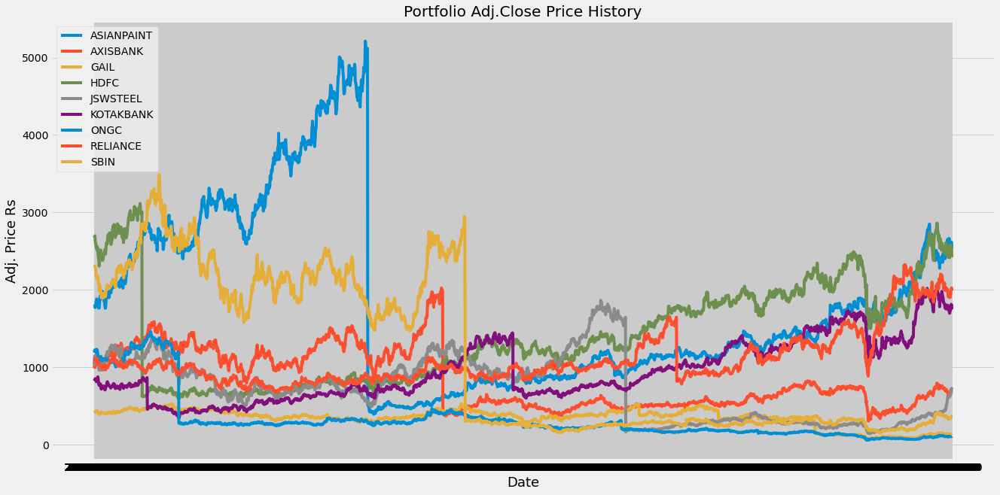

In [199]:
title = 'Portfolio Adj.Close Price History'
plt.rcParams["figure.figsize"] = (20,10)
my_stocks = df_adj_close
for c in my_stocks.columns.values:
    #plt.figure(figsize=(20,10))
    plt.plot(my_stocks[c],label=c)
    
plt.title(title)
plt.xlabel('Date',fontsize=18)
plt.ylabel('Adj. Price Rs',fontsize=18)
plt.legend(my_stocks.columns.values,loc = 'upper left')
plt.show()

In [186]:
#Show daily returns
returns = df_adj_close.pct_change()
returns

,ASIANPAINT,AXISBANK,GAIL,HDFC,JSWSTEEL,KOTAKBANK,ONGC,RELIANCE,SBIN
Date,,,,,,,,,
2010-01-04,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2010-01-05,0.003159,0.020865,0.008794,0.003403,0.109438,0.009904,0.017517,-0.004463,0.000371
2010-01-06,-0.003010,-0.016785,-0.006687,0.004807,0.012380,0.012153,0.012622,0.016158,0.005999
2010-01-07,-0.010202,0.007080,0.025126,-0.018618,-0.021324,0.011235,0.001063,0.016590,-0.005595
2010-01-08,0.016519,0.013063,0.005629,-0.017422,-0.005692,-0.006172,-0.007430,-0.002622,-0.002987
...,...,...,...,...,...,...,...,...,...
2021-04-26,0.015866,0.043345,0.004637,0.004985,0.032106,0.014675,0.003906,0.017591,0.023332
2021-04-27,0.006431,-0.001285,0.011923,0.003427,0.015401,-0.005314,0.003891,0.026215,0.025414
2021-04-28,0.015616,0.012294,0.013683,0.023269,-0.004881,0.034937,0.006783,0.004350,0.029316


In [187]:
#Annualized covariance matrix
cov_matrix_annual = returns.cov()*252 #252 - No.of Trading Days
cov_matrix_annual

,ASIANPAINT,AXISBANK,GAIL,HDFC,JSWSTEEL,KOTAKBANK,ONGC,RELIANCE,SBIN
ASIANPAINT,0.140440,0.029406,0.020724,0.024597,0.031591,0.026892,0.023706,0.025259,0.022848
AXISBANK,0.029406,0.190955,0.033006,0.050872,0.063172,0.050063,0.042515,0.041621,0.076681
GAIL,0.020724,0.033006,0.130150,0.024880,0.037631,0.021567,0.045005,0.028193,0.036147
HDFC,0.024597,0.050872,0.024880,0.140485,0.042340,0.041399,0.029490,0.031734,0.044531
JSWSTEEL,0.031591,0.063172,0.037631,0.042340,0.224206,0.047525,0.047889,0.046521,0.060585
KOTAKBANK,0.026892,0.050063,0.021567,0.041399,0.047525,0.127126,0.030244,0.031970,0.034511
ONGC,0.023706,0.042515,0.045005,0.029490,0.047889,0.030244,0.168624,0.037170,0.042980
RELIANCE,0.025259,0.041621,0.028193,0.031734,0.046521,0.031970,0.037170,0.104495,0.038247
SBIN,0.022848,0.076681,0.036147,0.044531,0.060585,0.034511,0.042980,0.038247,0.194937


In [190]:
#Calculate the variance of stocks
stock_variance = np.dot(weights.T,np.dot(cov_matrix_annual,weights))
stock_variance

0.04148441720833553

In [191]:
#Calculate the volatility aka standard deviation
port_volatility = np.sqrt(stock_variance)
port_volatility

0.20367723782577063

In [192]:
#Calculate the annual portfolio return
portfolio_return = np.sum(returns.mean()*weights)*252
portfolio_return

0.07283176694031915

In [193]:
#Show the expected annual return, volatility(risk) and variance

percent_var = str(round(stock_variance,2)*100) + '%'
percent_vols = str(round(port_volatility,2)*100)+'%'#Volatility
percent_ret = str(round(portfolio_return,2)*100)+'%'

print('Expected annual return:' + percent_ret)
print('Annual volatility/risk: '+percent_vols)
print('Annual variance:' +percent_var)

Expected annual return:7.000000000000001%
Annual volatility/risk: 20.0%
Annual variance:4.0%


In [194]:
#Portfolio Optimization
#Calculate the expected returns and the annualised sample covariance matrix of asset return
mu = expected_returns.mean_historical_return(df_adj_close)
S = risk_models.sample_cov(df_adj_close)

In [195]:
#optimize for max sharpe ratio
ef = EfficientFrontier(mu,S)
weights = ef.max_sharpe()
cleaned_weights = ef.clean_weights()
print(cleaned_weights)
ef.portfolio_performance(verbose = True)

OrderedDict([('ASIANPAINT', 0.0), ('AXISBANK', 0.0), ('GAIL', 0.0), ('HDFC', 0.0), ('JSWSTEEL', 0.0), ('KOTAKBANK', 0.56561), ('ONGC', 0.0), ('RELIANCE', 0.43439), ('SBIN', 0.0)])
Expected annual return: 6.4%
Annual volatility: 27.6%
Sharpe Ratio: 0.16


(0.06432214859423106, 0.2758565176289263, 0.16067102193268404)

In [196]:
#Get the discrete allocationj of each share per stock
from pypfopt.discrete_allocation import DiscreteAllocation, get_latest_prices

latest_prices = get_latest_prices(df_adj_close)
weights = cleaned_weights
da = DiscreteAllocation(weights,latest_prices, total_portfolio_value = 100000)

allocation,leftover = da.lp_portfolio()
print('Discrete allocation', allocation)
print('Funds remaining: {:.2f}'.format(leftover))

Discrete allocation {'GAIL': 1, 'KOTAKBANK': 32, 'RELIANCE': 22}
Funds remaining: 22.20
